In [1]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt
import numpy as np
import scipy as sp
import pickle
from imblearn.over_sampling import RandomOverSampler as ros

In [7]:
def save_object(obj, path):
    with open(path, 'wb') as fp:
        pickle.dump(object, fp)

In [8]:
def scale(attributes):
    scaler = StandardScaler();
    return pd.DataFrame(scaler.fit_transform(attributes)), scaler;

In [9]:
%run ../Classes/BuildMyBulle.py #Load all the Datasets Objects Later

# Snow Ball, Extend the Dataset 15 Times, Delta Factor of 10


In [5]:
def bulle(self, trainX, trainY):
    import itertools
    #categories: 0-discrete, 1-continuous, 2-category
    ordered=pd.concat([trainX, trainY], axis=1)
    x=pd.DataFrame(trainX[trainY==self.mc_label])
    i=0;
    t00=datetime.datetime.now().replace(microsecond=0);
    bubble_set=pd.DataFrame();

    opt_size=self.prop_bubble[1]*15;
    
    curr_bubble=x;
    while(len(bubble_set)<opt_size):
        d_ordered = self.deltas_ordered*10;
        step_matrix = np.random.choice([-1,1],(len(curr_bubble), len(d_ordered)))*d_ordered;
        continuous = curr_bubble.iloc[:,self.index_discrete:self.index_continuous]+(step_matrix[:,self.index_discrete:self.index_continuous]*2)-(d_ordered[self.index_discrete:self.index_continuous]);
        bubble = pd.concat([discrete, continuous, category], axis=1)
        bubble_set=bubble_set.append(bubble)
        curr_bubble=bubble;        
    bubble_y = np.ones(len(bubble_set)).astype(np.int_)
    
    x=pd.DataFrame(trainX[trainY==0])
    i=0;
    t00=datetime.datetime.now().replace(microsecond=0);    
    
    opt_size=self.prop_bubble[1]*15;    
    curr_bubble=x;
    while(len(bubble_set)<opt_size):
        d_ordered = self.deltas_ordered*10;
        step_matrix = np.random.choice([-1,1],(len(curr_bubble), len(d_ordered)))*d_ordered;
        continuous = curr_bubble.iloc[:,self.index_discrete:self.index_continuous]+(step_matrix[:,self.index_discrete:self.index_continuous]*2)-(d_ordered[self.index_discrete:self.index_continuous]);
        bubble = pd.concat([discrete, continuous, category], axis=1)
        bubble_set=bubble_set.append(bubble)
        curr_bubble=bubble;

        
    bubble_yM = np.zeros(len(bubble_set)-len(bubble_y)).astype(np.int_)

    bubble_y=np.append(bubble_y,bubble_yM);
    
    return bubble_set, pd.DataFrame(bubble_y);

def bubble_oversample(self):
    from imblearn.under_sampling import RandomUnderSampler as rus;
    xBubbleOversample=[];
    yBubbleOversample=[];

    xBubbleOriginalOversample=[];
    yBubbleOriginalOversample=[];

    xAllOversample=[];
    yAllOversample=[];

    print("Bubble Oversample");
    t00=datetime.datetime.now().replace(microsecond=0)
    for fold in range(0, len(self.original_training_set['xs'])):
        tnoow=datetime.datetime.now().replace(microsecond=0);
        print("aan het bullen",fold, tnoow-t00);
        t00=tnoow;

        maxim = max(self.original_training_set['ys'][fold].value_counts());
        minim = min(self.original_training_set['ys'][fold].value_counts());
        prop_bubble={0:maxim*15, 1:(maxim*15)-minim};
        prop_bubble_original={0:maxim*15, 1:maxim*15};

        bubblex, bubbley = self.bulle(self.original_training_set['xs'][fold], self.original_training_set['ys'][fold])
        majcX=pd.DataFrame(self.original_training_set['xs'][fold][(self.original_training_set['ys'][fold]==0)])
        majcy=pd.DataFrame(self.original_training_set['ys'][fold][(self.original_training_set['ys'][fold]==0)])
        mincX=pd.DataFrame(self.original_training_set['xs'][fold][(self.original_training_set['ys'][fold]==1)])
        mincy=pd.DataFrame(self.original_training_set['ys'][fold][(self.original_training_set['ys'][fold]==1)])

        majcX = majcX.append(bubblex, ignore_index=True);
        majcy.columns=bubbley.columns
        majcy = pd.concat([majcy,bubbley], ignore_index=True, axis=0);


        randomUnderSampler = rus(random_state=self.rn_state, ratio=self.prop_bubble); 
        x_bubbleO, y_bubbleO = randomUnderSampler.fit_sample(majcX, majcy.values.ravel());
        x_bubbleO=pd.DataFrame(x_bubbleO).append(mincX, ignore_index=0);
        y_bubbleO=pd.DataFrame(y_bubbleO).append(mincy, ignore_index=0);

        xBubbleOversample.append(x_bubbleO)
        yBubbleOversample.append(y_bubbleO)


        randomUnderSampler = rus(random_state=self.rn_state, ratio=self.prop_bubble_original);
        oribubblex = self.original_training_set['xs'][fold].append(bubblex);
        oribubbley = self.original_training_set['ys'][fold].append(bubbley);
        x_bubbleOriO, y_bubbleOriO = randomUnderSampler.fit_sample(oribubblex, oribubbley.values.ravel());

        xBubbleOriginalOversample.append(x_bubbleOriO)
        yBubbleOriginalOversample.append(y_bubbleOriO)

        xAllOversample.append(np.array(oribubblex));
        yAllOversample.append(np.array(oribubbley.values.ravel()));
        
    self.oversample_bubble_tt_set = {'xs':xBubbleOversample, 'ys':yBubbleOversample};
    self.oversample_bubble_original_tt_set = {'xs':xBubbleOriginalOversample, 'ys':yBubbleOriginalOversample};
    self.all_bubbles_tt_set={'xs':xAllOversample, 'ys':yAllOversample};



## Haberman

In [7]:
maBulle0 = BuildMyBulle([1,1,1], 0, 'normCats_realSnowBubbles15r-15r_ray10Bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:00
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:00
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:00
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.353623188406 , Precicion 0:  0.4 , Precision 1 0.4 , Recall 1:  0.666666666667 , Recall 0:  0.666666666667 , PR AUC:  0.478806366774 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.656862745098 , AUC Probs 0:  0.320159313725 , AUC Probs 1:  0.679840686275
         1
           Average Precisio

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\base.py:340: RuntimeWarning: overflow encountered in exp
  np.exp(prob, prob)


         2
           Average Precision:  0.267346014493 , Precicion 0:  0.275 , Precision 1 0.275 , Recall 1:  0.458333333333 , Recall 0:  0.458333333333 , PR AUC:  0.410737100663 , F1 Score 0:  0.34375 , F1 Score1:  0.34375 , AUC:  0.515931372549 , AUC Probs 0:  0.50306372549 , AUC Probs 1:  0.477328431373
         3
           Average Precision:  0.265867066467 , Precicion 0:  0.275862068966 , Precision 1 0.275862068966 , Recall 1:  0.333333333333 , Recall 0:  0.333333333333 , PR AUC:  0.363906199536 , F1 Score 0:  0.301886792453 , F1 Score1:  0.301886792453 , AUC:  0.512254901961 , AUC Probs 0:  0.506740196078 , AUC Probs 1:  0.535539215686
         4
           Average Precision:  0.247987117552 , Precicion 0:  0.222222222222 , Precision 1 0.222222222222 , Recall 1:  0.333333333333 , Recall 0:  0.333333333333 , PR AUC:  0.345834352112 , F1 Score 0:  0.266666666667 , F1 Score1:  0.266666666667 , AUC:  0.460784313725 , AUC Probs 0:  0.549325980392 , AUC Probs 1:  0.434742647059
    

           Average Precision:  0.358242753623 , Precicion 0:  0.416666666667 , Precision 1 0.416666666667 , Recall 1:  0.625 , Recall 0:  0.625 , PR AUC:  0.475915704845 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.658088235294 , AUC Probs 0:  0.266850490196 , AUC Probs 1:  0.733149509804
         1
           Average Precision:  0.326484623542 , Precicion 0:  0.365853658537 , Precision 1 0.365853658537 , Recall 1:  0.625 , Recall 0:  0.625 , PR AUC:  0.323274202964 , F1 Score 0:  0.461538461538 , F1 Score1:  0.461538461538 , AUC:  0.621323529412 , AUC Probs 0:  0.371323529412 , AUC Probs 1:  0.628676470588
         2
           Average Precision:  0.269151138716 , Precicion 0:  0.285714285714 , Precision 1 0.285714285714 , Recall 1:  0.333333333333 , Recall 0:  0.333333333333 , PR AUC:  0.313375112273 , F1 Score 0:  0.307692307692 , F1 Score1:  0.307692307692 , AUC:  0.519607843137 , AUC Probs 0:  0.435661764706 , AUC Probs 1:  0.564338235294
         3
           Average Precision:

           Average Precision:  0.350543478261 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.470123950025 , F1 Score 0:  0.428571428571 , F1 Score1:  0.428571428571 , AUC:  0.621323529412 , AUC Probs 0:  0.233455882353 , AUC Probs 1:  0.766544117647
         1
           Average Precision:  0.397271952259 , Precicion 0:  0.588235294118 , Precision 1 0.588235294118 , Recall 1:  0.416666666667 , Recall 0:  0.416666666667 , PR AUC:  0.50732757696 , F1 Score 0:  0.487804878049 , F1 Score1:  0.487804878049 , AUC:  0.656862745098 , AUC Probs 0:  0.270220588235 , AUC Probs 1:  0.729779411765
         2
           Average Precision:  0.280926501035 , Precicion 0:  0.357142857143 , Precision 1 0.357142857143 , Recall 1:  0.208333333333 , Recall 0:  0.208333333333 , PR AUC:  0.354428877252 , F1 Score 0:  0.263157894737 , F1 Score1:  0.263157894737 , AUC:  0.537990196078 , AUC Probs 0:  0.307291666667 , AUC Probs 1:  0.692708333333
         3
           A

           Average Precision:  0.31884057971 , Precicion 0:  0.4 , Precision 1 0.4 , Recall 1:  0.416666666667 , Recall 0:  0.416666666667 , PR AUC:  0.344205390173 , F1 Score 0:  0.408163265306 , F1 Score1:  0.408163265306 , AUC:  0.598039215686 , AUC Probs 0:  0.371629901961 , AUC Probs 1:  0.628370098039
         4
           Average Precision:  0.258605072464 , Precicion 0:  0.25 , Precision 1 0.25 , Recall 1:  0.208333333333 , Recall 0:  0.208333333333 , PR AUC:  0.272453943559 , F1 Score 0:  0.227272727273 , F1 Score1:  0.227272727273 , AUC:  0.49387254902 , AUC Probs 0:  0.450980392157 , AUC Probs 1:  0.549019607843
         5
           Average Precision:  0.249094202899 , Precicion 0:  0.166666666667 , Precision 1 0.166666666667 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.283568691805 , F1 Score 0:  0.142857142857 , F1 Score1:  0.142857142857 , AUC:  0.452205882353 , AUC Probs 0:  0.401654411765 , AUC Probs 1:  0.598345588235
         6
           Average Precision:  0.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: Undef

Average Precision:  0.260869565217 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.323272515528 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.5 , AUC Probs 0:  0.441789215686 , AUC Probs 1:  0.558210784314
         3
           Average Precision:  0.260869565217 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.196488294314 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.5 , AUC Probs 0:  0.541666666667 , AUC Probs 1:  0.458333333333
         4
           Average Precision:  0.260869565217 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.275588768116 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.5 , AUC Probs 0:  0.50306372549 , AUC Probs 1:  0.49693627451
         5
           Average Precision:  0.260869565217 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.290513833992 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.5 , AUC Probs 0:  0.4767

           Average Precision:  0.26985205314 , Precicion 0:  0.291666666667 , Precision 1 0.291666666667 , Recall 1:  0.291666666667 , Recall 0:  0.291666666667 , PR AUC:  0.384057971014 , F1 Score 0:  0.291666666667 , F1 Score1:  0.291666666667 , AUC:  0.520833333333 , AUC Probs 0:  0.479166666667 , AUC Probs 1:  0.520833333333
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:00
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.311769711799 , Precicion 0- 0.355961373055 , Precision 1- 0.355961373055 , Recall 1- 0.39880952381 , Recall 0- 0.39880952381 , PR Aucs- [0.5556020066889632, 0.51043823326432025, 0.22789855072463769, 0.48664596273291927, 0.45259661835748799, 0.4328770799785292, 0.52211394302848579] , F1 Score 0- 0.371402239374 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.575455182073 , AUC Probs 0- 0.422356442577 , AUC Probs 1- [0.57764355742296913, 0, 0, 0, 0]
oversample
          

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.311770,0.295661,0.289671,0.267124,0.295881
Precision 0,0.355961,0.350798,0.328760,0.166667,0.336738
Precision 1,0.355961,0.350798,0.328760,0.166667,0.336738
Recall 0,0.398810,0.380952,0.339286,0.017857,0.428571
Recall 1,0.398810,0.380952,0.339286,0.017857,0.428571
PRAUC,0.455453,0.446292,0.420069,0.434653,0.456074
F1 Score 0,0.371402,0.361440,0.328898,0.032153,0.373159
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.575455,0.563375,0.546744,0.504727,0.564076
AUC Probs 0,0.422356,0.435312,0.450893,0.496324,0.437062


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.287713,0.302858,0.288594,0.260870,0.314294
Precision 0,0.353270,0.337339,0.355717,0.000000,0.352627
Precision 1,0.353270,0.337339,0.355717,0.000000,0.352627
Recall 0,0.250000,0.517857,0.255952,0.000000,0.547619
Recall 1,0.250000,0.517857,0.255952,0.000000,0.547619
PRAUC,0.355478,0.377373,0.352136,0.341318,0.388908
F1 Score 0,0.289614,0.407671,0.295056,0.000000,0.425824
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.546218,0.580357,0.547094,0.500000,0.596289
AUC Probs 0,0.367472,0.372987,0.375131,0.483587,0.357012


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.286857,0.295356,0.296409,0.260870,0.294775
Precision 0,0.328688,0.344663,0.352067,0.000000,0.341138
Precision 1,0.328688,0.344663,0.352067,0.000000,0.341138
Recall 0,0.226190,0.327381,0.267857,0.000000,0.345238
Recall 1,0.226190,0.327381,0.267857,0.000000,0.345238
PRAUC,0.328426,0.346226,0.375993,0.315829,0.362583
F1 Score 0,0.263195,0.333408,0.298683,0.000000,0.332665
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.531162,0.555497,0.550945,0.500000,0.557073
AUC Probs 0,0.371630,0.369485,0.345632,0.451199,0.338892


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.338757,0.313565,0.261028,0.258762,0.279865
Precision 0,0.372273,0.342238,0.204636,0.020408,0.285373
Precision 1,0.372273,0.342238,0.204636,0.020408,0.285373
Recall 0,0.428571,0.690476,0.238095,0.017857,0.571429
Recall 1,0.428571,0.690476,0.238095,0.017857,0.571429
PRAUC,0.408017,0.367107,0.303916,0.214151,0.319315
F1 Score 0,0.388310,0.441172,0.214442,0.019048,0.374066
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.612395,0.599440,0.481443,0.481618,0.533613
AUC Probs 0,0.387430,0.382791,0.569459,0.532782,0.460434


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.323816,0.319623,0.343452,0.263587,0.349507
Precision 0,0.518687,0.367074,0.527550,0.214286,0.425816
Precision 1,0.518687,0.367074,0.527550,0.214286,0.425816
Recall 0,0.232143,0.511905,0.303571,0.023810,0.517857
Recall 1,0.232143,0.511905,0.303571,0.023810,0.517857
PRAUC,0.450383,0.407283,0.434123,0.338335,0.434898
F1 Score 0,0.312197,0.425679,0.379637,0.042735,0.462232
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.573004,0.600490,0.601366,0.502451,0.632878
AUC Probs 0,0.285714,0.314776,0.275210,0.443540,0.293899


## Pulsar

In [8]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1,1], 1, 'normCats_realSnowBubbles15r-15r_ray10Bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()    

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:03
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:02
aan het bullen 2 0:00:00
aan het bullen 3 0:00:01
aan het bullen 4 0:00:01
aan het bullen 5 0:00:01
aan het bullen 6 0:00:01
Time taken for random bubble oversampling:  0:00:07
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:01
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.752658512705 , Precicion 0:  0.865979381443 , Precision 1 0.865979381443 , Recall 1:  0.853658536585 , Recall 0:  0.853658536585 , PR AUC:  0.915757725358 , F1 Score 0:  0.85977482088 , F1 Score1:  0.85977482088 , AUC:  0.920166701667 , AUC Probs 0:  0.0248044147108 , AUC Probs 1:  0.97519558

           Average Precision:  0.665795804583 , Precicion 0:  0.727868852459 , Precision 1 0.727868852459 , Recall 1:  0.90243902439 , Recall 0:  0.90243902439 , PR AUC:  0.907672202255 , F1 Score 0:  0.805807622505 , F1 Score1:  0.805807622505 , AUC:  0.934204342043 , AUC Probs 0:  0.0300390503905 , AUC Probs 1:  0.969960949609
         4
           Average Precision:  0.644232546158 , Precicion 0:  0.734375 , Precision 1 0.734375 , Recall 1:  0.859756097561 , Recall 0:  0.859756097561 , PR AUC:  0.890179851266 , F1 Score 0:  0.792134831461 , F1 Score1:  0.792134831461 , AUC:  0.914195391954 , AUC Probs 0:  0.0331694983617 , AUC Probs 1:  0.966830501638
         5
           Average Precision:  0.642969298636 , Precicion 0:  0.706730769231 , Precision 1 0.706730769231 , Recall 1:  0.896341463415 , Recall 0:  0.896341463415 , PR AUC:  0.899619729822 , F1 Score 0:  0.790322580645 , F1 Score1:  0.790322580645 , AUC:  0.92941304413 , AUC Probs 0:  0.0291827918279 , AUC Probs 1:  0.9708172

           Average Precision:  0.779392939849 , Precicion 0:  0.920993227991 , Precision 1 0.920993227991 , Recall 1:  0.829268292683 , Recall 0:  0.829268292683 , PR AUC:  0.902454166033 , F1 Score 0:  0.872727272727 , F1 Score1:  0.872727272727 , AUC:  0.911046610466 , AUC Probs 0:  0.0604318543185 , AUC Probs 1:  0.939568145681
         6
           Average Precision:  0.824603430166 , Precicion 0:  0.946188340807 , Precision 1 0.946188340807 , Recall 1:  0.857723577236 , Recall 0:  0.857723577236 , PR AUC:  0.931531685553 , F1 Score 0:  0.899786780384 , F1 Score1:  0.899786780384 , AUC:  0.926401764018 , AUC Probs 0:  0.0388272632726 , AUC Probs 1:  0.961172736727
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.635986327638 , Precicion 0:  0.707317073171 , Precision 1 0.707317073171 , Recall 1:  0.884146341463 , Recall 0:  0.884146341463 , PR AUC:  0.848659688196 , F1 Score 0:  0.785907859079

           Average Precision:  0.603423602129 , Precicion 0:  0.658753709199 , Precision 1 0.658753709199 , Recall 1:  0.90243902439 , Recall 0:  0.90243902439 , PR AUC:  0.857871783821 , F1 Score 0:  0.761578044597 , F1 Score1:  0.761578044597 , AUC:  0.927644276443 , AUC Probs 0:  0.0469842198422 , AUC Probs 1:  0.953015780158
         1
           Average Precision:  0.608813605806 , Precicion 0:  0.67125382263 , Precision 1 0.67125382263 , Recall 1:  0.892276422764 , Recall 0:  0.892276422764 , PR AUC:  0.870262943493 , F1 Score 0:  0.766143106457 , F1 Score1:  0.766143106457 , AUC:  0.924100491005 , AUC Probs 0:  0.0524821914886 , AUC Probs 1:  0.947517808511
         2
           Average Precision:  0.60430693802 , Precicion 0:  0.659732540862 , Precision 1 0.659732540862 , Recall 1:  0.90243902439 , Recall 0:  0.90243902439 , PR AUC:  0.867596231963 , F1 Score 0:  0.762231759657 , F1 Score1:  0.762231759657 , AUC:  0.927746777468 , AUC Probs 0:  0.0509380093801 , AUC Probs 1:  0

           Average Precision:  0.753961418711 , Precicion 0:  0.819012797075 , Precision 1 0.819012797075 , Recall 1:  0.910569105691 , Recall 0:  0.910569105691 , PR AUC:  0.865150574965 , F1 Score 0:  0.862367661213 , F1 Score1:  0.862367661213 , AUC:  0.94513695137 , AUC Probs 0:  0.0288436217696 , AUC Probs 1:  0.97115637823
         3
           Average Precision:  0.757492649591 , Precicion 0:  0.831144465291 , Precision 1 0.831144465291 , Recall 1:  0.900406504065 , Recall 0:  0.900406504065 , PR AUC:  0.85649095058 , F1 Score 0:  0.864390243902 , F1 Score1:  0.864390243902 , AUC:  0.940978159782 , AUC Probs 0:  0.0308807254739 , AUC Probs 1:  0.969119274526
         4
           Average Precision:  0.771463195819 , Precicion 0:  0.848368522073 , Precision 1 0.848368522073 , Recall 1:  0.89837398374 , Recall 0:  0.89837398374 , PR AUC:  0.897948885414 , F1 Score 0:  0.872655478776 , F1 Score1:  0.872655478776 , AUC:  0.941089410894 , AUC Probs 0:  0.0279211125445 , AUC Probs 1: 

           Average Precision:  0.761711008166 , Precicion 0:  0.842610364683 , Precision 1 0.842610364683 , Recall 1:  0.892276422764 , Recall 0:  0.892276422764 , PR AUC:  0.900614500598 , F1 Score 0:  0.866732477789 , F1 Score1:  0.866732477789 , AUC:  0.937733127331 , AUC Probs 0:  0.0273306899736 , AUC Probs 1:  0.972669310026
         5
           Average Precision:  0.726433763345 , Precicion 0:  0.8014571949 , Precision 1 0.8014571949 , Recall 1:  0.894308943089 , Recall 0:  0.894308943089 , PR AUC:  0.84920495626 , F1 Score 0:  0.845341018252 , F1 Score1:  0.845341018252 , AUC:  0.935981859819 , AUC Probs 0:  0.0331640816408 , AUC Probs 1:  0.966835918359
         6
           Average Precision:  0.773147286776 , Precicion 0:  0.823741007194 , Precision 1 0.823741007194 , Recall 1:  0.930894308943 , Recall 0:  0.930894308943 , PR AUC:  0.87330585007 , F1 Score 0:  0.874045801527 , F1 Score1:  0.874045801527 , AUC:  0.955402054021 , AUC Probs 0:  0.0236619032857 , AUC Probs 1:  

           Average Precision:  0.82178526941 , Precicion 0:  0.921276595745 , Precision 1 0.921276595745 , Recall 1:  0.880081300813 , Recall 0:  0.880081300813 , PR AUC:  0.933880654242 , F1 Score 0:  0.900207900208 , F1 Score1:  0.900207900208 , AUC:  0.936248112481 , AUC Probs 0:  0.0246323296566 , AUC Probs 1:  0.975367670343
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:02
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.762870544721 , Precicion 0:  0.861445783133 , Precision 1 0.861445783133 , Recall 1:  0.871951219512 , Recall 0:  0.871951219512 , PR AUC:  0.903848173671 , F1 Score 0:  0.866666666667 , F1 Score1:  0.866666666667 , AUC:  0.92890303903 , AUC Probs 0:  0.0370699540329 , AUC Probs 1:  0.962930045967
         1
           Average Precision:  0.776976856762 , Precicion 0:  0.904139433551 , Precision 1 0.904139433551 , Recall 1:  0.843495934959 , Recall 0:  0.843495934959 , PR AUC:  0.90471677985 , F1 Sc

           1 _ : Average Precision- 0.785322928706 , Precicion 0- 0.908427894402 , Precision 1- 0.908427894402 , Recall 1- 0.849303135889 , Recall 0- 0.849303135889 , PR Aucs- [0.906590960647781, 0.91197820110140082, 0.91983526777442071, 0.91517433418474536, 0.9062274994415459, 0.90041696434032192, 0.93388065424227884] , F1 Score 0- 0.877706802359 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.920317238887 , AUC Probs 0- 0.0400837936951 , AUC Probs 1- [0.95530357089285178, 0.95991620630492025, 0, 0, 0]
oversample_bubble
           2 _ : Average Precision- 0.782727674749 , Precicion 0- 0.893451608688 , Precision 1- 0.893451608688 , Recall 1- 0.862078977933 , Recall 0- 0.862078977933 , PR Aucs- [0.90384817367095072, 0.90471677984984211, 0.90949171776960913, 0.91122944252827776, 0.90996060925920075, 0.89723574661558103, 0.93184609311344468] , F1 Score 0- 0.877243909505 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.925826579694 , AUC Probs 0- 0.0398853095674 , AUC Probs 1- [0.95530357089285178, 0.959916206

           Average Precision:  0.672321300673 , Precicion 0:  0.788461538462 , Precision 1 0.788461538462 , Recall 1:  0.833333333333 , Recall 0:  0.833333333333 , PR AUC:  0.818532445208 , F1 Score 0:  0.810276679842 , F1 Score1:  0.810276679842 , AUC:  0.905391553916 , AUC Probs 0:  0.0946084460845 , AUC Probs 1:  0.905391553916
         4
           Average Precision:  0.684301476707 , Precicion 0:  0.806324110672 , Precision 1 0.806324110672 , Recall 1:  0.829268292683 , Recall 0:  0.829268292683 , PR AUC:  0.825617430728 , F1 Score 0:  0.817635270541 , F1 Score1:  0.817635270541 , AUC:  0.90458904589 , AUC Probs 0:  0.0954109541095 , AUC Probs 1:  0.90458904589
         5
           Average Precision:  0.64587469455 , Precicion 0:  0.76660341556 , Precision 1 0.76660341556 , Recall 1:  0.821138211382 , Recall 0:  0.821138211382 , PR AUC:  0.802064482 , F1 Score 0:  0.792934249264 , F1 Score1:  0.792934249264 , AUC:  0.897961479615 , AUC Probs 0:  0.102038520385 , AUC Probs 1:  0.8

Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.687980,0.692487,0.679748,0.670986,0.601181
Precision 0,0.818618,0.824922,0.793232,0.793877,0.673807
Precision 1,0.818618,0.824922,0.793232,0.793877,0.673807
Recall 0,0.820557,0.819686,0.837979,0.825203,0.875436
Recall 1,0.820557,0.819686,0.837979,0.825203,0.875436
PRAUC,0.827808,0.830564,0.823028,0.817548,0.780328
F1 Score 0,0.819270,0.821768,0.814874,0.808647,0.761244
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.901068,0.900984,0.907963,0.901693,0.916280
AUC Probs 0,0.098932,0.099016,0.092037,0.098307,0.083720


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.787816,0.644781,0.592820,0.599342,0.609514
Precision 0,0.929975,0.715034,0.652514,0.659584,0.666817
Precision 1,0.929975,0.715034,0.652514,0.659584,0.666817
Recall 0,0.830430,0.887340,0.893728,0.894019,0.900407
Recall 1,0.830430,0.887340,0.893728,0.894019,0.900407
PRAUC,0.912640,0.859744,0.851814,0.852054,0.864242
F1 Score 0,0.877271,0.791831,0.754080,0.758976,0.766144
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.912052,0.925820,0.922806,0.923712,0.927507
AUC Probs 0,0.052048,0.057742,0.053848,0.054965,0.050073


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.786490,0.785323,0.782728,0.781271,0.751613
Precision 0,0.934032,0.908428,0.893452,0.897672,0.840577
Precision 1,0.934032,0.908428,0.893452,0.897672,0.840577
Recall 0,0.824913,0.849303,0.862079,0.855691,0.881533
Recall 1,0.824913,0.849303,0.862079,0.855691,0.881533
PRAUC,0.913641,0.913443,0.909761,0.910549,0.905952
F1 Score 0,0.875970,0.877707,0.877244,0.875987,0.860234
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.909513,0.920317,0.925827,0.922911,0.932288
AUC Probs 0,0.044696,0.040084,0.039885,0.041963,0.036314


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.771995,0.710733,0.669150,0.667777,0.727309
Precision 0,0.939433,0.777085,0.726185,0.733613,0.801509
Precision 1,0.939433,0.777085,0.726185,0.733613,0.801509
Recall 0,0.803136,0.903600,0.910279,0.897793,0.895470
Recall 1,0.803136,0.903600,0.910279,0.897793,0.895470
PRAUC,0.918045,0.918933,0.910239,0.905269,0.916648
F1 Score 0,0.865087,0.835016,0.807074,0.806937,0.845579
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.898874,0.938607,0.937582,0.932350,0.936475
AUC Probs 0,0.026245,0.024708,0.026336,0.027198,0.024049


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.785948,0.754045,0.748963,0.749643,0.760380
Precision 0,0.941472,0.822872,0.822440,0.823874,0.830815
Precision 1,0.941472,0.822872,0.822440,0.823874,0.830815
Recall 0,0.817073,0.905923,0.899535,0.898664,0.904762
Recall 1,0.817073,0.905923,0.899535,0.898664,0.904762
PRAUC,0.898706,0.862459,0.859185,0.859622,0.865212
F1 Score 0,0.874725,0.862217,0.859081,0.859456,0.866077
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.905959,0.943092,0.939942,0.939609,0.943068
AUC Probs 0,0.046491,0.028191,0.031011,0.031327,0.028025


## Magic

In [9]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1,1,1,1,1], 2, 'normCats_realSnowBubbles15r-15r_ray10Bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:04
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:01
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:01
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:01
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:02
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.988835524917 , Precicion 0:  0.990108803165 , Precision 1 0.990108803165 , Recall 1:  0.998005982054 , Recall 0:  0.998005982054 , PR AUC:  0.999827073482 , F1 Score 0:  0.994041708044 , F1 Score1:  0.994041708044 , AUC:  0.996300288324 , AUC Probs 0:  9.2694888308e-05 , AUC Probs 1:  0.99990

           Average Precision:  0.987542718918 , Precicion 0:  0.990089197225 , Precision 1 0.990089197225 , Recall 1:  0.996011964108 , Recall 0:  0.996011964108 , PR AUC:  0.99986636822 , F1 Score 0:  0.993041749503 , F1 Score1:  0.993041749503 , AUC:  0.995303279351 , AUC Probs 0:  7.27547088464e-05 , AUC Probs 1:  0.999927245291
         2
           Average Precision:  0.982519599874 , Precicion 0:  0.984729064039 , Precision 1 0.984729064039 , Recall 1:  0.996510468594 , Recall 0:  0.996510468594 , PR AUC:  0.999788486408 , F1 Score 0:  0.990584737364 , F1 Score1:  0.990584737364 , AUC:  0.994066045108 , AUC Probs 0:  0.000114656031904 , AUC Probs 1:  0.999885343968
         3
           Average Precision:  0.986235218511 , Precicion 0:  0.987185805816 , Precision 1 0.987185805816 , Recall 1:  0.99850448654 , Recall 0:  0.99850448654 , PR AUC:  0.999789412634 , F1 Score 0:  0.992812887237 , F1 Score1:  0.992812887237 , AUC:  0.995738729757 , AUC Probs 0:  0.00011263506777 , AUC Pr

           Average Precision:  0.952667231322 , Precicion 0:  0.979591836735 , Precision 1 0.979591836735 , Recall 1:  0.957128614158 , Recall 0:  0.957128614158 , PR AUC:  0.991904817555 , F1 Score 0:  0.968229954614 , F1 Score1:  0.968229954614 , AUC:  0.973158901673 , AUC Probs 0:  0.00609165746005 , AUC Probs 1:  0.99390834254
         3
           Average Precision:  0.944297716605 , Precicion 0:  0.977366255144 , Precision 1 0.977366255144 , Recall 1:  0.947158524427 , Recall 0:  0.947158524427 , PR AUC:  0.991273989893 , F1 Score 0:  0.962025316456 , F1 Score1:  0.962025316456 , AUC:  0.967633316267 , AUC Probs 0:  0.00714633127644 , AUC Probs 1:  0.992853668724
         4
           Average Precision:  0.949895745086 , Precicion 0:  0.981949458484 , Precision 1 0.981949458484 , Recall 1:  0.949152542373 , Recall 0:  0.949152542373 , PR AUC:  0.991286301897 , F1 Score 0:  0.965272496831 , F1 Score1:  0.965272496831 , AUC:  0.969846541457 , AUC Probs 0:  0.00813572795128 , AUC Pr

           Average Precision:  0.935600104302 , Precicion 0:  0.956092747903 , Precision 1 0.956092747903 , Recall 1:  0.966101694915 , Recall 0:  0.966101694915 , PR AUC:  0.987802667434 , F1 Score 0:  0.961071162906 , F1 Score1:  0.961071162906 , AUC:  0.971023820431 , AUC Probs 0:  0.009866885829 , AUC Probs 1:  0.990133114171
         5
           Average Precision:  0.942575078415 , Precicion 0:  0.961424332344 , Precision 1 0.961424332344 , Recall 1:  0.969092721834 , Recall 0:  0.969092721834 , PR AUC:  0.992070426115 , F1 Score 0:  0.965243296922 , F1 Score1:  0.965243296922 , AUC:  0.974005820377 , AUC Probs 0:  0.00659716795559 , AUC Probs 1:  0.993402832044
         6
           Average Precision:  0.94087231594 , Precicion 0:  0.959980237154 , Precision 1 0.959980237154 , Recall 1:  0.968594217348 , Recall 0:  0.968594217348 , PR AUC:  0.990390400434 , F1 Score 0:  0.964267990074 , F1 Score1:  0.964267990074 , AUC:  0.973351162728 , AUC Probs 0:  0.00693116596157 , AUC Prob

           Average Precision:  0.985622665683 , Precicion 0:  0.992007992008 , Precision 1 0.992007992008 , Recall 1:  0.990029910269 , Recall 0:  0.990029910269 , PR AUC:  0.999576033323 , F1 Score 0:  0.991017964072 , F1 Score1:  0.991017964072 , AUC:  0.992852792972 , AUC Probs 0:  0.000218533588424 , AUC Probs 1:  0.999781466412
         6
           Average Precision:  0.980913566084 , Precicion 0:  0.9895 , Precision 1 0.9895 , Recall 1:  0.986540378863 , Recall 0:  0.986540378863 , PR AUC:  0.999640037795 , F1 Score 0:  0.98801797304 , F1 Score1:  0.98801797304 , AUC:  0.990432351594 , AUC Probs 0:  0.000195898790116 , AUC Probs 1:  0.99980410121
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:25
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.981390189414 , Precicion 0:  0.984228684081 , Precision 1 0.984228684081 , Recall 1:  0.995513459621 , Recall 0:  0.995513459621 , PR AUC:  0.999717438134 , F1 Score 0:  0.989838909542 , F1 Score1:  

           Average Precision:  0.983810675833 , Precicion 0:  0.986660079051 , Precision 1 0.986660079051 , Recall 1:  0.995513459621 , Recall 0:  0.995513459621 , PR AUC:  0.999719956866 , F1 Score 0:  0.991066997519 , F1 Score1:  0.991066997519 , AUC:  0.994108081162 , AUC Probs 0:  0.000152111233866 , AUC Probs 1:  0.999847888766
         1
           Average Precision:  0.980579063663 , Precicion 0:  0.986593843098 , Precision 1 0.986593843098 , Recall 1:  0.990528414756 , Recall 0:  0.990528414756 , PR AUC:  0.999726525731 , F1 Score 0:  0.98855721393 , F1 Score1:  0.98855721393 , AUC:  0.991615558729 , AUC Probs 0:  0.000150090269731 , AUC Probs 1:  0.99984990973
         2
           Average Precision:  0.978651206527 , Precicion 0:  0.982741617357 , Precision 1 0.982741617357 , Recall 1:  0.993519441675 , Recall 0:  0.993519441675 , PR AUC:  0.999631025864 , F1 Score 0:  0.988101140307 , F1 Score1:  0.988101140307 , AUC:  0.992029991108 , AUC Probs 0:  0.00020021018027 , AUC Pr

           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         6
           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.999501743896 , Precicion 0:  0.999501743896 , Precision 1 0.999501743896 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  0.999750809868 , F1 Score1:  0.999750809868 , AUC:  0.999864864865 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         1
           Average Precision:  0.998506719761 , Precicion 0:  0.998506719761 , Precision 1 0.998506719761 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         1
           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         2
           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         3
           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         4
           Average Precision:  0.999676749632 , Precicion 0

           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         2
           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         3
           Average Precision:  1.0 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  1.0 , Recall 0:  1.0 , PR AUC:  1.0 , F1 Score 0:  1.0 , F1 Score1:  1.0 , AUC:  1.0 , AUC Probs 0:  0.0 , AUC Probs 1:  1.0
         4
           Average Precision:  0.999676749632 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.999501495513 , Recall 0:  0.999501495513 , PR AUC:  0.999838374816 , F1 Score 0:  0.999750685615 , F1 Score1:  0.999750685615 , AUC:  0.999750747757 , AUC Probs 0:  0.00024925224327 , AUC Probs 1:  0.999750747757
         5
           

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.999954,0.999954,0.996124,0.995044,0.999954
Precision 0,1.000000,1.000000,0.996170,0.995044,1.000000
Precision 1,1.000000,1.000000,0.996170,0.995044,1.000000
Recall 0,0.999929,0.999929,0.999929,1.000000,0.999929
Recall 1,0.999929,0.999929,0.999929,1.000000,0.999929
PRAUC,0.999977,0.999977,0.998062,0.997522,0.999977
F1 Score 0,0.999964,0.999964,0.998046,0.997515,0.999964
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.999964,0.999964,0.998922,0.998649,0.999964
AUC Probs 0,0.000036,0.000036,0.001078,0.001351,0.000036


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.949835,0.942417,0.942772,0.939416,0.946421
Precision 0,0.981460,0.961620,0.960997,0.957365,0.963910
Precision 1,0.981460,0.961620,0.960997,0.957365,0.963910
Recall 0,0.949793,0.968523,0.970090,0.970375,0.971443
Recall 1,0.949793,0.968523,0.970090,0.970375,0.971443
PRAUC,0.992413,0.990512,0.990700,0.989575,0.991410
F1 Score 0,0.965362,0.965055,0.965518,0.963819,0.967655
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.970032,0.973779,0.974369,0.973469,0.975857
AUC Probs 0,0.006320,0.007306,0.006975,0.007854,0.006454


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.999883,9.999076e-01,9.986739e-01,0.996718,0.999954
Precision 0,0.999929,1.000000e+00,9.987200e-01,0.996810,1.000000
Precision 1,0.999929,1.000000e+00,9.987200e-01,0.996810,1.000000
Recall 0,0.999929,9.998576e-01,9.999288e-01,0.999858,0.999929
Recall 1,0.999929,9.998576e-01,9.999288e-01,0.999858,0.999929
PRAUC,1.000000,9.999998e-01,9.999997e-01,0.999864,0.999998
F1 Score 0,0.999929,9.999288e-01,9.993239e-01,0.998330,0.999964
F1 Score 1,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000
AUROC,0.999945,9.999288e-01,9.996169e-01,0.999060,0.999964
AUC Probs 0,0.000000,1.251073e-07,1.732255e-07,0.000068,0.000001


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.986157,0.984769,0.984088,0.984014,0.983475
Precision 0,0.990170,0.988679,0.987677,0.985460,0.986598
Precision 1,0.990170,0.988679,0.987677,0.985460,0.986598
Recall 0,0.993733,0.993876,0.994374,0.997721,0.995086
Recall 1,0.993733,0.993876,0.994374,0.997721,0.995086
PRAUC,0.999747,0.999714,0.999692,0.999799,0.999723
F1 Score 0,0.991934,0.991260,0.990995,0.991547,0.990818
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.994183,0.993849,0.993809,0.994864,0.993875
AUC Probs 0,0.000136,0.000154,0.000167,0.000108,0.000149


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.983001,0.980679,0.978937,0.979078,0.982453
Precision 0,0.990509,0.983740,0.981944,0.981817,0.986430
Precision 1,0.990509,0.983740,0.981944,0.981817,0.986430
Recall 0,0.988250,0.995157,0.995229,0.995656,0.993733
Recall 1,0.988250,0.995157,0.995229,0.995656,0.993733
PRAUC,0.999565,0.999656,0.999633,0.999629,0.999654
F1 Score 0,0.989376,0.989415,0.988540,0.988686,0.990066
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.991557,0.993119,0.992653,0.992828,0.993160
AUC Probs 0,0.000232,0.000184,0.000197,0.000198,0.000185


## Tic Tac Toe

In [10]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1,1,1], 3, 'normCats_realSnowBubbles15r-15r_ray10Bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:01
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:00
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:00
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:00
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.404634502924 , Precicion 0:  0.434210526316 , Precision 1 0.434210526316 , Recall 1:  0.66 , Recall 0:  0.66 , PR AUC:  0.547604515085 , F1 Score 0:  0.52380952381 , F1 Score1:  0.52380952381 , AUC:  0.601276595745 , AUC Probs 0:  0.330053191489 , AUC Probs 1:  0.669946808511
         1
     

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\base.py:340: RuntimeWarning: overflow encountered in exp
  np.exp(prob, prob)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


0.380530973451 , AUC:  0.494255319149 , AUC Probs 0:  0.494574468085 , AUC Probs 1:  0.492765957447
         3
           Average Precision:  0.391983568075 , Precicion 0:  0.478873239437 , Precision 1 0.478873239437 , Recall 1:  0.34 , Recall 0:  0.34 , PR AUC:  0.504959555011 , F1 Score 0:  0.397660818713 , F1 Score1:  0.397660818713 , AUC:  0.571595744681 , AUC Probs 0:  0.418510638298 , AUC Probs 1:  0.561569148936
         4
           Average Precision:  0.450438888889 , Precicion 0:  0.66 , Precision 1 0.66 , Recall 1:  0.33 , Recall 0:  0.33 , PR AUC:  0.500913924137 , F1 Score 0:  0.44 , F1 Score1:  0.44 , AUC:  0.619787234043 , AUC Probs 0:  0.345478723404 , AUC Probs 1:  0.590691489362
         5
           Average Precision:  0.362792270531 , Precicion 0:  0.382608695652 , Precision 1 0.382608695652 , Recall 1:  0.44 , Recall 0:  0.44 , PR AUC:  0.480206721967 , F1 Score 0:  0.409302325581 , F1 Score1:  0.409302325581 , AUC:  0.531170212766 , AUC Probs 0:  0.471941489362 , 

           Average Precision:  0.704937423687 , Precicion 0:  0.824175824176 , Precision 1 0.824175824176 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.853910199426 , F1 Score 0:  0.785340314136 , F1 Score1:  0.785340314136 , AUC:  0.832446808511 , AUC Probs 0:  0.129760638298 , AUC Probs 1:  0.870239361702
         6
           Average Precision:  0.618526722925 , Precicion 0:  0.784810126582 , Precision 1 0.784810126582 , Recall 1:  0.62 , Recall 0:  0.62 , PR AUC:  0.809839632933 , F1 Score 0:  0.692737430168 , F1 Score1:  0.692737430168 , AUC:  0.764787234043 , AUC Probs 0:  0.15170212766 , AUC Probs 1:  0.84829787234
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.695472222222 , Precicion 0:  0.9 , Precision 1 0.9 , Recall 1:  0.63 , Recall 0:  0.63 , PR AUC:  0.851428204355 , F1 Score 0:  0.741176470588 , F1 Score1:  0.741176470588 , AUC:  0.796382978723 , AUC Pr

           Average Precision:  0.684303201507 , Precicion 0:  0.949152542373 , Precision 1 0.949152542373 , Recall 1:  0.56 , Recall 0:  0.56 , PR AUC:  0.927818106088 , F1 Score 0:  0.704402515723 , F1 Score1:  0.704402515723 , AUC:  0.772021276596 , AUC Probs 0:  0.0402925531915 , AUC Probs 1:  0.959707446809
         2
           Average Precision:  0.739087606838 , Precicion 0:  0.969230769231 , Precision 1 0.969230769231 , Recall 1:  0.63 , Recall 0:  0.63 , PR AUC:  0.910569789402 , F1 Score 0:  0.763636363636 , F1 Score1:  0.763636363636 , AUC:  0.809680851064 , AUC Probs 0:  0.0634574468085 , AUC Probs 1:  0.936542553191
         3
           Average Precision:  0.753424753868 , Precicion 0:  0.911392405063 , Precision 1 0.911392405063 , Recall 1:  0.72 , Recall 0:  0.72 , PR AUC:  0.931822977541 , F1 Score 0:  0.804469273743 , F1 Score1:  0.804469273743 , AUC:  0.841382978723 , AUC Probs 0:  0.0390425531915 , AUC Probs 1:  0.960957446809
         4
           Average Precision

           Average Precision:  0.35375 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.01 , Recall 0:  0.01 , PR AUC:  0.706463942421 , F1 Score 0:  0.019801980198 , F1 Score1:  0.019801980198 , AUC:  0.505 , AUC Probs 0:  0.281595744681 , AUC Probs 1:  0.718404255319
         6
           Average Precision:  0.373333333333 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.04 , Recall 0:  0.04 , PR AUC:  0.77757601885 , F1 Score 0:  0.0769230769231 , F1 Score1:  0.0769230769231 , AUC:  0.52 , AUC Probs 0:  0.205212765957 , AUC Probs 1:  0.794787234043
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:02
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.8046875 , Precicion 0:  0.885416666667 , Precision 1 0.885416666667 , Recall 1:  0.85 , Recall 0:  0.85 , PR AUC:  0.954742556433 , F1 Score 0:  0.867346938776 , F1 Score1:  0.867346938776 , AUC:  0.895744680851 , AUC Probs 0:  0.0253191489362 

           Average Precision:  0.813630490956 , Precicion 0:  0.93023255814 , Precision 1 0.93023255814 , Recall 1:  0.8 , Recall 0:  0.8 , PR AUC:  0.950826715853 , F1 Score 0:  0.860215053763 , F1 Score1:  0.860215053763 , AUC:  0.884042553191 , AUC Probs 0:  0.0348670212766 , AUC Probs 1:  0.965132978723
         6
           Average Precision:  0.800674603175 , Precicion 0:  0.928571428571 , Precision 1 0.928571428571 , Recall 1:  0.78 , Recall 0:  0.78 , PR AUC:  0.951114570117 , F1 Score 0:  0.847826086957 , F1 Score1:  0.847826086957 , AUC:  0.874042553191 , AUC Probs 0:  0.0304521276596 , AUC Probs 1:  0.96954787234
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.826937134503 , Precicion 0:  0.986842105263 , Precision 1 0.986842105263 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.946277404691 , F1 Score 0:  0.852272727273 , F1 Score1:  0.852272727273 , AUC:  0.

           Average Precision:  0.709753401361 , Precicion 0:  0.80612244898 , Precision 1 0.80612244898 , Recall 1:  0.79 , Recall 0:  0.79 , PR AUC:  0.834519557823 , F1 Score 0:  0.79797979798 , F1 Score1:  0.79797979798 , AUC:  0.844468085106 , AUC Probs 0:  0.155531914894 , AUC Probs 1:  0.844468085106
         1
           Average Precision:  0.814763071895 , Precicion 0:  0.872549019608 , Precision 1 0.872549019608 , Recall 1:  0.89 , Recall 0:  0.89 , PR AUC:  0.900371732026 , F1 Score 0:  0.881188118812 , F1 Score1:  0.881188118812 , AUC:  0.910425531915 , AUC Probs 0:  0.0895744680851 , AUC Probs 1:  0.910425531915
         2
           Average Precision:  0.680119731801 , Precicion 0:  0.816091954023 , Precision 1 0.816091954023 , Recall 1:  0.71 , Recall 0:  0.71 , PR AUC:  0.813393199234 , F1 Score 0:  0.75935828877 , F1 Score1:  0.75935828877 , AUC:  0.812446808511 , AUC Probs 0:  0.187553191489 , AUC Probs 1:  0.812446808511
         3
           Average Precision:  0.745

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.733070,0.712499,0.749115,0.619744,0.762558
Precision 0,0.831391,0.811287,0.840815,0.910556,0.852028
Precision 1,0.831391,0.811287,0.840815,0.910556,0.852028
Recall 0,0.795714,0.781429,0.811429,0.471429,0.817143
Recall 1,0.795714,0.781429,0.811429,0.471429,0.817143
PRAUC,0.849019,0.834304,0.858860,0.782758,0.866331
F1 Score 0,0.811883,0.795398,0.825061,0.618828,0.832993
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.854924,0.842082,0.864681,0.724696,0.870578
AUC Probs 0,0.145076,0.157918,0.135319,0.275304,0.129422


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.689917,0.660852,0.707199,0.385456,0.659028
Precision 0,0.903777,0.810569,0.928220,1.000000,0.806134
Precision 1,0.903777,0.810569,0.928220,1.000000,0.806134
Recall 0,0.615714,0.674286,0.620000,0.058571,0.677143
Recall 1,0.615714,0.674286,0.620000,0.058571,0.677143
PRAUC,0.854748,0.834752,0.859581,0.699298,0.832991
F1 Score 0,0.731739,0.735703,0.742558,0.109729,0.735708
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.790380,0.795350,0.797082,0.529286,0.795258
AUC Probs 0,0.134248,0.142766,0.130551,0.311649,0.141185


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.822308,0.820949,0.811682,0.414073,0.816205
Precision 0,0.971138,0.943895,0.980437,0.979592,0.955994
Precision 1,0.971138,0.943895,0.980437,0.979592,0.955994
Recall 0,0.761429,0.792857,0.732857,0.104286,0.770000
Recall 1,0.761429,0.792857,0.732857,0.104286,0.770000
PRAUC,0.964988,0.952026,0.964859,0.789552,0.956147
F1 Score 0,0.853057,0.861603,0.838180,0.185372,0.852818
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.874635,0.883891,0.862629,0.551763,0.875502
AUC Probs 0,0.021136,0.031261,0.023511,0.171983,0.027603


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.375409,0.366387,0.388955,0.344962,0.360637
Precision 0,0.412241,0.385315,0.449937,0.193284,0.366213
Precision 1,0.412241,0.385315,0.449937,0.193284,0.366213
Recall 0,0.474286,0.492857,0.417143,0.028571,0.618571
Recall 1,0.474286,0.492857,0.417143,0.028571,0.618571
PRAUC,0.421290,0.383184,0.496065,0.390897,0.365677
F1 Score 0,0.422936,0.428289,0.422197,0.048462,0.456920
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.548693,0.535562,0.557736,0.492249,0.521292
AUC Probs 0,0.436960,0.448936,0.434168,0.506619,0.476695


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.749097,0.795300,0.715657,0.364008,0.821914
Precision 0,0.949765,0.866340,0.928380,0.857143,0.904045
Precision 1,0.949765,0.866340,0.928380,0.857143,0.904045
Recall 0,0.667143,0.862857,0.632857,0.025714,0.852857
Recall 1,0.667143,0.862857,0.632857,0.025714,0.852857
PRAUC,0.936170,0.948350,0.904249,0.748108,0.953295
F1 Score 0,0.781709,0.864241,0.751011,0.049720,0.877229
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.824073,0.895714,0.803511,0.512857,0.902112
AUC Probs 0,0.041227,0.032679,0.069354,0.257910,0.027857


## Maxi

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:01
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:00
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:00
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:01
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:01
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bull

           Average Precision:  0.828638034489 , Precicion 0:  0.862156987875 , Precision 1 0.862156987875 , Recall 1:  0.908540685945 , Recall 0:  0.908540685945 , PR AUC:  0.923809366213 , F1 Score 0:  0.884741322855 , F1 Score1:  0.884741322855 , AUC:  0.882888981439 , AUC Probs 0:  0.0521025801494 , AUC Probs 1:  0.947897419851
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.834194762259 , Precicion 0:  0.876158940397 , Precision 1 0.876158940397 , Recall 1:  0.889710827169 , Recall 0:  0.889710827169 , PR AUC:  0.928416565284 , F1 Score 0:  0.882882882883 , F1 Score1:  0.882882882883 , AUC:  0.883057660775 , AUC Probs 0:  0.0509402706248 , AUC Probs 1:  0.949059729375
         1
           Average Precision:  0.838154821693 , Precicion 0:  0.880319148936 , Precision 1 0.880319148936 , Recall 1:  0.890383322125 , Recall 0:  0.890383322125 , PR AUC:  0.927738820665 , F1 Score 0:  0.88532263457 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 , F1 Score1:  0.880291005291 , AUC:  0.87946872454 , AUC Probs 0:  0.0536818098782 , AUC Probs 1:  0.946318190122
         2
           Average Precision:  0.816818060682 , Precicion 0:  0.862732095491 , Precision 1 0.862732095491 , Recall 1:  0.87491593813 , Recall 0:  0.87491593813 , PR AUC:  0.912370949172 , F1 Score 0:  0.86878130217 , F1 Score1:  0.86878130217 , AUC:  0.869050830929 , AUC Probs 0:  0.060132961098 , AUC Probs 1:  0.939867038902
         3
           Average Precision:  0.844729406984 , Precicion 0:  0.91904047976 , Precision 1 0.91904047976 , Recall 1:  0.824478816409 , Recall 0:  0.824478816409 , PR AUC:  0.93838362887 , F1 Score 0:  0.869195320808 , F1 Score1:  0.869195320808 , AUC:  0.876548727438 , AUC Probs 0:  0.0493885985214 , AUC Probs 1:  0.950611401479
         4
           Average Precision:  0.840512119555 , Precicion 0:  0.891334250344 , Precision 1 0.891334250344 , Recall 1:  0.871553463349 , Recall 0:  0.871553463349 , PR AUC:  0.921320684219 , F1 S

           Average Precision:  0.908592000689 , Precicion 0:  0.93021724819 , Precision 1 0.93021724819 , Recall 1:  0.950235373235 , Recall 0:  0.950235373235 , PR AUC:  0.973435591714 , F1 Score 0:  0.940119760479 , F1 Score1:  0.940119760479 , AUC:  0.940087944383 , AUC Probs 0:  0.0270240298049 , AUC Probs 1:  0.972975970195
         1
           Average Precision:  0.906698786558 , Precicion 0:  0.927308447937 , Precision 1 0.927308447937 , Recall 1:  0.952252858104 , Recall 0:  0.952252858104 , PR AUC:  0.973786869295 , F1 Score 0:  0.939615129396 , F1 Score1:  0.939615129396 , AUC:  0.939444340486 , AUC Probs 0:  0.0267622323632 , AUC Probs 1:  0.973237767637
         2
           Average Precision:  0.906214727947 , Precicion 0:  0.926192031352 , Precision 1 0.926192031352 , Recall 1:  0.953597848016 , Recall 0:  0.953597848016 , PR AUC:  0.976124362541 , F1 Score 0:  0.939695162359 , F1 Score1:  0.939695162359 , AUC:  0.93945589691 , AUC Probs 0:  0.0252032263757 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.926892950392 , Precision 1 0.926892950392 , Recall 1:  0.954942837929 , Recall 0:  0.954942837929 , PR AUC:  0.975489155252 , F1 Score 0:  0.940708843988 , F1 Score1:  0.940708843988 , AUC:  0.940458861132 , AUC Probs 0:  0.0258577199799 , AUC Probs 1:  0.97414228002
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.906941779576 , Precicion 0:  0.927868852459 , Precision 1 0.927868852459 , Recall 1:  0.951580363147 , Recall 0:  0.951580363147 , PR AUC:  0.973075092422 , F1 Score 0:  0.939575033201 , F1 Score1:  0.939575033201 , AUC:  0.939438562274 , AUC Probs 0:  0.0273660554948 , AUC Probs 1:  0.972633944505
         1
           Average Precision:  0.906698786558 , Precicion 0:  0.927308447937 , Precision 1 0.927308447937 , Recall 1:  0.952252858104 , Recall 0:  0.952252858104 , PR AUC:  0.973853679073 , F1 Score 0:  0.939615129396 , F1 Score1:  0.939615129396 , AUC:  

           Average Precision:  0.909935582372 , Precicion 0:  0.930400525279 , Precision 1 0.930400525279 , Recall 1:  0.95292535306 , Recall 0:  0.95292535306 , PR AUC:  0.980349765873 , F1 Score 0:  0.941528239203 , F1 Score1:  0.941528239203 , AUC:  0.941432934296 , AUC Probs 0:  0.0160860971335 , AUC Probs 1:  0.983913902866
         1
           Average Precision:  0.908838354732 , Precicion 0:  0.93078444298 , Precision 1 0.93078444298 , Recall 1:  0.949562878278 , Recall 0:  0.949562878278 , PR AUC:  0.981567233846 , F1 Score 0:  0.940079893475 , F1 Score1:  0.940079893475 , AUC:  0.940082166172 , AUC Probs 0:  0.0151780289275 , AUC Probs 1:  0.984821971072
         2
           Average Precision:  0.916215225132 , Precicion 0:  0.936058009229 , Precision 1 0.936058009229 , Recall 1:  0.954942837929 , Recall 0:  0.954942837929 , PR AUC:  0.981649574217 , F1 Score 0:  0.945406125166 , F1 Score1:  0.945406125166 , AUC:  0.945415900128 , AUC Probs 0:  0.0142188457711 , AUC Probs 1:

           Average Precision:  0.91571090808 , Precicion 0:  0.934911242604 , Precision 1 0.934911242604 , Recall 1:  0.956287827841 , Recall 0:  0.956287827841 , PR AUC:  0.981773554417 , F1 Score 0:  0.945478723404 , F1 Score1:  0.945478723404 , AUC:  0.945427456551 , AUC Probs 0:  0.0139430472778 , AUC Probs 1:  0.986056952722
         3
           Average Precision:  0.909421361563 , Precicion 0:  0.931398416887 , Precision 1 0.931398416887 , Recall 1:  0.949562878278 , Recall 0:  0.949562878278 , PR AUC:  0.982354226884 , F1 Score 0:  0.940392940393 , F1 Score1:  0.940392940393 , AUC:  0.940412635438 , AUC Probs 0:  0.0158545241843 , AUC Probs 1:  0.984145475816
         4
           Average Precision:  0.910666645233 , Precicion 0:  0.934262948207 , Precision 1 0.934262948207 , Recall 1:  0.946200403497 , Recall 0:  0.946200403497 , PR AUC:  0.978637916778 , F1 Score 0:  0.940193785499 , F1 Score1:  0.940193785499 , AUC:  0.940383744379 , AUC Probs 0:  0.0157658508572 , AUC Probs

           Average Precision:  0.906635067932 , Precicion 0:  0.938179347826 , Precision 1 0.938179347826 , Recall 1:  0.928715534633 , Recall 0:  0.928715534633 , PR AUC:  0.975219871683 , F1 Score 0:  0.93342345387 , F1 Score1:  0.93342345387 , AUC:  0.934285064078 , AUC Probs 0:  0.0243442729698 , AUC Probs 1:  0.97565572703
         4
           Average Precision:  0.913778524064 , Precicion 0:  0.948824343015 , Precision 1 0.948824343015 , Recall 1:  0.922663080027 , Recall 0:  0.922663080027 , PR AUC:  0.97709393318 , F1 Score 0:  0.935560859189 , F1 Score1:  0.935560859189 , AUC:  0.936876814303 , AUC Probs 0:  0.0240553623806 , AUC Probs 1:  0.975944637619
         5
           Average Precision:  0.90328490545 , Precicion 0:  0.93110367893 , Precision 1 0.93110367893 , Recall 1:  0.936112979153 , Recall 0:  0.936112979153 , PR AUC:  0.975994541753 , F1 Score 0:  0.933601609658 , F1 Score1:  0.933601609658 , AUC:  0.934018155141 , AUC Probs 0:  0.0233953128035 , AUC Probs 1:  0

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.908983443385 , Precicion 0:  0.936241610738 , Precision 1 0.936241610738 , Recall 1:  0.938130464022 , Recall 0:  0.938130464022 , PR AUC:  0.970581307659 , F1 Score 0:  0.937185085657 , F1 Score1:  0.937185085657 , AUC:  0.937670651707 , AUC Probs 0:  0.0286245944695 , AUC Probs 1:  0.97137540553
         2
           Average Precision:  0.914017437869 , Precicion 0:  0.944179714091 , Precision 1 0.944179714091 , Recall 1:  0.932750504371 , Recall 0:  0.932750504371 , PR AUC:  0.976845670658 , F1 Score 0:  0.938430311231 , F1 Score1:  0.938430311231 , AUC:  0.939276772344 , AUC Probs 0:  0.021971872554 , AUC Probs 1:  0.978028127446
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.909190416434 , Precicion 0:  0.941900205058 , Precision 1 0.941900205058 , Recall 1:  0.926698049765 , Recall 0:  0.926698049765 , PR AUC:  0.974346843992 , F1 Score 0:  0.934237288136 , F1 Score1:  0.934237288136 , AUC:  0.935259137242 , AUC Probs 0:  0.0248798687546 , AUC Probs 1:  0.975120131245
         4
           Average Precision:  0.900157894993 , Precicion 0:  0.933423913043 , Precision 1 0.933423913043 , Recall 1:  0.924008069939 , Recall 0:  0.924008069939 , PR AUC:  0.977362053911 , F1 Score 0:  0.928692125718 , F1 Score1:  0.928692125718 , AUC:  0.929618046867 , AUC Probs 0:  0.0228521608956 , AUC Probs 1:  0.977147839104
         5


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.905873548366 , Precicion 0:  0.934184016118 , Precision 1 0.934184016118 , Recall 1:  0.935440484196 , Recall 0:  0.935440484196 , PR AUC:  0.973090872488 , F1 Score 0:  0.934811827957 , F1 Score1:  0.934811827957 , AUC:  0.935334253995 , AUC Probs 0:  0.0259103906027 , AUC Probs 1:  0.974089609397
         6
           Average Precision:  0.905789326707 , Precicion 0:  0.936949152542 , Precision 1 0.936949152542 , Recall 1:  0.92938802959 , Recall 0:  0.92938802959 , PR AUC:  0.973999528429 , F1 Score 0:  0.933153274814 , F1 Score1:  0.933153274814 , AUC:  0.933960373024 , AUC Probs 0:  0.0258668317754 , AUC Probs 1:  0.974133168225
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.90780120987 , Precicion 0:  0.944636678201 , Precision 1 0.944636678201 , Recall 1:  0.917955615333 , Recall 0:  0.917955615333 , PR AUC:  0.971773463169 , F1 Score 0:  0.931105047749 , F1 Score1:  0.931105047749 , AUC:  0.932540266358 , AUC Probs 0:  0.0262446379306 , AUC Probs 1:  0.973755362069
         1
           Average Precision:  0.910001156219 , Precicion 0:  0.938596491228 , Precision 1 0.938596491228 , Recall 1:  0.935440484196 , Recall 0:  0.935440484196 , PR AUC:  0.973795655682 , F1 Score 0:  0.937015830246 , F1 Score1:  0.937015830246 , AUC:  0.93764753886 , AUC Probs 0:  0.0263577575382 , AUC Probs 1:  0.973642242462
         2
           Average Precision:  0.910235112094 , Precicion 0:  0.944329896907 , Precision 1 0.944329896907 , Recall 1:  0.924008069939 , Recall 0:  0.924008069939 , PR AUC:  0.977647316835 , F1 Score 0:  0.93405846363 , F1 Score1:  0.93405846363 , AUC:  0.935236024395 , AUC Probs 0:  0.0215638419063 , AUC Probs 1:

           Average Precision:  0.859120661898 , Precicion 0:  0.893939393939 , Precision 1 0.893939393939 , Recall 1:  0.912575655683 , Recall 0:  0.912575655683 , PR AUC:  0.924924191478 , F1 Score 0:  0.903161397671 , F1 Score1:  0.903161397671 , AUC:  0.903082275958 , AUC Probs 0:  0.0969177240424 , AUC Probs 1:  0.903082275958
         4
           Average Precision:  0.866578962604 , Precicion 0:  0.904219691896 , Precision 1 0.904219691896 , Recall 1:  0.907868190989 , Recall 0:  0.907868190989 , PR AUC:  0.928877274775 , F1 Score 0:  0.906040268456 , F1 Score1:  0.906040268456 , AUC:  0.906676990405 , AUC Probs 0:  0.0933230095949 , AUC Probs 1:  0.906676990405
         5
           Average Precision:  0.875234041209 , Precicion 0:  0.911903160726 , Precision 1 0.911903160726 , Recall 1:  0.911903160726 , Recall 0:  0.911903160726 , PR AUC:  0.93373649406 , F1 Score 0:  0.911903160726 , F1 Score1:  0.911903160726 , AUC:  0.91266010647 , AUC Probs 0:  0.0873398935298 , AUC Probs 

           Average Precision:  0.865552540695 , Precicion 0:  0.908594815825 , Precision 1 0.908594815825 , Recall 1:  0.895763281775 , Recall 0:  0.895763281775 , PR AUC:  0.928012382134 , F1 Score 0:  0.902133423637 , F1 Score1:  0.902133423637 , AUC:  0.903598759196 , AUC Probs 0:  0.0964012408043 , AUC Probs 1:  0.903598759196
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.854658123983 , Precicion 0:  0.891089108911 , Precision 1 0.891089108911 , Recall 1:  0.907868190989 , Recall 0:  0.907868190989 , PR AUC:  0.922311983283 , F1 Score 0:  0.899400399734 , F1 Score1:  0.899400399734 , AUC:  0.899406666545 , AUC Probs 0:  0.100593333455 , AUC Probs 1:  0.899406666545
         1
           Average Precision:  0.861239190291 , Precicion 0:  0.897742363878 , Precision 1 0.897742363878 , Recall 1:  0.909213180901 , Recall 0:  0.909213180901 , PR 

           Average Precision:  0.747202998917 , Precicion 0:  0.795890410959 , Precision 1 0.795890410959 , Recall 1:  0.858832224686 , Recall 0:  0.858832224686 , PR AUC:  0.79755666504 , F1 Score 0:  0.826164237469 , F1 Score1:  0.826164237469 , AUC:  0.838948595646 , AUC Probs 0:  0.102597793655 , AUC Probs 1:  0.897402206345
         6
           Average Precision:  0.714090290386 , Precicion 0:  0.783053323594 , Precision 1 0.783053323594 , Recall 1:  0.792313377679 , Recall 0:  0.792313377679 , PR AUC:  0.771881946961 , F1 Score 0:  0.787656135195 , F1 Score1:  0.787656135195 , AUC:  0.805992754413 , AUC Probs 0:  0.121031273237 , AUC Probs 1:  0.878968726763
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.731573121543 , Precicion 0:  0.782252559727 , Precision 1 0.782252559727 , Recall 1:  0.847006651885 , Recall 0:  0.847006651885 , PR AUC:  0.770819859472 , F1 Sc

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.737769180521 , Precicion 0:  0.790456431535 , Precision 1 0.790456431535 , Recall 1:  0.844789356984 , Recall 0:  0.844789356984 , PR AUC:  0.793551735415 , F1 Score 0:  0.816720257235 , F1 Score1:  0.816720257235 , AUC:  0.830409250441 , AUC Probs 0:  0.108894713719 , AUC Probs 1:  0.891105286281
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.740877949106 , Precicion 0:  0.773536895674 , Precision 1 0.773536895674 , Recall 1:  0.89874353289 , Recall 0:  0.89874353289 , PR AUC:  0.793752487606 , F1 Score 0:  0.831452991453 , F1 Score1:  0.831452991453 , AUC:  0.841296478042 , AUC Probs 0:  0.101032538724 , AUC Probs 1:  0.898967461276
         1
           Average Precision:  0.721643971973 , Precicion 0:  0.763175016265 , Precision 1 0.763175016265 , Recall 1:  0.866962305987 , Recall 0:  0.866962305987 , PR AU

           Average Precision:  0.886211379484 , Precicion 0:  0.91103202847 , Precision 1 0.91103202847 , Recall 1:  0.946045824095 , Recall 0:  0.946045824095 , PR AUC:  0.966966778226 , F1 Score 0:  0.928208846991 , F1 Score1:  0.928208846991 , AUC:  0.935075128198 , AUC Probs 0:  0.0273446177085 , AUC Probs 1:  0.972655382292
         3
           Average Precision:  0.883869679783 , Precicion 0:  0.912886969042 , Precision 1 0.912886969042 , Recall 1:  0.937176644494 , Recall 0:  0.937176644494 , PR AUC:  0.964961613115 , F1 Score 0:  0.924872355945 , F1 Score1:  0.924872355945 , AUC:  0.931854867481 , AUC Probs 0:  0.031320356257 , AUC Probs 1:  0.968679643743
         4
           Average Precision:  0.882188258896 , Precicion 0:  0.909285714286 , Precision 1 0.909285714286 , Recall 1:  0.940872135994 , Recall 0:  0.940872135994 , PR AUC:  0.96311989896 , F1 Score 0:  0.924809298947 , F1 Score1:  0.924809298947 , AUC:  0.931881119606 , AUC Probs 0:  0.032134396522 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


, Precision 1 0.90603085554 , Recall 1:  0.954915003695 , Recall 0:  0.954915003695 , PR AUC:  0.963930204592 , F1 Score 0:  0.929830874415 , F1 Score1:  0.929830874415 , AUC:  0.936777477561 , AUC Probs 0:  0.0304576261527 , AUC Probs 1:  0.969542373847
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.877300833711 , Precicion 0:  0.899859943978 , Precision 1 0.899859943978 , Recall 1:  0.949741315595 , Recall 0:  0.949741315595 , PR AUC:  0.96080375351 , F1 Score 0:  0.924128011507 , F1 Score1:  0.924128011507 , AUC:  0.931458393074 , AUC Probs 0:  0.0343891624046 , AUC Probs 1:  0.965610837595
         1
           Average Precision:  0.876711542832 , Precicion 0:  0.896121883657 , Precision 1 0.896121883657 , Recall 1:  0.956393200296 , Recall 0:  0.956393200296 , PR AUC:  0.964624287291 , F1 Score 0:  0.925277082588 , F1 Score1:  0.925277082588 , AUC:  0.932659259529 ,

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.886054884794 , Precicion 0:  0.912670007158 , Precision 1 0.912670007158 , Recall 1:  0.942350332594 , Recall 0:  0.942350332594 , PR AUC:  0.961628869314 , F1 Score 0:  0.927272727273 , F1 Score1:  0.927272727273 , AUC:  0.93413812926 , AUC Probs 0:  0.0229820529701 , AUC Probs 1:  0.97701794703
         1
           Average Precision:  0.894131731796 , Precicion 0:  0.916133617626 , Precision 1 0.916133617626 , Recall 1:  0.952697708795 , Recall 0:  0.952697708795 , PR AUC:  0.969498186721 , F1 Score 0:  0.934057971014 , F1 Score1:  0.934057971014 , AUC:  0.940526146444 , AUC Probs 0:  0.0203119650008 , AUC Probs 1:  0.979688034999
         2
           Average Precision:  0.898315045072 , Precicion 0:  0.925308194344 , Precision 1 0.925308194344 , Recall 1:  0.943089430894 , Recall 0:  0.943089430894 , PR AUC:  0.970954693716 , F1 Score 0:  0.93411420205 , F1 Score1:  0.93411420205 , AUC:  0.940275

           Average Precision:  0.895463499405 , Precicion 0:  0.919713261649 , Precision 1 0.919713261649 , Recall 1:  0.948263118995 , Recall 0:  0.948263118995 , PR AUC:  0.970576588086 , F1 Score 0:  0.933770014556 , F1 Score1:  0.933770014556 , AUC:  0.940130345168 , AUC Probs 0:  0.0174567658907 , AUC Probs 1:  0.982543234109
         3
           Average Precision:  0.884885714932 , Precicion 0:  0.903270702853 , Precision 1 0.903270702853 , Recall 1:  0.959349593496 , Recall 0:  0.959349593496 , PR AUC:  0.971393737851 , F1 Score 0:  0.930465949821 , F1 Score1:  0.930465949821 , AUC:  0.937476861107 , AUC Probs 0:  0.0197770498983 , AUC Probs 1:  0.980222950102
         4
           Average Precision:  0.88957125537 , Precicion 0:  0.909922589726 , Precision 1 0.909922589726 , Recall 1:  0.955654101996 , Recall 0:  0.955654101996 , PR AUC:  0.966056072693 , F1 Score 0:  0.932227829849 , F1 Score1:  0.932227829849 , AUC:  0.938968520336 , AUC Probs 0:  0.0209016281254 , AUC Probs

           Average Precision:  0.885638471435 , Precicion 0:  0.922962962963 , Precision 1 0.922962962963 , Recall 1:  0.920916481892 , Recall 0:  0.920916481892 , PR AUC:  0.963950746808 , F1 Score 0:  0.921938586755 , F1 Score1:  0.921938586755 , AUC:  0.928885684783 , AUC Probs 0:  0.0309514802384 , AUC Probs 1:  0.969048519762
         4
           Average Precision:  0.887765597387 , Precicion 0:  0.921496698459 , Precision 1 0.921496698459 , Recall 1:  0.928307464893 , Recall 0:  0.928307464893 , PR AUC:  0.958227861191 , F1 Score 0:  0.924889543446 , F1 Score1:  0.924889543446 , AUC:  0.931670429471 , AUC Probs 0:  0.0334775180837 , AUC Probs 1:  0.966522481916
         5
           Average Precision:  0.887417250129 , Precicion 0:  0.922623434046 , Precision 1 0.922623434046 , Recall 1:  0.925351071693 , Recall 0:  0.925351071693 , PR AUC:  0.963339218039 , F1 Score 0:  0.923985239852 , F1 Score1:  0.923985239852 , AUC:  0.930799397413 , AUC Probs 0:  0.0300449965917 , AUC Prob

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.882413583706 , Precicion 0:  0.917216117216 , Precision 1 0.917216117216 , Recall 1:  0.925351071693 , Recall 0:  0.925351071693 , PR AUC:  0.965122076485 , F1 Score 0:  0.921265636497 , F1 Score1:  0.921265636497 , AUC:  0.928370739246 , AUC Probs 0:  0.028308317526 , AUC Probs 1:  0.971691682474
         2
           Average Precision:  0.886387309295 , Precicion 0:  0.92188651437 , Precision 1 0.92188651437 , Recall 1:  0.924611973392 , Recall 0:  0.924611973392 , PR AUC:  0.964379307242 , F1 Score 0:  0.923247232472 , F1 Score1:  0.923247232472 , AUC:  0.930126265992 , AUC Probs 0:  0.028354763594 , AUC Probs 1:  0.971645236406
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.886963190624 , Precicion 0:  0.921381337252 , Precision 1 0.921381337252 , Recall 1:  0.926829268293 , Recall 0:  0.926829268293 , PR AUC:  0.962334768383 , F1 Score 0:  0.924097273397 , F1 Score1:  0.924097273397 , AUC:  0.930931331171 , AUC Probs 0:  0.0300900963969 , AUC Probs 1:  0.969909903603
         4
           Average Precision:  0.892351259866 , Precicion 0:  0.925680647535 , Precision 1 0.925680647535 , Recall 1:  0.929785661493 , Recall 0:  0.929785661493 , PR AUC:  0.960311417164 , F1 Score 0:  0.927728613569 , F1 Score1:  0.927728613569 , AUC:  0.934231021396 , AUC Probs 0:  0.03218398387 , AUC Probs 1:  0.96781601613
         5


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.890975490616 , Precicion 0:  0.921954777535 , Precision 1 0.921954777535 , Recall 1:  0.934220251293 , Recall 0:  0.934220251293 , PR AUC:  0.966699761801 , F1 Score 0:  0.928046989721 , F1 Score1:  0.928046989721 , AUC:  0.934626822672 , AUC Probs 0:  0.026379347251 , AUC Probs 1:  0.973620652749
         6
           Average Precision:  0.889825406328 , Precicion 0:  0.92296404989 , Precision 1 0.92296404989 , Recall 1:  0.929785661493 , Recall 0:  0.929785661493 , PR AUC:  0.965965392485 , F1 Score 0:  0.926362297496 , F1 Score1:  0.926362297496 , AUC:  0.933016692313 , AUC Probs 0:  0.0270179245922 , AUC Probs 1:  0.972982075408
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.88208161504 , Precicion 0:  0.923652694611 , Precision 1 0.923652694611 , Recall 1:  0.912047302291 , Recall 0:  0.912047302291 , PR AUC:  0.958877105849 , F1 Score 0:  0.917813313499 , F1 Score1:  0.917813313499 , AUC:  0.925058259524 , AUC Probs 0:  0.0332852268745 , AUC Probs 1:  0.966714773126
         1
           Average Precision:  0.887724704749 , Precicion 0:  0.928678678679 , Precision 1 0.928678678679 , Recall 1:  0.914264597191 , Recall 0:  0.914264597191 , PR AUC:  0.960198070656 , F1 Score 0:  0.921415270019 , F1 Score1:  0.921415270019 , AUC:  0.92829198287 , AUC Probs 0:  0.0293554856396 , AUC Probs 1:  0.97064451436
         2
           Average Precision:  0.887156403886 , Precicion 0:  0.92921686747 , Precision 1 0.92921686747 , Recall 1:  0.912047302291 , Recall 0:  0.912047302291 , PR AUC:  0.963272949548 , F1 Score 0:  0.920552032824 , F1 Score1:  0.920552032824 , AUC:  0.927486917691 , AUC Probs 0:  0.030143049402 , AUC Probs 1:  

           Average Precision:  0.837016083195 , Precicion 0:  0.887323943662 , Precision 1 0.887323943662 , Recall 1:  0.884700665188 , Recall 0:  0.884700665188 , PR AUC:  0.912012304425 , F1 Score 0:  0.886010362694 , F1 Score1:  0.886010362694 , AUC:  0.896205827433 , AUC Probs 0:  0.103794172567 , AUC Probs 1:  0.896205827433
         4
           Average Precision:  0.839113623185 , Precicion 0:  0.883551673945 , Precision 1 0.883551673945 , Recall 1:  0.89726533629 , Recall 0:  0.89726533629 , PR AUC:  0.913575171784 , F1 Score 0:  0.890355702237 , F1 Score1:  0.890355702237 , AUC:  0.900059504818 , AUC Probs 0:  0.0999404951824 , AUC Probs 1:  0.900059504818
         5
           Average Precision:  0.843944032269 , Precicion 0:  0.889296187683 , Precision 1 0.889296187683 , Recall 1:  0.89652623799 , Recall 0:  0.89652623799 , PR AUC:  0.91624454617 , F1 Score 0:  0.892896577107 , F1 Score1:  0.892896577107 , AUC:  0.902422196105 , AUC Probs 0:  0.0975778038953 , AUC Probs 1:  

           Average Precision:  0.837537097689 , Precicion 0:  0.891222805701 , Precision 1 0.891222805701 , Recall 1:  0.878048780488 , Recall 0:  0.878048780488 , PR AUC:  0.912135793095 , F1 Score 0:  0.884586746091 , F1 Score1:  0.884586746091 , AUC:  0.895004960979 , AUC Probs 0:  0.104995039021 , AUC Probs 1:  0.895004960979
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.82921894992 , Precicion 0:  0.876732312181 , Precision 1 0.876732312181 , Recall 1:  0.888396156689 , Recall 0:  0.888396156689 , PR AUC:  0.907730901102 , F1 Score 0:  0.882525697504 , F1 Score1:  0.882525697504 , AUC:  0.89289267458 , AUC Probs 0:  0.10710732542 , AUC Probs 1:  0.89289267458
         1
           Average Precision:  0.83821525704 , Precicion 0:  0.880780346821 , Precision 1 0.880780346821 , Recall 1:  0.90096082779 , Recall 0:  0.90096082779 , PR AUC:  0.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.661985904744 , Precicion 0:  0.704839809134 , Precision 1 0.704839809134 , Recall 1:  0.858803986711 , Recall 0:  0.858803986711 , PR AUC:  0.724542883171 , F1 Score 0:  0.774241856982 , F1 Score1:  0.774241856982 , AUC:  0.80885633634 , AUC Probs 0:  0.132761803639 , AUC Probs 1:  0.867238196361
         1
           Average Precision:  0.634128848669 , Precicion 0:  0.707656612529 , Precision 1 0.707656612529 , Recall 1:  0.759966777409 , Recall 0:  0.759966777409 , PR AUC:  0.716036645153 , F1 Score 0:  0.732879455346 , F1 Score1:  0.732879455346 , AUC:  0.774749535698 , AUC Probs 0:  0.150220312396 , AUC Probs 1:  0.849779687604
         2
           Average Precision:  0.636731979956 , Precicion 0:  0.686464088398 , Precision 1 0.686464088398 , Recall 1:  0.825581395349 , Recall 0:  0.825581395349 , PR AUC:  0.696067685358 , F1 Score 0:  0.749622926094 , F1 Score1:  0.749622926094 , AUC:  0.786398715492 , AUC Probs 0:  0.150467724511 , AUC Probs 1:  0.849532

           Average Precision:  0.882715350127 , Precicion 0:  0.914239482201 , Precision 1 0.914239482201 , Recall 1:  0.93853820598 , Recall 0:  0.93853820598 , PR AUC:  0.959793038141 , F1 Score 0:  0.926229508197 , F1 Score1:  0.926229508197 , AUC:  0.939759080718 , AUC Probs 0:  0.0290653741426 , AUC Probs 1:  0.970934625857
         1
           Average Precision:  0.861488372093 , Precicion 0:  0.896 , Precision 1 0.896 , Recall 1:  0.93023255814 , Recall 0:  0.93023255814 , PR AUC:  0.955346886753 , F1 Score 0:  0.912795436023 , F1 Score1:  0.912795436023 , AUC:  0.928924742321 , AUC Probs 0:  0.0325101832052 , AUC Probs 1:  0.967489816795
         2
           Average Precision:  0.868511706308 , Precicion 0:  0.902654867257 , Precision 1 0.902654867257 , Recall 1:  0.931893687708 , Recall 0:  0.931893687708 , PR AUC:  0.959081310525 , F1 Score 0:  0.917041275031 , F1 Score1:  0.917041275031 , AUC:  0.932260875034 , AUC Probs 0:  0.0303889133475 , AUC Probs 1:  0.969611086653
 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


, Precision 1 0.871362940276 , Recall 1:  0.945182724252 , Recall 0:  0.945182724252 , PR AUC:  0.953410966746 , F1 Score 0:  0.906772908367 , F1 Score1:  0.906772908367 , AUC:  0.92582076079 , AUC Probs 0:  0.0345116778519 , AUC Probs 1:  0.965488322148
         2
           Average Precision:  0.859404747128 , Precicion 0:  0.888540031397 , Precision 1 0.888540031397 , Recall 1:  0.940199335548 , Recall 0:  0.940199335548 , PR AUC:  0.957085953785 , F1 Score 0:  0.913640032284 , F1 Score1:  0.913640032284 , AUC:  0.930567373787 , AUC Probs 0:  0.032159181718 , AUC Probs 1:  0.967840818282
         3
           Average Precision:  0.848611514105 , Precicion 0:  0.874136607828 , Precision 1 0.874136607828 , Recall 1:  0.946013289037 , Recall 0:  0.946013289037 , PR AUC:  0.951334361979 , F1 Score 0:  0.908655763861 , F1 Score1:  0.908655763861 , AUC:  0.927349628928 , AUC Probs 0:  0.0347146945223 , AUC Probs 1:  0.965285305478
         4
           Average Precision:  0.866250344286 ,

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.889305552817 , Precicion 0:  0.915797914996 , Precision 1 0.915797914996 , Recall 1:  0.948504983389 , Recall 0:  0.948504983389 , PR AUC:  0.967889824708 , F1 Score 0:  0.931864545084 , F1 Score1:  0.931864545084 , AUC:  0.945020865859 , AUC Probs 0:  0.0192666982368 , AUC Probs 1:  0.980733301763
         1
           Average Precision:  0.858137042751 , Precicion 0:  0.890649762282 , Precision 1 0.890649762282 , Recall 1:  0.933554817276 , Recall 0:  0.933554817276 , PR AUC:  0.962042867641 , F1 Score 0:  0.911597729116 , F1 Score1:  0.911597729116 , AUC:  0.928358700397 , AUC Probs 0:  0.022046500529 , AUC Probs 1:  0.977953499471
         2
           Average Precision:  0.87269690404 , Precicion 0:  0.905797101449 , Precision 1 0.905797101449 , Recall 1:  0.93438538206 , Recall 0:  0.93438538206 , PR AUC:  0.970643401736 , F1 Score 0:  0.919869174162 , F1 Score1:  0.919869174162 , AUC:  0.934620

           Average Precision:  0.86650852204 , Precicion 0:  0.885823754789 , Precision 1 0.885823754789 , Recall 1:  0.960132890365 , Recall 0:  0.960132890365 , PR AUC:  0.971454501504 , F1 Score 0:  0.921482662415 , F1 Score1:  0.921482662415 , AUC:  0.93858537614 , AUC Probs 0:  0.0181457132498 , AUC Probs 1:  0.98185428675
         3
           Average Precision:  0.85988437176 , Precicion 0:  0.878511769172 , Precision 1 0.878511769172 , Recall 1:  0.96096345515 , Recall 0:  0.96096345515 , PR AUC:  0.960075820588 , F1 Score 0:  0.917889726299 , F1 Score1:  0.917889726299 , AUC:  0.935938297731 , AUC Probs 0:  0.0228766028605 , AUC Probs 1:  0.977123397139
         4
           Average Precision:  0.874051509959 , Precicion 0:  0.892829606785 , Precision 1 0.892829606785 , Recall 1:  0.961794019934 , Recall 0:  0.961794019934 , PR AUC:  0.967913826318 , F1 Score 0:  0.926029588165 , F1 Score1:  0.926029588165 , AUC:  0.94219990529 , AUC Probs 0:  0.0179033881124 , AUC Probs 1:  0

           Average Precision:  0.856281721028 , Precicion 0:  0.90065681445 , Precision 1 0.90065681445 , Recall 1:  0.911129568106 , Recall 0:  0.911129568106 , PR AUC:  0.955688937458 , F1 Score 0:  0.905862923204 , F1 Score1:  0.905862923204 , AUC:  0.921878815234 , AUC Probs 0:  0.0281982756069 , AUC Probs 1:  0.971801724393
         4
           Average Precision:  0.87362174427 , Precicion 0:  0.921585160202 , Precision 1 0.921585160202 , Recall 1:  0.90780730897 , Recall 0:  0.90780730897 , PR AUC:  0.958454201736 , F1 Score 0:  0.914644351464 , F1 Score1:  0.914644351464 , AUC:  0.928012785888 , AUC Probs 0:  0.0283346991099 , AUC Probs 1:  0.97166530089
         5
           Average Precision:  0.862984742217 , Precicion 0:  0.906172839506 , Precision 1 0.906172839506 , Recall 1:  0.914451827243 , Recall 0:  0.914451827243 , PR AUC:  0.952231491757 , F1 Score 0:  0.910293509715 , F1 Score1:  0.910293509715 , AUC:  0.925488719857 , AUC Probs 0:  0.0305211747775 , AUC Probs 1:  

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.852526141028 , Precicion 0:  0.893841166937 , Precision 1 0.893841166937 , Recall 1:  0.916112956811 , Recall 0:  0.916112956811 , PR AUC:  0.95143874936 , F1 Score 0:  0.904840032814 , F1 Score1:  0.904840032814 , AUC:  0.92158654522 , AUC Probs 0:  0.0322599963744 , AUC Probs 1:  0.967740003626
         2
           Average Precision:  0.87053164889 , Precicion 0:  0.911184210526 , Precision 1 0.911184210526 , Recall 1:  0.920265780731 , Recall 0:  0.920265780731 , PR AUC:  0.955752756351 , F1 Score 0:  0.915702479339 , F1 Score1:  0.915702479339 , AUC:  0.930066075221 , AUC Probs 0:  0.029863567248 , AUC Probs 1:  0.970136432752
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.857811665899 , Precicion 0:  0.897810218978 , Precision 1 0.897810218978 , Recall 1:  0.919435215947 , Recall 0:  0.919435215947 , PR AUC:  0.946025915347 , F1 Score 0:  0.908494050062 , F1 Score1:  0.908494050062 , AUC:  0.924639656971 , AUC Probs 0:  0.0339692210079 , AUC Probs 1:  0.966030778992
         4
           Average Precision:  0.861799159355 , Precicion 0:  0.908561928512 , Precision 1 0.908561928512 , Recall 1:  0.90780730897 , Recall 0:  0.90780730897 , PR AUC:  0.957939452722 , F1 Score 0:  0.908184461986 , F1 Score1:  0.908184461986 , AUC:  0.923280046467 , AUC Probs 0:  0.028258625665 , AUC Probs 1:  0.971741374335
         5


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.863186648293 , Precicion 0:  0.898713826367 , Precision 1 0.898713826367 , Recall 1:  0.928571428571 , Recall 0:  0.928571428571 , PR AUC:  0.953816978523 , F1 Score 0:  0.91339869281 , F1 Score1:  0.91339869281 , AUC:  0.929207763283 , AUC Probs 0:  0.0287391138669 , AUC Probs 1:  0.971260886133
         6
           Average Precision:  0.854279077138 , Precicion 0:  0.903494176373 , Precision 1 0.903494176373 , Recall 1:  0.901993355482 , Recall 0:  0.901993355482 , PR AUC:  0.948670007821 , F1 Score 0:  0.902743142145 , F1 Score1:  0.902743142145 , AUC:  0.918702691104 , AUC Probs 0:  0.0321122427839 , AUC Probs 1:  0.967887757216
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.873281335371 , Precicion 0:  0.923599320883 , Precision 1 0.923599320883 , Recall 1:  0.90365448505 , Recall 0:  0.90365448505 , PR AUC:  0.955224989766 , F1 Score 0:  0.913518052057 , F1 Score1:  0.913518052057 , AUC:  0.926771563238 , AUC Probs 0:  0.0292422622439 , AUC Probs 1:  0.970757737756
         1
           Average Precision:  0.862587910128 , Precicion 0:  0.91129707113 , Precision 1 0.91129707113 , Recall 1:  0.904485049834 , Recall 0:  0.904485049834 , PR AUC:  0.955363860522 , F1 Score 0:  0.907878282618 , F1 Score1:  0.907878282618 , AUC:  0.922732502645 , AUC Probs 0:  0.0325372366795 , AUC Probs 1:  0.96746276332
         2
           Average Precision:  0.865331350915 , Precicion 0:  0.907818930041 , Precision 1 0.907818930041 , Recall 1:  0.916112956811 , Recall 0:  0.916112956811 , PR AUC:  0.955643019989 , F1 Score 0:  0.911947085573 , F1 Score1:  0.911947085573 , AUC:  0.926876077514 , AUC Probs 0:  0.0292369440395 , AUC Probs 1: 

           Average Precision:  0.794364785136 , Precicion 0:  0.853300733496 , Precision 1 0.853300733496 , Recall 1:  0.869601328904 , Recall 0:  0.869601328904 , PR AUC:  0.887617697867 , F1 Score 0:  0.861373920197 , F1 Score1:  0.861373920197 , AUC:  0.884689305877 , AUC Probs 0:  0.115310694123 , AUC Probs 1:  0.884689305877
         4
           Average Precision:  0.808121275986 , Precicion 0:  0.873631002527 , Precision 1 0.873631002527 , Recall 1:  0.861295681063 , Recall 0:  0.861295681063 , PR AUC:  0.895296675129 , F1 Score 0:  0.867419489753 , F1 Score1:  0.867419489753 , AUC:  0.888888375053 , AUC Probs 0:  0.111111624947 , AUC Probs 1:  0.888888375053
         5
           Average Precision:  0.79770957025 , Precicion 0:  0.860215053763 , Precision 1 0.860215053763 , Recall 1:  0.863787375415 , Recall 0:  0.863787375415 , PR AUC:  0.889334547923 , F1 Score 0:  0.861997513469 , F1 Score1:  0.861997513469 , AUC:  0.884844689935 , AUC Probs 0:  0.115155310065 , AUC Probs 1:

           Average Precision:  0.817122545173 , Precicion 0:  0.878559463987 , Precision 1 0.878559463987 , Recall 1:  0.871262458472 , Recall 0:  0.871262458472 , PR AUC:  0.900744294563 , F1 Score 0:  0.874895746455 , F1 Score1:  0.874895746455 , AUC:  0.89526374594 , AUC Probs 0:  0.10473625406 , AUC Probs 1:  0.89526374594
         1
           Average Precision:  0.815642472131 , Precicion 0:  0.870597870598 , Precision 1 0.870597870598 , Recall 1:  0.882890365449 , Recall 0:  0.882890365449 , PR AUC:  0.900244118023 , F1 Score 0:  0.876701030928 , F1 Score1:  0.876701030928 , AUC:  0.897458545753 , AUC Probs 0:  0.102541454247 , AUC Probs 1:  0.897458545753
         2
           Average Precision:  0.807359070835 , Precicion 0:  0.858634538153 , Precision 1 0.858634538153 , Recall 1:  0.887873754153 , Recall 0:  0.887873754153 , PR AUC:  0.895754146153 , F1 Score 0:  0.873009391588 , F1 Score1:  0.873009391588 , AUC:  0.894939104248 , AUC Probs 0:  0.105060895752 , AUC Probs 1:  

           Average Precision:  0.535684667449 , Precicion 0:  0.633027522936 , Precision 1 0.633027522936 , Recall 1:  0.654028436019 , Recall 0:  0.654028436019 , PR AUC:  0.637768631668 , F1 Score 0:  0.643356643357 , F1 Score1:  0.643356643357 , AUC:  0.724186454513 , AUC Probs 0:  0.187715737278 , AUC Probs 1:  0.812284262722
         4
           Average Precision:  0.579572350253 , Precicion 0:  0.63893129771 , Precision 1 0.63893129771 , Recall 1:  0.79336492891 , Recall 0:  0.79336492891 , PR AUC:  0.631152857342 , F1 Score 0:  0.707822410148 , F1 Score1:  0.707822410148 , AUC:  0.775088634121 , AUC Probs 0:  0.163260273639 , AUC Probs 1:  0.836739726361
         5
           Average Precision:  0.554531788769 , Precicion 0:  0.61919504644 , Precision 1 0.61919504644 , Recall 1:  0.758293838863 , Recall 0:  0.758293838863 , PR AUC:  0.605278832996 , F1 Score 0:  0.6817213464 , F1 Score1:  0.6817213464 , AUC:  0.752668770331 , AUC Probs 0:  0.18548520328 , AUC Probs 1:  0.814514

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.572323969137 , Precicion 0:  0.613526570048 , Precision 1 0.613526570048 , Recall 1:  0.842654028436 , Recall 0:  0.842654028436 , PR AUC:  0.630948230011 , F1 Score 0:  0.710063897764 , F1 Score1:  0.710063897764 , AUC:  0.777368145323 , AUC Probs 0:  0.162424493476 , AUC Probs 1:  0.837575506524
         2
           Average Precision:  0.509840832358 , Precicion 0:  0.587697423109 , Precision 1 0.587697423109 , Recall 1:  0.670142180095 , Recall 0:  0.670142180095 , PR AUC:  0.603731321711 , F1 Score 0:  0.62621789194 , F1 Score1:  0.62621789194 , AUC:  0.707564663312 , AUC Probs 0:  0.221265366293 , AUC Probs 1:  0.778734633707
         3
           Average Precision:  0.573783200565 , Precicion 0:  0.632978723404 , Precision 1 0.632978723404 , Recall 1:  0.789573459716 , Recall 0:  0.789573459716 , PR AUC:  0.613351588441 , F1 Score 0:  0.702657106706 , F1 Score1:  0.702657106706 , AUC:  0.770622205436 , AUC Probs 0:  0.170167277866 , AUC Probs 1:  0.8298327

           Average Precision:  0.840682265348 , Precicion 0:  0.886844526219 , Precision 1 0.886844526219 , Recall 1:  0.913744075829 , Recall 0:  0.913744075829 , PR AUC:  0.943334193709 , F1 Score 0:  0.900093370682 , F1 Score1:  0.900093370682 , AUC:  0.92525250064 , AUC Probs 0:  0.0356680758781 , AUC Probs 1:  0.964331924122
         1
           Average Precision:  0.845934526944 , Precicion 0:  0.892592592593 , Precision 1 0.892592592593 , Recall 1:  0.913744075829 , Recall 0:  0.913744075829 , PR AUC:  0.947011702886 , F1 Score 0:  0.903044496487 , F1 Score1:  0.903044496487 , AUC:  0.927051986501 , AUC Probs 0:  0.0345666979374 , AUC Probs 1:  0.965433302063
         2
           Average Precision:  0.850332458289 , Precicion 0:  0.896840148699 , Precision 1 0.896840148699 , Recall 1:  0.914691943128 , Recall 0:  0.914691943128 , PR AUC:  0.952947359945 , F1 Score 0:  0.905678085406 , F1 Score1:  0.905678085406 , AUC:  0.928811267194 , AUC Probs 0:  0.0301677652018 , AUC Probs

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.82272691145 , Precicion 0:  0.854671280277 , Precision 1 0.854671280277 , Recall 1:  0.936492890995 , Recall 0:  0.936492890995 , PR AUC:  0.944386294023 , F1 Score 0:  0.893713251922 , F1 Score1:  0.893713251922 , AUC:  0.925058784829 , AUC Probs 0:  0.0366291012317 , AUC Probs 1:  0.963370898768
         2
           Average Precision:  0.829391028173 , Precicion 0:  0.860243055556 , Precision 1 0.860243055556 , Recall 1:  0.939336492891 , Recall 0:  0.939336492891 , PR AUC:  0.949278234231 , F1 Score 0:  0.898051653829 , F1 Score1:  0.898051653829 , AUC:  0.928280071638 , AUC Probs 0:  0.0327248138988 , AUC Probs 1:  0.967275186101
         3
           Average Precision:  0.813168376427 , Precicion 0:  0.840506329114 , Precision 1 0.840506329114 , Recall 1:  0.944075829384 , Recall 0:  0.944075829384 , PR AUC:  0.936608354426 , F1 Score 0:  0.889285714286 , F1 Score1:  0.889285714286 , AUC:  0.92345179644 , AUC Probs 0:  0.0412368571742 , AUC Probs 

           Average Precision:  0.838835016141 , Precicion 0:  0.880434782609 , Precision 1 0.880434782609 , Recall 1:  0.921327014218 , Recall 0:  0.921327014218 , PR AUC:  0.955169105769 , F1 Score 0:  0.900416859657 , F1 Score1:  0.900416859657 , AUC:  0.926730345155 , AUC Probs 0:  0.0256318912267 , AUC Probs 1:  0.974368108773
         1
           Average Precision:  0.838174945343 , Precicion 0:  0.882998171846 , Precision 1 0.882998171846 , Recall 1:  0.915639810427 , Recall 0:  0.915639810427 , PR AUC:  0.951659614795 , F1 Score 0:  0.899022801303 , F1 Score1:  0.899022801303 , AUC:  0.924915020895 , AUC Probs 0:  0.0258316987293 , AUC Probs 1:  0.974168301271
         2
           Average Precision:  0.852145882839 , Precicion 0:  0.897126969416 , Precision 1 0.897126969416 , Recall 1:  0.917535545024 , Recall 0:  0.917535545024 , PR AUC:  0.955772958576 , F1 Score 0:  0.907216494845 , F1 Score1:  0.907216494845 , AUC:  0.930233068142 , AUC Probs 0:  0.0217921758306 , AUC Prob

           Average Precision:  0.83703484854 , Precicion 0:  0.86118251928 , Precision 1 0.86118251928 , Recall 1:  0.952606635071 , Recall 0:  0.952606635071 , PR AUC:  0.956290026717 , F1 Score 0:  0.904590459046 , F1 Score1:  0.904590459046 , AUC:  0.93465807332 , AUC Probs 0:  0.0213182421813 , AUC Probs 1:  0.978681757819
         3
           Average Precision:  0.82721738184 , Precicion 0:  0.850380388842 , Precision 1 0.850380388842 , Recall 1:  0.95355450237 , Recall 0:  0.95355450237 , PR AUC:  0.944298994481 , F1 Score 0:  0.899016979446 , F1 Score1:  0.899016979446 , AUC:  0.931275965838 , AUC Probs 0:  0.0282561922051 , AUC Probs 1:  0.971743807795
         4
           Average Precision:  0.847053582578 , Precicion 0:  0.877984084881 , Precision 1 0.877984084881 , Recall 1:  0.941232227488 , Recall 0:  0.941232227488 , PR AUC:  0.959577613771 , F1 Score 0:  0.908508691674 , F1 Score1:  0.908508691674 , AUC:  0.935140535338 , AUC Probs 0:  0.0229369266195 , AUC Probs 1:  0

           Average Precision:  0.834358823278 , Precicion 0:  0.898648648649 , Precision 1 0.898648648649 , Recall 1:  0.882464454976 , Recall 0:  0.882464454976 , PR AUC:  0.931802375187 , F1 Score 0:  0.890483022477 , F1 Score1:  0.890483022477 , AUC:  0.91423993957 , AUC Probs 0:  0.0378155191949 , AUC Probs 1:  0.962184480805
         4
           Average Precision:  0.844426535512 , Precicion 0:  0.920443101712 , Precision 1 0.920443101712 , Recall 1:  0.8663507109 , Recall 0:  0.8663507109 , PR AUC:  0.955219597836 , F1 Score 0:  0.892578125 , F1 Score1:  0.892578125 , AUC:  0.91286687216 , AUC Probs 0:  0.0288176025536 , AUC Probs 1:  0.971182397446
         5
           Average Precision:  0.835949716796 , Precicion 0:  0.903414634146 , Precision 1 0.903414634146 , Recall 1:  0.877725118483 , Recall 0:  0.877725118483 , PR AUC:  0.941608622028 , F1 Score 0:  0.890384615385 , F1 Score1:  0.890384615385 , AUC:  0.913412687776 , AUC Probs 0:  0.031409252062 , AUC Probs 1:  0.96859

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.847227929891 , Precicion 0:  0.901421800948 , Precision 1 0.901421800948 , Recall 1:  0.901421800948 , Recall 0:  0.901421800948 , PR AUC:  0.93781182062 , F1 Score 0:  0.901421800948 , F1 Score1:  0.901421800948 , AUC:  0.923975681965 , AUC Probs 0:  0.0337228767407 , AUC Probs 1:  0.966277123259
         2
           Average Precision:  0.848584582028 , Precicion 0:  0.90760346487 , Precision 1 0.90760346487 , Recall 1:  0.893838862559 , Recall 0:  0.893838862559 , PR AUC:  0.946533538034 , F1 Score 0:  0.900668576886 , F1 Score1:  0.900668576886 , AUC:  0.922240768041 , AUC Probs 0:  0.0316543817542 , AUC Probs 1:  0.968345618246
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.834239443708 , Precicion 0:  0.883656509695 , Precision 1 0.883656509695 , Recall 1:  0.907109004739 , Recall 0:  0.907109004739 , PR AUC:  0.937370495716 , F1 Score 0:  0.895229186155 , F1 Score1:  0.895229186155 , AUC:  0.921163756868 , AUC Probs 0:  0.0377065997393 , AUC Probs 1:  0.962293400261
         4
           Average Precision:  0.846322400013 , Precicion 0:  0.915841584158 , Precision 1 0.915841584158 , Recall 1:  0.876777251185 , Recall 0:  0.876777251185 , PR AUC:  0.949350306667 , F1 Score 0:  0.89588377724 , F1 Score1:  0.89588377724 , AUC:  0.916537725849 , AUC Probs 0:  0.0317201720294 , AUC Probs 1:  0.968279827971
         5


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.83764329193 , Precicion 0:  0.894786729858 , Precision 1 0.894786729858 , Recall 1:  0.894786729858 , Recall 0:  0.894786729858 , PR AUC:  0.944982423188 , F1 Score 0:  0.894786729858 , F1 Score1:  0.894786729858 , AUC:  0.918858660559 , AUC Probs 0:  0.0307801020968 , AUC Probs 1:  0.969219897903
         6
           Average Precision:  0.832434439179 , Precicion 0:  0.883333333333 , Precision 1 0.883333333333 , Recall 1:  0.904265402844 , Recall 0:  0.904265402844 , PR AUC:  0.945792688403 , F1 Score 0:  0.893676814988 , F1 Score1:  0.893676814988 , AUC:  0.919741955921 , AUC Probs 0:  0.0309445777848 , AUC Probs 1:  0.969055422215
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.821978177325 , Precicion 0:  0.886341929322 , Precision 1 0.886341929322 , Recall 1:  0.879620853081 , Recall 0:  0.879620853081 , PR AUC:  0.934431427989 , F1 Score 0:  0.882968601332 , F1 Score1:  0.882968601332 , AUC:  0.9092191669 , AUC Probs 0:  0.0357116923939 , AUC Probs 1:  0.964288307606
         1
           Average Precision:  0.832361805669 , Precicion 0:  0.894636015326 , Precision 1 0.894636015326 , Recall 1:  0.885308056872 , Recall 0:  0.885308056872 , PR AUC:  0.936785106737 , F1 Score 0:  0.889947594092 , F1 Score1:  0.889947594092 , AUC:  0.914376393475 , AUC Probs 0:  0.03779602578 , AUC Probs 1:  0.96220397422
         2
           Average Precision:  0.840407727928 , Precicion 0:  0.899617590822 , Precision 1 0.899617590822 , Recall 1:  0.891943127962 , Recall 0:  0.891943127962 , PR AUC:  0.947356960393 , F1 Score 0:  0.895763921942 , F1 Score1:  0.895763921942 , AUC:  0.918979276063 , AUC Probs 0:  0.0309116826472 , AUC Probs 1: 

           Average Precision:  0.759394503839 , Precicion 0:  0.84496124031 , Precision 1 0.84496124031 , Recall 1:  0.82654028436 , Recall 0:  0.82654028436 , PR AUC:  0.866250762335 , F1 Score 0:  0.835649257307 , F1 Score1:  0.835649257307 , AUC:  0.872139036782 , AUC Probs 0:  0.127860963218 , AUC Probs 1:  0.872139036782
         3
           Average Precision:  0.772495114826 , Precicion 0:  0.844423617619 , Precision 1 0.844423617619 , Recall 1:  0.854028436019 , Recall 0:  0.854028436019 , PR AUC:  0.874892693486 , F1 Score 0:  0.849198868992 , F1 Score1:  0.849198868992 , AUC:  0.884340696159 , AUC Probs 0:  0.115659303841 , AUC Probs 1:  0.884340696159
         4
           Average Precision:  0.781629290004 , Precicion 0:  0.86771964462 , Precision 1 0.86771964462 , Recall 1:  0.83317535545 , Recall 0:  0.83317535545 , PR AUC:  0.879780833368 , F1 Score 0:  0.850096711799 , F1 Score1:  0.850096711799 , AUC:  0.882140376954 , AUC Probs 0:  0.117859623046 , AUC Probs 1:  0.882

           Average Precision:  0.754947268778 , Precicion 0:  0.850448654038 , Precision 1 0.850448654038 , Recall 1:  0.808530805687 , Recall 0:  0.808530805687 , PR AUC:  0.863156396529 , F1 Score 0:  0.828960155491 , F1 Score1:  0.828960155491 , AUC:  0.865704991533 , AUC Probs 0:  0.134295008467 , AUC Probs 1:  0.865704991533
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.780781559407 , Precicion 0:  0.846438482886 , Precision 1 0.846438482886 , Recall 1:  0.867298578199 , Recall 0:  0.867298578199 , PR AUC:  0.880201863876 , F1 Score 0:  0.856741573034 , F1 Score1:  0.856741573034 , AUC:  0.890975767249 , AUC Probs 0:  0.109024232751 , AUC Probs 1:  0.890975767249
         1
           Average Precision:  0.775628751975 , Precicion 0:  0.842105263158 , Precision 1 0.842105263158 , Recall 1:  0.864454976303 , Recall 0:  0.864454976303 , PR A

           Average Precision:  0.483743366764 , Precicion 0:  0.54501607717 , Precision 1 0.54501607717 , Recall 1:  0.747519294377 , Recall 0:  0.747519294377 , PR AUC:  0.56170710293 , F1 Score 0:  0.63040446304 , F1 Score1:  0.63040446304 , AUC:  0.738547033715 , AUC Probs 0:  0.187725557602 , AUC Probs 1:  0.812274442398
         4
           Average Precision:  0.493375797126 , Precicion 0:  0.564474807857 , Precision 1 0.564474807857 , Recall 1:  0.728776185226 , Recall 0:  0.728776185226 , PR AUC:  0.569406112553 , F1 Score 0:  0.636188642926 , F1 Score1:  0.636188642926 , AUC:  0.742553405561 , AUC Probs 0:  0.190296736483 , AUC Probs 1:  0.809703263517
         5
           Average Precision:  0.476456422703 , Precicion 0:  0.545302013423 , Precision 1 0.545302013423 , Recall 1:  0.716648291069 , Recall 0:  0.716648291069 , PR AUC:  0.574777601457 , F1 Score 0:  0.619342544069 , F1 Score1:  0.619342544069 , AUC:  0.728844929099 , AUC Probs 0:  0.193360974867 , AUC Probs 1:  0.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.489849290166 , Precicion 0:  0.544608223429 , Precision 1 0.544608223429 , Recall 1:  0.773980154355 , Recall 0:  0.773980154355 , PR AUC:  0.516090487805 , F1 Score 0:  0.639344262295 , F1 Score1:  0.639344262295 , AUC:  0.746760741296 , AUC Probs 0:  0.193286699878 , AUC Probs 1:  0.806713300122
         2
           Average Precision:  0.499387646686 , Precicion 0:  0.570694087404 , Precision 1 0.570694087404 , Recall 1:  0.734288864388 , Recall 0:  0.734288864388 , PR AUC:  0.604000050625 , F1 Score 0:  0.642237222758 , F1 Score1:  0.642237222758 , AUC:  0.747459769031 , AUC Probs 0:  0.177666300911 , AUC Probs 1:  0.822333699089
         3
           Average Precision:  0.452006277093 , Precicion 0:  0.506473724296 , Precision 1 0.506473724296 , Recall 1:  0.733186328556 , Recall 0:  0.733186328556 , PR AUC:  0.544798370327 , F1 Score 0:  0.599099099099 , F1 Score1:  0.599099099099 , AUC:  0.711791444259 , AUC Probs 0:  0.216999385256 , AUC Probs 1

           Average Precision:  0.808403608385 , Precicion 0:  0.868308351178 , Precision 1 0.868308351178 , Recall 1:  0.894156560088 , Recall 0:  0.894156560088 , PR AUC:  0.923032249159 , F1 Score 0:  0.881042911461 , F1 Score1:  0.881042911461 , AUC:  0.917694620226 , AUC Probs 0:  0.0404727576723 , AUC Probs 1:  0.959527242328
         2
           Average Precision:  0.812584762676 , Precicion 0:  0.866033755274 , Precision 1 0.866033755274 , Recall 1:  0.905181918412 , Recall 0:  0.905181918412 , PR AUC:  0.928420109123 , F1 Score 0:  0.885175202156 , F1 Score1:  0.885175202156 , AUC:  0.922251733215 , AUC Probs 0:  0.0384344096534 , AUC Probs 1:  0.961565590347
         3
           Average Precision:  0.825600584046 , Precicion 0:  0.883243243243 , Precision 1 0.883243243243 , Recall 1:  0.900771775083 , Recall 0:  0.900771775083 , PR AUC:  0.937139543358 , F1 Score 0:  0.89192139738 , F1 Score1:  0.89192139738 , AUC:  0.924585600871 , AUC Probs 0:  0.0329106682589 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , Recall 0:  0.939360529217 , PR AUC:  0.909882643444 , F1 Score 0:  0.855421686747 , F1 Score1:  0.855421686747 , AUC:  0.914018535034 , AUC Probs 0:  0.0473803316668 , AUC Probs 1:  0.952619668333
         2
           Average Precision:  0.775462396367 , Precicion 0:  0.808978032474 , Precision 1 0.808978032474 , Recall 1:  0.933847850055 , Recall 0:  0.933847850055 , PR AUC:  0.91879567394 , F1 Score 0:  0.866939611054 , F1 Score1:  0.866939611054 , AUC:  0.91914561638 , AUC Probs 0:  0.0441246113074 , AUC Probs 1:  0.955875388693
         3
           Average Precision:  0.771157767328 , Precicion 0:  0.804368471035 , Precision 1 0.804368471035 , Recall 1:  0.933847850055 , Recall 0:  0.933847850055 , PR AUC:  0.920755888131 , F1 Score 0:  0.864285714286 , F1 Score1:  0.864285714286 , AUC:  0.91771226712 , AUC Probs 0:  0.0406020804372 , AUC Probs 1:  0.959397919563
         4
           Average Precision:  0.760759280358 , Precicion 0:  0.790352504638 , Precision 1 0.79035250463

           Average Precision:  0.822262836445 , Precicion 0:  0.873940677966 , Precision 1 0.873940677966 , Recall 1:  0.909592061742 , Recall 0:  0.909592061742 , PR AUC:  0.936977149727 , F1 Score 0:  0.891410048622 , F1 Score1:  0.891410048622 , AUC:  0.926367937226 , AUC Probs 0:  0.026596767405 , AUC Probs 1:  0.973403232595
         1
           Average Precision:  0.805895305035 , Precicion 0:  0.857291666667 , Precision 1 0.857291666667 , Recall 1:  0.907386990077 , Recall 0:  0.907386990077 , PR AUC:  0.937971167275 , F1 Score 0:  0.881628280664 , F1 Score1:  0.881628280664 , AUC:  0.920965353615 , AUC Probs 0:  0.0256754414753 , AUC Probs 1:  0.974324558525
         2
           Average Precision:  0.813514499259 , Precicion 0:  0.874730021598 , Precision 1 0.874730021598 , Recall 1:  0.893054024256 , Recall 0:  0.893054024256 , PR AUC:  0.93569884914 , F1 Score 0:  0.88379705401 , F1 Score1:  0.88379705401 , AUC:  0.918815593112 , AUC Probs 0:  0.029245908686 , AUC Probs 1: 

           Average Precision:  0.790791555175 , Precicion 0:  0.816888045541 , Precision 1 0.816888045541 , Recall 1:  0.949283351709 , Recall 0:  0.949283351709 , PR AUC:  0.933686112356 , F1 Score 0:  0.878123406425 , F1 Score1:  0.878123406425 , AUC:  0.928535608009 , AUC Probs 0:  0.0286590835941 , AUC Probs 1:  0.971340916406
         3
           Average Precision:  0.794445867358 , Precicion 0:  0.816556914393 , Precision 1 0.816556914393 , Recall 1:  0.957001102536 , Recall 0:  0.957001102536 , PR AUC:  0.950426258444 , F1 Score 0:  0.881218274112 , F1 Score1:  0.881218274112 , AUC:  0.931916700336 , AUC Probs 0:  0.0210308841726 , AUC Probs 1:  0.978969115827
         4
           Average Precision:  0.782131160172 , Precicion 0:  0.80426716141 , Precision 1 0.80426716141 , Recall 1:  0.955898566703 , Recall 0:  0.955898566703 , PR AUC:  0.933243753214 , F1 Score 0:  0.87355163728 , F1 Score1:  0.87355163728 , AUC:  0.927543167728 , AUC Probs 0:  0.025748399532 , AUC Probs 1: 

           Average Precision:  0.801583910896 , Precicion 0:  0.879910213244 , Precision 1 0.879910213244 , Recall 1:  0.864388092613 , Recall 0:  0.864388092613 , PR AUC:  0.915874621599 , F1 Score 0:  0.872080088988 , F1 Score1:  0.872080088988 , AUC:  0.90663265118 , AUC Probs 0:  0.0375241459561 , AUC Probs 1:  0.962475854044
         5
           Average Precision:  0.796446827233 , Precicion 0:  0.892018779343 , Precision 1 0.892018779343 , Recall 1:  0.837927232635 , Recall 0:  0.837927232635 , PR AUC:  0.919455991929 , F1 Score 0:  0.864127345082 , F1 Score1:  0.864127345082 , AUC:  0.89698559434 , AUC Probs 0:  0.040215955848 , AUC Probs 1:  0.959784044152
         6
           Average Precision:  0.797082825587 , Precicion 0:  0.891228070175 , Precision 1 0.891228070175 , Recall 1:  0.8401323043 , Recall 0:  0.8401323043 , PR AUC:  0.920469574705 , F1 Score 0:  0.864926220204 , F1 Score1:  0.864926220204 , AUC:  0.897849238629 , AUC Probs 0:  0.0398740801885 , AUC Probs 1:  0

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.794477041444 , Precicion 0:  0.868798235943 , Precision 1 0.868798235943 , Recall 1:  0.868798235943 , Recall 0:  0.868798235943 , PR AUC:  0.921801616035 , F1 Score 0:  0.868798235943 , F1 Score1:  0.868798235943 , AUC:  0.905971024326 , AUC Probs 0:  0.0351157399238 , AUC Probs 1:  0.964884260076
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:02
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.80683927076 , Precicion 0:  0.874316939891 , Precision 1 0.874316939891 , Recall 1:  0.882028665932 , Recall 0:  0.882028665932 , PR AUC:  0.925648894424 , F1 Score 0:  0.878155872667 , F1 Score1:  0.878155872667 , AUC:  0.913541805493 , AUC Probs 0:  0.0338225122751 , AUC Probs 1:  0.966177487725
         1


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.795148685227 , Precicion 0:  0.860365198711 , Precision 1 0.860365198711 , Recall 1:  0.883131201764 , Recall 0:  0.883131201764 , PR AUC:  0.917124401736 , F1 Score 0:  0.871599564744 , F1 Score1:  0.871599564744 , AUC:  0.910509700261 , AUC Probs 0:  0.0368514568697 , AUC Probs 1:  0.96314854313
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.789389821888 , Precicion 0:  0.869419642857 , Precision 1 0.869419642857 , Recall 1:  0.858875413451 , Recall 0:  0.858875413451 , PR AUC:  0.921254524682 , F1 Score 0:  0.864115363283 , F1 Score1:  0.864115363283 , AUC:  0.901487396166 , AUC Probs 0:  0.0387602187372 , AUC Probs 1:  0.961239781263
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.806087503227 , Precicion 0:  0.874179431072 , Precision 1 0.874179431072 , Recall 1:  0.880926130099 , Recall 0:  0.880926130099 , PR AUC:  0.936058669945 , F1 Score 0:  0.877539813289 , F1 Score1:  0.877539813289 , AUC:  0.912990537577 , AUC Probs 0:  0.0307814519022 , AUC Probs 1:  0.969218548098
         4


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.793519927774 , Precicion 0:  0.858520900322 , Precision 1 0.858520900322 , Recall 1:  0.883131201764 , Recall 0:  0.883131201764 , PR AUC:  0.917012453547 , F1 Score 0:  0.870652173913 , F1 Score1:  0.870652173913 , AUC:  0.910031917174 , AUC Probs 0:  0.0411148939264 , AUC Probs 1:  0.958885106074
         5
           Average Precision:  0.805453031234 , Precicion 0:  0.881431767338 , Precision 1 0.881431767338 , Recall 1:  0.868798235943 , Recall 0:  0.868798235943 , PR AUC:  0.928061791178 , F1 Score 0:  0.875069405886 , F1 Score1:  0.875069405886 , AUC:  0.909076614388 , AUC Probs 0:  0.0390786529994 , AUC Probs 1:  0.960921347001
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.785804639849 , Precicion 0:  0.870349492672 , Precision 1 0.870349492672 , Recall 1:  0.851157662624 , Recall 0:  0.851157662624 , PR AUC:  0.919784776922 , F1 Score 0:  0.860646599777 , F1 Score1:  0.860646599777 , AUC:  0.898106303839 , AUC Probs 0:  0.0388068381453 , AUC Probs 1:  0.961193161855
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.785432472683 , Precicion 0:  0.858387799564 , Precision 1 0.858387799564 , Recall 1:  0.868798235943 , Recall 0:  0.868798235943 , PR AUC:  0.920284446906 , F1 Score 0:  0.863561643836 , F1 Score1:  0.863561643836 , AUC:  0.90334321735 , AUC Probs 0:  0.0376250229805 , AUC Probs 1:  0.96237497702
         1
           Average Precision:  0.788675284998 , Precicion 0:  0.85303514377 , Precision 1 0.85303514377 , Recall 1:  0.883131201764 , Recall 0:  0.883131201764 , PR AU

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.715696989715 , Precicion 0:  0.799575821845 , Precision 1 0.799575821845 , Recall 1:  0.831312017641 , Recall 0:  0.831312017641 , PR AUC:  0.840943919743 , F1 Score 0:  0.815135135135 , F1 Score1:  0.815135135135 , AUC:  0.870505507148 , AUC Probs 0:  0.129494492852 , AUC Probs 1:  0.870505507148
         1
           Average Precision:  0.700830446184 , Precicion 0:  0.78813559322 , Precision 1 0.78813559322 , Recall 1:  0.820286659316 , Recall 0:  0.820286659316 , PR AUC:  0.831377792935 , F1 Score 0:  0.803889789303 , F1 Score1:  0.803889789303 , AUC:  0.86236502101 , AUC Probs 0:  0.13763497899 , AUC Probs 1:  0.86236502101
         2
           Average Precision:  0.725111166141 , Precicion 0:  0.82618510158 , Precision 1 0.82618510158 , Recall 1:  0.807056229327 , Recall 0:  0.807056229327 , PR AUC:  0.84578733212 , F1 Score 0:  0.81650864473 , F1 Score1:  0.81650864473 , AUC:  0.866738817005 ,

           Average Precision:  0.734113822274 , Precicion 0:  0.83371040724 , Precision 1 0.83371040724 , Recall 1:  0.81256890849 , Recall 0:  0.81256890849 , PR AUC:  0.851472991198 , F1 Score 0:  0.823003908431 , F1 Score1:  0.823003908431 , AUC:  0.871167397389 , AUC Probs 0:  0.128832602611 , AUC Probs 1:  0.871167397389
         4
           Average Precision:  0.722053022098 , Precicion 0:  0.816079295154 , Precision 1 0.816079295154 , Recall 1:  0.816979051819 , Recall 0:  0.816979051819 , PR AUC:  0.844195840153 , F1 Score 0:  0.81652892562 , F1 Score1:  0.81652892562 , AUC:  0.868594638189 , AUC Probs 0:  0.131405361811 , AUC Probs 1:  0.868594638189
         5
           Average Precision:  0.720113800947 , Precicion 0:  0.830822711472 , Precision 1 0.830822711472 , Recall 1:  0.790518191841 , Recall 0:  0.790518191841 , PR AUC:  0.842337118323 , F1 Score 0:  0.810169491525 , F1 Score1:  0.810169491525 , AUC:  0.860380930608 , AUC Probs 0:  0.139619069392 , AUC Probs 1:  0.8

           Average Precision:  0.357642951252 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.252964426877 , Recall 0:  0.252964426877 , PR AUC:  0.563978753799 , F1 Score 0:  0.36676217765 , F1 Score1:  0.36676217765 , AUC:  0.605063204068 , AUC Probs 0:  0.200004233006 , AUC Probs 1:  0.799995766994
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.413853235453 , Precicion 0:  0.479928635147 , Precision 1 0.479928635147 , Recall 1:  0.70882740448 , Recall 0:  0.70882740448 , PR AUC:  0.490774603037 , F1 Score 0:  0.572340425532 , F1 Score1:  0.572340425532 , AUC:  0.724337843248 , AUC Probs 0:  0.205026224059 , AUC Probs 1:  0.794973775941
         1
           Average Precision:  0.424695652174 , Precicion 0:  0.485294117647 , Precision 1 0.485294117647 , Recall 1:  0.739130434783 , Recall 0:  0.739130434783 , PR AUC:  0.530625781834 , F1 Score 0:  0.58590078329 , F1 S

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.414086956522 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.652173913043 , Recall 0:  0.652173913043 , PR AUC:  0.509792220128 , F1 Score 0:  0.566037735849 , F1 Score1:  0.566037735849 , AUC:  0.715645189453 , AUC Probs 0:  0.198263997286 , AUC Probs 1:  0.801736002714
         3
           Average Precision:  0.44094083734 , Precicion 0:  0.486464968153 , Precision 1 0.486464968153 , Recall 1:  0.805006587615 , Recall 0:  0.805006587615 , PR AUC:  0.513585812846 , F1 Score 0:  0.606451612903 , F1 Score1:  0.606451612903 , AUC:  0.758594324597 , AUC Probs 0:  0.18367188561 , AUC Probs 1:  0.81632811439
         4
           Average Precision:  0.414981395042 , Precicion 0:  0.466074313409 , Precision 1 0.466074313409 , Recall 1:  0.760210803689 , Recall 0:  0.760210803689 , PR AUC:  0.482215121491 , F1 Score 0:  0.5778668002 , F1 Score1:  0.5778668002 , AUC:  0.732626597739 , AUC Probs 0:  0.204292503053 , AUC Probs 1:  0.795707496947
         5


CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.763029801117 , Precicion 0:  0.853174603175 , Precision 1 0.853174603175 , Recall 1:  0.849802371542 , Recall 0:  0.849802371542 , PR AUC:  0.903824063138 , F1 Score 0:  0.851485148515 , F1 Score1:  0.851485148515 , AUC:  0.900135456186 , AUC Probs 0:  0.0463778698457 , AUC Probs 1:  0.953622130154
         1
           Average Precision:  0.785989662511 , Precicion 0:  0.857692307692 , Precision 1 0.857692307692 , Recall 1:  0.881422924901 , Recall 0:  0.881422924901 , PR AUC:  0.92680782049 , F1 Score 0:  0.869395711501 , F1 Score1:  0.869395711501 , AUC:  0.915945732866 , AUC Probs 0:  0.0309129946811 , AUC Probs 1:  0.969087005319
         2
           Average Precision:  0.777577252762 , Precicion 0:  0.866488651535 , Precision 1 0.866488651535 , Recall 1:  0.855072463768 , Recall 0:  0.855072463768 , PR AUC:  0.914769654067 , F1 Score 0:  0.86074270557 , F1 Score1:  0.86074270557 , AUC:  0.90522

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.835960303561 , F1 Score1:  0.835960303561 , AUC:  0.918571960217 , AUC Probs 0:  0.0392969918027 , AUC Probs 1:  0.960703008197
         2
           Average Precision:  0.72579325451 , Precicion 0:  0.762730227519 , Precision 1 0.762730227519 , Recall 1:  0.927536231884 , Recall 0:  0.927536231884 , PR AUC:  0.902445189309 , F1 Score 0:  0.837098692033 , F1 Score1:  0.837098692033 , AUC:  0.914906000815 , AUC Probs 0:  0.0456485582206 , AUC Probs 1:  0.954351441779
         3
           Average Precision:  0.733027148438 , Precicion 0:  0.769063180828 , Precision 1 0.769063180828 , Recall 1:  0.930171277997 , Recall 0:  0.930171277997 , PR AUC:  0.897425408724 , F1 Score 0:  0.841979725701 , F1 Score1:  0.841979725701 , AUC:  0.917785326638 , AUC Probs 0:  0.0499435893185 , AUC Probs 1:  0.950056410682
         4
           Average Precision:  0.723354346851 , Precicion 0:  0.753699788584 , Precision 1 0.753699788584 , Recall 1:  0.939393939394 , Recall 0:  0.939393939394 , PR AUC:

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.780298386292 , Precicion 0:  0.860313315927 , Precision 1 0.860313315927 , Recall 1:  0.868247694335 , Recall 0:  0.868247694335 , PR AUC:  0.912864341993 , F1 Score 0:  0.864262295082 , F1 Score1:  0.864262295082 , AUC:  0.910250576306 , AUC Probs 0:  0.0328931007297 , AUC Probs 1:  0.96710689927
         1
           Average Precision:  0.800728520005 , Precicion 0:  0.872561768531 , Precision 1 0.872561768531 , Recall 1:  0.884057971014 , Recall 0:  0.884057971014 , PR AUC:  0.942046623158 , F1 Score 0:  0.878272251309 , F1 Score1:  0.878272251309 , AUC:  0.920163746775 , AUC Probs 0:  0.0208675427813 , AUC Probs 1:  0.979132457219
         2
           Average Precision:  0.77184152918 , Precicion 0:  0.866396761134 , Precision 1 0.866396761134 , Recall 1:  0.845849802372 , Recall 0:  0.845849802372 , PR AUC:  0.922984708614 , F1 Score 0:  0.856 , F1 Score1:  0.856 , AUC:  0.900836547772 , AUC Pro

           Average Precision:  0.768089411184 , Precicion 0:  0.792990142388 , Precision 1 0.792990142388 , Recall 1:  0.953886693017 , Recall 0:  0.953886693017 , PR AUC:  0.926016979595 , F1 Score 0:  0.866028708134 , F1 Score1:  0.866028708134 , AUC:  0.93477467181 , AUC Probs 0:  0.0252269508425 , AUC Probs 1:  0.974773049158
         3
           Average Precision:  0.74426761517 , Precicion 0:  0.770877944325 , Precision 1 0.770877944325 , Recall 1:  0.948616600791 , Recall 0:  0.948616600791 , PR AUC:  0.928043772731 , F1 Score 0:  0.850561134082 , F1 Score1:  0.850561134082 , AUC:  0.926561758673 , AUC Probs 0:  0.0280330809404 , AUC Probs 1:  0.97196691906
         4
           Average Precision:  0.738827792316 , Precicion 0:  0.7651434644 , Precision 1 0.7651434644 , Recall 1:  0.948616600791 , Recall 0:  0.948616600791 , PR AUC:  0.935726618278 , F1 Score 0:  0.847058823529 , F1 Score1:  0.847058823529 , AUC:  0.924999955906 , AUC Probs 0:  0.0243256733566 , AUC Probs 1:  0

           Average Precision:  0.772474154204 , Precicion 0:  0.896198830409 , Precision 1 0.896198830409 , Recall 1:  0.807641633729 , Recall 0:  0.807641633729 , PR AUC:  0.915634322463 , F1 Score 0:  0.849618849619 , F1 Score1:  0.849618849619 , AUC:  0.887979674517 , AUC Probs 0:  0.0365796372432 , AUC Probs 1:  0.963420362757
         5
           Average Precision:  0.74991924666 , Precicion 0:  0.868271954674 , Precision 1 0.868271954674 , Recall 1:  0.807641633729 , Recall 0:  0.807641633729 , PR AUC:  0.904973302982 , F1 Score 0:  0.836860068259 , F1 Score1:  0.836860068259 , AUC:  0.883071151536 , AUC Probs 0:  0.0385988398037 , AUC Probs 1:  0.961401160196
         6
           Average Precision:  0.734521457348 , Precicion 0:  0.864161849711 , Precision 1 0.864161849711 , Recall 1:  0.787878787879 , Recall 0:  0.787878787879 , PR AUC:  0.901877091898 , F1 Score 0:  0.824259131633 , F1 Score1:  0.824259131633 , AUC:  0.87296661393 , AUC Probs 0:  0.0432239865626 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.7611272272 , Precicion 0:  0.848167539267 , Precision 1 0.848167539267 , Recall 1:  0.853754940711 , Recall 0:  0.853754940711 , PR AUC:  0.921177214553 , F1 Score 0:  0.850952068286 , F1 Score1:  0.850952068286 , AUC:  0.900996167366 , AUC Probs 0:  0.0311549227212 , AUC Probs 1:  0.968845077279
         2
           Average Precision:  0.774754145226 , Precicion 0:  0.867924528302 , Precision 1 0.867924528302 , Recall 1:  0.848484848485 , Recall 0:  0.848484848485 , PR AUC:  0.912971225329 , F1 Score 0:  0.858094603598 , F1 Score1:  0.858094603598 , AUC:  0.90237718551 , AUC Probs 0:  0.0337673340118 , AUC Probs 1:  0.966232665988
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.748873433616 , Precicion 0:  0.838331160365 , Precision 1 0.838331160365 , Recall 1:  0.847167325428 , Recall 0:  0.847167325428 , PR AUC:  0.906012217877 , F1 Score 0:  0.842726081258 , F1 Score1:  0.842726081258 , AUC:  0.895917442277 , AUC Probs 0:  0.0395606727892 , AUC Probs 1:  0.960439327211
         4
           Average Precision:  0.762095694321 , Precicion 0:  0.84655396619 , Precision 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.84655396619 , Recall 1:  0.857707509881 , Recall 0:  0.857707509881 , PR AUC:  0.922182369541 , F1 Score 0:  0.852094240838 , F1 Score1:  0.852094240838 , AUC:  0.902526222589 , AUC Probs 0:  0.0332302714003 , AUC Probs 1:  0.9667697286
         5
           Average Precision:  0.759213854795 , Precicion 0:  0.848684210526 , Precision 1 0.848684210526 , Recall 1:  0.849802371542 , Recall 0:  0.849802371542 , PR AUC:  0.912898544116 , F1 Score 0:  0.849242922976 , F1 Score1:  0.849242922976 , AUC:  0.899242997462 , AUC Probs 0:  0.0352141989125 , AUC Probs 1:  0.964785801088
         6
           Average Precision:  0.742081509818 , Precicion 0:  0.843163538874 , Precision 1 0.843163538874 , Recall 1:  0.828722002635 , Recall 0:  0.828722002635 , PR AUC:  0.902592007789 , F1 Score 0:  0.835880398671 , F1 Score1:  0.835880398671 , AUC:  0.888256583647

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , AUC Probs 0:  0.044599713449 , AUC Probs 1:  0.955400286551
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.75071110501 , Precicion 0:  0.841415465269 , Precision 1 0.841415465269 , Recall 1:  0.845849802372 , Recall 0:  0.845849802372 , PR AUC:  0.890979031217 , F1 Score 0:  0.843626806833 , F1 Score1:  0.843626806833 , AUC:  0.895928024791 , AUC Probs 0:  0.047053387022 , AUC Probs 1:  0.952946612978
         1
           Average Precision:  0.75539010016 , Precicion 0:  0.853494623656 , Precision 1 0.853494623656 , Recall 1:  0.836627140975 , Recall 0:  0.836627140975 , PR AUC:  0.919325632001 , F1 Score 0:  0.84497671324 , F1 Score1:  0.84497671324 , AUC:  0.893994070264 , AUC Probs 0:  0.0312513411867 , AUC Probs 1:  0.968748658813
         2
           Average Precision:  0.770909815725 , Precicion 0:  0.867208672087 , Precision 1 0.867

           Average Precision:  0.676027135618 , Precicion 0:  0.777636594663 , Precision 1 0.777636594663 , Recall 1:  0.806324110672 , Recall 0:  0.806324110672 , PR AUC:  0.816480352668 , F1 Score 0:  0.791720569211 , F1 Score1:  0.791720569211 , AUC:  0.86411698617 , AUC Probs 0:  0.13588301383 , AUC Probs 1:  0.86411698617
         2
           Average Precision:  0.668764206453 , Precicion 0:  0.794277929155 , Precision 1 0.794277929155 , Recall 1:  0.768115942029 , Recall 0:  0.768115942029 , PR AUC:  0.810530268925 , F1 Score 0:  0.780977896852 , F1 Score1:  0.780977896852 , AUC:  0.850367654192 , AUC Probs 0:  0.149632345808 , AUC Probs 1:  0.850367654192
         3
           Average Precision:  0.658726708075 , Precicion 0:  0.771428571429 , Precision 1 0.771428571429 , Recall 1:  0.782608695652 , Recall 0:  0.782608695652 , PR AUC:  0.80451863354 , F1 Score 0:  0.776978417266 , F1 Score1:  0.776978417266 , AUC:  0.85203616398 , AUC Probs 0:  0.14796383602 , AUC Probs 1:  0.8

           Average Precision:  0.700588130683 , Precicion 0:  0.811748998665 , Precision 1 0.811748998665 , Recall 1:  0.801054018445 , Recall 0:  0.801054018445 , PR AUC:  0.831568175222 , F1 Score 0:  0.806366047745 , F1 Score1:  0.806366047745 , AUC:  0.869067839209 , AUC Probs 0:  0.130932160791 , AUC Probs 1:  0.869067839209
         6
           Average Precision:  0.649625518304 , Precicion 0:  0.779291553134 , Precision 1 0.779291553134 , Recall 1:  0.753623188406 , Recall 0:  0.753623188406 , PR AUC:  0.797624037436 , F1 Score 0:  0.766242464836 , F1 Score1:  0.766242464836 , AUC:  0.84066701589 , AUC Probs 0:  0.15933298411 , AUC Probs 1:  0.84066701589
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.680351869465 , Precicion 0:  0.765417170496 , Precision 1 0.765417170496 , Recall 1:  0.833992094862 , Recall 0:  0.833992094862 , PR AUC:

           Average Precision:  0.358995047056 , Precicion 0:  0.403048264183 , Precision 1 0.403048264183 , Recall 1:  0.779050736498 , Recall 0:  0.779050736498 , PR AUC:  0.414930526228 , F1 Score 0:  0.53125 , F1 Score1:  0.53125 , AUC:  0.741974091564 , AUC Probs 0:  0.192338178463 , AUC Probs 1:  0.807661821537
         1
           Average Precision:  0.358863414179 , Precicion 0:  0.381909547739 , Precision 1 0.381909547739 , Recall 1:  0.870703764321 , Recall 0:  0.870703764321 , PR AUC:  0.418579529107 , F1 Score 0:  0.530938123752 , F1 Score1:  0.530938123752 , AUC:  0.755150961273 , AUC Probs 0:  0.194681159351 , AUC Probs 1:  0.805318840649
         2
           Average Precision:  0.368410957697 , Precicion 0:  0.41921005386 , Precision 1 0.41921005386 , Recall 1:  0.764320785597 , Recall 0:  0.764320785597 , PR AUC:  0.405309701131 , F1 Score 0:  0.541449275362 , F1 Score1:  0.541449275362 , AUC:  0.746748086394 , AUC Probs 0:  0.194238596294 , AUC Probs 1:  0.80576140370

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 0.763369891599 , AUC Probs 0:  0.191357140851 , AUC Probs 1:  0.808642859149
         2
           Average Precision:  0.321728899891 , Precicion 0:  0.384912959381 , Precision 1 0.384912959381 , Recall 1:  0.651391162029 , Recall 0:  0.651391162029 , PR AUC:  0.384620067062 , F1 Score 0:  0.483890577508 , F1 Score1:  0.483890577508 , AUC:  0.692585493112 , AUC Probs 0:  0.232175704384 , AUC Probs 1:  0.767824295616
         3
           Average Precision:  0.367068676139 , Precicion 0:  0.41166380789 , Precision 1 0.41166380789 , Recall 1:  0.785597381342 , Recall 0:  0.785597381342 , PR AUC:  0.442753665881 , F1 Score 0:  0.540236353405 , F1 Score1:  0.540236353405 , AUC:  0.749223973216 , AUC Probs 0:  0.191566090901 , AUC Probs 1:  0.808433909099
         4
           Average Precision:  0.365058765625 , Precicion 0:  0.417572463768 , Precision 1 0.417572463768 , Recall 1:  0.754500818331 , Recall 0:  0.754500818331 , PR AUC:  0.427449490124 , F1 Score 0:  0.537609329446 , F1 Scor

           Average Precision:  0.723213520447 , Precicion 0:  0.829787234043 , Precision 1 0.829787234043 , Recall 1:  0.829787234043 , Recall 0:  0.829787234043 , PR AUC:  0.882101194845 , F1 Score 0:  0.829787234043 , F1 Score1:  0.829787234043 , AUC:  0.893127187553 , AUC Probs 0:  0.046805838818 , AUC Probs 1:  0.953194161182
         2
           Average Precision:  0.714368250644 , Precicion 0:  0.840480274443 , Precision 1 0.840480274443 , Recall 1:  0.801963993453 , Recall 0:  0.801963993453 , PR AUC:  0.899912472322 , F1 Score 0:  0.820770519263 , F1 Score1:  0.820770519263 , AUC:  0.88151778576 , AUC Probs 0:  0.0438360077798 , AUC Probs 1:  0.95616399222
         3
           Average Precision:  0.722369016386 , Precicion 0:  0.837520938023 , Precision 1 0.837520938023 , Recall 1:  0.818330605565 , Recall 0:  0.818330605565 , PR AUC:  0.90135948772 , F1 Score 0:  0.827814569536 , F1 Score1:  0.827814569536 , AUC:  0.888863921451 , AUC Probs 0:  0.045316127724 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.650706891936 , Precicion 0:  0.693167701863 , Precision 1 0.693167701863 , Recall 1:  0.91325695581 , Recall 0:  0.91325695581 , PR AUC:  0.850136747038 , F1 Score 0:  0.78813559322 , F1 Score1:  0.78813559322 , AUC:  0.904933207918 , AUC Probs 0:  0.0570957724267 , AUC Probs 1:  0.942904227573
         2
           Average Precision:  0.652446758915 , Precicion 0:  0.687272727273 , Precision 1 0.687272727273 , Recall 1:  0.92798690671 , Recall 0:  0.92798690671 , PR AUC:  0.861096045497 , F1 Score 0:  0.789693593315 , F1 Score1:  0.789693593315 , AUC:  0.909995964866 , AUC Probs 0:  0.0541091568763 , AUC Probs 1:  0.945890843124
         3
           Average Precision:  0.658925585654 , Precicion 0:  0.699501246883 , Precision 1 0.699501246883 , Recall 1:  0.918166939444 , Recall 0:  0.918166939444 , PR AUC:  0.861115832153 , F1 Score 0:  0.794055201699 , F1 Score1:  0.794055201699 , AUC:  0.908643955281 , AUC Probs 0:  0.0565405133594 , AUC Probs 1:  

           Average Precision:  0.703712957308 , Precicion 0:  0.820895522388 , Precision 1 0.820895522388 , Recall 1:  0.810147299509 , Recall 0:  0.810147299509 , PR AUC:  0.880561789193 , F1 Score 0:  0.815485996705 , F1 Score1:  0.815485996705 , AUC:  0.882470049922 , AUC Probs 0:  0.036169596192 , AUC Probs 1:  0.963830403808
         1
           Average Precision:  0.737295726195 , Precicion 0:  0.842975206612 , Precision 1 0.842975206612 , Recall 1:  0.834697217676 , Recall 0:  0.834697217676 , PR AUC:  0.89894657318 , F1 Score 0:  0.838815789474 , F1 Score1:  0.838815789474 , AUC:  0.897465812689 , AUC Probs 0:  0.034774083891 , AUC Probs 1:  0.965225916109
         2
           Average Precision:  0.716891896429 , Precicion 0:  0.841025641026 , Precision 1 0.841025641026 , Recall 1:  0.805237315876 , Recall 0:  0.805237315876 , PR AUC:  0.907038246216 , F1 Score 0:  0.822742474916 , F1 Score1:  0.822742474916 , AUC:  0.883154446971 , AUC Probs 0:  0.0323009373979 , AUC Probs 1

           Average Precision:  0.693099429204 , Precicion 0:  0.720149253731 , Precision 1 0.720149253731 , Recall 1:  0.947626841244 , Recall 0:  0.947626841244 , PR AUC:  0.911079012557 , F1 Score 0:  0.818374558304 , F1 Score1:  0.818374558304 , AUC:  0.926722587637 , AUC Probs 0:  0.0304717681079 , AUC Probs 1:  0.969528231892
         3
           Average Precision:  0.664016168229 , Precicion 0:  0.694545454545 , Precision 1 0.694545454545 , Recall 1:  0.937806873977 , Recall 0:  0.937806873977 , PR AUC:  0.907756253699 , F1 Score 0:  0.798050139276 , F1 Score1:  0.798050139276 , AUC:  0.916161704046 , AUC Probs 0:  0.0323112136298 , AUC Probs 1:  0.96768878637
         4
           Average Precision:  0.691272311202 , Precicion 0:  0.720901126408 , Precision 1 0.720901126408 , Recall 1:  0.94271685761 , Recall 0:  0.94271685761 , PR AUC:  0.910525960315 , F1 Score 0:  0.817021276596 , F1 Score1:  0.817021276596 , AUC:  0.924686181003 , AUC Probs 0:  0.0324016444711 , AUC Probs 1

           Average Precision:  0.702532038183 , Precicion 0:  0.866290018832 , Precision 1 0.866290018832 , Recall 1:  0.752864157119 , Recall 0:  0.752864157119 , PR AUC:  0.889078133119 , F1 Score 0:  0.805604203152 , F1 Score1:  0.805604203152 , AUC:  0.861572304596 , AUC Probs 0:  0.0451835643316 , AUC Probs 1:  0.954816435668
         5
           Average Precision:  0.693759322967 , Precicion 0:  0.840787119857 , Precision 1 0.840787119857 , Recall 1:  0.769230769231 , Recall 0:  0.769230769231 , PR AUC:  0.873794265233 , F1 Score 0:  0.803418803419 , F1 Score1:  0.803418803419 , AUC:  0.865988344013 , AUC Probs 0:  0.0520032144054 , AUC Probs 1:  0.947996785595
         6
           Average Precision:  0.724244060904 , Precicion 0:  0.869090909091 , Precision 1 0.869090909091 , Recall 1:  0.78232405892 , Recall 0:  0.78232405892 , PR AUC:  0.894960221364 , F1 Score 0:  0.823428079242 , F1 Score1:  0.823428079242 , AUC:  0.876092962905 , AUC Probs 0:  0.0432365609151 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.712764605113 , Precicion 0:  0.820846905537 , Precision 1 0.820846905537 , Recall 1:  0.824877250409 , Recall 0:  0.824877250409 , PR AUC:  0.880720710123 , F1 Score 0:  0.822857142857 , F1 Score1:  0.822857142857 , AUC:  0.88941644019 , AUC Probs 0:  0.0412686624936 , AUC Probs 1:  0.958731337506
         1


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.705785067311 , Precicion 0:  0.824707846411 , Precision 1 0.824707846411 , Recall 1:  0.808510638298 , Recall 0:  0.808510638298 , PR AUC:  0.866465851025 , F1 Score 0:  0.81652892562 , F1 Score1:  0.81652892562 , AUC:  0.882279597089 , AUC Probs 0:  0.0455339838417 , AUC Probs 1:  0.954466016158
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.720322009701 , Precicion 0:  0.832504145937 , Precision 1 0.832504145937 , Recall 1:  0.821603927987 , Recall 0:  0.821603927987 , PR AUC:  0.875945166306 , F1 Score 0:  0.827018121911 , F1 Score1:  0.827018121911 , AUC:  0.889663412298 , AUC Probs 0:  0.0470891202792 , AUC Probs 1:  0.952910879721
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.715263329538 , Precicion 0:  0.812995245642 , Precision 1 0.812995245642 , Recall 1:  0.839607201309 , Recall 0:  0.839607201309 , PR AUC:  0.885902463939 , F1 Score 0:  0.826086956522 , F1 Score1:  0.826086956522 , AUC:  0.895107074912 , AUC Probs 0:  0.0448708243388 , AUC Probs 1:  0.955129175661
         4


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.701540539245 , Precicion 0:  0.84007029877 , Precision 1 0.84007029877 , Recall 1:  0.78232405892 , Recall 0:  0.78232405892 , PR AUC:  0.88186774911 , F1 Score 0:  0.810169491525 , F1 Score1:  0.810169491525 , AUC:  0.872116403675 , AUC Probs 0:  0.0452736526318 , AUC Probs 1:  0.954726347368
         5


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.696767440506 , Precicion 0:  0.807443365696 , Precision 1 0.807443365696 , Recall 1:  0.816693944354 , Recall 0:  0.816693944354 , PR AUC:  0.866239036138 , F1 Score 0:  0.812042310822 , F1 Score1:  0.812042310822 , AUC:  0.883441153843 , AUC Probs 0:  0.0499613271137 , AUC Probs 1:  0.950038672886
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.723974835882 , Precicion 0:  0.834437086093 , Precision 1 0.834437086093 , Recall 1:  0.824877250409 , Recall 0:  0.824877250409 , PR AUC:  0.893476797631 , F1 Score 0:  0.82962962963 , F1 Score1:  0.82962962963 , AUC:  0.8915093661 , AUC Probs 0:  0.0399683766088 , AUC Probs 1:  0.960031623391
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.704392773061 , Precicion 0:  0.825503355705 , Precision 1 0.825503355705 , Recall 1:  0.805237315876 , Recall 0:  0.805237315876 , PR AUC:  0.867274122227 , F1 Score 0:  0.815244407622 , F1 Score1:  0.815244407622 , AUC:  0.880852228469 , AUC Probs 0:  0.0444542944031 , AUC Probs 1:  0.955545705597
         1
           Average Precision:  0.718595742011 , Precicion 0:  0.825448613377 , Precision 1 0.825448613377 , Recall 1:  0.828150572831 , Recall 0:  0.828150572831 , PR AU

           Average Precision:  0.601156867478 , Precicion 0:  0.737439222042 , Precision 1 0.737439222042 , Recall 1:  0.744680851064 , Recall 0:  0.744680851064 , PR AUC:  0.767060036553 , F1 Score 0:  0.741042345277 , F1 Score1:  0.741042345277 , AUC:  0.838435025783 , AUC Probs 0:  0.161564974217 , AUC Probs 1:  0.838435025783
         2
           Average Precision:  0.587826082015 , Precicion 0:  0.748263888889 , Precision 1 0.748263888889 , Recall 1:  0.705400981997 , Recall 0:  0.705400981997 , PR AUC:  0.756832435443 , F1 Score 0:  0.726200505476 , F1 Score1:  0.726200505476 , AUC:  0.822353065297 , AUC Probs 0:  0.177646934703 , AUC Probs 1:  0.822353065297
         3
           Average Precision:  0.60832565307 , Precicion 0:  0.743506493506 , Precision 1 0.743506493506 , Recall 1:  0.749590834697 , Recall 0:  0.749590834697 , PR AUC:  0.772048664102 , F1 Score 0:  0.746536267319 , F1 Score1:  0.746536267319 , AUC:  0.841727187964 , AUC Probs 0:  0.158272812036 , AUC Probs 1:

           Average Precision:  0.607050704746 , Precicion 0:  0.768959435626 , Precision 1 0.768959435626 , Recall 1:  0.713584288052 , Recall 0:  0.713584288052 , PR AUC:  0.770438528506 , F1 Score 0:  0.740237691002 , F1 Score1:  0.740237691002 , AUC:  0.8293748146 , AUC Probs 0:  0.1706251854 , AUC Probs 1:  0.8293748146
         5
           Average Precision:  0.594127659574 , Precicion 0:  0.728 , Precision 1 0.728 , Recall 1:  0.744680851064 , Recall 0:  0.744680851064 , PR AUC:  0.762340425532 , F1 Score 0:  0.736245954693 , F1 Score1:  0.736245954693 , AUC:  0.836760685055 , AUC Probs 0:  0.163239314945 , AUC Probs 1:  0.836760685055
         6
           Average Precision:  0.620340965657 , Precicion 0:  0.759535655058 , Precision 1 0.759535655058 , Recall 1:  0.749590834697 , Recall 0:  0.749590834697 , PR AUC:  0.780063244878 , F1 Score 0:  0.754530477759 , F1 Score1:  0.754530477759 , AUC:  0.844447991647 , AUC Probs 0:  0.155552008353 , AUC Probs 1:  0.844447991647
     T

           Average Precision:  0.281748404452 , Precicion 0:  0.313344594595 , Precision 1 0.313344594595 , Recall 1:  0.801295896328 , Recall 0:  0.801295896328 , PR AUC:  0.335524500232 , F1 Score 0:  0.45051608986 , F1 Score1:  0.45051608986 , AUC:  0.740419331688 , AUC Probs 0:  0.202415056303 , AUC Probs 1:  0.797584943697
         4
           Average Precision:  0.271698079326 , Precicion 0:  0.318007662835 , Precision 1 0.318007662835 , Recall 1:  0.717062634989 , Recall 0:  0.717062634989 , PR AUC:  0.330680416872 , F1 Score 0:  0.440610484406 , F1 Score1:  0.440610484406 , AUC:  0.718208101097 , AUC Probs 0:  0.21189718303 , AUC Probs 1:  0.78810281697
         5
           Average Precision:  0.274590965972 , Precicion 0:  0.30047318612 , Precision 1 0.30047318612 , Recall 1:  0.822894168467 , Recall 0:  0.822894168467 , PR AUC:  0.37592679957 , F1 Score 0:  0.44020797227 , F1 Score1:  0.44020797227 , AUC:  0.736634313244 , AUC Probs 0:  0.195424775951 , AUC Probs 1:  0.8045

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.266343273143 , Precicion 0:  0.302506482282 , Precision 1 0.302506482282 , Recall 1:  0.755939524838 , Recall 0:  0.755939524838 , PR AUC:  0.296128659126 , F1 Score 0:  0.432098765432 , F1 Score1:  0.432098765432 , AUC:  0.718923644957 , AUC Probs 0:  0.21705965533 , AUC Probs 1:  0.78294034467
         1
           Average Precision:  0.259696541503 , Precicion 0:  0.285824345146 , Precision 1 0.285824345146 , Recall 1:  0.801295896328 , Recall 0:  0.801295896328 , PR AUC:  0.292371281389 , F1 Score 0:  0.421351504827 , F1 Score1:  0.421351504827 , AUC:  0.717951850411 , AUC Probs 0:  0.226436216991 , AUC Probs 1:  0.773563783009
         2
           Average Precision:  0.275846367769 , Precicion 0:  0.310612597066 , Precision 1 0.310612597066 , Recall 1:  0.777537796976 , Recall 0:  0.777537796976 , PR AUC:  0.397380923924 , F1 Score 0:  0.443896424168 , F1 Score1:  0.443896424168 , AUC:  0.731299446379 , AUC Probs 0:  0.203583082687 , AUC Probs 1: 

           Average Precision:  0.677812889452 , Precicion 0:  0.827586206897 , Precision 1 0.827586206897 , Recall 1:  0.777537796976 , Recall 0:  0.777537796976 , PR AUC:  0.867369543019 , F1 Score 0:  0.801781737194 , F1 Score1:  0.801781737194 , AUC:  0.873987660806 , AUC Probs 0:  0.054386441359 , AUC Probs 1:  0.945613558641
         2
           Average Precision:  0.638311066789 , Precicion 0:  0.813397129187 , Precision 1 0.813397129187 , Recall 1:  0.7343412527 , Recall 0:  0.7343412527 , PR AUC:  0.84849295355 , F1 Score 0:  0.771850170261 , F1 Score1:  0.771850170261 , AUC:  0.85179813916 , AUC Probs 0:  0.0603695969202 , AUC Probs 1:  0.93963040308
         3
           Average Precision:  0.659062049712 , Precicion 0:  0.829736211031 , Precision 1 0.829736211031 , Recall 1:  0.747300215983 , Recall 0:  0.747300215983 , PR AUC:  0.856278151682 , F1 Score 0:  0.786363636364 , F1 Score1:  0.786363636364 , AUC:  0.859657202985 , AUC Probs 0:  0.060000544852 , AUC Probs 1:  0.9

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.566951413444 , Precicion 0:  0.613569321534 , Precision 1 0.613569321534 , Recall 1:  0.89848812095 , Recall 0:  0.89848812095 , PR AUC:  0.820059355139 , F1 Score 0:  0.729184925504 , F1 Score1:  0.729184925504 , AUC:  0.897608270172 , AUC Probs 0:  0.064958272002 , AUC Probs 1:  0.935041727998
         2
           Average Precision:  0.575526301823 , Precicion 0:  0.625377643505 , Precision 1 0.625377643505 , Recall 1:  0.894168466523 , Recall 0:  0.894168466523 , PR AUC:  0.784646344337 , F1 Score 0:  0.736 , F1 Score1:  0.736 , AUC:  0.898207607325 , AUC Probs 0:  0.0756492890108 , AUC Probs 1:  0.924350710989
         3
           Average Precision:  0.594232944427 , Precicion 0:  0.652312599681 , Precision 1 0.652312599681 , Recall 1:  0.883369330454 , Recall 0:  0.883369330454 , PR AUC:  0.810910761269 , F1 Score 0:  0.750458715596 , F1 Score1:  0.750458715596 , AUC:  0.898720534364 , AUC Probs 0:  0.0700662591061 , AUC Probs 1:  0.929933740894


CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.635024892554 , Precicion 0:  0.830808080808 , Precision 1 0.830808080808 , Recall 1:  0.710583153348 , Recall 0:  0.710583153348 , PR AUC:  0.877170973262 , F1 Score 0:  0.766006984866 , F1 Score1:  0.766006984866 , AUC:  0.842087004344 , AUC Probs 0:  0.0346270445783 , AUC Probs 1:  0.965372955422
         1
           Average Precision:  0.632058268303 , Precicion 0:  0.826633165829 , Precision 1 0.826633165829 , Recall 1:  0.710583153348 , Recall 0:  0.710583153348 , PR AUC:  0.868524170515 , F1 Score 0:  0.764227642276 , F1 Score1:  0.764227642276 , AUC:  0.841692838006 , AUC Probs 0:  0.0364437853249 , AUC Probs 1:  0.963556214675
         2
           Average Precision:  0.621881384624 , Precicion 0:  0.845945945946 , Precision 1 0.845945945946 , Recall 1:  0.676025917927 , Recall 0:  0.676025917927 , PR AUC:  0.851946011305 , F1 Score 0:  0.75150060024 , F1 Score1:  0.75150060024 , AUC:  0.8267

           Average Precision:  0.5875702887 , Precicion 0:  0.622998544396 , Precision 1 0.622998544396 , Recall 1:  0.924406047516 , Recall 0:  0.924406047516 , PR AUC:  0.846433782471 , F1 Score 0:  0.744347826087 , F1 Score1:  0.744347826087 , AUC:  0.911158482962 , AUC Probs 0:  0.0386070178635 , AUC Probs 1:  0.961392982137
         3
           Average Precision:  0.603289994098 , Precicion 0:  0.641141141141 , Precision 1 0.641141141141 , Recall 1:  0.922246220302 , Recall 0:  0.922246220302 , PR AUC:  0.865416392649 , F1 Score 0:  0.756421612046 , F1 Score1:  0.756421612046 , AUC:  0.914020232737 , AUC Probs 0:  0.0415147395225 , AUC Probs 1:  0.958485260478
         4
           Average Precision:  0.608590378107 , Precicion 0:  0.637829912023 , Precision 1 0.637829912023 , Recall 1:  0.939524838013 , Recall 0:  0.939524838013 , PR AUC:  0.874150629043 , F1 Score 0:  0.759825327511 , F1 Score1:  0.759825327511 , AUC:  0.921082876239 , AUC Probs 0:  0.0374934766748 , AUC Probs 

           Average Precision:  0.658446084209 , Precicion 0:  0.861618798956 , Precision 1 0.861618798956 , Recall 1:  0.712742980562 , Recall 0:  0.712742980562 , PR AUC:  0.855188535466 , F1 Score 0:  0.780141843972 , F1 Score1:  0.780141843972 , AUC:  0.845926082319 , AUC Probs 0:  0.0533205747167 , AUC Probs 1:  0.946679425283
         5
           Average Precision:  0.654196304296 , Precicion 0:  0.837037037037 , Precision 1 0.837037037037 , Recall 1:  0.732181425486 , Recall 0:  0.732181425486 , PR AUC:  0.86870840032 , F1 Score 0:  0.781105990783 , F1 Score1:  0.781105990783 , AUC:  0.853083223583 , AUC Probs 0:  0.0415960416505 , AUC Probs 1:  0.958403958349
         6
           Average Precision:  0.654986230649 , Precicion 0:  0.844221105528 , Precision 1 0.844221105528 , Recall 1:  0.725701943844 , Recall 0:  0.725701943844 , PR AUC:  0.841984203343 , F1 Score 0:  0.780487804878 , F1 Score1:  0.780487804878 , AUC:  0.850631815438 , AUC Probs 0:  0.0594671858652 , AUC Probs

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.63799444523 , Precicion 0:  0.792325056433 , Precision 1 0.792325056433 , Recall 1:  0.758099352052 , Recall 0:  0.758099352052 , PR AUC:  0.851353716659 , F1 Score 0:  0.774834437086 , F1 Score1:  0.774834437086 , AUC:  0.860918024469 , AUC Probs 0:  0.0484586223248 , AUC Probs 1:  0.951541377675
         1


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.66166443204 , Precicion 0:  0.794372294372 , Precision 1 0.794372294372 , Recall 1:  0.792656587473 , Recall 0:  0.792656587473 , PR AUC:  0.846576735787 , F1 Score 0:  0.793513513514 , F1 Score1:  0.793513513514 , AUC:  0.877605392672 , AUC Probs 0:  0.0506193008698 , AUC Probs 1:  0.94938069913
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.620046909506 , Precicion 0:  0.777528089888 , Precision 1 0.777528089888 , Recall 1:  0.747300215983 , Recall 0:  0.747300215983 , PR AUC:  0.825859681297 , F1 Score 0:  0.762114537445 , F1 Score1:  0.762114537445 , AUC:  0.854138874251 , AUC Probs 0:  0.0576346954916 , AUC Probs 1:  0.942365304508
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.645319067555 , Precicion 0:  0.815165876777 , Precision 1 0.815165876777 , Recall 1:  0.742980561555 , Recall 0:  0.742980561555 , PR AUC:  0.829844395849 , F1 Score 0:  0.777401129944 , F1 Score1:  0.777401129944 , AUC:  0.856117793588 , AUC Probs 0:  0.055089640917 , AUC Probs 1:  0.944910359083
         4


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.659557691855 , Precicion 0:  0.795206971678 , Precision 1 0.795206971678 , Recall 1:  0.788336933045 , Recall 0:  0.788336933045 , PR AUC:  0.854802082595 , F1 Score 0:  0.791757049892 , F1 Score1:  0.791757049892 , AUC:  0.875642648628 , AUC Probs 0:  0.0470909587777 , AUC Probs 1:  0.952909041222
         5


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.657115230415 , Precicion 0:  0.811926605505 , Precision 1 0.811926605505 , Recall 1:  0.764578833693 , Recall 0:  0.764578833693 , PR AUC:  0.852624484121 , F1 Score 0:  0.787541713014 , F1 Score1:  0.787541713014 , AUC:  0.866128596981 , AUC Probs 0:  0.0420106399371 , AUC Probs 1:  0.957989360063
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.624734818036 , Precicion 0:  0.774834437086 , Precision 1 0.774834437086 , Recall 1:  0.758099352052 , Recall 0:  0.758099352052 , PR AUC:  0.830480860873 , F1 Score 0:  0.766375545852 , F1 Score1:  0.766375545852 , AUC:  0.858947192778 , AUC Probs 0:  0.0505077764847 , AUC Probs 1:  0.949492223515
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.645566913923 , Precicion 0:  0.798642533937 , Precision 1 0.798642533937 , Recall 1:  0.762419006479 , Recall 0:  0.762419006479 , PR AUC:  0.844410908679 , F1 Score 0:  0.780110497238 , F1 Score1:  0.780110497238 , AUC:  0.86366910119 , AUC Probs 0:  0.0473736007308 , AUC Probs 1:  0.952626399269
         1
           Average Precision:  0.663482863389 , Precicion 0:  0.816513761468 , Precision 1 0.816513761468 , Recall 1:  0.768898488121 , Recall 0:  0.768898488121 , PR

           Average Precision:  0.504341518666 , Precicion 0:  0.668789808917 , Precision 1 0.668789808917 , Recall 1:  0.680345572354 , Recall 0:  0.680345572354 , PR AUC:  0.699234357302 , F1 Score 0:  0.674518201285 , F1 Score1:  0.674518201285 , AUC:  0.809427811798 , AUC Probs 0:  0.190572188202 , AUC Probs 1:  0.809427811798
         2
           Average Precision:  0.54464107311 , Precicion 0:  0.712087912088 , Precision 1 0.712087912088 , Recall 1:  0.699784017279 , Recall 0:  0.699784017279 , PR AUC:  0.72910263135 , F1 Score 0:  0.705882352941 , F1 Score1:  0.705882352941 , AUC:  0.824074113488 , AUC Probs 0:  0.175925886512 , AUC Probs 1:  0.824074113488
         3
           Average Precision:  0.5212608292 , Precicion 0:  0.69710467706 , Precision 1 0.69710467706 , Recall 1:  0.676025917927 , Recall 0:  0.676025917927 , PR AUC:  0.711565297493 , F1 Score 0:  0.686403508772 , F1 Score1:  0.686403508772 , AUC:  0.811209647966 , AUC Probs 0:  0.188790352034 , AUC Probs 1:  0.8

           Average Precision:  0.488227193253 , Precicion 0:  0.669642857143 , Precision 1 0.669642857143 , Recall 1:  0.647948164147 , Recall 0:  0.647948164147 , PR AUC:  0.685962177312 , F1 Score 0:  0.658616904501 , F1 Score1:  0.658616904501 , AUC:  0.794805773047 , AUC Probs 0:  0.205194226953 , AUC Probs 1:  0.794805773047
         4
           Average Precision:  0.545788979044 , Precicion 0:  0.720720720721 , Precision 1 0.720720720721 , Recall 1:  0.691144708423 , Recall 0:  0.691144708423 , PR AUC:  0.729766047905 , F1 Score 0:  0.705622932745 , F1 Score1:  0.705622932745 , AUC:  0.821134041244 , AUC Probs 0:  0.178865958756 , AUC Probs 1:  0.821134041244
         5
           Average Precision:  0.508179284688 , Precicion 0:  0.68281938326 , Precision 1 0.68281938326 , Recall 1:  0.669546436285 , Recall 0:  0.669546436285 , PR AUC:  0.701682909773 , F1 Score 0:  0.676117775354 , F1 Score1:  0.676117775354 , AUC:  0.806393241793 , AUC Probs 0:  0.193606758207 , AUC Probs 1: 

           Average Precision:  0.123820629849 , Precicion 0:  0.714285714286 , Precision 1 0.714285714286 , Recall 1:  0.0319488817891 , Recall 0:  0.0319488817891 , PR AUC:  0.346931561625 , F1 Score 0:  0.0611620795107 , F1 Score1:  0.0611620795107 , AUC:  0.515230116369 , AUC Probs 0:  0.253113143273 , AUC Probs 1:  0.746886856727
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.207146406797 , Precicion 0:  0.24672489083 , Precision 1 0.24672489083 , Recall 1:  0.722044728435 , Recall 0:  0.722044728435 , PR AUC:  0.255737451642 , F1 Score 0:  0.367778681855 , F1 Score1:  0.367778681855 , AUC:  0.73262638357 , AUC Probs 0:  0.204264765508 , AUC Probs 1:  0.795735234492
         1
           Average Precision:  0.177309374348 , Precicion 0:  0.254606365159 , Precision 1 0.254606365159 , Recall 1:  0.485623003195 , Recall 0:  0.485623003195 , PR AUC:  0.224031673785 , F1 Score 0:  0.334065934066 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.188468580677 , Precicion 0:  0.215919487649 , Precision 1 0.215919487649 , Recall 1:  0.753993610224 , Recall 0:  0.753993610224 , PR AUC:  0.214500342338 , F1 Score 0:  0.335704125178 , F1 Score1:  0.335704125178 , AUC:  0.717525275525 , AUC Probs 0:  0.22156496015 , AUC Probs 1:  0.77843503985
         2
           Average Precision:  0.200721532468 , Precicion 0:  0.254430379747 , Precision 1 0.254430379747 , Recall 1:  0.642172523962 , Recall 0:  0.642172523962 , PR AUC:  0.236563597219 , F1 Score 0:  0.364460562103 , F1 Score1:  0.364460562103 , AUC:  0.711484475602 , AUC Probs 0:  0.214962349783 , AUC Probs 1:  0.785037650217
         3
           Average Precision:  0.188543484571 , Precicion 0:  0.222001982161 , Precision 1 0.222001982161 , Recall 1:  0.715654952077 , Recall 0:  0.715654952077 , PR AUC:  0.223739741283 , F1 Score 0:  0.338880484115 , F1 Score1:  0.338880484115 , AUC:  0.71175378791 , AUC Probs 0:  0.221510265377 , AUC Probs 1:  

           Average Precision:  0.546235223642 , Precicion 0:  0.7890625 , Precision 1 0.7890625 , Recall 1:  0.645367412141 , Recall 0:  0.645367412141 , PR AUC:  0.783033570343 , F1 Score 0:  0.710017574692 , F1 Score1:  0.710017574692 , AUC:  0.812635324976 , AUC Probs 0:  0.0919329965245 , AUC Probs 1:  0.908067003475
         2
           Average Precision:  0.542774664581 , Precicion 0:  0.811715481172 , Precision 1 0.811715481172 , Recall 1:  0.619808306709 , Recall 0:  0.619808306709 , PR AUC:  0.776538094662 , F1 Score 0:  0.702898550725 , F1 Score1:  0.702898550725 , AUC:  0.801530502443 , AUC Probs 0:  0.0940024802891 , AUC Probs 1:  0.905997519711
         3
           Average Precision:  0.556598649708 , Precicion 0:  0.784905660377 , Precision 1 0.784905660377 , Recall 1:  0.664536741214 , Recall 0:  0.664536741214 , PR AUC:  0.793005250306 , F1 Score 0:  0.719723183391 , F1 Score1:  0.719723183391 , AUC:  0.821661746119 , AUC Probs 0:  0.0830403397734 , AUC Probs 1:  0.91

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.472349700129 , Precicion 0:  0.547368421053 , Precision 1 0.547368421053 , Recall 1:  0.830670926518 , Recall 0:  0.830670926518 , PR AUC:  0.711586502128 , F1 Score 0:  0.659898477157 , F1 Score1:  0.659898477157 , AUC:  0.875328020014 , AUC Probs 0:  0.102730458211 , AUC Probs 1:  0.897269541789
         2
           Average Precision:  0.475460127938 , Precicion 0:  0.563474387528 , Precision 1 0.563474387528 , Recall 1:  0.808306709265 , Recall 0:  0.808306709265 , PR AUC:  0.702691831198 , F1 Score 0:  0.664041994751 , F1 Score1:  0.664041994751 , AUC:  0.867681452883 , AUC Probs 0:  0.104288070238 , AUC Probs 1:  0.895711929762
         3
           Average Precision:  0.45222288577 , Precicion 0:  0.523138832998 , Precision 1 0.523138832998 , Recall 1:  0.830670926518 , Recall 0:  0.830670926518 , PR AUC:  0.719021284892 , F1 Score 0:  0.641975308642 , F1 Score1:  0.641975308642 , AUC:  0.871234235123 , AUC Probs 0:  0.0944442000354 , AUC Probs 1

           Average Precision:  0.490696709826 , Precicion 0:  0.894736842105 , Precision 1 0.894736842105 , Recall 1:  0.488817891374 , Recall 0:  0.488817891374 , PR AUC:  0.816637631625 , F1 Score 0:  0.632231404959 , F1 Score1:  0.632231404959 , AUC:  0.741059485322 , AUC Probs 0:  0.0518435111191 , AUC Probs 1:  0.948156488881
         1
           Average Precision:  0.449417110401 , Precicion 0:  0.87037037037 , Precision 1 0.87037037037 , Recall 1:  0.450479233227 , Recall 0:  0.450479233227 , PR AUC:  0.784757414027 , F1 Score 0:  0.593684210526 , F1 Score1:  0.593684210526 , AUC:  0.721331912855 , AUC Probs 0:  0.051920797212 , AUC Probs 1:  0.948079202788
         2
           Average Precision:  0.490440018653 , Precicion 0:  0.899408284024 , Precision 1 0.899408284024 , Recall 1:  0.485623003195 , Recall 0:  0.485623003195 , PR AUC:  0.78223218167 , F1 Score 0:  0.630705394191 , F1 Score1:  0.630705394191 , AUC:  0.739648122364 , AUC Probs 0:  0.0594353834758 , AUC Probs 1:

           Average Precision:  0.457710136509 , Precicion 0:  0.503636363636 , Precision 1 0.503636363636 , Recall 1:  0.884984025559 , Recall 0:  0.884984025559 , PR AUC:  0.789517296951 , F1 Score 0:  0.641946697567 , F1 Score1:  0.641946697567 , AUC:  0.891691863915 , AUC Probs 0:  0.0577814610876 , AUC Probs 1:  0.942218538912
         3
           Average Precision:  0.456755389079 , Precicion 0:  0.491379310345 , Precision 1 0.491379310345 , Recall 1:  0.91054313099 , Recall 0:  0.91054313099 , PR AUC:  0.784658267955 , F1 Score 0:  0.63829787234 , F1 Score1:  0.63829787234 , AUC:  0.90037763174 , AUC Probs 0:  0.0490635898082 , AUC Probs 1:  0.950936410192
         4
           Average Precision:  0.441737903899 , Precicion 0:  0.468497576737 , Precision 1 0.468497576737 , Recall 1:  0.926517571885 , Recall 0:  0.926517571885 , PR AUC:  0.774317391962 , F1 Score 0:  0.622317596567 , F1 Score1:  0.622317596567 , AUC:  0.902038093721 , AUC Probs 0:  0.052106283835 , AUC Probs 1:  

           Average Precision:  0.524998623454 , Precicion 0:  0.812227074236 , Precision 1 0.812227074236 , Recall 1:  0.594249201278 , Recall 0:  0.594249201278 , PR AUC:  0.776886427305 , F1 Score 0:  0.686346863469 , F1 Score1:  0.686346863469 , AUC:  0.78912311199 , AUC Probs 0:  0.0610673090528 , AUC Probs 1:  0.938932690947
         5
           Average Precision:  0.529869190954 , Precicion 0:  0.816593886463 , Precision 1 0.816593886463 , Recall 1:  0.597444089457 , Recall 0:  0.597444089457 , PR AUC:  0.777478304978 , F1 Score 0:  0.690036900369 , F1 Score1:  0.690036900369 , AUC:  0.790906637211 , AUC Probs 0:  0.0722749815405 , AUC Probs 1:  0.927725018459
         6
           Average Precision:  0.5033762509 , Precicion 0:  0.765182186235 , Precision 1 0.765182186235 , Recall 1:  0.603833865815 , Recall 0:  0.603833865815 , PR AUC:  0.758101106137 , F1 Score 0:  0.675 , F1 Score1:  0.675 , AUC:  0.791124227288 , AUC Probs 0:  0.0715621659606 , AUC Probs 1:  0.928437834039


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.5538854681 , Precicion 0:  0.784090909091 , Precision 1 0.784090909091 , Recall 1:  0.661341853035 , Recall 0:  0.661341853035 , PR AUC:  0.762834614688 , F1 Score 0:  0.717504332756 , F1 Score1:  0.717504332756 , AUC:  0.820064302029 , AUC Probs 0:  0.0741881095941 , AUC Probs 1:  0.925811890406
         1


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.529187924961 , Precicion 0:  0.769230769231 , Precision 1 0.769230769231 , Recall 1:  0.638977635783 , Recall 0:  0.638977635783 , PR AUC:  0.767373770765 , F1 Score 0:  0.698080279232 , F1 Score1:  0.698080279232 , AUC:  0.808323950009 , AUC Probs 0:  0.0716751225579 , AUC Probs 1:  0.928324877442
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.531453003279 , Precicion 0:  0.779527559055 , Precision 1 0.779527559055 , Recall 1:  0.632587859425 , Recall 0:  0.632587859425 , PR AUC:  0.754453872205 , F1 Score 0:  0.698412698413 , F1 Score1:  0.698412698413 , AUC:  0.805873386356 , AUC Probs 0:  0.0841740673055 , AUC Probs 1:  0.915825932695
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.524336528222 , Precicion 0:  0.733333333333 , Precision 1 0.733333333333 , Recall 1:  0.667731629393 , Recall 0:  0.667731629393 , PR AUC:  0.777996340323 , F1 Score 0:  0.698996655518 , F1 Score1:  0.698996655518 , AUC:  0.819723648712 , AUC Probs 0:  0.0681348249946 , AUC Probs 1:  0.931865175005
         4


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.544569425689 , Precicion 0:  0.742268041237 , Precision 1 0.742268041237 , Recall 1:  0.690095846645 , Recall 0:  0.690095846645 , PR AUC:  0.770211836906 , F1 Score 0:  0.715231788079 , F1 Score1:  0.715231788079 , AUC:  0.83109183847 , AUC Probs 0:  0.0586928424755 , AUC Probs 1:  0.941307157525
         5


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.518100979285 , Precicion 0:  0.751879699248 , Precision 1 0.751879699248 , Recall 1:  0.638977635783 , Recall 0:  0.638977635783 , PR AUC:  0.760212333294 , F1 Score 0:  0.690846286701 , F1 Score1:  0.690846286701 , AUC:  0.807207463221 , AUC Probs 0:  0.0647829865962 , AUC Probs 1:  0.935217013404
         6
          

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.505782150757 , Precicion 0:  0.732600732601 , Precision 1 0.732600732601 , Recall 1:  0.638977635783 , Recall 0:  0.638977635783 , PR AUC:  0.739600200935 , F1 Score 0:  0.682593856655 , F1 Score1:  0.682593856655 , AUC:  0.805904895301 , AUC Probs 0:  0.0742558835524 , AUC Probs 1:  0.925744116448
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.524618333743 , Precicion 0:  0.765384615385 , Precision 1 0.765384615385 , Recall 1:  0.635782747604 , Recall 0:  0.635782747604 , PR AUC:  0.761077207876 , F1 Score 0:  0.694589877836 , F1 Score1:  0.694589877836 , AUC:  0.806540424788 , AUC Probs 0:  0.0707233145984 , AUC Probs 1:  0.929276685402
         1
           Average Precision:  0.538400835586 , Precicion 0:  0.776923076923 , Precision 1 0.776923076923 , Recall 1:  0.645367412141 , Recall 0:  0.645367412141 , PR AUC:  0.

           Average Precision:  0.431222439795 , Precicion 0:  0.629032258065 , Precision 1 0.629032258065 , Recall 1:  0.623003194888 , Recall 0:  0.623003194888 , PR AUC:  0.645684393143 , F1 Score 0:  0.626003210273 , F1 Score1:  0.626003210273 , AUC:  0.790102267336 , AUC Probs 0:  0.209897732664 , AUC Probs 1:  0.790102267336
         2
           Average Precision:  0.411574953909 , Precicion 0:  0.641577060932 , Precision 1 0.641577060932 , Recall 1:  0.571884984026 , Recall 0:  0.571884984026 , PR AUC:  0.629064355812 , F1 Score 0:  0.60472972973 , F1 Score1:  0.60472972973 , AUC:  0.767334378875 , AUC Probs 0:  0.232665621125 , AUC Probs 1:  0.767334378875
         3
           Average Precision:  0.418981529448 , Precicion 0:  0.611987381703 , Precision 1 0.611987381703 , Recall 1:  0.619808306709 , Recall 0:  0.619808306709 , PR AUC:  0.63573117754 , F1 Score 0:  0.615873015873 , F1 Score1:  0.615873015873 , AUC:  0.787016174196 , AUC Probs 0:  0.212983825804 , AUC Probs 1:  

           Average Precision:  0.39819033432 , Precicion 0:  0.585889570552 , Precision 1 0.585889570552 , Recall 1:  0.610223642173 , Recall 0:  0.610223642173 , PR AUC:  0.618389939696 , F1 Score 0:  0.597809076682 , F1 Score1:  0.597809076682 , AUC:  0.779990868351 , AUC Probs 0:  0.220009131649 , AUC Probs 1:  0.779990868351
         5
           Average Precision:  0.425913758266 , Precicion 0:  0.673003802281 , Precision 1 0.673003802281 , Recall 1:  0.565495207668 , Recall 0:  0.565495207668 , PR AUC:  0.641916171641 , F1 Score 0:  0.614583333333 , F1 Score1:  0.614583333333 , AUC:  0.766744626536 , AUC Probs 0:  0.233255373464 , AUC Probs 1:  0.766744626536
         6
           Average Precision:  0.40593925113 , Precicion 0:  0.614617940199 , Precision 1 0.614617940199 , Recall 1:  0.591054313099 , Recall 0:  0.591054313099 , PR AUC:  0.624169459983 , F1 Score 0:  0.602605863192 , F1 Score1:  0.602605863192 , AUC:  0.77394174531 , AUC Probs 0:  0.22605825469 , AUC Probs 1:  0

           Average Precision:  0.0912946708464 , Precicion 0:  0.48275862069 , Precision 1 0.48275862069 , Recall 1:  0.0848484848485 , Recall 0:  0.0848484848485 , PR AUC:  0.204813229223 , F1 Score 0:  0.144329896907 , F1 Score1:  0.144329896907 , AUC:  0.539778739779 , AUC Probs 0:  0.307500400834 , AUC Probs 1:  0.692499599166
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.106247474747 , Precicion 0:  0.115833333333 , Precision 1 0.115833333333 , Recall 1:  0.842424242424 , Recall 0:  0.842424242424 , PR AUC:  0.119784502519 , F1 Score 0:  0.203663003663 , F1 Score1:  0.203663003663 , AUC:  0.734086900754 , AUC Probs 0:  0.219257121479 , AUC Probs 1:  0.780742878521
         1
           Average Precision:  0.103028599453 , Precicion 0:  0.114139693356 , Precision 1 0.114139693356 , Recall 1:  0.812121212121 , Recall 0:  0.812121212121 , PR AUC:  0.10766176206 , F1 Score 0:  0.200149365198 ,

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.111855421687 , Precicion 0:  0.132530120482 , Precision 1 0.132530120482 , Recall 1:  0.733333333333 , Recall 0:  0.733333333333 , PR AUC:  0.138339413983 , F1 Score 0:  0.224489795918 , F1 Score1:  0.224489795918 , AUC:  0.726984126984 , AUC Probs 0:  0.212074180963 , AUC Probs 1:  0.787925819037
         1
           Average Precision:  0.0895256008359 , Precicion 0:  0.10632183908 , Precision 1 0.10632183908 , Recall 1:  0.672727272727 , Recall 0:  0.672727272727 , PR AUC:  0.122140305397 , F1 Score 0:  0.183622828784 , F1 Score1:  0.183622828784 , AUC:  0.671813371813 , AUC Probs 0:  0.270807546363 , AUC Probs 1:  0.729192453637
         2
           Average Precision:  0.10195172938 , Precicion 0:  0.125427594071 , Precision 1 0.125427594071 , Recall 1:  0.666666666667 , Recall 0:  0.666666666667 , PR AUC:  0.114989267327 , F1 Score 0:  0.21113243762 , F1 Score1:  0.21113243762 , AUC:  0.698059964727 , AUC Probs 0:  0.239713537491 , AUC Probs 1:  0

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.434272727273 , Precicion 0:  0.8 , Precision 1 0.8 , Recall 1:  0.509090909091 , Recall 0:  0.509090909091 , PR AUC:  0.707530429472 , F1 Score 0:  0.622222222222 , F1 Score1:  0.622222222222 , AUC:  0.750841750842 , AUC Probs 0:  0.108211212656 , AUC Probs 1:  0.891788787344
         1
           Average Precision:  0.408521948457 , Precicion 0:  0.766355140187 , Precision 1 0.766355140187 , Recall 1:  0.49696969697 , Recall 0:  0.49696969697 , PR AUC:  0.700865621441 , F1 Score 0:  0.602941176471 , F1 Score1:  0.602941176471 , AUC:  0.744075677409 , AUC Probs 0:  0.106985195874 , AUC Probs 1:  0.893014804126
         2
           Average Precision:  0.426816586922 , Precicion 0:  0.831578947368 , Precision 1 0.831578947368 , Recall 1:  0.478787878788 , Recall 0:  0.478787878788 , PR AUC:  0.698058903547 , F1 Score 0:  0.607692307692 , F1 Score1:  0.607692307692 , AUC:  0.736572069905 , AUC Probs 0: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.314372505543 , Precicion 0:  0.414634146341 , Precision 1 0.414634146341 , Recall 1:  0.721212121212 , Recall 0:  0.721212121212 , PR AUC:  0.584415585856 , F1 Score 0:  0.526548672566 , F1 Score1:  0.526548672566 , AUC:  0.830976430976 , AUC Probs 0:  0.117884666774 , AUC Probs 1:  0.882115333226
         1
           Average Precision:  0.324836523126 , Precicion 0:  0.411184210526 , Precision 1 0.411184210526 , Recall 1:  0.757575757576 , Recall 0:  0.757575757576 , PR AUC:  0.594275834947 , F1 Score 0:  0.533049040512 , F1 Score1:  0.533049040512 , AUC:  0.847218213885 , AUC Probs 0:  0.116056864946 , AUC Probs 1:  0.883943135054
         2
           Average Precision:  0.335317722681 , Precicion 0:  0.44696969697 , Precision 1 0.44696969697 , Recall 1:  0.715151515152 , Recall 0:  0.715151515152 , PR AUC:  0.615364450025 , F1 Score 0:  0.550116550117 , F1 Score1:  0.550116550117 , AUC:  0.831826198493 , AUC Probs 0:  0.123846934958 , AUC Probs 1: 

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.303239669421 , Precicion 0:  0.890909090909 , Precision 1 0.890909090909 , Recall 1:  0.29696969697 , Recall 0:  0.29696969697 , PR AUC:  0.692411902265 , F1 Score 0:  0.445454545455 , F1 Score1:  0.445454545455 , AUC:  0.647426647427 , AUC Probs 0:  0.0699973277751 , AUC Probs 1:  0.930002672225
         1
           Average Precision:  0.303239669421 , Precicion 0:  0.890909090909 , Precision 1 0.890909090909 , Recall 1:  0.29696969697 , Recall 0:  0.29696969697 , PR AUC:  0.664462969424 , F1 Score 0:  0.445454545455 , F1 Score1:  0.445454545455 , AUC:  0.647426647427 , AUC Probs 0:  0.0817038105927 , AUC Probs 1:  0.918296189407
         2
           Average Precision:  0.271560891938 , Precicion 0:  0.849056603774 , Precision 1 0.849056603774 , Recall 1:  0.272727272727 , Recall 0:  0.272727272727 , PR AUC:  0.647803733729 , F1 Score 0:  0.412844036697 , F1 Score1:  0.412844036697 , AUC:  0.634952

           Average Precision:  0.283526848622 , Precicion 0:  0.320541760722 , Precision 1 0.320541760722 , Recall 1:  0.860606060606 , Recall 0:  0.860606060606 , PR AUC:  0.616656109638 , F1 Score 0:  0.467105263158 , F1 Score1:  0.467105263158 , AUC:  0.87721661055 , AUC Probs 0:  0.0681075303298 , AUC Probs 1:  0.93189246967
         3
           Average Precision:  0.258088922007 , Precicion 0:  0.290983606557 , Precision 1 0.290983606557 , Recall 1:  0.860606060606 , Recall 0:  0.860606060606 , PR AUC:  0.634470735832 , F1 Score 0:  0.434915773354 , F1 Score1:  0.434915773354 , AUC:  0.869280102613 , AUC Probs 0:  0.0719619475175 , AUC Probs 1:  0.928038052482
         4
           Average Precision:  0.269939894816 , Precicion 0:  0.29958677686 , Precision 1 0.29958677686 , Recall 1:  0.878787878788 , Recall 0:  0.878787878788 , PR AUC:  0.661103113746 , F1 Score 0:  0.446841294299 , F1 Score1:  0.446841294299 , AUC:  0.879605579606 , AUC Probs 0:  0.0653177275399 , AUC Probs 1:

           Average Precision:  0.310489028213 , Precicion 0:  0.724137931034 , Precision 1 0.724137931034 , Recall 1:  0.381818181818 , Recall 0:  0.381818181818 , PR AUC:  0.586167661457 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.686676286676 , AUC Probs 0:  0.115931804821 , AUC Probs 1:  0.884068195179
         5
           Average Precision:  0.326922077922 , Precicion 0:  0.828571428571 , Precision 1 0.828571428571 , Recall 1:  0.351515151515 , Recall 0:  0.351515151515 , PR AUC:  0.615756308519 , F1 Score 0:  0.493617021277 , F1 Score1:  0.493617021277 , AUC:  0.673641173641 , AUC Probs 0:  0.103867243867 , AUC Probs 1:  0.896132756133
         6
           Average Precision:  0.34629740706 , Precicion 0:  0.731958762887 , Precision 1 0.731958762887 , Recall 1:  0.430303030303 , Recall 0:  0.430303030303 , PR AUC:  0.58584948154 , F1 Score 0:  0.541984732824 , F1 Score1:  0.541984732824 , AUC:  0.710565977233 , AUC Probs 0:  0.125757041313 , AUC Probs 1:  0.874242958687
     T

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.41475192604 , Precicion 0:  0.737288135593 , Precision 1 0.737288135593 , Recall 1:  0.527272727273 , Recall 0:  0.527272727273 , PR AUC:  0.649821971954 , F1 Score 0:  0.614840989399 , F1 Score1:  0.614840989399 , AUC:  0.758168991502 , AUC Probs 0:  0.0971610282721 , AUC Probs 1:  0.902838971728
         1
           Average Precision:  0.395941348974 , Precicion 0:  0.701612903226 , Precision 1 0.701612903226 , Recall 1:  0.527272727273 , Recall 0:  0.527272727273 , PR AUC:  0.661510322044 , F1 Score 0:  0.602076124567 , F1 Score1:  0.602076124567 , AUC:  0.757110790444 , AUC Probs 0:  0.0926438993106 , AUC Probs 1:  0.907356100689
         2


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.396 , Precicion 0:  0.785714285714 , Precision 1 0.785714285714 , Recall 1:  0.466666666667 , Recall 0:  0.466666666667 , PR AUC:  0.649722080914 , F1 Score 0:  0.585551330798 , F1 Score1:  0.585551330798 , AUC:  0.72962962963 , AUC Probs 0:  0.107694938806 , AUC Probs 1:  0.892305061194
         3
           Average Precision:  0.372387177561 , Precicion 0:  0.685950413223 , Precision 1 0.685950413223 , Recall 1:  0.50303030303 , Recall 0:  0.50303030303 , PR AUC:  0.589620626227 , F1 Score 0:  0.58041958042 , F1 Score1:  0.58041958042 , AUC:  0.74481321148 , AUC Probs 0:  0.111152797819 , AUC Probs 1:  0.888847202181
         4


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.383032467532 , Precicion 0:  0.723214285714 , Precision 1 0.723214285714 , Recall 1:  0.490909090909 , Recall 0:  0.490909090909 , PR AUC:  0.614053181177 , F1 Score 0:  0.584837545126 , F1 Score1:  0.584837545126 , AUC:  0.739987173321 , AUC Probs 0:  0.109222382556 , AUC Probs 1:  0.890777617444
         5
           Average Precision:  0.34730362448 , Precicion 0:  0.71568627451 , Precision 1 0.71568627451 , Recall 1:  0.442424242424 , Recall 0:  0.442424242424 , PR AUC:  0.590477849634 , F1 Score 0:  0.546816479401 , F1 Score1:  0.546816479401 , AUC:  0.716097482764 , AUC Probs 0:  0.107970712415 , AUC Probs 1:  0.892029287585
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.364039100684 , Precicion 0:  0.66935483871 , Precision 1 0.66935483871 , Recall 1:  0.50303030303 , Recall 0:  0.50303030303 , PR AUC:  0.589096708774 , F1 Score 0:  0.574394463668 , F1 Score1:  0.574394463668 , AUC:  0.744284110951 , AUC Probs 0:  0.108535086313 , AUC Probs 1:  0.891464913687
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.405113448535 , Precicion 0:  0.719008264463 , Precision 1 0.719008264463 , Recall 1:  0.527272727273 , Recall 0:  0.527272727273 , PR AUC:  0.672364838837 , F1 Score 0:  0.608391608392 , F1 Score1:  0.608391608392 , AUC:  0.757639890973 , AUC Probs 0:  0.0943156432045 , AUC Probs 1:  0.905684356795
         1
           Average Precision:  0.413545454545 , Precicion 0:  0.727272727273 , Precision 1 0.727272727273 , Recall 1:  0.533333333333 , Recall 0:  0.533333333333 , PR AUC

CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.318163033847 , Precicion 0:  0.53216374269 , Precision 1 0.53216374269 , Recall 1:  0.551515151515 , Recall 0:  0.551515151515 , PR AUC:  0.554172780436 , F1 Score 0:  0.541666666667 , F1 Score1:  0.541666666667 , AUC:  0.761648228315 , AUC Probs 0:  0.238351771685 , AUC Probs 1:  0.761648228315
         1
           Average Precision:  0.263263184329 , Precicion 0:  0.46408839779 , Precision 1 0.46408839779 , Recall 1:  0.509090909091 , Recall 0:  0.509090909091 , PR AUC:  0.50008965344 , F1 Score 0:  0.485549132948 , F1 Score1:  0.485549132948 , AUC:  0.737437870771 , AUC Probs 0:  0.262562129229 , AUC Probs 1:  0.737437870771
         2
           Average Precision:  0.272678321678 , Precicion 0:  0.553846153846 , Precision 1 0.553846153846 , Recall 1:  0.436363636364 , Recall 0:  0.436363636364 , PR AUC:  0.510604895105 , F1 Score 0:  0.48813559322 , F1 Score1:  0.48813559322 , AUC:  0.70795254128

           Average Precision:  0.26688856305 , Precicion 0:  0.503225806452 , Precision 1 0.503225806452 , Recall 1:  0.472727272727 , Recall 0:  0.472727272727 , PR AUC:  0.502476539589 , F1 Score 0:  0.4875 , F1 Score1:  0.4875 , AUC:  0.72278338945 , AUC Probs 0:  0.27721661055 , AUC Probs 1:  0.72278338945
         4
           Average Precision:  0.251878787879 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.442424242424 , Recall 0:  0.442424242424 , PR AUC:  0.486545454545 , F1 Score 0:  0.469453376206 , F1 Score1:  0.469453376206 , AUC:  0.708337341671 , AUC Probs 0:  0.291662658329 , AUC Probs 1:  0.708337341671
         5
           Average Precision:  0.260343980344 , Precicion 0:  0.506756756757 , Precision 1 0.506756756757 , Recall 1:  0.454545454545 , Recall 0:  0.454545454545 , PR AUC:  0.495651105651 , F1 Score 0:  0.479233226837 , F1 Score1:  0.479233226837 , AUC:  0.714397947731 , AUC Probs 0:  0.285602052269 , AUC Probs 1:  0.714397947731
         6
           Av

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.866913,0.866698,0.864165,0.863976,0.863394
Precision 0,0.902123,0.903057,0.901147,0.909504,0.901011
Precision 1,0.902123,0.903057,0.901147,0.909504,0.901011
Recall 0,0.913344,0.910750,0.908733,0.889999,0.907196
Recall 1,0.913344,0.910750,0.908733,0.889999,0.907196
PRAUC,0.929210,0.929023,0.927559,0.927013,0.927104
F1 Score 0,0.907686,0.906874,0.904913,0.899627,0.904075
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.907951,0.907315,0.905363,0.901472,0.904594
AUC Probs 0,0.092049,0.092685,0.094637,0.098528,0.095406


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.908052,0.907325,0.907212,0.904179,0.907629
Precision 0,0.928334,0.927484,0.927235,0.925843,0.927673
Precision 1,0.928334,0.927484,0.927235,0.925843,0.927673
Recall 0,0.953117,0.953310,0.953598,0.949659,0.953598
Recall 1,0.953117,0.953310,0.953598,0.949659,0.953598
PRAUC,0.975528,0.975387,0.975406,0.974920,0.975331
F1 Score 0,0.940559,0.940216,0.940230,0.937588,0.940454
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.940396,0.940020,0.940022,0.937439,0.940258
AUC Probs 0,0.025379,0.025534,0.025507,0.026641,0.025573


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.906531,0.906447,0.907114,0.908475,0.908271
Precision 0,0.936543,0.936557,0.937372,0.943321,0.937311
Precision 1,0.936543,0.936557,0.937372,0.943321,0.937311
Recall 0,0.931982,0.931694,0.931502,0.922183,0.934288
Recall 1,0.931982,0.931694,0.931502,0.922183,0.934288
PRAUC,0.975037,0.974897,0.974472,0.974566,0.975624
F1 Score 0,0.934228,0.934113,0.934417,0.932614,0.935774
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.934927,0.934830,0.935159,0.933851,0.936410
AUC Probs 0,0.024274,0.024559,0.024860,0.025023,0.024035


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.821976,0.831783,0.830563,0.825039,0.831250
Precision 0,0.863146,0.876232,0.879453,0.869271,0.873064
Precision 1,0.863146,0.876232,0.879453,0.869271,0.873064
Recall 0,0.889327,0.883851,0.874820,0.882409,0.889903
Recall 1,0.889327,0.883851,0.874820,0.882409,0.889903
PRAUC,0.920498,0.924782,0.923846,0.922166,0.925290
F1 Score 0,0.875370,0.879725,0.876140,0.875342,0.881075
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.874698,0.880269,0.877453,0.875677,0.881076
AUC Probs 0,0.054837,0.052041,0.053405,0.054797,0.050540


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.910780,0.910438,0.910280,0.909008,0.909936
Precision 0,0.932120,0.931540,0.931287,0.930216,0.931011
Precision 1,0.932120,0.931540,0.931287,0.930216,0.931011
Recall 0,0.951100,0.951580,0.951773,0.951196,0.951580
Recall 1,0.951100,0.951580,0.951773,0.951196,0.951580
PRAUC,0.980189,0.980205,0.980238,0.979981,0.980204
F1 Score 0,0.941512,0.941451,0.941417,0.940582,0.941182
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.941512,0.941421,0.941376,0.940521,0.941138
AUC Probs 0,0.015807,0.015787,0.015770,0.015898,0.015768


SIZE Fifty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.836565,0.836873,0.835407,0.835218,0.836722
Precision 0,0.884367,0.886137,0.883562,0.893946,0.883455
Precision 1,0.884367,0.886137,0.883562,0.893946,0.883455
Recall 0,0.889663,0.886707,0.888713,0.867385,0.891986
Recall 1,0.889663,0.886707,0.888713,0.867385,0.891986
PRAUC,0.911896,0.911970,0.911232,0.910570,0.912078
F1 Score 0,0.886993,0.886415,0.886102,0.880436,0.887667
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.897039,0.896558,0.896217,0.891408,0.897637
AUC Probs 0,0.102961,0.103442,0.103783,0.108592,0.102363


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.885118,0.882250,0.881193,0.875431,0.880945
Precision 0,0.910233,0.903815,0.902504,0.897741,0.902995
Precision 1,0.910233,0.903815,0.902504,0.897741,0.902995
Recall 0,0.945307,0.952381,0.952803,0.950058,0.951220
Recall 1,0.945307,0.952381,0.952803,0.950058,0.951220
PRAUC,0.964921,0.963549,0.963888,0.963100,0.963964
F1 Score 0,0.927431,0.927457,0.926964,0.923153,0.926469
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.934359,0.934556,0.934117,0.930576,0.933629
AUC Probs 0,0.030053,0.031361,0.031140,0.032294,0.031006


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.888304,0.886673,0.886843,0.885444,0.885965
Precision 0,0.923680,0.919674,0.921028,0.926127,0.919357
Precision 1,0.923680,0.919674,0.921028,0.926127,0.919357
Recall 0,0.925140,0.929574,0.927252,0.914370,0.928730
Recall 1,0.925140,0.929574,0.927252,0.914370,0.928730
PRAUC,0.962794,0.964403,0.963472,0.961495,0.962531
F1 Score 0,0.924407,0.924596,0.924127,0.920205,0.924000
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.931171,0.931437,0.930969,0.927217,0.930884
AUC Probs 0,0.029953,0.028392,0.029007,0.030365,0.029783


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.731320,0.733295,0.717361,0.724691,0.716424
Precision 0,0.801578,0.787858,0.780934,0.779177,0.777219
Precision 1,0.801578,0.787858,0.780934,0.779177,0.777219
Recall 0,0.799810,0.838560,0.804456,0.837504,0.818076
Recall 1,0.799810,0.838560,0.804456,0.837504,0.818076
PRAUC,0.788894,0.785229,0.788288,0.783323,0.783346
F1 Score 0,0.800272,0.811927,0.792135,0.805013,0.794888
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.818328,0.826080,0.809635,0.819914,0.810764
AUC Probs 0,0.113433,0.110400,0.121487,0.113366,0.118821


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.891925,0.887836,0.888442,0.887428,0.888286
Precision 0,0.916865,0.907963,0.908597,0.907852,0.909194
Precision 1,0.916865,0.907963,0.908597,0.907852,0.909194
Recall 0,0.946468,0.955971,0.955971,0.955337,0.954387
Recall 1,0.946468,0.955971,0.955971,0.955337,0.954387
PRAUC,0.967870,0.968007,0.967664,0.967793,0.967881
F1 Score 0,0.931422,0.931338,0.931673,0.930965,0.931232
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.937975,0.938173,0.938476,0.937813,0.938031
AUC Probs 0,0.020180,0.020019,0.020129,0.020103,0.020076


SIZE Sixty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.804914,0.800892,0.806459,0.801831,0.810278
Precision 0,0.865066,0.864116,0.869266,0.873943,0.866268
Precision 1,0.865066,0.864116,0.869266,0.873943,0.866268
Recall 0,0.870313,0.863431,0.865686,0.847413,0.879568
Recall 1,0.870313,0.863431,0.865686,0.847413,0.879568
PRAUC,0.893713,0.891178,0.894428,0.891297,0.897085
F1 Score 0,0.867631,0.863728,0.867437,0.860432,0.872838
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.889619,0.886178,0.889174,0.882703,0.894246
AUC Probs 0,0.110381,0.113822,0.110826,0.117297,0.105754


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.867799,0.855963,0.855071,0.850167,0.859432
Precision 0,0.900936,0.881198,0.880621,0.876915,0.884187
Precision 1,0.900936,0.881198,0.880621,0.876915,0.884187
Recall 0,0.933673,0.947437,0.946725,0.943759,0.948742
Recall 1,0.933673,0.947437,0.946725,0.943759,0.948742
PRAUC,0.955904,0.952422,0.952435,0.951127,0.953240
F1 Score 0,0.916991,0.913096,0.912431,0.909091,0.915306
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.932395,0.930885,0.930291,0.927455,0.932691
AUC Probs 0,0.031637,0.034417,0.034442,0.036477,0.033667


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.864714,0.860038,0.862879,0.863413,0.864365
Precision 0,0.912056,0.902763,0.904481,0.912220,0.904127
Precision 1,0.912056,0.902763,0.904481,0.912220,0.904127
Recall 0,0.907333,0.914808,0.917299,0.904485,0.920978
Recall 1,0.907333,0.914808,0.917299,0.904485,0.920978
PRAUC,0.954884,0.952757,0.953269,0.952621,0.955543
F1 Score 0,0.909662,0.908721,0.910811,0.908313,0.912437
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.924315,0.924354,0.926157,0.923051,0.927718
AUC Probs 0,0.029508,0.030279,0.030184,0.031006,0.029613


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.629702,0.622244,0.647322,0.631811,0.644014
Precision 0,0.733539,0.692127,0.700904,0.679753,0.700202
Precision 1,0.733539,0.692127,0.700904,0.679753,0.700202
Recall 0,0.688064,0.760441,0.822615,0.827598,0.813004
Recall 1,0.688064,0.760441,0.822615,0.827598,0.813004
PRAUC,0.713261,0.705406,0.704382,0.707545,0.704991
F1 Score 0,0.708299,0.723593,0.755820,0.746062,0.751417
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.760036,0.766158,0.793148,0.782913,0.788780
AUC Probs 0,0.143783,0.162507,0.144386,0.153624,0.148243


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.869043,0.863859,0.862862,0.864070,0.864172
Precision 0,0.899576,0.883640,0.882830,0.883425,0.884089
Precision 1,0.899576,0.883640,0.882830,0.883425,0.884089
Recall 0,0.938657,0.958946,0.958472,0.959777,0.958709
Recall 1,0.938657,0.958946,0.958472,0.959777,0.958709
PRAUC,0.963912,0.963901,0.963702,0.963613,0.963755
F1 Score 0,0.918678,0.919733,0.919075,0.920008,0.919870
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.934171,0.937117,0.936562,0.937413,0.937197
AUC Probs 0,0.020984,0.020704,0.020775,0.020810,0.020599


SIZE Sixty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.770850,0.763872,0.770433,0.766102,0.776030
Precision 0,0.850018,0.846395,0.849419,0.854813,0.844439
Precision 1,0.850018,0.846395,0.849419,0.854813,0.844439
Recall 0,0.841165,0.833311,0.841300,0.823697,0.861205
Recall 1,0.841165,0.833311,0.841300,0.823697,0.861205
PRAUC,0.873520,0.869162,0.873264,0.870255,0.877227
F1 Score 0,0.845515,0.839679,0.845296,0.838899,0.852711
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.880296,0.875598,0.880180,0.873876,0.887562
AUC Probs 0,0.119704,0.124402,0.119820,0.126124,0.112438


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.843220,0.819987,0.821830,0.818048,0.829616
Precision 0,0.890967,0.851932,0.852743,0.851988,0.861687
Precision 1,0.890967,0.851932,0.852743,0.851988,0.861687
Recall 0,0.911578,0.936222,0.938389,0.932295,0.937170
Recall 1,0.911578,0.936222,0.938389,0.932295,0.937170
PRAUC,0.947219,0.940405,0.942157,0.940120,0.942964
F1 Score 0,0.901076,0.892036,0.893462,0.890249,0.897804
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.925491,0.923932,0.925199,0.922152,0.927748
AUC Probs 0,0.034029,0.038284,0.037479,0.039234,0.036595


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.839808,0.839458,0.840886,0.834787,0.841229
Precision 0,0.906042,0.895242,0.897192,0.896427,0.892078
Precision 1,0.906042,0.895242,0.897192,0.896427,0.892078
Recall 0,0.880569,0.897495,0.896953,0.886933,0.906026
Recall 1,0.880569,0.897495,0.896953,0.886933,0.906026
PRAUC,0.942573,0.941882,0.943297,0.940981,0.944435
F1 Score 0,0.893083,0.896285,0.896963,0.891584,0.898883
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.915496,0.920213,0.920530,0.915630,0.923193
AUC Probs 0,0.033055,0.033500,0.032975,0.034417,0.032285


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.548747,0.550623,0.553903,0.551466,0.556293
Precision 0,0.651177,0.614721,0.619455,0.613834,0.622636
Precision 1,0.651177,0.614721,0.619455,0.613834,0.622636
Recall 0,0.664861,0.757888,0.755856,0.761950,0.761273
Recall 1,0.664861,0.757888,0.755856,0.761950,0.761273
PRAUC,0.617801,0.618282,0.631096,0.630374,0.617068
F1 Score 0,0.652155,0.676181,0.679285,0.677941,0.681644
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.734157,0.749491,0.751597,0.750384,0.753975
AUC Probs 0,0.174995,0.184323,0.178807,0.181245,0.176875


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.844880,0.833462,0.833242,0.833506,0.832947
Precision 0,0.889950,0.858613,0.858892,0.858952,0.858527
Precision 1,0.889950,0.858613,0.858892,0.858952,0.858527
Recall 0,0.916452,0.950440,0.949492,0.949898,0.949628
Recall 1,0.916452,0.950440,0.949492,0.949898,0.949628
PRAUC,0.954245,0.954323,0.954896,0.954089,0.954028
F1 Score 0,0.902891,0.902151,0.901880,0.902093,0.901722
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.927415,0.932730,0.932403,0.932606,0.932324
AUC Probs 0,0.024414,0.023878,0.023764,0.023986,0.023935


SIZE Seventy
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.721457,0.717256,0.723160,0.720579,0.729480
Precision 0,0.815135,0.814116,0.819905,0.820629,0.804951
Precision 1,0.815135,0.814116,0.819905,0.820629,0.804951
Recall 0,0.817452,0.810836,0.813041,0.807056,0.849740
Recall 1,0.817452,0.810836,0.813041,0.807056,0.849740
PRAUC,0.843889,0.841071,0.844735,0.843009,0.850060
F1 Score 0,0.816158,0.812373,0.816349,0.813659,0.826685
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.868455,0.865250,0.867752,0.865237,0.880231
AUC Probs 0,0.131545,0.134750,0.132248,0.134763,0.119769


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.810201,0.768711,0.764856,0.766045,0.781588
Precision 0,0.868961,0.802104,0.796726,0.799038,0.815674
Precision 1,0.868961,0.802104,0.796726,0.799038,0.815674
Recall 0,0.896362,0.933218,0.935738,0.933690,0.933690
Recall 1,0.896362,0.933218,0.935738,0.933690,0.933690
PRAUC,0.931918,0.919126,0.918044,0.916686,0.921614
F1 Score 0,0.882381,0.862656,0.860519,0.861034,0.870624
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.918865,0.916681,0.916029,0.915893,0.921080
AUC Probs 0,0.036213,0.042663,0.043125,0.044348,0.041048


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.799450,0.801170,0.797463,0.793321,0.796460
Precision 0,0.885192,0.869218,0.869798,0.868991,0.856394
Precision 1,0.885192,0.869218,0.869798,0.868991,0.856394
Recall 0,0.852890,0.879981,0.872578,0.866593,0.891951
Recall 1,0.852890,0.879981,0.872578,0.866593,0.891951
PRAUC,0.922364,0.922350,0.923564,0.923025,0.922160
F1 Score 0,0.868678,0.874503,0.871111,0.867692,0.873709
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.902454,0.911289,0.907963,0.904937,0.913521
AUC Probs 0,0.037245,0.036440,0.037031,0.036986,0.036685


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.442298,0.486877,0.482122,0.488246,0.473098
Precision 0,0.582969,0.552059,0.536891,0.529851,0.545750
Precision 1,0.582969,0.552059,0.536891,0.529851,0.545750
Recall 0,0.500866,0.742007,0.766577,0.816979,0.707828
Recall 1,0.500866,0.742007,0.766577,0.816979,0.707828
PRAUC,0.543141,0.567590,0.561078,0.552834,0.568394
F1 Score 0,0.533264,0.631685,0.631098,0.642625,0.612936
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.672145,0.739715,0.739544,0.751299,0.724503
AUC Probs 0,0.199372,0.190775,0.194420,0.188338,0.201059


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.819786,0.788138,0.789400,0.788280,0.790247
Precision 0,0.873789,0.810904,0.812316,0.811488,0.812976
Precision 1,0.873789,0.810904,0.812316,0.811488,0.812976
Recall 0,0.905497,0.955269,0.955111,0.954481,0.955584
Recall 1,0.905497,0.955269,0.955111,0.954481,0.955584
PRAUC,0.940425,0.940712,0.940712,0.939844,0.940233
F1 Score 0,0.889329,0.877153,0.877902,0.877141,0.878467
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.924389,0.929344,0.929709,0.929155,0.930116
AUC Probs 0,0.026076,0.025174,0.025203,0.025451,0.025316


SIZE Seventy5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.671054,0.671984,0.663075,0.674006,0.676174
Precision 0,0.785946,0.792489,0.783179,0.793933,0.763857
Precision 1,0.785946,0.792489,0.783179,0.793933,0.763857
Recall 0,0.784491,0.776586,0.773386,0.778091,0.828346
Recall 1,0.784491,0.776586,0.773386,0.778091,0.828346
PRAUC,0.812480,0.812799,0.806949,0.814084,0.817815
F1 Score 0,0.785113,0.784385,0.778181,0.785885,0.794716
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.856037,0.853806,0.850421,0.854845,0.870793
AUC Probs 0,0.143963,0.146194,0.149579,0.145155,0.129207


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.775794,0.721562,0.723468,0.720174,0.745625
Precision 0,0.859085,0.756762,0.758091,0.756276,0.783544
Precision 1,0.859085,0.756762,0.758091,0.756276,0.783544
Recall 0,0.862601,0.930171,0.931489,0.928289,0.928477
Recall 1,0.862601,0.930171,0.931489,0.928289,0.928477
PRAUC,0.917820,0.897554,0.900775,0.898863,0.906059
F1 Score 0,0.860780,0.834509,0.835853,0.833474,0.849849
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.907332,0.914439,0.915384,0.913466,0.920795
AUC Probs 0,0.039508,0.047448,0.046359,0.047473,0.043249


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.752535,0.768069,0.760655,0.762063,0.766512
Precision 0,0.873925,0.853431,0.850075,0.855333,0.835930
Precision 1,0.873925,0.853431,0.850075,0.855333,0.835930
Recall 0,0.804442,0.857708,0.850179,0.845097,0.880858
Recall 1,0.804442,0.857708,0.850179,0.845097,0.880858
PRAUC,0.907095,0.910992,0.912091,0.909372,0.910742
F1 Score 0,0.837718,0.855517,0.850090,0.850136,0.857770
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.882555,0.903897,0.899686,0.898325,0.911137
AUC Probs 0,0.039960,0.036613,0.036874,0.037279,0.036845


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.362907,0.422679,0.422117,0.423905,0.427260
Precision 0,0.575573,0.485157,0.479474,0.471608,0.476446
Precision 1,0.575573,0.485157,0.479474,0.471608,0.476446
Recall 0,0.352532,0.734613,0.747788,0.783362,0.779597
Recall 1,0.352532,0.734613,0.747788,0.783362,0.779597
PRAUC,0.503921,0.499673,0.492491,0.493884,0.488758
F1 Score 0,0.426413,0.582618,0.583435,0.588161,0.591362
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.628328,0.734298,0.736137,0.742449,0.744678
AUC Probs 0,0.215686,0.193995,0.196271,0.193933,0.194212


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.784739,0.751275,0.753000,0.750825,0.756545
Precision 0,0.862264,0.774222,0.775820,0.774378,0.780761
Precision 1,0.862264,0.774222,0.775820,0.774378,0.780761
Recall 0,0.872765,0.955957,0.956334,0.954828,0.954075
Recall 1,0.872765,0.955957,0.956334,0.954828,0.954075
PRAUC,0.927122,0.929700,0.930039,0.929277,0.929541
F1 Score 0,0.867421,0.855500,0.856632,0.855136,0.858729
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.912764,0.930742,0.931345,0.930273,0.931650
AUC Probs 0,0.027190,0.025849,0.025754,0.025802,0.025750


SIZE Eighty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.605370,0.614925,0.613388,0.606623,0.609287
Precision 0,0.744962,0.758970,0.761750,0.751796,0.714784
Precision 1,0.744962,0.758970,0.761750,0.751796,0.714784
Recall 0,0.742109,0.740706,0.734159,0.735329,0.793547
Recall 1,0.742109,0.740706,0.734159,0.735329,0.793547
PRAUC,0.769797,0.776243,0.775026,0.770514,0.775189
F1 Score 0,0.743432,0.749552,0.747588,0.743202,0.751994
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.838554,0.840215,0.837689,0.836539,0.856201
AUC Probs 0,0.161446,0.159785,0.162311,0.163461,0.143799


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.722063,0.654534,0.653101,0.657725,0.684370
Precision 0,0.837741,0.695455,0.696083,0.702361,0.734120
Precision 1,0.837741,0.695455,0.696083,0.702361,0.734120
Recall 0,0.817629,0.916764,0.912789,0.910451,0.906243
Recall 1,0.817629,0.916764,0.912789,0.910451,0.906243
PRAUC,0.893051,0.864606,0.860698,0.862292,0.873487
F1 Score 0,0.827496,0.790880,0.789763,0.792910,0.811075
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.888543,0.907016,0.905387,0.905833,0.911113
AUC Probs 0,0.046578,0.055030,0.056114,0.056036,0.050166


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.704045,0.708842,0.710917,0.710815,0.712426
Precision 0,0.855796,0.825999,0.824715,0.824160,0.802588
Precision 1,0.855796,0.825999,0.824715,0.824160,0.802588
Recall 0,0.767360,0.811784,0.816928,0.817395,0.849427
Recall 1,0.767360,0.811784,0.816928,0.817395,0.849427
PRAUC,0.884191,0.884573,0.878660,0.882712,0.880167
F1 Score 0,0.809062,0.818720,0.820619,0.820632,0.825298
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.867116,0.884006,0.886219,0.886363,0.897984
AUC Probs 0,0.046129,0.042986,0.044852,0.043585,0.043550


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.286037,0.355445,0.357347,0.353408,0.358847
Precision 0,0.540994,0.398994,0.405416,0.405852,0.404242
Precision 1,0.540994,0.398994,0.405416,0.405852,0.404242
Recall 0,0.248539,0.778583,0.762918,0.738368,0.774375
Recall 1,0.248539,0.778583,0.762918,0.738368,0.774375
PRAUC,0.445083,0.418744,0.424490,0.415987,0.422780
F1 Score 0,0.330066,0.526859,0.528117,0.523313,0.530796
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.595925,0.738780,0.737854,0.731021,0.740952
AUC Probs 0,0.223304,0.200524,0.199347,0.203694,0.198192


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.718652,0.674128,0.675349,0.676600,0.680719
Precision 0,0.833496,0.703315,0.704357,0.705050,0.711075
Precision 1,0.833496,0.703315,0.704357,0.705050,0.711075
Recall 0,0.817629,0.941548,0.942015,0.943184,0.940145
Recall 1,0.817629,0.941548,0.942015,0.943184,0.940145
PRAUC,0.899724,0.900682,0.901482,0.900762,0.900825
F1 Score 0,0.825437,0.805137,0.806003,0.806869,0.809677
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.887915,0.919946,0.920419,0.921093,0.921188
AUC Probs 0,0.034340,0.032835,0.032701,0.032644,0.032742


SIZE Eighty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.532168,0.521488,0.530672,0.516339,0.537182
Precision 0,0.694402,0.689244,0.701828,0.691353,0.646826
Precision 1,0.694402,0.689244,0.701828,0.691353,0.646826
Recall 0,0.699475,0.686208,0.687134,0.673866,0.777229
Recall 1,0.699475,0.686208,0.687134,0.673866,0.777229
PRAUC,0.720129,0.711940,0.718623,0.707776,0.729218
F1 Score 0,0.696809,0.687677,0.694372,0.682271,0.705865
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.821611,0.814865,0.816932,0.809454,0.849817
AUC Probs 0,0.178389,0.185135,0.183068,0.190546,0.150183


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.661094,0.579308,0.577124,0.580063,0.600200
Precision 0,0.821908,0.629158,0.626907,0.630976,0.653874
Precision 1,0.821908,0.629158,0.626907,0.630976,0.653874
Recall 0,0.759025,0.895094,0.894786,0.893243,0.892626
Recall 1,0.759025,0.895094,0.894786,0.893243,0.892626
PRAUC,0.857225,0.801376,0.801944,0.805539,0.821179
F1 Score 0,0.789147,0.738826,0.737155,0.739453,0.754727
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.864506,0.899346,0.898741,0.898899,0.903152
AUC Probs 0,0.057724,0.069896,0.069952,0.069179,0.060950


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.632800,0.638026,0.643776,0.642046,0.641329
Precision 0,0.834527,0.793786,0.794480,0.796367,0.741917
Precision 1,0.834527,0.793786,0.794480,0.796367,0.741917
Recall 0,0.703178,0.756248,0.764579,0.759642,0.828757
Recall 1,0.703178,0.756248,0.764579,0.759642,0.828757
PRAUC,0.845012,0.838880,0.841649,0.841617,0.841803
F1 Score 0,0.763153,0.774492,0.779077,0.777433,0.782871
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.838863,0.860189,0.864214,0.862055,0.888054
AUC Probs 0,0.053131,0.050848,0.050202,0.049540,0.047321


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.226279,0.279917,0.273877,0.273817,0.280341
Precision 0,0.506678,0.314040,0.308110,0.320724,0.326549
Precision 1,0.506678,0.314040,0.308110,0.320724,0.326549
Recall 0,0.216291,0.788645,0.778155,0.720457,0.731873
Recall 1,0.216291,0.788645,0.778155,0.720457,0.731873
PRAUC,0.398926,0.345333,0.323455,0.329725,0.337305
F1 Score 0,0.279865,0.448495,0.440989,0.442421,0.451156
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.586438,0.736572,0.729102,0.720074,0.727866
AUC Probs 0,0.227649,0.200812,0.212146,0.212176,0.205160


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.631072,0.592222,0.594130,0.595158,0.599558
Precision 0,0.832254,0.621038,0.623170,0.624513,0.629911
Precision 1,0.832254,0.621038,0.623170,0.624513,0.629911
Recall 0,0.703178,0.938291,0.937982,0.937674,0.936131
Recall 1,0.703178,0.938291,0.937982,0.937674,0.936131
PRAUC,0.863420,0.866528,0.866137,0.865823,0.863552
F1 Score 0,0.762176,0.747315,0.748765,0.749598,0.753020
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.838638,0.916862,0.917186,0.917342,0.917837
AUC Probs 0,0.038698,0.036586,0.036929,0.036686,0.037193


SIZE Ninety
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.425516,0.407967,0.418950,0.419667,0.412914
Precision 0,0.629204,0.618064,0.637420,0.641915,0.531640
Precision 1,0.629204,0.618064,0.637420,0.641915,0.531640
Recall 0,0.612049,0.591511,0.590598,0.587403,0.722501
Recall 1,0.612049,0.591511,0.590598,0.587403,0.722501
PRAUC,0.640865,0.626097,0.635366,0.636183,0.641547
F1 Score 0,0.620268,0.603729,0.612493,0.612467,0.612144
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.784997,0.774409,0.775654,0.774429,0.824034
AUC Probs 0,0.215003,0.225591,0.224346,0.225571,0.175966


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.558139,0.463162,0.462060,0.463202,0.469791
Precision 0,0.794712,0.535125,0.533812,0.535635,0.537471
Precision 1,0.794712,0.535125,0.533812,0.535635,0.537471
Recall 0,0.657691,0.833409,0.833409,0.832497,0.844363
Recall 1,0.657691,0.833409,0.833409,0.832497,0.844363
PRAUC,0.789317,0.716482,0.716791,0.719390,0.738060
F1 Score 0,0.719237,0.651268,0.650266,0.651325,0.656222
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.818877,0.874305,0.874066,0.873955,0.879569
AUC Probs 0,0.083875,0.095046,0.095018,0.094522,0.082979


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.509814,0.527538,0.529616,0.531041,0.533289
Precision 0,0.809295,0.760339,0.756133,0.757022,0.666845
Precision 1,0.809295,0.760339,0.756133,0.757022,0.666845
Recall 0,0.575536,0.645367,0.652670,0.654039,0.763122
Recall 1,0.575536,0.645367,0.652670,0.654039,0.763122
PRAUC,0.763075,0.752573,0.761812,0.756709,0.749094
F1 Score 0,0.672146,0.697661,0.700238,0.701261,0.711136
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.779820,0.810775,0.814027,0.814738,0.859205
AUC Probs 0,0.076202,0.069974,0.070843,0.071258,0.066794


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.149514,0.194794,0.194489,0.194853,0.197375
Precision 0,0.472176,0.231414,0.226821,0.226879,0.227013
Precision 1,0.472176,0.231414,0.226821,0.226879,0.227013
Recall 0,0.101324,0.724327,0.740301,0.741214,0.762665
Recall 1,0.101324,0.724327,0.740301,0.741214,0.762665
PRAUC,0.313496,0.236744,0.232625,0.238023,0.238945
F1 Score 0,0.157624,0.347128,0.346288,0.346422,0.349100
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.545079,0.719599,0.721738,0.722832,0.728959
AUC Probs 0,0.242192,0.212624,0.216217,0.219055,0.214457


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.477630,0.465002,0.461747,0.462350,0.469539
Precision 0,0.870068,0.499271,0.495556,0.496984,0.505104
Precision 1,0.870068,0.499271,0.495556,0.496984,0.505104
Recall 0,0.487905,0.913282,0.913738,0.911912,0.911456
Recall 1,0.487905,0.913282,0.913738,0.911912,0.911456
PRAUC,0.785380,0.789651,0.790655,0.787663,0.790390
F1 Score 0,0.624074,0.645459,0.642438,0.643170,0.649817
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.739646,0.903209,0.902613,0.902099,0.903625
AUC Probs 0,0.054174,0.049963,0.050080,0.049936,0.051326


SIZE Ninety5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.272322,0.258440,0.271797,0.273085,0.258893
Precision 0,0.492829,0.488677,0.511609,0.507803,0.361172
Precision 1,0.492829,0.488677,0.511609,0.507803,0.361172
Recall 0,0.496970,0.467532,0.474459,0.481385,0.665801
Recall 1,0.496970,0.467532,0.474459,0.481385,0.665801
PRAUC,0.508733,0.492748,0.507486,0.508856,0.522677
F1 Score 0,0.493239,0.477520,0.491596,0.493648,0.468121
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.733368,0.719506,0.724002,0.727037,0.798584
AUC Probs 0,0.266632,0.280494,0.275998,0.272963,0.201416


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.422655,0.313043,0.313043,0.313043,0.280838
Precision 0,0.783941,0.414509,0.414509,0.414509,0.350454
Precision 1,0.783941,0.414509,0.414509,0.414509,0.350454
Recall 0,0.503896,0.717749,0.717749,0.717749,0.764502
Recall 1,0.503896,0.717749,0.717749,0.717749,0.764502
PRAUC,0.681356,0.583338,0.583338,0.582873,0.579197
F1 Score 0,0.612585,0.525129,0.525129,0.525129,0.480292
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.747892,0.829270,0.829270,0.829270,0.840880
AUC Probs 0,0.116863,0.125073,0.125073,0.125111,0.114554


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.344087,0.359171,0.381922,0.384442,0.367117
Precision 0,0.779531,0.698125,0.716974,0.715809,0.503697
Precision 1,0.779531,0.698125,0.716974,0.715809,0.503697
Recall 0,0.399134,0.472727,0.494372,0.499567,0.695238
Recall 1,0.399134,0.472727,0.494372,0.499567,0.695238
PRAUC,0.616963,0.613662,0.620615,0.636237,0.607960
F1 Score 0,0.526919,0.562799,0.584134,0.586843,0.583794
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.696241,0.730317,0.741442,0.743888,0.827614
AUC Probs 0,0.109444,0.100093,0.104912,0.099923,0.090143


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.079215,0.103064,0.099393,0.100824,0.100011
Precision 0,0.366814,0.119059,0.117083,0.118105,0.116996
Precision 1,0.366814,0.119059,0.117083,0.118105,0.116996
Recall 0,0.068398,0.754978,0.717749,0.731602,0.726407
Recall 1,0.068398,0.754978,0.717749,0.731602,0.726407
PRAUC,0.204601,0.113144,0.123916,0.120619,0.121363
F1 Score 0,0.111593,0.205228,0.200874,0.202900,0.201335
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.531075,0.714048,0.699943,0.705710,0.702936
AUC Probs 0,0.296845,0.242930,0.243626,0.242325,0.239810


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.297650,0.271630,0.271350,0.271994,0.278810
Precision 0,0.880142,0.302965,0.302351,0.303128,0.310236
Precision 1,0.880142,0.302965,0.302351,0.303128,0.310236
Recall 0,0.294372,0.873593,0.874459,0.874459,0.877056
Recall 1,0.294372,0.873593,0.874459,0.874459,0.877056
PRAUC,0.649972,0.644115,0.644844,0.641998,0.641306
F1 Score 0,0.440398,0.449752,0.449201,0.450007,0.458111
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.646002,0.878167,0.878373,0.878550,0.881587
AUC Probs 0,0.077743,0.068429,0.068427,0.069033,0.073835


Total_Maxi_AccuracySGD


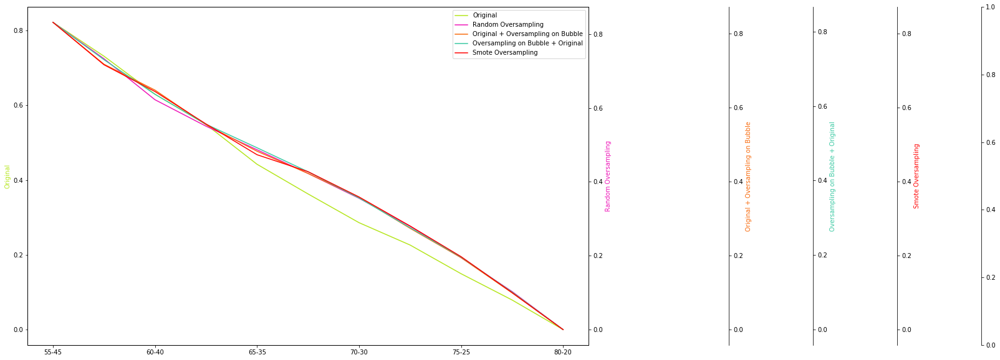

Total_Maxi_AccuracyKNN


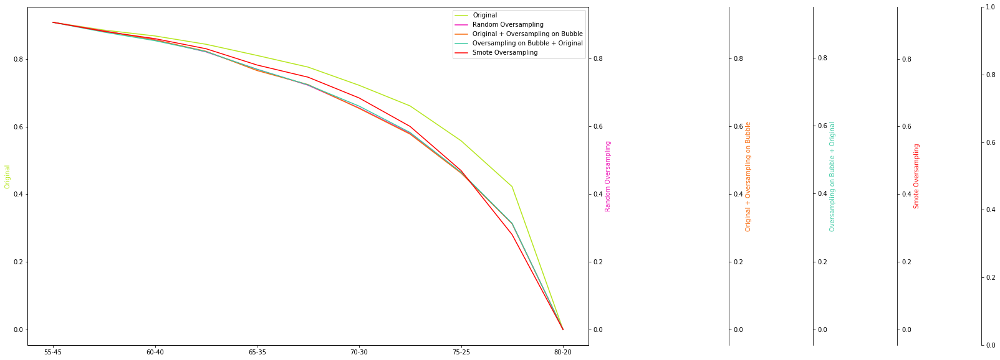

Total_Maxi_AccuracySVC


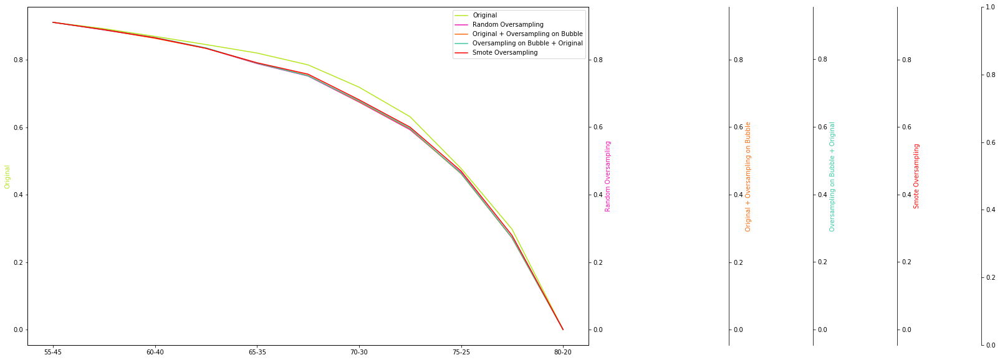

Total_Maxi_AccuracyRF


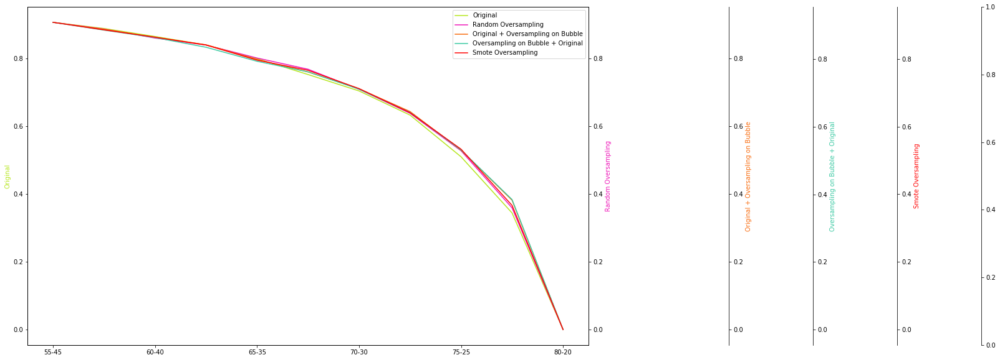

Total_Maxi_AccuracyDT


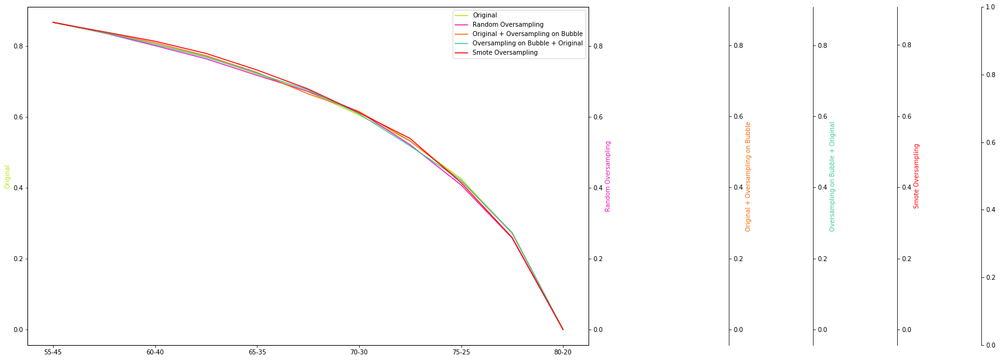

Total_Maxi_Precision 0SGD


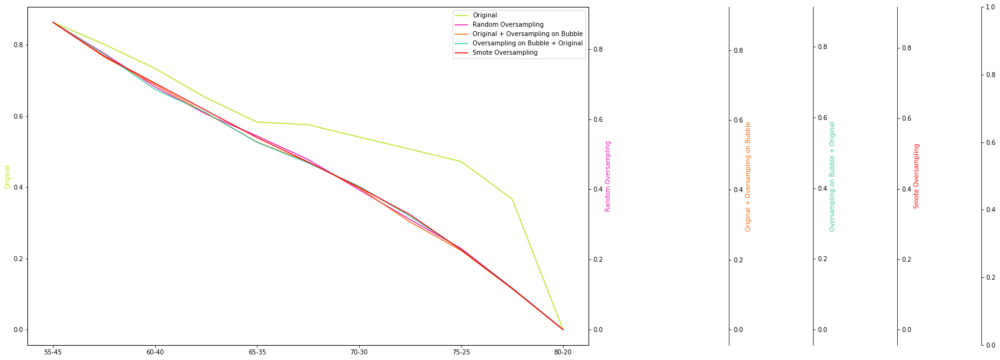

Total_Maxi_Precision 0KNN


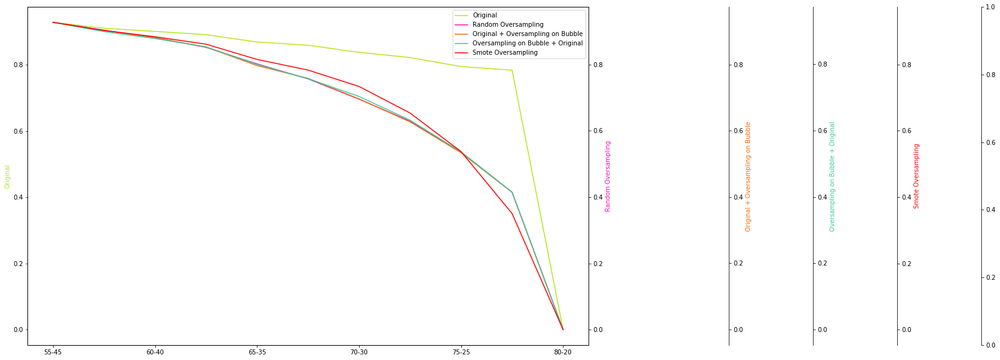

Total_Maxi_Precision 0SVC


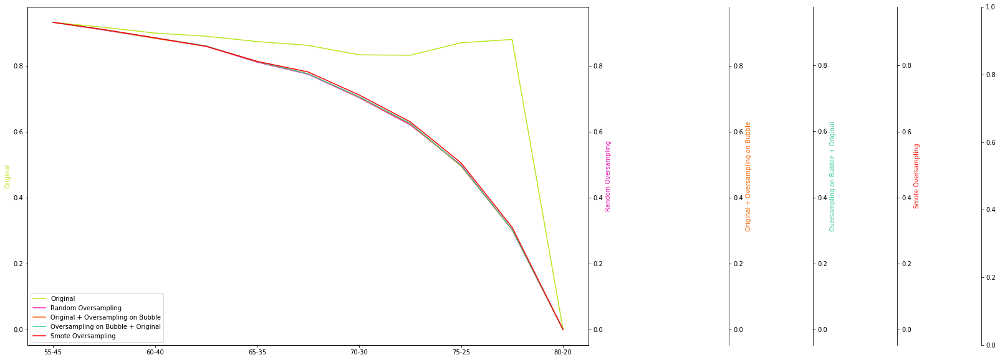

Total_Maxi_Precision 0RF


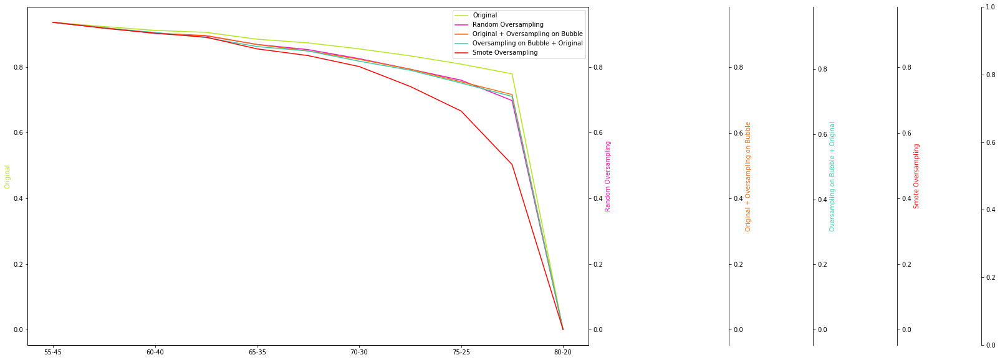

Total_Maxi_Precision 0DT


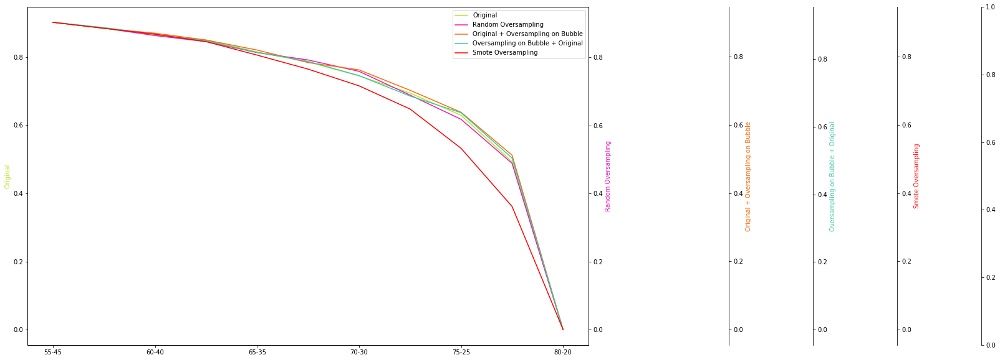

Total_Maxi_Precision 1SGD


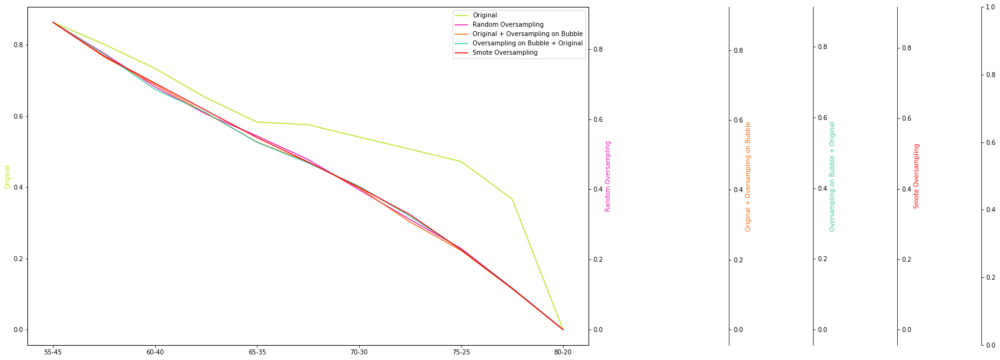

Total_Maxi_Precision 1KNN


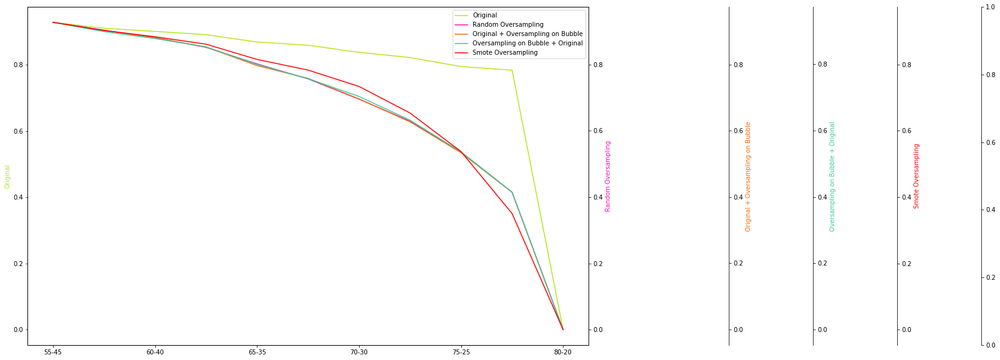

Total_Maxi_Precision 1SVC


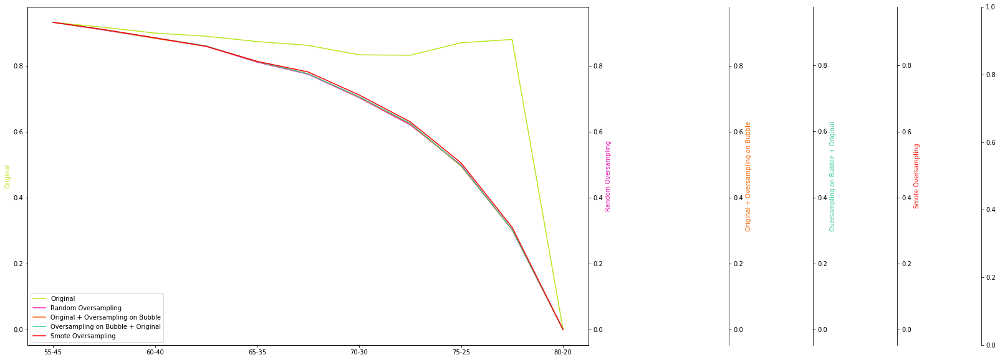

Total_Maxi_Precision 1RF


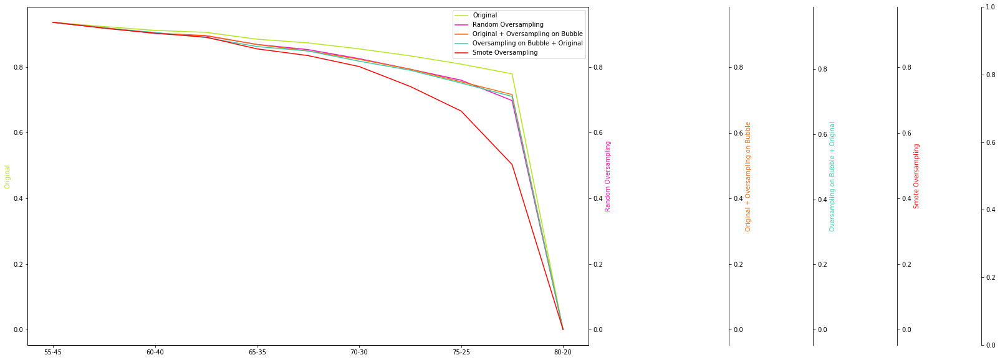

Total_Maxi_Precision 1DT


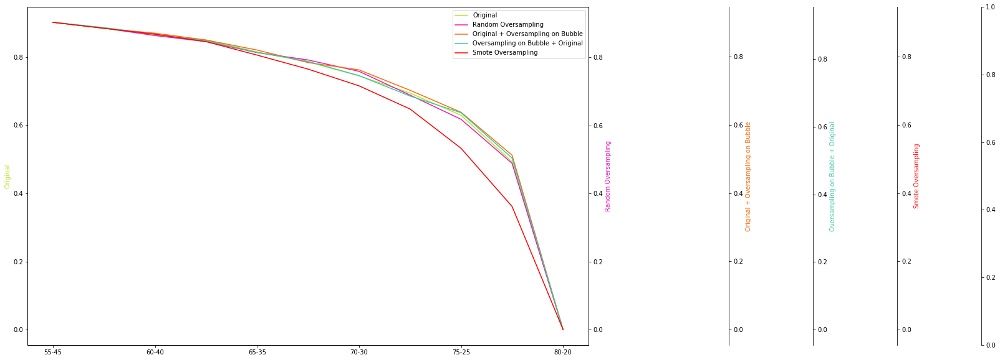

Total_Maxi_Recall 0SGD


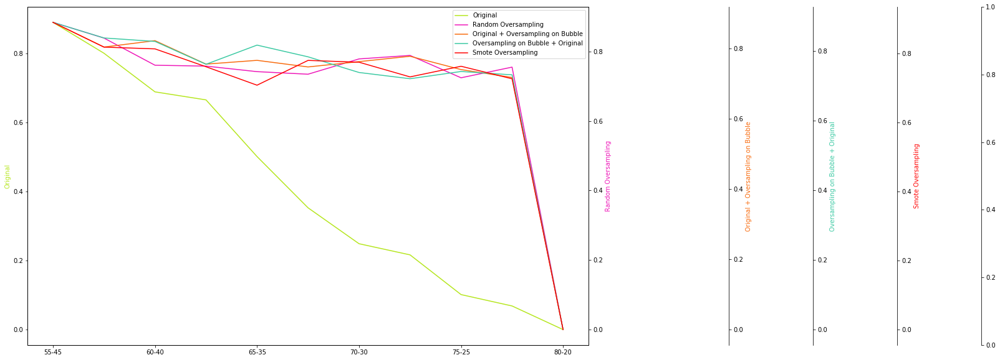

Total_Maxi_Recall 0KNN


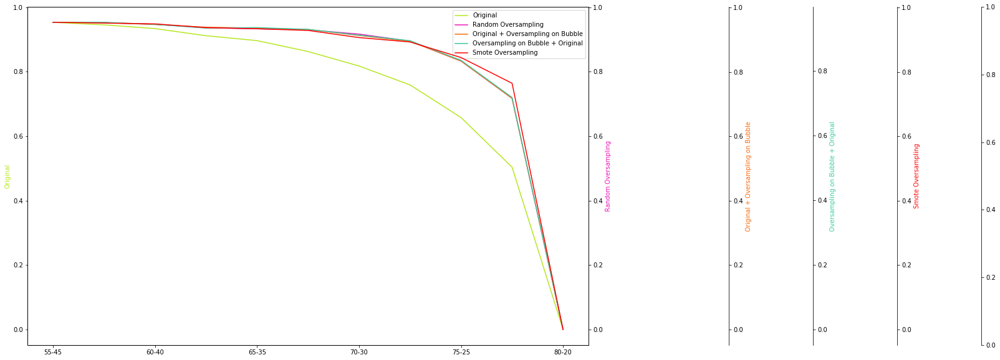

Total_Maxi_Recall 0SVC


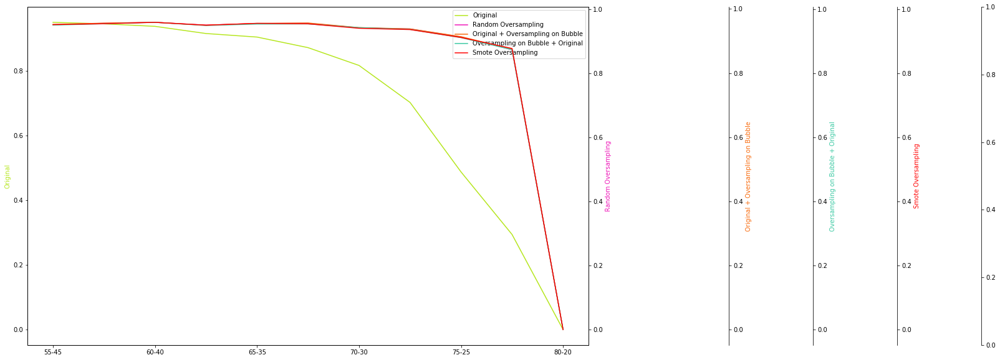

Total_Maxi_Recall 0RF


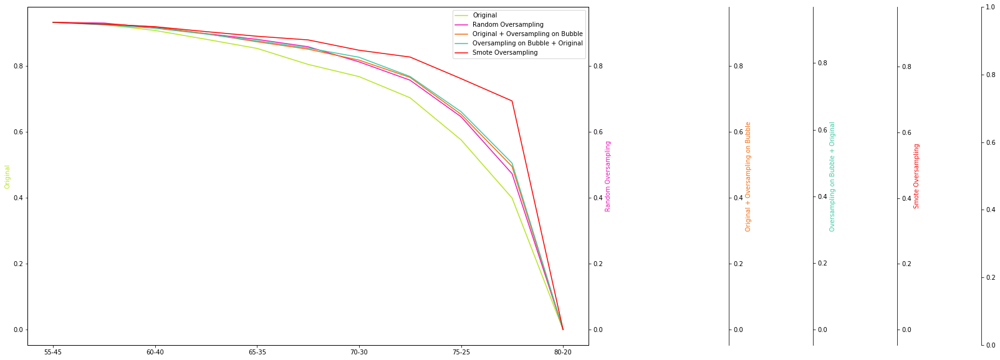

Total_Maxi_Recall 0DT


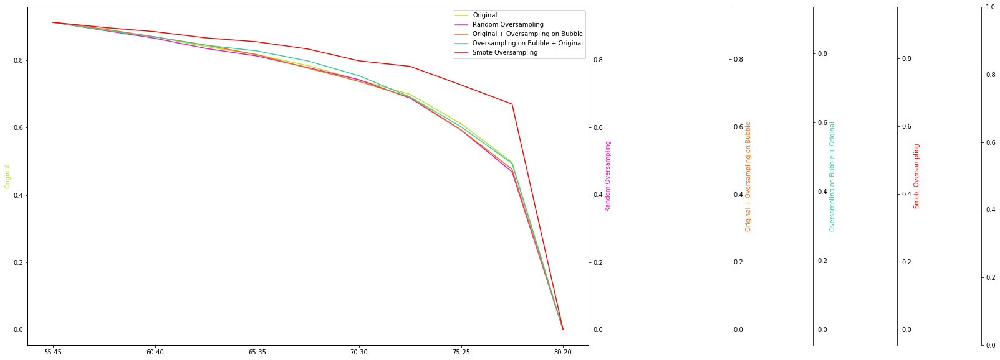

Total_Maxi_Recall1SGD


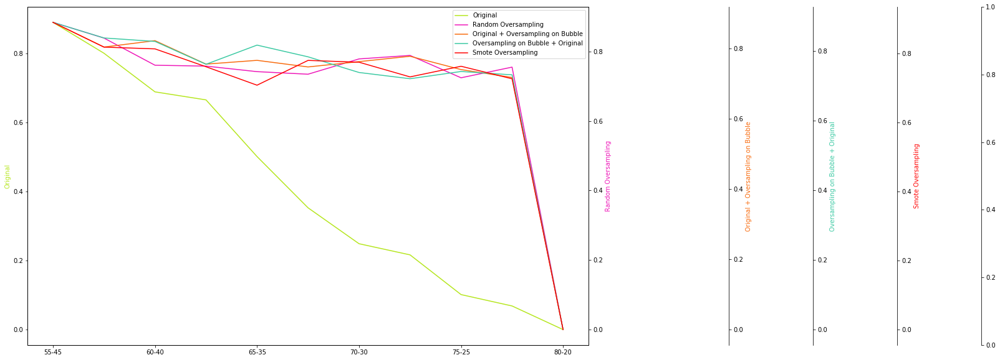

Total_Maxi_Recall1KNN


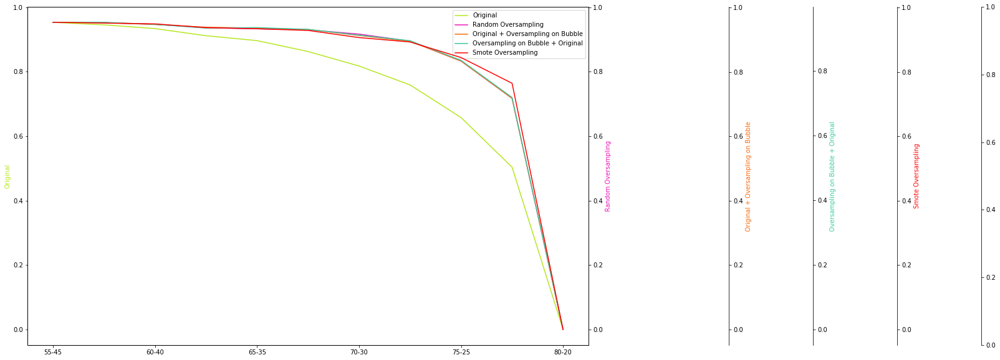

Total_Maxi_Recall1SVC


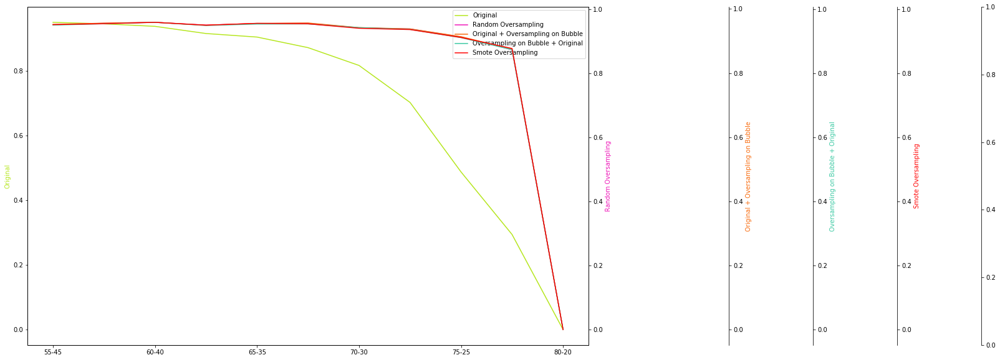

Total_Maxi_Recall1RF


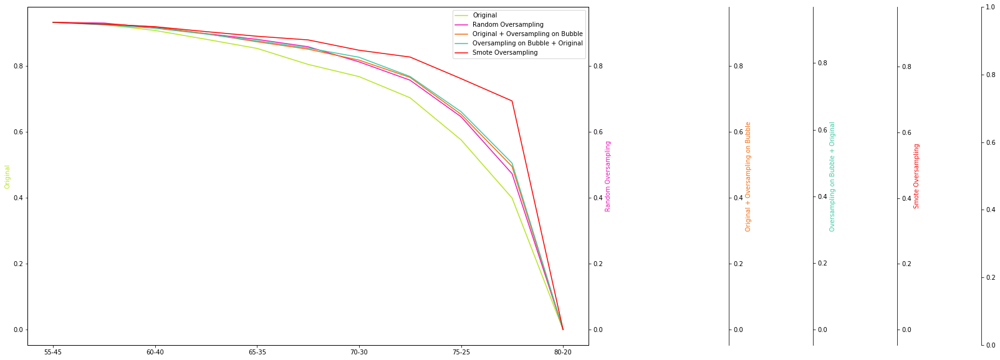

Total_Maxi_Recall1DT


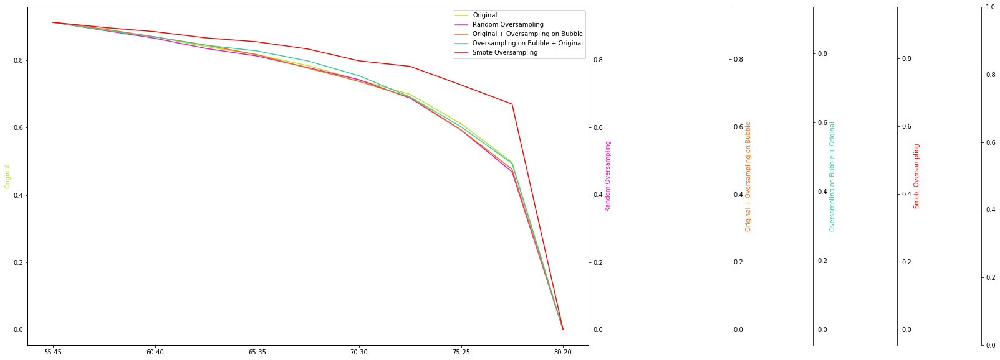

Total_Maxi_Balanced_AccuracySGD


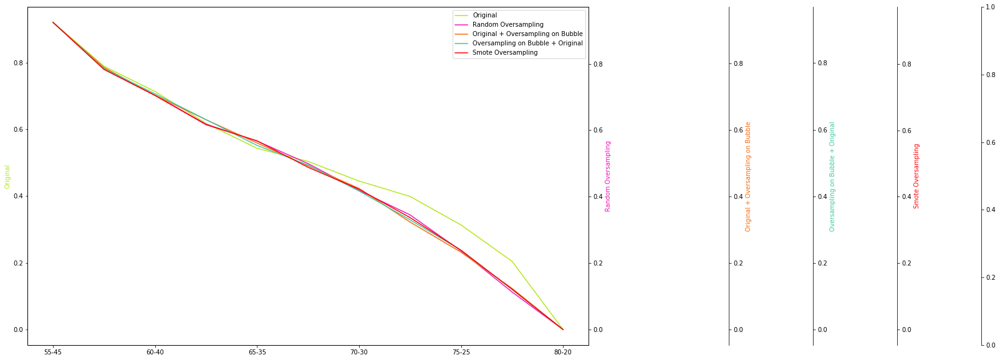

Total_Maxi_Balanced_AccuracyKNN


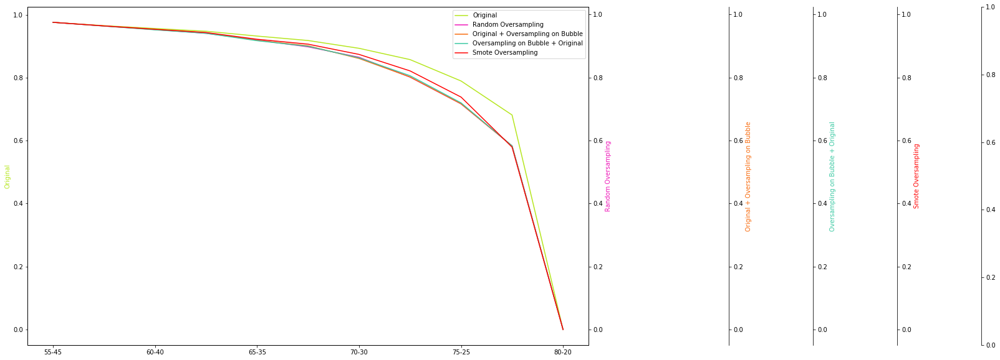

Total_Maxi_Balanced_AccuracySVC


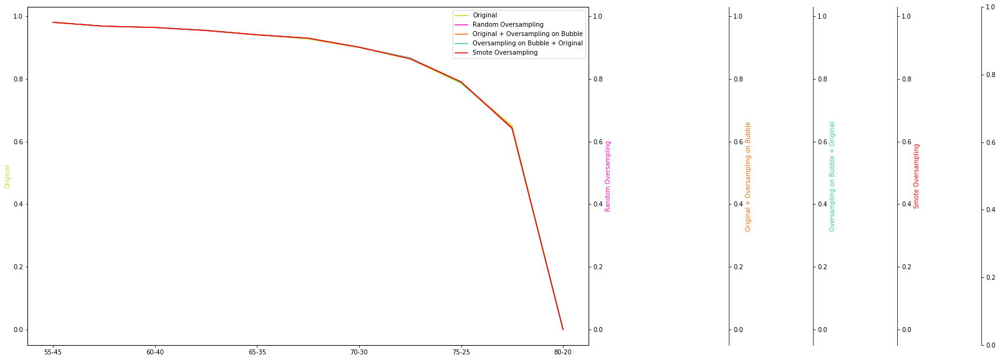

Total_Maxi_Balanced_AccuracyRF


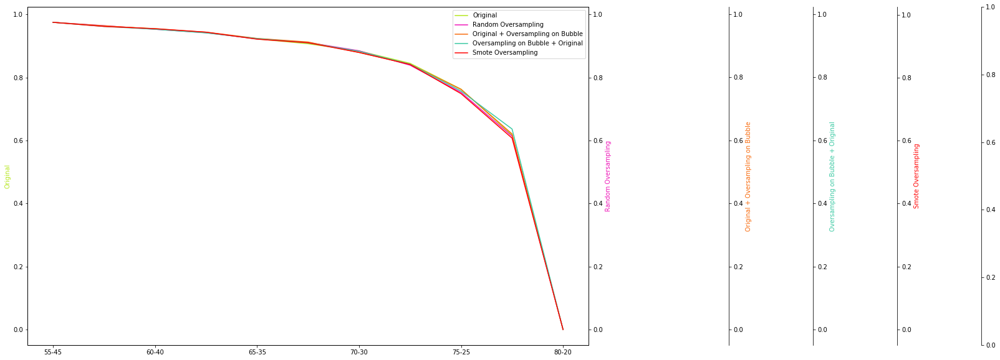

Total_Maxi_Balanced_AccuracyDT


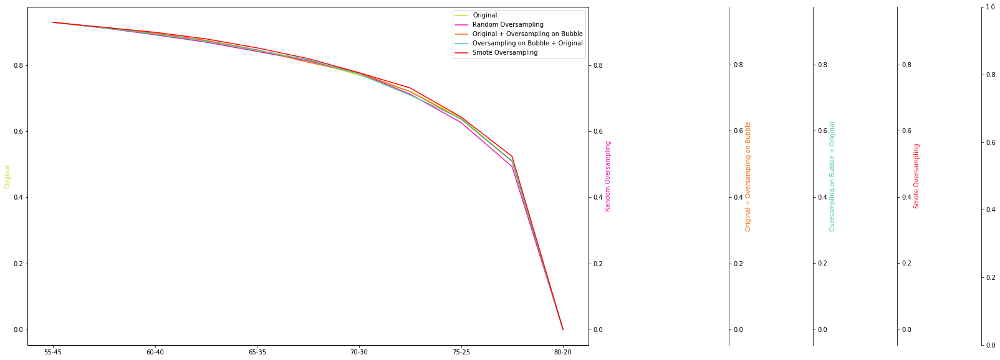

Total_Maxi_F1 Score 0SGD


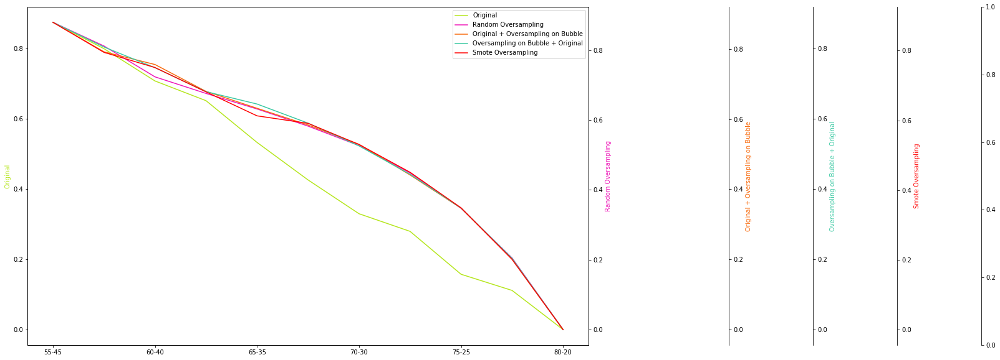

Total_Maxi_F1 Score 0KNN


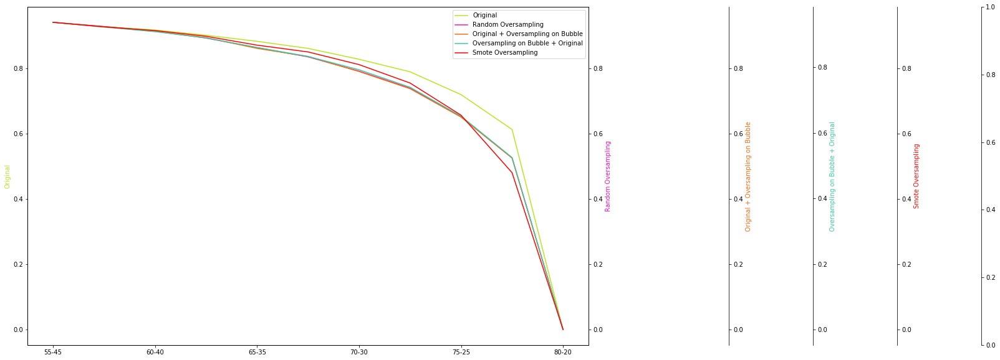

Total_Maxi_F1 Score 0SVC


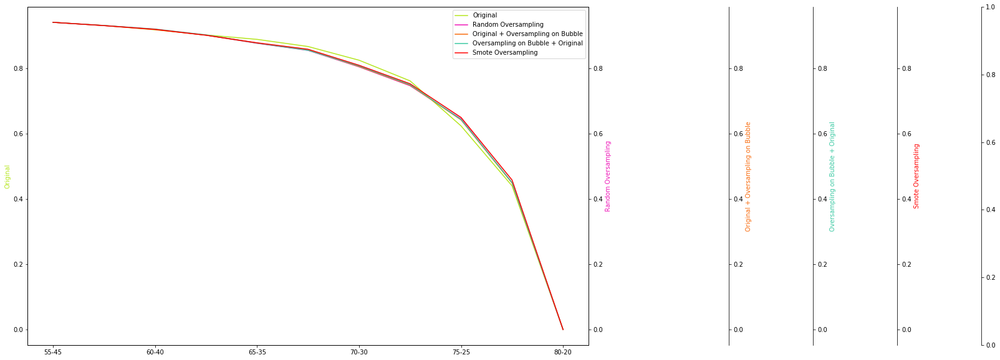

Total_Maxi_F1 Score 0RF


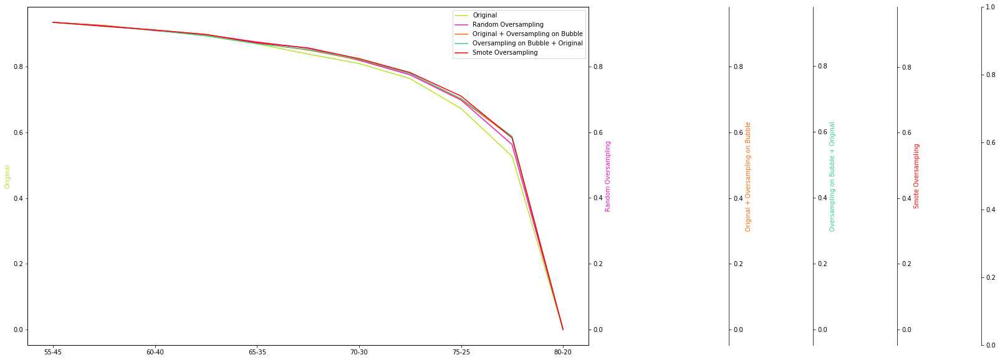

Total_Maxi_F1 Score 0DT


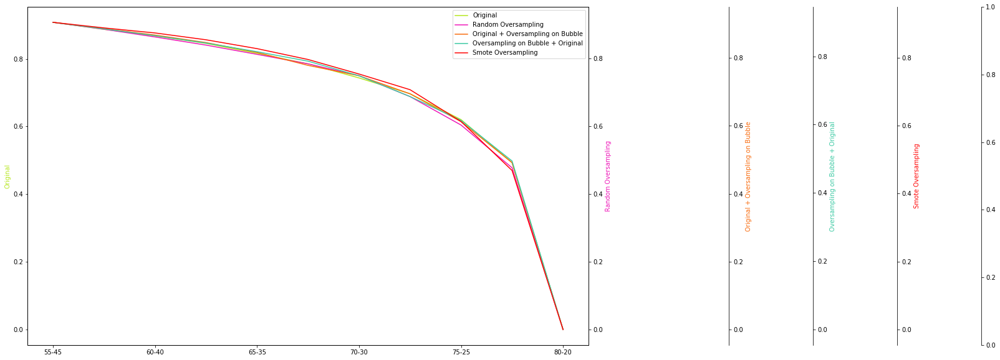

Total_Maxi_F1 Score 1SGD


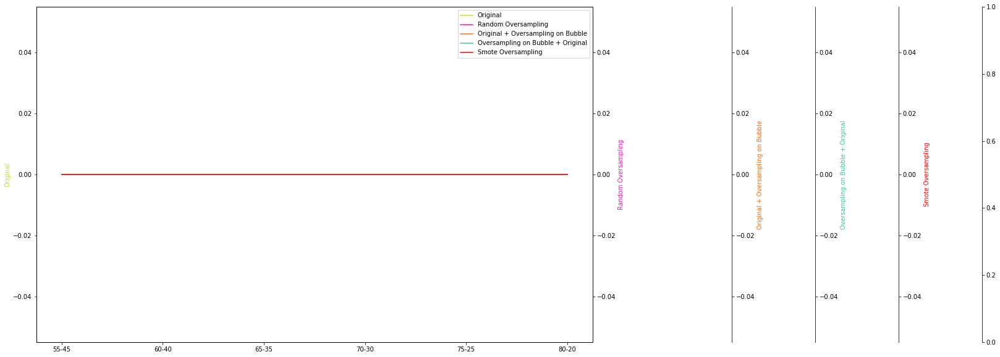

Total_Maxi_F1 Score 1KNN


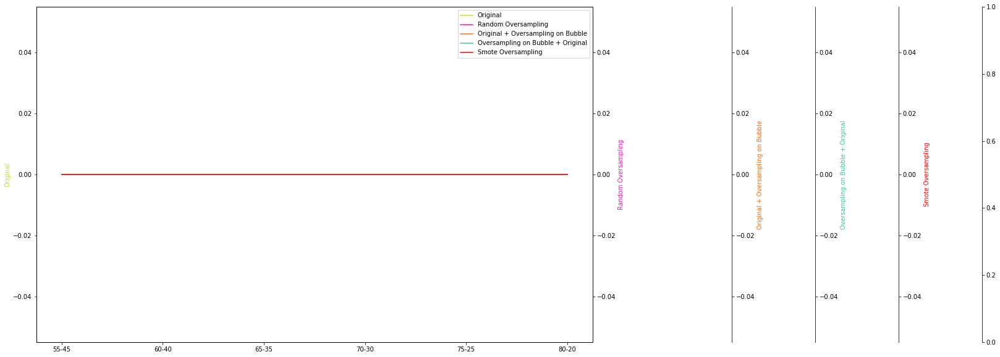

Total_Maxi_F1 Score 1SVC


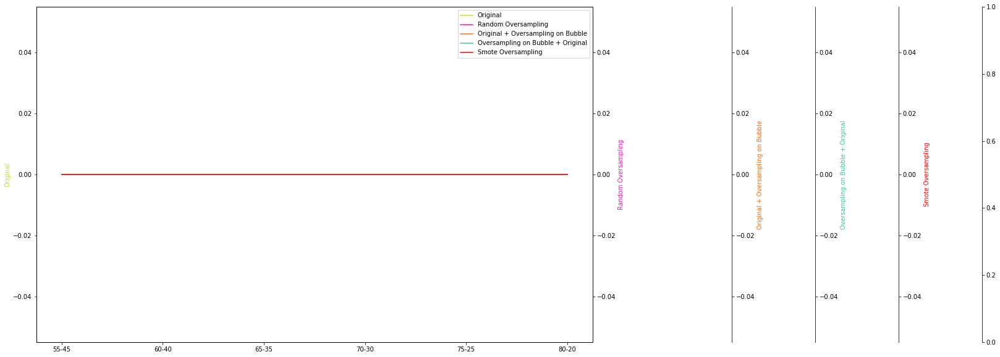

Total_Maxi_F1 Score 1RF


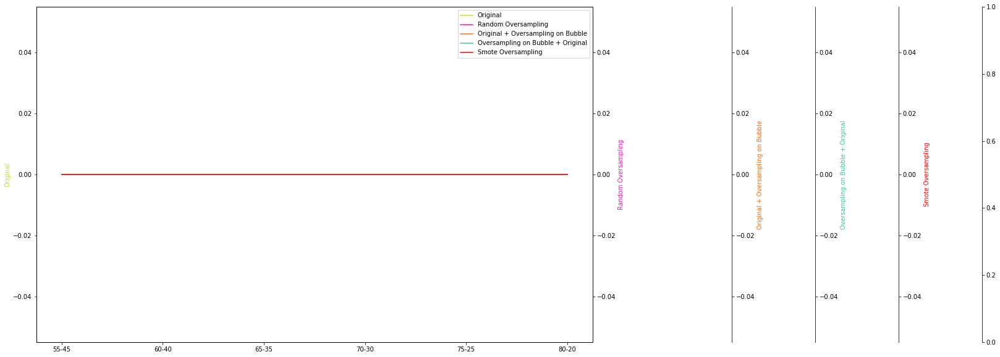

Total_Maxi_F1 Score 1DT


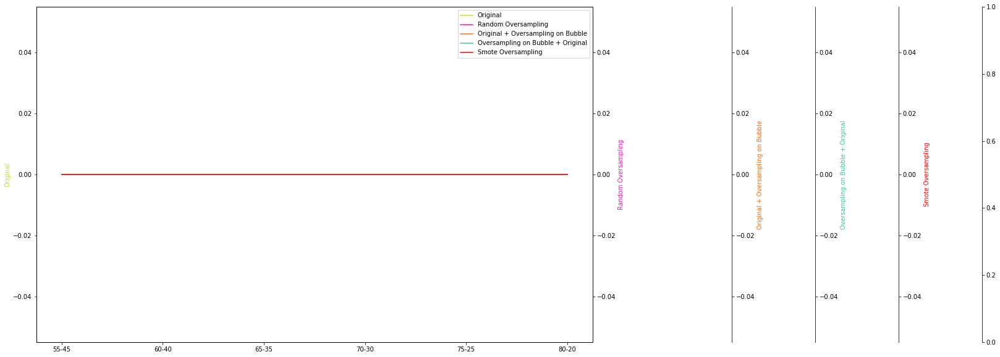

Total_Maxi_AUCSGD


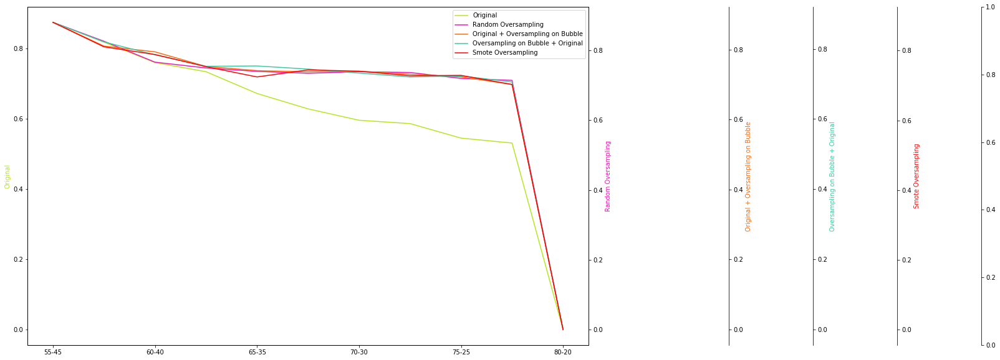

Total_Maxi_AUCKNN


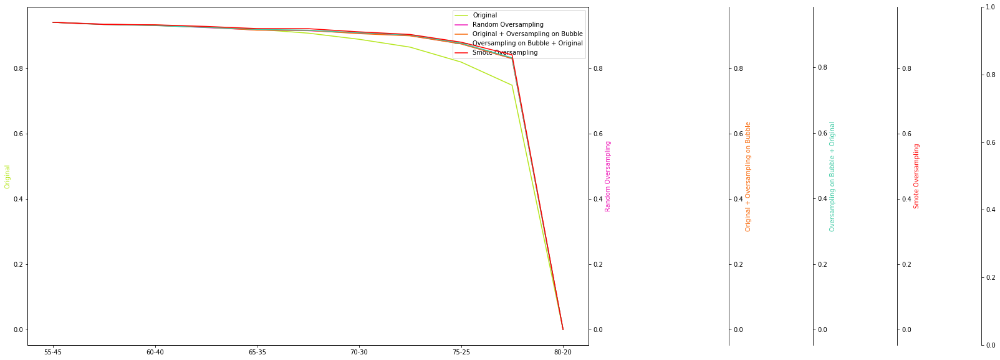

Total_Maxi_AUCSVC


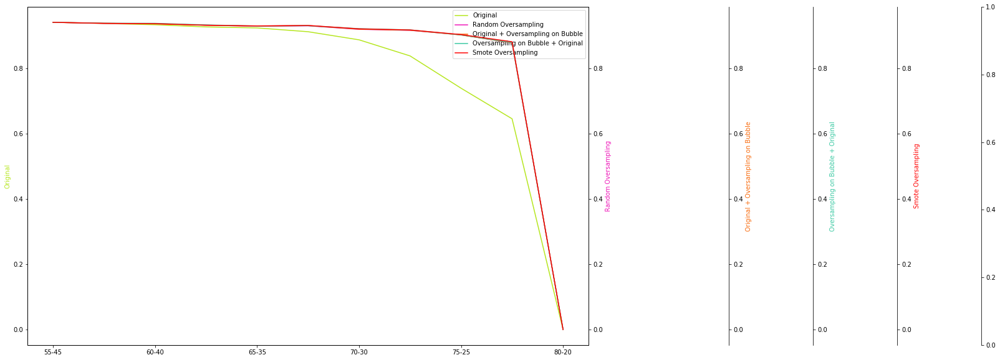

Total_Maxi_AUCRF


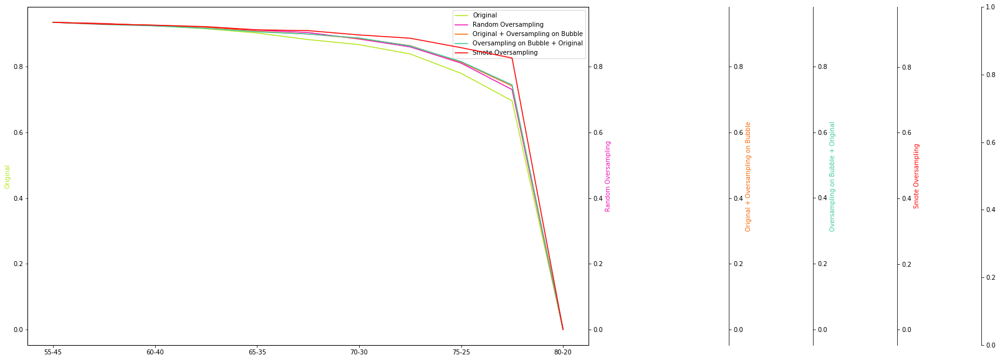

Total_Maxi_AUCDT


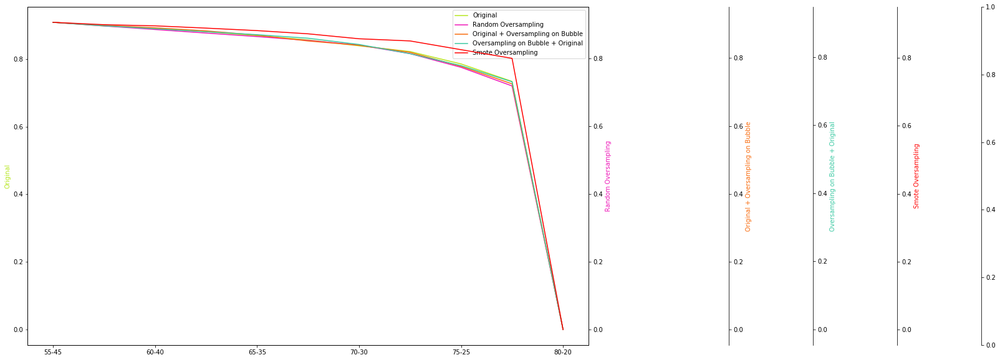

Total_Maxi_AUC Probs 0SGD


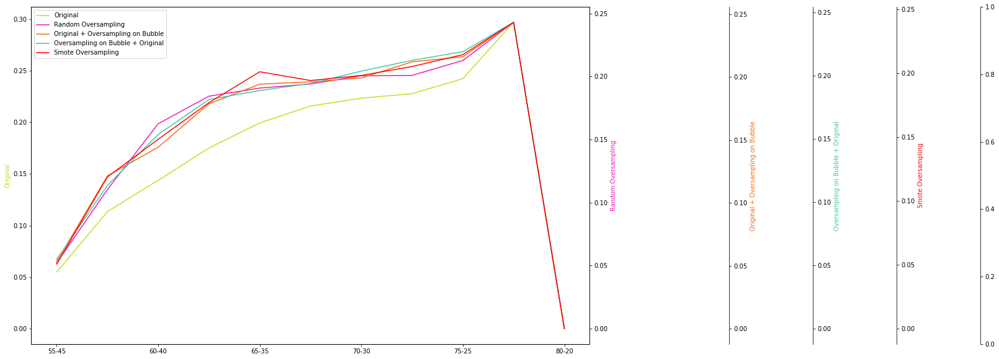

Total_Maxi_AUC Probs 0KNN


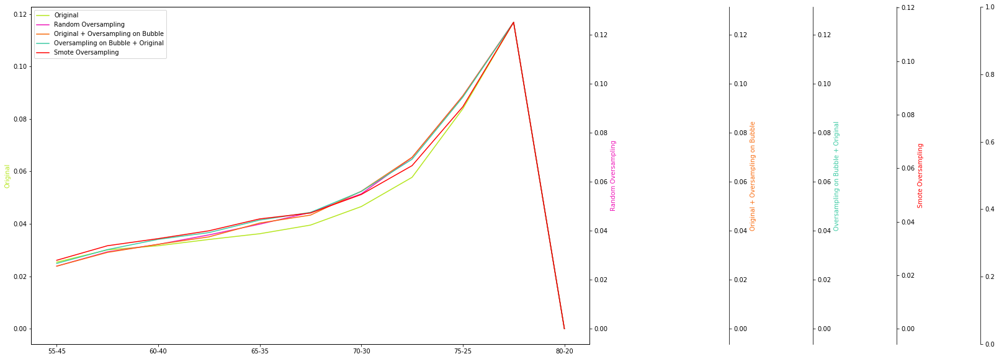

Total_Maxi_AUC Probs 0SVC


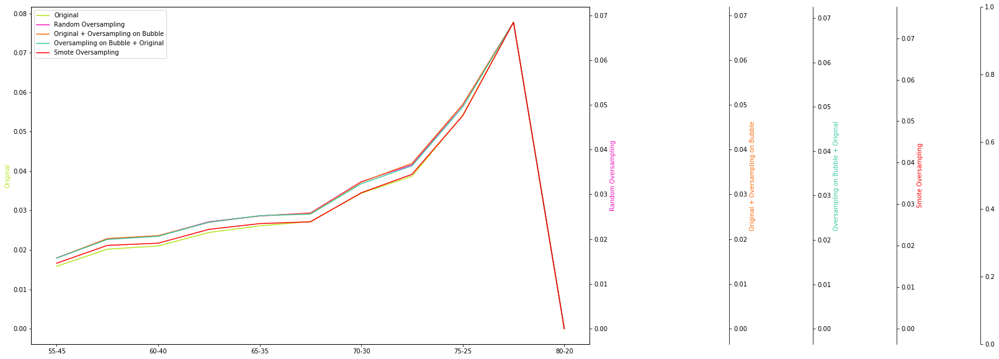

Total_Maxi_AUC Probs 0RF


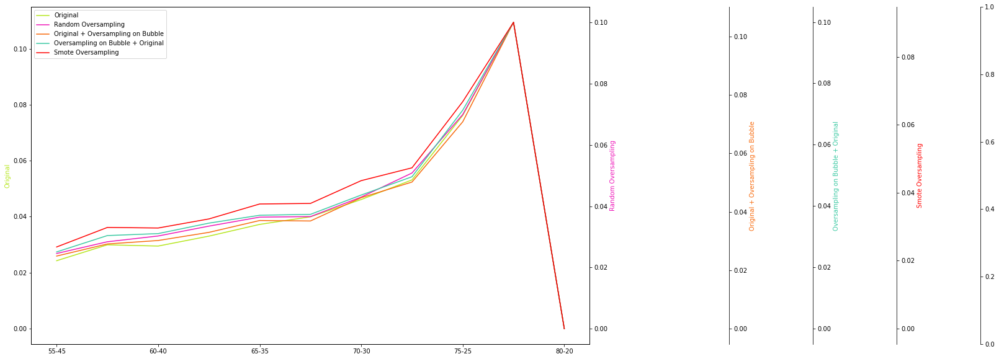

Total_Maxi_AUC Probs 0DT


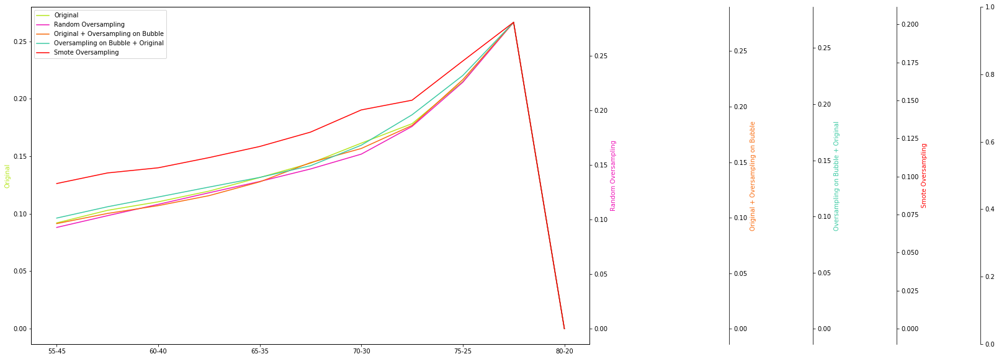

Total_Maxi_AUC Probs 1SGD


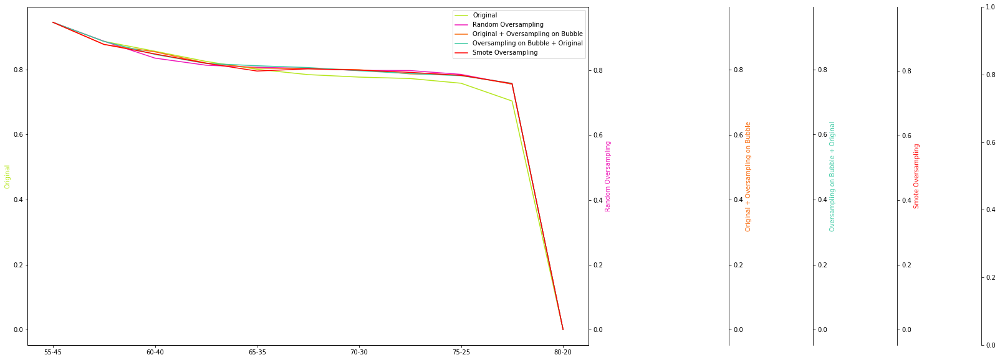

Total_Maxi_AUC Probs 1KNN


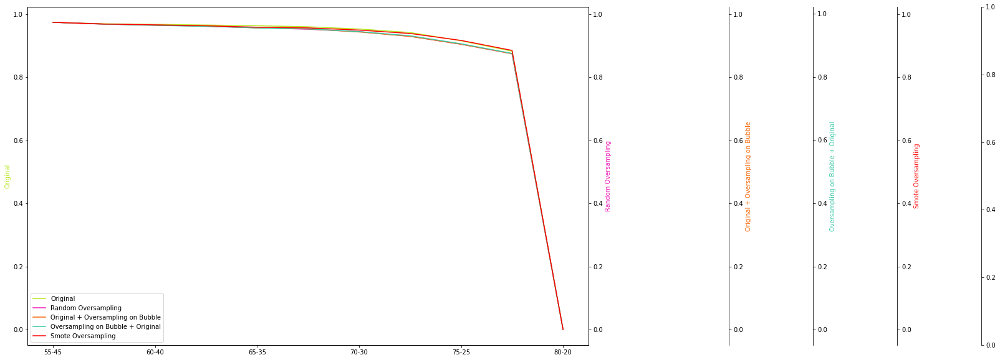

Total_Maxi_AUC Probs 1SVC


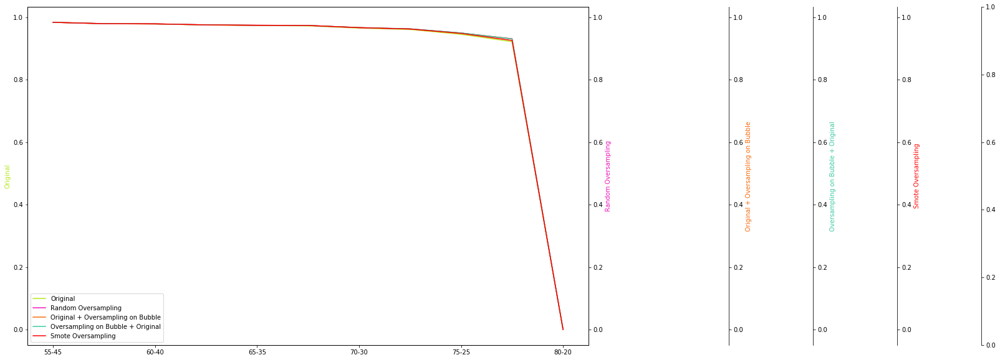

Total_Maxi_AUC Probs 1RF


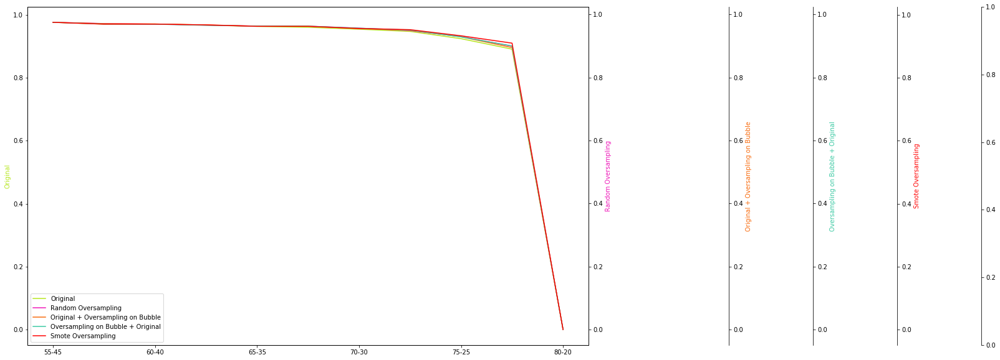

Total_Maxi_AUC Probs 1DT


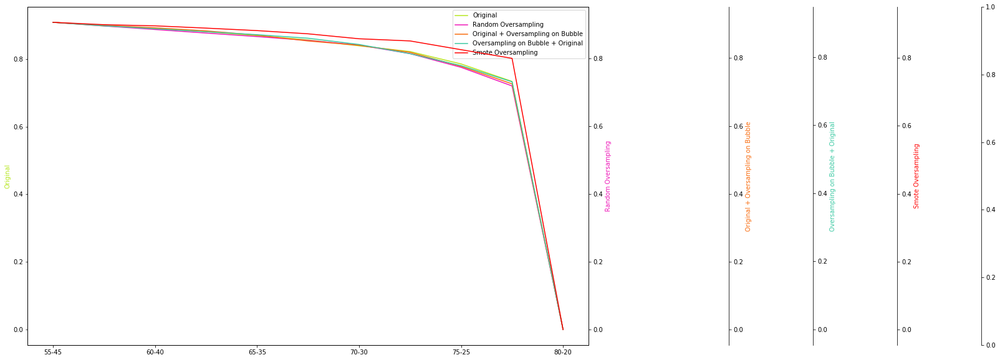

In [11]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1], 4, 'normCats_realSnowBubbles15r-15r_ray10Bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    

## Midi

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:01
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:00
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:00
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:00
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:01
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bull

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.692350103517 , Precicion 0:  0.72228443449 , Precision 1 0.72228443449 , Recall 1:  0.868102288022 , Recall 0:  0.868102288022 , PR AUC:  0.70513559648 , F1 Score 0:  0.788508557457 , F1 Score1:  0.788508557457 , AUC:  0.770246652597 , AUC Probs 0:  0.183249740866 , AUC Probs 1:  0.816750259134
         2
           Average Precision:  0.709381336922 , Precicion 0:  0.743055555556 , Precision 1 0.743055555556 , Recall 1:  0.864064602961 , Recall 0:  0.864064602961 , PR AUC:  0.766523158857 , F1 Score 0:  0.799004355943 , F1 Score1:  0.799004355943 , AUC:  0.785400861586 , AUC Probs 0:  0.15975791669 , AUC Probs 1:  0.84024208331
         3
           Average Precision:  0.711800864809 , Precicion 0:  0.729787234043 , Precision 1 0.729787234043 , Recall 1:  0.923283983849 , Recall 0:  0.923283983849 , PR AUC:  0.757350158181 , F1 Score 0:  0.815210932858 , F1 Score1:  0.815210932858 , AUC:  0.793874488622 , AUC Probs 0:  0.159059189156 , AUC Probs 1:  0.

           Average Precision:  0.945470279272 , Precicion 0:  0.981455064194 , Precision 1 0.981455064194 , Recall 1:  0.92597577389 , Recall 0:  0.92597577389 , PR AUC:  0.985593733221 , F1 Score 0:  0.952908587258 , F1 Score1:  0.952908587258 , AUC:  0.954401361185 , AUC Probs 0:  0.0203751082317 , AUC Probs 1:  0.979624891768
         3
           Average Precision:  0.926493159811 , Precicion 0:  0.968526466381 , Precision 1 0.968526466381 , Recall 1:  0.911170928668 , Recall 0:  0.911170928668 , PR AUC:  0.98206691505 , F1 Score 0:  0.938973647712 , F1 Score1:  0.938973647712 , AUC:  0.941054420741 , AUC Probs 0:  0.0249017247725 , AUC Probs 1:  0.975098275228
         4
           Average Precision:  0.925306415433 , Precicion 0:  0.958333333333 , Precision 1 0.958333333333 , Recall 1:  0.92866756393 , Recall 0:  0.92866756393 , PR AUC:  0.984388202595 , F1 Score 0:  0.943267259057 , F1 Score1:  0.943267259057 , AUC:  0.94451872252 , AUC Probs 0:  0.0196879372603 , AUC Probs 1:  

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , Recall 0:  0.93135935397 , PR AUC:  0.987543426965 , F1 Score 0:  0.951856946355 , F1 Score1:  0.951856946355 , AUC:  0.953130139337 , AUC Probs 0:  0.016613891699 , AUC Probs 1:  0.983386108301
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.937928012549 , Precicion 0:  0.970546984572 , Precision 1 0.970546984572 , Recall 1:  0.93135935397 , Recall 0:  0.93135935397 , PR AUC:  0.98628407034 , F1 Score 0:  0.950549450549 , F1 Score1:  0.950549450549 , AUC:  0.951809135374 , AUC Probs 0:  0.017305507502 , AUC Probs 1:  0.982694492498
         1
           Average Precision:  0.952257999178 , Precicion 0:  0.981715893108 , Precision 1 0.981715893108 , Recall 1:  0.939434724092 , Recall 0:  0.939434724092 , PR AUC:  0.989241594557 , F1 Score 0:  0.960110041265 , F1 Score1:  0.960110041265 , AUC:  0.961130836286 , AUC Probs 0:  0.0138154256993 , AUC Probs 1:  0.98618457430

           Average Precision:  0.930560598685 , Precicion 0:  0.968794326241 , Precision 1 0.968794326241 , Recall 1:  0.919246298789 , Recall 0:  0.919246298789 , PR AUC:  0.987586648631 , F1 Score 0:  0.943370165746 , F1 Score1:  0.943370165746 , AUC:  0.945092105801 , AUC Probs 0:  0.0124561961842 , AUC Probs 1:  0.987543803816
         1
           Average Precision:  0.949327788375 , Precicion 0:  0.987050359712 , Precision 1 0.987050359712 , Recall 1:  0.923283983849 , Recall 0:  0.923283983849 , PR AUC:  0.988545893191 , F1 Score 0:  0.954102920723 , F1 Score1:  0.954102920723 , AUC:  0.955697474091 , AUC Probs 0:  0.0118250300915 , AUC Probs 1:  0.988174969908
         2
           Average Precision:  0.941228944722 , Precicion 0:  0.985422740525 , Precision 1 0.985422740525 , Recall 1:  0.909825033647 , Recall 0:  0.909825033647 , PR AUC:  0.988342275851 , F1 Score 0:  0.94611616515 , F1 Score1:  0.94611616515 , AUC:  0.948307497009 , AUC Probs 0:  0.011647236826 , AUC Probs 1

           Average Precision:  0.939142823213 , Precicion 0:  0.986764705882 , Precision 1 0.986764705882 , Recall 1:  0.903095558546 , Recall 0:  0.903095558546 , PR AUC:  0.988362834335 , F1 Score 0:  0.943078004216 , F1 Score1:  0.943078004216 , AUC:  0.94560326144 , AUC Probs 0:  0.0113325427459 , AUC Probs 1:  0.988667457254
         3
           Average Precision:  0.92504546436 , Precicion 0:  0.969740634006 , Precision 1 0.969740634006 , Recall 1:  0.905787348587 , Recall 0:  0.905787348587 , PR AUC:  0.985037585582 , F1 Score 0:  0.936673625609 , F1 Score1:  0.936673625609 , AUC:  0.939023132682 , AUC Probs 0:  0.0156244721762 , AUC Probs 1:  0.984375527824
         4
           Average Precision:  0.924754407568 , Precicion 0:  0.964539007092 , Precision 1 0.964539007092 , Recall 1:  0.915208613728 , Recall 0:  0.915208613728 , PR AUC:  0.983618125537 , F1 Score 0:  0.939226519337 , F1 Score1:  0.939226519337 , AUC:  0.941091757326 , AUC Probs 0:  0.0132758231384 , AUC Probs 

           Average Precision:  0.923642889188 , Precicion 0:  0.954545454545 , Precision 1 0.954545454545 , Recall 1:  0.932705248991 , Recall 0:  0.932705248991 , PR AUC:  0.986100841069 , F1 Score 0:  0.943498978897 , F1 Score1:  0.943498978897 , AUC:  0.944556059106 , AUC Probs 0:  0.0162680837975 , AUC Probs 1:  0.983731916202
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.923225374509 , Precicion 0:  0.952120383037 , Precision 1 0.952120383037 , Recall 1:  0.936742934051 , Recall 0:  0.936742934051 , PR AUC:  0.985532247259 , F1 Score 0:  0.944369063772 , F1 Score1:  0.944369063772 , AUC:  0.945253897673 , AUC Probs 0:  0.0154733479005 , AUC Probs 1:  0.984526652099
         1
           Average Precision:  0.936077380192 , Precicion 0:  0.967877094972 , Precision 1 0.967877094972 , Recall 1:  0.932705248991 , Recall 0:  0.932705248991 , PR AUC:  0.986366821936 , F1 Score 0:  0.949965729952

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.91499447507 , Precicion 0:  0.946575342466 , Precision 1 0.946575342466 , Recall 1:  0.93001345895 , Recall 0:  0.93001345895 , PR AUC:  0.983572819285 , F1 Score 0:  0.93822131704 , F1 Score1:  0.93822131704 , AUC:  0.939247152196 , AUC Probs 0:  0.0179028928742 , AUC Probs 1:  0.982097107126
         1
           Average Precision:  0.935698117978 , Precicion 0:  0.96408839779 , Precision 1 0.96408839779 , Recall 1:  0.939434724092 , Recall 0:  0.939434724092 , PR AUC:  0.990518449543 , F1 Score 0:  0.951601908657 , F1 Score1:  0.951601908657 , AUC:  0.952544310527 , AUC Probs 0:  0.0102960080078 , AUC Probs 1:  0.989703991992
         2
           Average Precision:  0.929252412093 , Precicion 0:  0.959889349931 , Precision 1 0.959889349931 , Recall 1:  0.934051144011 , Recall 0:  0.934051144011 , PR AUC:  0.984008419201 , F1 Score 0:  0.946793997271 , F1 Score1:  0.946793997271 , AUC

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.921196983815 , Precicion 0:  0.951923076923 , Precision 1 0.951923076923 , Recall 1:  0.932705248991 , Recall 0:  0.932705248991 , PR AUC:  0.983892370819 , F1 Score 0:  0.94221617947 , F1 Score1:  0.94221617947 , AUC:  0.943235055143 , AUC Probs 0:  0.0159151641654 , AUC Probs 1:  0.984084835835
         5
           Average Precision:  0.919214656059 , Precicion 0:  0.957805907173 , Precision 1 0.957805907173 , Recall 1:  0.916554508748 , Recall 0:  0.916554508748 , PR AUC:  0.984974915404 , F1 Score 0:  0.936726272352 , F1 Score1:  0.936726272352 , AUC:  0.938462194929 , AUC Probs 0:  0.0183544877687 , AUC Probs 1:  0.981645512231
         6
           Average Precision:  0.918904423092 , Precicion 0:  0.948158253752 , Precision 1 0.948158253752 , Recall 1:  0.935397039031 , Recall 0:  0.935397039031 , PR AUC:  0.983050353332 , F1 Score 0:  0.941734417344 , F1 Score1:  0.941734417344 , AUC:  0.942599444218 , AUC Probs 0:  0.0194852529376 , AUC Probs 

           Average Precision:  0.898546371498 , Precicion 0:  0.936551724138 , Precision 1 0.936551724138 , Recall 1:  0.913862718708 , Recall 0:  0.913862718708 , PR AUC:  0.946540554756 , F1 Score 0:  0.925068119891 , F1 Score1:  0.925068119891 , AUC:  0.926548268205 , AUC Probs 0:  0.0734517317953 , AUC Probs 1:  0.926548268205
         6
           Average Precision:  0.88623034486 , Precicion 0:  0.923705722071 , Precision 1 0.923705722071 , Recall 1:  0.912516823688 , Recall 0:  0.912516823688 , PR AUC:  0.939777939546 , F1 Score 0:  0.91807718348 , F1 Score1:  0.91807718348 , AUC:  0.91927030088 , AUC Probs 0:  0.0807296991205 , AUC Probs 1:  0.91927030088
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.880527388083 , Precicion 0:  0.917456021651 , Precision 1 0.917456021651 , Recall 1:  0.912516823688 , Recall 0:  0.912516823688 , PR AUC:  0.936653089336 , F1 Score 0:  0.914979757085 , F1

           Average Precision:  0.887861448301 , Precicion 0:  0.926128590971 , Precision 1 0.926128590971 , Recall 1:  0.911170928668 , Recall 0:  0.911170928668 , PR AUC:  0.940649759819 , F1 Score 0:  0.918588873813 , F1 Score1:  0.918588873813 , AUC:  0.919918357332 , AUC Probs 0:  0.0800816426675 , AUC Probs 1:  0.919918357332
         6
           Average Precision:  0.892193794174 , Precicion 0:  0.928961748634 , Precision 1 0.928961748634 , Recall 1:  0.915208613728 , Recall 0:  0.915208613728 , PR AUC:  0.943085181181 , F1 Score 0:  0.922033898305 , F1 Score1:  0.922033898305 , AUC:  0.923258203826 , AUC Probs 0:  0.0767417961742 , AUC Probs 1:  0.923258203826
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:01
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.888497057102 , Precicion 0- 0.924249324625 , Precision 1- 0.924249324625 , Recall 1- 0.916554508748 , Recall 0- 0.91

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.657126503093 , Precicion 0:  0.691299165673 , Precision 1 0.691299165673 , Recall 1:  0.85798816568 , Recall 0:  0.85798816568 , PR AUC:  0.778863850368 , F1 Score 0:  0.765676567657 , F1 Score1:  0.765676567657 , AUC:  0.771833888665 , AUC Probs 0:  0.155903515827 , AUC Probs 1:  0.844096484173
         1
           Average Precision:  0.665780168549 , Precicion 0:  0.701818181818 , Precision 1 0.701818181818 , Recall 1:  0.85650887574 , Recall 0:  0.85650887574 , PR AUC:  0.735630965246 , F1 Score 0:  0.771485676216 , F1 Score1:  0.771485676216 , AUC:  0.77898259321 , AUC Probs 0:  0.166495519044 , AUC Probs 1:  0.833504480956
         2
           Average Precision:  0.663598097227 , Precicion 0:  0.705882352941 , Precision 1 0.705882352941 , Recall 1:  0.834319526627 , Recall 0:  0.834319526627 , PR AUC:  0.76687923799 , F1 Score 0:  0.764745762712 , F1 Score1:  0.764745762712 , AUC:  0.774562675935 , AUC Probs 0:  0.153095737347 , AUC Probs 1:  0.8

           Average Precision:  0.913163940292 , Precicion 0:  0.958074534161 , Precision 1 0.958074534161 , Recall 1:  0.911373707533 , Recall 0:  0.911373707533 , PR AUC:  0.977928018455 , F1 Score 0:  0.934140802422 , F1 Score1:  0.934140802422 , AUC:  0.939283451579 , AUC Probs 0:  0.0270213273842 , AUC Probs 1:  0.972978672616
         5
           Average Precision:  0.902931882918 , Precicion 0:  0.951713395639 , Precision 1 0.951713395639 , Recall 1:  0.902511078287 , Recall 0:  0.902511078287 , PR AUC:  0.97276738509 , F1 Score 0:  0.926459438969 , F1 Score1:  0.926459438969 , AUC:  0.932422003299 , AUC Probs 0:  0.030496921053 , AUC Probs 1:  0.969503078947
         6
           Average Precision:  0.926391233589 , Precicion 0:  0.961832061069 , Precision 1 0.961832061069 , Recall 1:  0.930576070901 , Recall 0:  0.930576070901 , PR AUC:  0.982237900541 , F1 Score 0:  0.945945945946 , F1 Score1:  0.945945945946 , AUC:  0.950099700092 , AUC Probs 0:  0.0199274549465 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.908796229104 , Precicion 0:  0.943028485757 , Precision 1 0.943028485757 , Recall 1:  0.930473372781 , Recall 0:  0.930473372781 , PR AUC:  0.979125497669 , F1 Score 0:  0.936708860759 , F1 Score1:  0.936708860759 , AUC:  0.942178433963 , AUC Probs 0:  0.0226076434768 , AUC Probs 1:  0.977392356523
         2
           Average Precision:  0.909010410149 , Precicion 0:  0.945619335347 , Precision 1 0.945619335347 , Recall 1:  0.926035502959 , Recall 0:  0.926035502959 , PR AUC:  0.973698913773 , F1 Score 0:  0.935724962631 , F1 Score1:  0.935724962631 , AUC:  0.941173091285 , AUC Probs 0:  0.0294403831792 , AUC Probs 1:  0.970559616821
         3
           Average Precision:  0.914544433839 , Precicion 0:  0.947526236882 , Precision 1 0.947526236882 , Recall 1:  0.93353028065 , Recall 0:  0.93353028065 , PR AUC:  0.973283424554 , F1 Score 0:  0.940476190476 , F1 Score1:  0.940476190476 , AUC:  0.945501470823 , AUC Probs 0:  0.0282606237582 , AUC Probs 

           Average Precision:  0.897367311151 , Precicion 0:  0.962479608483 , Precision 1 0.962479608483 , Recall 1:  0.872781065089 , Recall 0:  0.872781065089 , PR AUC:  0.977478906592 , F1 Score 0:  0.915438324282 , F1 Score1:  0.915438324282 , AUC:  0.922434221865 , AUC Probs 0:  0.0203276699029 , AUC Probs 1:  0.979672330097
         1
           Average Precision:  0.924788377805 , Precicion 0:  0.970125786164 , Precision 1 0.970125786164 , Recall 1:  0.912721893491 , Recall 0:  0.912721893491 , PR AUC:  0.980549828969 , F1 Score 0:  0.940548780488 , F1 Score1:  0.940548780488 , AUC:  0.944831820532 , AUC Probs 0:  0.0174112785086 , AUC Probs 1:  0.982588721491
         2
           Average Precision:  0.906764556399 , Precicion 0:  0.956112852665 , Precision 1 0.956112852665 , Recall 1:  0.902366863905 , Recall 0:  0.902366863905 , PR AUC:  0.977437956375 , F1 Score 0:  0.928462709285 , F1 Score1:  0.928462709285 , AUC:  0.934193140691 , AUC Probs 0:  0.0169534885391 , AUC Prob

           Average Precision:  0.901829968937 , Precicion 0:  0.940998487141 , Precision 1 0.940998487141 , Recall 1:  0.920118343195 , Recall 0:  0.920118343195 , PR AUC:  0.977202334194 , F1 Score 0:  0.930441286462 , F1 Score1:  0.930441286462 , AUC:  0.936394123054 , AUC Probs 0:  0.0174803958178 , AUC Probs 1:  0.982519604182
         3
           Average Precision:  0.891382930159 , Precicion 0:  0.914651493599 , Precision 1 0.914651493599 , Recall 1:  0.949778434269 , Recall 0:  0.949778434269 , PR AUC:  0.975387776858 , F1 Score 0:  0.931884057971 , F1 Score1:  0.931884057971 , AUC:  0.938437212274 , AUC Probs 0:  0.0185032961156 , AUC Probs 1:  0.981496703884
         4
           Average Precision:  0.9045458927 , Precicion 0:  0.951863354037 , Precision 1 0.951863354037 , Recall 1:  0.905465288035 , Recall 0:  0.905465288035 , PR AUC:  0.977508693803 , F1 Score 0:  0.928084784254 , F1 Score1:  0.928084784254 , AUC:  0.933899108173 , AUC Probs 0:  0.0185131674118 , AUC Probs 

           Average Precision:  0.918540869534 , Precicion 0:  0.951807228916 , Precision 1 0.951807228916 , Recall 1:  0.93353028065 , Recall 0:  0.93353028065 , PR AUC:  0.982336171856 , F1 Score 0:  0.942580164057 , F1 Score1:  0.942580164057 , AUC:  0.947324071066 , AUC Probs 0:  0.0174811682589 , AUC Probs 1:  0.982518831741
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.893656142159 , Precicion 0:  0.94401244168 , Precision 1 0.94401244168 , Recall 1:  0.897928994083 , Recall 0:  0.897928994083 , PR AUC:  0.97355794438 , F1 Score 0:  0.920394238059 , F1 Score1:  0.920394238059 , AUC:  0.927119836847 , AUC Probs 0:  0.0239486987993 , AUC Probs 1:  0.976051301201
         1
           Average Precision:  0.90226748732 , Precicion 0:  0.936011904762 , Precision 1 0.936011904762 , Recall 1:  0.930473372781 , Recall 0:  0.930473372781 , PR AUC:  0.974415868583 , F1 Score 0:  0.933234421365 , F1 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.912700946015 , Precicion 0:  0.95524691358 , Precision 1 0.95524691358 , Recall 1:  0.915680473373 , Recall 0:  0.915680473373 , PR AUC:  0.975994517877 , F1 Score 0:  0.935045317221 , F1 Score1:  0.935045317221 , AUC:  0.940243149308 , AUC Probs 0:  0.0216956540472 , AUC Probs 1:  0.978304345953
         3
           Average Precision:  0.893951695621 , Precicion 0:  0.927728613569 , Precision 1 0.927728613569 , Recall 1:  0.929098966027 , Recall 0:  0.929098966027 , PR AUC:  0.968881552727 , F1 Score 0:  0.928413284133 , F1 Score1:  0.928413284133 , AUC:  0.934780345711 , AUC Probs 0:  0.0260826568504 , AUC Probs 1:  0.97391734315
         4
           Average Precision:  0.891057248592 , Precicion 0:  0.938556067588 , Precision 1 0.938556067588 , Recall 1:  0.902511078287 , Recall 0:  0.902511078287 , PR AUC:  0.971268020461 , F1 Score 0:  0.920180722892 , F1 Score1:  0.920180722892 , AUC:  0.92695420257 , AUC Probs 0:  0.0243121052603 , AUC Probs 1:

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

, Recall 1:  0.89364844904 , Recall 0:  0.89364844904 , PR AUC:  0.967933565484 , F1 Score 0:  0.915972747918 , F1 Score1:  0.915972747918 , AUC:  0.923130421361 , AUC Probs 0:  0.0273659253622 , AUC Probs 1:  0.972634074638
         6
           Average Precision:  0.917485778812 , Precicion 0:  0.949101796407 , Precision 1 0.949101796407 , Recall 1:  0.936484490399 , Recall 0:  0.936484490399 , PR AUC:  0.982073102135 , F1 Score 0:  0.942750929368 , F1 Score1:  0.942750929368 , AUC:  0.947586109112 , AUC Probs 0:  0.0168413287842 , AUC Probs 1:  0.983158671216
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.902715798723 , Precicion 0:  0.955766192733 , Precision 1 0.955766192733 , Recall 1:  0.894970414201 , Recall 0:  0.894970414201 , PR AUC:  0.966408166659 , F1 Score 0:  0.924369747899 , F1 Score1:  0.924369747899 , AUC:  0.930494915838 , A

           Average Precision:  0.847450845232 , Precicion 0:  0.907407407407 , Precision 1 0.907407407407 , Recall 1:  0.868537666174 , Recall 0:  0.868537666174 , PR AUC:  0.917639203458 , F1 Score 0:  0.887547169811 , F1 Score1:  0.887547169811 , AUC:  0.897816828227 , AUC Probs 0:  0.102183171773 , AUC Probs 1:  0.897816828227
         6
           Average Precision:  0.868953630492 , Precicion 0:  0.908823529412 , Precision 1 0.908823529412 , Recall 1:  0.912850812408 , Recall 0:  0.912850812408 , PR AUC:  0.930503837576 , F1 Score 0:  0.910832719234 , F1 Score1:  0.910832719234 , AUC:  0.918758334515 , AUC Probs 0:  0.0812416654851 , AUC Probs 1:  0.918758334515
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.860066740971 , Precicion 0:  0.914241960184 , Precision 1 0.914241960184 , Recall 1:  0.883136094675 , Recall 0:  0.883136094675 , PR AUC:  0.925022360762 , F1 Score 0:  0.89841986456 ,

           Average Precision:  0.850558767673 , Precicion 0:  0.89880952381 , Precision 1 0.89880952381 , Recall 1:  0.892171344165 , Recall 0:  0.892171344165 , PR AUC:  0.919823767321 , F1 Score 0:  0.89547813195 , F1 Score1:  0.89547813195 , AUC:  0.904773399908 , AUC Probs 0:  0.0952266000923 , AUC Probs 1:  0.904773399908
         5
           Average Precision:  0.853740379153 , Precicion 0:  0.899408284024 , Precision 1 0.899408284024 , Recall 1:  0.898079763663 , Recall 0:  0.898079763663 , PR AUC:  0.921744023843 , F1 Score 0:  0.89874353289 , F1 Score1:  0.89874353289 , AUC:  0.907727609657 , AUC Probs 0:  0.0922723903434 , AUC Probs 1:  0.907727609657
         6
           Average Precision:  0.886604210406 , Precicion 0:  0.924332344214 , Precision 1 0.924332344214 , Recall 1:  0.92023633678 , Recall 0:  0.92023633678 , PR AUC:  0.940284340497 , F1 Score 0:  0.922279792746 , F1 Score1:  0.922279792746 , AUC:  0.929133964259 , AUC Probs 0:  0.0708660357413 , AUC Probs 1:  0.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.647337571176 , Precicion 0:  0.685039370079 , Precision 1 0.685039370079 , Recall 1:  0.867109634551 , Recall 0:  0.867109634551 , PR AUC:  0.641491535924 , F1 Score 0:  0.765395894428 , F1 Score1:  0.765395894428 , AUC:  0.799924527743 , AUC Probs 0:  0.164884682832 , AUC Probs 1:  0.835115317168
         5
           Average Precision:  0.607587009376 , Precicion 0:  0.691437802908 , Precision 1 0.691437802908 , Recall 1:  0.71096345515 , Recall 0:  0.71096345515 , PR AUC:  0.764110202038 , F1 Score 0:  0.701064701065 , F1 Score1:  0.701064701065 , AUC:  0.749134288822 , AUC Probs 0:  0.172428208866 , AUC Probs 1:  0.827571791134
         6
           Average Precision:  0.600690525867 , Precicion 0:  0.614879649891 , Precision 1 0.614879649891 , Recall 1:  0.933554817276 , Recall 0:  0.933554817276 , PR AUC:  0.680073276898 , F1 Score 0:  0.741424802111 , F1 Score1:  0.741424802111 , AUC:  0.770786317324 , AUC Probs 0:  0.158972689402 , AUC Probs 1: 

           Average Precision:  0.894358243507 , Precicion 0:  0.946086956522 , Precision 1 0.946086956522 , Recall 1:  0.905158069884 , Recall 0:  0.905158069884 , PR AUC:  0.971185337399 , F1 Score 0:  0.925170068027 , F1 Score1:  0.925170068027 , AUC:  0.935337655631 , AUC Probs 0:  0.0262049346751 , AUC Probs 1:  0.973795065325
         3
           Average Precision:  0.873520980517 , Precicion 0:  0.930675909879 , Precision 1 0.930675909879 , Recall 1:  0.892026578073 , Recall 0:  0.892026578073 , PR AUC:  0.967218239688 , F1 Score 0:  0.910941475827 , F1 Score1:  0.910941475827 , AUC:  0.923741574114 , AUC Probs 0:  0.0273771911002 , AUC Probs 1:  0.9726228089
         4
           Average Precision:  0.888401064013 , Precicion 0:  0.929648241206 , Precision 1 0.929648241206 , Recall 1:  0.921926910299 , Recall 0:  0.921926910299 , PR AUC:  0.974697617315 , F1 Score 0:  0.92577147623 , F1 Score1:  0.92577147623 , AUC:  0.937578154481 , AUC Probs 0:  0.0236026533678 , AUC Probs 1:

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.872728586795 , Precicion 0:  0.902711323764 , Precision 1 0.902711323764 , Recall 1:  0.940199335548 , Recall 0:  0.940199335548 , PR AUC:  0.96770894424 , F1 Score 0:  0.921074043938 , F1 Score1:  0.921074043938 , AUC:  0.936135302518 , AUC Probs 0:  0.0274780057566 , AUC Probs 1:  0.972521994243
         5
           Average Precision:  0.866857057259 , Precicion 0:  0.901771336554 , Precision 1 0.901771336554 , Recall 1:  0.93023255814 , Recall 0:  0.93023255814 , PR AUC:  0.965709757247 , F1 Score 0:  0.915780866721 , F1 Score1:  0.915780866721 , AUC:  0.931151913814 , AUC Probs 0:  0.0286285877069 , AUC Probs 1:  0.971371412293
         6
           Average Precision:  0.897102259249 , Precicion 0:  0.939086294416 , Precision 1 0.939086294416 , Recall 1:  0.921926910299 , Recall 0:  0.921926910299 , PR AUC:  0.969292012503 , F1 Score 0:  0.930427493713 , F1 Score1:  0.930427493713 , AUC:  0.94091891172 , AUC Probs 0:  0.027048849788 , AUC Probs 1: 

           Average Precision:  0.880469090285 , Precicion 0:  0.947841726619 , Precision 1 0.947841726619 , Recall 1:  0.8768718802 , Recall 0:  0.8768718802 , PR AUC:  0.968607191126 , F1 Score 0:  0.910976663786 , F1 Score1:  0.910976663786 , AUC:  0.922306907842 , AUC Probs 0:  0.0204423846796 , AUC Probs 1:  0.97955761532
         1
           Average Precision:  0.87714365984 , Precicion 0:  0.958878504673 , Precision 1 0.958878504673 , Recall 1:  0.853577371048 , Recall 0:  0.853577371048 , PR AUC:  0.972824529542 , F1 Score 0:  0.903169014085 , F1 Score1:  0.903169014085 , AUC:  0.914552867949 , AUC Probs 0:  0.0203211555083 , AUC Probs 1:  0.979678844492
         2
           Average Precision:  0.891416227995 , Precicion 0:  0.951957295374 , Precision 1 0.951957295374 , Recall 1:  0.890183028286 , Recall 0:  0.890183028286 , PR AUC:  0.969019899933 , F1 Score 0:  0.920034393809 , F1 Score1:  0.920034393809 , AUC:  0.930074828937 , AUC Probs 0:  0.0223376315707 , AUC Probs 1:  

           Average Precision:  0.849723623021 , Precicion 0:  0.887820512821 , Precision 1 0.887820512821 , Recall 1:  0.921797004992 , Recall 0:  0.921797004992 , PR AUC:  0.96830552934 , F1 Score 0:  0.904489795918 , F1 Score1:  0.904489795918 , AUC:  0.921966355666 , AUC Probs 0:  0.0222386123239 , AUC Probs 1:  0.977761387676
         3
           Average Precision:  0.850673297534 , Precicion 0:  0.876733436055 , Precision 1 0.876733436055 , Recall 1:  0.945182724252 , Recall 0:  0.945182724252 , PR AUC:  0.967877759368 , F1 Score 0:  0.90967226219 , F1 Score1:  0.90967226219 , AUC:  0.928047932282 , AUC Probs 0:  0.0200482430503 , AUC Probs 1:  0.97995175695
         4
           Average Precision:  0.856146179402 , Precicion 0:  0.88 , Precision 1 0.88 , Recall 1:  0.950166112957 , Recall 0:  0.950166112957 , PR AUC:  0.976707172802 , F1 Score 0:  0.913738019169 , F1 Score1:  0.913738019169 , AUC:  0.93165321238 , AUC Probs 0:  0.0171125942478 , AUC Probs 1:  0.982887405752
    

           Average Precision:  0.886524916944 , Precicion 0:  0.926666666667 , Precision 1 0.926666666667 , Recall 1:  0.923588039867 , Recall 0:  0.923588039867 , PR AUC:  0.966523831252 , F1 Score 0:  0.925124792013 , F1 Score1:  0.925124792013 , AUC:  0.937295133519 , AUC Probs 0:  0.0249807619738 , AUC Probs 1:  0.975019238026
         6
           Average Precision:  0.884221681075 , Precicion 0:  0.940663176265 , Precision 1 0.940663176265 , Recall 1:  0.895348837209 , Recall 0:  0.895348837209 , PR AUC:  0.975326299278 , F1 Score 0:  0.917446808511 , F1 Score1:  0.917446808511 , AUC:  0.928743460921 , AUC Probs 0:  0.0207557954554 , AUC Probs 1:  0.979244204545
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.880805206213 , Precicion 0:  0.927241962775 , Precision 1 0.927241962775 , Recall 1:  0.911813643927 , Recall 0:  0.911813643927 , PR AUC:  0.968783846931 , F1 Score 0:  0.919463087248

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.876549906534 , Precicion 0:  0.938271604938 , Precision 1 0.938271604938 , Recall 1:  0.885191347754 , Recall 0:  0.885191347754 , PR AUC:  0.968335233684 , F1 Score 0:  0.91095890411 , F1 Score1:  0.91095890411 , AUC:  0.923129600462 , AUC Probs 0:  0.0224190679605 , AUC Probs 1:  0.977580932039
         2
           Average Precision:  0.884317605777 , Precicion 0:  0.926298157454 , Precision 1 0.926298157454 , Recall 1:  0.920133111481 , Recall 0:  0.920133111481 , PR AUC:  0.964918800797 , F1 Score 0:  0.923205342237 , F1 Score1:  0.923205342237 , AUC:  0.93559492059 , AUC Probs 0:  0.0236767049356 , AUC Probs 1:  0.976323295064
         3
           Average Precision:  0.865273286161 , Precicion 0:  0.91568296796 , Precision 1 0.91568296796 , Recall 1:  0.901993355482 , Recall 0:  0.901993355482 , PR AUC:  0.965284089088 , F1 Score 0:  0.908786610879 , F1 Score1:  0.908786610879 , AUC:  0.923157034088 , AUC Probs 0:  0.0238153815419 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.873475920418 , Precicion 0:  0.911620294599 , Precision 1 0.911620294599 , Recall 1:  0.925249169435 , Recall 0:  0.925249169435 , PR AUC:  0.962972890615 , F1 Score 0:  0.918384171476 , F1 Score1:  0.918384171476 , AUC:  0.932557769573 , AUC Probs 0:  0.0250066593168 , AUC Probs 1:  0.974993340683
         5
           Average Precision:  0.868967877494 , Precicion 0:  0.912251655629 , Precision 1 0.912251655629 , Recall 1:  0.915282392027 , Recall 0:  0.915282392027 , PR AUC:  0.963833896051 , F1 Score 0:  0.913764510779 , F1 Score1:  0.913764510779 , AUC:  0.928131173742 , AUC Probs 0:  0.026147992216 , AUC Probs 1:  0.973852007784
         6
           Average Precision:  0.887696096489 , Precicion 0:  0.939550949914 , Precision 1 0.939550949914 , Recall 1:  0.90365448505 , Recall 0:  0.90365448505 , PR AUC:  0.972504027672 , F1 Score 0:  0.921253175275 , F1 Score1:  0.921253175275 , AUC:  0.932339491968 , AUC Probs 0:  0.0206318581714 , AUC Probs 1

           Average Precision:  0.812862529136 , Precicion 0:  0.869851729819 , Precision 1 0.869851729819 , Recall 1:  0.87853577371 , Recall 0:  0.87853577371 , PR AUC:  0.898527085098 , F1 Score 0:  0.87417218543 , F1 Score1:  0.87417218543 , AUC:  0.89533017829 , AUC Probs 0:  0.10466982171 , AUC Probs 1:  0.89533017829
         3
           Average Precision:  0.822449851845 , Precicion 0:  0.885135135135 , Precision 1 0.885135135135 , Recall 1:  0.870431893688 , Recall 0:  0.870431893688 , PR AUC:  0.903783514411 , F1 Score 0:  0.877721943049 , F1 Score1:  0.877721943049 , AUC:  0.897354031476 , AUC Probs 0:  0.102645968524 , AUC Probs 1:  0.897354031476
         4
           Average Precision:  0.824395091558 , Precicion 0:  0.885521885522 , Precision 1 0.885521885522 , Recall 1:  0.873754152824 , Recall 0:  0.873754152824 , PR AUC:  0.904971352506 , F1 Score 0:  0.879598662207 , F1 Score1:  0.879598662207 , AUC:  0.899015161044 , AUC Probs 0:  0.100984838956 , AUC Probs 1:  0.89

           Average Precision:  0.825346816867 , Precicion 0:  0.886824324324 , Precision 1 0.886824324324 , Recall 1:  0.873544093178 , Recall 0:  0.873544093178 , PR AUC:  0.905517542085 , F1 Score 0:  0.880134115675 , F1 Score1:  0.880134115675 , AUC:  0.899508420338 , AUC Probs 0:  0.100491579662 , AUC Probs 1:  0.899508420338
         2
           Average Precision:  0.814123578414 , Precicion 0:  0.871287128713 , Precision 1 0.871287128713 , Recall 1:  0.87853577371 , Recall 0:  0.87853577371 , PR AUC:  0.899244784545 , F1 Score 0:  0.874896437448 , F1 Score1:  0.874896437448 , AUC:  0.895886351816 , AUC Probs 0:  0.104113648184 , AUC Probs 1:  0.895886351816
         3
           Average Precision:  0.824829671704 , Precicion 0:  0.872580645161 , Precision 1 0.872580645161 , Recall 1:  0.898671096346 , Recall 0:  0.898671096346 , PR AUC:  0.905959204087 , F1 Score 0:  0.885433715221 , F1 Score1:  0.885433715221 , AUC:  0.905348911202 , AUC Probs 0:  0.0946510887983 , AUC Probs 1:

           Average Precision:  0.568696607854 , Precicion 0:  0.610497237569 , Precision 1 0.610497237569 , Recall 1:  0.838709677419 , Recall 0:  0.838709677419 , PR AUC:  0.638453306956 , F1 Score 0:  0.706634692246 , F1 Score1:  0.706634692246 , AUC:  0.774442197394 , AUC Probs 0:  0.163784613404 , AUC Probs 1:  0.836215386596
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.562180863626 , Precicion 0:  0.572241183163 , Precision 1 0.572241183163 , Recall 1:  0.954459203036 , Recall 0:  0.954459203036 , PR AUC:  0.609665893242 , F1 Score 0:  0.715504978663 , F1 Score1:  0.715504978663 , AUC:  0.784012746431 , AUC Probs 0:  0.163431629324 , AUC Probs 1:  0.836568370676
         1
           Average Precision:  0.598640678012 , Precicion 0:  0.710371819961 , Precision 1 0.710371819961 , Recall 1:  0.68880455408 , Recall 0:  0.68880455408 , PR AUC:  0.772031992254 , F1 Sco

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.547408699126 , Precicion 0:  0.561784897025 , Precision 1 0.561784897025 , Recall 1:  0.931688804554 , Recall 0:  0.931688804554 , PR AUC:  0.590995143829 , F1 Score 0:  0.700927908637 , F1 Score1:  0.700927908637 , AUC:  0.769030424888 , AUC Probs 0:  0.184971458994 , AUC Probs 1:  0.815028541006
         5
           Average Precision:  0.554377813834 , Precicion 0:  0.626409017713 , Precision 1 0.626409017713 , Recall 1:  0.738140417457 , Recall 0:  0.738140417457 , PR AUC:  0.763258597049 , F1 Score 0:  0.677700348432 , F1 Score1:  0.677700348432 , AUC:  0.749851298143 , AUC Probs 0:  0.175004046641 , AUC Probs 1:  0.824995953359
         6
           Average Precision:  0.576398956357 , Precicion 0:  0.640625 , Precision 1 0.640625 , Recall 1:  0.777988614801 , Recall 0:  0.777988614801 , PR AUC:  0.687329205935 , F1 Score 0:  0.70265638389 , F1 Score1:  0.70265638389 , AUC:  0.770803146044 , AUC Probs 0:  0.149509235117 , AUC Probs 1:  0.850490764

           Average Precision:  0.867662239089 , Precicion 0:  0.934 , Precision 1 0.934 , Recall 1:  0.88614800759 , Recall 0:  0.88614800759 , PR AUC:  0.966556209272 , F1 Score 0:  0.909444985394 , F1 Score1:  0.909444985394 , AUC:  0.926116141513 , AUC Probs 0:  0.0264221260563 , AUC Probs 1:  0.973577873944
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.848199590811 , Precicion 0:  0.895716945996 , Precision 1 0.895716945996 , Recall 1:  0.912713472486 , Recall 0:  0.912713472486 , PR AUC:  0.958130399947 , F1 Score 0:  0.904135338346 , F1 Score1:  0.904135338346 , AUC:  0.927579757826 , AUC Probs 0:  0.0260213623625 , AUC Probs 1:  0.973978637637
         1
           Average Precision:  0.838244289831 , Precicion 0:  0.887037037037 , Precision 1 0.887037037037 , Recall 1:  0.908918406072 , Recall 0:  0.908918406072 , PR AUC:  0.96120302768 , F1 Score 0:  0.897844423618 , F1 Score1:  0.8978

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.837959995425 , Precicion 0:  0.885608856089 , Precision 1 0.885608856089 , Recall 1:  0.910815939279 , Recall 0:  0.910815939279 , PR AUC:  0.958102175119 , F1 Score 0:  0.89803554724 , F1 Score1:  0.89803554724 , AUC:  0.923547743535 , AUC Probs 0:  0.0304950943014 , AUC Probs 1:  0.969504905699
         2
           Average Precision:  0.821427626137 , Precicion 0:  0.871794871795 , Precision 1 0.871794871795 , Recall 1:  0.903225806452 , Recall 0:  0.903225806452 , PR AUC:  0.950827456977 , F1 Score 0:  0.887232059646 , F1 Score1:  0.887232059646 , AUC:  0.915641680204 , AUC Probs 0:  0.0378336528392 , AUC Probs 1:  0.962166347161
         3
           Average Precision:  0.840385724091 , Precicion 0:  0.874113475177 , Precision 1 0.874113475177 , Recall 1:  0.935483870968 , Recall 0:  0.935483870968 , PR AUC:  0.960418525188 , F1 Score 0:  0.903758020165 , F1 Score1:  0.903758020165 , AUC:  0.931256837848 , AUC Probs 0:  0.029298653785 , AUC Probs 1

           Average Precision:  0.848092758129 , Precicion 0:  0.921686746988 , Precision 1 0.921686746988 , Recall 1:  0.870967741935 , Recall 0:  0.870967741935 , PR AUC:  0.968048404044 , F1 Score 0:  0.895609756098 , F1 Score1:  0.895609756098 , AUC:  0.915442760999 , AUC Probs 0:  0.0180411918771 , AUC Probs 1:  0.981958808123
         1
           Average Precision:  0.853859969368 , Precicion 0:  0.935950413223 , Precision 1 0.935950413223 , Recall 1:  0.859582542694 , Recall 0:  0.859582542694 , PR AUC:  0.962522372838 , F1 Score 0:  0.896142433234 , F1 Score1:  0.896142433234 , AUC:  0.913861158295 , AUC Probs 0:  0.0225012724979 , AUC Probs 1:  0.977498727502
         2
           Average Precision:  0.844823357619 , Precicion 0:  0.927983539095 , Precision 1 0.927983539095 , Recall 1:  0.855787476281 , Recall 0:  0.855787476281 , PR AUC:  0.955063932512 , F1 Score 0:  0.890424481737 , F1 Score1:  0.890424481737 , AUC:  0.90990812663 , AUC Probs 0:  0.0251145248074 , AUC Probs

           Average Precision:  0.809372441814 , Precicion 0:  0.838983050847 , Precision 1 0.838983050847 , Recall 1:  0.939278937381 , Recall 0:  0.939278937381 , PR AUC:  0.947712345489 , F1 Score 0:  0.88630259624 , F1 Score1:  0.88630259624 , AUC:  0.920821380304 , AUC Probs 0:  0.0282026479657 , AUC Probs 1:  0.971797352034
         3
           Average Precision:  0.825339827983 , Precicion 0:  0.853951890034 , Precision 1 0.853951890034 , Recall 1:  0.943074003795 , Recall 0:  0.943074003795 , PR AUC:  0.958875924882 , F1 Score 0:  0.896302975654 , F1 Score1:  0.896302975654 , AUC:  0.927857659657 , AUC Probs 0:  0.0208153347206 , AUC Probs 1:  0.979184665279
         4
           Average Precision:  0.800810728891 , Precicion 0:  0.825082508251 , Precision 1 0.825082508251 , Recall 1:  0.948766603416 , Recall 0:  0.948766603416 , PR AUC:  0.957084909436 , F1 Score 0:  0.882612533098 , F1 Score1:  0.882612533098 , AUC:  0.919912592561 , AUC Probs 0:  0.0230014957944 , AUC Probs 

           Average Precision:  0.838244289831 , Precicion 0:  0.887037037037 , Precision 1 0.887037037037 , Recall 1:  0.908918406072 , Recall 0:  0.908918406072 , PR AUC:  0.952323465598 , F1 Score 0:  0.897844423618 , F1 Score1:  0.897844423618 , AUC:  0.923112851546 , AUC Probs 0:  0.0269847553781 , AUC Probs 1:  0.973015244622
         6
           Average Precision:  0.850190868434 , Precicion 0:  0.935550935551 , Precision 1 0.935550935551 , Recall 1:  0.853889943074 , Recall 0:  0.853889943074 , PR AUC:  0.960748151986 , F1 Score 0:  0.892857142857 , F1 Score1:  0.892857142857 , AUC:  0.911014858485 , AUC Probs 0:  0.0261559253546 , AUC Probs 1:  0.973844074645
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.858310157843 , Precicion 0:  0.904494382022 , Precision 1 0.904494382022 , Recall 1:  0.916508538899 , Recall 0:  0.916508538899 , PR AUC:  0.966944019607 , F1 Score 0:  0.910461828464

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.863508246245 , Precicion 0:  0.90671641791 , Precision 1 0.90671641791 , Recall 1:  0.92220113852 , Recall 0:  0.92220113852 , PR AUC:  0.963674680689 , F1 Score 0:  0.914393226717 , F1 Score1:  0.914393226717 , AUC:  0.93540683853 , AUC Probs 0:  0.0196403462754 , AUC Probs 1:  0.980359653725
         1
           Average Precision:  0.839424053492 , Precicion 0:  0.892857142857 , Precision 1 0.892857142857 , Recall 1:  0.901328273245 , Recall 0:  0.901328273245 , PR AUC:  0.950982694234 , F1 Score 0:  0.897072710104 , F1 Score1:  0.897072710104 , AUC:  0.921373283591 , AUC Probs 0:  0.0275025303693 , AUC Probs 1:  0.972497469631
         2
           Average Precision:  0.825830142475 , Precicion 0:  0.894941634241 , Precision 1 0.894941634241 , Recall 1:  0.872865275142 , Recall 0:  0.872865275142 , PR AUC:  0.95038823494 , F1 Score 0:  0.88376560999 , F1 Score1:  0.88376560999 , AUC:  0.908683408383 , AUC Probs 0:  0.0311620586968 , AUC Probs 1:  0.

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.839570916304 , Precicion 0:  0.9046692607 , Precision 1 0.9046692607 , Recall 1:  0.882352941176 , Recall 0:  0.882352941176 , PR AUC:  0.957086024618 , F1 Score 0:  0.893371757925 , F1 Score1:  0.893371757925 , AUC:  0.915996614473 , AUC Probs 0:  0.0255113881245 , AUC Probs 1:  0.974488611875
         4
           Average Precision:  0.839166077837 , Precicion 0:  0.885819521179 , Precision 1 0.885819521179 , Recall 1:  0.912713472486 , Recall 0:  0.912713472486 , PR AUC:  0.949691333474 , F1 Score 0:  0.899065420561 , F1 Score1:  0.899065420561 , AUC:  0.924496510138 , AUC Probs 0:  0.0300055970404 , AUC Probs 1:  0.96999440296
         5
           Average Precision:  0.821685009488 , Precicion 0:  0.866666666667 , Precision 1 0.866666666667 , Recall 1:  0.912713472486 , Recall 0:  0.912713472486 , PR AUC:  0.946011359055 , F1 Score 0:  0.889094269871 , F1 Score1:  0.889094269871 , AUC:  0.918330014763 , AUC Probs 0:  0.0320503694632 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.847781675144 , Precicion 0:  0.915187376726 , Precision 1 0.915187376726 , Recall 1:  0.88045540797 , Recall 0:  0.88045540797 , PR AUC:  0.9540767977 , F1 Score 0:  0.89748549323 , F1 Score1:  0.89748549323 , AUC:  0.918131095557 , AUC Probs 0:  0.0297764499162 , AUC Probs 1:  0.970223550084
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.864377770913 , Precicion 0:  0.920542635659 , Precision 1 0.920542635659 , Recall 1:  0.901328273245 , Recall 0:  0.901328273245 , PR AUC:  0.963326765 , F1 Score 0:  0.910834132311 , F1 Score1:  0.910834132311 , AUC:  0.929595277424 , AUC Probs 0:  0.0174385836953 , AUC Probs 1:  0.982561416305
         1
           Average Precision:  0.841998293691 , Precicion 0:  0.90503875969 , Precision 1 0.90503875969 , Recall 1:  0.88614800759 , Recall 0:  0.88614800759 , PR AUC:  0.954

           Average Precision:  0.791382313853 , Precicion 0:  0.857677902622 , Precision 1 0.857677902622 , Recall 1:  0.869070208729 , Recall 0:  0.869070208729 , PR AUC:  0.886374055675 , F1 Score 0:  0.863336475024 , F1 Score1:  0.863336475024 , AUC:  0.895480633655 , AUC Probs 0:  0.104519366345 , AUC Probs 1:  0.895480633655
         1
           Average Precision:  0.759655434552 , Precicion 0:  0.834896810507 , Precision 1 0.834896810507 , Recall 1:  0.84440227704 , Recall 0:  0.84440227704 , PR AUC:  0.866982877107 , F1 Score 0:  0.839622641509 , F1 Score1:  0.839622641509 , AUC:  0.876980172436 , AUC Probs 0:  0.123019827564 , AUC Probs 1:  0.876980172436
         2
           Average Precision:  0.789535687748 , Precicion 0:  0.867961165049 , Precision 1 0.867961165049 , Recall 1:  0.848197343454 , Recall 0:  0.848197343454 , PR AUC:  0.884745920918 , F1 Score 0:  0.857965451056 , F1 Score1:  0.857965451056 , AUC:  0.889155197934 , AUC Probs 0:  0.110844802066 , AUC Probs 1: 

           Average Precision:  0.799123668055 , Precicion 0:  0.855575868373 , Precision 1 0.855575868373 , Recall 1:  0.888045540797 , Recall 0:  0.888045540797 , PR AUC:  0.891477371252 , F1 Score 0:  0.871508379888 , F1 Score1:  0.871508379888 , AUC:  0.903426675846 , AUC Probs 0:  0.0965733241544 , AUC Probs 1:  0.903426675846
         4
           Average Precision:  0.788797589351 , Precicion 0:  0.855805243446 , Precision 1 0.855805243446 , Recall 1:  0.867172675522 , Recall 0:  0.867172675522 , PR AUC:  0.884822292817 , F1 Score 0:  0.861451460886 , F1 Score1:  0.861451460886 , AUC:  0.894017992437 , AUC Probs 0:  0.105982007563 , AUC Probs 1:  0.894017992437
         5
           Average Precision:  0.785025454358 , Precicion 0:  0.836589698046 , Precision 1 0.836589698046 , Recall 1:  0.893738140417 , Recall 0:  0.893738140417 , PR AUC:  0.883830585898 , F1 Score 0:  0.864220183486 , F1 Score1:  0.864220183486 , AUC:  0.899592605666 , AUC Probs 0:  0.100407394334 , AUC Probs 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.509065080465 , Precicion 0:  0.527918781726 , Precision 1 0.527918781726 , Recall 1:  0.916299559471 , Recall 0:  0.916299559471 , PR AUC:  0.529294823652 , F1 Score 0:  0.669887278583 , F1 Score1:  0.669887278583 , AUC:  0.780329512049 , AUC Probs 0:  0.184931478003 , AUC Probs 1:  0.815068521997
         2
           Average Precision:  0.51683639678 , Precicion 0:  0.547586206897 , Precision 1 0.547586206897 , Recall 1:  0.874449339207 , Recall 0:  0.874449339207 , PR AUC:  0.516854281152 , F1 Score 0:  0.673452078032 , F1 Score1:  0.673452078032 , AUC:  0.780436906697 , AUC Probs 0:  0.186148617347 , AUC Probs 1:  0.813851382653
         3
           Average Precision:  0.51296823881 , Precicion 0:  0.546853146853 , Precision 1 0.546853146853 , Recall 1:  0.861233480176 , Recall 0:  0.861233480176 , PR AUC:  0.580879498034 , F1 Score 0:  0.668947818648 , F1 Score1:  0.668947818648 , AUC:  0.775741023071 , AUC Probs 0:  0.164764447739 , AUC Probs 1:  0.835235552261
         4
    

           Average Precision:  0.835034443549 , Precicion 0:  0.923990498812 , Precision 1 0.923990498812 , Recall 1:  0.856828193833 , Recall 0:  0.856828193833 , PR AUC:  0.95304125263 , F1 Score 0:  0.889142857143 , F1 Score1:  0.889142857143 , AUC:  0.913117729803 , AUC Probs 0:  0.03208573041 , AUC Probs 1:  0.96791426959
         2
           Average Precision:  0.817598246398 , Precicion 0:  0.917874396135 , Precision 1 0.917874396135 , Recall 1:  0.837004405286 , Recall 0:  0.837004405286 , PR AUC:  0.940241311102 , F1 Score 0:  0.875576036866 , F1 Score1:  0.875576036866 , AUC:  0.902249812586 , AUC Probs 0:  0.0467429940786 , AUC Probs 1:  0.953257005921
         3
           Average Precision:  0.808472834068 , Precicion 0:  0.916666666667 , Precision 1 0.916666666667 , Recall 1:  0.823788546256 , Recall 0:  0.823788546256 , PR AUC:  0.948412150392 , F1 Score 0:  0.867749419954 , F1 Score1:  0.867749419954 , AUC:  0.89564188307 , AUC Probs 0:  0.0376144490023 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.77054056925 , Precicion 0:  0.840425531915 , Precision 1 0.840425531915 , Recall 1:  0.870044052863 , Recall 0:  0.870044052863 , PR AUC:  0.932789290183 , F1 Score 0:  0.854978354978 , F1 Score1:  0.854978354978 , AUC:  0.899171166011 , AUC Probs 0:  0.0440286469959 , AUC Probs 1:  0.955971353004
         4
           Average Precision:  0.789280121256 , Precicion 0:  0.835010060362 , Precision 1 0.835010060362 , Recall 1:  0.9140969163 , Recall 0:  0.9140969163 , PR AUC:  0.937757516998 , F1 Score 0:  0.872765509989 , F1 Score1:  0.872765509989 , AUC:  0.917851517423 , AUC Probs 0:  0.0399255397108 , AUC Probs 1:  0.960074460289
         5
           Average Precision:  0.801092064908 , Precicion 0:  0.85864978903 , Precision 1 0.85864978903 , Recall 1:  0.896475770925 , Recall 0:  0.896475770925 , PR AUC:  0.938109380126 , F1 Score 0:  0.877155172414 , F1 Score1:  0.877155172414 , AUC:  0.91621111682 , AUC Probs 0:  0.038666284819 , AUC Probs 1:  0.9

           Average Precision:  0.806104105026 , Precicion 0:  0.92039800995 , Precision 1 0.92039800995 , Recall 1:  0.814977973568 , Recall 0:  0.814977973568 , PR AUC:  0.954404535081 , F1 Score 0:  0.864485981308 , F1 Score1:  0.864485981308 , AUC:  0.892192619671 , AUC Probs 0:  0.0212409767438 , AUC Probs 1:  0.978759023256
         1
           Average Precision:  0.824542943731 , Precicion 0:  0.914893617021 , Precision 1 0.914893617021 , Recall 1:  0.852422907489 , Recall 0:  0.852422907489 , PR AUC:  0.943654252502 , F1 Score 0:  0.882554161916 , F1 Score1:  0.882554161916 , AUC:  0.909003040743 , AUC Probs 0:  0.0252777520405 , AUC Probs 1:  0.97472224796
         2
           Average Precision:  0.801883968235 , Precicion 0:  0.921914357683 , Precision 1 0.921914357683 , Recall 1:  0.806167400881 , Recall 0:  0.806167400881 , PR AUC:  0.942255887802 , F1 Score 0:  0.860164512338 , F1 Score1:  0.860164512338 , AUC:  0.8882653448 , AUC Probs 0:  0.02862909679 , AUC Probs 1:  0

           Average Precision:  0.781565172324 , Precicion 0:  0.821568627451 , Precision 1 0.821568627451 , Recall 1:  0.922907488987 , Recall 0:  0.922907488987 , PR AUC:  0.939829196458 , F1 Score 0:  0.869294605809 , F1 Score1:  0.869294605809 , AUC:  0.917954700516 , AUC Probs 0:  0.0274572316608 , AUC Probs 1:  0.972542768339
         3
           Average Precision:  0.794740854733 , Precicion 0:  0.823416506718 , Precision 1 0.823416506718 , Recall 1:  0.944933920705 , Recall 0:  0.944933920705 , PR AUC:  0.937457622647 , F1 Score 0:  0.88 , F1 Score1:  0.88 , AUC:  0.928489904903 , AUC Probs 0:  0.0274761836575 , AUC Probs 1:  0.972523816343
         4
           Average Precision:  0.774380034858 , Precicion 0:  0.801869158879 , Precision 1 0.801869158879 , Recall 1:  0.944933920705 , Recall 0:  0.944933920705 , PR AUC:  0.948600474069 , F1 Score 0:  0.8675429727 , F1 Score1:  0.8675429727 , AUC:  0.921797744291 , AUC Probs 0:  0.025029270306 , AUC Probs 1:  0.974970729694
    

           Average Precision:  0.809807652786 , Precicion 0:  0.896073903002 , Precision 1 0.896073903002 , Recall 1:  0.854625550661 , Recall 0:  0.854625550661 , PR AUC:  0.936479630946 , F1 Score 0:  0.874859075536 , F1 Score1:  0.874859075536 , AUC:  0.905802259078 , AUC Probs 0:  0.0318088206804 , AUC Probs 1:  0.96819117932
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.829984613865 , Precicion 0:  0.911832946636 , Precision 1 0.911832946636 , Recall 1:  0.86563876652 , Recall 0:  0.86563876652 , PR AUC:  0.944826962105 , F1 Score 0:  0.88813559322 , F1 Score1:  0.88813559322 , AUC:  0.914654947313 , AUC Probs 0:  0.02853960125 , AUC Probs 1:  0.97146039875
         1
           Average Precision:  0.817425515497 , Precicion 0:  0.886917960089 , Precision 1 0.886917960089 , Recall 1:  0.881057268722 , Recall 0:  0.881057268722 , PR AUC:  0.938126729337 , F1 Score 0:  0.883977900552 , F1 Sc

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.792836299046 , Precicion 0:  0.864628820961 , Precision 1 0.864628820961 , Recall 1:  0.872246696035 , Recall 0:  0.872246696035 , PR AUC:  0.933673551779 , F1 Score 0:  0.868421052632 , F1 Score1:  0.868421052632 , AUC:  0.906486636737 , AUC Probs 0:  0.0363941509927 , AUC Probs 1:  0.963605849007
         2
           Average Precision:  0.818463955196 , Precicion 0:  0.904651162791 , Precision 1 0.904651162791 , Recall 1:  0.856828193833 , Recall 0:  0.856828193833 , PR AUC:  0.936705031636 , F1 Score 0:  0.880090497738 , F1 Score1:  0.880090497738 , AUC:  0.908815626553 , AUC Probs 0:  0.0367963544781 , AUC Probs 1:  0.963203645522
         3
           Average Precision:  0.801731622466 , Precicion 0:  0.879194630872 , Precision 1 0.879194630872 , Recall 1:  0.86563876652 , Recall 0:  0.86563876652 , PR AUC:  0.935692109791 , F1 Score 0:  0.872364039956 , F1 Score1:  0.872364039956 , AUC:  0.907006763757 , AUC Probs 0:  0.0313065927679 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.805305560876 , Precicion 0:  0.871739130435 , Precision 1 0.871739130435 , Recall 1:  0.883259911894 , Recall 0:  0.883259911894 , PR AUC:  0.937637215351 , F1 Score 0:  0.877461706783 , F1 Score1:  0.877461706783 , AUC:  0.913427279083 , AUC Probs 0:  0.0295408984089 , AUC Probs 1:  0.970459101591
         5
           Average Precision:  0.815350375099 , Precicion 0:  0.893424036281 , Precision 1 0.893424036281 , Recall 1:  0.867841409692 , Recall 0:  0.867841409692 , PR AUC:  0.94216480236 , F1 Score 0:  0.880446927374 , F1 Score1:  0.880446927374 , AUC:  0.911454165649 , AUC Probs 0:  0.028875472747 , AUC Probs 1:  0.971124527253
         6
           Average Precision:  0.803805898669 , Precicion 0:  0.871459694989 , Precision 1 0.871459694989 , Recall 1:  0.881057268722 , Recall 0:  0.881057268722 , PR AUC:  0.935503731796 , F1 Score 0:  0.876232201533 , F1 Score1:  0.876232201533 , AUC:  0.912325957497 , AUC Probs 0:  0.0358898173028 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.838226138032 , Precicion 0:  0.916666666667 , Precision 1 0.916666666667 , Recall 1:  0.872246696035 , Recall 0:  0.872246696035 , PR AUC:  0.959504605681 , F1 Score 0:  0.893905191874 , F1 Score1:  0.893905191874 , AUC:  0.918914935016 , AUC Probs 0:  0.0225834098432 , AUC Probs 1:  0.977416590157
         1
           Average Precision:  0.817369943476 , Precicion 0:  0.897260273973 , Precision 1 0.897260273973 , Recall 1:  0.86563876652 , Recall 0:  0.86563876652 , PR AUC:  0.945037210888 , F1 Score 0:  0.881165919283 , F1 Score1:  0.881165919283 , AUC:  0.911308867008 , AUC Probs 0:  0.0335871497039 , AUC Probs 1:  0.966412850296
         2
           Average Precision:  0.793180421878 , Precicion 0:  0.89336492891 , Precision 1 0.89336492891 , Recall 1:  0.830396475771 , Recall 0:  0.830396475771 , PR AUC:  0.936982608176 , F1 Score 0:  0.860730593607 , F1 Score1:  0.860730593607 , AUC:  0.893687721633 , AUC Probs 0:  0.0340219927393 , AUC Probs 1:

           Average Precision:  0.747511435641 , Precicion 0:  0.84703196347 , Precision 1 0.84703196347 , Recall 1:  0.81718061674 , Recall 0:  0.81718061674 , PR AUC:  0.859772956772 , F1 Score 0:  0.831838565022 , F1 Score1:  0.831838565022 , AUC:  0.876563539728 , AUC Probs 0:  0.123436460272 , AUC Probs 1:  0.876563539728
         6
           Average Precision:  0.731874715175 , Precicion 0:  0.816810344828 , Precision 1 0.816810344828 , Recall 1:  0.834801762115 , Recall 0:  0.834801762115 , PR AUC:  0.850806053471 , F1 Score 0:  0.825708061002 , F1 Score1:  0.825708061002 , AUC:  0.876769905914 , AUC Probs 0:  0.123230094086 , AUC Probs 1:  0.876769905914
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.739518002152 , Precicion 0:  0.832962138085 , Precision 1 0.832962138085 , Recall 1:  0.823788546256 , Recall 0:  0.823788546256 , PR AUC:  0.855042008837 , F1 Score 0:  0.828349944629 , F1 

           Average Precision:  0.740626570574 , Precicion 0:  0.813807531381 , Precision 1 0.813807531381 , Recall 1:  0.856828193833 , Recall 0:  0.856828193833 , PR AUC:  0.856984529273 , F1 Score 0:  0.834763948498 , F1 Score1:  0.834763948498 , AUC:  0.885871075884 , AUC Probs 0:  0.114128924116 , AUC Probs 1:  0.885871075884
         2
           Average Precision:  0.765452013845 , Precicion 0:  0.852678571429 , Precision 1 0.852678571429 , Recall 1:  0.84140969163 , Recall 0:  0.84140969163 , PR AUC:  0.871044131529 , F1 Score 0:  0.847006651885 , F1 Score1:  0.847006651885 , AUC:  0.889156088645 , AUC Probs 0:  0.110843911355 , AUC Probs 1:  0.889156088645
         3
           Average Precision:  0.713402395279 , Precicion 0:  0.7920997921 , Precision 1 0.7920997921 , Recall 1:  0.839207048458 , Recall 0:  0.839207048458 , PR AUC:  0.839986753612 , F1 Score 0:  0.814973262032 , F1 Score1:  0.814973262032 , AUC:  0.871802377002 , AUC Probs 0:  0.128197622998 , AUC Probs 1:  0.8

           Average Precision:  0.462992241775 , Precicion 0:  0.499229583975 , Precision 1 0.499229583975 , Recall 1:  0.852631578947 , Recall 0:  0.852631578947 , PR AUC:  0.499141906702 , F1 Score 0:  0.629737609329 , F1 Score1:  0.629737609329 , AUC:  0.781226503759 , AUC Probs 0:  0.170559210526 , AUC Probs 1:  0.829440789474
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.438369733594 , Precicion 0:  0.548387096774 , Precision 1 0.548387096774 , Recall 1:  0.627968337731 , Recall 0:  0.627968337731 , PR AUC:  0.508018370757 , F1 Score 0:  0.585485854859 , F1 Score1:  0.585485854859 , AUC:  0.726562224173 , AUC Probs 0:  0.168338201615 , AUC Probs 1:  0.831661798385
         1
           Average Precision:  0.468893440268 , Precicion 0:  0.548514851485 , Precision 1 0.548514851485 , Recall 1:  0.730870712401 , Recall 0:  0.730870712401 , PR AUC:  0.56885994844 , F1 Sc

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.465717058604 , Precicion 0:  0.487943262411 , Precision 1 0.487943262411 , Recall 1:  0.905263157895 , Recall 0:  0.905263157895 , PR AUC:  0.588151125879 , F1 Score 0:  0.634101382488 , F1 Score1:  0.634101382488 , AUC:  0.791470864662 , AUC Probs 0:  0.146339285714 , AUC Probs 1:  0.853660714286
         4
           Average Precision:  0.464939600911 , Precicion 0:  0.499236641221 , Precision 1 0.499236641221 , Recall 1:  0.860526315789 , Recall 0:  0.860526315789 , PR AUC:  0.525003342042 , F1 Score 0:  0.631884057971 , F1 Score1:  0.631884057971 , AUC:  0.783834586466 , AUC Probs 0:  0.161214755639 , AUC Probs 1:  0.838785244361
         5
           Average Precision:  0.441320726967 , Precicion 0:  0.5249500998 , Precision 1 0.5249500998 , Recall 1:  0.692105263158 , Recall 0:  0.692105263158 , PR AUC:  0.667652761905 , F1 Score 0:  0.597048808173 , F1 Score1:  0.597048808173 , AUC:  0.739802631579 , AUC Probs 0:  0.195620300752 , AUC Probs 1:  0.804379699248
         6
      

           Average Precision:  0.727912272226 , Precicion 0:  0.788732394366 , Precision 1 0.788732394366 , Recall 1:  0.88654353562 , Recall 0:  0.88654353562 , PR AUC:  0.907383320259 , F1 Score 0:  0.834782608696 , F1 Score1:  0.834782608696 , AUC:  0.903129038104 , AUC Probs 0:  0.0561751075063 , AUC Probs 1:  0.943824892494
         3
           Average Precision:  0.748570135015 , Precicion 0:  0.797235023041 , Precision 1 0.797235023041 , Recall 1:  0.910526315789 , Recall 0:  0.910526315789 , PR AUC:  0.920783617473 , F1 Score 0:  0.850122850123 , F1 Score1:  0.850122850123 , AUC:  0.915977443609 , AUC Probs 0:  0.0466376879699 , AUC Probs 1:  0.95336231203
         4
           Average Precision:  0.754577694236 , Precicion 0:  0.811904761905 , Precision 1 0.811904761905 , Recall 1:  0.897368421053 , Recall 0:  0.897368421053 , PR AUC:  0.915314944864 , F1 Score 0:  0.8525 , F1 Score1:  0.8525 , AUC:  0.913416353383 , AUC Probs 0:  0.0529452537594 , AUC Probs 1:  0.94705474624

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.74269493442 , Precicion 0:  0.808716707022 , Precision 1 0.808716707022 , Recall 1:  0.881266490765 , Recall 0:  0.881266490765 , PR AUC:  0.911155121459 , F1 Score 0:  0.843434343434 , F1 Score1:  0.843434343434 , AUC:  0.905396849308 , AUC Probs 0:  0.0543851018809 , AUC Probs 1:  0.945614898119
         1
           Average Precision:  0.727095285587 , Precicion 0:  0.794258373206 , Precision 1 0.794258373206 , Recall 1:  0.87598944591 , Recall 0:  0.87598944591 , PR AUC:  0.903284113773 , F1 Score 0:  0.833124215809 , F1 Score1:  0.833124215809 , AUC:  0.89963611457 , AUC Probs 0:  0.0581381117029 , AUC Probs 1:  0.941861888297
         2
           Average Precision:  0.735971387766 , Precicion 0:  0.786697247706 , Precision 1 0.786697247706 , Recall 1:  0.905013192612 , Recall 0:  0.905013192612 , PR AUC:  0.910443780619 , F1 Score 0:  0.841717791411 , F1 Score1:  0.841717791411 , AUC:  0.91102577561 , AUC Probs 0:  0.054995892755 , AUC Probs 1:  

           Average Precision:  0.756667628116 , Precicion 0:  0.906832298137 , Precision 1 0.906832298137 , Recall 1:  0.770448548813 , Recall 0:  0.770448548813 , PR AUC:  0.933338166613 , F1 Score 0:  0.833095577746 , F1 Score1:  0.833095577746 , AUC:  0.871843364504 , AUC Probs 0:  0.0333687176216 , AUC Probs 1:  0.966631282378
         1
           Average Precision:  0.740875477328 , Precicion 0:  0.901898734177 , Precision 1 0.901898734177 , Recall 1:  0.751978891821 , Recall 0:  0.751978891821 , PR AUC:  0.931434892469 , F1 Score 0:  0.820143884892 , F1 Score1:  0.820143884892 , AUC:  0.862162505678 , AUC Probs 0:  0.0337688503715 , AUC Probs 1:  0.966231149628
         2
           Average Precision:  0.738381476093 , Precicion 0:  0.894080996885 , Precision 1 0.894080996885 , Recall 1:  0.757255936675 , Recall 0:  0.757255936675 , PR AUC:  0.920642508132 , F1 Score 0:  0.82 , F1 Score1:  0.82 , AUC:  0.863462937116 , AUC Probs 0:  0.0402886604732 , AUC Probs 1:  0.959711339527

           Average Precision:  0.699839808849 , Precicion 0:  0.742489270386 , Precision 1 0.742489270386 , Recall 1:  0.912928759894 , Recall 0:  0.912928759894 , PR AUC:  0.916669170641 , F1 Score 0:  0.818934911243 , F1 Score1:  0.818934911243 , AUC:  0.90294074034 , AUC Probs 0:  0.039148282136 , AUC Probs 1:  0.960851717864
         3
           Average Precision:  0.724407551649 , Precicion 0:  0.754756871036 , Precision 1 0.754756871036 , Recall 1:  0.939473684211 , Recall 0:  0.939473684211 , PR AUC:  0.942755553069 , F1 Score 0:  0.837045720985 , F1 Score1:  0.837045720985 , AUC:  0.91795112782 , AUC Probs 0:  0.0239097744361 , AUC Probs 1:  0.976090225564
         4
           Average Precision:  0.756366118917 , Precicion 0:  0.796380090498 , Precision 1 0.796380090498 , Recall 1:  0.926315789474 , Recall 0:  0.926315789474 , PR AUC:  0.941708422782 , F1 Score 0:  0.856447688564 , F1 Score1:  0.856447688564 , AUC:  0.922979323308 , AUC Probs 0:  0.0267128759398 , AUC Probs 1

           Average Precision:  0.78853035243 , Precicion 0:  0.911504424779 , Precision 1 0.911504424779 , Recall 1:  0.813157894737 , Recall 0:  0.813157894737 , PR AUC:  0.924297399957 , F1 Score 0:  0.859527121001 , F1 Score1:  0.859527121001 , AUC:  0.893186090226 , AUC Probs 0:  0.0396604793233 , AUC Probs 1:  0.960339520677
         5
           Average Precision:  0.76807079646 , Precicion 0:  0.896755162242 , Precision 1 0.896755162242 , Recall 1:  0.8 , Recall 0:  0.8 , PR AUC:  0.940155326388 , F1 Score 0:  0.84561891516 , F1 Score1:  0.84561891516 , AUC:  0.884375 , AUC Probs 0:  0.0285855263158 , AUC Probs 1:  0.971414473684
         6
           Average Precision:  0.769665748674 , Precicion 0:  0.892441860465 , Precision 1 0.892441860465 , Recall 1:  0.807894736842 , Recall 0:  0.807894736842 , PR AUC:  0.93407114829 , F1 Score 0:  0.848066298343 , F1 Score1:  0.848066298343 , AUC:  0.887429511278 , AUC Probs 0:  0.0393139097744 , AUC Probs 1:  0.960686090226
     Time ta

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.76604861367 , Precicion 0:  0.874301675978 , Precision 1 0.874301675978 , Recall 1:  0.825857519789 , Recall 0:  0.825857519789 , PR AUC:  0.924638497007 , F1 Score 0:  0.849389416554 , F1 Score1:  0.849389416554 , AUC:  0.892857395042 , AUC Probs 0:  0.0405699302592 , AUC Probs 1:  0.959430069741
         1
           Average Precision:  0.761917732224 , Precicion 0:  0.865384615385 , Precision 1 0.865384615385 , Recall 1:  0.831134564644 , Recall 0:  0.831134564644 , PR AUC:  0.920889493794 , F1 Score 0:  0.847913862719 , F1 Score1:  0.847913862719 , AUC:  0.893711796149 , AUC Probs 0:  0.0398002631461 , AUC Probs 1:  0.960199736854
         2
           Average Precision:  0.735027188253 , Precicion 0:  0.842391304348 , Precision 1 0.842391304348 , Recall 1:  0.817941952507 , Recall 0:  0.817941952507 , PR AUC:  0.913265103056 , F1 Score 0:  0.829986613119 , F1 Score1:  0.829986613119 , AUC:  0.88310121711 , AUC Probs 0:  0.0437921757571 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.756715504979 , Precicion 0:  0.856756756757 , Precision 1 0.856756756757 , Recall 1:  0.834210526316 , Recall 0:  0.834210526316 , PR AUC:  0.920627723779 , F1 Score 0:  0.845333333333 , F1 Score1:  0.845333333333 , AUC:  0.893444548872 , AUC Probs 0:  0.0342739661654 , AUC Probs 1:  0.965726033835
         4
           Average Precision:  0.770787557128 , Precicion 0:  0.879551820728 , Precision 1 0.879551820728 , Recall 1:  0.826315789474 , Recall 0:  0.826315789474 , PR AUC:  0.931915556416 , F1 Score 0:  0.85210312076 , F1 Score1:  0.85210312076 , AUC:  0.893961466165 , AUC Probs 0:  0.0333164943609 , AUC Probs 1:  0.966683505639
         5
           Average Precision:  0.806640423774 , Precicion 0:  0.90027700831 , Precision 1 0.90027700831 , Recall 1:  0.855263157895 , Recall 0:  0.855263157895 , PR AUC:  0.93338917865 , F1 Score 0:  0.877192982456 , F1 Score1:  0.877192982456 , AUC:  0.911560150376 , AUC Probs 0:  0.0309703947368 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.785985451433 , Precicion 0:  0.878048780488 , Precision 1 0.878048780488 , Recall 1:  0.852631578947 , Recall 0:  0.852631578947 , PR AUC:  0.93105979729 , F1 Score 0:  0.865153538051 , F1 Score1:  0.865153538051 , AUC:  0.906226503759 , AUC Probs 0:  0.0349682800752 , AUC Probs 1:  0.965031719925
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.782090717737 , Precicion 0:  0.887640449438 , Precision 1 0.887640449438 , Recall 1:  0.833773087071 , Recall 0:  0.833773087071 , PR AUC:  0.915418791997 , F1 Score 0:  0.859863945578 , F1 Score1:  0.859863945578 , AUC:  0.899045330333 , AUC Probs 0:  0.0437215640954 , AUC Probs 1:  0.956278435905
         1
           Average Precision:  0.766346605901 , Precicion 0:  0.880681818182 , Precision 1 0.880681818182 , Recall 1:  0.817941952507 , Recall 0:  0.817941952507 , PR

           Average Precision:  0.689753483967 , Precicion 0:  0.79177377892 , Precision 1 0.79177377892 , Recall 1:  0.810526315789 , Recall 0:  0.810526315789 , PR AUC:  0.825150047355 , F1 Score 0:  0.801040312094 , F1 Score1:  0.801040312094 , AUC:  0.869102443609 , AUC Probs 0:  0.130897556391 , AUC Probs 1:  0.869102443609
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.694066185354 , Precicion 0:  0.815934065934 , Precision 1 0.815934065934 , Recall 1:  0.78364116095 , Recall 0:  0.78364116095 , PR AUC:  0.827120946775 , F1 Score 0:  0.799461641992 , F1 Score1:  0.799461641992 , AUC:  0.861936548361 , AUC Probs 0:  0.138063451639 , AUC Probs 1:  0.861936548361
         1
           Average Precision:  0.677288604096 , Precicion 0:  0.809523809524 , Precision 1 0.809523809524 , Recall 1:  0.76253298153 , Recall 0:  0.76253298153 , PR AUC:  0.816028395527 , F1 Score 0:  0.785326086957 , F1 Sc

           Average Precision:  0.677976689977 , Precicion 0:  0.752913752914 , Precision 1 0.752913752914 , Recall 1:  0.85 , Recall 0:  0.85 , PR AUC:  0.820456876457 , F1 Score 0:  0.798516687268 , F1 Score1:  0.798516687268 , AUC:  0.877678571429 , AUC Probs 0:  0.122321428571 , AUC Probs 1:  0.877678571429
         4
           Average Precision:  0.697432404541 , Precicion 0:  0.769411764706 , Precision 1 0.769411764706 , Recall 1:  0.860526315789 , Recall 0:  0.860526315789 , PR AUC:  0.832635706914 , F1 Score 0:  0.812422360248 , F1 Score1:  0.812422360248 , AUC:  0.886513157895 , AUC Probs 0:  0.113486842105 , AUC Probs 1:  0.886513157895
         5
           Average Precision:  0.687592247452 , Precicion 0:  0.780548628429 , Precision 1 0.780548628429 , Recall 1:  0.823684210526 , Recall 0:  0.823684210526 , PR AUC:  0.824449752811 , F1 Score 0:  0.801536491677 , F1 Score1:  0.801536491677 , AUC:  0.872556390977 , AUC Probs 0:  0.127443609023 , AUC Probs 1:  0.872556390977
  

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.359519482062 , Precicion 0:  0.475543478261 , Precision 1 0.475543478261 , Recall 1:  0.573770491803 , Recall 0:  0.573770491803 , PR AUC:  0.543983930076 , F1 Score 0:  0.520059435364 , F1 Score1:  0.520059435364 , AUC:  0.706132107826 , AUC Probs 0:  0.19585979834 , AUC Probs 1:  0.80414020166
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.3689900218 , Precicion 0:  0.416520210896 , Precision 1 0.416520210896 , Recall 1:  0.777049180328 , Recall 0:  0.777049180328 , PR AUC:  0.373101285379 , F1 Score 0:  0.54233409611 , F1 Score1:  0.54233409611 , AUC:  0.749612456273 , AUC Probs 0:  0.203468001921 , AUC Probs 1:  0.796531998079
         1
           Average Precision:  0.384331628563 , Precicion 0:  0.423271500843 , Precision 1 0.423271500843 , Recall 1:  0.822950819672 , Recall 0:  0.822950819672 , PR AUC:  

           Average Precision:  0.701706796448 , Precicion 0:  0.87890625 , Precision 1 0.87890625 , Recall 1:  0.737704918033 , Recall 0:  0.737704918033 , PR AUC:  0.899320448387 , F1 Score 0:  0.802139037433 , F1 Score1:  0.802139037433 , AUC:  0.855881747719 , AUC Probs 0:  0.0610659167295 , AUC Probs 1:  0.93893408327
         1
           Average Precision:  0.727586764769 , Precicion 0:  0.90157480315 , Precision 1 0.90157480315 , Recall 1:  0.750819672131 , Recall 0:  0.750819672131 , PR AUC:  0.90983835207 , F1 Score 0:  0.819320214669 , F1 Score1:  0.819320214669 , AUC:  0.86494958502 , AUC Probs 0:  0.0619411482269 , AUC Probs 1:  0.938058851773
         2
           Average Precision:  0.73766662558 , Precicion 0:  0.890977443609 , Precision 1 0.890977443609 , Recall 1:  0.777049180328 , Recall 0:  0.777049180328 , PR AUC:  0.904708823859 , F1 Score 0:  0.830122591944 , F1 Score1:  0.830122591944 , AUC:  0.876390698951 , AUC Probs 0:  0.0535482543384 , AUC Probs 1:  0.946451

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.669952053587 , Precicion 0:  0.728494623656 , Precision 1 0.728494623656 , Recall 1:  0.888524590164 , Recall 0:  0.888524590164 , PR AUC:  0.882587463959 , F1 Score 0:  0.80059084195 , F1 Score1:  0.80059084195 , AUC:  0.902002880856 , AUC Probs 0:  0.0589121338912 , AUC Probs 1:  0.941087866109
         3
           Average Precision:  0.68895542134 , Precicion 0:  0.734210526316 , Precision 1 0.734210526316 , Recall 1:  0.914754098361 , Recall 0:  0.914754098361 , PR AUC:  0.882230822049 , F1 Score 0:  0.814598540146 , F1 Score1:  0.814598540146 , AUC:  0.915117634954 , AUC Probs 0:  0.0525221208588 , AUC Probs 1:  0.947477879141
         4
           Average Precision:  0.669323585881 , Precicion 0:  0.72972972973 , Precision 1 0.72972972973 , Recall 1:  0.885245901639 , Recall 0:  0.885245901639 , PR AUC:  0.865991814318 , F1 Score 0:  0.8 , F1 Score1:  0.8 , AUC:  0.900781946636 , AUC Probs 0:  0.0666081349887 , AUC Probs 1:  0.933391865011
      

           Average Precision:  0.694131284725 , Precicion 0:  0.899581589958 , Precision 1 0.899581589958 , Recall 1:  0.704918032787 , Recall 0:  0.704918032787 , PR AUC:  0.906378618288 , F1 Score 0:  0.790441176471 , F1 Score1:  0.790441176471 , AUC:  0.842417175389 , AUC Probs 0:  0.0424171753893 , AUC Probs 1:  0.957582824611
         1
           Average Precision:  0.72623850038 , Precicion 0:  0.928270042194 , Precision 1 0.928270042194 , Recall 1:  0.72131147541 , Recall 0:  0.72131147541 , PR AUC:  0.913527854491 , F1 Score 0:  0.811808118081 , F1 Score1:  0.811808118081 , AUC:  0.853542766994 , AUC Probs 0:  0.0414431716853 , AUC Probs 1:  0.958556828315
         2
           Average Precision:  0.696710382514 , Precicion 0:  0.9 , Precision 1 0.9 , Recall 1:  0.708196721311 , Recall 0:  0.708196721311 , PR AUC:  0.916060148389 , F1 Score 0:  0.792660550459 , F1 Score1:  0.792660550459 , AUC:  0.844056519652 , AUC Probs 0:  0.0301063173057 , AUC Probs 1:  0.969893682694
    

           Average Precision:  0.658041002984 , Precicion 0:  0.683215130024 , Precision 1 0.683215130024 , Recall 1:  0.947540983607 , Recall 0:  0.947540983607 , PR AUC:  0.90444296236 , F1 Score 0:  0.793956043956 , F1 Score1:  0.793956043956 , AUC:  0.917703546197 , AUC Probs 0:  0.0304794567529 , AUC Probs 1:  0.969520543247
         3
           Average Precision:  0.641426435715 , Precicion 0:  0.672169811321 , Precision 1 0.672169811321 , Recall 1:  0.934426229508 , Recall 0:  0.934426229508 , PR AUC:  0.916739285215 , F1 Score 0:  0.781893004115 , F1 Score1:  0.781893004115 , AUC:  0.909054118938 , AUC Probs 0:  0.0316564922148 , AUC Probs 1:  0.968343507785
         4
           Average Precision:  0.657271607789 , Precicion 0:  0.680751173709 , Precision 1 0.680751173709 , Recall 1:  0.950819672131 , Recall 0:  0.950819672131 , PR AUC:  0.913810710153 , F1 Score 0:  0.793433652531 , F1 Score1:  0.793433652531 , AUC:  0.918506070375 , AUC Probs 0:  0.0285369366898 , AUC Probs

           Average Precision:  0.711965531736 , Precicion 0:  0.880769230769 , Precision 1 0.880769230769 , Recall 1:  0.750819672131 , Recall 0:  0.750819672131 , PR AUC:  0.901263847015 , F1 Score 0:  0.810619469027 , F1 Score1:  0.810619469027 , AUC:  0.862439124769 , AUC Probs 0:  0.0420810755196 , AUC Probs 1:  0.95791892448
         6
           Average Precision:  0.709477653805 , Precicion 0:  0.874524714829 , Precision 1 0.874524714829 , Recall 1:  0.754098360656 , Recall 0:  0.754098360656 , PR AUC:  0.894497892262 , F1 Score 0:  0.80985915493 , F1 Score1:  0.80985915493 , AUC:  0.863241648947 , AUC Probs 0:  0.0467082790315 , AUC Probs 1:  0.953291720969
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.704944574551 , Precicion 0:  0.857142857143 , Precision 1 0.857142857143 , Recall 1:  0.767213114754 , Recall 0:  0.767213114754 , PR AUC:  0.892344391462 , F1 Score 0:  0.809688581315 , 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.722772053084 , Precicion 0:  0.860714285714 , Precision 1 0.860714285714 , Recall 1:  0.790163934426 , Recall 0:  0.790163934426 , PR AUC:  0.898127895167 , F1 Score 0:  0.823931623932 , F1 Score1:  0.823931623932 , AUC:  0.878763975581 , AUC Probs 0:  0.0437698058852 , AUC Probs 1:  0.956230194115
         2
           Average Precision:  0.718830301669 , Precicion 0:  0.842465753425 , Precision 1 0.842465753425 , Recall 1:  0.806557377049 , Recall 0:  0.806557377049 , PR AUC:  0.89400079823 , F1 Score 0:  0.824120603015 , F1 Score1:  0.824120603015 , AUC:  0.8840318266 , AUC Probs 0:  0.0375608752315 , AUC Probs 1:  0.962439124769
         3
           Average Precision:  0.724535519126 , Precicion 0:  0.836666666667 , Precision 1 0.836666666667 , Recall 1:  0.822950819672 , Recall 0:  0.822950819672 , PR AUC:  0.901298147091 , F1 Score 0:  0.829752066116 , F1 Score1:  0.829752066116 , AUC:  0.890973317786 , AUC Probs 0:  0.0380341587214 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.731687300108 , Precicion 0:  0.842809364548 , Precision 1 0.842809364548 , Recall 1:  0.826229508197 , Recall 0:  0.826229508197 , PR AUC:  0.892971168279 , F1 Score 0:  0.834437086093 , F1 Score1:  0.834437086093 , AUC:  0.893449482132 , AUC Probs 0:  0.0350504149805 , AUC Probs 1:  0.96494958502
         5
           Average Precision:  0.72289757005 , Precicion 0:  0.858156028369 , Precision 1 0.858156028369 , Recall 1:  0.793442622951 , Recall 0:  0.793442622951 , PR AUC:  0.894674195586 , F1 Score 0:  0.824531516184 , F1 Score1:  0.824531516184 , AUC:  0.879984909802 , AUC Probs 0:  0.0401412991289 , AUC Probs 1:  0.959858700871
         6
           Average Precision:  0.706184116829 , Precicion 0:  0.839721254355 , Precision 1 0.839721254355 , Recall 1:  0.790163934426 , Recall 0:  0.790163934426 , PR AUC:  0.890681186789 , F1 Score 0:  0.814189189189 , F1 Score1:  0.814189189189 , AUC:  0.875835105288 , AUC Probs 0:  0.0446038822965 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.720643083118 , Precicion 0:  0.852631578947 , Precision 1 0.852631578947 , Recall 1:  0.796721311475 , Recall 0:  0.796721311475 , PR AUC:  0.893135379556 , F1 Score 0:  0.823728813559 , F1 Score1:  0.823728813559 , AUC:  0.88078743398 , AUC Probs 0:  0.0456053227245 , AUC Probs 1:  0.954394677276
         1
           Average Precision:  0.712166870565 , Precicion 0:  0.869402985075 , Precision 1 0.869402985075 , Recall 1:  0.76393442623 , Recall 0:  0.76393442623 , PR AUC:  0.895174179861 , F1 Score 0:  0.813263525305 , F1 Score1:  0.813263525305 , AUC:  0.86732286165 , AUC Probs 0:  0.049851155772 , AUC Probs 1:  0.950148844228
         2
           Average Precision:  0.722011257927 , Precicion 0:  0.836120401338 , Precision 1 0.836120401338 , Recall 1:  0.819672131148 , Recall 0:  0.819672131148 , PR AUC:  0.897954015328 , F1 Score 0:  0.827814569536 , F1 Score1:  0.827814569536 , AUC:  0.889333973524 , AUC Probs 0:  0.0403662802661 , AUC Probs 1: 

           Average Precision:  0.643775915198 , Precicion 0:  0.81954887218 , Precision 1 0.81954887218 , Recall 1:  0.714754098361 , Recall 0:  0.714754098361 , PR AUC:  0.796151485271 , F1 Score 0:  0.76357267951 , F1 Score1:  0.76357267951 , AUC:  0.837293367172 , AUC Probs 0:  0.162706632828 , AUC Probs 1:  0.837293367172
         2
           Average Precision:  0.635063987308 , Precicion 0:  0.761290322581 , Precision 1 0.761290322581 , Recall 1:  0.773770491803 , Recall 0:  0.773770491803 , PR AUC:  0.790530407192 , F1 Score 0:  0.767479674797 , F1 Score1:  0.767479674797 , AUC:  0.855922902805 , AUC Probs 0:  0.144077097195 , AUC Probs 1:  0.855922902805
         3
           Average Precision:  0.665242212684 , Precicion 0:  0.776025236593 , Precision 1 0.776025236593 , Recall 1:  0.806557377049 , Recall 0:  0.806557377049 , PR AUC:  0.810957973488 , F1 Score 0:  0.790996784566 , F1 Score1:  0.790996784566 , AUC:  0.873571575554 , AUC Probs 0:  0.126428424446 , AUC Probs 1:  0

           Average Precision:  0.632868150319 , Precicion 0:  0.715083798883 , Precision 1 0.715083798883 , Recall 1:  0.839344262295 , Recall 0:  0.839344262295 , PR AUC:  0.793547363922 , F1 Score 0:  0.772247360483 , F1 Score1:  0.772247360483 , AUC:  0.87699430688 , AUC Probs 0:  0.12300569312 , AUC Probs 1:  0.87699430688
         4
           Average Precision:  0.611944996865 , Precicion 0:  0.693989071038 , Precision 1 0.693989071038 , Recall 1:  0.832786885246 , Recall 0:  0.832786885246 , PR AUC:  0.780387978142 , F1 Score 0:  0.757078986587 , F1 Score1:  0.757078986587 , AUC:  0.869531517937 , AUC Probs 0:  0.130468482063 , AUC Probs 1:  0.869531517937
         5
           Average Precision:  0.589656337256 , Precicion 0:  0.717868338558 , Precision 1 0.717868338558 , Recall 1:  0.750819672131 , Recall 0:  0.750819672131 , PR AUC:  0.759677338678 , F1 Score 0:  0.733974358974 , F1 Score1:  0.733974358974 , AUC:  0.8377529323 , AUC Probs 0:  0.1622470677 , AUC Probs 1:  0.83

           Average Precision:  0.294227479527 , Precicion 0:  0.350318471338 , Precision 1 0.350318471338 , Recall 1:  0.714285714286 , Recall 0:  0.714285714286 , PR AUC:  0.475509954281 , F1 Score 0:  0.470085470085 , F1 Score1:  0.470085470085 , AUC:  0.736575481256 , AUC Probs 0:  0.187760755137 , AUC Probs 1:  0.812239244863
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.280765655236 , Precicion 0:  0.347926267281 , Precision 1 0.347926267281 , Recall 1:  0.65367965368 , Recall 0:  0.65367965368 , PR AUC:  0.516399216303 , F1 Score 0:  0.454135338346 , F1 Score1:  0.454135338346 , AUC:  0.715334704696 , AUC Probs 0:  0.212912645537 , AUC Probs 1:  0.787087354463
         1
           Average Precision:  0.305966867778 , Precicion 0:  0.324409448819 , Precision 1 0.324409448819 , Recall 1:  0.891774891775 , Recall 0:  0.891774891775 , PR AUC:  0.413523796738 , F1 Sco

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.309718487928 , Precicion 0:  0.361924686192 , Precision 1 0.361924686192 , Recall 1:  0.748917748918 , Recall 0:  0.748917748918 , PR AUC:  0.372651856471 , F1 Score 0:  0.488011283498 , F1 Score1:  0.488011283498 , AUC:  0.754285509605 , AUC Probs 0:  0.170240056765 , AUC Probs 1:  0.829759943235
         4
           Average Precision:  0.313192023505 , Precicion 0:  0.359437751004 , Precision 1 0.359437751004 , Recall 1:  0.774891774892 , Recall 0:  0.774891774892 , PR AUC:  0.46416597204 , F1 Score 0:  0.491083676269 , F1 Score1:  0.491083676269 , AUC:  0.761756368139 , AUC Probs 0:  0.15810588151 , AUC Probs 1:  0.84189411849
         5
           Average Precision:  0.319499616741 , Precicion 0:  0.342327150084 , Precision 1 0.342327150084 , Recall 1:  0.878787878788 , Recall 0:  0.878787878788 , PR AUC:  0.374928884034 , F1 Score 0:  0.492718446602 , F1 Score1:  0.492718446602 , AUC:  0.785729636793 , AUC Probs 0:  0.158259392302 , AUC Probs 1:  

           Average Precision:  0.673449213687 , Precicion 0:  0.90395480226 , Precision 1 0.90395480226 , Recall 1:  0.692640692641 , Recall 0:  0.692640692641 , PR AUC:  0.879462891731 , F1 Score 0:  0.78431372549 , F1 Score1:  0.78431372549 , AUC:  0.839622158771 , AUC Probs 0:  0.0690065122689 , AUC Probs 1:  0.930993487731
         6
           Average Precision:  0.695144435675 , Precicion 0:  0.911602209945 , Precision 1 0.911602209945 , Recall 1:  0.714285714286 , Recall 0:  0.714285714286 , PR AUC:  0.892215042159 , F1 Score 0:  0.800970873786 , F1 Score1:  0.800970873786 , AUC:  0.850838680626 , AUC Probs 0:  0.0563947478841 , AUC Probs 1:  0.943605252116
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.56415808033 , Precicion 0:  0.64238410596 , Precision 1 0.64238410596 , Recall 1:  0.839826839827 , Recall 0:  0.839826839827 , PR AUC:  0.793656859098 , F1 Score 0:  0.727954971857 , F1 S

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.607221674877 , Precicion 0:  0.68275862069 , Precision 1 0.68275862069 , Recall 1:  0.857142857143 , Recall 0:  0.857142857143 , PR AUC:  0.824583993273 , F1 Score 0:  0.760076775432 , F1 Score1:  0.760076775432 , AUC:  0.892322413599 , AUC Probs 0:  0.0700469743023 , AUC Probs 1:  0.929953025698
         2
           Average Precision:  0.587714285714 , Precicion 0:  0.66 , Precision 1 0.66 , Recall 1:  0.857142857143 , Recall 0:  0.857142857143 , PR AUC:  0.829134328013 , F1 Score 0:  0.745762711864 , F1 Score1:  0.745762711864 , AUC:  0.888382303276 , AUC Probs 0:  0.0698900521596 , AUC Probs 1:  0.93010994784
         3
           Average Precision:  0.563706195444 , Precicion 0:  0.639344262295 , Precision 1 0.639344262295 , Recall 1:  0.844155844156 , Recall 0:  0.844155844156 , PR AUC:  0.806971599612 , F1 Score 0:  0.727611940299 , F1 Score1:  0.727611940299 , AUC:  0.878736708524 , AUC Probs 0:  0.0770419493824 , AUC Probs 1:  0.922958050618
  

           Average Precision:  0.656131465026 , Precicion 0:  0.953947368421 , Precision 1 0.953947368421 , Recall 1:  0.627705627706 , Recall 0:  0.627705627706 , PR AUC:  0.880478985891 , F1 Score 0:  0.757180156658 , F1 Score1:  0.757180156658 , AUC:  0.811094736627 , AUC Probs 0:  0.0467730325886 , AUC Probs 1:  0.953226967411
         1
           Average Precision:  0.662627331516 , Precicion 0:  0.932098765432 , Precision 1 0.932098765432 , Recall 1:  0.65367965368 , Recall 0:  0.65367965368 , PR AUC:  0.900816861489 , F1 Score 0:  0.76844783715 , F1 Score1:  0.76844783715 , AUC:  0.822505705484 , AUC Probs 0:  0.0430188408912 , AUC Probs 1:  0.956981159109
         2
           Average Precision:  0.647927315483 , Precicion 0:  0.91975308642 , Precision 1 0.91975308642 , Recall 1:  0.645021645022 , Recall 0:  0.645021645022 , PR AUC:  0.910578492842 , F1 Score 0:  0.758269720102 , F1 Score1:  0.758269720102 , AUC:  0.817388679091 , AUC Probs 0:  0.031793790659 , AUC Probs 1:  0

           Average Precision:  0.591014860383 , Precicion 0:  0.625730994152 , Precision 1 0.625730994152 , Recall 1:  0.926406926407 , Recall 0:  0.926406926407 , PR AUC:  0.904501582672 , F1 Score 0:  0.746945898778 , F1 Score1:  0.746945898778 , AUC:  0.912770051068 , AUC Probs 0:  0.0263560972781 , AUC Probs 1:  0.973643902722
         3
           Average Precision:  0.60312760871 , Precicion 0:  0.638805970149 , Precision 1 0.638805970149 , Recall 1:  0.926406926407 , Recall 0:  0.926406926407 , PR AUC:  0.88949161276 , F1 Score 0:  0.756183745583 , F1 Score1:  0.756183745583 , AUC:  0.915528128294 , AUC Probs 0:  0.0286007661894 , AUC Probs 1:  0.971399233811
         4
           Average Precision:  0.592854582038 , Precicion 0:  0.616901408451 , Precision 1 0.616901408451 , Recall 1:  0.948051948052 , Recall 0:  0.948051948052 , PR AUC:  0.905591607234 , F1 Score 0:  0.747440273038 , F1 Score1:  0.747440273038 , AUC:  0.920440473632 , AUC Probs 0:  0.0227980582591 , AUC Probs 

           Average Precision:  0.684839404498 , Precicion 0:  0.94512195122 , Precision 1 0.94512195122 , Recall 1:  0.670995670996 , Recall 0:  0.670995670996 , PR AUC:  0.876689898781 , F1 Score 0:  0.784810126582 , F1 Score1:  0.784810126582 , AUC:  0.831951736207 , AUC Probs 0:  0.0577592882557 , AUC Probs 1:  0.942240711744
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.623818181818 , Precicion 0:  0.8 , Precision 1 0.8 , Recall 1:  0.727272727273 , Recall 0:  0.727272727273 , PR AUC:  0.845915368079 , F1 Score 0:  0.761904761905 , F1 Score1:  0.761904761905 , AUC:  0.847087900279 , AUC Probs 0:  0.0492906095743 , AUC Probs 1:  0.950709390426
         1
           Average Precision:  0.669754096371 , Precicion 0:  0.827102803738 , Precision 1 0.827102803738 , Recall 1:  0.766233766234 , Recall 0:  0.766233766234 , PR AUC:  0.869922707109 , F1 Score 0:  0.795505617978 , F1 Score1:  0.7955056

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.637990604313 , Precicion 0:  0.789237668161 , Precision 1 0.789237668161 , Recall 1:  0.761904761905 , Recall 0:  0.761904761905 , PR AUC:  0.874529639178 , F1 Score 0:  0.775330396476 , F1 Score1:  0.775330396476 , AUC:  0.862433862434 , AUC Probs 0:  0.0395324402417 , AUC Probs 1:  0.960467559758
         2
           Average Precision:  0.656664997185 , Precicion 0:  0.80269058296 , Precision 1 0.80269058296 , Recall 1:  0.774891774892 , Recall 0:  0.774891774892 , PR AUC:  0.877938495637 , F1 Score 0:  0.788546255507 , F1 Score1:  0.788546255507 , AUC:  0.870109402024 , AUC Probs 0:  0.041560488369 , AUC Probs 1:  0.958439511631
         3
           Average Precision:  0.634488243782 , Precicion 0:  0.81862745098 , Precision 1 0.81862745098 , Recall 1:  0.722943722944 , Recall 0:  0.722943722944 , PR AUC:  0.866702250179 , F1 Score 0:  0.767816091954 , F1 Score1:  0.767816091954 , AUC:  0.846893453276 , AUC Probs 0:  0.0428465676693 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.692096011132 , Precicion 0:  0.825892857143 , Precision 1 0.825892857143 , Recall 1:  0.800865800866 , Recall 0:  0.800865800866 , PR AUC:  0.894809015786 , F1 Score 0:  0.813186813187 , F1 Score1:  0.813186813187 , AUC:  0.885066470173 , AUC Probs 0:  0.0354558758814 , AUC Probs 1:  0.964544124119
         5
           Average Precision:  0.635696618103 , Precicion 0:  0.832487309645 , Precision 1 0.832487309645 , Recall 1:  0.709956709957 , Recall 0:  0.709956709957 , PR AUC:  0.851222054033 , F1 Score 0:  0.766355140187 , F1 Score1:  0.766355140187 , AUC:  0.841975990912 , AUC Probs 0:  0.051709257383 , AUC Probs 1:  0.948290742617
         6


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.640347863358 , Precicion 0:  0.826732673267 , Precision 1 0.826732673267 , Recall 1:  0.722943722944 , Recall 0:  0.722943722944 , PR AUC:  0.860046058417 , F1 Score 0:  0.771362586605 , F1 Score1:  0.771362586605 , AUC:  0.847681475341 , AUC Probs 0:  0.0550404415653 , AUC Probs 1:  0.944959558435
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.636816135771 , Precicion 0:  0.825870646766 , Precision 1 0.825870646766 , Recall 1:  0.718614718615 , Recall 0:  0.718614718615 , PR AUC:  0.852991250392 , F1 Score 0:  0.768518518519 , F1 Score1:  0.768518518519 , AUC:  0.845516973177 , AUC Probs 0:  0.050387358898 , AUC Probs 1:  0.949612641102
         1
           Average Precision:  0.63740362101 , Precicion 0:  0.822660098522 , Precision 1 0.822660098522 , Recall 1:  0.722943722944 , Recall 0:  0.722943722944 , PR 

           Average Precision:  0.584629095675 , Precicion 0:  0.756880733945 , Precision 1 0.756880733945 , Recall 1:  0.714285714286 , Recall 0:  0.714285714286 , PR AUC:  0.757583224115 , F1 Score 0:  0.734966592428 , F1 Score1:  0.734966592428 , AUC:  0.83626027243 , AUC Probs 0:  0.16373972757 , AUC Probs 1:  0.83626027243
         5
           Average Precision:  0.607513539092 , Precicion 0:  0.732793522267 , Precision 1 0.732793522267 , Recall 1:  0.78354978355 , Recall 0:  0.78354978355 , PR AUC:  0.774838319575 , F1 Score 0:  0.757322175732 , F1 Score1:  0.757322175732 , AUC:  0.865770163643 , AUC Probs 0:  0.134229836357 , AUC Probs 1:  0.865770163643
         6
           Average Precision:  0.543578178536 , Precicion 0:  0.734597156398 , Precision 1 0.734597156398 , Recall 1:  0.670995670996 , Recall 0:  0.670995670996 , PR AUC:  0.72812974703 , F1 Score 0:  0.701357466063 , F1 Score1:  0.701357466063 , AUC:  0.813433217689 , AUC Probs 0:  0.186566782311 , AUC Probs 1:  0.8

           Average Precision:  0.570740406132 , Precicion 0:  0.763285024155 , Precision 1 0.763285024155 , Recall 1:  0.683982683983 , Recall 0:  0.683982683983 , PR AUC:  0.747967187402 , F1 Score 0:  0.721461187215 , F1 Score1:  0.721461187215 , AUC:  0.822684801408 , AUC Probs 0:  0.177315198592 , AUC Probs 1:  0.822684801408
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.500014139338 , Precicion 0:  0.618705035971 , Precision 1 0.618705035971 , Recall 1:  0.744588744589 , Recall 0:  0.744588744589 , PR AUC:  0.701313556947 , F1 Score 0:  0.67583497053 , F1 Score1:  0.67583497053 , AUC:  0.83052920287 , AUC Probs 0:  0.16947079713 , AUC Probs 1:  0.83052920287
         1
           Average Precision:  0.556793097727 , Precicion 0:  0.651567944251 , Precision 1 0.651567944251 , Recall 1:  0.809523809524 , Recall 0:  0.809523809524 , PR AUC:  

           Average Precision:  0.21715661156 , Precicion 0:  0.241573033708 , Precision 1 0.241573033708 , Recall 1:  0.821656050955 , Recall 0:  0.821656050955 , PR AUC:  0.309209764356 , F1 Score 0:  0.373371924747 , F1 Score1:  0.373371924747 , AUC:  0.760046193758 , AUC Probs 0:  0.171519224476 , AUC Probs 1:  0.828480775524
         6
           Average Precision:  0.212055560539 , Precicion 0:  0.232394366197 , Precision 1 0.232394366197 , Recall 1:  0.84076433121 , Recall 0:  0.84076433121 , PR AUC:  0.245146447665 , F1 Score 0:  0.364137931034 , F1 Score1:  0.364137931034 , AUC:  0.758059008494 , AUC Probs 0:  0.185472205491 , AUC Probs 1:  0.814527794509
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.240534841715 , Precicion 0:  0.28855721393 , Precision 1 0.28855721393 , Recall 1:  0.738853503185 , Recall 0:  0.738853503185 , PR AUC:  0.401316501252 , F1 Score 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.209493276716 , Precicion 0:  0.222222222222 , Precision 1 0.222222222222 , Recall 1:  0.891719745223 , Recall 0:  0.891719745223 , PR AUC:  0.258642249989 , F1 Score 0:  0.355781448539 , F1 Score1:  0.355781448539 , AUC:  0.763432471271 , AUC Probs 0:  0.175522051117 , AUC Probs 1:  0.824477948883
         6
           Average Precision:  0.233955180415 , Precicion 0:  0.281173594132 , Precision 1 0.281173594132 , Recall 1:  0.732484076433 , Recall 0:  0.732484076433 , PR AUC:  0.282973895476 , F1 Score 0:  0.406360424028 , F1 Score1:  0.406360424028 , AUC:  0.756785597412 , AUC Probs 0:  0.176693494458 , AUC Probs 1:  0.823306505542
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.250491885692 , Precicion 0:  0.268199233716 , Precision 1 0.268199233716 , Recall 1:  0.891719745223 , Recall 0:  0.891719745223 , PR 

           Average Precision:  0.628010808724 , Precicion 0:  0.918181818182 , Precision 1 0.918181818182 , Recall 1:  0.643312101911 , Recall 0:  0.643312101911 , PR AUC:  0.823302866984 , F1 Score 0:  0.756554307116 , F1 Score1:  0.756554307116 , AUC:  0.818305343584 , AUC Probs 0:  0.104782524152 , AUC Probs 1:  0.895217475848
         3
           Average Precision:  0.594906817646 , Precicion 0:  0.898148148148 , Precision 1 0.898148148148 , Recall 1:  0.617834394904 , Recall 0:  0.617834394904 , PR AUC:  0.800746448789 , F1 Score 0:  0.732075471698 , F1 Score1:  0.732075471698 , AUC:  0.804821888443 , AUC Probs 0:  0.0999070433624 , AUC Probs 1:  0.900092956638
         4
           Average Precision:  0.629776242398 , Precicion 0:  0.889830508475 , Precision 1 0.889830508475 , Recall 1:  0.668789808917 , Recall 0:  0.668789808917 , PR AUC:  0.835135940714 , F1 Score 0:  0.763636363636 , F1 Score1:  0.763636363636 , AUC:  0.829554993811 , AUC Probs 0:  0.0893925094024 , AUC Probs

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.5535381087 , Precicion 0:  0.668449197861 , Precision 1 0.668449197861 , Recall 1:  0.796178343949 , Recall 0:  0.796178343949 , PR AUC:  0.772925565381 , F1 Score 0:  0.726744186047 , F1 Score1:  0.726744186047 , AUC:  0.875006521193 , AUC Probs 0:  0.110879246482 , AUC Probs 1:  0.889120753518
         2
           Average Precision:  0.492652876753 , Precicion 0:  0.60396039604 , Precision 1 0.60396039604 , Recall 1:  0.777070063694 , Recall 0:  0.777070063694 , PR AUC:  0.746576068478 , F1 Score 0:  0.679665738162 , F1 Score1:  0.679665738162 , AUC:  0.858750966322 , AUC Probs 0:  0.112681467008 , AUC Probs 1:  0.887318532992
         3
           Average Precision:  0.457272469922 , Precicion 0:  0.551111111111 , Precision 1 0.551111111111 , Recall 1:  0.789808917197 , Recall 0:  0.789808917197 , PR AUC:  0.735511655498 , F1 Score 0:  0.649214659686 , F1 Score1:  0.649214659686 , AUC:  0.857302075873 , AUC Probs 0:  0.107018700409 , AUC Probs 1:  0

           3 _ : Average Precision- 0.498802555999 , Precicion 0- 0.608806245212 , Precision 1- 0.608806245212 , Recall 1- 0.781619654231 , Recall 0- 0.781619654231 , PR Aucs- [0.79309165904482204, 0.76996548260337438, 0.74212080081951859, 0.73970057095361963, 0.75532501381578565, 0.7543197597349478, 0.72162158664680476] , F1 Score 0- 0.683989536917 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.861238504916 , AUC Probs 0- 0.105395685647 , AUC Probs 1- [0.90150322807507266, 0.89474862750066564, 0.89456501781555964, 0.89460431435333132, 0]
smote
           4 _ : Average Precision- 0.4859467713 , Precicion 0- 0.583603021849 , Precision 1- 0.583603021849 , Recall 1- 0.796178343949 , Recall 0- 0.796178343949 , PR Aucs- [0.7960215048377004, 0.78361207737644345, 0.74661846405097776, 0.73740449558615229, 0.7598453606958181, 0.76323934030507756, 0.75317531723312459] , F1 Score 0- 0.673165174038 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.864741655753 , AUC Probs 0- 0.095445192509 , AUC Probs 1- [0.9015032280

           Average Precision:  0.463500671606 , Precicion 0:  0.493197278912 , Precision 1 0.493197278912 , Recall 1:  0.923566878981 , Recall 0:  0.923566878981 , PR AUC:  0.860344212747 , F1 Score 0:  0.643015521064 , F1 Score1:  0.643015521064 , AUC:  0.90631061745 , AUC Probs 0:  0.0435283683739 , AUC Probs 1:  0.956471631626
         1
           Average Precision:  0.454374252075 , Precicion 0:  0.511363636364 , Precision 1 0.511363636364 , Recall 1:  0.859872611465 , Recall 0:  0.859872611465 , PR AUC:  0.814699370769 , F1 Score 0:  0.641330166271 , F1 Score1:  0.641330166271 , AUC:  0.881909500074 , AUC Probs 0:  0.0508036480738 , AUC Probs 1:  0.949196351926
         2
           Average Precision:  0.413833078112 , Precicion 0:  0.466898954704 , Precision 1 0.466898954704 , Recall 1:  0.853503184713 , Recall 0:  0.853503184713 , PR AUC:  0.771554597166 , F1 Score 0:  0.603603603604 , F1 Score1:  0.603603603604 , AUC:  0.86978956704 , AUC Probs 0:  0.0655486575828 , AUC Probs 

           Average Precision:  0.582756587986 , Precicion 0:  0.911764705882 , Precision 1 0.911764705882 , Recall 1:  0.592356687898 , Recall 0:  0.592356687898 , PR AUC:  0.795518945588 , F1 Score 0:  0.718146718147 , F1 Score1:  0.718146718147 , AUC:  0.792827636577 , AUC Probs 0:  0.0915362032905 , AUC Probs 1:  0.90846379671
         2
           Average Precision:  0.584191082803 , Precicion 0:  0.888888888889 , Precision 1 0.888888888889 , Recall 1:  0.611464968153 , Recall 0:  0.611464968153 , PR AUC:  0.78771617819 , F1 Score 0:  0.724528301887 , F1 Score1:  0.724528301887 , AUC:  0.801264874248 , AUC Probs 0:  0.0747636956903 , AUC Probs 1:  0.92523630431
         3
           Average Precision:  0.572370243345 , Precicion 0:  0.894230769231 , Precision 1 0.894230769231 , Recall 1:  0.592356687898 , Recall 0:  0.592356687898 , PR AUC:  0.797251530018 , F1 Score 0:  0.712643678161 , F1 Score1:  0.712643678161 , AUC:  0.792083034939 , AUC Probs 0:  0.0803885208038 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.652866105061 , Precicion 0:  0.887096774194 , Precision 1 0.887096774194 , Recall 1:  0.700636942675 , Recall 0:  0.700636942675 , PR AUC:  0.835091419418 , F1 Score 0:  0.782918149466 , F1 Score1:  0.782918149466 , AUC:  0.845106259871 , AUC Probs 0:  0.0532224177263 , AUC Probs 1:  0.946777582274
         1
           Average Precision:  0.623593464414 , Precicion 0:  0.895652173913 , Precision 1 0.895652173913 , Recall 1:  0.656050955414 , Recall 0:  0.656050955414 , PR AUC:  0.817465355213 , F1 Score 0:  0.757352941176 , F1 Score1:  0.757352941176 , AUC:  0.823557867878 , AUC Probs 0:  0.074045178823 , AUC Probs 1:  0.925954821177
         2
           Average Precision:  0.553004145182 , Precicion 0:  0.801587301587 , Precision 1 0.801587301587 , Recall 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 0.643312101911 , Recall 0:  0.643312101911 , PR AUC:  0.77117090067 , F1 Score 0:  0.713780918728 , F1 Score1:  0.713780918728 , AUC:  0.812348530479 , AUC Probs 0:  0.0832697023016 , AUC Probs 1:  0.916730297698
         3
           Average Precision:  0.516904267037 , Precicion 0:  0.751879699248 , Precision 1 0.751879699248 , Recall 1:  0.636942675159 , Recall 0:  0.636942675159 , PR AUC:  0.785801460805 , F1 Score 0:  0.689655172414 , F1 Score1:  0.689655172414 , AUC:  0.806185410551 , AUC Probs 0:  0.0695870543654 , AUC Probs 1:  0.930412945635
         4
           Average Precision:  0.593116242038 , Precicion 0:  0.828125 , Precision 1 0.828125 , Recall 1:  0.675159235669 , Recall 0:  0.675159235669 , PR AUC:  0.801509889791 , F1 Score 0:  0.743859649123 , F1 Score1:  0.743859649123 , AUC:  0.829388999815 , AUC Probs 0:  0.0645147521235 , AUC Probs 1:  0.935485247876
         5
           Average Precision:  0.559207895794 , Precicion 0:  0.855855855856

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , Precision 1 0.855855855856 , Recall 1:  0.605095541401 , Recall 0:  0.605095541401 , PR AUC:  0.80422225314 , F1 Score 0:  0.708955223881 , F1 Score1:  0.708955223881 , AUC:  0.796590957596 , AUC Probs 0:  0.074697298092 , AUC Probs 1:  0.925302701908
         6
           Average Precision:  0.507126072538 , Precicion 0:  0.776859504132 , Precision 1 0.776859504132 , Recall 1:  0.59872611465 , Recall 0:  0.59872611465 , PR AUC:  0.776077192557 , F1 Score 0:  0.676258992806 , F1 Score1:  0.676258992806 , AUC:  0.78931093521 , AUC Probs 0:  0.0745739882666 , AUC Probs 1:  0.925426011733
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.626254396806 , Precicion 0:  0.835820895522 , Precision 1 0.835820895522 , Recall 1:  0.713375796178 , Recall 0:  0.713375796178 , PR AUC:  0.843365011049 , F1 Score 0:  0.769759450172 , F1 Score1:  0.769759450172

           Average Precision:  0.52606013657 , Precicion 0:  0.722972972973 , Precision 1 0.722972972973 , Recall 1:  0.68152866242 , Recall 0:  0.68152866242 , PR AUC:  0.718917484363 , F1 Score 0:  0.701639344262 , F1 Score1:  0.701639344262 , AUC:  0.825499997629 , AUC Probs 0:  0.174500002371 , AUC Probs 1:  0.825499997629
         5
           Average Precision:  0.460494460204 , Precicion 0:  0.739495798319 , Precision 1 0.739495798319 , Recall 1:  0.56050955414 , Recall 0:  0.56050955414 , PR AUC:  0.67300267623 , F1 Score 0:  0.63768115942 , F1 Score1:  0.63768115942 , AUC:  0.768713451679 , AUC Probs 0:  0.231286548321 , AUC Probs 1:  0.768713451679
         6
           Average Precision:  0.436886995402 , Precicion 0:  0.64238410596 , Precision 1 0.64238410596 , Recall 1:  0.617834394904 , Recall 0:  0.617834394904 , PR AUC:  0.650109250432 , F1 Score 0:  0.62987012987 , F1 Score1:  0.62987012987 , AUC:  0.788812953223 , AUC Probs 0:  0.211187046777 , AUC Probs 1:  0.7888129

           Average Precision:  0.414197773918 , Precicion 0:  0.550505050505 , Precision 1 0.550505050505 , Recall 1:  0.694267515924 , Recall 0:  0.694267515924 , PR AUC:  0.638386283214 , F1 Score 0:  0.614084507042 , F1 Score1:  0.614084507042 , AUC:  0.813998985065 , AUC Probs 0:  0.186001014935 , AUC Probs 1:  0.813998985065
         1
           Average Precision:  0.415620242082 , Precicion 0:  0.556701030928 , Precision 1 0.556701030928 , Recall 1:  0.687898089172 , Recall 0:  0.687898089172 , PR AUC:  0.638632893383 , F1 Score 0:  0.615384615385 , F1 Score1:  0.615384615385 , AUC:  0.811931174147 , AUC Probs 0:  0.188068825853 , AUC Probs 1:  0.811931174147
         2
           Average Precision:  0.37638343762 , Precicion 0:  0.488986784141 , Precision 1 0.488986784141 , Recall 1:  0.707006369427 , Recall 0:  0.707006369427 , PR AUC:  0.613329910117 , F1 Score 0:  0.578125 , F1 Score1:  0.578125 , AUC:  0.810316289702 , AUC Probs 0:  0.189683710298 , AUC Probs 1:  0.81031628

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


 Average Precision:  0.135365853659 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.0853658536585 , Recall 0:  0.0853658536585 , PR AUC:  0.378501248336 , F1 Score 0:  0.157303370787 , F1 Score1:  0.157303370787 , AUC:  0.542682926829 , AUC Probs 0:  0.301876569541 , AUC Probs 1:  0.698123430459
         3
           Average Precision:  0.0892520325203 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.0365853658537 , Recall 0:  0.0365853658537 , PR AUC:  0.30388592853 , F1 Score 0:  0.0705882352941 , F1 Score1:  0.0705882352941 , AUC:  0.518292682927 , AUC Probs 0:  0.207738484296 , AUC Probs 1:  0.792261515704
         4
           Average Precision:  0.102146341463 , Precicion 0:  0.833333333333 , Precision 1 0.833333333333 , Recall 1:  0.0609756097561 , Recall 0:  0.0609756097561 , PR AUC:  0.381019480496 , F1 Score 0:  0.113636363636 , F1 Score1:  0.113636363636 , AUC:  0.530135195569 , AUC Probs 0:  0.220243214421 , AUC Probs 1:  0.779756785579
         5
           Averag

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.123023341201 , Precicion 0:  0.137096774194 , Precision 1 0.137096774194 , Recall 1:  0.829268292683 , Recall 0:  0.829268292683 , PR AUC:  0.173722483603 , F1 Score 0:  0.235294117647 , F1 Score1:  0.235294117647 , AUC:  0.763717362138 , AUC Probs 0:  0.169089063951 , AUC Probs 1:  0.830910936049
         1
           Average Precision:  0.144476190476 , Precicion 0:  0.234285714286 , Precision 1 0.234285714286 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.33491151109 , F1 Score 0:  0.31906614786 , F1 Score1:  0.31906614786 , AUC:  0.702750352609 , AUC Probs 0:  0.21765454608 , AUC Probs 1:  0.78234545392
         2
           Average Precision:  0.145871454162 , Precicion 0:  0.164648910412 , Precision 1 0.164648910412 , Recall 1:  0.829268292683 , Recall 0:  0.829268292683 , PR AUC:  0.165912805086 , F1 Score 0:  0.274747474747 , F1 Score1:  0.274747474747 , AUC:  0.792983934776 , AUC Probs 0:  0.161606866421 , AUC Probs 1:  0.838393133579
         

           Average Precision:  0.452178154825 , Precicion 0:  0.869565217391 , Precision 1 0.869565217391 , Recall 1:  0.487804878049 , Recall 0:  0.487804878049 , PR AUC:  0.720730867634 , F1 Score 0:  0.625 , F1 Score1:  0.625 , AUC:  0.741786783171 , AUC Probs 0:  0.131785579139 , AUC Probs 1:  0.868214420861
         2
           Average Precision:  0.492386178862 , Precicion 0:  0.975 , Precision 1 0.975 , Recall 1:  0.475609756098 , Recall 0:  0.475609756098 , PR AUC:  0.770445973777 , F1 Score 0:  0.639344262295 , F1 Score1:  0.639344262295 , AUC:  0.73745226874 , AUC Probs 0:  0.117818810417 , AUC Probs 1:  0.882181189583
         3
           Average Precision:  0.505761286975 , Precicion 0:  0.914893617021 , Precision 1 0.914893617021 , Recall 1:  0.524390243902 , Recall 0:  0.524390243902 , PR AUC:  0.717725730544 , F1 Score 0:  0.666666666667 , F1 Score1:  0.666666666667 , AUC:  0.760784684716 , AUC Probs 0:  0.148414118133 , AUC Probs 1:  0.851585881867
         4
        

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.28284177611 , Precicion 0:  0.407692307692 , Precision 1 0.407692307692 , Recall 1:  0.646341463415 , Recall 0:  0.646341463415 , PR AUC:  0.573561641241 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.796019814923 , AUC Probs 0:  0.159431008979 , AUC Probs 1:  0.840568991021
         1
           Average Precision:  0.332133478947 , Precicion 0:  0.440298507463 , Precision 1 0.440298507463 , Recall 1:  0.719512195122 , Recall 0:  0.719512195122 , PR AUC:  0.619735508026 , F1 Score 0:  0.546296296296 , F1 Score1:  0.546296296296 , AUC:  0.833310399395 , AUC Probs 0:  0.13770683546 , AUC Probs 1:  0.86229316454
         2
           Average Precision:  0.34229680864 , Precicion 0:  0.44776119403 , Precision 1 0.44776119403 , Recall 1:  0.731707317073 , Recall 0:  0.731707317073 , PR AUC:  0.621268991589 , F1 Score 0:  0.555555555556 , F1 Score1:  0.555555555556 , AUC:  0.839760569679 , AUC Probs 0:  0.126092228835 , AUC Probs 1:  0.873907771165
         3

           Average Precision:  0.412109175377 , Precicion 0:  0.942857142857 , Precision 1 0.942857142857 , Recall 1:  0.40243902439 , Recall 0:  0.40243902439 , PR AUC:  0.674071654684 , F1 Score 0:  0.564102564103 , F1 Score1:  0.564102564103 , AUC:  0.700514293577 , AUC Probs 0:  0.137104819567 , AUC Probs 1:  0.862895180433
         1
           Average Precision:  0.515804878049 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.487804878049 , Recall 0:  0.487804878049 , PR AUC:  0.734347535669 , F1 Score 0:  0.655737704918 , F1 Score1:  0.655737704918 , AUC:  0.743902439024 , AUC Probs 0:  0.12009357047 , AUC Probs 1:  0.87990642953
         2
           Average Precision:  0.504276422764 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.475609756098 , Recall 0:  0.475609756098 , PR AUC:  0.721882566393 , F1 Score 0:  0.644628099174 , F1 Score1:  0.644628099174 , AUC:  0.737804878049 , AUC Probs 0:  0.130792252915 , AUC Probs 1:  0.869207747085
         3
           Average 

           Average Precision:  0.262276048106 , Precicion 0:  0.308755760369 , Precision 1 0.308755760369 , Recall 1:  0.817073170732 , Recall 0:  0.817073170732 , PR AUC:  0.678903290835 , F1 Score 0:  0.448160535117 , F1 Score1:  0.448160535117 , AUC:  0.855645189033 , AUC Probs 0:  0.098730606488 , AUC Probs 1:  0.901269393512
         4
           Average Precision:  0.262208044875 , Precicion 0:  0.301310043668 , Precision 1 0.301310043668 , Recall 1:  0.841463414634 , Recall 0:  0.841463414634 , PR AUC:  0.664732794632 , F1 Score 0:  0.443729903537 , F1 Score1:  0.443729903537 , AUC:  0.864314217895 , AUC Probs 0:  0.0826868829337 , AUC Probs 1:  0.917313117066
         5
           Average Precision:  0.264492808005 , Precicion 0:  0.307692307692 , Precision 1 0.307692307692 , Recall 1:  0.829268292683 , Recall 0:  0.829268292683 , PR AUC:  0.700197850763 , F1 Score 0:  0.448844884488 , F1 Score1:  0.448844884488 , AUC:  0.860684922082 , AUC Probs 0:  0.0613540197461 , AUC Probs

           Average Precision:  0.404808943089 , Precicion 0:  0.875 , Precision 1 0.875 , Recall 1:  0.426829268293 , Recall 0:  0.426829268293 , PR AUC:  0.666797994081 , F1 Score 0:  0.573770491803 , F1 Score1:  0.573770491803 , AUC:  0.711651587602 , AUC Probs 0:  0.136038391414 , AUC Probs 1:  0.863961608586
         6
           Average Precision:  0.402988446727 , Precicion 0:  0.894736842105 , Precision 1 0.894736842105 , Recall 1:  0.414634146341 , Recall 0:  0.414634146341 , PR AUC:  0.659545941136 , F1 Score 0:  0.566666666667 , F1 Score1:  0.566666666667 , AUC:  0.705906635935 , AUC Probs 0:  0.10791134886 , AUC Probs 1:  0.89208865114
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.370319212666 , Precicion 0:  0.701754385965 , Precision 1 0.701754385965 , Recall 1:  0.487804878049 , Recall 0:  0.487804878049 , PR AUC:  0.608712451844 , F1 Score 0:  0.575539568345 , F1 Score1:  0.57553

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.389336946703 , Precicion 0:  0.740740740741 , Precision 1 0.740740740741 , Recall 1:  0.487804878049 , Recall 0:  0.487804878049 , PR AUC:  0.669448330768 , F1 Score 0:  0.588235294118 , F1 Score1:  0.588235294118 , AUC:  0.7389659087 , AUC Probs 0:  0.107919949087 , AUC Probs 1:  0.892080050913
         2
           Average Precision:  0.454416666667 , Precicion 0:  0.854166666667 , Precision 1 0.854166666667 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.726163077077 , F1 Score 0:  0.630769230769 , F1 Score1:  0.630769230769 , AUC:  0.747531734838 , AUC Probs 0:  0.0908441982868 , AUC Probs 1:  0.909155801713
         3


C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.388716110835 , Precicion 0:  0.775510204082 , Precision 1 0.775510204082 , Recall 1:  0.463414634146 , Recall 0:  0.463414634146 , PR AUC:  0.635511712356 , F1 Score 0:  0.580152671756 , F1 Score1:  0.580152671756 , AUC:  0.727828614675 , AUC Probs 0:  0.128031580034 , AUC Probs 1:  0.871968419966
         4
           Average Precision:  0.38537398374 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.475609756098 , Recall 0:  0.475609756098 , PR AUC:  0.619314031207 , F1 Score 0:  0.582089552239 , F1 Score1:  0.582089552239 , AUC:  0.733220957033 , AUC Probs 0:  0.111579345695 , AUC Probs 1:  0.888420654305
         5
          

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.407213207234 , Precicion 0:  0.795918367347 , Precision 1 0.795918367347 , Recall 1:  0.475609756098 , Recall 0:  0.475609756098 , PR AUC:  0.621837512312 , F1 Score 0:  0.595419847328 , F1 Score1:  0.595419847328 , AUC:  0.73427878496 , AUC Probs 0:  0.139022670198 , AUC Probs 1:  0.860977329802
         6
           Average Precision:  0.415099593496 , Precicion 0:  0.8125 , Precision 1 0.8125 , Recall 1:  0.475609756098 , Recall 0:  0.475609756098 , PR AUC:  0.644297547933 , F1 Score 0:  0.6 , F1 Score1:  0.6 , AUC:  0.734631394269 , AUC Probs 0:  0.128151983212 , AUC Probs 1:  0.871848016788
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.307945228926 , Precicion 0:  0.631578947368 , Precision 1 0.631578947368 , Recall 1:  0.439024390244 , Recall 0:  0.439024390244 , PR AUC:  0.584800104672 , F1 Score 0:  0.51798561151

           Average Precision:  0.2468197656 , Precicion 0:  0.480519480519 , Precision 1 0.480519480519 , Recall 1:  0.451219512195 , Recall 0:  0.451219512195 , PR AUC:  0.480869496357 , F1 Score 0:  0.465408805031 , F1 Score1:  0.465408805031 , AUC:  0.711505383742 , AUC Probs 0:  0.288494616258 , AUC Probs 1:  0.711505383742
         2
           Average Precision:  0.255609756098 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.451219512195 , Recall 0:  0.451219512195 , PR AUC:  0.490609756098 , F1 Score 0:  0.474358974359 , F1 Score1:  0.474358974359 , AUC:  0.712563211669 , AUC Probs 0:  0.287436788331 , AUC Probs 1:  0.712563211669
         3
           Average Precision:  0.328187617261 , Precicion 0:  0.615384615385 , Precision 1 0.615384615385 , Recall 1:  0.487804878049 , Recall 0:  0.487804878049 , PR AUC:  0.565594746717 , F1 Score 0:  0.544217687075 , F1 Score1:  0.544217687075 , AUC:  0.735087206302 , AUC Probs 0:  0.264912793698 , AUC Probs 1:  0.735087206302
      

           Average Precision:  0.273818636648 , Precicion 0:  0.553846153846 , Precision 1 0.553846153846 , Recall 1:  0.439024390244 , Recall 0:  0.439024390244 , PR AUC:  0.511768605378 , F1 Score 0:  0.489795918367 , F1 Score1:  0.489795918367 , AUC:  0.709286525164 , AUC Probs 0:  0.290713474836 , AUC Probs 1:  0.709286525164
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.236832161205 , Precicion 0:  0.331288343558 , Precision 1 0.331288343558 , Recall 1:  0.658536585366 , Recall 0:  0.658536585366 , PR AUC:  0.504245797795 , F1 Score 0:  0.440816326531 , F1 Score1:  0.440816326531 , AUC:  0.790833878014 , AUC Probs 0:  0.209166121986 , AUC Probs 1:  0.790833878014
         1
           Average Precision:  0.284773210529 , Precicion 0:  0.391608391608 , Precision 1 0.391608391608 , Recall 1:  0.682926829268 , Recall 0:  0.682926829268 , PR A

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.888497,0.882585,0.886925,0.890401,0.888019
Precision 0,0.924249,0.920233,0.922029,0.932905,0.922500
Precision 1,0.924249,0.920233,0.922029,0.932905,0.922500
Recall 0,0.916555,0.911363,0.917708,0.902903,0.919246
Recall 1,0.916555,0.911363,0.917708,0.902903,0.919246
PRAUC,0.941069,0.937751,0.940250,0.941952,0.940873
F1 Score 0,0.920370,0.915763,0.919838,0.917603,0.920847
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.921384,0.916901,0.920734,0.919559,0.921691
AUC Probs 0,0.078616,0.083099,0.079266,0.080441,0.078309


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.935165,0.935456,0.934923,0.933542,0.935195
Precision 0,0.969699,0.969718,0.968953,0.969064,0.969335
Precision 1,0.969699,0.969718,0.968953,0.969064,0.969335
Recall 0,0.927129,0.927706,0.928091,0.925014,0.927898
Recall 1,0.927129,0.927706,0.928091,0.925014,0.927898
PRAUC,0.985725,0.985671,0.985644,0.983791,0.985617
F1 Score 0,0.947911,0.948224,0.948059,0.946489,0.948136
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.949317,0.949605,0.949420,0.947976,0.949513
AUC Probs 0,0.019105,0.019144,0.019166,0.022781,0.019201


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.921592,0.925469,0.922209,0.925338,0.924833
Precision 0,0.954924,0.955657,0.954612,0.962829,0.957818
Precision 1,0.954924,0.955657,0.954612,0.962829,0.957818
Recall 0,0.927514,0.934436,0.929437,0.919823,0.928668
Recall 1,0.927514,0.934436,0.929437,0.919823,0.928668
PRAUC,0.984447,0.984005,0.984592,0.984053,0.983762
F1 Score 0,0.940981,0.944894,0.941832,0.940808,0.942998
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.942243,0.945893,0.943016,0.942455,0.944236
AUC Probs 0,0.016742,0.016706,0.016898,0.017463,0.017370


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.707770,0.705246,0.699658,0.692823,0.719575
Precision 0,0.772807,0.748301,0.746265,0.752501,0.799958
Precision 1,0.772807,0.748301,0.746265,0.752501,0.799958
Recall 0,0.785234,0.834839,0.817151,0.774466,0.750048
Recall 1,0.785234,0.834839,0.817151,0.774466,0.750048
PRAUC,0.784624,0.750356,0.776597,0.807964,0.843893
F1 Score 0,0.771499,0.787069,0.777655,0.759825,0.768228
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.771839,0.777110,0.770342,0.759473,0.777836
AUC Probs 0,0.172723,0.174836,0.168323,0.177042,0.147267


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.935599,0.935279,0.934617,0.934413,0.935464
Precision 0,0.977809,0.976653,0.976219,0.976615,0.976840
Precision 1,0.977809,0.976653,0.976219,0.976615,0.976840
Recall 0,0.912517,0.914055,0.913478,0.912325,0.914055
Recall 1,0.912517,0.914055,0.913478,0.912325,0.914055
PRAUC,0.987308,0.987262,0.987266,0.987097,0.987286
F1 Score 0,0.943987,0.944261,0.943763,0.943348,0.944357
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.946068,0.946271,0.945794,0.945406,0.946365
AUC Probs 0,0.012494,0.012520,0.012544,0.012746,0.012528


SIZE Fifty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.854116,0.862830,0.861033,0.866905,0.863871
Precision 0,0.900080,0.910547,0.904285,0.918155,0.907484
Precision 1,0.900080,0.910547,0.904285,0.918155,0.907484
Recall 0,0.897800,0.896112,0.904560,0.890198,0.904347
Recall 1,0.897800,0.896112,0.904560,0.890198,0.904347
PRAUC,0.921988,0.926758,0.925946,0.928938,0.927487
F1 Score 0,0.898790,0.903247,0.904380,0.903886,0.905883
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.907869,0.911883,0.912897,0.912482,0.914266
AUC Probs 0,0.092131,0.088117,0.087103,0.087518,0.085734


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.913450,0.906891,0.909515,0.900321,0.909470
Precision 0,0.956938,0.945667,0.947584,0.941476,0.948327
Precision 1,0.956938,0.945667,0.947584,0.941476,0.948327
Recall 0,0.914059,0.921662,0.923352,0.916168,0.921872
Recall 1,0.914059,0.921662,0.923352,0.916168,0.921872
PRAUC,0.976055,0.975128,0.975775,0.973373,0.975339
F1 Score 0,0.934957,0.933464,0.935270,0.928556,0.934863
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.940114,0.939057,0.940684,0.934662,0.940290
AUC Probs 0,0.026917,0.027676,0.027211,0.030731,0.027413


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.904212,0.900553,0.902039,0.902134,0.901703
Precision 0,0.948462,0.940033,0.943505,0.948599,0.941578
Precision 1,0.948462,0.940033,0.943505,0.948599,0.941578
Recall 0,0.911100,0.919337,0.915752,0.906669,0.918704
Recall 1,0.911100,0.919337,0.915752,0.906669,0.918704
PRAUC,0.973953,0.973431,0.973631,0.972858,0.972384
F1 Score 0,0.929301,0.929479,0.929357,0.927067,0.929940
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.935163,0.935553,0.935321,0.933122,0.935931
AUC Probs 0,0.022614,0.023184,0.022995,0.024180,0.024068


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.648312,0.667093,0.660358,0.675407,0.657210
Precision 0,0.721307,0.749565,0.724366,0.733230,0.717352
Precision 1,0.721307,0.749565,0.724366,0.733230,0.717352
Recall 0,0.730401,0.733543,0.769835,0.807881,0.774501
Recall 1,0.730401,0.733543,0.769835,0.807881,0.774501
PRAUC,0.749768,0.790956,0.773056,0.770234,0.757246
F1 Score 0,0.723281,0.736848,0.744508,0.763746,0.743142
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.747672,0.761992,0.762867,0.778693,0.761295
AUC Probs 0,0.180247,0.161845,0.170943,0.160247,0.175708


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.910394,0.900190,0.900005,0.899622,0.897653
Precision 0,0.960913,0.936107,0.936493,0.936952,0.933067
Precision 1,0.960913,0.936107,0.936493,0.936952,0.933067
Recall 0,0.900968,0.926306,0.925248,0.923770,0.926937
Recall 1,0.900968,0.926306,0.925248,0.923770,0.926937
PRAUC,0.978776,0.978666,0.978649,0.978429,0.978307
F1 Score 0,0.929854,0.930962,0.930588,0.929973,0.929736
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.935390,0.937042,0.936686,0.936121,0.935970
AUC Probs 0,0.018014,0.018204,0.018158,0.018391,0.018416


SIZE Sixty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.826533,0.822261,0.825631,0.828291,0.824096
Precision 0,0.886342,0.886046,0.889202,0.896920,0.877366
Precision 1,0.886342,0.886046,0.889202,0.896920,0.877366
Recall 0,0.876751,0.868436,0.869858,0.861794,0.888142
Recall 1,0.876751,0.868436,0.869858,0.861794,0.888142
PRAUC,0.906261,0.903622,0.905625,0.907071,0.905183
F1 Score 0,0.881485,0.877063,0.879319,0.878871,0.882662
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.900692,0.896772,0.898595,0.897664,0.902491
AUC Probs 0,0.099308,0.103228,0.101405,0.102336,0.097509


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.888362,0.880361,0.879928,0.874270,0.880245
Precision 0,0.940982,0.922159,0.921023,0.917663,0.922958
Precision 1,0.940982,0.922159,0.921023,0.917663,0.922958
Recall 0,0.902630,0.919966,0.921155,0.916167,0.918305
Recall 1,0.902630,0.919966,0.921155,0.916167,0.918305
PRAUC,0.970727,0.966166,0.966996,0.965851,0.967626
F1 Score 0,0.921305,0.920947,0.920956,0.916803,0.920498
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.932312,0.933905,0.934022,0.930495,0.933392
AUC Probs 0,0.026502,0.029264,0.028768,0.031119,0.028372


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.877619,0.876318,0.875755,0.873203,0.872458
Precision 0,0.933743,0.923533,0.923896,0.926648,0.917747
Precision 1,0.933743,0.923533,0.923896,0.926648,0.917747
Recall 0,0.894791,0.909758,0.908095,0.898358,0.912374
Recall 1,0.894791,0.909758,0.908095,0.898358,0.912374
PRAUC,0.967931,0.965677,0.965874,0.964757,0.964840
F1 Score 0,0.913694,0.916495,0.915805,0.912189,0.914983
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.926087,0.929596,0.928923,0.925327,0.928758
AUC Probs 0,0.023598,0.024300,0.023895,0.024727,0.025205


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.618635,0.617544,0.616148,0.625310,0.620326
Precision 0,0.721651,0.678555,0.671539,0.696795,0.689426
Precision 1,0.721651,0.678555,0.671539,0.696795,0.689426
Recall 0,0.706034,0.796956,0.802636,0.775834,0.768435
Recall 1,0.706034,0.796956,0.802636,0.775834,0.768435
PRAUC,0.725090,0.741102,0.729192,0.740704,0.750793
F1 Score 0,0.698829,0.725617,0.727356,0.726443,0.722837
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.753487,0.766903,0.767588,0.769067,0.765751
AUC Probs 0,0.183721,0.168365,0.162159,0.169002,0.161042


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.882842,0.859414,0.859209,0.861037,0.859260
Precision 0,0.949590,0.893566,0.893202,0.894572,0.891738
Precision 1,0.949590,0.893566,0.893202,0.894572,0.891738
Recall 0,0.878410,0.930890,0.931127,0.932313,0.933976
Recall 1,0.878410,0.930890,0.931127,0.932313,0.933976
PRAUC,0.972410,0.972439,0.972342,0.971911,0.971809
F1 Score 0,0.912517,0.911683,0.911607,0.912867,0.912237
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.923542,0.928157,0.928116,0.929186,0.928905
AUC Probs 0,0.019583,0.019445,0.019518,0.019938,0.019720


SIZE Sixty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.781483,0.792656,0.787368,0.787128,0.793295
Precision 0,0.852465,0.863905,0.857274,0.863676,0.853133
Precision 1,0.852465,0.863905,0.857274,0.863676,0.853133
Recall 0,0.858498,0.860938,0.861751,0.850637,0.880726
Recall 1,0.858498,0.860938,0.861751,0.850637,0.880726
PRAUC,0.880339,0.886850,0.883798,0.883395,0.887882
F1 Score 0,0.855277,0.862266,0.859364,0.857041,0.866640
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.888873,0.893617,0.891968,0.888907,0.899253
AUC Probs 0,0.111127,0.106383,0.108032,0.111093,0.100747


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.855704,0.837553,0.836185,0.828403,0.839267
Precision 0,0.922076,0.883873,0.879559,0.871604,0.885738
Precision 1,0.922076,0.883873,0.879559,0.871604,0.885738
Recall 0,0.883708,0.912985,0.917864,0.916780,0.912985
Recall 1,0.883708,0.912985,0.917864,0.916780,0.912985
PRAUC,0.960144,0.953394,0.954850,0.952960,0.955323
F1 Score 0,0.902419,0.898151,0.898200,0.893558,0.899095
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.921593,0.923971,0.924796,0.921758,0.924559
AUC Probs 0,0.029582,0.033083,0.032358,0.034122,0.031739


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.840446,0.837089,0.839567,0.837396,0.827189
Precision 0,0.909824,0.898430,0.895265,0.904402,0.883360
Precision 1,0.909824,0.898430,0.895265,0.904402,0.883360
Recall 0,0.876118,0.888046,0.897804,0.878829,0.894551
Recall 1,0.876118,0.888046,0.897804,0.878829,0.894551
PRAUC,0.954326,0.952087,0.953130,0.953126,0.952251
F1 Score 0,0.892404,0.893008,0.896321,0.891351,0.888754
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.914421,0.916714,0.920345,0.914235,0.915195
AUC Probs 0,0.027506,0.027388,0.027950,0.027396,0.027952


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.573622,0.557814,0.561315,0.560417,0.568069
Precision 0,0.703162,0.621046,0.634835,0.624267,0.632132
Precision 1,0.703162,0.621046,0.634835,0.624267,0.632132
Recall 0,0.638927,0.766603,0.759013,0.774736,0.779344
Recall 1,0.638927,0.766603,0.759013,0.774736,0.779344
PRAUC,0.744306,0.644243,0.695854,0.708937,0.673081
F1 Score 0,0.664740,0.684215,0.681367,0.687572,0.694453
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.744364,0.756228,0.755663,0.757945,0.764727
AUC Probs 0,0.168357,0.173246,0.169407,0.168647,0.160362


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.847173,0.816917,0.811912,0.811127,0.813995
Precision 0,0.925600,0.845039,0.838622,0.838381,0.842123
Precision 1,0.925600,0.845039,0.838622,0.838381,0.842123
Recall 0,0.863649,0.943074,0.945243,0.944158,0.942803
Recall 1,0.863649,0.943074,0.945243,0.944158,0.942803
PRAUC,0.960526,0.959734,0.959173,0.958913,0.959570
F1 Score 0,0.893390,0.891286,0.888608,0.888009,0.889477
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.912958,0.924628,0.923216,0.922674,0.923391
AUC Probs 0,0.022716,0.022495,0.022538,0.022790,0.022781


SIZE Seventy
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.744504,0.745686,0.747443,0.744983,0.742178
Precision 0,0.831055,0.836716,0.840775,0.843023,0.816992
Precision 1,0.831055,0.836716,0.840775,0.843023,0.816992
Recall 0,0.836060,0.829452,0.826621,0.818754,0.854626
Recall 1,0.836060,0.829452,0.826621,0.818754,0.854626
PRAUC,0.858367,0.858894,0.859936,0.858317,0.857809
F1 Score 0,0.833441,0.832935,0.833479,0.830506,0.835200
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.881087,0.879558,0.879303,0.876189,0.885657
AUC Probs 0,0.118913,0.120442,0.120697,0.123811,0.114343


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.826119,0.794777,0.789247,0.789514,0.804856
Precision 0,0.917884,0.850660,0.844706,0.844759,0.862354
Precision 1,0.917884,0.850660,0.844706,0.844759,0.862354
Recall 0,0.850850,0.898049,0.897734,0.898049,0.897420
Recall 1,0.850850,0.898049,0.897734,0.898049,0.897420
PRAUC,0.948691,0.938035,0.937313,0.935536,0.940473
F1 Score 0,0.883028,0.873599,0.870323,0.870520,0.879424
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.908899,0.914744,0.913016,0.913174,0.917571
AUC Probs 0,0.036724,0.041138,0.041485,0.043475,0.038665


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.810628,0.817526,0.807265,0.809257,0.799750
Precision 0,0.903071,0.891597,0.882105,0.892412,0.867746
Precision 1,0.903071,0.891597,0.882105,0.892412,0.867746
Recall 0,0.846130,0.874449,0.870988,0.859031,0.879799
Recall 1,0.846130,0.874449,0.870988,0.859031,0.879799
PRAUC,0.938747,0.938590,0.938699,0.940953,0.937092
F1 Score 0,0.873505,0.882763,0.876393,0.875260,0.873589
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.903330,0.914075,0.910159,0.906981,0.910741
AUC Probs 0,0.032244,0.030089,0.032141,0.031254,0.031246


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.504445,0.505481,0.510669,0.511758,0.506650
Precision 0,0.659628,0.556452,0.564577,0.570465,0.561824
Precision 1,0.659628,0.556452,0.564577,0.570465,0.561824
Recall 0,0.588106,0.804594,0.808999,0.789805,0.793266
Recall 1,0.588106,0.804594,0.808999,0.789805,0.793266
PRAUC,0.633086,0.632186,0.584537,0.576568,0.609544
F1 Score 0,0.607651,0.655000,0.658192,0.657228,0.654300
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.721054,0.761079,0.764852,0.763654,0.760673
AUC Probs 0,0.188514,0.169283,0.183898,0.185202,0.171137


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.805046,0.778084,0.779598,0.780145,0.777607
Precision 0,0.917776,0.809187,0.811350,0.811875,0.808655
Precision 1,0.917776,0.809187,0.811350,0.811875,0.808655
Recall 0,0.816866,0.938641,0.937697,0.937697,0.938641
Recall 1,0.816866,0.938641,0.937697,0.937697,0.938641
PRAUC,0.946665,0.944275,0.943728,0.942974,0.943803
F1 Score 0,0.864176,0.869057,0.869857,0.870210,0.868795
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.892522,0.921246,0.921457,0.921662,0.921109
AUC Probs 0,0.025622,0.025586,0.025592,0.025777,0.025936


SIZE Seventy5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.704042,0.685524,0.699805,0.704474,0.695149
Precision 0,0.816405,0.803805,0.822200,0.821906,0.781864
Precision 1,0.816405,0.803805,0.822200,0.821906,0.781864
Recall 0,0.800520,0.785468,0.785096,0.793372,0.836275
Recall 1,0.800520,0.785468,0.785096,0.793372,0.836275
PRAUC,0.833701,0.821780,0.830838,0.833782,0.829784
F1 Score 0,0.808214,0.794311,0.803026,0.807352,0.807918
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.869660,0.860157,0.863669,0.867552,0.878482
AUC Probs 0,0.130340,0.139843,0.136331,0.132448,0.121518


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.783037,0.742661,0.737828,0.748189,0.761556
Precision 0,0.913286,0.801713,0.797024,0.807973,0.825819
Precision 1,0.913286,0.801713,0.797024,0.807973,0.825819
Recall 0,0.802779,0.892353,0.891226,0.892356,0.887836
Recall 1,0.802779,0.892353,0.891226,0.892356,0.887836
PRAUC,0.928729,0.914206,0.911334,0.908095,0.915984
F1 Score 0,0.854404,0.844541,0.841389,0.847854,0.855640
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.888448,0.908754,0.907107,0.910095,0.912170
AUC Probs 0,0.047610,0.052064,0.052902,0.054176,0.049420


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.770467,0.769582,0.769017,0.772455,0.765641
Precision 0,0.899361,0.873578,0.870959,0.877485,0.849704
Precision 1,0.899361,0.873578,0.870959,0.877485,0.849704
Recall 0,0.800522,0.832499,0.834765,0.831758,0.858857
Recall 1,0.800522,0.832499,0.834765,0.831758,0.858857
PRAUC,0.927252,0.924147,0.925112,0.924663,0.919245
F1 Score 0,0.847031,0.852371,0.852439,0.853958,0.854222
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.885088,0.895786,0.896409,0.896180,0.903674
AUC Probs 0,0.038881,0.036859,0.036813,0.036921,0.038098


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.407003,0.449007,0.449691,0.445203,0.447927
Precision 0,0.683114,0.506607,0.533411,0.513407,0.497851
Precision 1,0.683114,0.506607,0.533411,0.513407,0.497851
Recall 0,0.371730,0.774210,0.705274,0.758346,0.801625
Recall 1,0.371730,0.774210,0.705274,0.758346,0.801625
PRAUC,0.582815,0.526080,0.543373,0.598616,0.507410
F1 Score 0,0.465133,0.609036,0.605054,0.601785,0.611880
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.652135,0.758525,0.747061,0.752625,0.762341
AUC Probs 0,0.222026,0.171829,0.170458,0.183338,0.181450


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.750612,0.719916,0.720033,0.729378,0.722185
Precision 0,0.907256,0.758039,0.758956,0.767303,0.759700
Precision 1,0.907256,0.758039,0.758956,0.767303,0.759700
Recall 0,0.760631,0.924345,0.922838,0.926223,0.925846
Recall 1,0.760631,0.924345,0.922838,0.926223,0.925846
PRAUC,0.933551,0.933161,0.932658,0.932184,0.932391
F1 Score 0,0.827413,0.832915,0.832848,0.839182,0.834521
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.867120,0.912128,0.911693,0.915426,0.913260
AUC Probs 0,0.032411,0.029993,0.030051,0.030073,0.030402


SIZE Eighty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.645114,0.648518,0.635445,0.642480,0.619861
Precision 0,0.768087,0.782904,0.784144,0.783228,0.722965
Precision 1,0.768087,0.782904,0.784144,0.783228,0.722965
Recall 0,0.782201,0.768618,0.744262,0.757377,0.801874
Recall 1,0.782201,0.768618,0.744262,0.757377,0.801874
PRAUC,0.797287,0.799285,0.790203,0.794969,0.782562
F1 Score 0,0.774883,0.775155,0.763166,0.769824,0.759833
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.860915,0.856993,0.845891,0.851910,0.861606
AUC Probs 0,0.139085,0.143007,0.154109,0.148090,0.138394


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.735564,0.680253,0.681818,0.676021,0.701635
Precision 0,0.893335,0.741124,0.744910,0.738021,0.770513
Precision 1,0.893335,0.741124,0.744910,0.738021,0.770513
Recall 0,0.771429,0.887119,0.883841,0.884309,0.878689
Recall 1,0.771429,0.887119,0.883841,0.884309,0.878689
PRAUC,0.909723,0.877596,0.877131,0.874659,0.882515
F1 Score 0,0.827595,0.807280,0.808174,0.804234,0.820863
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.873939,0.903871,0.903188,0.901927,0.905871
AUC Probs 0,0.053715,0.061099,0.061214,0.062030,0.056599


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.714989,0.714096,0.722266,0.713749,0.708591
Precision 0,0.878693,0.847366,0.846447,0.835697,0.801462
Precision 1,0.878693,0.847366,0.846447,0.835697,0.801462
Recall 0,0.757845,0.793443,0.807026,0.807494,0.844965
Recall 1,0.757845,0.793443,0.807026,0.807494,0.844965
PRAUC,0.901100,0.892745,0.893622,0.894021,0.883319
F1 Score 0,0.813373,0.819020,0.826130,0.820917,0.822411
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.865474,0.878371,0.884804,0.883365,0.895704
AUC Probs 0,0.043866,0.041554,0.041093,0.043508,0.045358


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.377406,0.386475,0.383455,0.379867,0.383108
Precision 0,0.582166,0.427691,0.451174,0.431297,0.440155
Precision 1,0.582166,0.427691,0.451174,0.431297,0.440155
Recall 0,0.474941,0.824824,0.748946,0.775176,0.770023
Recall 1,0.474941,0.824824,0.748946,0.775176,0.770023
PRAUC,0.542718,0.472874,0.504366,0.474305,0.454151
F1 Score 0,0.509706,0.560143,0.552670,0.553715,0.555592
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.690011,0.769376,0.753254,0.756805,0.756859
AUC Probs 0,0.196442,0.166989,0.180545,0.176579,0.172521


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.716461,0.659908,0.659316,0.660711,0.653303
Precision 0,0.907034,0.692829,0.692616,0.694240,0.685747
Precision 1,0.907034,0.692829,0.692616,0.694240,0.685747
Recall 0,0.729274,0.933021,0.932553,0.932084,0.933021
Recall 1,0.729274,0.933021,0.932553,0.932084,0.933021
PRAUC,0.915706,0.910680,0.911052,0.911889,0.908679
F1 Score 0,0.808210,0.794911,0.794425,0.795424,0.790270
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.855073,0.913552,0.913198,0.913442,0.911818
AUC Probs 0,0.036271,0.033436,0.033257,0.033060,0.034275


SIZE Eighty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.566619,0.563277,0.552368,0.556516,0.538996
Precision 0,0.724849,0.736180,0.729418,0.725497,0.645134
Precision 1,0.724849,0.736180,0.729418,0.725497,0.645134
Recall 0,0.722944,0.702536,0.692022,0.703772,0.782931
Recall 1,0.722944,0.702536,0.692022,0.703772,0.782931
PRAUC,0.745230,0.742263,0.734435,0.737444,0.730747
F1 Score 0,0.723217,0.718571,0.709646,0.714007,0.707199
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.836368,0.828359,0.822652,0.827458,0.852177
AUC Probs 0,0.163632,0.171641,0.177348,0.172542,0.147823


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.691621,0.593310,0.593324,0.594426,0.610717
Precision 0,0.905865,0.669303,0.669794,0.673631,0.688367
Precision 1,0.905865,0.669303,0.669794,0.673631,0.688367
Recall 0,0.714904,0.852195,0.851577,0.847248,0.854669
Recall 1,0.714904,0.852195,0.851577,0.847248,0.854669
PRAUC,0.886953,0.823738,0.826833,0.820630,0.843057
F1 Score 0,0.798961,0.749687,0.749738,0.750424,0.762394
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.850698,0.887710,0.887513,0.886193,0.892042
AUC Probs 0,0.063182,0.073734,0.073345,0.074277,0.061648


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.670771,0.669871,0.649383,0.652513,0.656569
Precision 0,0.900012,0.833307,0.820260,0.831401,0.763971
Precision 1,0.900012,0.833307,0.820260,0.831401,0.763971
Recall 0,0.692641,0.758813,0.743970,0.735931,0.823748
Recall 1,0.692641,0.758813,0.743970,0.735931,0.823748
PRAUC,0.875039,0.868628,0.868158,0.871310,0.864567
F1 Score 0,0.782520,0.794134,0.779606,0.780570,0.792434
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.839284,0.865560,0.857069,0.854344,0.888683
AUC Probs 0,0.047402,0.044837,0.043717,0.043120,0.039770


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.269057,0.312794,0.293112,0.308607,0.313531
Precision 0,0.586666,0.350672,0.340465,0.339575,0.351204
Precision 1,0.586666,0.350672,0.340465,0.339575,0.351204
Recall 0,0.290662,0.808905,0.748918,0.841064,0.818800
Recall 1,0.290662,0.808905,0.748918,0.841064,0.818800
PRAUC,0.441527,0.396133,0.402355,0.387357,0.369635
F1 Score 0,0.358843,0.488180,0.465019,0.481614,0.488532
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.616681,0.767224,0.741565,0.769626,0.768794
AUC Probs 0,0.194265,0.168057,0.197079,0.163603,0.174008


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.647687,0.598116,0.598800,0.598796,0.599559
Precision 0,0.931047,0.631434,0.632858,0.634105,0.633001
Precision 1,0.931047,0.631434,0.632858,0.634105,0.633001
Recall 0,0.635127,0.930118,0.928881,0.926407,0.930118
Recall 1,0.635127,0.930118,0.928881,0.926407,0.930118
PRAUC,0.893927,0.893956,0.893805,0.891802,0.888310
F1 Score 0,0.754915,0.752120,0.752669,0.752659,0.753155
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.813286,0.915582,0.915302,0.914402,0.915864
AUC Probs 0,0.041701,0.028088,0.028180,0.028475,0.029554


SIZE Ninety
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.472028,0.438711,0.446951,0.440812,0.404169
Precision 0,0.679906,0.668150,0.663699,0.655710,0.531289
Precision 1,0.679906,0.668150,0.663699,0.655710,0.531289
Recall 0,0.638763,0.592357,0.611465,0.609645,0.702457
Recall 1,0.638763,0.592357,0.611465,0.609645,0.702457
PRAUC,0.678239,0.651587,0.657915,0.653106,0.632444
F1 Score 0,0.657416,0.627235,0.635888,0.631432,0.604475
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.801617,0.778840,0.787543,0.786101,0.814849
AUC Probs 0,0.198383,0.221160,0.212457,0.213899,0.185151


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.612795,0.498787,0.498087,0.498803,0.485947
Precision 0,0.925787,0.608798,0.608496,0.608806,0.583603
Precision 1,0.925787,0.608798,0.608496,0.608806,0.583603
Recall 0,0.619654,0.781620,0.780710,0.781620,0.796178
Recall 1,0.619654,0.781620,0.780710,0.781620,0.796178
PRAUC,0.821711,0.754954,0.753693,0.753735,0.762845
F1 Score 0,0.740918,0.683985,0.683452,0.683990,0.673165
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.806849,0.861239,0.860784,0.861239,0.864742
AUC Probs 0,0.098497,0.105251,0.105435,0.105396,0.095445


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.566405,0.573282,0.572260,0.565206,0.531120
Precision 0,0.901988,0.835268,0.828151,0.823650,0.680920
Precision 1,0.901988,0.835268,0.828151,0.823650,0.680920
Recall 0,0.579618,0.641492,0.645132,0.639672,0.739763
Recall 1,0.579618,0.641492,0.645132,0.639672,0.739763
PRAUC,0.799522,0.796398,0.798763,0.801339,0.775230
F1 Score 0,0.704237,0.724974,0.724683,0.719452,0.708637
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.786086,0.813300,0.814641,0.811858,0.849512
AUC Probs 0,0.076959,0.071954,0.070559,0.069756,0.067131


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.172258,0.218085,0.219497,0.218908,0.228216
Precision 0,0.554101,0.242021,0.254914,0.251266,0.262216
Precision 1,0.554101,0.242021,0.254914,0.251266,0.262216
Recall 0,0.141947,0.833485,0.769791,0.780710,0.791629
Recall 1,0.141947,0.833485,0.769791,0.780710,0.791629
PRAUC,0.356891,0.259291,0.301398,0.288142,0.292313
F1 Score 0,0.206546,0.373494,0.379896,0.378677,0.391740
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.561081,0.761599,0.750708,0.753455,0.763860
AUC Probs 0,0.240685,0.177727,0.186674,0.173499,0.173398


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.563800,0.450482,0.452212,0.447887,0.446566
Precision 0,0.970396,0.493044,0.496584,0.490746,0.488893
Precision 1,0.970396,0.493044,0.496584,0.490746,0.488893
Recall 0,0.530482,0.889900,0.886260,0.888990,0.889900
Recall 1,0.530482,0.889900,0.886260,0.888990,0.889900
PRAUC,0.821074,0.812274,0.808319,0.809901,0.796660
F1 Score 0,0.684920,0.634490,0.636223,0.632121,0.630859
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.764284,0.891445,0.890476,0.890458,0.890488
AUC Probs 0,0.070524,0.050460,0.051762,0.050786,0.052247


SIZE Ninety5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.284292,0.311759,0.285394,0.267448,0.262935
Precision 0,0.520870,0.570719,0.547735,0.515982,0.376192
Precision 1,0.520870,0.570719,0.547735,0.515982,0.376192
Recall 0,0.493031,0.498258,0.470383,0.459930,0.646341
Recall 1,0.493031,0.498258,0.470383,0.459930,0.646341
PRAUC,0.520808,0.548203,0.523535,0.502718,0.520933
F1 Score 0,0.504772,0.530407,0.503100,0.484979,0.474756
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.733167,0.737997,0.723606,0.717322,0.791889
AUC Probs 0,0.266833,0.262003,0.276394,0.282678,0.208111


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.460600,0.323252,0.323252,0.323252,0.294416
Precision 0,0.897222,0.454169,0.454169,0.454169,0.375906
Precision 1,0.897222,0.454169,0.454169,0.454169,0.375906
Recall 0,0.480836,0.674216,0.674216,0.674216,0.747387
Recall 1,0.480836,0.674216,0.674216,0.674216,0.747387
PRAUC,0.703646,0.606011,0.606011,0.606011,0.603720
F1 Score 0,0.625204,0.540909,0.540909,0.540909,0.498815
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.738806,0.813382,0.813382,0.813382,0.837274
AUC Probs 0,0.145480,0.150753,0.150753,0.150753,0.126902


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.420467,0.411820,0.403877,0.379938,0.329876
Precision 0,0.861810,0.770022,0.778305,0.742375,0.478563
Precision 1,0.861810,0.770022,0.778305,0.742375,0.478563
Recall 0,0.452962,0.498258,0.482578,0.472125,0.649826
Recall 1,0.452962,0.498258,0.482578,0.472125,0.649826
PRAUC,0.663905,0.638038,0.647639,0.636387,0.593544
F1 Score 0,0.592634,0.603401,0.595228,0.575981,0.549396
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.724315,0.744696,0.737259,0.731227,0.804059
AUC Probs 0,0.118570,0.124521,0.116047,0.117870,0.096106


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.101946,0.122345,0.128208,0.114829,0.120778
Precision 0,0.725108,0.140659,0.159860,0.132001,0.142734
Precision 1,0.725108,0.140659,0.159860,0.132001,0.142734
Recall 0,0.062718,0.796167,0.728223,0.782230,0.761324
Recall 1,0.062718,0.796167,0.728223,0.782230,0.761324
PRAUC,0.294812,0.197558,0.206445,0.159555,0.182389
F1 Score 0,0.108582,0.237913,0.256934,0.225096,0.238448
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.530049,0.754723,0.746138,0.740803,0.744101
AUC Probs 0,0.267590,0.187642,0.192284,0.192824,0.190730


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.481172,0.261942,0.267051,0.265620,0.261651
Precision 0,0.988590,0.301576,0.308115,0.307110,0.297907
Precision 1,0.988590,0.301576,0.308115,0.307110,0.297907
Recall 0,0.456446,0.839721,0.837979,0.836237,0.851916
Recall 1,0.456446,0.839721,0.837979,0.836237,0.851916
PRAUC,0.706970,0.693171,0.696812,0.692176,0.665669
F1 Score 0,0.622446,0.443449,0.450205,0.448932,0.441009
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.728072,0.863393,0.864285,0.863363,0.867627
AUC Probs 0,0.134718,0.075662,0.074828,0.075421,0.079040


Total_Midi_AccuracySGD


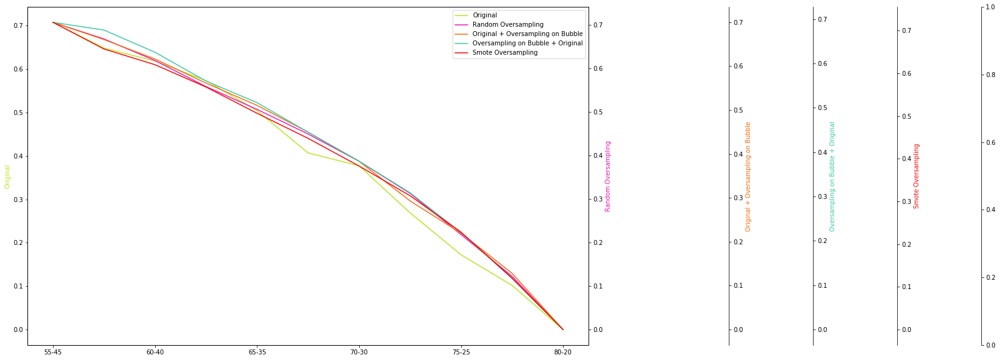

Total_Midi_AccuracyKNN


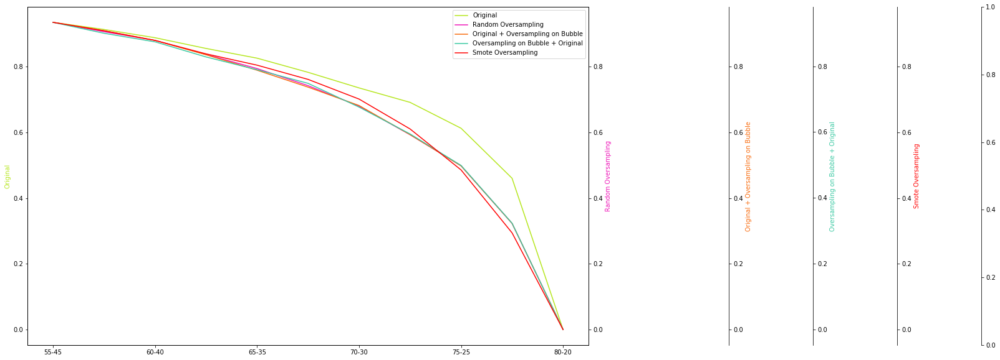

Total_Midi_AccuracySVC


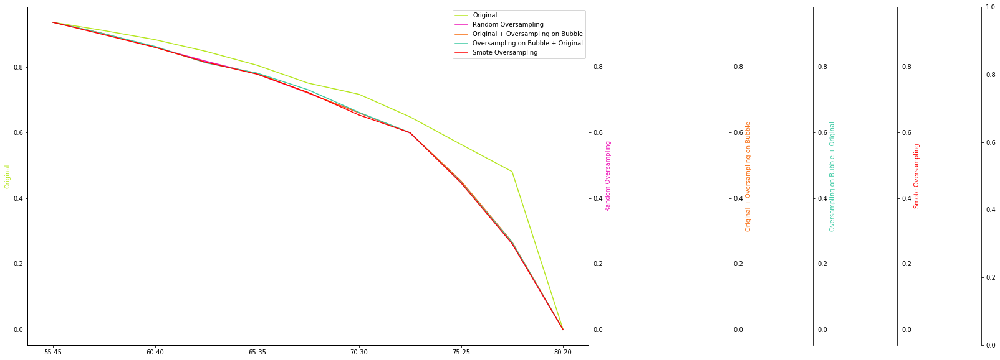

Total_Midi_AccuracyRF


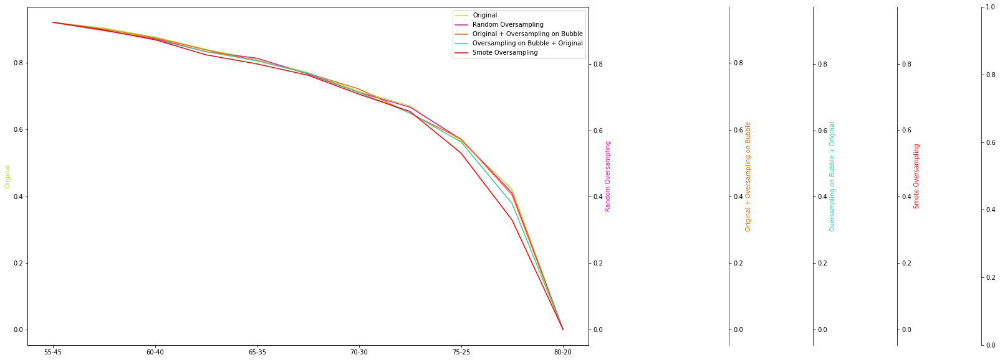

Total_Midi_AccuracyDT


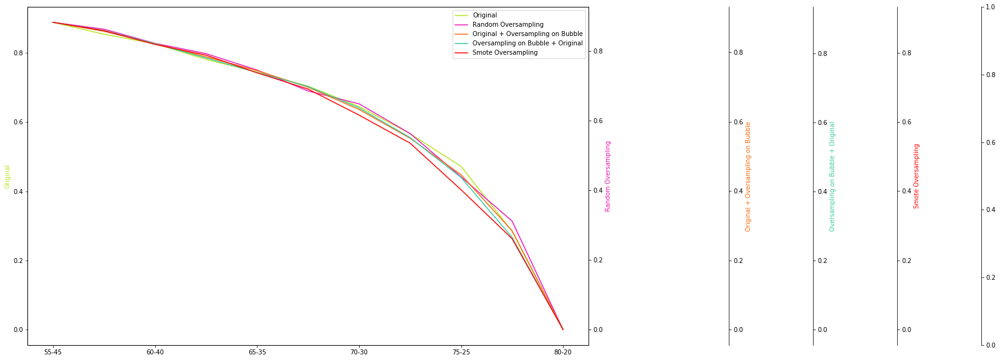

Total_Midi_Precision 0SGD


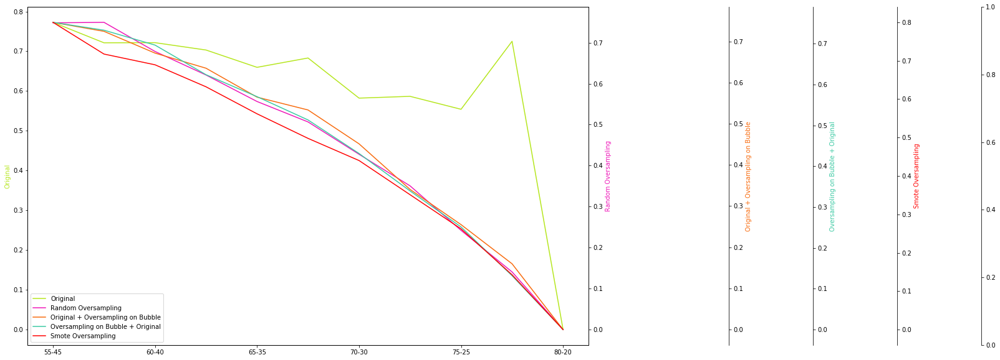

Total_Midi_Precision 0KNN


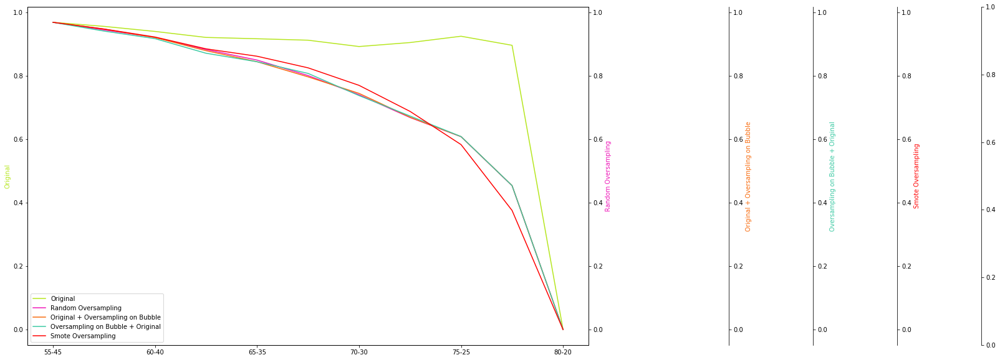

Total_Midi_Precision 0SVC


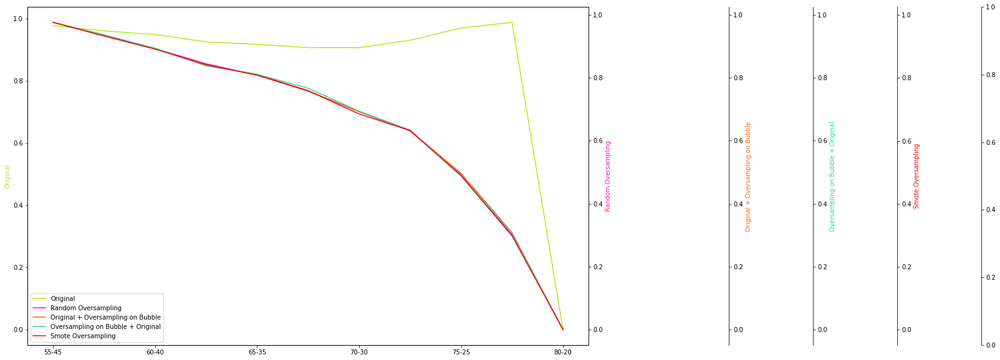

Total_Midi_Precision 0RF


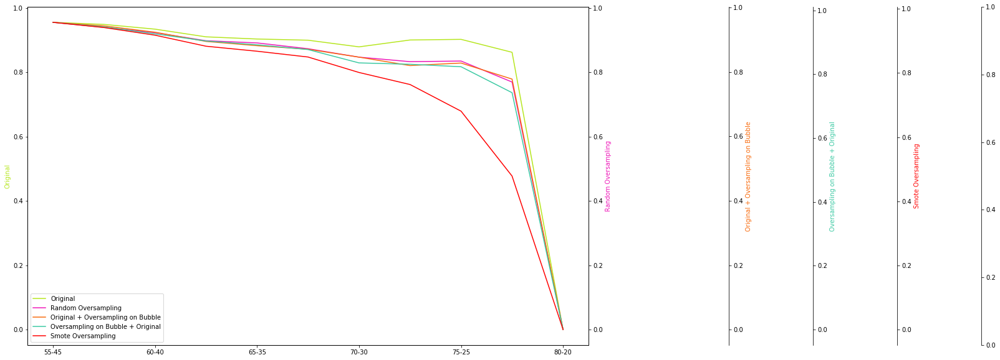

Total_Midi_Precision 0DT


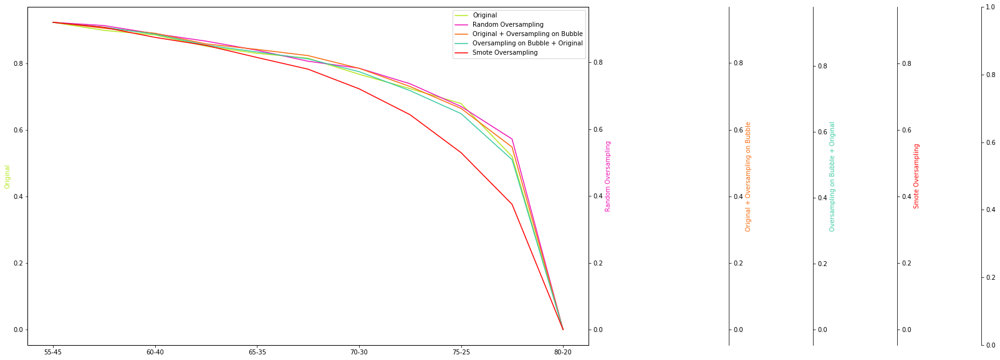

Total_Midi_Precision 1SGD


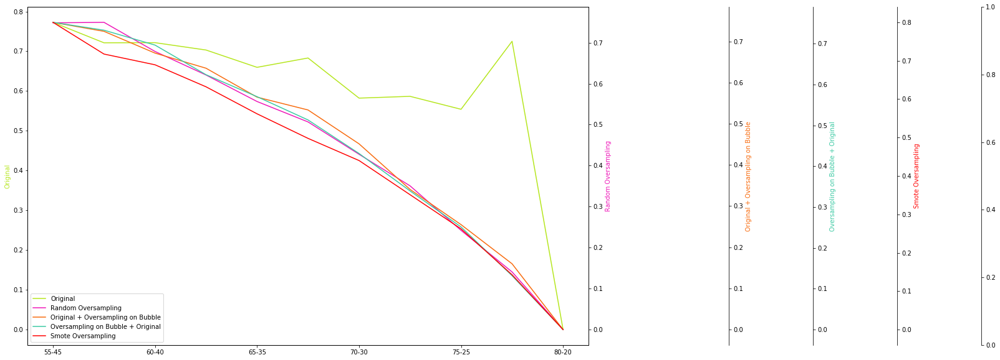

Total_Midi_Precision 1KNN


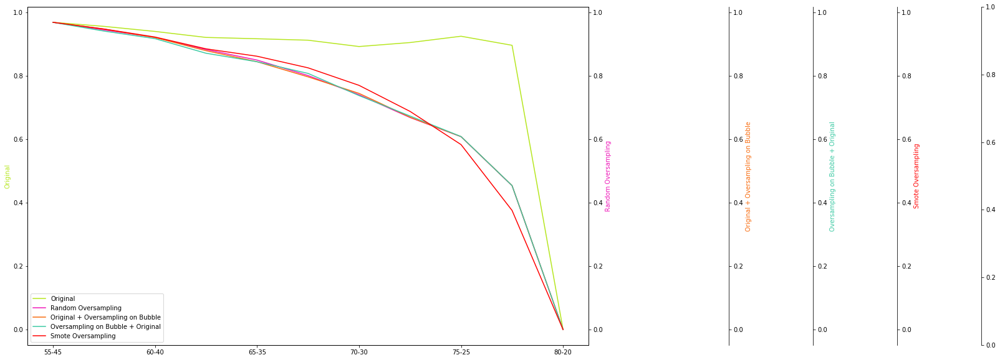

Total_Midi_Precision 1SVC


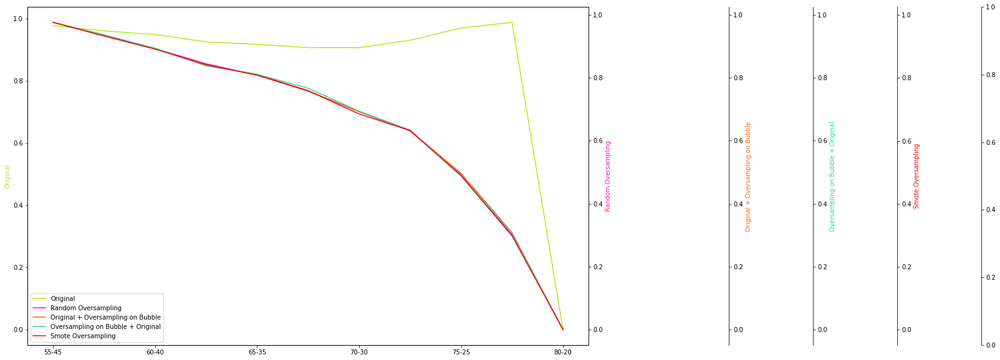

Total_Midi_Precision 1RF


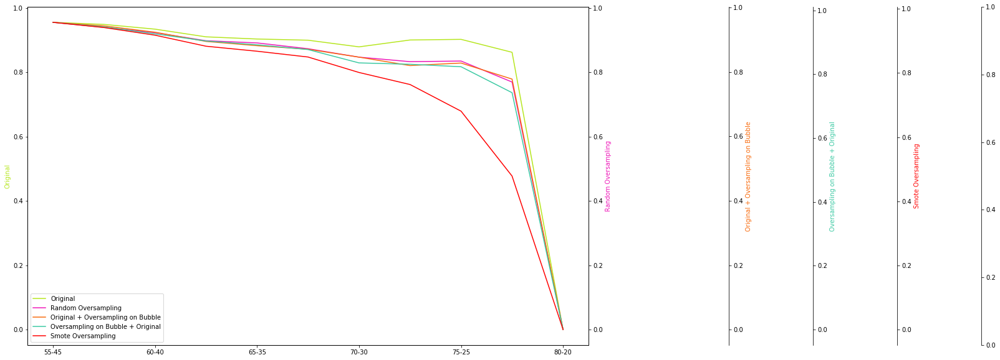

Total_Midi_Precision 1DT


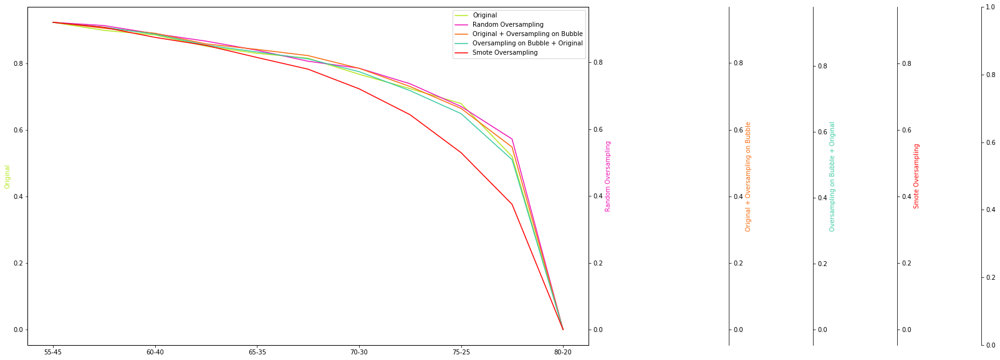

Total_Midi_Recall 0SGD


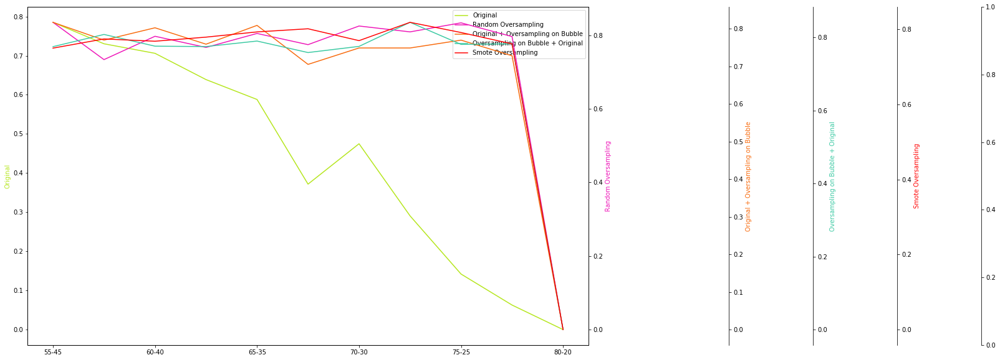

Total_Midi_Recall 0KNN


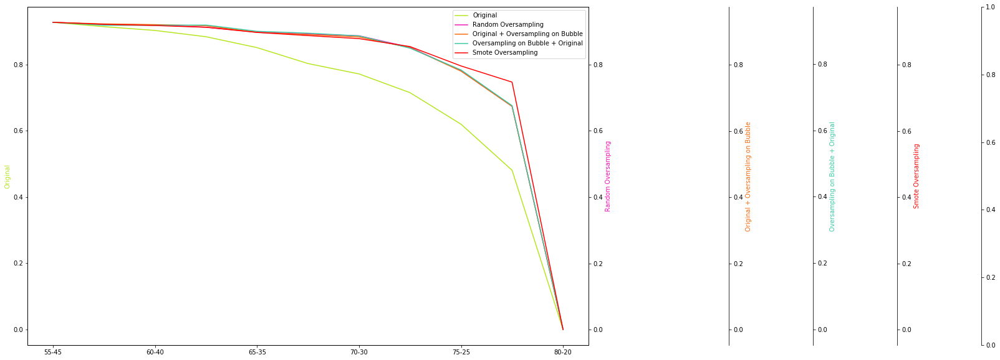

Total_Midi_Recall 0SVC


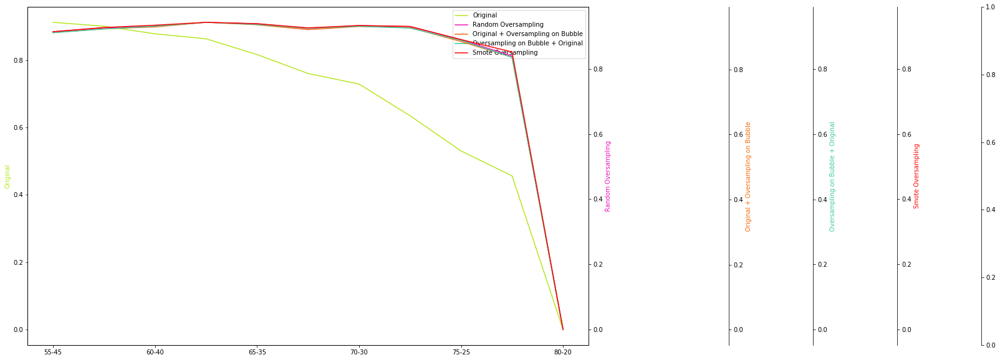

Total_Midi_Recall 0RF


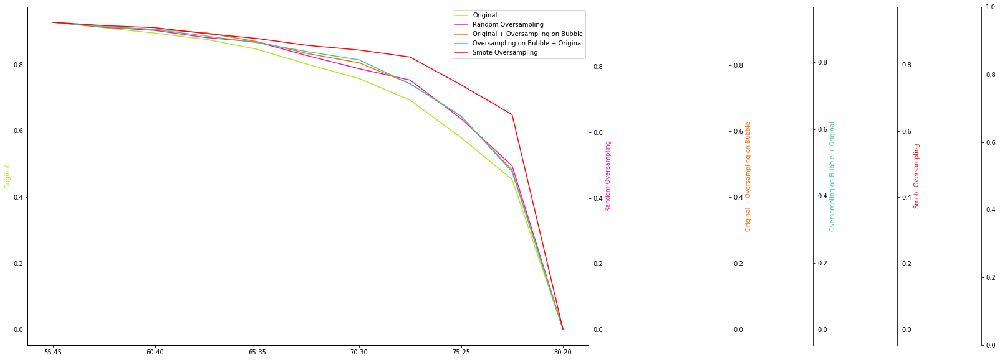

Total_Midi_Recall 0DT


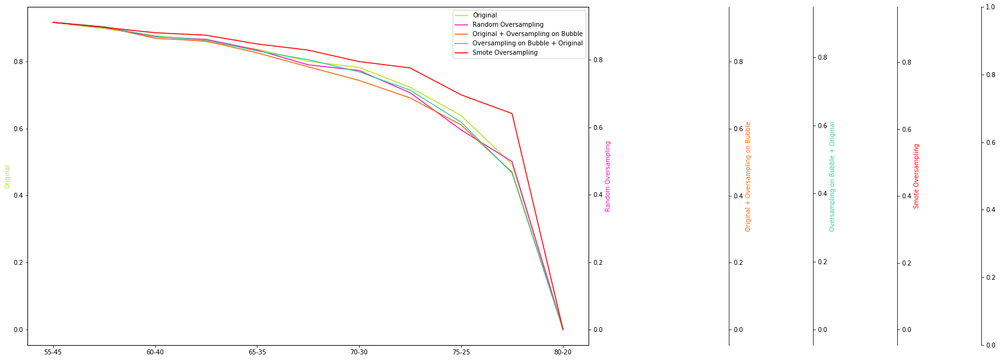

Total_Midi_Recall1SGD


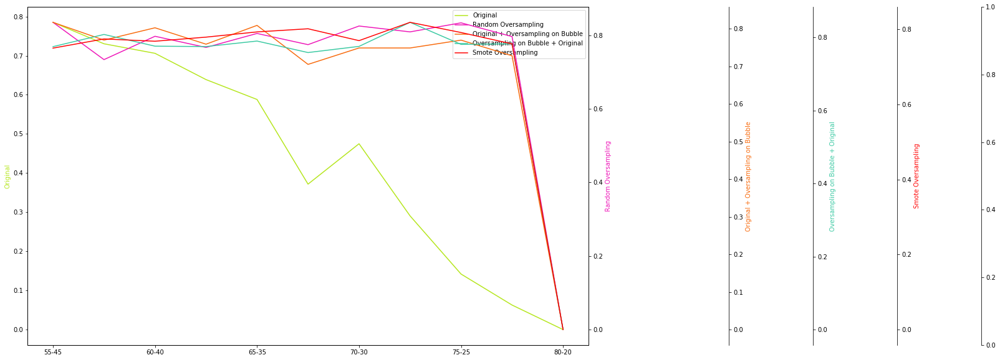

Total_Midi_Recall1KNN


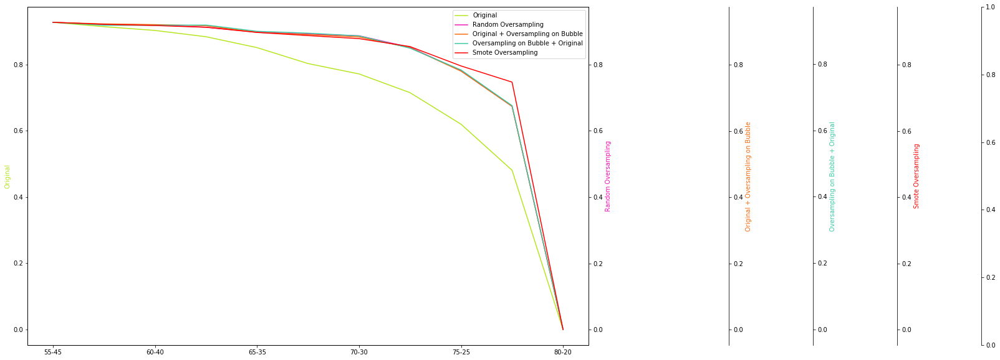

Total_Midi_Recall1SVC


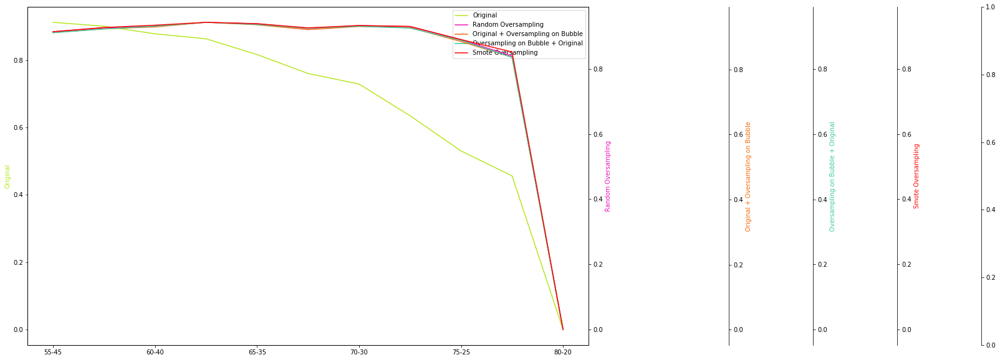

Total_Midi_Recall1RF


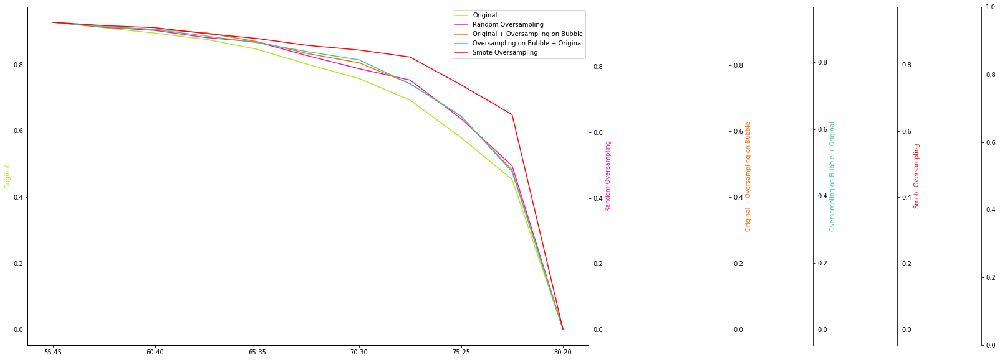

Total_Midi_Recall1DT


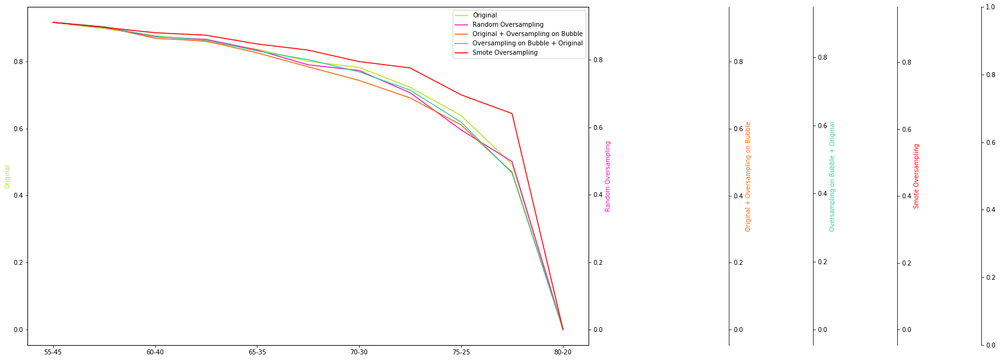

Total_Midi_Balanced_AccuracySGD


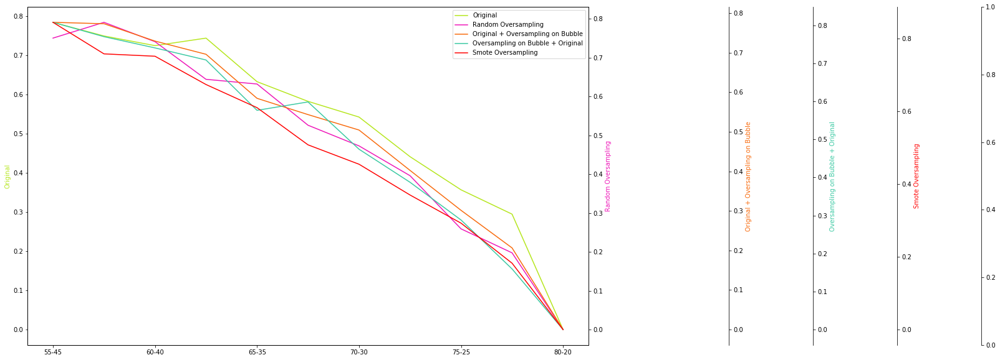

Total_Midi_Balanced_AccuracyKNN


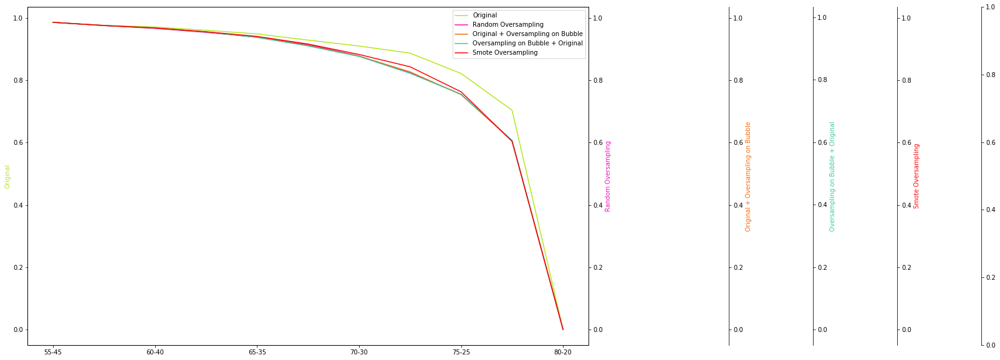

Total_Midi_Balanced_AccuracySVC


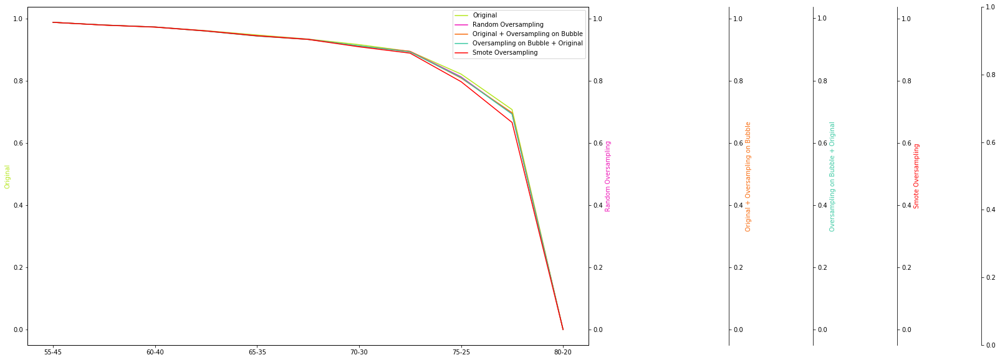

Total_Midi_Balanced_AccuracyRF


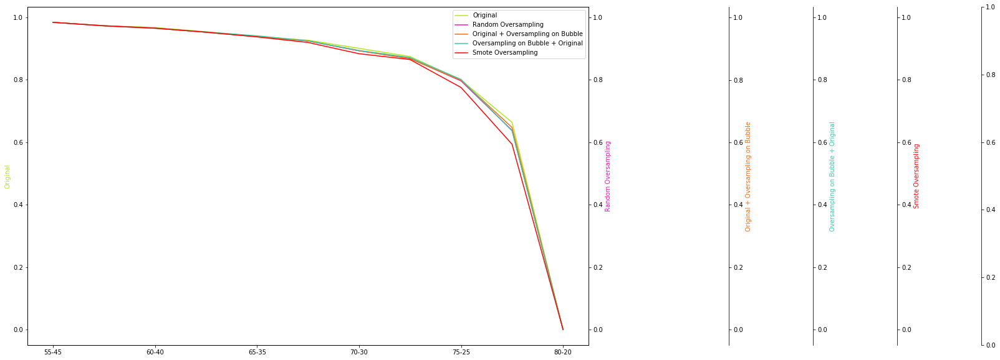

Total_Midi_Balanced_AccuracyDT


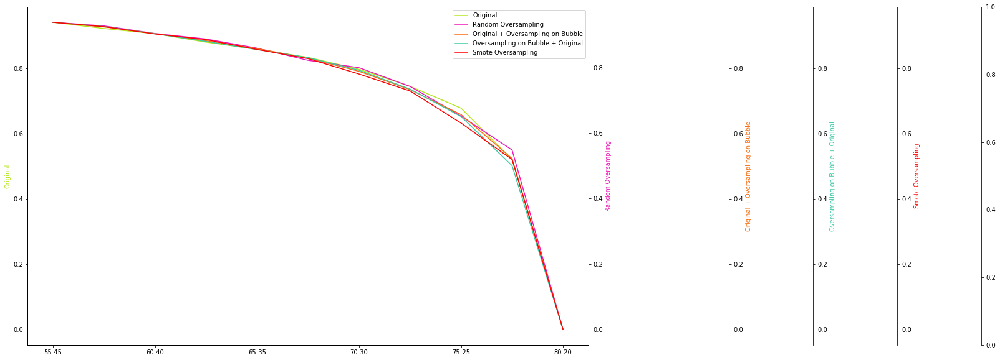

Total_Midi_F1 Score 0SGD


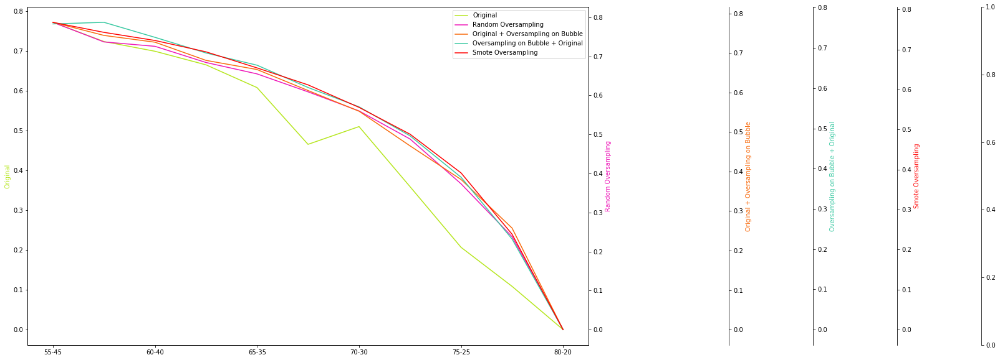

Total_Midi_F1 Score 0KNN


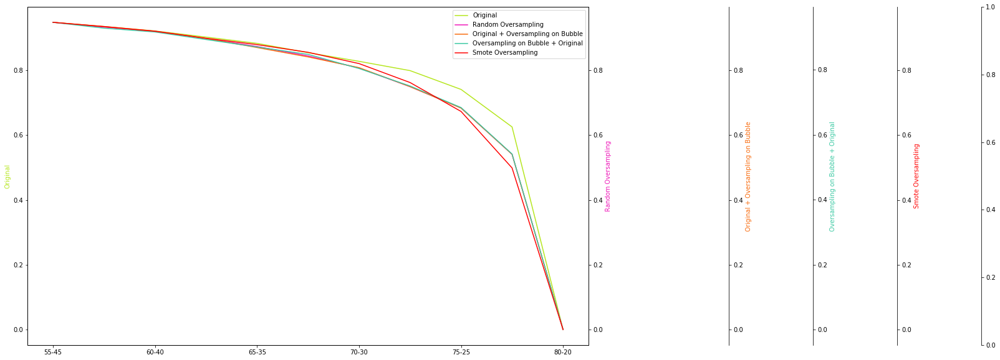

Total_Midi_F1 Score 0SVC


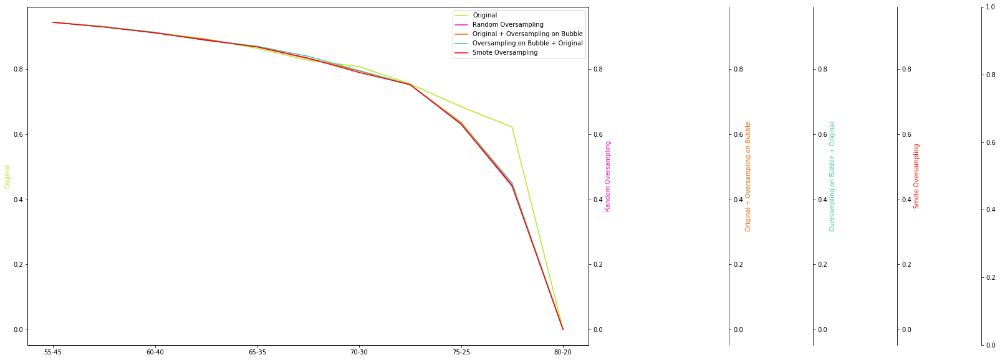

Total_Midi_F1 Score 0RF


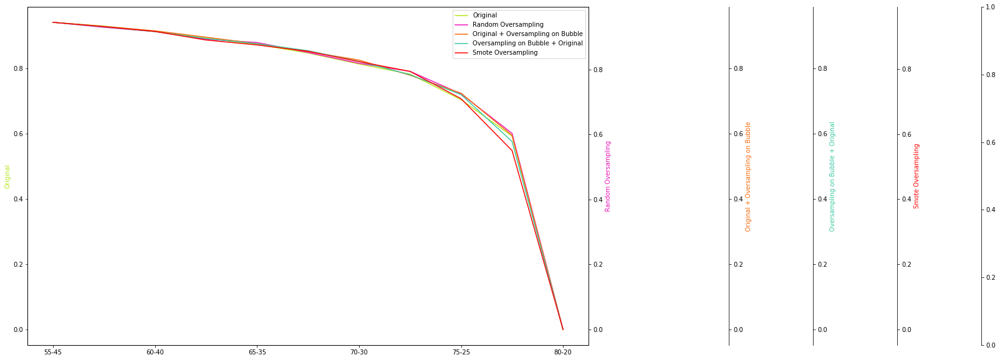

Total_Midi_F1 Score 0DT


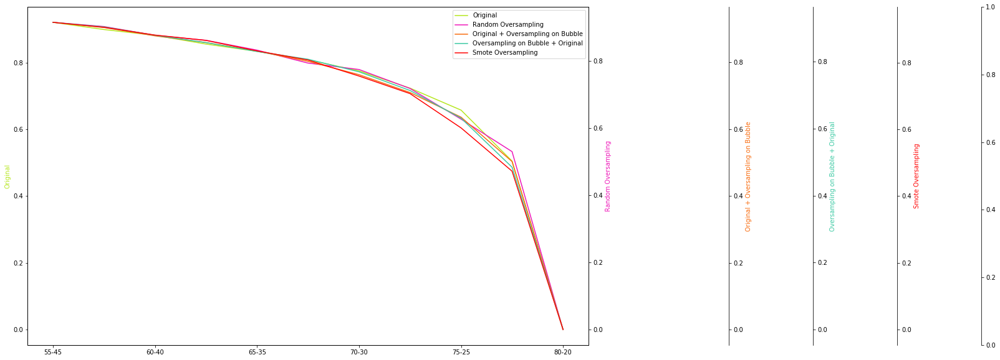

Total_Midi_F1 Score 1SGD


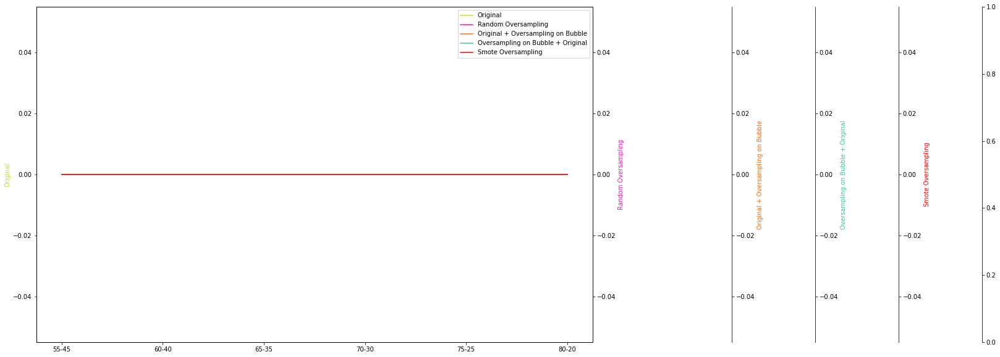

Total_Midi_F1 Score 1KNN


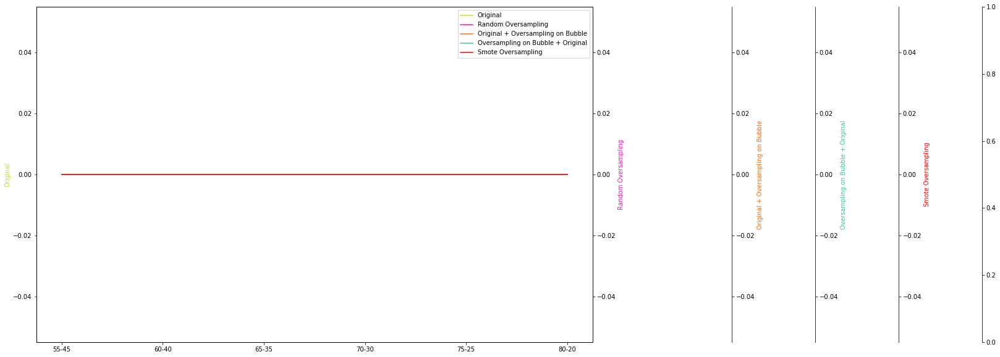

Total_Midi_F1 Score 1SVC


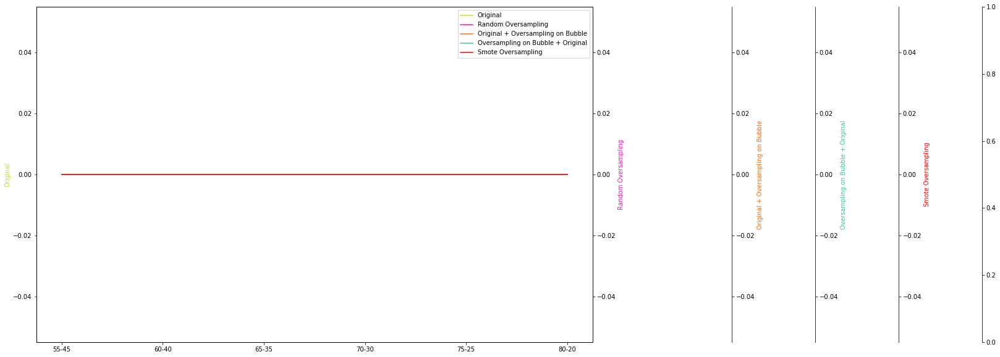

Total_Midi_F1 Score 1RF


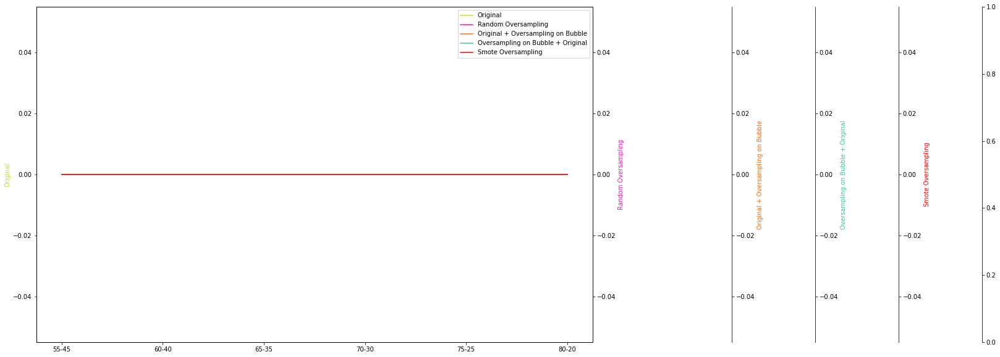

Total_Midi_F1 Score 1DT


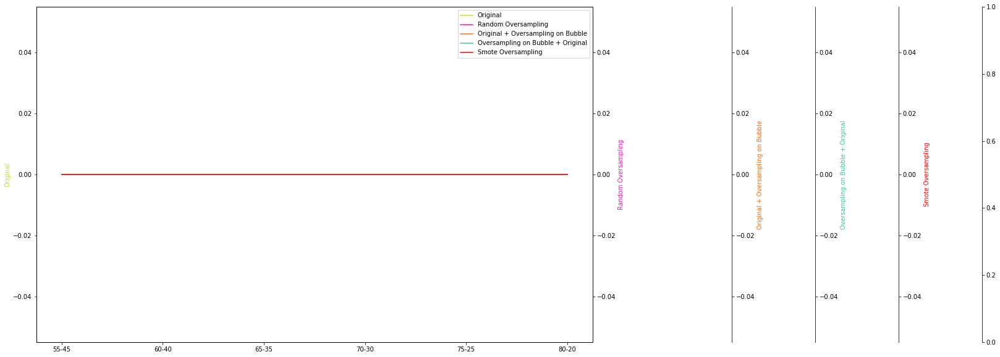

Total_Midi_AUCSGD


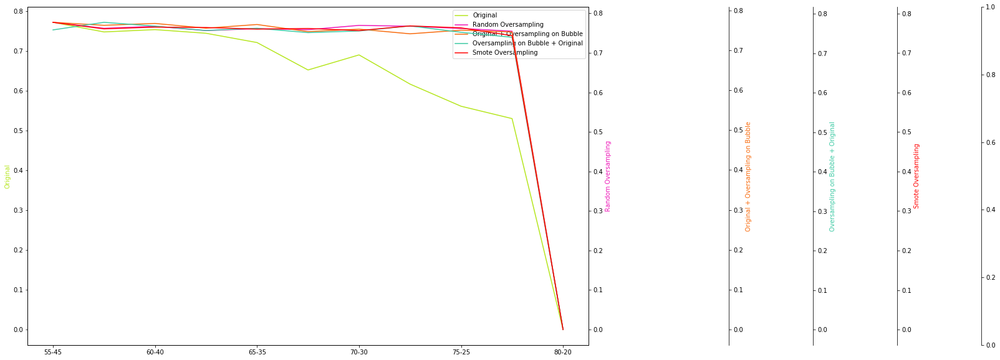

Total_Midi_AUCKNN


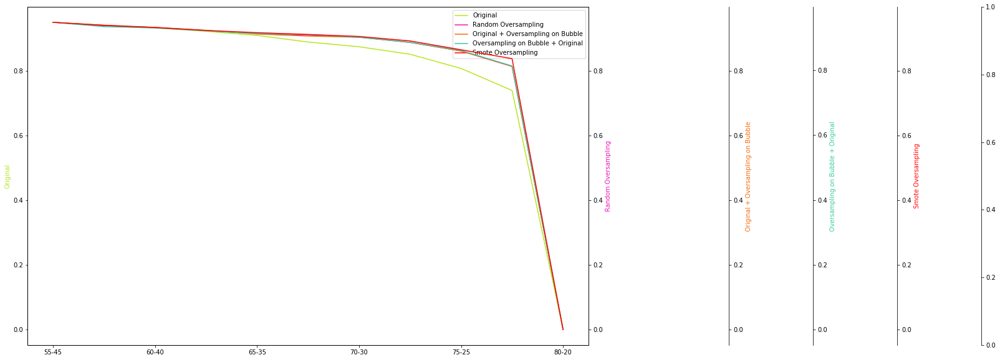

Total_Midi_AUCSVC


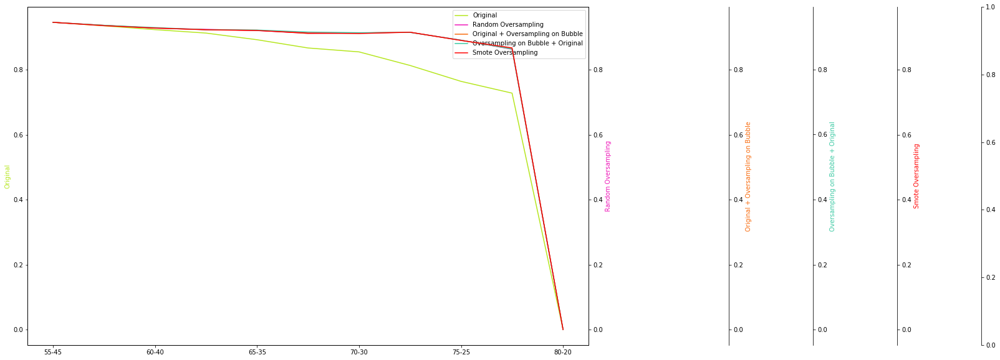

Total_Midi_AUCRF


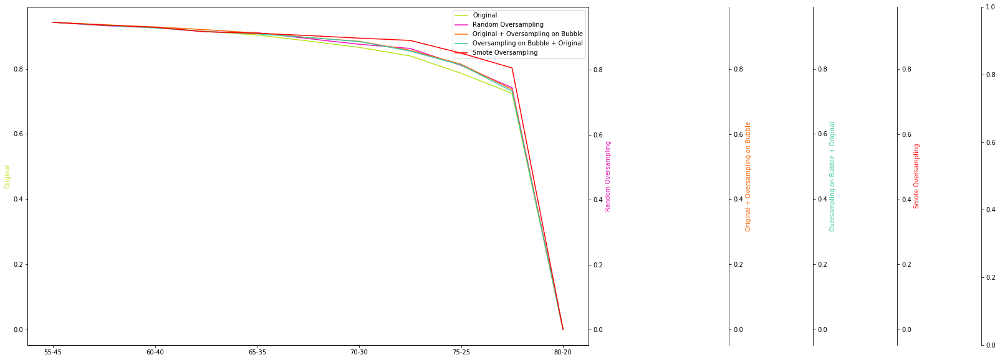

Total_Midi_AUCDT


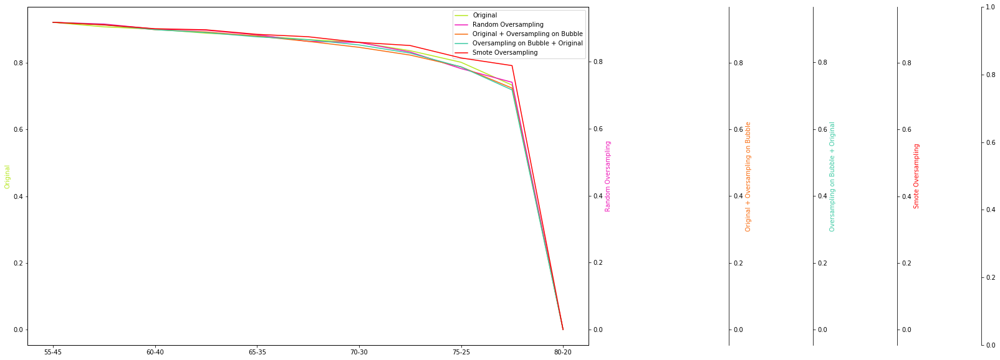

Total_Midi_AUC Probs 0SGD


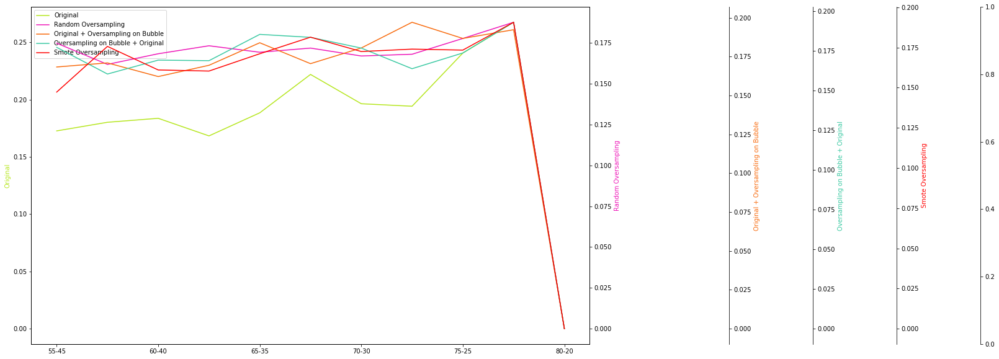

Total_Midi_AUC Probs 0KNN


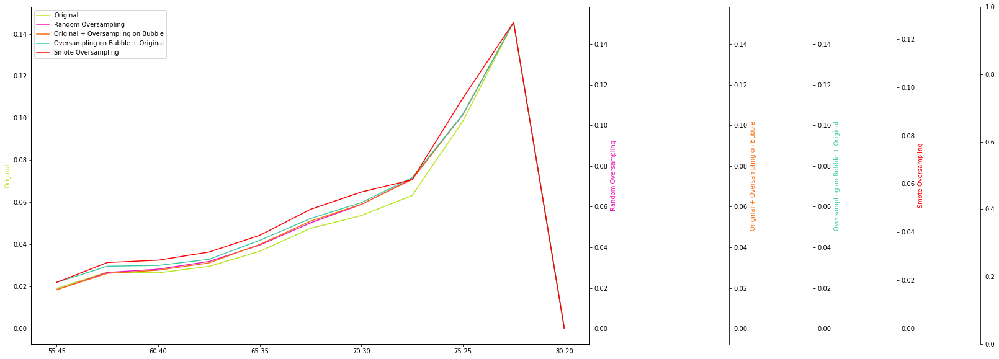

Total_Midi_AUC Probs 0SVC


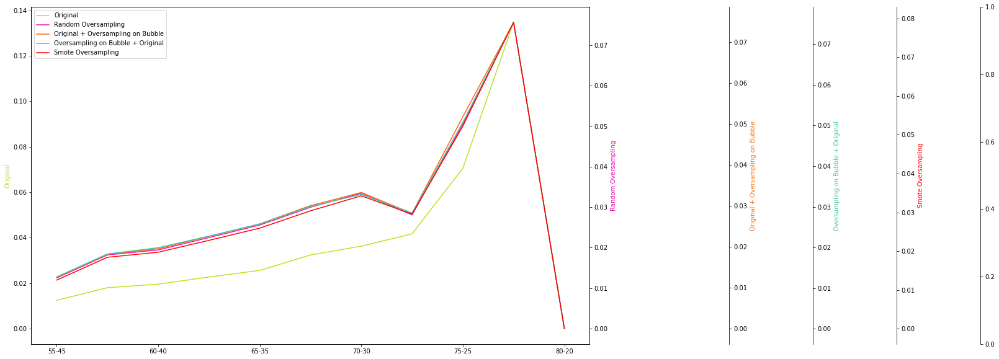

Total_Midi_AUC Probs 0RF


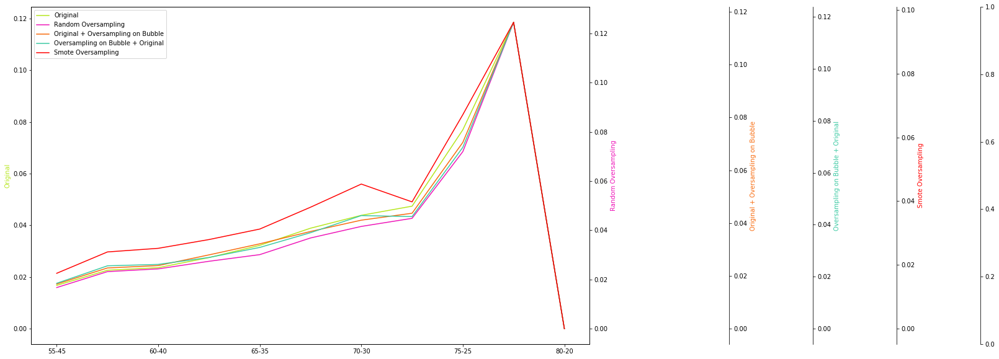

Total_Midi_AUC Probs 0DT


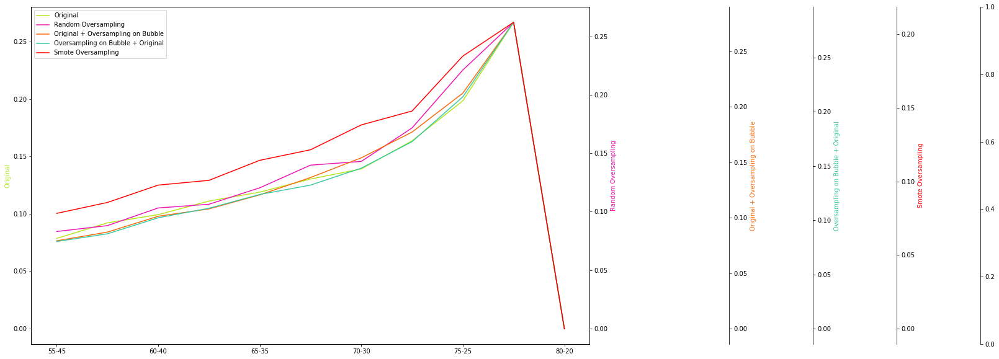

Total_Midi_AUC Probs 1SGD


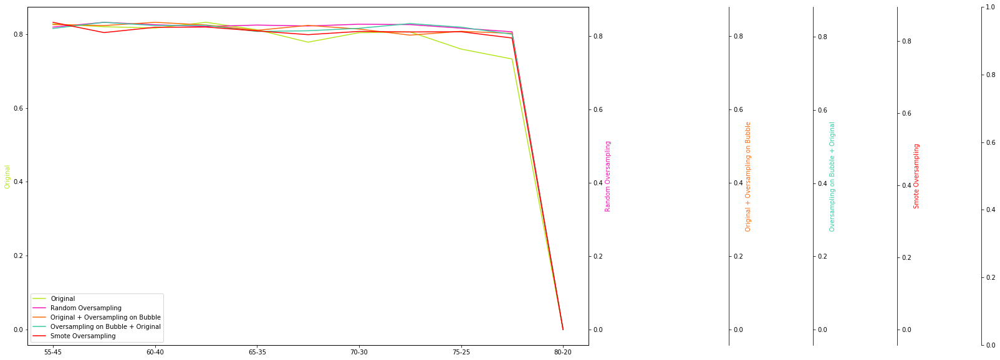

Total_Midi_AUC Probs 1KNN


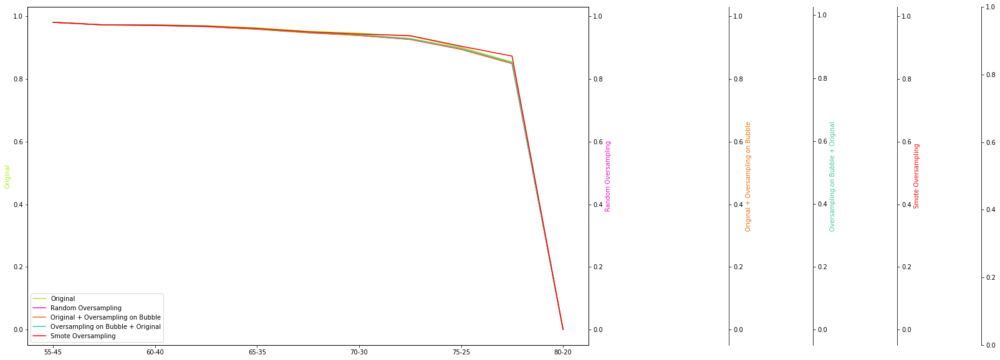

Total_Midi_AUC Probs 1SVC


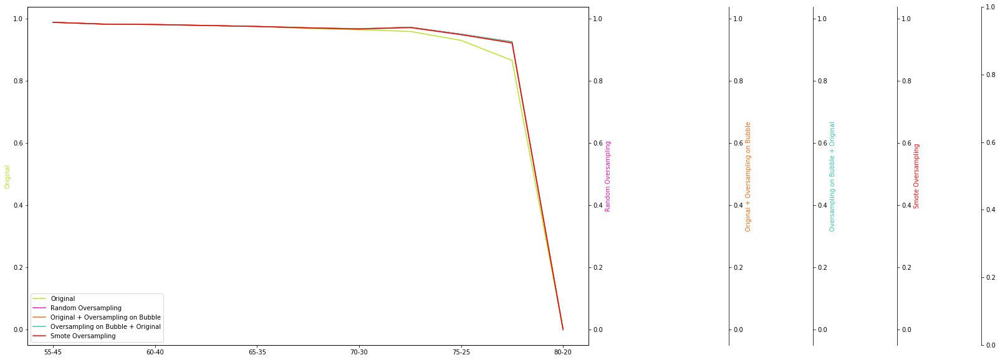

Total_Midi_AUC Probs 1RF


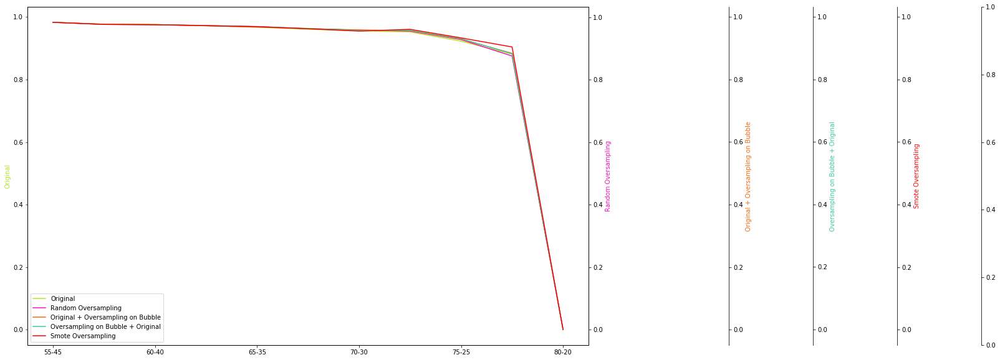

Total_Midi_AUC Probs 1DT


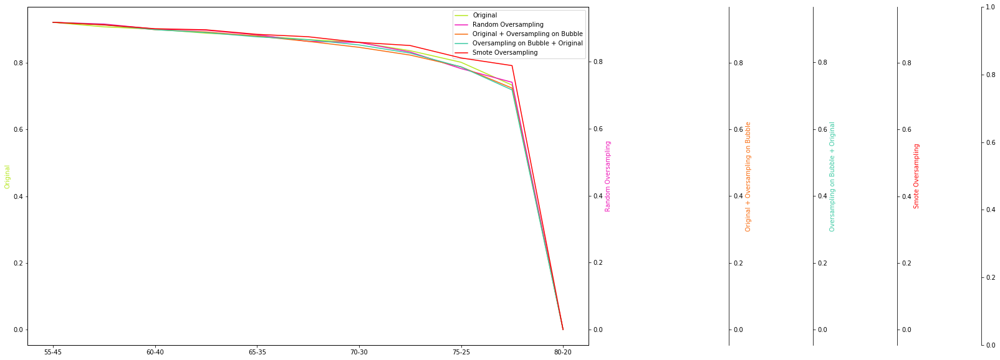

In [12]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1], 5, 'normCats_realSnowBubbles15r-15r_ray10Bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    

## Mini

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:01
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:00
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:01
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:00
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bull

           Average Precision:  0.730401987353 , Precicion 0:  0.771341463415 , Precision 1 0.771341463415 , Recall 1:  0.851851851852 , Recall 0:  0.851851851852 , PR AUC:  0.861382983007 , F1 Score 0:  0.8096 , F1 Score1:  0.8096 , AUC:  0.802163549688 , AUC Probs 0:  0.128057250169 , AUC Probs 1:  0.871942749831
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.7068996269 , Precicion 0:  0.747747747748 , Precision 1 0.747747747748 , Recall 1:  0.838383838384 , Recall 0:  0.838383838384 , PR AUC:  0.854082277853 , F1 Score 0:  0.790476190476 , F1 Score1:  0.790476190476 , AUC:  0.780578057806 , AUC Probs 0:  0.128935115734 , AUC Probs 1:  0.871064884266
         1
           Average Precision:  0.742348756381 , Precicion 0:  0.817204301075 , Precision 1 0.817204301075 , Recall 1:  0.767676767677 , Recall 0:  0.767676767677 , PR AUC:  0.897207009617 , F1 Score 0:  0.7916666

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.715324675325 , Precicion 0:  0.745714285714 , Precision 1 0.745714285714 , Recall 1:  0.878787878788 , Recall 0:  0.878787878788 , PR AUC:  0.847418653232 , F1 Score 0:  0.806800618238 , F1 Score1:  0.806800618238 , AUC:  0.792529252925 , AUC Probs 0:  0.127112711271 , AUC Probs 1:  0.872887288729
         1
           Average Precision:  0.762864827133 , Precicion 0:  0.829268292683 , Precision 1 0.829268292683 , Recall 1:  0.801346801347 , Recall 0:  0.801346801347 , PR AUC:  0.894284346195 , F1 Score 0:  0.815068493151 , F1 Score1:  0.815068493151 , AUC:  0.819815314865 , AUC Probs 0:  0.102710271027 , AUC Probs 1:  0.897289728973
         2
           Average Precision:  0.700836082486 , Precicion 0:  0.76430976431 , Precision 1 0.76430976431 , Recall 1:  0.76430976431 , Recall 0:  0.76430976431 , PR AUC:  0.755965258554 , F1 Score 0:  0.76430976431 , F1 Score1:  0.76430976431 , AUC:  0.766643331 , AUC Probs 0:  0.17272838395 , AUC Probs 1:  0.82727161605
   

           Average Precision:  0.831862512087 , Precicion 0:  0.885813148789 , Precision 1 0.885813148789 , Recall 1:  0.861952861953 , Recall 0:  0.861952861953 , PR AUC:  0.931825057174 , F1 Score 0:  0.873720136519 , F1 Score1:  0.873720136519 , AUC:  0.876520985432 , AUC Probs 0:  0.0688624417997 , AUC Probs 1:  0.9311375582
         6
           Average Precision:  0.807193384954 , Precicion 0:  0.842271293375 , Precision 1 0.842271293375 , Recall 1:  0.89898989899 , Recall 0:  0.89898989899 , PR AUC:  0.91438154276 , F1 Score 0:  0.869706840391 , F1 Score1:  0.869706840391 , AUC:  0.86698669867 , AUC Probs 0:  0.0887255392206 , AUC Probs 1:  0.911274460779
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.794926538108 , Precicion 0:  0.848484848485 , Precision 1 0.848484848485 , Recall 1:  0.848484848485 , Recall 0:  0.848484848485 , PR AUC:  0.906976787065 , F1 Score

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.828881486257 , Precicion 0:  0.890070921986 , Precision 1 0.890070921986 , Recall 1:  0.845117845118 , Recall 0:  0.845117845118 , PR AUC:  0.936457244547 , F1 Score 0:  0.86701208981 , F1 Score1:  0.86701208981 , AUC:  0.871403807047 , AUC Probs 0:  0.0693402673601 , AUC Probs 1:  0.93065973264
         3
           Average Precision:  0.807123218944 , Precicion 0:  0.854304635762 , Precision 1 0.854304635762 , Recall 1:  0.868686868687 , Recall 0:  0.868686868687 , PR AUC:  0.915756638513 , F1 Score 0:  0.86143572621 , F1 Score1:  0.86143572621 , AUC:  0.861736173617 , AUC Probs 0:  0.0840250691736 , AUC Probs 1:  0.915974930826
         4
           Average Precision:  0.828967071848 , Precicion 0:  0.877966101695 , Precision 1 0.877966101695 , Recall 1:  0.872053872054 , Recall 0:  0.872053872054 , PR AUC:  0.939982042689 , F1 Score 0:  0.875 , F1 Score1:  0.875 , AUC:  0.876620995433 , AUC Probs 0:  0.0641286350857 , AUC Probs 1:  0.935871364914
  

           Average Precision:  0.870346014556 , Precicion 0:  0.914089347079 , Precision 1 0.914089347079 , Recall 1:  0.895622895623 , Recall 0:  0.895622895623 , PR AUC:  0.95785752294 , F1 Score 0:  0.904761904762 , F1 Score1:  0.904761904762 , AUC:  0.906557322399 , AUC Probs 0:  0.0420597615317 , AUC Probs 1:  0.957940238468
         5
           Average Precision:  0.845910146764 , Precicion 0:  0.898954703833 , Precision 1 0.898954703833 , Recall 1:  0.868686868687 , Recall 0:  0.868686868687 , PR AUC:  0.953634173215 , F1 Score 0:  0.883561643836 , F1 Score1:  0.883561643836 , AUC:  0.886488648865 , AUC Probs 0:  0.0467491193564 , AUC Probs 1:  0.953250880644
         6
           Average Precision:  0.815273363384 , Precicion 0:  0.85667752443 , Precision 1 0.85667752443 , Recall 1:  0.885521885522 , Recall 0:  0.885521885522 , PR AUC:  0.934652036341 , F1 Score 0:  0.870860927152 , F1 Score1:  0.870860927152 , AUC:  0.870153682035 , AUC Probs 0:  0.0614172528364 , AUC Probs 1

           Average Precision:  0.812852896401 , Precicion 0:  0.858085808581 , Precision 1 0.858085808581 , Recall 1:  0.875420875421 , Recall 0:  0.875420875421 , PR AUC:  0.922018553347 , F1 Score 0:  0.866666666667 , F1 Score1:  0.866666666667 , AUC:  0.866753342001 , AUC Probs 0:  0.0712737940461 , AUC Probs 1:  0.928726205954
         1
           Average Precision:  0.851977179199 , Precicion 0:  0.902777777778 , Precision 1 0.902777777778 , Recall 1:  0.875420875421 , Recall 0:  0.875420875421 , PR AUC:  0.951044581011 , F1 Score 0:  0.888888888889 , F1 Score1:  0.888888888889 , AUC:  0.891505817248 , AUC Probs 0:  0.048171483815 , AUC Probs 1:  0.951828516185
         2
           Average Precision:  0.885597758406 , Precicion 0:  0.924657534247 , Precision 1 0.924657534247 , Recall 1:  0.909090909091 , Recall 0:  0.909090909091 , PR AUC:  0.964702387483 , F1 Score 0:  0.916808149406 , F1 Score1:  0.916808149406 , AUC:  0.918241824182 , AUC Probs 0:  0.0354924381327 , AUC Probs

           Average Precision:  0.794131054131 , Precicion 0:  0.846153846154 , Precision 1 0.846153846154 , Recall 1:  0.851851851852 , Recall 0:  0.851851851852 , PR AUC:  0.906647642707 , F1 Score 0:  0.848993288591 , F1 Score1:  0.848993288591 , AUC:  0.850018335167 , AUC Probs 0:  0.0861197230834 , AUC Probs 1:  0.913880276917
         4
           Average Precision:  0.828235038558 , Precicion 0:  0.89247311828 , Precision 1 0.89247311828 , Recall 1:  0.838383838384 , Recall 0:  0.838383838384 , PR AUC:  0.932330968163 , F1 Score 0:  0.864583333333 , F1 Score1:  0.864583333333 , AUC:  0.869686968697 , AUC Probs 0:  0.0661010545499 , AUC Probs 1:  0.93389894545
         5
           Average Precision:  0.836969817651 , Precicion 0:  0.899641577061 , Precision 1 0.899641577061 , Recall 1:  0.845117845118 , Recall 0:  0.845117845118 , PR AUC:  0.922871533952 , F1 Score 0:  0.871527777778 , F1 Score1:  0.871527777778 , AUC:  0.876354302097 , AUC Probs 0:  0.0692013645809 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.807378312744 , Precicion 0:  0.867595818815 , Precision 1 0.867595818815 , Recall 1:  0.838383838384 , Recall 0:  0.838383838384 , PR AUC:  0.914062948901 , F1 Score 0:  0.852739726027 , F1 Score1:  0.852739726027 , AUC:  0.856485648565 , AUC Probs 0:  0.0808969785867 , AUC Probs 1:  0.919103021413
         4
           Average Precision:  0.836872973275 , Precicion 0:  0.907749077491 , Precision 1 0.907749077491 , Recall 1:  0.828282828283 , Recall 0:  0.828282828283 , PR AUC:  0.933567161236 , F1 Score 0:  0.866197183099 , F1 Score1:  0.866197183099 , AUC:  0.872887288729 , AUC Probs 0:  0.0635452434132 , AUC Probs 1:  0.936454756587
         5
           Average Precision:  0.831558407324 , Precicion 0:  0.893238434164 , Precision 1 0.893238434164 , Recall 1:  0.845117845118 , Recall 0:  0.845117845118 , PR AUC:  0.929347260037 , F1 Score 0:  0.868512110727 , F1 Score1:  0.868512110727 , AUC:  0.873053972064 , AUC Probs 0:  0.0662788501072 , AUC Prob

           Average Precision:  0.761572652936 , Precicion 0:  0.811688311688 , Precision 1 0.811688311688 , Recall 1:  0.841750841751 , Recall 0:  0.841750841751 , PR AUC:  0.865886243386 , F1 Score 0:  0.826446280992 , F1 Score1:  0.826446280992 , AUC:  0.825165849918 , AUC Probs 0:  0.174834150082 , AUC Probs 1:  0.825165849918
         1
           Average Precision:  0.749383155397 , Precicion 0:  0.82206405694 , Precision 1 0.82206405694 , Recall 1:  0.777777777778 , Recall 0:  0.777777777778 , PR AUC:  0.854920917359 , F1 Score 0:  0.799307958478 , F1 Score1:  0.799307958478 , AUC:  0.806380638064 , AUC Probs 0:  0.193619361936 , AUC Probs 1:  0.806380638064
         2
           Average Precision:  0.758061364822 , Precicion 0:  0.827464788732 , Precision 1 0.827464788732 , Recall 1:  0.791245791246 , Recall 0:  0.791245791246 , PR AUC:  0.861021956656 , F1 Score 0:  0.808950086059 , F1 Score1:  0.808950086059 , AUC:  0.814764809814 , AUC Probs 0:  0.185235190186 , AUC Probs 1: 

           Average Precision:  0.745526019387 , Precicion 0:  0.818505338078 , Precision 1 0.818505338078 , Recall 1:  0.774410774411 , Recall 0:  0.774410774411 , PR AUC:  0.852291389578 , F1 Score 0:  0.795847750865 , F1 Score1:  0.795847750865 , AUC:  0.803046971364 , AUC Probs 0:  0.196953028636 , AUC Probs 1:  0.803046971364
         2
           Average Precision:  0.759355677992 , Precicion 0:  0.836363636364 , Precision 1 0.836363636364 , Recall 1:  0.774410774411 , Recall 0:  0.774410774411 , PR AUC:  0.861220538721 , F1 Score 0:  0.804195804196 , F1 Score1:  0.804195804196 , AUC:  0.812947961463 , AUC Probs 0:  0.187052038537 , AUC Probs 1:  0.812947961463
         3
           Average Precision:  0.720610948192 , Precicion 0:  0.774193548387 , Precision 1 0.774193548387 , Recall 1:  0.808080808081 , Recall 0:  0.808080808081 , PR AUC:  0.838637178234 , F1 Score 0:  0.790774299835 , F1 Score1:  0.790774299835 , AUC:  0.788528852885 , AUC Probs 0:  0.211471147115 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.701256830601 , Precicion 0:  0.747540983607 , Precision 1 0.747540983607 , Recall 1:  0.844444444444 , Recall 0:  0.844444444444 , PR AUC:  0.846470663923 , F1 Score 0:  0.793043478261 , F1 Score1:  0.793043478261 , AUC:  0.805555555556 , AUC Probs 0:  0.119225589226 , AUC Probs 1:  0.880774410774
         6
           Average Precision:  0.641579454072 , Precicion 0:  0.681957186544 , Precision 1 0.681957186544 , Recall 1:  0.825925925926 , Recall 0:  0.825925925926 , PR AUC:  0.815175503114 , F1 Score 0:  0.747068676717 , F1 Score1:  0.747068676717 , AUC:  0.755387205387 , AUC Probs 0:  0.150583613917 , AUC Probs 1:  0.849416386083
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.671549776727 , Precicion 0:  0.737588652482 , Precision 1 0.737588652482 , Recall 1:  0.77037037037 , Recall 0:  0.77037037037 , PR AUC

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.774609427609 , Precicion 0:  0.832727272727 , Precision 1 0.832727272727 , Recall 1:  0.848148148148 , Recall 0:  0.848148148148 , PR AUC:  0.900998142057 , F1 Score 0:  0.840366972477 , F1 Score1:  0.840366972477 , AUC:  0.854377104377 , AUC Probs 0:  0.088367003367 , AUC Probs 1:  0.911632996633
         2
           Average Precision:  0.76565993266 , Precicion 0:  0.825454545455 , Precision 1 0.825454545455 , Recall 1:  0.840740740741 , Recall 0:  0.840740740741 , PR AUC:  0.898836153591 , F1 Score 0:  0.833027522936 , F1 Score1:  0.833027522936 , AUC:  0.847643097643 , AUC Probs 0:  0.0926992143659 , AUC Probs 1:  0.907300785634
         3
           Average Precision:  0.759827674897 , Precicion 0:  0.809027777778 , Precision 1 0.809027777778 , Recall 1:  0.862962962963 , Recall 0:  0.862962962963 , PR AUC:  0.899153400469 , F1 Score 0:  0.835125448029 , F1 Score1:  0.835125448029 , AUC:  0.848148148148 , AUC Probs 0:  0.0878900112233 , AUC Probs 

           Average Precision:  0.809943581574 , Precicion 0:  0.856630824373 , Precision 1 0.856630824373 , Recall 1:  0.885185185185 , Recall 0:  0.885185185185 , PR AUC:  0.935246881529 , F1 Score 0:  0.870673952641 , F1 Score1:  0.870673952641 , AUC:  0.881986531987 , AUC Probs 0:  0.0521212121212 , AUC Probs 1:  0.947878787879
         1
           Average Precision:  0.791098626717 , Precicion 0:  0.85393258427 , Precision 1 0.85393258427 , Recall 1:  0.844444444444 , Recall 0:  0.844444444444 , PR AUC:  0.927483464323 , F1 Score 0:  0.849162011173 , F1 Score1:  0.849162011173 , AUC:  0.863131313131 , AUC Probs 0:  0.0633108866442 , AUC Probs 1:  0.936689113356
         2
           Average Precision:  0.786453738383 , Precicion 0:  0.850187265918 , Precision 1 0.850187265918 , Recall 1:  0.840740740741 , Recall 0:  0.840740740741 , PR AUC:  0.930169484478 , F1 Score 0:  0.845437616387 , F1 Score1:  0.845437616387 , AUC:  0.859764309764 , AUC Probs 0:  0.0607912457912 , AUC Probs 

           Average Precision:  0.772050456253 , Precicion 0:  0.829710144928 , Precision 1 0.829710144928 , Recall 1:  0.848148148148 , Recall 0:  0.848148148148 , PR AUC:  0.925327574923 , F1 Score 0:  0.838827838828 , F1 Score1:  0.838827838828 , AUC:  0.852861952862 , AUC Probs 0:  0.0621436588103 , AUC Probs 1:  0.93785634119
         3
           Average Precision:  0.795905700923 , Precicion 0:  0.832764505119 , Precision 1 0.832764505119 , Recall 1:  0.903703703704 , Recall 0:  0.903703703704 , PR AUC:  0.930648257455 , F1 Score 0:  0.866785079929 , F1 Score1:  0.866785079929 , AUC:  0.877609427609 , AUC Probs 0:  0.0499102132435 , AUC Probs 1:  0.950089786756
         4
           Average Precision:  0.736205305652 , Precicion 0:  0.78892733564 , Precision 1 0.78892733564 , Recall 1:  0.844444444444 , Recall 0:  0.844444444444 , PR AUC:  0.918538151121 , F1 Score 0:  0.815742397138 , F1 Score1:  0.815742397138 , AUC:  0.829797979798 , AUC Probs 0:  0.0761616161616 , AUC Probs 1

           Average Precision:  0.735289612921 , Precicion 0:  0.808270676692 , Precision 1 0.808270676692 , Recall 1:  0.796296296296 , Recall 0:  0.796296296296 , PR AUC:  0.898663151371 , F1 Score 0:  0.80223880597 , F1 Score1:  0.80223880597 , AUC:  0.820875420875 , AUC Probs 0:  0.0949046015713 , AUC Probs 1:  0.905095398429
         5
           Average Precision:  0.778446215139 , Precicion 0:  0.860557768924 , Precision 1 0.860557768924 , Recall 1:  0.8 , Recall 0:  0.8 , PR AUC:  0.898522578896 , F1 Score 0:  0.829174664107 , F1 Score1:  0.829174664107 , AUC:  0.84696969697 , AUC Probs 0:  0.0863860830527 , AUC Probs 1:  0.913613916947
         6
           Average Precision:  0.787183787561 , Precicion 0:  0.852830188679 , Precision 1 0.852830188679 , Recall 1:  0.837037037037 , Recall 0:  0.837037037037 , PR AUC:  0.890719390324 , F1 Score 0:  0.844859813084 , F1 Score1:  0.844859813084 , AUC:  0.859427609428 , AUC Probs 0:  0.0852188552189 , AUC Probs 1:  0.914781144781
    

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.769597800926 , Precicion 0:  0.84765625 , Precision 1 0.84765625 , Recall 1:  0.803703703704 , Recall 0:  0.803703703704 , PR AUC:  0.896115163094 , F1 Score 0:  0.825095057034 , F1 Score1:  0.825095057034 , AUC:  0.842760942761 , AUC Probs 0:  0.0923681257015 , AUC Probs 1:  0.907631874299
         2
           Average Precision:  0.75976744186 , Precicion 0:  0.837209302326 , Precision 1 0.837209302326 , Recall 1:  0.8 , Recall 0:  0.8 , PR AUC:  0.899070261409 , F1 Score 0:  0.818181818182 , F1 Score1:  0.818181818182 , AUC:  0.836363636364 , AUC Probs 0:  0.0842424242424 , AUC Probs 1:  0.915757575758
         3
           Average Precision:  0.740996833264 , Precicion 0:  0.810408921933 , Precision 1 0.810408921933 , Recall 1:  0.807407407407 , Recall 0:  0.807407407407 , PR AUC:  0.899063294414 , F1 Score 0:  0.808905380334 , F1 Score1:  0.808905380334 , AUC:  0.826430976431 , AUC Probs 0:  0.0852974186308 , AUC Probs 1:  0.914702581369
         4

           Average Precision:  0.6769478738 , Precicion 0:  0.751851851852 , Precision 1 0.751851851852 , Recall 1:  0.751851851852 , Recall 0:  0.751851851852 , PR AUC:  0.807685185185 , F1 Score 0:  0.751851851852 , F1 Score1:  0.751851851852 , AUC:  0.774410774411 , AUC Probs 0:  0.225589225589 , AUC Probs 1:  0.774410774411
         5
           Average Precision:  0.703816425121 , Precicion 0:  0.771739130435 , Precision 1 0.771739130435 , Recall 1:  0.788888888889 , Recall 0:  0.788888888889 , PR AUC:  0.827814009662 , F1 Score 0:  0.78021978022 , F1 Score1:  0.78021978022 , AUC:  0.79898989899 , AUC Probs 0:  0.20101010101 , AUC Probs 1:  0.79898989899
         6
           Average Precision:  0.681806391229 , Precicion 0:  0.750902527076 , Precision 1 0.750902527076 , Recall 1:  0.77037037037 , Recall 0:  0.77037037037 , PR AUC:  0.81230311539 , F1 Score 0:  0.760511882998 , F1 Score1:  0.760511882998 , AUC:  0.78063973064 , AUC Probs 0:  0.21936026936 , AUC Probs 1:  0.7806397

           Average Precision:  0.564312267658 , Precicion 0:  0.631970260223 , Precision 1 0.631970260223 , Recall 1:  0.708333333333 , Recall 0:  0.708333333333 , PR AUC:  0.77030894866 , F1 Score 0:  0.667976424361 , F1 Score1:  0.667976424361 , AUC:  0.716666666667 , AUC Probs 0:  0.180578703704 , AUC Probs 1:  0.819421296296
         1
           Average Precision:  0.612240932642 , Precicion 0:  0.751295336788 , Precision 1 0.751295336788 , Recall 1:  0.604166666667 , Recall 0:  0.604166666667 , PR AUC:  0.774055688876 , F1 Score 0:  0.66974595843 , F1 Score1:  0.66974595843 , AUC:  0.735416666667 , AUC Probs 0:  0.165706018519 , AUC Probs 1:  0.834293981481
         2
           Average Precision:  0.510222222222 , Precicion 0:  0.826666666667 , Precision 1 0.826666666667 , Recall 1:  0.258333333333 , Recall 0:  0.258333333333 , PR AUC:  0.646788800049 , F1 Score 0:  0.393650793651 , F1 Score1:  0.393650793651 , AUC:  0.611111111111 , AUC Probs 0:  0.33306712963 , AUC Probs 1:  0

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.58338871308 , Precicion 0:  0.623417721519 , Precision 1 0.623417721519 , Recall 1:  0.820833333333 , Recall 0:  0.820833333333 , PR AUC:  0.782227876305 , F1 Score 0:  0.708633093525 , F1 Score1:  0.708633093525 , AUC:  0.745138888889 , AUC Probs 0:  0.168634259259 , AUC Probs 1:  0.831365740741
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.627160493827 , Precicion 0:  0.740740740741 , Precision 1 0.740740740741 , Recall 1:  0.666666666667 , Recall 0:  0.666666666667 , PR AUC:  0.791699597679 , F1 Score 0:  0.701754385965 , F1 Score1:  0.701754385965 , AUC:  0.755555555556 , AUC Probs 0:  0.159571759259 , AUC Probs 1:  0.840428240741
         1
           Average Precision:  0.583056478405 , Precicion 0:  0.63122923588 , Precision 1 0.63122923588 , Recall 1:  0.791666666667 , Recall 0:  0.791666666667 , PR AUC:  0.71855

           Average Precision:  0.744107142857 , Precicion 0:  0.839285714286 , Precision 1 0.839285714286 , Recall 1:  0.783333333333 , Recall 0:  0.783333333333 , PR AUC:  0.889209783924 , F1 Score 0:  0.810344827586 , F1 Score1:  0.810344827586 , AUC:  0.841666666667 , AUC Probs 0:  0.0994907407407 , AUC Probs 1:  0.900509259259
         2
           Average Precision:  0.748720112518 , Precicion 0:  0.827004219409 , Precision 1 0.827004219409 , Recall 1:  0.816666666667 , Recall 0:  0.816666666667 , PR AUC:  0.896416561879 , F1 Score 0:  0.82180293501 , F1 Score1:  0.82180293501 , AUC:  0.851388888889 , AUC Probs 0:  0.0840335648148 , AUC Probs 1:  0.915966435185
         3
           Average Precision:  0.757847533632 , Precicion 0:  0.85201793722 , Precision 1 0.85201793722 , Recall 1:  0.791666666667 , Recall 0:  0.791666666667 , PR AUC:  0.880481521695 , F1 Score 0:  0.820734341253 , F1 Score1:  0.820734341253 , AUC:  0.85 , AUC Probs 0:  0.104826388889 , AUC Probs 1:  0.8951736

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.716171352075 , Precicion 0:  0.787148594378 , Precision 1 0.787148594378 , Recall 1:  0.816666666667 , Recall 0:  0.816666666667 , PR AUC:  0.875689757501 , F1 Score 0:  0.80163599182 , F1 Score1:  0.80163599182 , AUC:  0.834722222222 , AUC Probs 0:  0.10525462963 , AUC Probs 1:  0.89474537037
         2
           Average Precision:  0.707171052632 , Precicion 0:  0.763157894737 , Precision 1 0.763157894737 , Recall 1:  0.845833333333 , Recall 0:  0.845833333333 , PR AUC:  0.885217458472 , F1 Score 0:  0.802371541502 , F1 Score1:  0.802371541502 , AUC:  0.835416666667 , AUC Probs 0:  0.0921875 , AUC Probs 1:  0.9078125
         3
           Average Precision:  0.731336032389 , Precicion 0:  0.801619433198 , Precision 1 0.801619433198 , Recall 1:  0.825 , Recall 0:  0.825 , PR AUC:  0.877238313157 , F1 Score 0:  0.813141683778 , F1 Score1:  0.813141683778 , AUC:  0.844444444444 , AUC Probs 0:  0.110833333333 , AUC Probs 1:  0.889166666667
         4
   

           Average Precision:  0.773983253589 , Precicion 0:  0.885167464115 , Precision 1 0.885167464115 , Recall 1:  0.770833333333 , Recall 0:  0.770833333333 , PR AUC:  0.901204192957 , F1 Score 0:  0.824053452116 , F1 Score1:  0.824053452116 , AUC:  0.852083333333 , AUC Probs 0:  0.0780902777778 , AUC Probs 1:  0.921909722222
         4
           Average Precision:  0.744011627907 , Precicion 0:  0.851162790698 , Precision 1 0.851162790698 , Recall 1:  0.7625 , Recall 0:  0.7625 , PR AUC:  0.884433989686 , F1 Score 0:  0.804395604396 , F1 Score1:  0.804395604396 , AUC:  0.836805555556 , AUC Probs 0:  0.0922569444444 , AUC Probs 1:  0.907743055556
         5
           Average Precision:  0.780614630468 , Precicion 0:  0.873303167421 , Precision 1 0.873303167421 , Recall 1:  0.804166666667 , Recall 0:  0.804166666667 , PR AUC:  0.900076421031 , F1 Score 0:  0.837310195228 , F1 Score1:  0.837310195228 , AUC:  0.863194444444 , AUC Probs 0:  0.0753009259259 , AUC Probs 1:  0.92469907

           Average Precision:  0.725428194993 , Precicion 0:  0.790513833992 , Precision 1 0.790513833992 , Recall 1:  0.833333333333 , Recall 0:  0.833333333333 , PR AUC:  0.902055244071 , F1 Score 0:  0.811359026369 , F1 Score1:  0.811359026369 , AUC:  0.843055555556 , AUC Probs 0:  0.0705671296296 , AUC Probs 1:  0.92943287037
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.767755102041 , Precicion 0:  0.832653061224 , Precision 1 0.832653061224 , Recall 1:  0.85 , Recall 0:  0.85 , PR AUC:  0.918415805096 , F1 Score 0:  0.841237113402 , F1 Score1:  0.841237113402 , AUC:  0.868055555556 , AUC Probs 0:  0.0657291666667 , AUC Probs 1:  0.934270833333
         1
           Average Precision:  0.730677290837 , Precicion 0:  0.796812749004 , Precision 1 0.796812749004 , Recall 1:  0.833333333333 , Recall 0:  0.833333333333 , PR AUC:  0.914175766268

           Average Precision:  0.712691771269 , Precicion 0:  0.794979079498 , Precision 1 0.794979079498 , Recall 1:  0.791666666667 , Recall 0:  0.791666666667 , PR AUC:  0.866596937973 , F1 Score 0:  0.793319415449 , F1 Score1:  0.793319415449 , AUC:  0.827777777778 , AUC Probs 0:  0.102453703704 , AUC Probs 1:  0.897546296296
         3
           Average Precision:  0.735907407407 , Precicion 0:  0.831111111111 , Precision 1 0.831111111111 , Recall 1:  0.779166666667 , Recall 0:  0.779166666667 , PR AUC:  0.866185954802 , F1 Score 0:  0.804301075269 , F1 Score1:  0.804301075269 , AUC:  0.836805555556 , AUC Probs 0:  0.0971064814815 , AUC Probs 1:  0.902893518519
         4
           Average Precision:  0.702334070796 , Precicion 0:  0.800884955752 , Precision 1 0.800884955752 , Recall 1:  0.754166666667 , Recall 0:  0.754166666667 , PR AUC:  0.847336894297 , F1 Score 0:  0.776824034335 , F1 Score1:  0.776824034335 , AUC:  0.814583333333 , AUC Probs 0:  0.111863425926 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.749726775956 , Precicion 0:  0.819672131148 , Precision 1 0.819672131148 , Recall 1:  0.833333333333 , Recall 0:  0.833333333333 , PR AUC:  0.87700610959 , F1 Score 0:  0.826446280992 , F1 Score1:  0.826446280992 , AUC:  0.855555555556 , AUC Probs 0:  0.0914236111111 , AUC Probs 1:  0.908576388889
         3
           Average Precision:  0.714392285298 , Precicion 0:  0.807860262009 , Precision 1 0.807860262009 , Recall 1:  0.770833333333 , Recall 0:  0.770833333333 , PR AUC:  0.858973950596 , F1 Score 0:  0.788912579957 , F1 Score1:  0.788912579957 , AUC:  0.824305555556 , AUC Probs 0:  0.111990740741 , AUC Probs 1:  0.888009259259
         4
           Average Precision:  0.701061643836 , Precicion 0:  0.808219178082 , Precision 1 0.808219178082 , Recall 1:  0.7375 , Recall 0:  0.7375 , PR AUC:  0.847463621338 , F1 Score 0:  0.771241830065 , F1 Score1:  0.771241830065 , AUC:  0.810416666667 , AUC Probs 0:  0.11072337963 , AUC Probs 1:  0.88927662037


           Average Precision:  0.651416309013 , Precicion 0:  0.74678111588 , Precision 1 0.74678111588 , Recall 1:  0.725 , Recall 0:  0.725 , PR AUC:  0.79089055794 , F1 Score 0:  0.735729386892 , F1 Score1:  0.735729386892 , AUC:  0.780555555556 , AUC Probs 0:  0.219444444444 , AUC Probs 1:  0.780555555556
         6
           Average Precision:  0.662400137741 , Precicion 0:  0.747933884298 , Precision 1 0.747933884298 , Recall 1:  0.754166666667 , Recall 0:  0.754166666667 , PR AUC:  0.800216942149 , F1 Score 0:  0.751037344398 , F1 Score1:  0.751037344398 , AUC:  0.792361111111 , AUC Probs 0:  0.207638888889 , AUC Probs 1:  0.792361111111
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.661024229075 , Precicion 0:  0.762114537445 , Precision 1 0.762114537445 , Recall 1:  0.720833333333 , Recall 0:  0.720833333333 , PR AUC:  0.797307268722 , F1 Score 0:  0.7408993576

           Average Precision:  0.542770853308 , Precicion 0:  0.724832214765 , Precision 1 0.724832214765 , Recall 1:  0.514285714286 , Recall 0:  0.514285714286 , PR AUC:  0.717603713647 , F1 Score 0:  0.601671309192 , F1 Score1:  0.601671309192 , AUC:  0.704578754579 , AUC Probs 0:  0.179206349206 , AUC Probs 1:  0.820793650794
         3
           Average Precision:  0.521852300242 , Precicion 0:  0.566101694915 , Precision 1 0.566101694915 , Recall 1:  0.795238095238 , Recall 0:  0.795238095238 , PR AUC:  0.739461691214 , F1 Score 0:  0.661386138614 , F1 Score1:  0.661386138614 , AUC:  0.733516483516 , AUC Probs 0:  0.16221001221 , AUC Probs 1:  0.83778998779
         4
           Average Precision:  0.504161490683 , Precicion 0:  0.79347826087 , Precision 1 0.79347826087 , Recall 1:  0.347619047619 , Recall 0:  0.347619047619 , PR AUC:  0.714604906516 , F1 Score 0:  0.483443708609 , F1 Score1:  0.483443708609 , AUC:  0.649450549451 , AUC Probs 0:  0.17873015873 , AUC Probs 1:  0.

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.499490156487 , Precicion 0:  0.551236749117 , Precision 1 0.551236749117 , Recall 1:  0.742857142857 , Recall 0:  0.742857142857 , PR AUC:  0.550146312592 , F1 Score 0:  0.632860040568 , F1 Score1:  0.632860040568 , AUC:  0.708608058608 , AUC Probs 0:  0.237741147741 , AUC Probs 1:  0.762258852259
         2
           Average Precision:  0.544470256188 , Precicion 0:  0.568389057751 , Precision 1 0.568389057751 , Recall 1:  0.890476190476 , Recall 0:  0.890476190476 , PR AUC:  0.735934241675 , F1 Score 0:  0.69387755102 , F1 Score1:  0.69387755102 , AUC:  0.763186813187 , AUC Probs 0:  0.146678876679 , AUC Probs 1:  0.853321123321
         3
           Average Precision:  0.506872686899 , Precicion 0:  0.515544041451 , Precision 1 0.515544041451 , Recall 1:  0.947619047619 , Recall 0:  0.947619047619 , PR AUC:  0.720463057134 , F1 Score 0:  0.667785234899 , F1 Score1:  0.667785234899 , AUC:  0.734065934066 , AUC Probs 0:  0.148131868132 , AUC Probs 1:  0.8518681

           Average Precision:  0.686832298137 , Precicion 0:  0.75652173913 , Precision 1 0.75652173913 , Recall 1:  0.828571428571 , Recall 0:  0.828571428571 , PR AUC:  0.856686170445 , F1 Score 0:  0.790909090909 , F1 Score1:  0.790909090909 , AUC:  0.842490842491 , AUC Probs 0:  0.0971855921856 , AUC Probs 1:  0.902814407814
         6
           Average Precision:  0.686832298137 , Precicion 0:  0.75652173913 , Precision 1 0.75652173913 , Recall 1:  0.828571428571 , Recall 0:  0.828571428571 , PR AUC:  0.874376100236 , F1 Score 0:  0.790909090909 , F1 Score1:  0.790909090909 , AUC:  0.842490842491 , AUC Probs 0:  0.0804273504274 , AUC Probs 1:  0.919572649573
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.678761496015 , Precicion 0:  0.74678111588 , Precision 1 0.74678111588 , Recall 1:  0.828571428571 , Recall 0:  0.828571428571 , PR AUC:  0.846268208222 , F1 Score

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.668719620628 , Precicion 0:  0.730290456432 , Precision 1 0.730290456432 , Recall 1:  0.838095238095 , Recall 0:  0.838095238095 , PR AUC:  0.851075928841 , F1 Score 0:  0.780487804878 , F1 Score1:  0.780487804878 , AUC:  0.835714285714 , AUC Probs 0:  0.100976800977 , AUC Probs 1:  0.899023199023
         4
           Average Precision:  0.66948787062 , Precicion 0:  0.764150943396 , Precision 1 0.764150943396 , Recall 1:  0.771428571429 , Recall 0:  0.771428571429 , PR AUC:  0.842756883757 , F1 Score 0:  0.767772511848 , F1 Score1:  0.767772511848 , AUC:  0.821611721612 , AUC Probs 0:  0.119957264957 , AUC Probs 1:  0.880042735043
         5
           Average Precision:  0.660266343826 , Precicion 0:  0.728813559322 , Precision 1 0.728813559322 , Recall 1:  0.819047619048 , Recall 0:  0.819047619048 , PR AUC:  0.843027886138 , F1 Score 0:  0.77130044843 , F1 Score1:  0.77130044843 , AUC:  0.827472527473 , AUC Probs 0:  0.1071001221 , AUC Probs 1:  0.8928998779

           Average Precision:  0.779030131827 , Precicion 0:  0.909604519774 , Precision 1 0.909604519774 , Recall 1:  0.766666666667 , Recall 0:  0.766666666667 , PR AUC:  0.881912925304 , F1 Score 0:  0.832041343669 , F1 Score1:  0.832041343669 , AUC:  0.862820512821 , AUC Probs 0:  0.0764346764347 , AUC Probs 1:  0.923565323565
         6
           Average Precision:  0.791258879242 , Precicion 0:  0.911602209945 , Precision 1 0.911602209945 , Recall 1:  0.785714285714 , Recall 0:  0.785714285714 , PR AUC:  0.926493614041 , F1 Score 0:  0.843989769821 , F1 Score1:  0.843989769821 , AUC:  0.872344322344 , AUC Probs 0:  0.0516727716728 , AUC Probs 1:  0.948327228327
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.743575985418 , Precicion 0:  0.827751196172 , Precision 1 0.827751196172 , Recall 1:  0.82380952381 , Recall 0:  0.82380952381 , PR AUC:  0.900928003091 , F1 Score 0:  0.825775656325 ,

           Average Precision:  0.736627906977 , Precicion 0:  0.813953488372 , Precision 1 0.813953488372 , Recall 1:  0.833333333333 , Recall 0:  0.833333333333 , PR AUC:  0.905216476685 , F1 Score 0:  0.823529411765 , F1 Score1:  0.823529411765 , AUC:  0.865384615385 , AUC Probs 0:  0.0600366300366 , AUC Probs 1:  0.939963369963
         1
           Average Precision:  0.740936199723 , Precicion 0:  0.830097087379 , Precision 1 0.830097087379 , Recall 1:  0.814285714286 , Recall 0:  0.814285714286 , PR AUC:  0.898286977824 , F1 Score 0:  0.822115384615 , F1 Score1:  0.822115384615 , AUC:  0.862271062271 , AUC Probs 0:  0.0747496947497 , AUC Probs 1:  0.92525030525
         2
           Average Precision:  0.727293577982 , Precicion 0:  0.802752293578 , Precision 1 0.802752293578 , Recall 1:  0.833333333333 , Recall 0:  0.833333333333 , PR AUC:  0.884849129102 , F1 Score 0:  0.817757009346 , F1 Score1:  0.817757009346 , AUC:  0.861538461538 , AUC Probs 0:  0.0666361416361 , AUC Probs

           Average Precision:  0.739835164835 , Precicion 0:  0.846153846154 , Precision 1 0.846153846154 , Recall 1:  0.785714285714 , Recall 0:  0.785714285714 , PR AUC:  0.862237965143 , F1 Score 0:  0.814814814815 , F1 Score1:  0.814814814815 , AUC:  0.854395604396 , AUC Probs 0:  0.0887362637363 , AUC Probs 1:  0.911263736264
         3
           Average Precision:  0.718253968254 , Precicion 0:  0.833333333333 , Precision 1 0.833333333333 , Recall 1:  0.761904761905 , Recall 0:  0.761904761905 , PR AUC:  0.867884807454 , F1 Score 0:  0.796019900498 , F1 Score1:  0.796019900498 , AUC:  0.839926739927 , AUC Probs 0:  0.0906715506716 , AUC Probs 1:  0.909328449328
         4
           Average Precision:  0.708766233766 , Precicion 0:  0.852272727273 , Precision 1 0.852272727273 , Recall 1:  0.714285714286 , Recall 0:  0.714285714286 , PR AUC:  0.859433713317 , F1 Score 0:  0.777202072539 , F1 Score1:  0.777202072539 , AUC:  0.82380952381 , AUC Probs 0:  0.102875457875 , AUC Probs 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.722427184466 , Precicion 0:  0.815533980583 , Precision 1 0.815533980583 , Recall 1:  0.8 , Recall 0:  0.8 , PR AUC:  0.876189332489 , F1 Score 0:  0.807692307692 , F1 Score1:  0.807692307692 , AUC:  0.851282051282 , AUC Probs 0:  0.0831807081807 , AUC Probs 1:  0.916819291819
         1
           Average Precision:  0.701534391534 , Precicion 0:  0.838888888889 , Precision 1 0.838888888889 , Recall 1:  0.719047619048 , Recall 0:  0.719047619048 , PR AUC:  0.84319941022 , F1 Score 0:  0.774358974359 , F1 Score1:  0.774358974359 , AUC:  0.822344322344 , AUC Probs 0:  0.103656898657 , AUC Probs 1:  0.896343101343
         2
           Average Precision:  0.701934673367 , Precicion 0:  0.809045226131 , Precision 1 0.809045226131 , Recall 1:  0.766666666667 , Recall 0:  0.766666666667 , PR AUC:  0.850140212431 , F1 Score 0:  0.78728606357 , F1 Score1:  0.78728606357 , AUC:  0.834615384615 , AUC Probs 0:  0.0919352869353 , AUC Probs 1:  0.908064713065
     

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.695762852405 , Precicion 0:  0.800995024876 , Precision 1 0.800995024876 , Recall 1:  0.766666666667 , Recall 0:  0.766666666667 , PR AUC:  0.853734751255 , F1 Score 0:  0.783454987835 , F1 Score1:  0.783454987835 , AUC:  0.832051282051 , AUC Probs 0:  0.0946764346764 , AUC Probs 1:  0.905323565324
         6
           Average Precision:  0.733872440168 , Precicion 0:  0.844559585492 , Precision 1 0.844559585492 , Recall 1:  0.77619047619 , Recall 0:  0.77619047619 , PR AUC:  0.873774331654 , F1 Score 0:  0.808933002481 , F1 Score1:  0.808933002481 , AUC:  0.849633699634 , AUC Probs 0:  0.0765018315018 , AUC Probs 1:  0.923498168498
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.718609022556 , Precicion 0:  0.836842105263 , Precision 1 0.836842105263 , Recall 1:  0.757142857143 , Recall 0:  0.757142857143 , PR 

           Average Precision:  0.658225806452 , Precicion 0:  0.790322580645 , Precision 1 0.790322580645 , Recall 1:  0.7 , Recall 0:  0.7 , PR AUC:  0.797661290323 , F1 Score 0:  0.742424242424 , F1 Score1:  0.742424242424 , AUC:  0.8 , AUC Probs 0:  0.2 , AUC Probs 1:  0.8
         5
           Average Precision:  0.616459152468 , Precicion 0:  0.711009174312 , Precision 1 0.711009174312 , Recall 1:  0.738095238095 , Recall 0:  0.738095238095 , PR AUC:  0.770385539537 , F1 Score 0:  0.724299065421 , F1 Score1:  0.724299065421 , AUC:  0.788278388278 , AUC Probs 0:  0.211721611722 , AUC Probs 1:  0.788278388278
         6
           Average Precision:  0.652552011096 , Precicion 0:  0.757281553398 , Precision 1 0.757281553398 , Recall 1:  0.742857142857 , Recall 0:  0.742857142857 , PR AUC:  0.795069348128 , F1 Score 0:  0.75 , F1 Score1:  0.75 , AUC:  0.807326007326 , AUC Probs 0:  0.192673992674 , AUC Probs 1:  0.807326007326
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.386802786452 , Precicion 0:  0.43115942029 , Precision 1 0.43115942029 , Recall 1:  0.657458563536 , Recall 0:  0.657458563536 , PR AUC:  0.59415075399 , F1 Score 0:  0.520787746171 , F1 Score1:  0.520787746171 , AUC:  0.641378446446 , AUC Probs 0:  0.264784609502 , AUC Probs 1:  0.735215390498
         4
           Average Precision:  0.467917439672 , Precicion 0:  0.516605166052 , Precision 1 0.516605166052 , Recall 1:  0.773480662983 , Recall 0:  0.773480662983 , PR AUC:  0.472114427789 , F1 Score 0:  0.619469026549 , F1 Score1:  0.619469026549 , AUC:  0.730415749153 , AUC Probs 0:  0.244755336964 , AUC Probs 1:  0.755244663036
         5
           Average Precision:  0.492807118606 , Precicion 0:  0.582938388626 , Precision 1 0.582938388626 , Recall 1:  0.67955801105 , Recall 0:  0.67955801105 , PR AUC:  0.711502024913 , F1 Score 0:  0.627551020408 , F1 Score1:  0.627551020408 , AUC:  0.734767072351 , AUC Probs 0:  0.190324239507 , AUC Probs 1:  0.8096757604

           Average Precision:  0.612490583673 , Precicion 0:  0.70351758794 , Precision 1 0.70351758794 , Recall 1:  0.773480662983 , Recall 0:  0.773480662983 , PR AUC:  0.802759587275 , F1 Score 0:  0.736842105263 , F1 Score1:  0.736842105263 , AUC:  0.816334603568 , AUC Probs 0:  0.125278550614 , AUC Probs 1:  0.874721449386
         4
           Average Precision:  0.655110318439 , Precicion 0:  0.728155339806 , Precision 1 0.728155339806 , Recall 1:  0.828729281768 , Recall 0:  0.828729281768 , PR AUC:  0.834015299907 , F1 Score 0:  0.77519379845 , F1 Score1:  0.77519379845 , AUC:  0.847538865228 , AUC Probs 0:  0.0999881327549 , AUC Probs 1:  0.900011867245
         5
           Average Precision:  0.636810454739 , Precicion 0:  0.711538461538 , Precision 1 0.711538461538 , Recall 1:  0.817679558011 , Recall 0:  0.817679558011 , PR AUC:  0.819833072544 , F1 Score 0:  0.760925449871 , F1 Score1:  0.760925449871 , AUC:  0.837240733659 , AUC Probs 0:  0.10996321154 , AUC Probs 1:  0

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.650630548913 , Precicion 0:  0.731343283582 , Precision 1 0.731343283582 , Recall 1:  0.812154696133 , Recall 0:  0.812154696133 , PR AUC:  0.829570037165 , F1 Score 0:  0.769633507853 , F1 Score1:  0.769633507853 , AUC:  0.841638207255 , AUC Probs 0:  0.113167367713 , AUC Probs 1:  0.886832632287
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.633384259781 , Precicion 0:  0.724489795918 , Precision 1 0.724489795918 , Recall 1:  0.78453038674 , Recall 0:  0.78453038674 , PR AUC:  0.802356654408 , F1 Score 0:  0.753315649867 , F1 Score1:  0.753315649867 , AUC:  0.827826052559 , AUC Probs 0:  0.126860849958 , AUC Probs 1:  0.873139150042
         1
           Average Precision:  0.655693440997 , Precicion 0:  0.74358974359 , Precision 1 0.74358974359 , Recall 1:  0.801104972376 , Recall 0:  0.801104972376 , PR AUC:

           Average Precision:  0.720730297835 , Precicion 0:  0.889655172414 , Precision 1 0.889655172414 , Recall 1:  0.71270718232 , Recall 0:  0.71270718232 , PR AUC:  0.885761700642 , F1 Score 0:  0.791411042945 , F1 Score1:  0.791411042945 , AUC:  0.837260512401 , AUC Probs 0:  0.0773612521262 , AUC Probs 1:  0.922638747874
         1
           Average Precision:  0.740441585676 , Precicion 0:  0.92700729927 , Precision 1 0.92700729927 , Recall 1:  0.701657458564 , Recall 0:  0.701657458564 , PR AUC:  0.899168577254 , F1 Score 0:  0.798742138365 , F1 Score1:  0.798742138365 , AUC:  0.838895555057 , AUC Probs 0:  0.0637930352457 , AUC Probs 1:  0.936206964754
         2
           Average Precision:  0.730993990501 , Precicion 0:  0.881578947368 , Precision 1 0.881578947368 , Recall 1:  0.740331491713 , Recall 0:  0.740331491713 , PR AUC:  0.888522548282 , F1 Score 0:  0.804804804805 , F1 Score1:  0.804804804805 , AUC:  0.848686032253 , AUC Probs 0:  0.063555690344 , AUC Probs 1: 

           Average Precision:  0.705253222836 , Precicion 0:  0.8125 , Precision 1 0.8125 , Recall 1:  0.790055248619 , Recall 0:  0.790055248619 , PR AUC:  0.883978342329 , F1 Score 0:  0.801120448179 , F1 Score1:  0.801120448179 , AUC:  0.855648149369 , AUC Probs 0:  0.0625733461675 , AUC Probs 1:  0.937426653832
         3
           Average Precision:  0.698040639808 , Precicion 0:  0.803370786517 , Precision 1 0.803370786517 , Recall 1:  0.790055248619 , Recall 0:  0.790055248619 , PR AUC:  0.862830808785 , F1 Score 0:  0.796657381616 , F1 Score1:  0.796657381616 , AUC:  0.853261514524 , AUC Probs 0:  0.0721924076003 , AUC Probs 1:  0.9278075924
         4
           Average Precision:  0.709388318863 , Precicion 0:  0.793650793651 , Precision 1 0.793650793651 , Recall 1:  0.828729281768 , Recall 0:  0.828729281768 , PR AUC:  0.904224672504 , F1 Score 0:  0.810810810811 , F1 Score1:  0.810810810811 , AUC:  0.867825261409 , AUC Probs 0:  0.0552420258706 , AUC Probs 1:  0.9447579741

           Average Precision:  0.679822966791 , Precicion 0:  0.832258064516 , Precision 1 0.832258064516 , Recall 1:  0.71270718232 , Recall 0:  0.71270718232 , PR AUC:  0.840370150526 , F1 Score 0:  0.767857142857 , F1 Score1:  0.767857142857 , AUC:  0.825327338177 , AUC Probs 0:  0.0897427444982 , AUC Probs 1:  0.910257255502
         5
           Average Precision:  0.650342604941 , Precicion 0:  0.827586206897 , Precision 1 0.827586206897 , Recall 1:  0.662983425414 , Recall 0:  0.662983425414 , PR AUC:  0.818231288569 , F1 Score 0:  0.736196319018 , F1 Score1:  0.736196319018 , AUC:  0.801658777146 , AUC Probs 0:  0.103897730719 , AUC Probs 1:  0.896102269281
         6
           Average Precision:  0.680342553796 , Precicion 0:  0.845637583893 , Precision 1 0.845637583893 , Recall 1:  0.696132596685 , Recall 0:  0.696132596685 , PR AUC:  0.814948957301 , F1 Score 0:  0.763636363636 , F1 Score1:  0.763636363636 , AUC:  0.820619997627 , AUC Probs 0:  0.114479357586 , AUC Probs 1:

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.67226683558 , Precicion 0:  0.821656050955 , Precision 1 0.821656050955 , Recall 1:  0.71270718232 , Recall 0:  0.71270718232 , PR AUC:  0.863084458889 , F1 Score 0:  0.763313609467 , F1 Score1:  0.763313609467 , AUC:  0.822940703332 , AUC Probs 0:  0.0712562138214 , AUC Probs 1:  0.928743786179
         2
           Average Precision:  0.731841620626 , Precicion 0:  0.846153846154 , Precision 1 0.846153846154 , Recall 1:  0.790055248619 , Recall 0:  0.790055248619 , PR AUC:  0.840963101884 , F1 Score 0:  0.817142857143 , F1 Score1:  0.817142857143 , AUC:  0.864001371326 , AUC Probs 0:  0.100963884017 , AUC Probs 1:  0.899036115983
         3
           Average Precision:  0.640064797763 , Precicion 0:  0.783950617284 , Precision 1 0.783950617284 , Recall 1:  0.701657458564 , Recall 0:  0.701657458564 , PR AUC:  0.795858140483 , F1 Score 0:  0.740524781341 , F1 Score1:  0.740524781341 , AUC:  0.809062619497 , AUC Probs 0:  0.102104458128 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.658279773775 , Precicion 0:  0.786982248521 , Precision 1 0.786982248521 , Recall 1:  0.734806629834 , Recall 0:  0.734806629834 , PR AUC:  0.826466146809 , F1 Score 0:  0.76 , F1 Score1:  0.76 , AUC:  0.824443887709 , AUC Probs 0:  0.106640382916 , AUC Probs 1:  0.893359617084
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.626810224323 , Precicion 0:  0.765060240964 , Precision 1 0.765060240964 , Recall 1:  0.701657458564 , Recall 0:  0.701657458564 , PR AUC:  0.821693017346 , F1 Score 0:  0.731988472622 , F1 Score1:  0.731988472622 , AUC:  0.804289349807 , AUC Probs 0:  0.120623953375 , AUC Probs 1:  0.879376046625
         1
           Average Precision:  0.721434162063 , Precicion 0:  0.85625 , Precision 1 0.85625 , Recall 1:  0.756906077348 , Recall 0:  0.756906077348 , PR AUC:  0.89435161205 , F1 Score 0: 

           Average Precision:  0.511022099448 , Precicion 0:  0.64 , Precision 1 0.64 , Recall 1:  0.618784530387 , Recall 0:  0.618784530387 , PR AUC:  0.686892265193 , F1 Score 0:  0.629213483146 , F1 Score1:  0.629213483146 , AUC:  0.73421326758 , AUC Probs 0:  0.26578673242 , AUC Probs 1:  0.73421326758
         4
           Average Precision:  0.618543804262 , Precicion 0:  0.742857142857 , Precision 1 0.742857142857 , Recall 1:  0.718232044199 , Recall 0:  0.718232044199 , PR AUC:  0.773044593528 , F1 Score 0:  0.730337078652 , F1 Score1:  0.730337078652 , AUC:  0.80541673809 , AUC Probs 0:  0.19458326191 , AUC Probs 1:  0.80541673809
         5
           Average Precision:  0.542801650638 , Precicion 0:  0.691358024691 , Precision 1 0.691358024691 , Recall 1:  0.618784530387 , Recall 0:  0.618784530387 , PR AUC:  0.712571277539 , F1 Score 0:  0.65306122449 , F1 Score1:  0.65306122449 , AUC:  0.749726394072 , AUC Probs 0:  0.250273605928 , AUC Probs 1:  0.749726394072
         6

           Average Precision:  0.547688766114 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.674033149171 , Recall 0:  0.674033149171 , PR AUC:  0.719516574586 , F1 Score 0:  0.67032967033 , F1 Score1:  0.67032967033 , AUC:  0.764224211817 , AUC Probs 0:  0.235775788183 , AUC Probs 1:  0.764224211817
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:00
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.578464720219 , Precicion 0- 0.698605480371 , Precision 1- 0.698605480371 , Recall 1- 0.696132596685 , Recall 0- 0.696132596685 , PR Aucs- [0.73738325957208839, 0.78599077338811929, 0.76616419722082707, 0.72632618099276203, 0.73816192675784198, 0.70518943861609451, 0.74320082648340291] , F1 Score 0- 0.696723336368 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.783115735779 , AUC Probs 0- 0.216884264221 , AUC Probs 1- [0.78311573577861371, 0, 0, 0, 0]
oversample
       

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.446472536034 , Precicion 0:  0.477941176471 , Precision 1 0.477941176471 , Recall 1:  0.860927152318 , Recall 0:  0.860927152318 , PR AUC:  0.665485497442 , F1 Score 0:  0.614657210402 , F1 Score1:  0.614657210402 , AUC:  0.772334400212 , AUC Probs 0:  0.150975678107 , AUC Probs 1:  0.849024321893
         2
           Average Precision:  0.426084680848 , Precicion 0:  0.455830388693 , Precision 1 0.455830388693 , Recall 1:  0.854304635762 , Recall 0:  0.854304635762 , PR AUC:  0.7253248495 , F1 Score 0:  0.594470046083 , F1 Score1:  0.594470046083 , AUC:  0.755660112981 , AUC Probs 0:  0.136521187628 , AUC Probs 1:  0.863478812372
         3
           Average Precision:  0.411652869757 , Precicion 0:  0.578125 , Precision 1 0.578125 , Recall 1:  0.490066225166 , Recall 0:  0.490066225166 , PR AUC:  0.641888379926 , F1 Score 0:  0.530465949821 , F1 Score1:  0.530465949821 , AUC:  0.684899482293 , AUC Probs 0:  0.205150518444 , AUC Probs 1:  0.794849481556
      

           Average Precision:  0.60574989292 , Precicion 0:  0.65671641791 , Precision 1 0.65671641791 , Recall 1:  0.87417218543 , Recall 0:  0.87417218543 , PR AUC:  0.843442730412 , F1 Score 0:  0.75 , F1 Score1:  0.75 , AUC:  0.860248676234 , AUC Probs 0:  0.0839909143203 , AUC Probs 1:  0.91600908568
         3
           Average Precision:  0.646619079721 , Precicion 0:  0.736526946108 , Precision 1 0.736526946108 , Recall 1:  0.814569536424 , Recall 0:  0.814569536424 , PR AUC:  0.82569565172 , F1 Score 0:  0.77358490566 , F1 Score1:  0.77358490566 , AUC:  0.858286995383 , AUC Probs 0:  0.0955618814437 , AUC Probs 1:  0.904438118556
         4
           Average Precision:  0.607242901728 , Precicion 0:  0.695402298851 , Precision 1 0.695402298851 , Recall 1:  0.801324503311 , Recall 0:  0.801324503311 , PR AUC:  0.802469608076 , F1 Score 0:  0.744615384615 , F1 Score1:  0.744615384615 , AUC:  0.841642207112 , AUC Probs 0:  0.101196182835 , AUC Probs 1:  0.898803817165
         

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.613074671274 , Precicion 0:  0.684782608696 , Precision 1 0.684782608696 , Recall 1:  0.834437086093 , Recall 0:  0.834437086093 , PR AUC:  0.808845985769 , F1 Score 0:  0.75223880597 , F1 Score1:  0.75223880597 , AUC:  0.852630569772 , AUC Probs 0:  0.0982389120783 , AUC Probs 1:  0.901761087922
         5
           Average Precision:  0.552384792231 , Precicion 0:  0.626943005181 , Precision 1 0.626943005181 , Recall 1:  0.801324503311 , Recall 0:  0.801324503311 , PR AUC:  0.790175161249 , F1 Score 0:  0.703488372093 , F1 Score1:  0.703488372093 , AUC:  0.820484077936 , AUC Probs 0:  0.109168276818 , AUC Probs 1:  0.890831723182
         6
           Average Precision:  0.591188693733 , Precicion 0:  0.66847826087 , Precision 1 0.66847826087 , Recall 1:  0.814569536424 , Recall 0:  0.814569536424 , PR AUC:  0.804838708129 , F1 Score 0:  0.734328358209 , F1 Score1:  0.734328358209 , AUC:  0.8393560377 , AUC Probs 0:  0.11136594935 , AUC Probs 1:  0.8

           Average Precision:  0.694368101545 , Precicion 0:  0.859375 , Precision 1 0.859375 , Recall 1:  0.728476821192 , Recall 0:  0.728476821192 , PR AUC:  0.883438687207 , F1 Score 0:  0.78853046595 , F1 Score1:  0.78853046595 , AUC:  0.844193867166 , AUC Probs 0:  0.0624492986622 , AUC Probs 1:  0.937550701338
         1
           Average Precision:  0.661330171231 , Precicion 0:  0.882882882883 , Precision 1 0.882882882883 , Recall 1:  0.649006622517 , Recall 0:  0.649006622517 , PR AUC:  0.847240906896 , F1 Score 0:  0.748091603053 , F1 Score1:  0.748091603053 , AUC:  0.810026696559 , AUC Probs 0:  0.0819923597693 , AUC Probs 1:  0.918007640231
         2
           Average Precision:  0.768224184449 , Precicion 0:  0.896296296296 , Precision 1 0.896296296296 , Recall 1:  0.801324503311 , Recall 0:  0.801324503311 , PR AUC:  0.89094767689 , F1 Score 0:  0.846153846154 , F1 Score1:  0.846153846154 , AUC:  0.88507205121 , AUC Probs 0:  0.0560406495671 , AUC Probs 1:  0.94395935

           Average Precision:  0.669184503555 , Precicion 0:  0.729281767956 , Precision 1 0.729281767956 , Recall 1:  0.87417218543 , Recall 0:  0.87417218543 , PR AUC:  0.886209065425 , F1 Score 0:  0.795180722892 , F1 Score1:  0.795180722892 , AUC:  0.882520391156 , AUC Probs 0:  0.0524565259075 , AUC Probs 1:  0.947543474093
         3
           Average Precision:  0.679612109745 , Precicion 0:  0.785714285714 , Precision 1 0.785714285714 , Recall 1:  0.801324503311 , Recall 0:  0.801324503311 , PR AUC:  0.831428108431 , F1 Score 0:  0.793442622951 , F1 Score1:  0.793442622951 , AUC:  0.863913922034 , AUC Probs 0:  0.0849127568253 , AUC Probs 1:  0.915087243175
         4
           Average Precision:  0.666284032377 , Precicion 0:  0.777777777778 , Precision 1 0.777777777778 , Recall 1:  0.788079470199 , Recall 0:  0.788079470199 , PR AUC:  0.842042254288 , F1 Score 0:  0.782894736842 , F1 Score1:  0.782894736842 , AUC:  0.856177819732 , AUC Probs 0:  0.068245844334 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 0.656573272202 , Precicion 0:  0.823076923077 , Precision 1 0.823076923077 , Recall 1:  0.708609271523 , Recall 0:  0.708609271523 , PR AUC:  0.823796307394 , F1 Score 0:  0.761565836299 , F1 Score1:  0.761565836299 , AUC:  0.828692163601 , AUC Probs 0:  0.0857018540096 , AUC Probs 1:  0.91429814599
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.600742235931 , Precicion 0:  0.739726027397 , Precision 1 0.739726027397 , Recall 1:  0.715231788079 , Recall 0:  0.715231788079 , PR AUC:  0.801099913561 , F1 Score 0:  0.727272727273 , F1 Score1:  0.727272727273 , AUC:  0.815299635688 , AUC Probs 0:  0.0900455758934 , AUC Probs 1:  0.909954424107
         1
           Average Precision:  0.647389200204 , Precicion 0:  0.815384615385 , Precision 1 0.815384615385 , Recall 1:  0.701986754967 , Recall 0:  0.701986754967 , PR AUC:  0.826587237161 , F1 Score 0:  0.754448398577 , F1 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.590535614984 , Precicion 0:  0.763358778626 , Precision 1 0.763358778626 , Recall 1:  0.662251655629 , Recall 0:  0.662251655629 , PR AUC:  0.784705556088 , F1 Score 0:  0.709219858156 , F1 Score1:  0.709219858156 , AUC:  0.796604669685 , AUC Probs 0:  0.0976710570952 , AUC Probs 1:  0.902328942905
         6
           Average Precision:  0.620448293428 , Precicion 0:  0.792307692308 , Precision 1 0.792307692308 , Recall 1:  0.682119205298 , Recall 0:  0.682119205298 , PR AUC:  0.815467871227 , F1 Score 0:  0.733096085409 , F1 Score1:  0.733096085409 , AUC:  0.810992787504 , AUC Probs 0:  0.0849127568253 , AUC Probs 1:  0.915087243175
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.610328028968 , Precicion 0:  0.762589928058 , Precision 1 0.762589928058 , Recall 1:  0.701986754967 , Recall 0:  0.701986754967 , P

           Average Precision:  0.528811678015 , Precicion 0:  0.683098591549 , Precision 1 0.683098591549 , Recall 1:  0.64238410596 , Recall 0:  0.64238410596 , PR AUC:  0.707741348755 , F1 Score 0:  0.662116040956 , F1 Score1:  0.662116040956 , AUC:  0.771080694406 , AUC Probs 0:  0.228919305594 , AUC Probs 1:  0.771080694406
         2
           Average Precision:  0.560559281303 , Precicion 0:  0.683544303797 , Precision 1 0.683544303797 , Recall 1:  0.715231788079 , Recall 0:  0.715231788079 , PR AUC:  0.735221379272 , F1 Score 0:  0.699029126214 , F1 Score1:  0.699029126214 , AUC:  0.801936606735 , AUC Probs 0:  0.198063393265 , AUC Probs 1:  0.801936606735
         3
           Average Precision:  0.508739657281 , Precicion 0:  0.669064748201 , Precision 1 0.669064748201 , Recall 1:  0.615894039735 , Recall 0:  0.615894039735 , PR AUC:  0.690812727302 , F1 Score 0:  0.641379310345 , F1 Score1:  0.641379310345 , AUC:  0.756722075547 , AUC Probs 0:  0.243277924453 , AUC Probs 1: 

           Average Precision:  0.39276895281 , Precicion 0:  0.4329004329 , Precision 1 0.4329004329 , Recall 1:  0.826446280992 , Recall 0:  0.826446280992 , PR AUC:  0.539910444348 , F1 Score 0:  0.568181818182 , F1 Score1:  0.568181818182 , AUC:  0.776479925465 , AUC Probs 0:  0.156938525509 , AUC Probs 1:  0.843061474491
         1
           Average Precision:  0.380779200388 , Precicion 0:  0.450777202073 , Precision 1 0.450777202073 , Recall 1:  0.719008264463 , Recall 0:  0.719008264463 , PR AUC:  0.585357157314 , F1 Score 0:  0.554140127389 , F1 Score1:  0.554140127389 , AUC:  0.748856950603 , AUC Probs 0:  0.205731637882 , AUC Probs 1:  0.794268362118
         2
           Average Precision:  0.33550061746 , Precicion 0:  0.383620689655 , Precision 1 0.383620689655 , Recall 1:  0.735537190083 , Recall 0:  0.735537190083 , PR AUC:  0.434711213879 , F1 Score 0:  0.504249291785 , F1 Score1:  0.504249291785 , AUC:  0.718499283977 , AUC Probs 0:  0.205283044911 , AUC Probs 1:  0.7

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.411579552296 , Precicion 0:  0.523178807947 , Precision 1 0.523178807947 , Recall 1:  0.652892561983 , Recall 0:  0.652892561983 , PR AUC:  0.639129243221 , F1 Score 0:  0.580882352941 , F1 Score1:  0.580882352941 , AUC:  0.751289704791 , AUC Probs 0:  0.149088148519 , AUC Probs 1:  0.850911851481
         6
           Average Precision:  0.364764968442 , Precicion 0:  0.46835443038 , Precision 1 0.46835443038 , Recall 1:  0.611570247934 , Recall 0:  0.611570247934 , PR AUC:  0.48404583361 , F1 Score 0:  0.530465949821 , F1 Score1:  0.530465949821 , AUC:  0.718102451733 , AUC Probs 0:  0.188667851412 , AUC Probs 1:  0.811332148588
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.362954873409 , Precicion 0:  0.396825396825 , Precision 1 0.396825396825 , Recall 1:  0.826446280992 , Recall 0:  0.826446280992 , PR AUC:  0.568624

           Average Precision:  0.506089162131 , Precicion 0:  0.585365853659 , Precision 1 0.585365853659 , Recall 1:  0.793388429752 , Recall 0:  0.793388429752 , PR AUC:  0.768412121981 , F1 Score 0:  0.673684210526 , F1 Score1:  0.673684210526 , AUC:  0.82571300402 , AUC Probs 0:  0.105453855312 , AUC Probs 1:  0.894546144688
         6
           Average Precision:  0.505525576622 , Precicion 0:  0.601307189542 , Precision 1 0.601307189542 , Recall 1:  0.760330578512 , Recall 0:  0.760330578512 , PR AUC:  0.73906843155 , F1 Score 0:  0.671532846715 , F1 Score1:  0.671532846715 , AUC:  0.816490967753 , AUC Probs 0:  0.138563467279 , AUC Probs 1:  0.861436532721
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.476977384842 , Precicion 0:  0.552325581395 , Precision 1 0.552325581395 , Recall 1:  0.785123966942 , Recall 0:  0.785123966942 , PR AUC:  0.723877812572 , F1 Sco

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.528607903235 , Precicion 0:  0.622516556291 , Precision 1 0.622516556291 , Recall 1:  0.776859504132 , Recall 0:  0.776859504132 , PR AUC:  0.766107847852 , F1 Score 0:  0.691176470588 , F1 Score1:  0.691176470588 , AUC:  0.828930795907 , AUC Probs 0:  0.123319933056 , AUC Probs 1:  0.876680066944
         2
           Average Precision:  0.513336658117 , Precicion 0:  0.620689655172 , Precision 1 0.620689655172 , Recall 1:  0.743801652893 , Recall 0:  0.743801652893 , PR AUC:  0.725272030527 , F1 Score 0:  0.676691729323 , F1 Score1:  0.676691729323 , AUC:  0.81448955296 , AUC Probs 0:  0.145715074449 , AUC Probs 1:  0.854284925551
         3
           Average Precision:  0.545029459068 , Precicion 0:  0.601156069364 , Precision 1 0.601156069364 , Recall 1:  0.859504132231 , Recall 0:  0.859504132231 , PR AUC:  0.786459961441 , F1 Score 0:  0.707482993197 , F1 Score1:  0.707482993197 , AUC:  0.857727013924 , AUC Probs 0:  0.0929536396418 , AUC Probs 1

           Average Precision:  0.67549876758 , Precicion 0:  0.884210526316 , Precision 1 0.884210526316 , Recall 1:  0.694214876033 , Recall 0:  0.694214876033 , PR AUC:  0.830925065474 , F1 Score 0:  0.777777777778 , F1 Score1:  0.777777777778 , AUC:  0.835625183319 , AUC Probs 0:  0.0701357856416 , AUC Probs 1:  0.929864214358
         4
           Average Precision:  0.636621629987 , Precicion 0:  0.876404494382 , Precision 1 0.876404494382 , Recall 1:  0.644628099174 , Recall 0:  0.644628099174 , PR AUC:  0.831518675678 , F1 Score 0:  0.742857142857 , F1 Score1:  0.742857142857 , AUC:  0.810831794889 , AUC Probs 0:  0.0851377698028 , AUC Probs 1:  0.914862230197
         5
           Average Precision:  0.643508586835 , Precicion 0:  0.86170212766 , Precision 1 0.86170212766 , Recall 1:  0.669421487603 , Recall 0:  0.669421487603 , PR AUC:  0.81749098602 , F1 Score 0:  0.753488372093 , F1 Score1:  0.753488372093 , AUC:  0.821140806432 , AUC Probs 0:  0.068341413758 , AUC Probs 1: 

           Average Precision:  0.599426838694 , Precicion 0:  0.697841726619 , Precision 1 0.697841726619 , Recall 1:  0.801652892562 , Recall 0:  0.801652892562 , PR AUC:  0.832128728043 , F1 Score 0:  0.746153846154 , F1 Score1:  0.746153846154 , AUC:  0.856985110164 , AUC Probs 0:  0.0724995255267 , AUC Probs 1:  0.927500474473
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:03
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.615238095238 , Precicion 0:  0.707142857143 , Precision 1 0.707142857143 , Recall 1:  0.818181818182 , Recall 0:  0.818181818182 , PR AUC:  0.816139658737 , F1 Score 0:  0.758620689655 , F1 Score1:  0.758620689655 , AUC:  0.86629341431 , AUC Probs 0:  0.0722579754654 , AUC Probs 1:  0.927742024535
         1
           Average Precision:  0.636666666667 , Precicion 0:  0.733333333333 , Precision 1 0.733333333333 , Recall 1:  0.818181818182 , Recall 0:  0.818181818182 , PR 

           Average Precision:  0.553586195567 , Precicion 0:  0.733944954128 , Precision 1 0.733944954128 , Recall 1:  0.661157024793 , Recall 0:  0.661157024793 , PR AUC:  0.72008773834 , F1 Score 0:  0.695652173913 , F1 Score1:  0.695652173913 , AUC:  0.800307113649 , AUC Probs 0:  0.128478752221 , AUC Probs 1:  0.871521247779
         2
           Average Precision:  0.569498268009 , Precicion 0:  0.772277227723 , Precision 1 0.772277227723 , Recall 1:  0.644628099174 , Recall 0:  0.644628099174 , PR AUC:  0.771174287849 , F1 Score 0:  0.702702702703 , F1 Score1:  0.702702702703 , AUC:  0.798305698856 , AUC Probs 0:  0.121240877172 , AUC Probs 1:  0.878759122828
         3
           Average Precision:  0.618044334595 , Precicion 0:  0.794392523364 , Precision 1 0.794392523364 , Recall 1:  0.702479338843 , Recall 0:  0.702479338843 , PR AUC:  0.795765165931 , F1 Score 0:  0.745614035088 , F1 Score1:  0.745614035088 , AUC:  0.828275160027 , AUC Probs 0:  0.0951448437689 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

, Precision 1 0.752212389381 , Recall 1:  0.702479338843 , Recall 0:  0.702479338843 , PR AUC:  0.735985796654 , F1 Score 0:  0.726495726496 , F1 Score1:  0.726495726496 , AUC:  0.82201211201 , AUC Probs 0:  0.1194378785 , AUC Probs 1:  0.8805621215
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.606724137931 , Precicion 0:  0.758620689655 , Precision 1 0.758620689655 , Recall 1:  0.727272727273 , Recall 0:  0.727272727273 , PR AUC:  0.724572175839 , F1 Score 0:  0.742616033755 , F1 Score1:  0.742616033755 , AUC:  0.834408806225 , AUC Probs 0:  0.113666557394 , AUC Probs 1:  0.886333442606
         1
           Average Precision:  0.576251209888 , Precicion 0:  0.747747747748 , Precision 1 0.747747747748 , Recall 1:  0.685950413223 , Recall 0:  0.685950413223 , PR AUC:  0.73861267476 , F1 Score 0:  0.715517241379 , F1 Score1:  0.715517241379 , AUC:  0.8137476492 , AUC Pro

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


, Precision 1 0.767676767677 , Recall 1:  0.628099173554 , Recall 0:  0.628099173554 , PR AUC:  0.764043588691 , F1 Score 0:  0.690909090909 , F1 Score1:  0.690909090909 , AUC:  0.790041236046 , AUC Probs 0:  0.100674614814 , AUC Probs 1:  0.899325385186
         5
           Average Precision:  0.578205727948 , Precicion 0:  0.764150943396 , Precision 1 0.764150943396 , Recall 1:  0.669421487603 , Recall 0:  0.669421487603 , PR AUC:  0.763673825536 , F1 Score 0:  0.713656387665 , F1 Score1:  0.713656387665 , AUC:  0.808614710399 , AUC Probs 0:  0.0838437516175 , AUC Probs 1:  0.916156248382
         6
           Average Precision:  0.610774528502 , Precicion 0:  0.798076923077 , Precision 1 0.798076923077 , Recall 1:  0.685950413223 , Recall 0:  0.685950413223 , PR AUC:  0.798278400205 , F1 Score 0:  0.737777777778 , F1 Score1:  0.737777777778 , AUC:  0.821054538553 , AUC Probs 0:  0.110129574354 , AUC Probs 1:  0.889870425646
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BU

           Average Precision:  0.528179063361 , Precicion 0:  0.672 , Precision 1 0.672 , Recall 1:  0.694214876033 , Recall 0:  0.694214876033 , PR AUC:  0.71394077135 , F1 Score 0:  0.682926829268 , F1 Score1:  0.682926829268 , AUC:  0.804309943236 , AUC Probs 0:  0.195690056764 , AUC Probs 1:  0.804309943236
         4
           Average Precision:  0.428115264798 , Precicion 0:  0.616822429907 , Precision 1 0.616822429907 , Recall 1:  0.545454545455 , Recall 0:  0.545454545455 , PR AUC:  0.626971821014 , F1 Score 0:  0.578947368421 , F1 Score1:  0.578947368421 , AUC:  0.729929777946 , AUC Probs 0:  0.270070222054 , AUC Probs 1:  0.729929777946
         5
           Average Precision:  0.477158535502 , Precicion 0:  0.629032258065 , Precision 1 0.629032258065 , Recall 1:  0.644628099174 , Recall 0:  0.644628099174 , PR AUC:  0.672663511952 , F1 Score 0:  0.636734693878 , F1 Score1:  0.636734693878 , AUC:  0.774297348125 , AUC Probs 0:  0.225702651875 , AUC Probs 1:  0.774297348125
 

           Average Precision:  0.25047687515 , Precicion 0:  0.294392523364 , Precision 1 0.294392523364 , Recall 1:  0.692307692308 , Recall 0:  0.692307692308 , PR AUC:  0.441502203292 , F1 Score 0:  0.413114754098 , F1 Score1:  0.413114754098 , AUC:  0.697823787215 , AUC Probs 0:  0.227379692999 , AUC Probs 1:  0.772620307001
         1
           Average Precision:  0.23636083215 , Precicion 0:  0.282296650718 , Precision 1 0.282296650718 , Recall 1:  0.648351648352 , Recall 0:  0.648351648352 , PR AUC:  0.377037987697 , F1 Score 0:  0.393333333333 , F1 Score1:  0.393333333333 , AUC:  0.676828083508 , AUC Probs 0:  0.249055463201 , AUC Probs 1:  0.750944536799
         2
           Average Precision:  0.233694294635 , Precicion 0:  0.258302583026 , Precision 1 0.258302583026 , Recall 1:  0.769230769231 , Recall 0:  0.769230769231 , PR AUC:  0.295987230795 , F1 Score 0:  0.386740331492 , F1 Score1:  0.386740331492 , AUC:  0.68716941212 , AUC Probs 0:  0.249832682053 , AUC Probs 1:  

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.274316239316 , Precicion 0:  0.311111111111 , Precision 1 0.311111111111 , Recall 1:  0.769230769231 , Recall 0:  0.769230769231 , PR AUC:  0.486374327437 , F1 Score 0:  0.443037974684 , F1 Score1:  0.443037974684 , AUC:  0.732356052592 , AUC Probs 0:  0.202638226214 , AUC Probs 1:  0.797361773786
         6
           Average Precision:  0.229516390782 , Precicion 0:  0.243670886076 , Precision 1 0.243670886076 , Recall 1:  0.846153846154 , Recall 0:  0.846153846154 , PR AUC:  0.28266778004 , F1 Score 0:  0.378378378378 , F1 Score1:  0.378378378378 , AUC:  0.688302856279 , AUC Probs 0:  0.262009110732 , AUC Probs 1:  0.737990889268
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.245443549849 , Precicion 0:  0.376237623762 , Precision 1 0.376237623762 , Recall 1:  0.417582417582 , Recall 0:  0.417582417582 , PR AU

           Average Precision:  0.402230071516 , Precicion 0:  0.507936507937 , Precision 1 0.507936507937 , Recall 1:  0.703296703297 , Recall 0:  0.703296703297 , PR AUC:  0.670419151717 , F1 Score 0:  0.589861751152 , F1 Score1:  0.589861751152 , AUC:  0.790744618839 , AUC Probs 0:  0.161553574127 , AUC Probs 1:  0.838446425873
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.416562368929 , Precicion 0:  0.511450381679 , Precision 1 0.511450381679 , Recall 1:  0.736263736264 , Recall 0:  0.736263736264 , PR AUC:  0.628986957798 , F1 Score 0:  0.603603603604 , F1 Score1:  0.603603603604 , AUC:  0.80526349878 , AUC Probs 0:  0.157494764567 , AUC Probs 1:  0.842505235433
         1
           Average Precision:  0.410899776915 , Precicion 0:  0.503759398496 , Precision 1 0.503759398496 , Recall 1:  0.736263736264 , Recall 0:  0.736263736264 , PR AUC:  0.633728197188 , F1 Sc

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.423281718282 , Precicion 0:  0.515151515152 , Precision 1 0.515151515152 , Recall 1:  0.747252747253 , Recall 0:  0.747252747253 , PR AUC:  0.637299650899 , F1 Score 0:  0.609865470852 , F1 Score1:  0.609865470852 , AUC:  0.810758004275 , AUC Probs 0:  0.155594896263 , AUC Probs 1:  0.844405103737
         1
           Average Precision:  0.417536219999 , Precicion 0:  0.507462686567 , Precision 1 0.507462686567 , Recall 1:  0.747252747253 , Recall 0:  0.747252747253 , PR AUC:  0.637897589879 , F1 Score 0:  0.604444444444 , F1 Score1:  0.604444444444 , AUC:  0.808793367732 , AUC Probs 0:  0.141259526328 , AUC Probs 1:  0.858740473672
         2
           Average Precision:  0.442925407925 , Precicion 0:  0.530303030303 , Precision 1 0.530303030303 , Recall 1:  0.769230769231 , Recall 0:  0.769230769231 , PR AUC:  0.673226197465 , F1 Score 0:  0.627802690583 , F1 Score1:  0.627802690583 , AUC:  0.823711651806 , AUC Probs 0:  0.155325028606 , AUC Probs 1

           Average Precision:  0.587646956218 , Precicion 0:  0.873015873016 , Precision 1 0.873015873016 , Recall 1:  0.604395604396 , Recall 0:  0.604395604396 , PR AUC:  0.784343273623 , F1 Score 0:  0.714285714286 , F1 Score1:  0.714285714286 , AUC:  0.794339256029 , AUC Probs 0:  0.110429845204 , AUC Probs 1:  0.889570154796
         3
           Average Precision:  0.509743589744 , Precicion 0:  0.816666666667 , Precision 1 0.816666666667 , Recall 1:  0.538461538462 , Recall 0:  0.538461538462 , PR AUC:  0.752571248786 , F1 Score 0:  0.649006622517 , F1 Score1:  0.649006622517 , AUC:  0.758425268248 , AUC Probs 0:  0.097843217686 , AUC Probs 1:  0.902156782314
         4
           Average Precision:  0.536655328798 , Precicion 0:  0.825396825397 , Precision 1 0.825396825397 , Recall 1:  0.571428571429 , Recall 0:  0.571428571429 , PR AUC:  0.745567912863 , F1 Score 0:  0.675324675325 , F1 Score1:  0.675324675325 , AUC:  0.774908784732 , AUC Probs 0:  0.11284785941 , AUC Probs 1:

           Average Precision:  0.554984502677 , Precicion 0:  0.641025641026 , Precision 1 0.641025641026 , Recall 1:  0.824175824176 , Recall 0:  0.824175824176 , PR AUC:  0.779885023673 , F1 Score 0:  0.721153846154 , F1 Score1:  0.721153846154 , AUC:  0.870830544701 , AUC Probs 0:  0.0757788380578 , AUC Probs 1:  0.924221161942
         6
           Average Precision:  0.538235082674 , Precicion 0:  0.654205607477 , Precision 1 0.654205607477 , Recall 1:  0.769230769231 , Recall 0:  0.769230769231 , PR AUC:  0.781509101597 , F1 Score 0:  0.707070707071 , F1 Score1:  0.707070707071 , AUC:  0.848269608584 , AUC Probs 0:  0.0871996372979 , AUC Probs 1:  0.912800362702
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:03
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.508006138006 , Precicion 0:  0.621621621622 , Precision 1 0.621621621622 , Recall 1:  0.758241758242 , Recall 0:  0.758241758242 , PR

           Average Precision:  0.455977443609 , Precicion 0:  0.684210526316 , Precision 1 0.684210526316 , Recall 1:  0.571428571429 , Recall 0:  0.571428571429 , PR AUC:  0.648201473139 , F1 Score 0:  0.622754491018 , F1 Score1:  0.622754491018 , AUC:  0.762138647207 , AUC Probs 0:  0.16148880589 , AUC Probs 1:  0.83851119411
         3
           Average Precision:  0.500147928994 , Precicion 0:  0.717948717949 , Precision 1 0.717948717949 , Recall 1:  0.615384615385 , Recall 0:  0.615384615385 , PR AUC:  0.716521550712 , F1 Score 0:  0.662721893491 , F1 Score1:  0.662721893491 , AUC:  0.786081305728 , AUC Probs 0:  0.106101167987 , AUC Probs 1:  0.893898832013
         4
           Average Precision:  0.492057387057 , Precicion 0:  0.736111111111 , Precision 1 0.736111111111 , Recall 1:  0.582417582418 , Recall 0:  0.582417582418 , PR AUC:  0.648715252546 , F1 Score 0:  0.650306748466 , F1 Score1:  0.650306748466 , AUC:  0.772544744058 , AUC Probs 0:  0.121364882662 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 0.8703123988
         1
           Average Precision:  0.536965811966 , Precicion 0:  0.777777777778 , Precision 1 0.777777777778 , Recall 1:  0.615384615385 , Recall 0:  0.615384615385 , PR AUC:  0.686842904442 , F1 Score 0:  0.687116564417 , F1 Score1:  0.687116564417 , AUC:  0.791975215354 , AUC Probs 0:  0.118169649604 , AUC Probs 1:  0.881830350396
         2
           Average Precision:  0.478595997498 , Precicion 0:  0.682926829268 , Precision 1 0.682926829268 , Recall 1:  0.615384615385 , Recall 0:  0.615384615385 , PR AUC:  0.666663448526 , F1 Score 0:  0.647398843931 , F1 Score1:  0.647398843931 , AUC:  0.782152032643 , AUC Probs 0:  0.133519721928 , AUC Probs 1:  0.866480278072
         3
           Average Precision:  0.469492963177 , Precicion 0:  0.697368421053 , Precision 1 0.697368421053 , Recall 1:  0.582417582418 , Recall 0:  0.582417582418 , PR AUC:  0.681841294729 , F1 Score 0:  0.634730538922 , F1 Score1:  0.634730538922 , AUC:  0.768615470973 , AUC Probs 0:  0.1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.455270339989 , Precicion 0:  0.704225352113 , Precision 1 0.704225352113 , Recall 1:  0.549450549451 , Recall 0:  0.549450549451 , PR AUC:  0.654943623065 , F1 Score 0:  0.617283950617 , F1 Score1:  0.617283950617 , AUC:  0.754096591032 , AUC Probs 0:  0.141810056348 , AUC Probs 1:  0.858189943652
         6
           Average Precision:  0.472486615948 , Precicion 0:  0.692307692308 , Precision 1 0.692307692308 , Recall 1:  0.593406593407 , Recall 0:  0.593406593407 , PR AUC:  0.655440552312 , F1 Score 0:  0.639053254438 , F1 Score1:  0.639053254438 , AUC:  0.773127658196 , AUC Probs 0:  0.124840778082 , AUC Probs 1:  0.875159221918
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.477821939965 , Precicion 0:  0.701298701299 , Precision 1 0.701298701299 , Recall 1:  0.593406593407 , Recall 0:  0.593406593407 , PR 

           Average Precision:  0.398868378812 , Precicion 0:  0.584269662921 , Precision 1 0.584269662921 , Recall 1:  0.571428571429 , Recall 0:  0.571428571429 , PR AUC:  0.610349117175 , F1 Score 0:  0.577777777778 , F1 Score1:  0.577777777778 , AUC:  0.749368509683 , AUC Probs 0:  0.250631490317 , AUC Probs 1:  0.749368509683
         4
           Average Precision:  0.347226582941 , Precicion 0:  0.585714285714 , Precision 1 0.585714285714 , Recall 1:  0.450549450549 , Recall 0:  0.450549450549 , PR AUC:  0.559798534799 , F1 Score 0:  0.509316770186 , F1 Score1:  0.509316770186 , AUC:  0.696787495412 , AUC Probs 0:  0.303212504588 , AUC Probs 1:  0.696787495412
         5
           Average Precision:  0.410514950166 , Precicion 0:  0.604651162791 , Precision 1 0.604651162791 , Recall 1:  0.571428571429 , Recall 0:  0.571428571429 , PR AUC:  0.62053986711 , F1 Score 0:  0.587570621469 , F1 Score1:  0.587570621469 , AUC:  0.752315464496 , AUC Probs 0:  0.247684535504 , AUC Probs 1:

           Average Precision:  0.35836996337 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.593406593407 , Recall 0:  0.593406593407 , PR AUC:  0.577536630037 , F1 Score 0:  0.542713567839 , F1 Score1:  0.542713567839 , AUC:  0.743658110063 , AUC Probs 0:  0.256341889937 , AUC Probs 1:  0.743658110063
         6
           Average Precision:  0.378317988318 , Precicion 0:  0.513513513514 , Precision 1 0.513513513514 , Recall 1:  0.626373626374 , Recall 0:  0.626373626374 , PR AUC:  0.598276903277 , F1 Score 0:  0.564356435644 , F1 Score1:  0.564356435644 , AUC:  0.760141626546 , AUC Probs 0:  0.239858373454 , AUC Probs 1:  0.760141626546
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:00
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.379112676482 , Precicion 0- 0.570517140564 , Precision 1- 0.570517140564 , Recall 1- 0.5431711146 , Recall 0- 0.5431711146 , PR Aucs- [0.5681

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.188624772313 , Precicion 0:  0.222222222222 , Precision 1 0.222222222222 , Recall 1:  0.72131147541 , Recall 0:  0.72131147541 , PR AUC:  0.308673024392 , F1 Score 0:  0.339768339768 , F1 Score1:  0.339768339768 , AUC:  0.717798594848 , AUC Probs 0:  0.231424313392 , AUC Probs 1:  0.768575686608
         1
           Average Precision:  0.189207650273 , Precicion 0:  0.25 , Precision 1 0.25 , Recall 1:  0.590163934426 , Recall 0:  0.590163934426 , PR AUC:  0.251391949032 , F1 Score 0:  0.351219512195 , F1 Score1:  0.351219512195 , AUC:  0.694896438456 , AUC Probs 0:  0.246722832203 , AUC Probs 1:  0.753277167797
         2
           Average Precision:  0.173780466649 , Precicion 0:  0.21164021164 , Precision 1 0.21164021164 , Recall 1:  0.655737704918 , Recall 0:  0.655737704918 , PR AUC:  0.443977988553 , F1 Score 0:  0.32 , F1 Score1:  0.32 , AUC:  0.689649928526 , AUC Probs 0:  0.233583746464 , AUC Probs 1:  0.766416253536
         3
           Aver

           Average Precision:  0.394785233194 , Precicion 0:  0.697674418605 , Precision 1 0.697674418605 , Recall 1:  0.491803278689 , Recall 0:  0.491803278689 , PR AUC:  0.626291683811 , F1 Score 0:  0.576923076923 , F1 Score1:  0.576923076923 , AUC:  0.733842270142 , AUC Probs 0:  0.123559110679 , AUC Probs 1:  0.876440889321
         4
           Average Precision:  0.370481867859 , Precicion 0:  0.757575757576 , Precision 1 0.757575757576 , Recall 1:  0.409836065574 , Recall 0:  0.409836065574 , PR AUC:  0.682581758393 , F1 Score 0:  0.531914893617 , F1 Score1:  0.531914893617 , AUC:  0.697496882509 , AUC Probs 0:  0.128988107911 , AUC Probs 1:  0.871011892089
         5
           Average Precision:  0.457769558843 , Precicion 0:  0.780487804878 , Precision 1 0.780487804878 , Recall 1:  0.524590163934 , Recall 0:  0.524590163934 , PR AUC:  0.686752638142 , F1 Score 0:  0.627450980392 , F1 Score1:  0.627450980392 , AUC:  0.753946287904 , AUC Probs 0:  0.111545363302 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.342613255773 , Precicion 0:  0.451612903226 , Precision 1 0.451612903226 , Recall 1:  0.688524590164 , Recall 0:  0.688524590164 , PR AUC:  0.571109514494 , F1 Score 0:  0.545454545455 , F1 Score1:  0.545454545455 , AUC:  0.796952462058 , AUC Probs 0:  0.15255938441 , AUC Probs 1:  0.84744061559
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.300960731986 , Precicion 0:  0.43023255814 , Precision 1 0.43023255814 , Recall 1:  0.606557377049 , Recall 0:  0.606557377049 , PR AUC:  0.561558304232 , F1 Score 0:  0.503401360544 , F1 Score1:  0.503401360544 , AUC:  0.75782414307 , AUC Probs 0:  0.177484108397 , AUC Probs 1:  0.822515891603
         1
           Average Precision:  0.40970946275 , Precicion 0:  0.485148514851 , Precision 1 0.485148514851 , Recall 1:  0.803278688525 , Recall 0:  0.803278688525 , PR AUC:  

           Average Precision:  0.352404371585 , Precicion 0:  0.766666666667 , Precision 1 0.766666666667 , Recall 1:  0.377049180328 , Recall 0:  0.377049180328 , PR AUC:  0.689930179543 , F1 Score 0:  0.505494505495 , F1 Score1:  0.505494505495 , AUC:  0.68203108367 , AUC Probs 0:  0.0802639982968 , AUC Probs 1:  0.919736001703
         2
           Average Precision:  0.390512956108 , Precicion 0:  0.806451612903 , Precision 1 0.806451612903 , Recall 1:  0.409836065574 , Recall 0:  0.409836065574 , PR AUC:  0.671537118618 , F1 Score 0:  0.54347826087 , F1 Score1:  0.54347826087 , AUC:  0.699352170078 , AUC Probs 0:  0.10143252532 , AUC Probs 1:  0.89856747468
         3
           Average Precision:  0.388633879781 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.44262295082 , Recall 0:  0.44262295082 , PR AUC:  0.714507475117 , F1 Score 0:  0.556701030928 , F1 Score1:  0.556701030928 , AUC:  0.712962681347 , AUC Probs 0:  0.0986648012409 , AUC Probs 1:  0.901335198759
       

           Average Precision:  0.47027671201 , Precicion 0:  0.542553191489 , Precision 1 0.542553191489 , Recall 1:  0.83606557377 , Recall 0:  0.83606557377 , PR AUC:  0.676216063753 , F1 Score 0:  0.658064516129 , F1 Score1:  0.658064516129 , AUC:  0.878144104139 , AUC Probs 0:  0.0642355302777 , AUC Probs 1:  0.935764469722
         5
           Average Precision:  0.493012295082 , Precicion 0:  0.552083333333 , Precision 1 0.552083333333 , Recall 1:  0.868852459016 , Recall 0:  0.868852459016 , PR AUC:  0.728940470691 , F1 Score 0:  0.675159235669 , F1 Score1:  0.675159235669 , AUC:  0.894537546762 , AUC Probs 0:  0.0469600656954 , AUC Probs 1:  0.953039934305
         6
           Average Precision:  0.390911574764 , Precicion 0:  0.454545454545 , Precision 1 0.454545454545 , Recall 1:  0.819672131148 , Recall 0:  0.819672131148 , PR AUC:  0.619998844738 , F1 Score 0:  0.584795321637 , F1 Score1:  0.584795321637 , AUC:  0.854177438487 , AUC Probs 0:  0.0841266461875 , AUC Probs 1

           Average Precision:  0.27380069025 , Precicion 0:  0.578947368421 , Precision 1 0.578947368421 , Recall 1:  0.360655737705 , Recall 0:  0.360655737705 , PR AUC:  0.521269058545 , F1 Score 0:  0.444444444444 , F1 Score1:  0.444444444444 , AUC:  0.665485568296 , AUC Probs 0:  0.159159341829 , AUC Probs 1:  0.840840658171
         3
           Average Precision:  0.35970856102 , Precicion 0:  0.644444444444 , Precision 1 0.644444444444 , Recall 1:  0.475409836066 , Recall 0:  0.475409836066 , PR AUC:  0.519904087183 , F1 Score 0:  0.547169811321 , F1 Score1:  0.547169811321 , AUC:  0.722862617476 , AUC Probs 0:  0.140150247879 , AUC Probs 1:  0.859849752121
         4
           Average Precision:  0.385193582142 , Precicion 0:  0.659574468085 , Precision 1 0.659574468085 , Recall 1:  0.508196721311 , Recall 0:  0.508196721311 , PR AUC:  0.608475259809 , F1 Score 0:  0.574074074074 , F1 Score1:  0.574074074074 , AUC:  0.739256060099 , AUC Probs 0:  0.0998661759786 , AUC Probs 1:

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.34056010929 , Precicion 0:  0.604166666667 , Precision 1 0.604166666667 , Recall 1:  0.475409836066 , Recall 0:  0.475409836066 , PR AUC:  0.558610667011 , F1 Score 0:  0.532110091743 , F1 Score1:  0.532110091743 , AUC:  0.720079686122 , AUC Probs 0:  0.13741293835 , AUC Probs 1:  0.86258706165
         1
           Average Precision:  0.316467094322 , Precicion 0:  0.586956521739 , Precision 1 0.586956521739 , Recall 1:  0.44262295082 , Recall 0:  0.44262295082 , PR AUC:  0.575822070645 , F1 Score 0:  0.504672897196 , F1 Score1:  0.504672897196 , AUC:  0.703686243499 , AUC Probs 0:  0.0941634477934 , AUC Probs 1:  0.905836552207
         2
           Average Precision:  0.439808743169 , Precicion 0:  0.708333333333 , Precision 1 0.708333333333 , Recall 1:  0.55737704918 , Recall 0:  0.55737704918 , PR AUC:  0.582490833473 , F1 Score 0:  0.623853211009 , F1 Score1:  0.623853211009 , AUC:  0.765701511603 , AUC Probs 0:  0.111286839624 , AUC Probs 1:  0.8

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.652173913043 , Recall 1:  0.491803278689 , Recall 0:  0.491803278689 , PR AUC:  0.626117095827 , F1 Score 0:  0.560747663551 , F1 Score1:  0.560747663551 , AUC:  0.731059338788 , AUC Probs 0:  0.0846132789927 , AUC Probs 1:  0.915386721007
         5
           Average Precision:  0.384071038251 , Precicion 0:  0.64 , Precision 1 0.64 , Recall 1:  0.524590163934 , Recall 0:  0.524590163934 , PR AUC:  0.615130309295 , F1 Score 0:  0.576576576577 , F1 Score1:  0.576576576577 , AUC:  0.745597493841 , AUC Probs 0:  0.0895252288695 , AUC Probs 1:  0.910474771131
         6
           Average Precision:  0.415221615058 , Precicion 0:  0.648148148148 , Precision 1 0.648148148148 , Recall 1:  0.573770491803 , Recall 0:  0.573770491803 , PR AUC:  0.593167482917 , F1 Score 0:  0.608695652174 , F1 Score1:  0.608695652174 , AUC:  0.769260013991 , AUC Probs 0:  0.100535296086 , AUC Probs 1:  0.899464703914
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RA

           Average Precision:  0.293537131595 , Precicion 0:  0.491803278689 , Precision 1 0.491803278689 , Recall 1:  0.491803278689 , Recall 0:  0.491803278689 , PR AUC:  0.517636612022 , F1 Score 0:  0.491803278689 , F1 Score1:  0.491803278689 , AUC:  0.717144682016 , AUC Probs 0:  0.282855317984 , AUC Probs 1:  0.717144682016
         1
           Average Precision:  0.314711268646 , Precicion 0:  0.472972972973 , Precision 1 0.472972972973 , Recall 1:  0.573770491803 , Recall 0:  0.573770491803 , PR AUC:  0.545038399055 , F1 Score 0:  0.518518518519 , F1 Score1:  0.518518518519 , AUC:  0.750707138295 , AUC Probs 0:  0.249292861705 , AUC Probs 1:  0.750707138295
         2
           Average Precision:  0.315132708821 , Precicion 0:  0.535714285714 , Precision 1 0.535714285714 , Recall 1:  0.491803278689 , Recall 0:  0.491803278689 , PR AUC:  0.539592115535 , F1 Score 0:  0.512820512821 , F1 Score1:  0.512820512821 , AUC:  0.72178290094 , AUC Probs 0:  0.27821709906 , AUC Probs 1: 

           Average Precision:  0.333505074161 , Precicion 0:  0.464285714286 , Precision 1 0.464285714286 , Recall 1:  0.639344262295 , Recall 0:  0.639344262295 , PR AUC:  0.570148321624 , F1 Score 0:  0.537931034483 , F1 Score1:  0.537931034483 , AUC:  0.777928160832 , AUC Probs 0:  0.222071839168 , AUC Probs 1:  0.777928160832
         4
           Average Precision:  0.329649215583 , Precicion 0:  0.440860215054 , Precision 1 0.440860215054 , Recall 1:  0.672131147541 , Recall 0:  0.672131147541 , PR AUC:  0.573162347964 , F1 Score 0:  0.532467532468 , F1 Score1:  0.532467532468 , AUC:  0.787828096962 , AUC Probs 0:  0.212171903038 , AUC Probs 1:  0.787828096962
         5
           Average Precision:  0.274137392662 , Precicion 0:  0.371428571429 , Precision 1 0.371428571429 , Recall 1:  0.639344262295 , Recall 0:  0.639344262295 , PR AUC:  0.523719750195 , F1 Score 0:  0.469879518072 , F1 Score1:  0.469879518072 , AUC:  0.758447641352 , AUC Probs 0:  0.241552358648 , AUC Probs 1

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.774193548387 , Recall 0:  0.774193548387 , PR AUC:  0.188886216475 , F1 Score 0:  0.176470588235 , F1 Score1:  0.176470588235 , AUC:  0.696411361188 , AUC Probs 0:  0.244798457962 , AUC Probs 1:  0.755201542038
         1
           Average Precision:  0.0893751587503 , Precicion 0:  0.0984251968504 , Precision 1 0.0984251968504 , Recall 1:  0.806451612903 , Recall 0:  0.806451612903 , PR AUC:  0.277838976549 , F1 Score 0:  0.175438596491 , F1 Score1:  0.175438596491 , AUC:  0.701995577981 , AUC Probs 0:  0.210612846533 , AUC Probs 1:  0.789387153467
         2
           Average Precision:  0.138254755997 , Precicion 0:  0.179487179487 , Precision 1 0.179487179487 , Recall 1:  0.677419354839 , Recall 0:  0.677419354839 , PR AUC:  0.281777791404 , F1 Score 0:  0.283783783784 , F1 Score1:  0.283783783784 , AUC:  0.754351153694 , AUC Probs 0:  0.179148477805 , AUC Probs 1:  0.820851522195
         3
           Average Precision:  0.114984639017 , Precicion 0:  0.160714285714 , Precisio

           Average Precision:  0.103941552873 , Precicion 0:  0.128834355828 , Precision 1 0.128834355828 , Recall 1:  0.677419354839 , Recall 0:  0.677419354839 , PR AUC:  0.14633386608 , F1 Score 0:  0.216494845361 , F1 Score1:  0.216494845361 , AUC:  0.713929361075 , AUC Probs 0:  0.188899597483 , AUC Probs 1:  0.811100402517
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:00
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.0994074205365 , Precicion 0- 0.458516483516 , Precision 1- 0.458516483516 , Recall 1- 0.10599078341 , Recall 0- 0.10599078341 , PR Aucs- [0.20364549977168281, 0.25086610097991829, 0.35408144101828498, 0.22460366250826669, 0.30185547522519712, 0.21068717089182434, 0.25423947899259153] , F1 Score 0- 0.157554350411 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.548350651559 , AUC Probs 0- 0.266139155929 , AUC Probs 1- [0.73386084407117347, 0, 0, 0, 0]
oversample
       

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.250713349069 , Precicion 0:  0.414634146341 , Precision 1 0.414634146341 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.452912548683 , F1 Score 0:  0.472222222222 , F1 Score1:  0.472222222222 , AUC:  0.753103917456 , AUC Probs 0:  0.202165655649 , AUC Probs 1:  0.797834344351
         1
           Average Precision:  0.311354491849 , Precicion 0:  0.387096774194 , Precision 1 0.387096774194 , Recall 1:  0.774193548387 , Recall 0:  0.774193548387 , PR AUC:  0.625661783205 , F1 Score 0:  0.516129032258 , F1 Score1:  0.516129032258 , AUC:  0.853704858552 , AUC Probs 0:  0.120159873009 , AUC Probs 1:  0.879840126991
         2
           Average Precision:  0.261939191694 , Precicion 0:  0.362068965517 , Precision 1 0.362068965517 , Recall 1:  0.677419354839 , Recall 0:  0.677419354839 , PR AUC:  0.505203689348 , F1 Score 0:  0.47191011236 , F1 Score1:  0.47191011236 , AUC:  0.8061964964 , AUC Probs 0:  0.146521911673 , AUC Probs 1:  0

           4 _ : Average Precision- 0.255158788964 , Precicion 0- 0.328746018539 , Precision 1- 0.328746018539 , Recall 1- 0.728110599078 , Recall 0- 0.728110599078 , PR Aucs- [0.42174102089751037, 0.64260645669151151, 0.50917059155052991, 0.42976530979302457, 0.52017435672457868, 0.61175674079907982, 0.44605604702168378] , F1 Score 0- 0.451622050976 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.823256906368 , AUC Probs 0- 0.147291310651 , AUC Probs 1- [0.82516015647145535, 0.82324070849497433, 0.82324070849497433, 0.82324070849497433, 0.85270868934908861]
  Time taken to get all the average scores:  0:00:00
Summary!!
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.215627240143 , Precicion 0:  0.777777777778 , Precision 1 0.777777777778 , Recall 1:  0.225806451613 , Recall 0:  0.225806451613 , PR AUC:  0.563039171231 , F1 Score 0:  0.35 , F1 Score1:  0.35 , AUC:  0.611145756562 , AUC Probs 0:  0.0882703101083 , AUC Probs 1:  0.911729689892
         1
     

           Average Precision:  0.346761115955 , Precicion 0:  0.378378378378 , Precision 1 0.378378378378 , Recall 1:  0.903225806452 , Recall 0:  0.903225806452 , PR AUC:  0.591972688247 , F1 Score 0:  0.533333333333 , F1 Score1:  0.533333333333 , AUC:  0.911191110607 , AUC Probs 0:  0.0522705368785 , AUC Probs 1:  0.947729463121
         2
           Average Precision:  0.307051848579 , Precicion 0:  0.356164383562 , Precision 1 0.356164383562 , Recall 1:  0.838709677419 , Recall 0:  0.838709677419 , PR AUC:  0.474284173768 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.878054311469 , AUC Probs 0:  0.0966608084359 , AUC Probs 1:  0.903339191564
         3
           Average Precision:  0.323597262952 , Precicion 0:  0.418181818182 , Precision 1 0.418181818182 , Recall 1:  0.741935483871 , Recall 0:  0.741935483871 , PR AUC:  0.426317672437 , F1 Score 0:  0.53488372093 , F1 Score1:  0.53488372093 , AUC:  0.842848234027 , AUC Probs 0:  0.133737740235 , AUC Probs 1:  0.866262259765
    

           Average Precision:  0.0966129032258 , Precicion 0:  0.4 , Precision 1 0.4 , Recall 1:  0.129032258065 , Recall 0:  0.129032258065 , PR AUC:  0.265846392018 , F1 Score 0:  0.19512195122 , F1 Score1:  0.19512195122 , AUC:  0.559243721299 , AUC Probs 0:  0.192159419468 , AUC Probs 1:  0.807840580532
         4
           Average Precision:  0.315723362659 , Precicion 0:  0.636363636364 , Precision 1 0.636363636364 , Recall 1:  0.451612903226 , Recall 0:  0.451612903226 , PR AUC:  0.433033847452 , F1 Score 0:  0.528301886792 , F1 Score1:  0.528301886792 , AUC:  0.718776574636 , AUC Probs 0:  0.145444753104 , AUC Probs 1:  0.854555246896
         5
           Average Precision:  0.226016617791 , Precicion 0:  0.727272727273 , Precision 1 0.727272727273 , Recall 1:  0.258064516129 , Recall 0:  0.258064516129 , PR AUC:  0.531570381404 , F1 Score 0:  0.380952380952 , F1 Score1:  0.380952380952 , AUC:  0.626396054198 , AUC Probs 0:  0.124383468451 , AUC Probs 1:  0.875616531549
     

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


, Precicion 0:  0.538461538462 , Precision 1 0.538461538462 , Recall 1:  0.225806451613 , Recall 0:  0.225806451613 , PR AUC:  0.375622757265 , F1 Score 0:  0.318181818182 , F1 Score1:  0.318181818182 , AUC:  0.607630818074 , AUC Probs 0:  0.132859005613 , AUC Probs 1:  0.867140994387
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.332867383513 , Precicion 0:  0.722222222222 , Precision 1 0.722222222222 , Recall 1:  0.41935483871 , Recall 0:  0.41935483871 , PR AUC:  0.443589902751 , F1 Score 0:  0.530612244898 , F1 Score1:  0.530612244898 , AUC:  0.705283746244 , AUC Probs 0:  0.17209025455 , AUC Probs 1:  0.82790974545
         1
           Average Precision:  0.302580645161 , Precicion 0:  0.65 , Precision 1 0.65 , Recall 1:  0.41935483871 , Recall 0:  0.41935483871 , PR AUC:  0.556039356276 , F1 Score 0:  0.509803921569 , F1 Score1:  0.509803921569 , AUC:  0.703526277

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.48 , Recall 1:  0.387096774194 , Recall 0:  0.387096774194 , PR AUC:  0.379392559193 , F1 Score 0:  0.428571428571 , F1 Score1:  0.428571428571 , AUC:  0.682124837009 , AUC Probs 0:  0.150745507115 , AUC Probs 1:  0.849254492885
         3
           Average Precision:  0.114247311828 , Precicion 0:  0.375 , Precision 1 0.375 , Recall 1:  0.193548387097 , Recall 0:  0.193548387097 , PR AUC:  0.342373710143 , F1 Score 0:  0.255319148936 , F1 Score1:  0.255319148936 , AUC:  0.587986847327 , AUC Probs 0:  0.235699302682 , AUC Probs 1:  0.764300697318
         4
           Average Precision:  0.240139152435 , Precicion 0:  0.441176470588 , Precision 1 0.441176470588 , Recall 1:  0.483870967742 , Recall 0:  0.483870967742 , PR AUC:  0.391429492334 , F1 Score 0:  0.461538461538 , F1 Score1:  0.461538461538 , AUC:  0.72523952605 , AUC Probs 0:  0.123051193378 , AUC Probs 1:  0.876948806622
         5
           Average Precision:  0.344462365591 , Precicion 0:  0.7 , Precision 1 0.7 , Reca

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.171720430108 , Precicion 0:  0.583333333333 , Precision 1 0.583333333333 , Recall 1:  0.225806451613 , Recall 0:  0.225806451613 , PR AUC:  0.356077131219 , F1 Score 0:  0.325581395349 , F1 Score1:  0.325581395349 , AUC:  0.608509552696 , AUC Probs 0:  0.188927943761 , AUC Probs 1:  0.811072056239
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.26293485136 , Precicion 0:  0.647058823529 , Precision 1 0.647058823529 , Recall 1:  0.354838709677 , Recall 0:  0.354838709677 , PR AUC:  0.516521583021 , F1 Score 0:  0.458333333333 , F1 Score1:  0.458333333333 , AUC:  0.672146947106 , AUC Probs 0:  0.135551902035 , AUC Probs 1:  0.864448097965
         1
           Average Precision:  0.329086021505 , Precicion 0:  0.625 , Precision 1 0.625 , Recall 1:  0.483870967742 , Recall 0:  0.483870967742 , PR AUC:  0.51726503484

           Average Precision:  0.250713349069 , Precicion 0:  0.414634146341 , Precision 1 0.414634146341 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.493177288224 , F1 Score 0:  0.472222222222 , F1 Score1:  0.472222222222 , AUC:  0.753103917456 , AUC Probs 0:  0.246896082544 , AUC Probs 1:  0.753103917456
         2
           Average Precision:  0.186397849462 , Precicion 0:  0.35 , Precision 1 0.35 , Recall 1:  0.451612903226 , Recall 0:  0.451612903226 , PR AUC:  0.41497311828 , F1 Score 0:  0.394366197183 , F1 Score1:  0.394366197183 , AUC:  0.702959351437 , AUC Probs 0:  0.297040648563 , AUC Probs 1:  0.702959351437
         3
           Average Precision:  0.129984639017 , Precicion 0:  0.321428571429 , Precision 1 0.321428571429 , Recall 1:  0.290322580645 , Recall 0:  0.290322580645 , PR AUC:  0.32420890937 , F1 Score 0:  0.305084745763 , F1 Score1:  0.305084745763 , AUC:  0.628465332502 , AUC Probs 0:  0.371534667498 , AUC Probs 1:  0.628465332502
    

           Average Precision:  0.311129032258 , Precicion 0:  0.475 , Precision 1 0.475 , Recall 1:  0.612903225806 , Recall 0:  0.612903225806 , PR AUC:  0.553951612903 , F1 Score 0:  0.535211267606 , F1 Score1:  0.535211267606 , AUC:  0.787998185838 , AUC Probs 0:  0.212001814162 , AUC Probs 1:  0.787998185838
         5
           Average Precision:  0.159069478908 , Precicion 0:  0.384615384615 , Precision 1 0.384615384615 , Recall 1:  0.322580645161 , Recall 0:  0.322580645161 , PR AUC:  0.371098014888 , F1 Score 0:  0.350877192982 , F1 Score1:  0.350877192982 , AUC:  0.647230568626 , AUC Probs 0:  0.352769431374 , AUC Probs 1:  0.647230568626
         6
           Average Precision:  0.155309139785 , Precicion 0:  0.34375 , Precision 1 0.34375 , Recall 1:  0.354838709677 , Recall 0:  0.354838709677 , PR AUC:  0.365961021505 , F1 Score 0:  0.349206349206 , F1 Score1:  0.349206349206 , AUC:  0.658965927774 , AUC Probs 0:  0.341034072226 , AUC Probs 1:  0.658965927774
     Time take

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.754701,0.756480,0.745314,0.751572,0.752350
Precision 0,0.817809,0.818029,0.808779,0.821775,0.814466
Precision 1,0.817809,0.818029,0.808779,0.821775,0.814466
Recall 0,0.805195,0.809524,0.797499,0.784993,0.805676
Recall 1,0.805195,0.809524,0.797499,0.784993,0.805676
PRAUC,0.859716,0.860919,0.853258,0.856598,0.858166
F1 Score 0,0.811025,0.813373,0.802840,0.802830,0.809624
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.814431,0.815889,0.806340,0.808809,0.812315
AUC Probs 0,0.185569,0.184111,0.193660,0.191191,0.187685


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.824922,0.823368,0.823462,0.818425,0.823982
Precision 0,0.875127,0.873149,0.873429,0.869445,0.873625
Precision 1,0.875127,0.873149,0.873429,0.869445,0.873625
Recall 0,0.868206,0.868687,0.868206,0.863877,0.869168
Recall 1,0.868206,0.868687,0.868206,0.863877,0.869168
PRAUC,0.925656,0.925133,0.925596,0.924046,0.925564
F1 Score 0,0.871404,0.870641,0.870567,0.866412,0.871130
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.873047,0.872109,0.872104,0.868053,0.872585
AUC Probs 0,0.075885,0.076330,0.076099,0.077676,0.075955


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.811904,0.815639,0.816210,0.803073,0.802154
Precision 0,0.874921,0.879213,0.879558,0.871155,0.865412
Precision 1,0.874921,0.879213,0.879558,0.871155,0.865412
Recall 0,0.835017,0.835017,0.835498,0.819625,0.829245
Recall 1,0.835017,0.835017,0.835498,0.819625,0.829245
PRAUC,0.919709,0.915611,0.921814,0.915120,0.917086
F1 Score 0,0.854040,0.856236,0.856774,0.844135,0.846679
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.858338,0.860931,0.861408,0.849935,0.850973
AUC Probs 0,0.076631,0.078813,0.075390,0.078885,0.078733


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.723644,0.718634,0.743231,0.727614,0.731956
Precision 0,0.790224,0.789571,0.803034,0.801147,0.797750
Precision 1,0.790224,0.789571,0.803034,0.801147,0.797750
Recall 0,0.782588,0.767196,0.810005,0.762386,0.785955
Recall 1,0.782588,0.767196,0.810005,0.762386,0.785955
PRAUC,0.854018,0.862357,0.882671,0.865955,0.847178
F1 Score 0,0.781812,0.772815,0.804706,0.779225,0.789644
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.787098,0.780109,0.805757,0.787133,0.793732
AUC Probs 0,0.129972,0.129494,0.109111,0.125159,0.130423


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.844106,0.843358,0.843881,0.837583,0.842711
Precision 0,0.889559,0.887583,0.888515,0.880061,0.887041
Precision 1,0.889559,0.887583,0.888515,0.880061,0.887041
Recall 0,0.884560,0.886965,0.886484,0.889370,0.886484
Recall 1,0.884560,0.886965,0.886484,0.889370,0.886484
PRAUC,0.947115,0.947055,0.946846,0.944791,0.947131
F1 Score 0,0.886866,0.887122,0.887289,0.884480,0.886625
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.888060,0.888084,0.888315,0.884808,0.887608
AUC Probs 0,0.051277,0.051398,0.051331,0.052311,0.051197


SIZE Fifty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.703730,0.690979,0.706205,0.700350,0.700339
Precision 0,0.775162,0.765426,0.780180,0.791225,0.765961
Precision 1,0.775162,0.765426,0.780180,0.791225,0.765961
Recall 0,0.779365,0.764021,0.775661,0.733862,0.792593
Recall 1,0.779365,0.764021,0.775661,0.733862,0.792593
PRAUC,0.826906,0.817819,0.828397,0.822425,0.825943
F1 Score 0,0.777203,0.764581,0.777842,0.761299,0.778650
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.797042,0.786123,0.798437,0.787494,0.796946
AUC Probs 0,0.202958,0.213877,0.201563,0.212506,0.203054


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.774830,0.763887,0.762820,0.750001,0.762495
Precision 0,0.839873,0.819513,0.816397,0.808296,0.818332
Precision 1,0.839873,0.819513,0.816397,0.808296,0.818332
Recall 0,0.832804,0.849206,0.853439,0.837566,0.848148
Recall 1,0.832804,0.849206,0.853439,0.837566,0.848148
PRAUC,0.903582,0.898648,0.899473,0.889241,0.898420
F1 Score 0,0.836262,0.833988,0.834422,0.822363,0.832857
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.851467,0.847980,0.848148,0.837181,0.847018
AUC Probs 0,0.088750,0.092159,0.091558,0.102128,0.092516


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.765662,0.769406,0.760638,0.760954,0.772144
Precision 0,0.840937,0.842781,0.837658,0.854747,0.847018
Precision 1,0.840937,0.842781,0.837658,0.854747,0.847018
Recall 0,0.806878,0.812698,0.801058,0.767725,0.811111
Recall 1,0.806878,0.812698,0.801058,0.767725,0.811111
PRAUC,0.890948,0.897110,0.891744,0.887569,0.893236
F1 Score 0,0.823320,0.827200,0.818823,0.808856,0.828657
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.840885,0.844228,0.836893,0.830399,0.845599
AUC Probs 0,0.088753,0.086627,0.089681,0.094223,0.088620


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.691846,0.660287,0.648504,0.677856,0.662148
Precision 0,0.778512,0.722043,0.699536,0.754067,0.725382
Precision 1,0.778512,0.722043,0.699536,0.754067,0.725382
Recall 0,0.747090,0.774603,0.807407,0.762963,0.778836
Recall 1,0.747090,0.774603,0.807407,0.762963,0.778836
PRAUC,0.834750,0.804291,0.788418,0.824664,0.827901
F1 Score 0,0.756273,0.735748,0.743615,0.751203,0.747337
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.783069,0.763492,0.752189,0.774988,0.765392
AUC Probs 0,0.127029,0.140508,0.165620,0.140463,0.144074


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.789191,0.779125,0.779104,0.782004,0.777686
Precision 0,0.845890,0.825520,0.825159,0.829790,0.823819
Precision 1,0.845890,0.825520,0.825159,0.829790,0.823819
Recall 0,0.856614,0.876190,0.876720,0.873545,0.876190
Recall 1,0.856614,0.876190,0.876720,0.873545,0.876190
PRAUC,0.929573,0.928913,0.929042,0.927592,0.927985
F1 Score 0,0.851110,0.850035,0.850104,0.851010,0.849099
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.864454,0.862338,0.862386,0.863396,0.861472
AUC Probs 0,0.058790,0.058684,0.058590,0.059917,0.059408


SIZE Sixty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.658342,0.654738,0.658805,0.657098,0.653588
Precision 0,0.747876,0.742193,0.750202,0.763528,0.739122
Precision 1,0.747876,0.742193,0.750202,0.763528,0.739122
Recall 0,0.742262,0.744048,0.739286,0.705357,0.747024
Recall 1,0.742262,0.744048,0.739286,0.705357,0.747024
PRAUC,0.796617,0.794311,0.796887,0.793371,0.793668
F1 Score 0,0.744536,0.742950,0.744421,0.733041,0.742817
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.787599,0.785714,0.787500,0.779861,0.785615
AUC Probs 0,0.212401,0.214286,0.212500,0.220139,0.214385


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.746966,0.718140,0.721147,0.707006,0.726100
Precision 0,0.843375,0.784796,0.791358,0.776462,0.793892
Precision 1,0.843375,0.784796,0.791358,0.776462,0.793892
Recall 0,0.782738,0.826786,0.820833,0.814881,0.827976
Recall 1,0.782738,0.826786,0.820833,0.814881,0.827976
PRAUC,0.886182,0.878887,0.880514,0.874991,0.880632
F1 Score 0,0.811702,0.805003,0.805562,0.795068,0.810378
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.842758,0.837599,0.837996,0.829067,0.842163
AUC Probs 0,0.096111,0.101741,0.100567,0.106355,0.099291


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.728090,0.729488,0.720112,0.726776,0.718988
Precision 0,0.839215,0.829714,0.819571,0.840174,0.808908
Precision 1,0.839215,0.829714,0.819571,0.840174,0.808908
Recall 0,0.747619,0.767262,0.763690,0.742262,0.781548
Recall 1,0.747619,0.767262,0.763690,0.742262,0.781548
PRAUC,0.874337,0.870967,0.866014,0.866447,0.869837
F1 Score 0,0.790317,0.796806,0.789935,0.787986,0.794220
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.825794,0.830655,0.825496,0.823909,0.828671
AUC Probs 0,0.100578,0.099869,0.102798,0.102399,0.099470


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.540339,0.587185,0.599748,0.597880,0.608027
Precision 0,0.662683,0.635564,0.662040,0.666287,0.686153
Precision 1,0.662683,0.635564,0.662040,0.666287,0.686153
Recall 0,0.548214,0.811310,0.773214,0.744643,0.731548
Recall 1,0.548214,0.811310,0.773214,0.744643,0.731548
PRAUC,0.657234,0.727242,0.758933,0.727998,0.754111
F1 Score 0,0.577868,0.706584,0.707805,0.697470,0.704617
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.668155,0.743552,0.751885,0.744147,0.752877
AUC Probs 0,0.261601,0.171944,0.170223,0.179248,0.164983


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.777578,0.745161,0.745345,0.739893,0.745329
Precision 0,0.876862,0.807651,0.804919,0.799729,0.808249
Precision 1,0.876862,0.807651,0.804919,0.799729,0.808249
Recall 0,0.791667,0.847024,0.852976,0.850000,0.845833
Recall 1,0.791667,0.847024,0.852976,0.850000,0.845833
PRAUC,0.904862,0.906569,0.905563,0.904675,0.904738
F1 Score 0,0.831904,0.826602,0.828040,0.823927,0.826370
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.858730,0.856052,0.857440,0.853968,0.855853
AUC Probs 0,0.073807,0.070551,0.070628,0.070693,0.070696


SIZE Sixty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.639743,0.633854,0.618791,0.615842,0.627084
Precision 0,0.741741,0.745007,0.727294,0.737236,0.715438
Precision 1,0.741741,0.745007,0.727294,0.737236,0.715438
Recall 0,0.739456,0.719048,0.711565,0.686395,0.758503
Recall 1,0.739456,0.719048,0.711565,0.686395,0.758503
PRAUC,0.786194,0.781194,0.769906,0.766696,0.779233
F1 Score 0,0.740228,0.731276,0.719184,0.710625,0.735850
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.799948,0.792857,0.783804,0.777080,0.797384
AUC Probs 0,0.200052,0.207143,0.216196,0.222920,0.202616


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.718258,0.687387,0.677037,0.672352,0.698104
Precision 0,0.847422,0.765630,0.754074,0.747874,0.775805
Precision 1,0.847422,0.765630,0.754074,0.747874,0.775805
Recall 0,0.740816,0.812925,0.810204,0.810884,0.818367
Recall 1,0.740816,0.812925,0.810204,0.810884,0.818367
PRAUC,0.875579,0.861895,0.856921,0.851054,0.861998
F1 Score 0,0.789987,0.787858,0.780520,0.777604,0.795967
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.834328,0.839063,0.833673,0.831450,0.845264
AUC Probs 0,0.090637,0.096744,0.100009,0.103201,0.094979


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.708968,0.726514,0.709920,0.707853,0.711955
Precision 0,0.839104,0.840247,0.825404,0.838744,0.815522
Precision 1,0.839104,0.840247,0.825404,0.838744,0.815522
Recall 0,0.734014,0.768027,0.757823,0.732653,0.778231
Recall 1,0.734014,0.768027,0.757823,0.732653,0.778231
PRAUC,0.862916,0.866635,0.861528,0.867296,0.865005
F1 Score 0,0.782619,0.802220,0.789488,0.781634,0.795812
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.828912,0.844636,0.835505,0.828231,0.841313
AUC Probs 0,0.088813,0.090217,0.090099,0.091347,0.088191


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.549957,0.539125,0.549559,0.520209,0.540466
Precision 0,0.679409,0.605905,0.634442,0.563041,0.587472
Precision 1,0.679409,0.605905,0.634442,0.563041,0.587472
Recall 0,0.651020,0.747619,0.712245,0.808163,0.800680
Recall 1,0.651020,0.747619,0.712245,0.808163,0.800680
PRAUC,0.728934,0.692847,0.687596,0.659212,0.701443
F1 Score 0,0.636833,0.665463,0.662714,0.659750,0.676586
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.729906,0.739194,0.740372,0.731737,0.747227
AUC Probs 0,0.163886,0.183721,0.179737,0.188578,0.173911


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.771621,0.746761,0.754280,0.753785,0.749454
Precision 0,0.905693,0.831194,0.837035,0.840285,0.829435
Precision 1,0.905693,0.831194,0.837035,0.840285,0.829435
Recall 0,0.758503,0.824490,0.830612,0.823810,0.833333
Recall 1,0.758503,0.824490,0.830612,0.823810,0.833333
PRAUC,0.901206,0.896792,0.901692,0.901019,0.899067
F1 Score 0,0.825315,0.827531,0.833364,0.831662,0.831033
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.858006,0.867007,0.871533,0.869597,0.870330
AUC Probs 0,0.068594,0.066089,0.064150,0.063819,0.064456


SIZE Seventy
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.578465,0.567302,0.575103,0.583279,0.574193
Precision 0,0.698605,0.695609,0.706312,0.724667,0.678642
Precision 1,0.698605,0.695609,0.706312,0.724667,0.678642
Recall 0,0.696133,0.673244,0.674033,0.665351,0.722178
Recall 1,0.696133,0.673244,0.674033,0.665351,0.722178
PRAUC,0.743202,0.733712,0.739339,0.745485,0.742315
F1 Score 0,0.696723,0.683493,0.689634,0.693349,0.699560
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.783116,0.772694,0.776498,0.777953,0.787104
AUC Probs 0,0.216884,0.227306,0.223502,0.222047,0.212896


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.681809,0.634724,0.639033,0.622931,0.650953
Precision 0,0.842350,0.718115,0.720489,0.708812,0.737243
Precision 1,0.842350,0.718115,0.720489,0.708812,0.737243
Recall 0,0.702447,0.799526,0.805051,0.789266,0.801105
Recall 1,0.702447,0.799526,0.805051,0.789266,0.801105
PRAUC,0.844206,0.824656,0.825086,0.811916,0.834040
F1 Score 0,0.765930,0.756512,0.760291,0.746562,0.767766
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.822754,0.831915,0.835018,0.824398,0.838841
AUC Probs 0,0.104020,0.111918,0.111269,0.120217,0.106908


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.671404,0.675432,0.676360,0.669821,0.666001
Precision 0,0.835810,0.810085,0.805168,0.810598,0.777844
Precision 1,0.835810,0.810085,0.805168,0.810598,0.777844
Recall 0,0.692186,0.734807,0.743489,0.722178,0.764799
Recall 1,0.692186,0.734807,0.743489,0.722178,0.764799
PRAUC,0.829053,0.828146,0.826570,0.827803,0.827436
F1 Score 0,0.756834,0.770337,0.772800,0.763713,0.771189
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.816601,0.830070,0.832876,0.824608,0.835178
AUC Probs 0,0.101533,0.097863,0.098510,0.102005,0.100967


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.472100,0.478821,0.475133,0.471064,0.450721
Precision 0,0.697650,0.575318,0.556785,0.541556,0.516009
Precision 1,0.697650,0.575318,0.556785,0.541556,0.516009
Recall 0,0.458564,0.692976,0.677190,0.710339,0.662983
Recall 1,0.458564,0.692976,0.677190,0.710339,0.662983
PRAUC,0.660901,0.665208,0.630312,0.641026,0.627680
F1 Score 0,0.520387,0.604120,0.606761,0.609948,0.575275
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.677799,0.724258,0.717218,0.723223,0.698181
AUC Probs 0,0.205230,0.195828,0.209059,0.213213,0.214991


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.729109,0.700262,0.711305,0.702877,0.701405
Precision 0,0.892388,0.796057,0.804898,0.796194,0.796960
Precision 1,0.892388,0.796057,0.804898,0.796194,0.796960
Recall 0,0.723757,0.805841,0.813733,0.811365,0.806630
Recall 1,0.723757,0.805841,0.813733,0.811365,0.806630
PRAUC,0.879722,0.876310,0.877678,0.878830,0.876593
F1 Score 0,0.799039,0.800747,0.809238,0.803370,0.801623
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.842956,0.858256,0.864248,0.860678,0.858821
AUC Probs 0,0.075282,0.072829,0.071982,0.071170,0.071854


SIZE Seventy5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.542949,0.528465,0.541187,0.522107,0.541400
Precision 0,0.679418,0.671805,0.683610,0.670446,0.647227
Precision 1,0.679418,0.671805,0.683610,0.670446,0.647227
Recall 0,0.680227,0.658467,0.669820,0.645222,0.731315
Recall 1,0.680227,0.658467,0.669820,0.645222,0.731315
PRAUC,0.720060,0.708113,0.718263,0.702477,0.723080
F1 Score 0,0.679094,0.664624,0.676094,0.657033,0.686199
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.786025,0.774986,0.782731,0.769159,0.798047
AUC Probs 0,0.213975,0.225014,0.217269,0.230841,0.201953


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.670260,0.591585,0.589888,0.604216,0.611659
Precision 0,0.854674,0.668423,0.662771,0.682231,0.690851
Precision 1,0.854674,0.668423,0.662771,0.682231,0.690851
Recall 0,0.694418,0.815516,0.823084,0.819300,0.819300
Recall 1,0.694418,0.815516,0.823084,0.819300,0.819300
PRAUC,0.834477,0.806412,0.812138,0.805719,0.815225
F1 Score 0,0.765308,0.733982,0.733484,0.743676,0.749325
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.827165,0.839193,0.840432,0.844903,0.847766
AUC Probs 0,0.092965,0.104172,0.102185,0.106340,0.098823


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.629478,0.639808,0.636789,0.636817,0.622446
Precision 0,0.833102,0.795207,0.790600,0.792364,0.755628
Precision 1,0.833102,0.795207,0.790600,0.792364,0.755628
Recall 0,0.647114,0.714286,0.714286,0.712394,0.735099
Recall 1,0.647114,0.714286,0.714286,0.712394,0.735099
PRAUC,0.803413,0.803210,0.809255,0.801693,0.795108
F1 Score 0,0.727832,0.751761,0.749752,0.749580,0.744517
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.801922,0.826122,0.825167,0.824698,0.827461
AUC Probs 0,0.097572,0.092786,0.091890,0.094608,0.096019


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.417912,0.444345,0.427243,0.419023,0.413411
Precision 0,0.531136,0.502359,0.503136,0.481207,0.467583
Precision 1,0.531136,0.502359,0.503136,0.481207,0.467583
Recall 0,0.584674,0.767266,0.714286,0.737938,0.754021
Recall 1,0.584674,0.767266,0.714286,0.737938,0.754021
PRAUC,0.576579,0.635220,0.615813,0.619992,0.595368
F1 Score 0,0.554036,0.605603,0.580618,0.576734,0.569549
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.704364,0.754934,0.733376,0.731361,0.730972
AUC Probs 0,0.202909,0.171161,0.185504,0.192021,0.197527


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.689399,0.682106,0.673654,0.677205,0.682243
Precision 0,0.874846,0.775033,0.760758,0.768716,0.771773
Precision 1,0.874846,0.775033,0.760758,0.768716,0.771773
Recall 0,0.701987,0.823084,0.829707,0.824030,0.827815
Recall 1,0.701987,0.823084,0.829707,0.824030,0.827815
PRAUC,0.858507,0.860086,0.858062,0.859953,0.856730
F1 Score 0,0.778150,0.797737,0.793026,0.794654,0.798292
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.834131,0.871135,0.870628,0.870017,0.872546
AUC Probs 0,0.073753,0.065827,0.066333,0.065106,0.067347


SIZE Eighty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.467958,0.479193,0.478712,0.462343,0.469804
Precision 0,0.615831,0.647686,0.642494,0.639079,0.587011
Precision 1,0.615831,0.647686,0.642494,0.639079,0.587011
Recall 0,0.639906,0.619835,0.628099,0.596222,0.695396
Recall 1,0.639906,0.619835,0.628099,0.596222,0.695396
PRAUC,0.664178,0.672093,0.672797,0.658365,0.671918
F1 Score 0,0.627020,0.632919,0.634831,0.616143,0.635659
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.769550,0.767269,0.769761,0.755164,0.785366
AUC Probs 0,0.230450,0.232731,0.230239,0.244836,0.214634


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.616294,0.512384,0.516038,0.523092,0.548631
Precision 0,0.833142,0.594793,0.598744,0.606581,0.635180
Precision 1,0.833142,0.594793,0.598744,0.606581,0.635180
Recall 0,0.656434,0.791027,0.792208,0.794569,0.800472
Recall 1,0.656434,0.791027,0.792208,0.794569,0.800472
PRAUC,0.803523,0.755087,0.760109,0.760686,0.780902
F1 Score 0,0.733806,0.678137,0.681176,0.687141,0.707813
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.811516,0.826918,0.828552,0.831821,0.841930
AUC Probs 0,0.107114,0.120822,0.118888,0.119575,0.110169


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.581577,0.592661,0.588230,0.591933,0.583140
Precision 0,0.821374,0.765460,0.767158,0.771782,0.718222
Precision 1,0.821374,0.765460,0.767158,0.771782,0.718222
Recall 0,0.612751,0.693034,0.683589,0.684770,0.739079
Recall 1,0.612751,0.693034,0.683589,0.684770,0.739079
PRAUC,0.776692,0.764605,0.768795,0.773324,0.761174
F1 Score 0,0.701165,0.727183,0.722482,0.725274,0.727878
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.789525,0.819675,0.815549,0.816736,0.832707
AUC Probs 0,0.106464,0.108274,0.103057,0.102659,0.100883


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.353637,0.369536,0.372449,0.350083,0.361746
Precision 0,0.576510,0.433087,0.433183,0.405221,0.415100
Precision 1,0.576510,0.433087,0.433183,0.405221,0.415100
Recall 0,0.442739,0.731995,0.744982,0.760331,0.755608
Recall 1,0.442739,0.731995,0.744982,0.760331,0.755608
PRAUC,0.555573,0.534657,0.576697,0.537032,0.554649
F1 Score 0,0.450736,0.540554,0.544413,0.518114,0.533046
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.673353,0.741482,0.745292,0.727466,0.741359
AUC Probs 0,0.187174,0.185385,0.178123,0.187988,0.183630


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.643259,0.620018,0.612758,0.612639,0.608868
Precision 0,0.874770,0.723487,0.715721,0.713685,0.711809
Precision 1,0.874770,0.723487,0.715721,0.713685,0.711809
Recall 0,0.656434,0.801653,0.799292,0.802834,0.798111
Recall 1,0.656434,0.801653,0.799292,0.802834,0.798111
PRAUC,0.829854,0.823816,0.820224,0.824216,0.821760
F1 Score 0,0.749209,0.760269,0.755015,0.755193,0.752170
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.816288,0.862055,0.859532,0.860558,0.858197
AUC Probs 0,0.081565,0.072177,0.071127,0.071095,0.071573


SIZE Eighty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.379113,0.386119,0.390861,0.405078,0.383640
Precision 0,0.570517,0.586036,0.596931,0.610845,0.514279
Precision 1,0.570517,0.586036,0.596931,0.610845,0.514279
Recall 0,0.543171,0.540031,0.535322,0.552590,0.637363
Recall 1,0.543171,0.540031,0.535322,0.552590,0.637363
PRAUC,0.591487,0.597914,0.601364,0.615646,0.603321
F1 Score 0,0.555225,0.560251,0.563442,0.579106,0.569117
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.734819,0.735635,0.734823,0.744580,0.764794
AUC Probs 0,0.265181,0.264365,0.265177,0.255420,0.235206


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.506451,0.424510,0.424397,0.425192,0.448300
Precision 0,0.805640,0.522028,0.521735,0.522000,0.549768
Precision 1,0.805640,0.522028,0.521735,0.522000,0.549768
Recall 0,0.541601,0.736264,0.736264,0.737834,0.744113
Recall 1,0.541601,0.736264,0.736264,0.737834,0.744113
PRAUC,0.706203,0.658169,0.658700,0.661879,0.683241
F1 Score 0,0.646680,0.610703,0.610433,0.611261,0.632044
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.759013,0.807789,0.807649,0.808434,0.817468
AUC Probs 0,0.139887,0.150999,0.150970,0.150110,0.142368


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.449692,0.482478,0.482825,0.490882,0.478355
Precision 0,0.757528,0.712801,0.710977,0.726014,0.648203
Precision 1,0.757528,0.712801,0.710977,0.726014,0.648203
Recall 0,0.491366,0.588697,0.591837,0.590267,0.657771
Recall 1,0.491366,0.588697,0.591837,0.590267,0.657771
PRAUC,0.680276,0.661455,0.666825,0.668815,0.674026
F1 Score 0,0.595757,0.644518,0.645569,0.650652,0.651937
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.731650,0.773018,0.774307,0.775206,0.796750
AUC Probs 0,0.131808,0.128679,0.129660,0.134996,0.121755


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.308641,0.260211,0.291254,0.278427,0.254846
Precision 0,0.573902,0.320236,0.362273,0.340307,0.342159
Precision 1,0.573902,0.320236,0.362273,0.340307,0.342159
Recall 0,0.387755,0.656201,0.676609,0.709576,0.576138
Recall 1,0.387755,0.656201,0.676609,0.709576,0.576138
PRAUC,0.509096,0.389419,0.455626,0.417861,0.404121
F1 Score 0,0.442867,0.417914,0.464142,0.445630,0.408388
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.663987,0.696329,0.727022,0.716702,0.681277
AUC Probs 0,0.197747,0.223090,0.202746,0.210987,0.227907


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.517813,0.535469,0.546715,0.538261,0.538319
Precision 0,0.819632,0.633538,0.648674,0.643896,0.640892
Precision 1,0.819632,0.633538,0.648674,0.643896,0.640892
Recall 0,0.546311,0.795918,0.794349,0.784929,0.789639
Recall 1,0.546311,0.795918,0.794349,0.784929,0.789639
PRAUC,0.751563,0.745476,0.746136,0.747701,0.747339
F1 Score 0,0.655361,0.705068,0.713524,0.706947,0.706922
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.762490,0.856561,0.858443,0.853453,0.854965
AUC Probs 0,0.103367,0.089562,0.089430,0.089339,0.088239


SIZE Ninety
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.328023,0.303489,0.313604,0.315237,0.308321
Precision 0,0.512245,0.508617,0.533171,0.538765,0.428025
Precision 1,0.512245,0.508617,0.533171,0.538765,0.428025
Recall 0,0.550351,0.491803,0.489461,0.489461,0.629977
Recall 1,0.550351,0.491803,0.489461,0.489461,0.629977
PRAUC,0.554155,0.526043,0.537269,0.540066,0.547810
F1 Score 0,0.528808,0.497317,0.509452,0.510370,0.509016
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.745359,0.718867,0.720479,0.720877,0.767016
AUC Probs 0,0.254641,0.281133,0.279521,0.279123,0.232984


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.399201,0.360665,0.360004,0.360512,0.353120
Precision 0,0.741476,0.464966,0.463008,0.463712,0.440876
Precision 1,0.741476,0.464966,0.463008,0.463712,0.440876
Recall 0,0.463700,0.709602,0.711944,0.711944,0.740047
Recall 1,0.463700,0.709602,0.711944,0.711944,0.740047
PRAUC,0.644524,0.599745,0.604049,0.604562,0.601192
F1 Score 0,0.569036,0.561154,0.560496,0.561015,0.551885
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.722706,0.808684,0.809325,0.809457,0.816883
AUC Probs 0,0.135375,0.145875,0.144452,0.144219,0.136320


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.344587,0.381358,0.372897,0.374213,0.402199
Precision 0,0.696144,0.650653,0.630550,0.647833,0.561212
Precision 1,0.696144,0.650653,0.630550,0.647833,0.561212
Recall 0,0.407494,0.505855,0.510539,0.498829,0.653396
Recall 1,0.407494,0.505855,0.510539,0.498829,0.653396
PRAUC,0.586163,0.569582,0.578626,0.573900,0.600686
F1 Score 0,0.513534,0.566885,0.563684,0.563148,0.602443
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.693676,0.737555,0.738307,0.734042,0.797676
AUC Probs 0,0.123053,0.125249,0.109321,0.118132,0.109907


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.225273,0.210520,0.203904,0.190952,0.208898
Precision 0,0.589288,0.240712,0.237913,0.223850,0.263381
Precision 1,0.589288,0.240712,0.237913,0.223850,0.263381
Recall 0,0.266979,0.791569,0.751756,0.751756,0.702576
Recall 1,0.266979,0.791569,0.751756,0.751756,0.702576
PRAUC,0.431245,0.411945,0.394168,0.374119,0.403366
F1 Score 0,0.349267,0.365983,0.359118,0.339661,0.370917
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.620502,0.749217,0.736202,0.719504,0.726984
AUC Probs 0,0.190678,0.172668,0.190578,0.196174,0.195070


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.406216,0.455719,0.453441,0.440725,0.444024
Precision 0,0.797068,0.526433,0.523794,0.520052,0.521904
Precision 1,0.797068,0.526433,0.523794,0.520052,0.521904
Recall 0,0.437939,0.833724,0.833724,0.810304,0.814988
Recall 1,0.437939,0.833724,0.833724,0.810304,0.814988
PRAUC,0.689222,0.665318,0.666338,0.663661,0.664075
F1 Score 0,0.563702,0.643832,0.642288,0.632404,0.634748
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.712609,0.873793,0.873660,0.862481,0.864690
AUC Probs 0,0.090896,0.079964,0.079117,0.080692,0.081885


SIZE Ninety5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.191710,0.198148,0.186018,0.208650,0.219305
Precision 0,0.395035,0.396764,0.393753,0.411493,0.316746
Precision 1,0.395035,0.396764,0.393753,0.411493,0.316746
Recall 0,0.405530,0.400922,0.382488,0.419355,0.626728
Recall 1,0.405530,0.400922,0.382488,0.419355,0.626728
PRAUC,0.415640,0.414319,0.404073,0.430424,0.481380
F1 Score 0,0.395750,0.392970,0.383854,0.410211,0.418639
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.685692,0.684518,0.675427,0.693609,0.775578
AUC Probs 0,0.314308,0.315482,0.324573,0.306391,0.224422


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.193278,0.263370,0.263370,0.263370,0.255159
Precision 0,0.571514,0.380048,0.380048,0.380048,0.328746
Precision 1,0.571514,0.380048,0.380048,0.380048,0.328746
Recall 0,0.271889,0.645161,0.645161,0.645161,0.728111
Recall 1,0.271889,0.645161,0.645161,0.645161,0.728111
PRAUC,0.490354,0.513598,0.513598,0.513598,0.511610
F1 Score 0,0.359368,0.476285,0.476285,0.476285,0.451622
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.630170,0.793708,0.793708,0.793708,0.823257
AUC Probs 0,0.174840,0.176759,0.176759,0.176759,0.147291


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.187125,0.244644,0.246213,0.253208,0.281891
Precision 0,0.553680,0.563403,0.564533,0.551586,0.430816
Precision 1,0.553680,0.563403,0.564533,0.551586,0.430816
Recall 0,0.253456,0.373272,0.368664,0.396313,0.589862
Recall 1,0.253456,0.373272,0.368664,0.396313,0.589862
PRAUC,0.412295,0.427473,0.434240,0.455203,0.457740
F1 Score 0,0.336998,0.438706,0.437207,0.453267,0.495058
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.621456,0.678351,0.676172,0.689244,0.773339
AUC Probs 0,0.151341,0.125424,0.152859,0.135973,0.122424


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.099407,0.110583,0.112826,0.104906,0.104985
Precision 0,0.458516,0.140961,0.138287,0.120795,0.125895
Precision 1,0.458516,0.140961,0.138287,0.120795,0.125895
Recall 0,0.105991,0.682028,0.723502,0.778802,0.732719
Recall 1,0.105991,0.682028,0.723502,0.778802,0.732719
PRAUC,0.257140,0.245632,0.245428,0.238498,0.234682
F1 Score 0,0.157554,0.230383,0.229735,0.207440,0.213048
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.548351,0.717489,0.731698,0.725831,0.722749
AUC Probs 0,0.266139,0.204425,0.199534,0.207227,0.197395


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.197594,0.325741,0.316066,0.314010,0.311559
Precision 0,0.711338,0.388772,0.381816,0.377577,0.380192
Precision 1,0.711338,0.388772,0.381816,0.377577,0.380192
Recall 0,0.211982,0.806452,0.792627,0.801843,0.778802
Recall 1,0.211982,0.806452,0.792627,0.801843,0.778802
PRAUC,0.592022,0.541547,0.529421,0.532254,0.516855
F1 Score 0,0.322316,0.523635,0.515005,0.511731,0.509459
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.603731,0.868453,0.861290,0.864517,0.854126
AUC Probs 0,0.084982,0.082585,0.084213,0.083735,0.085857


Total_Mini_AccuracySGD


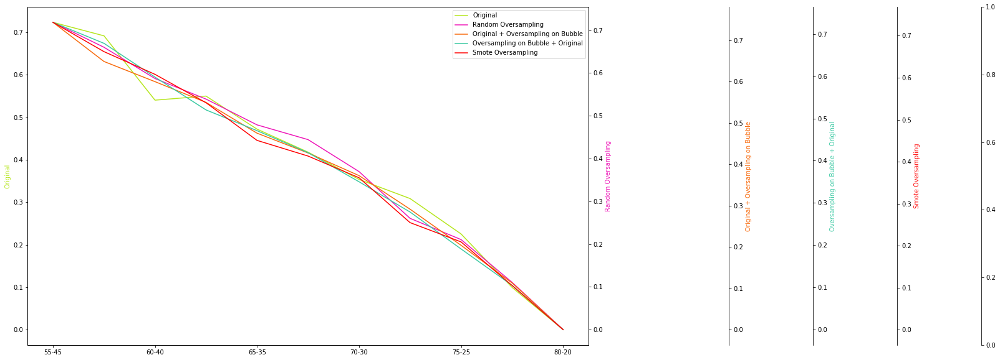

Total_Mini_AccuracyKNN


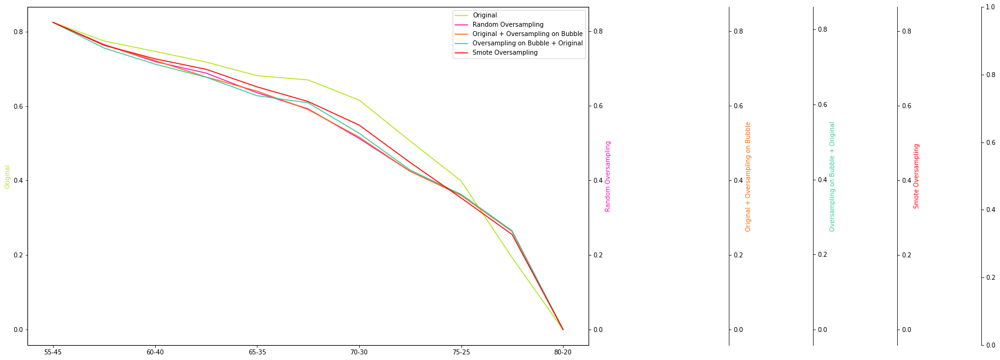

Total_Mini_AccuracySVC


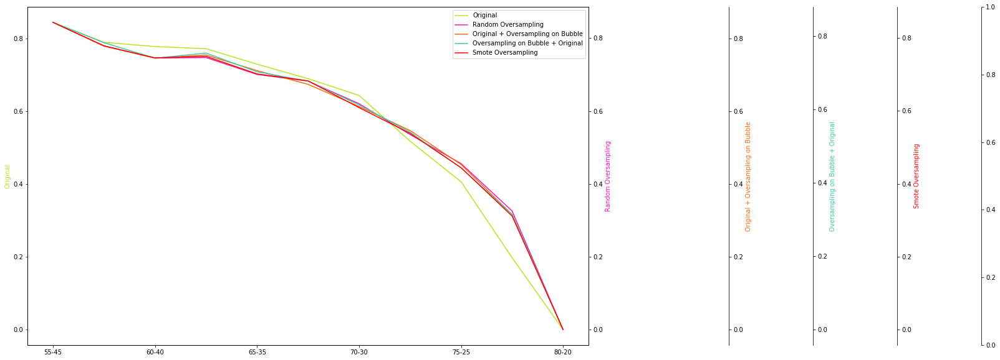

Total_Mini_AccuracyRF


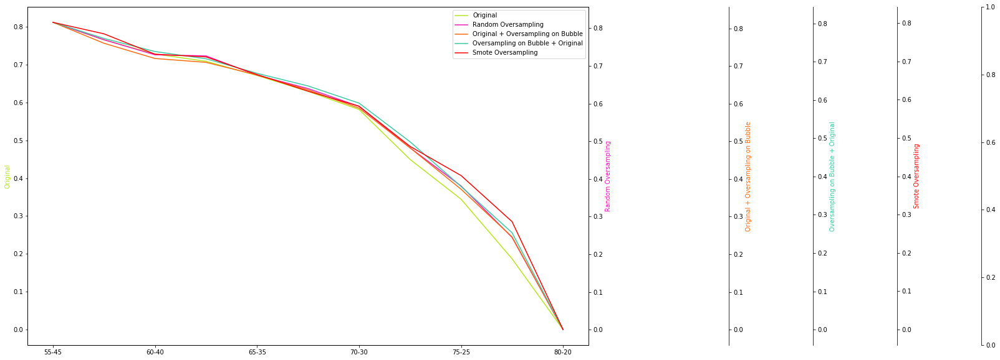

Total_Mini_AccuracyDT


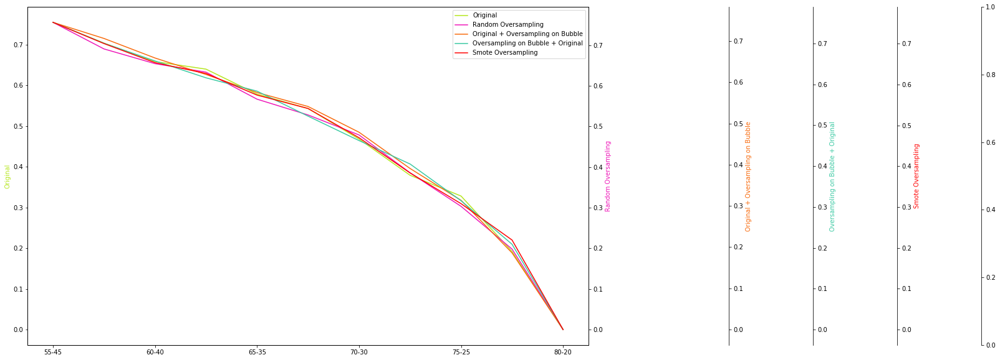

Total_Mini_Precision 0SGD


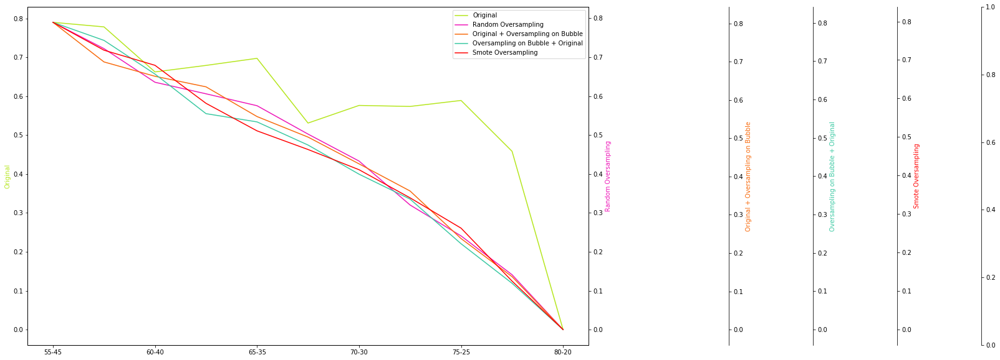

Total_Mini_Precision 0KNN


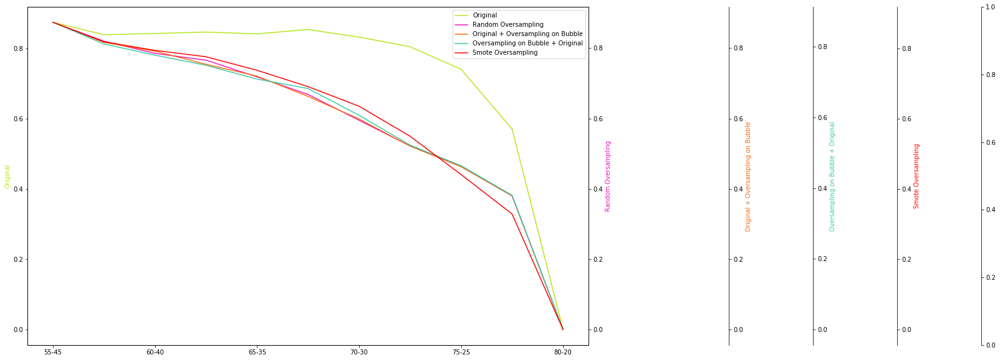

Total_Mini_Precision 0SVC


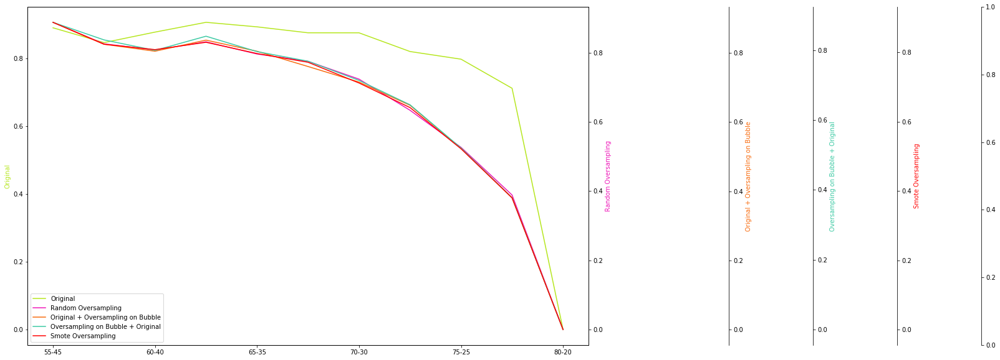

Total_Mini_Precision 0RF


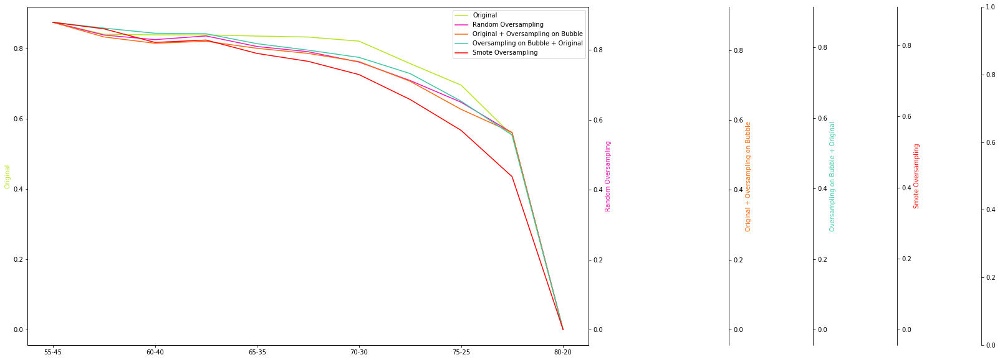

Total_Mini_Precision 0DT


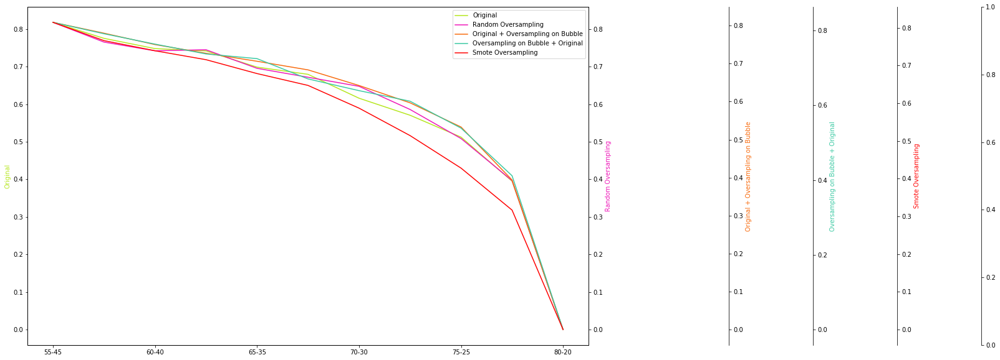

Total_Mini_Precision 1SGD


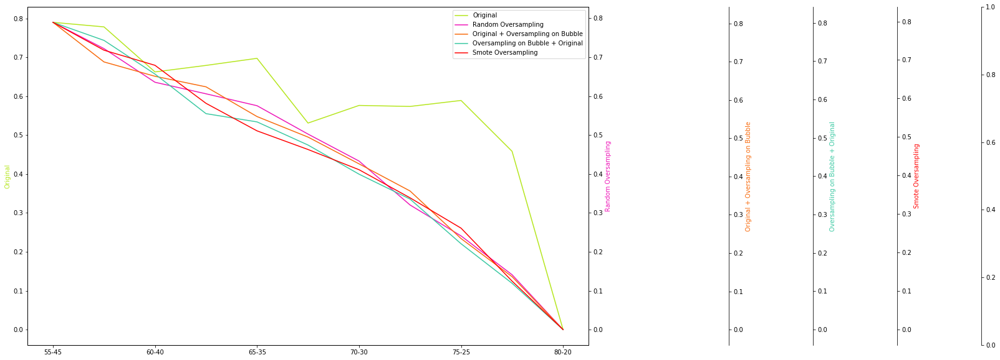

Total_Mini_Precision 1KNN


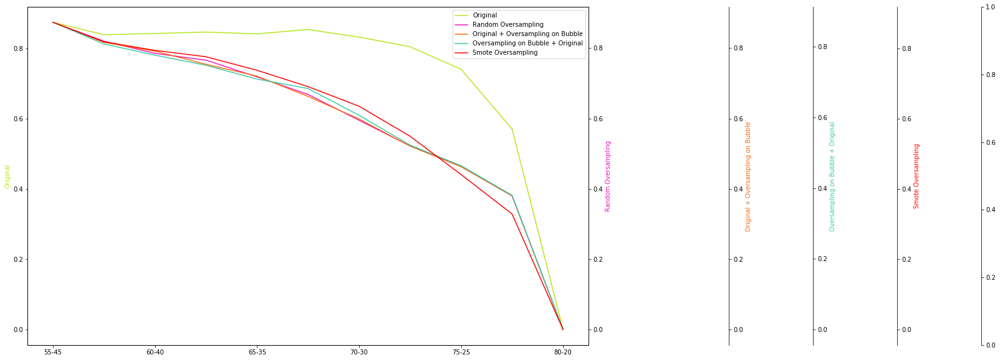

Total_Mini_Precision 1SVC


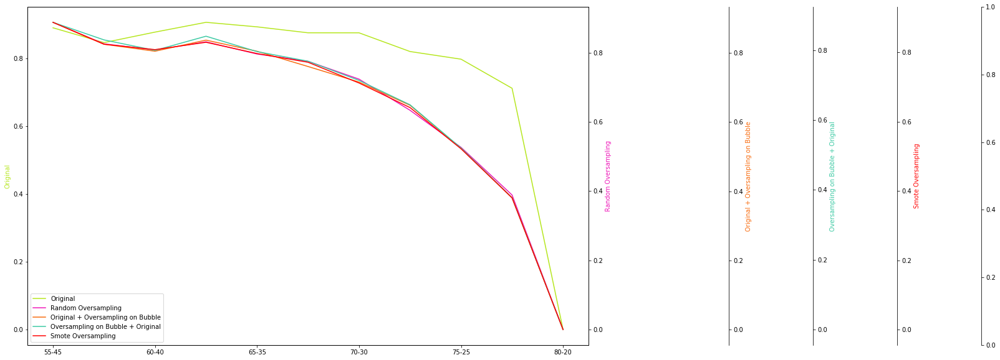

Total_Mini_Precision 1RF


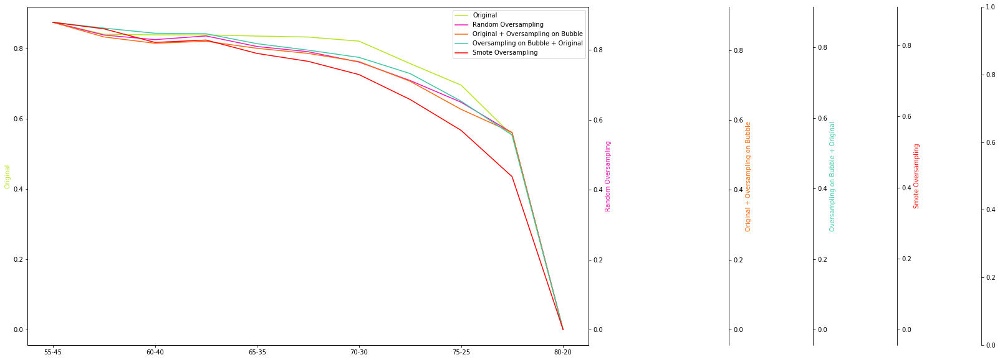

Total_Mini_Precision 1DT


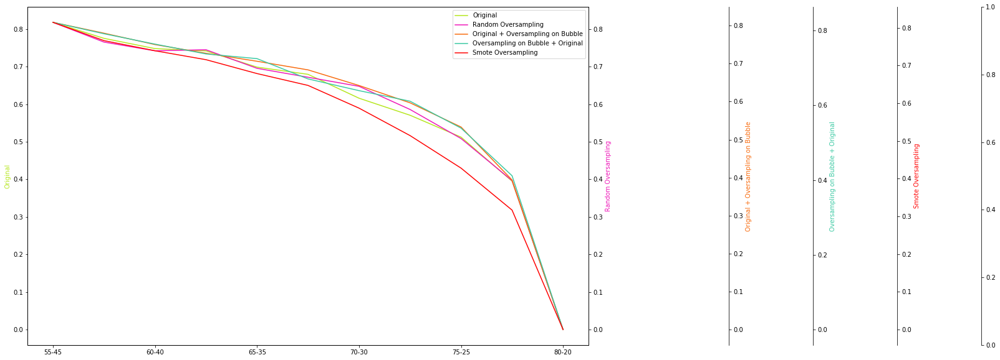

Total_Mini_Recall 0SGD


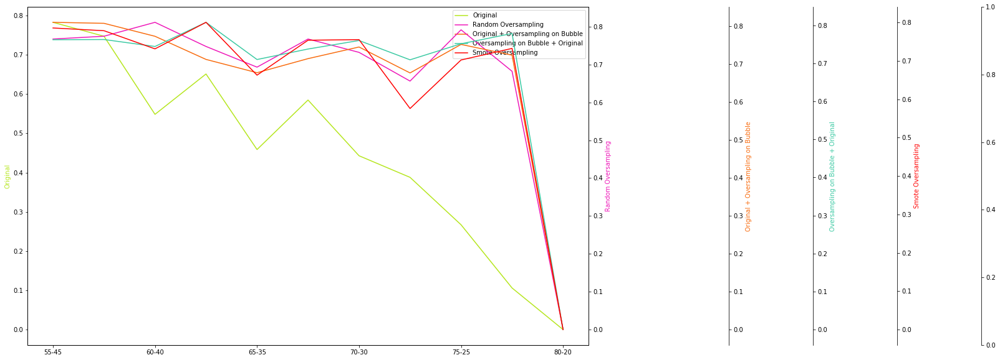

Total_Mini_Recall 0KNN


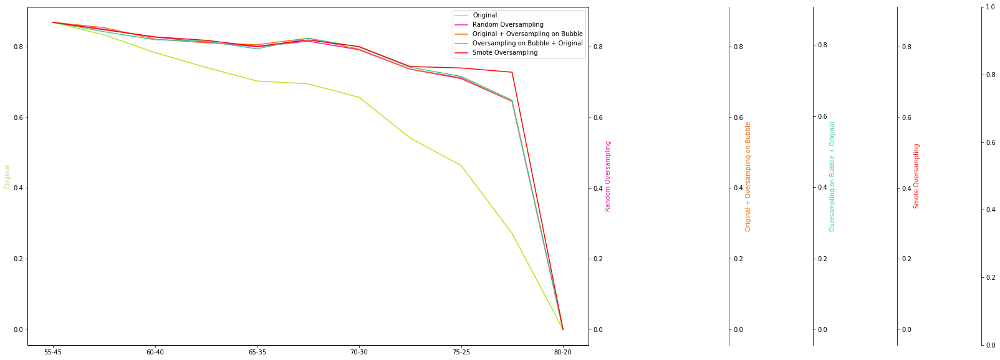

Total_Mini_Recall 0SVC


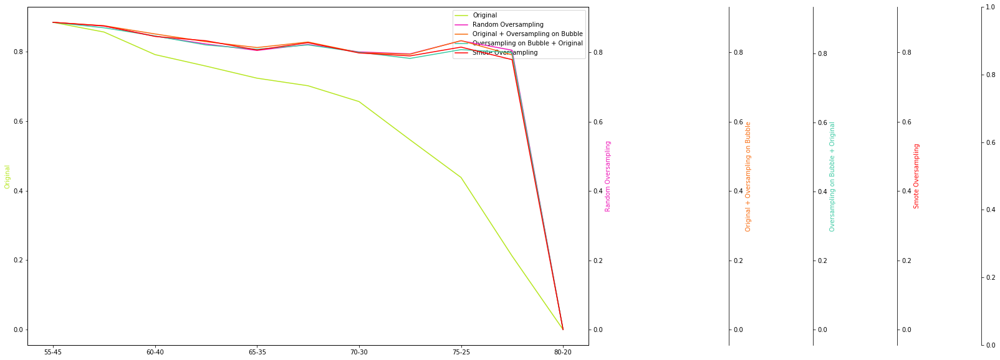

Total_Mini_Recall 0RF


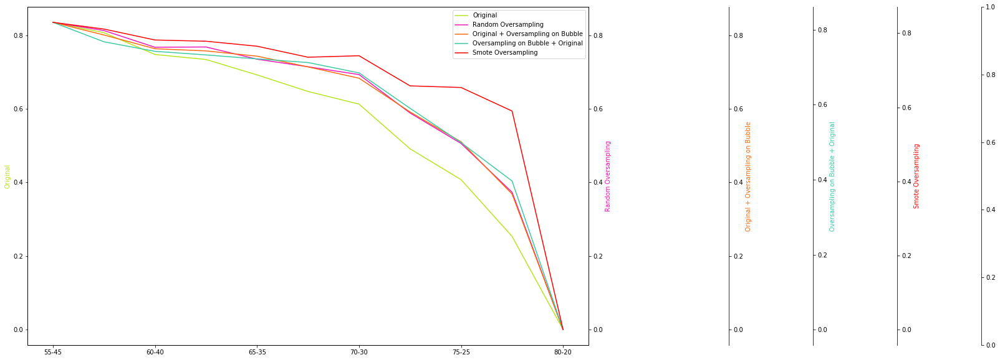

Total_Mini_Recall 0DT


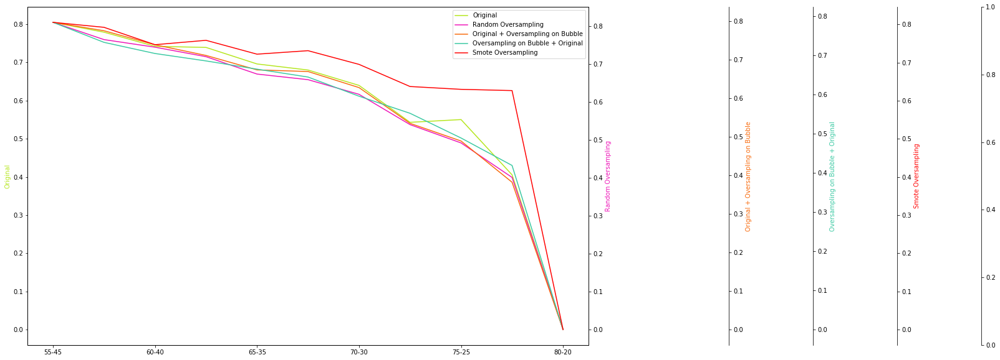

Total_Mini_Recall1SGD


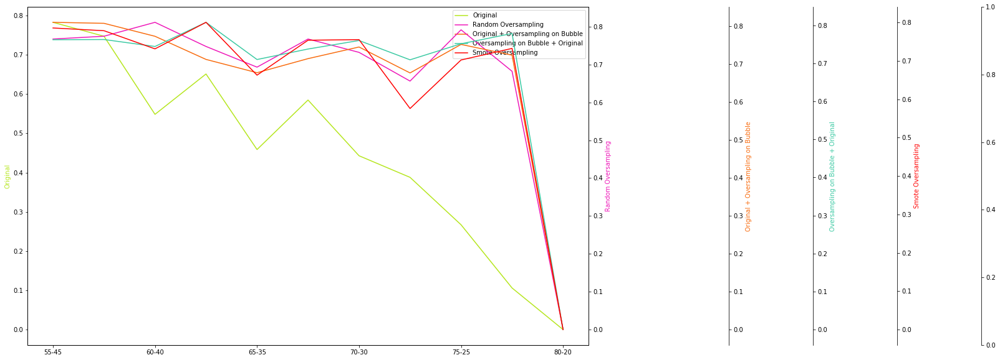

Total_Mini_Recall1KNN


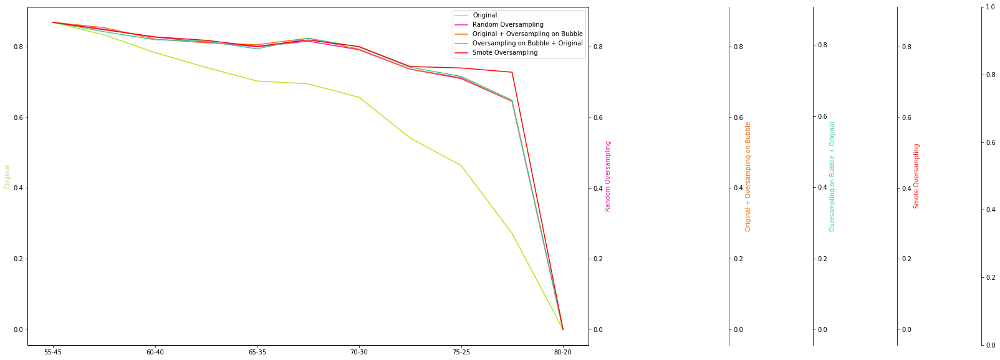

Total_Mini_Recall1SVC


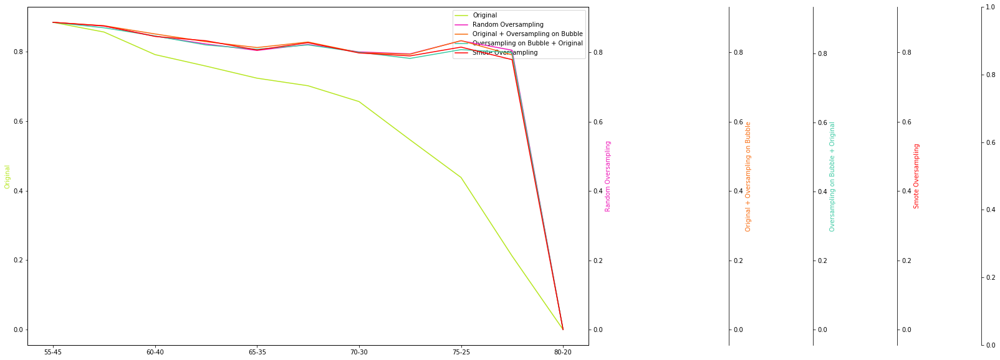

Total_Mini_Recall1RF


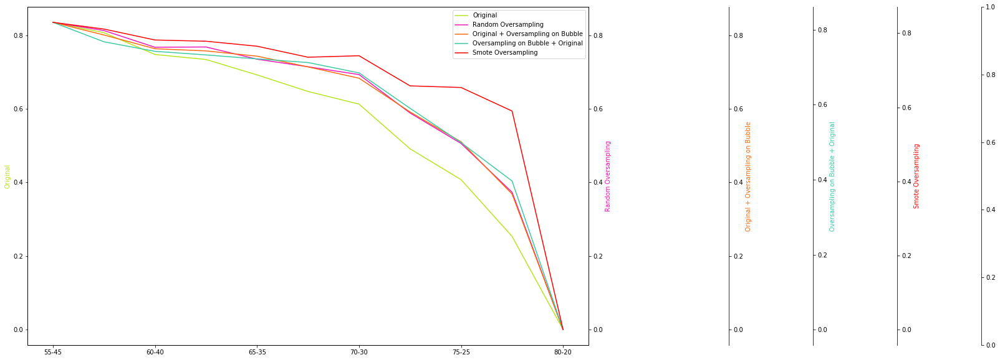

Total_Mini_Recall1DT


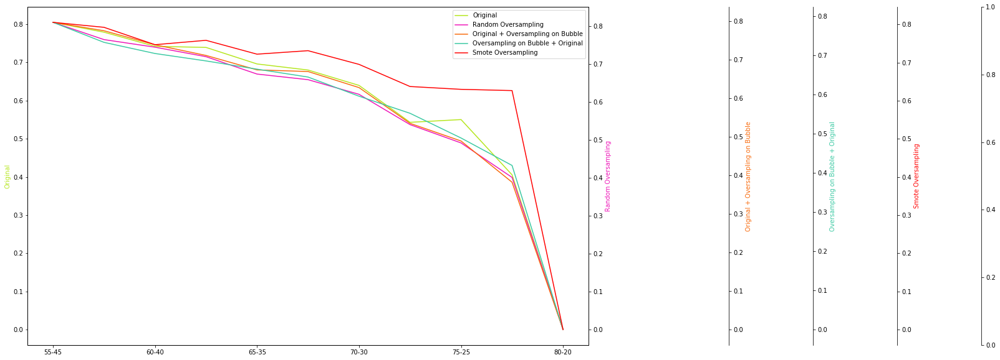

Total_Mini_Balanced_AccuracySGD


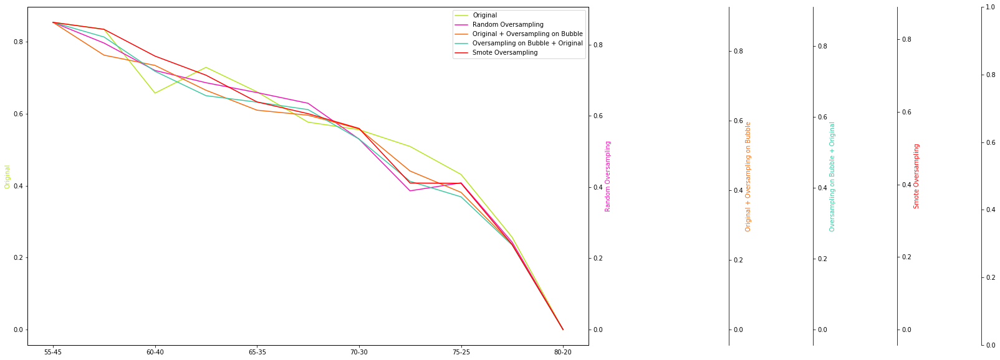

Total_Mini_Balanced_AccuracyKNN


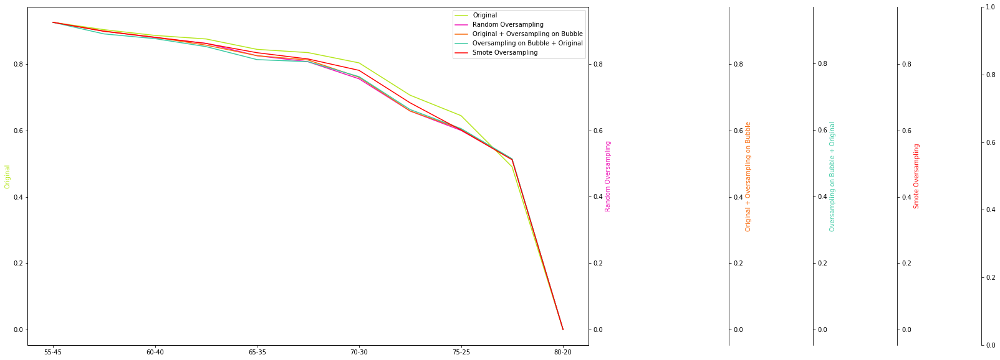

Total_Mini_Balanced_AccuracySVC


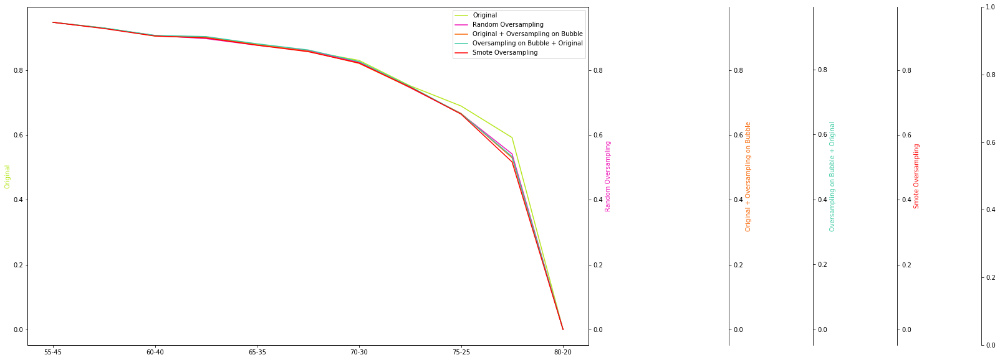

Total_Mini_Balanced_AccuracyRF


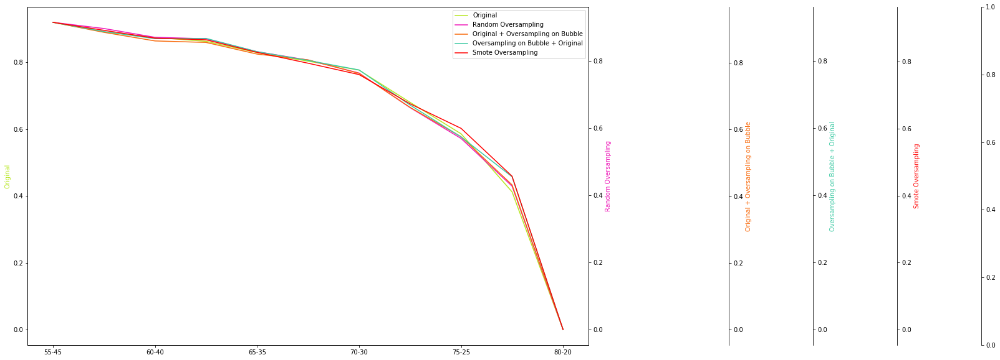

Total_Mini_Balanced_AccuracyDT


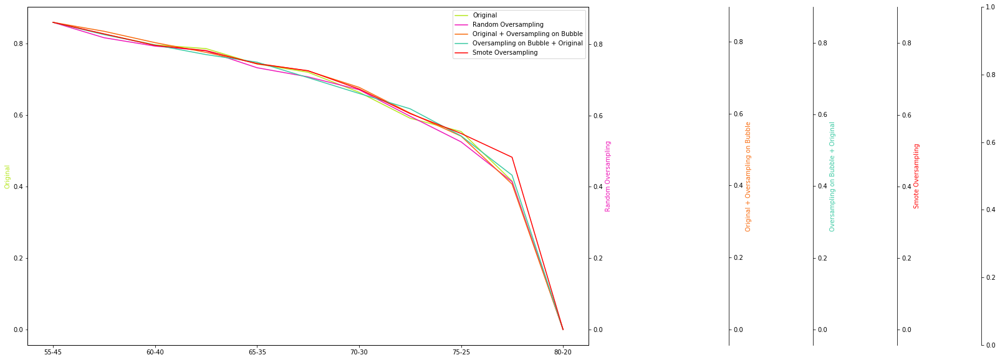

Total_Mini_F1 Score 0SGD


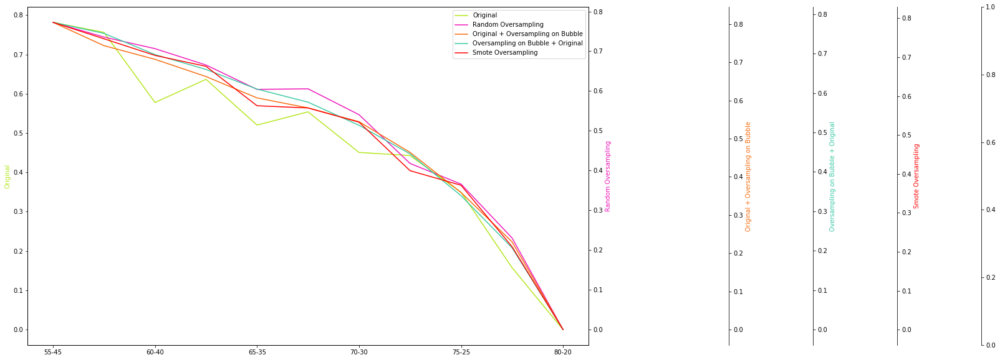

Total_Mini_F1 Score 0KNN


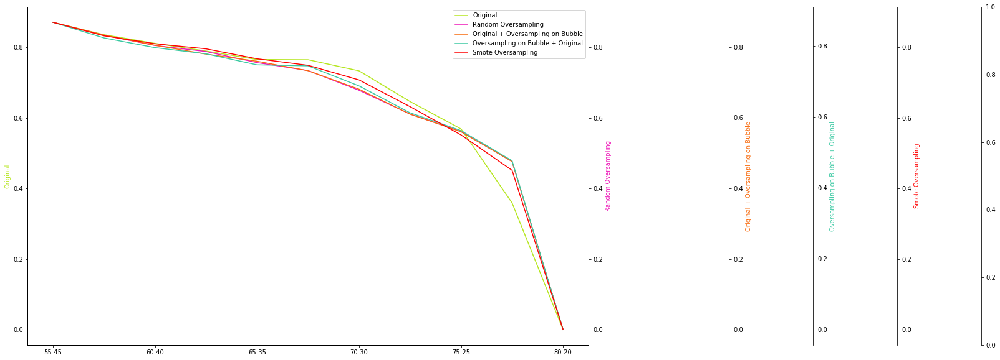

Total_Mini_F1 Score 0SVC


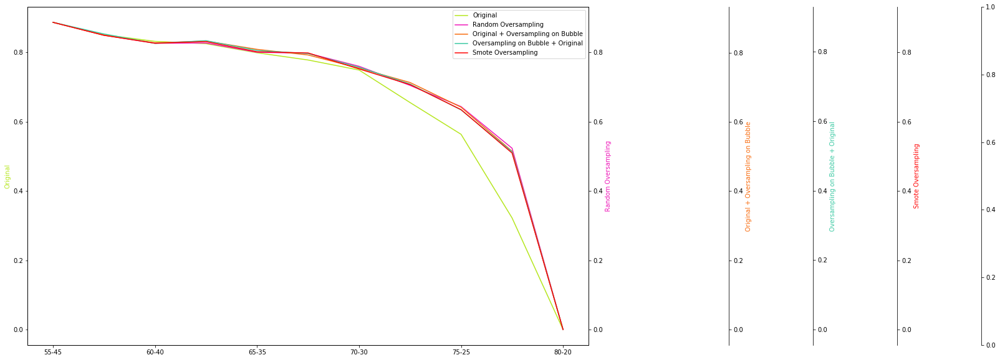

Total_Mini_F1 Score 0RF


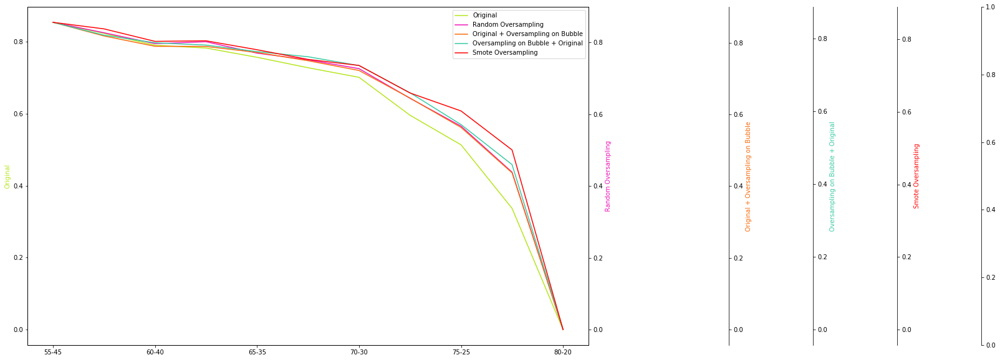

Total_Mini_F1 Score 0DT


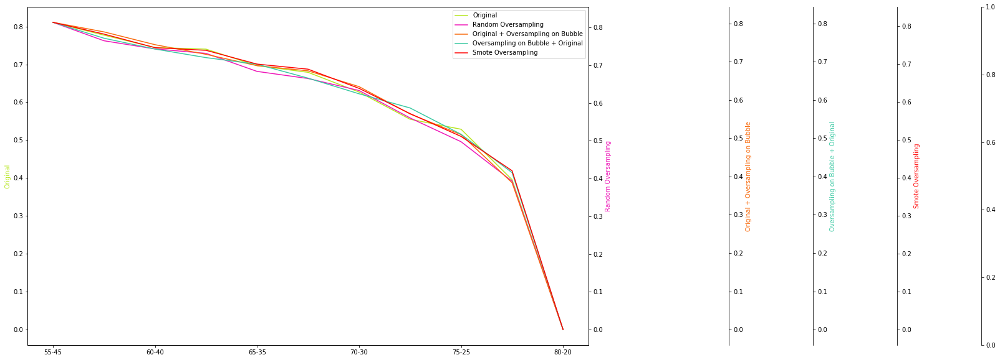

Total_Mini_F1 Score 1SGD


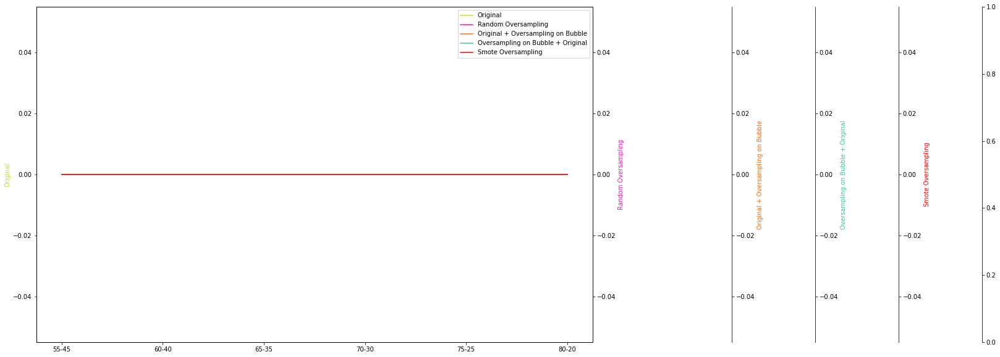

Total_Mini_F1 Score 1KNN


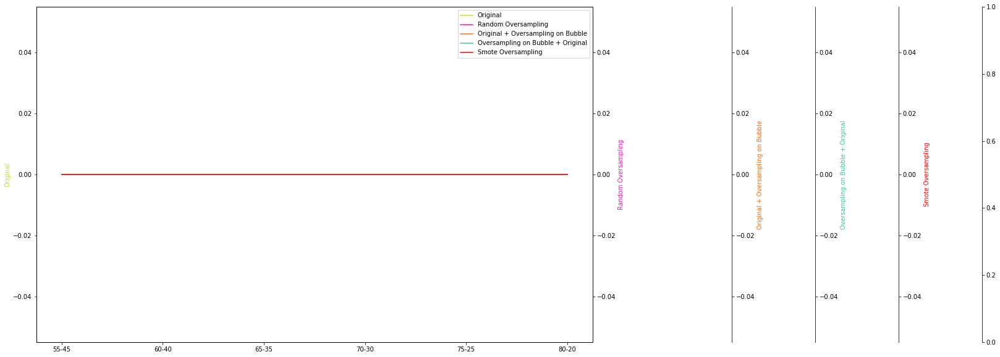

Total_Mini_F1 Score 1SVC


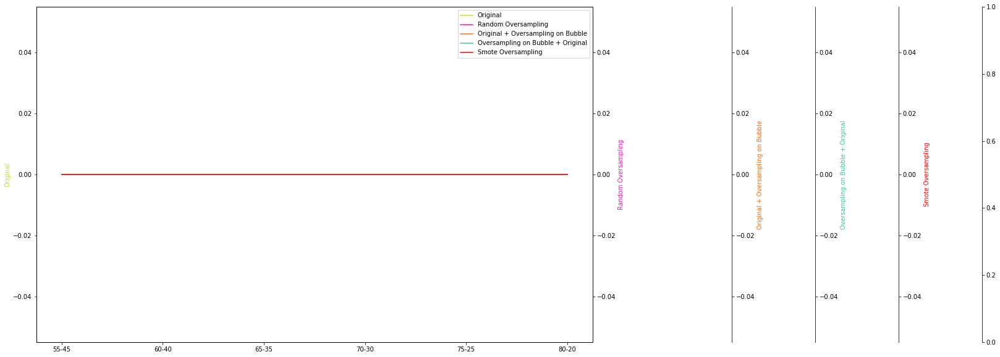

Total_Mini_F1 Score 1RF


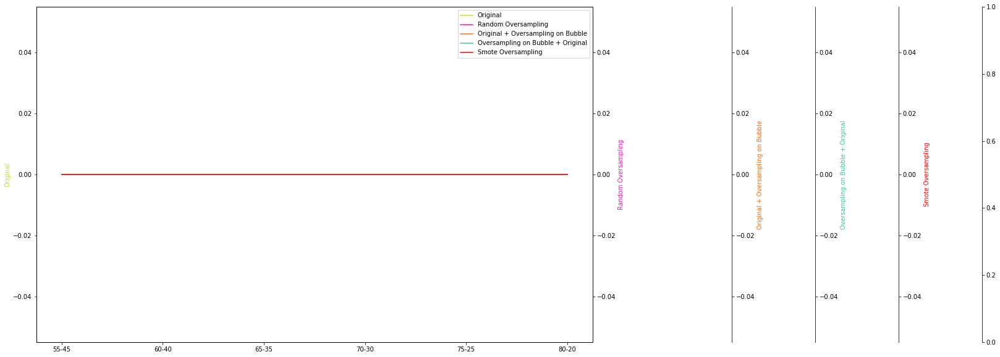

Total_Mini_F1 Score 1DT


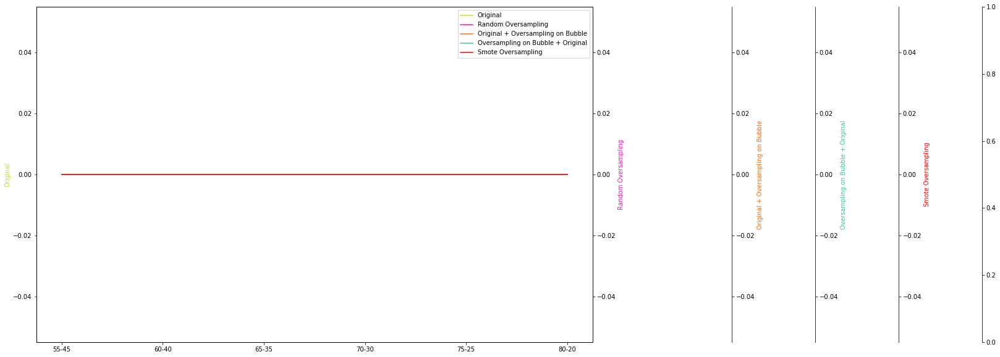

Total_Mini_AUCSGD


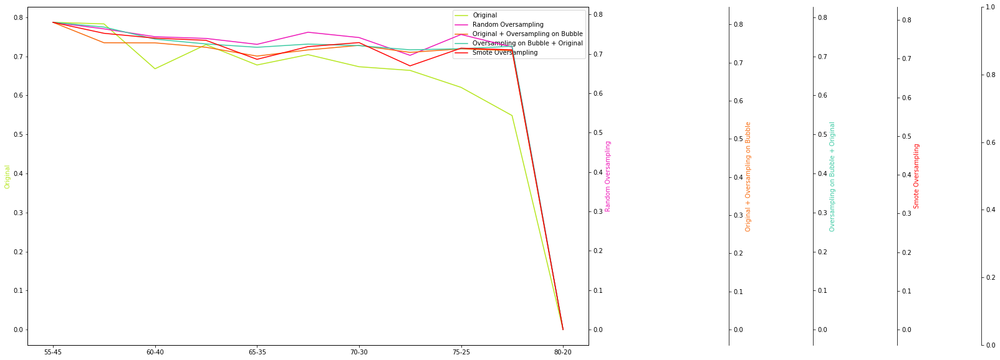

Total_Mini_AUCKNN


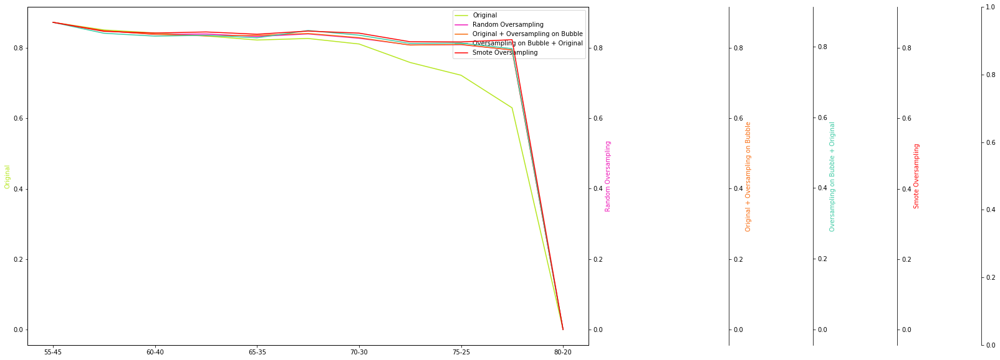

Total_Mini_AUCSVC


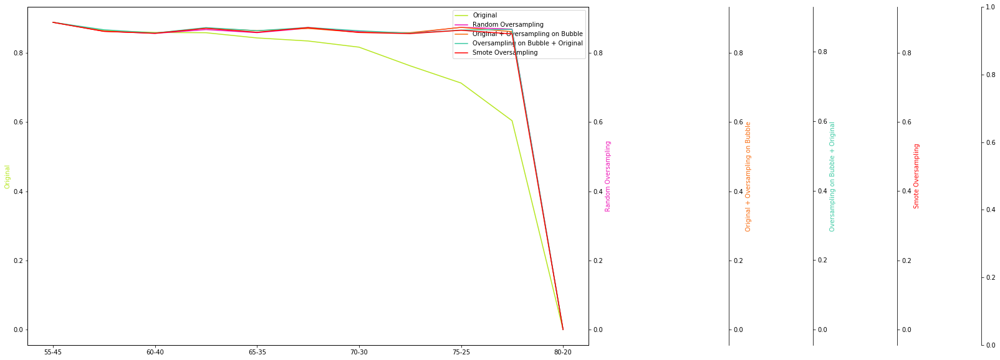

Total_Mini_AUCRF


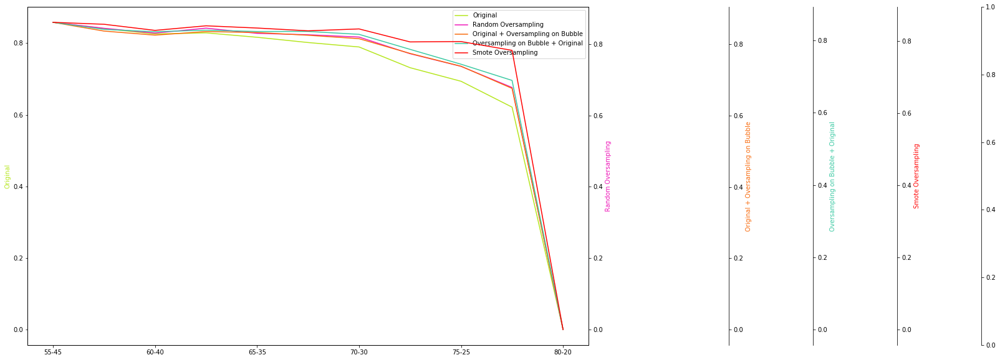

Total_Mini_AUCDT


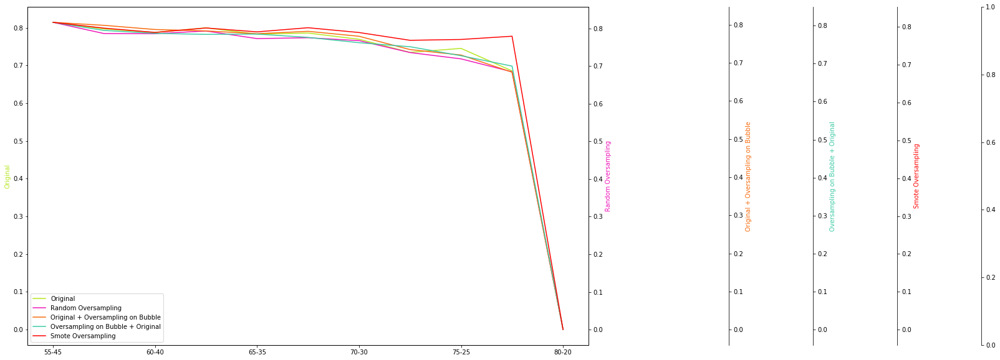

Total_Mini_AUC Probs 0SGD


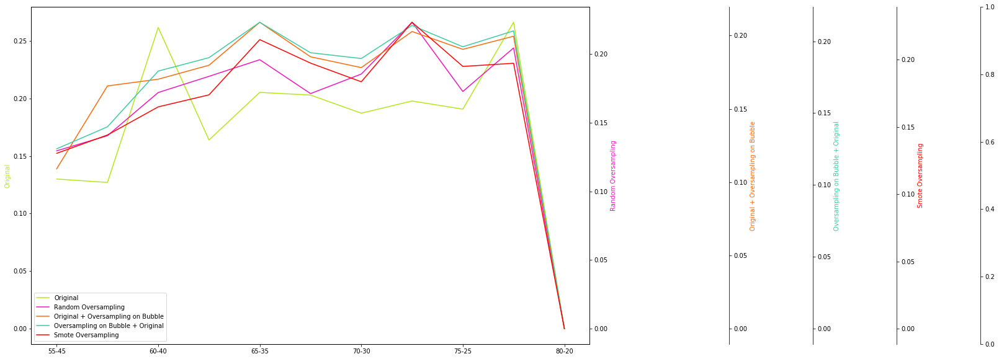

Total_Mini_AUC Probs 0KNN


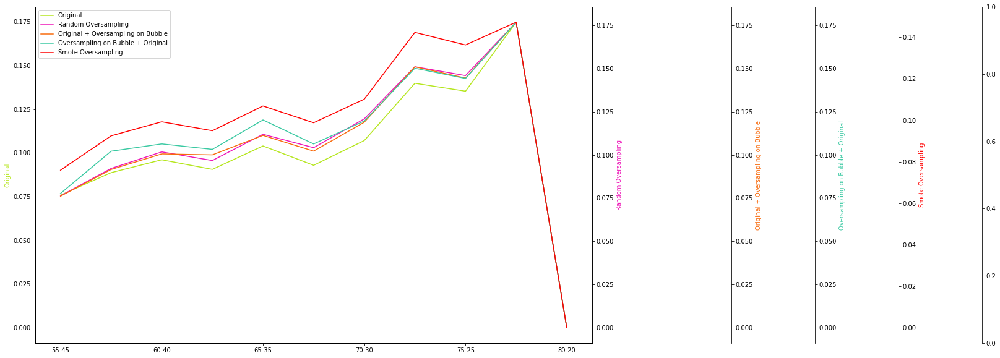

Total_Mini_AUC Probs 0SVC


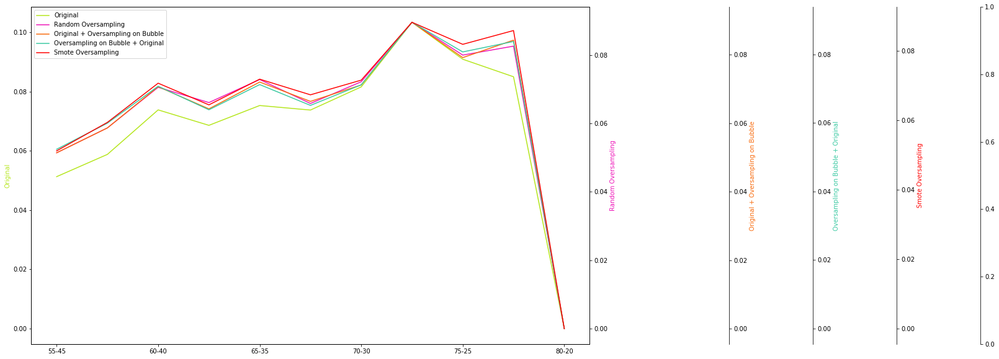

Total_Mini_AUC Probs 0RF


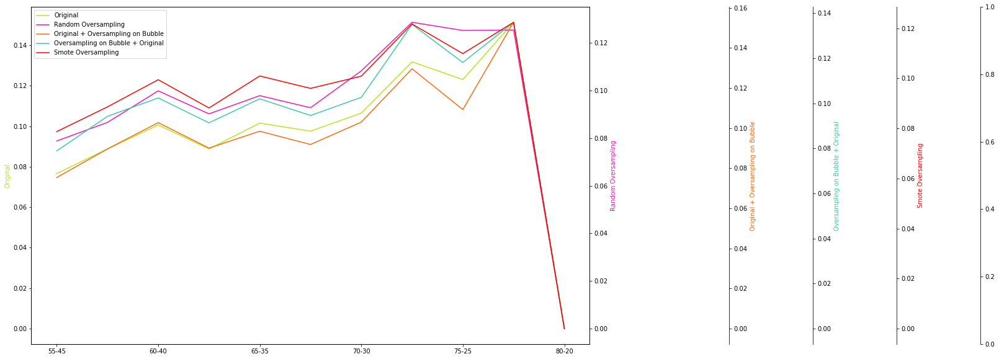

Total_Mini_AUC Probs 0DT


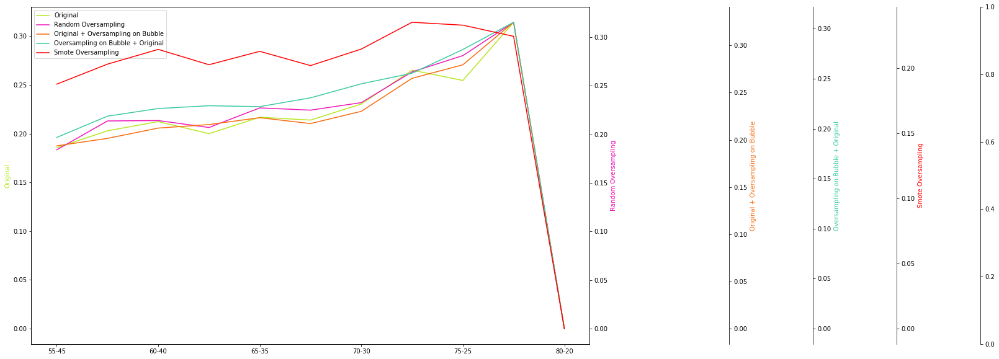

Total_Mini_AUC Probs 1SGD


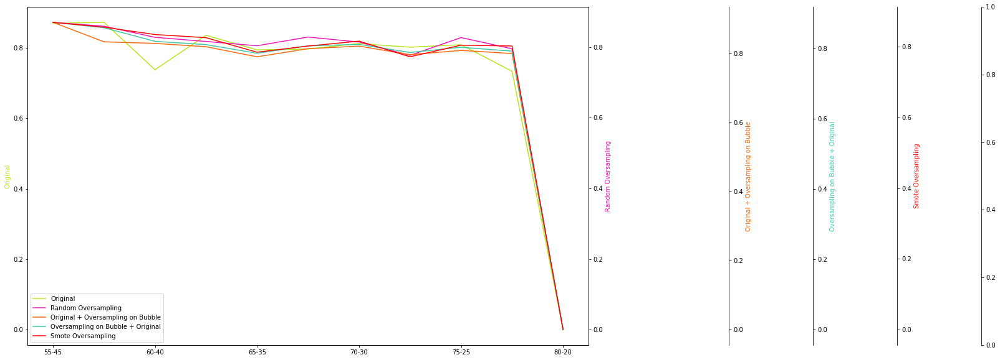

Total_Mini_AUC Probs 1KNN


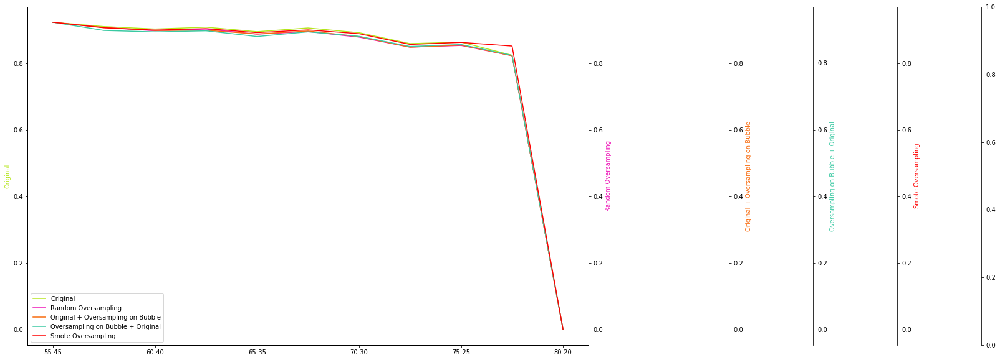

Total_Mini_AUC Probs 1SVC


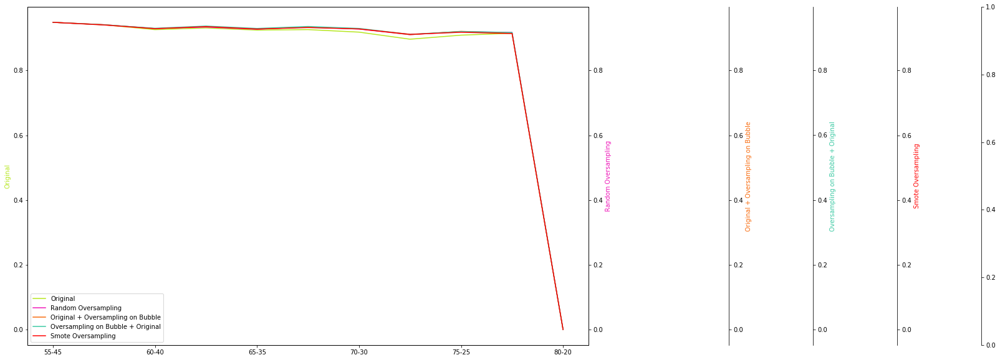

Total_Mini_AUC Probs 1RF


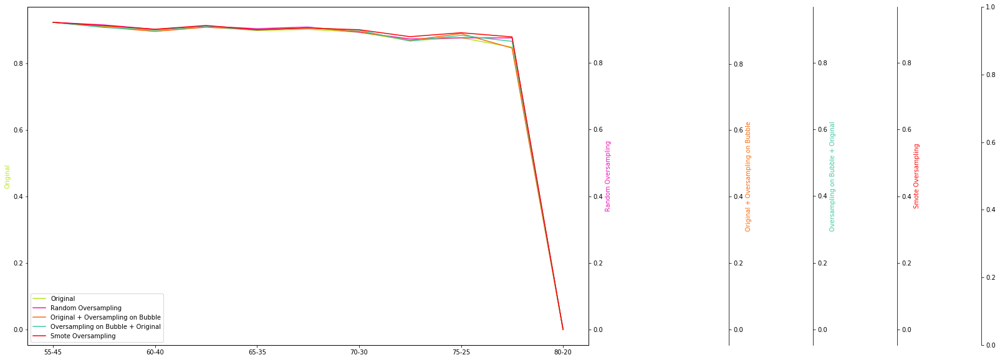

Total_Mini_AUC Probs 1DT


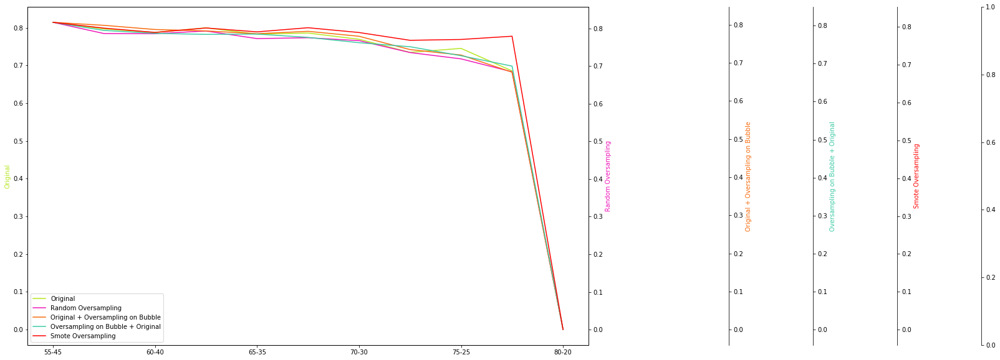

In [13]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1], 6, 'normCats_realSnowBubbles15r-15r_ray10Bis_RealSmote', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    

## Tiny

youp
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bullen 2 0:00:00
aan het bullen 3 0:00:00
aan het bullen 4 0:00:00
aan het bullen 5 0:00:00
aan het bullen 6 0:00:00
Time taken for random bubble oversampling:  0:00:00
SMOTE OVERSAMPLE
Smote Oversample
Time taken for random SMOTE:  0:00:00
setting
props {}
FEATURE VECTOR
Time taken for creating the feature vectors:  0:00:00
ORDER THE DATA
setting
props {}
Time taken for ordering the data:  0:00:00
SPLIT
Time taken for split:  0:00:00
RANDOM OVERSAMPLING
Random Oversample
Time taken for random oversampling:  0:00:00
BUBBLE OVERSAMPLE
Bubble Oversample
aan het bullen 0 0:00:00
aan het bullen 1 0:00:00
aan het bull

           Average Precision:  0.785052552553 , Precicion 0:  0.847222222222 , Precision 1 0.847222222222 , Recall 1:  0.824324324324 , Recall 0:  0.824324324324 , PR AUC:  0.880016698634 , F1 Score 0:  0.835616438356 , F1 Score1:  0.835616438356 , AUC:  0.83979374111 , AUC Probs 0:  0.118865576102 , AUC Probs 1:  0.881223328592
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.609205154522 , Precicion 0:  0.658227848101 , Precision 1 0.658227848101 , Recall 1:  0.702702702703 , Recall 0:  0.702702702703 , PR AUC:  0.657945553891 , F1 Score 0:  0.679738562092 , F1 Score1:  0.679738562092 , AUC:  0.673719772404 , AUC Probs 0:  0.253378378378 , AUC Probs 1:  0.746621621622
         1
           Average Precision:  0.609205154522 , Precicion 0:  0.658227848101 , Precision 1 0.658227848101 , Recall 1:  0.702702702703 , Recall 0:  0.702702702703 , PR AUC:  0.753213602274 , F1 Score 0:  0.679738562092 , 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


, AUC Probs 1:  0.84939544808
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.539587904736 , Precicion 0:  0.554455445545 , Precision 1 0.554455445545 , Recall 1:  0.756756756757 , Recall 0:  0.756756756757 , PR AUC:  0.635423059239 , F1 Score 0:  0.64 , F1 Score1:  0.64 , AUC:  0.582325746799 , AUC Probs 0:  0.368243243243 , AUC Probs 1:  0.631756756757
         1
           Average Precision:  0.710643500644 , Precicion 0:  0.785714285714 , Precision 1 0.785714285714 , Recall 1:  0.743243243243 , Recall 0:  0.743243243243 , PR AUC:  0.878422725208 , F1 Score 0:  0.763888888889 , F1 Score1:  0.763888888889 , AUC:  0.772937411095 , AUC Probs 0:  0.13673541963 , AUC Probs 1:  0.86326458037
         2
           Average Precision:  0.535729166667 , Precicion 0:  0.578125 , Precision 1 0.578125 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.644002053609 , F1 Score 0:  0.5362

           Average Precision:  0.785515385515 , Precicion 0:  0.831168831169 , Precision 1 0.831168831169 , Recall 1:  0.864864864865 , Recall 0:  0.864864864865 , PR AUC:  0.893765063765 , F1 Score 0:  0.847682119205 , F1 Score1:  0.847682119205 , AUC:  0.846906116643 , AUC Probs 0:  0.109263869132 , AUC Probs 1:  0.890736130868
         6
           Average Precision:  0.864149219642 , Precicion 0:  0.915492957746 , Precision 1 0.915492957746 , Recall 1:  0.878378378378 , Recall 0:  0.878378378378 , PR AUC:  0.952827384829 , F1 Score 0:  0.896551724138 , F1 Score1:  0.896551724138 , AUC:  0.899715504979 , AUC Probs 0:  0.0647226173542 , AUC Probs 1:  0.935277382646
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.844853010906 , Precicion 0:  0.881578947368 , Precision 1 0.881578947368 , Recall 1:  0.905405405405 , Recall 0:  0.905405405405 , PR AUC:  0.946375849789 , F1 Score 0:  0.893333333333 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.947087046635 , F1 Score 0:  0.893333333333 , F1 Score1:  0.893333333333 , AUC:  0.893492176387 , AUC Probs 0:  0.0533428165007 , AUC Probs 1:  0.946657183499
         1
           Average Precision:  0.887457892675 , Precicion 0:  0.942028985507 , Precision 1 0.942028985507 , Recall 1:  0.878378378378 , Recall 0:  0.878378378378 , PR AUC:  0.939473616289 , F1 Score 0:  0.909090909091 , F1 Score1:  0.909090909091 , AUC:  0.912873399716 , AUC Probs 0:  0.0629445234708 , AUC Probs 1:  0.937055476529
         2
           Average Precision:  0.823700623701 , Precicion 0:  0.907692307692 , Precision 1 0.907692307692 , Recall 1:  0.797297297297 , Recall 0:  0.797297297297 , PR AUC:  0.924469470224 , F1 Score 0:  0.848920863309 , F1 Score1:  0.848920863309 , AUC:  0.859174964438 , AUC Probs 0:  0.0835704125178 , AUC Probs 1:  0.916429587482
         3
           Average Precision:  0.828757771856 , Precicion 0:  0.887323943662 , Precision 1 0.887323943662 , Recall 1:  0.851351351351 , Recal

           Average Precision:  0.855312626059 , Precicion 0:  0.925373134328 , Precision 1 0.925373134328 , Recall 1:  0.837837837838 , Recall 0:  0.837837837838 , PR AUC:  0.883319434682 , F1 Score 0:  0.879432624113 , F1 Score1:  0.879432624113 , AUC:  0.886024182077 , AUC Probs 0:  0.0604551920341 , AUC Probs 1:  0.939544807966
         2
           Average Precision:  0.828757771856 , Precicion 0:  0.887323943662 , Precision 1 0.887323943662 , Recall 1:  0.851351351351 , Recall 0:  0.851351351351 , PR AUC:  0.910705258348 , F1 Score 0:  0.868965517241 , F1 Score1:  0.868965517241 , AUC:  0.873044096728 , AUC Probs 0:  0.0698790896159 , AUC Probs 1:  0.930120910384
         3
           Average Precision:  0.850654132393 , Precicion 0:  0.913043478261 , Precision 1 0.913043478261 , Recall 1:  0.851351351351 , Recall 0:  0.851351351351 , PR AUC:  0.953678307135 , F1 Score 0:  0.881118881119 , F1 Score1:  0.881118881119 , AUC:  0.886201991465 , AUC Probs 0:  0.050853485064 , AUC Probs

           Average Precision:  0.864846618771 , Precicion 0:  0.886075949367 , Precision 1 0.886075949367 , Recall 1:  0.945945945946 , Recall 0:  0.945945945946 , PR AUC:  0.929636163904 , F1 Score 0:  0.915032679739 , F1 Score1:  0.915032679739 , AUC:  0.913762446657 , AUC Probs 0:  0.0579658605974 , AUC Probs 1:  0.942034139403
         5
           Average Precision:  0.802030323006 , Precicion 0:  0.829268292683 , Precision 1 0.829268292683 , Recall 1:  0.918918918919 , Recall 0:  0.918918918919 , PR AUC:  0.812674891485 , F1 Score 0:  0.871794871795 , F1 Score1:  0.871794871795 , AUC:  0.867354196302 , AUC Probs 0:  0.124288762447 , AUC Probs 1:  0.875711237553
         6
           Average Precision:  0.830968183373 , Precicion 0:  0.860759493671 , Precision 1 0.860759493671 , Recall 1:  0.918918918919 , Recall 0:  0.918918918919 , PR AUC:  0.940717732944 , F1 Score 0:  0.888888888889 , F1 Score1:  0.888888888889 , AUC:  0.887091038407 , AUC Probs 0:  0.0608108108108 , AUC Probs

           Average Precision:  0.754622674623 , Precicion 0:  0.805194805195 , Precision 1 0.805194805195 , Recall 1:  0.837837837838 , Recall 0:  0.837837837838 , PR AUC:  0.864873724303 , F1 Score 0:  0.82119205298 , F1 Score1:  0.82119205298 , AUC:  0.820234708393 , AUC Probs 0:  0.123133001422 , AUC Probs 1:  0.876866998578
         6
           Average Precision:  0.819432566895 , Precicion 0:  0.89552238806 , Precision 1 0.89552238806 , Recall 1:  0.810810810811 , Recall 0:  0.810810810811 , PR AUC:  0.930450861903 , F1 Score 0:  0.851063829787 , F1 Score1:  0.851063829787 , AUC:  0.859352773826 , AUC Probs 0:  0.077880512091 , AUC Probs 1:  0.922119487909
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.811633041492 , Precicion 0:  0.87323943662 , Precision 1 0.87323943662 , Recall 1:  0.837837837838 , Recall 0:  0.837837837838 , PR AUC:  0.929862786576 , F1 Score 0:  0.855172413793 , F1 Sc

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 0.866666666667 , Precision 1 0.866666666667 , Recall 1:  0.878378378378 , Recall 0:  0.878378378378 , PR AUC:  0.934779144816 , F1 Score 0:  0.872483221477 , F1 Score1:  0.872483221477 , AUC:  0.873399715505 , AUC Probs 0:  0.0705014224751 , AUC Probs 1:  0.929498577525
         1
           Average Precision:  0.833094077684 , Precicion 0:  0.934426229508 , Precision 1 0.934426229508 , Recall 1:  0.77027027027 , Recall 0:  0.77027027027 , PR AUC:  0.936697197522 , F1 Score 0:  0.844444444444 , F1 Score1:  0.844444444444 , AUC:  0.858819345661 , AUC Probs 0:  0.0624110953058 , AUC Probs 1:  0.937588904694
         2
           Average Precision:  0.799355292793 , Precicion 0:  0.890625 , Precision 1 0.890625 , Recall 1:  0.77027027027 , Recall 0:  0.77027027027 , PR AUC:  0.898356331105 , F1 Score 0:  0.826086956522 , F1 Score1:  0.826086956522 , AUC:  0.839082503556 , AUC Probs 0:  0.104907539118 , AUC Probs 1:  0.895092460882
         3
           Average Precision:  0.788314028314 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.84 , Precision 1 0.84 , Recall 1:  0.851351351351 , Recall 0:  0.851351351351 , PR AUC:  0.890669354853 , F1 Score 0:  0.845637583893 , F1 Score1:  0.845637583893 , AUC:  0.846728307255 , AUC Probs 0:  0.101084637269 , AUC Probs 1:  0.898915362731
         6
           Average Precision:  0.815417156287 , Precicion 0:  0.884057971014 , Precision 1 0.884057971014 , Recall 1:  0.824324324324 , Recall 0:  0.824324324324 , PR AUC:  0.93261385168 , F1 Score 0:  0.853146853147 , F1 Score1:  0.853146853147 , AUC:  0.859530583215 , AUC Probs 0:  0.0697012802276 , AUC Probs 1:  0.930298719772
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.812735462735 , Precicion 0:  0.893939393939 , Precision 1 0.893939393939 , Recall 1:  0.797297297297 , Recall 0:  0.797297297297 , PR AUC:  0.934406571747 , F1 Score 0:  0.842857142857 , F1 Score1:  0.842857142857 ,

           Average Precision:  0.733550417888 , Precicion 0:  0.771084337349 , Precision 1 0.771084337349 , Recall 1:  0.864864864865 , Recall 0:  0.864864864865 , PR AUC:  0.85130793444 , F1 Score 0:  0.815286624204 , F1 Score1:  0.815286624204 , AUC:  0.807432432432 , AUC Probs 0:  0.192567567568 , AUC Probs 1:  0.807432432432
         6
           Average Precision:  0.731330561331 , Precicion 0:  0.782051282051 , Precision 1 0.782051282051 , Recall 1:  0.824324324324 , Recall 0:  0.824324324324 , PR AUC:  0.846521136521 , F1 Score 0:  0.802631578947 , F1 Score1:  0.802631578947 , AUC:  0.800320056899 , AUC Probs 0:  0.199679943101 , AUC Probs 1:  0.800320056899
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.744390966309 , Precicion 0:  0.808219178082 , Precision 1 0.808219178082 , Recall 1:  0.797297297297 , Recall 0:  0.797297297297 , PR AUC:  0.85275823769 , F1 Sco

           Average Precision:  0.540372213009 , Precicion 0:  0.58024691358 , Precision 1 0.58024691358 , Recall 1:  0.701492537313 , Recall 0:  0.701492537313 , PR AUC:  0.695180226595 , F1 Score 0:  0.635135135135 , F1 Score1:  0.635135135135 , AUC:  0.645926991548 , AUC Probs 0:  0.262722531919 , AUC Probs 1:  0.737996763172
         2
           Average Precision:  0.578047263682 , Precicion 0:  0.65625 , Precision 1 0.65625 , Recall 1:  0.626865671642 , Recall 0:  0.626865671642 , PR AUC:  0.733836960767 , F1 Score 0:  0.641221374046 , F1 Score1:  0.641221374046 , AUC:  0.680902715339 , AUC Probs 0:  0.262542708146 , AUC Probs 1:  0.737457291854
         3
           Average Precision:  0.636147927525 , Precicion 0:  0.683544303797 , Precision 1 0.683544303797 , Recall 1:  0.794117647059 , Recall 0:  0.794117647059 , PR AUC:  0.844334586122 , F1 Score 0:  0.734693877551 , F1 Score1:  0.734693877551 , AUC:  0.744619799139 , AUC Probs 0:  0.15243902439 , AUC Probs 1:  0.84756097561


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.603725490196 , Precicion 0:  0.65 , Precision 1 0.65 , Recall 1:  0.764705882353 , Recall 0:  0.764705882353 , PR AUC:  0.562250831853 , F1 Score 0:  0.702702702703 , F1 Score1:  0.702702702703 , AUC:  0.711621233859 , AUC Probs 0:  0.278335724534 , AUC Probs 1:  0.721305595409
         5
           Average Precision:  0.727990196078 , Precicion 0:  0.8125 , Precision 1 0.8125 , Recall 1:  0.764705882353 , Recall 0:  0.764705882353 , PR AUC:  0.871866752084 , F1 Score 0:  0.787878787879 , F1 Score1:  0.787878787879 , AUC:  0.809182209469 , AUC Probs 0:  0.110473457676 , AUC Probs 1:  0.889526542324
         6
           Average Precision:  0.547009803922 , Precicion 0:  0.583333333333 , Precision 1 0.583333333333 , Recall 1:  0.720588235294 , Recall 0:  0.720588235294 , PR AUC:  0.663695013158 , F1 Score 0:  0.644736842105 , F1 Score1:  0.644736842105 , AUC:  0.646879483501 , AUC Probs 0:  0.28506097561 , AUC Probs 1:  0.71493902439
     Time taken TO TRAIN THE R

           Average Precision:  0.70841506752 , Precicion 0:  0.771428571429 , Precision 1 0.771428571429 , Recall 1:  0.805970149254 , Recall 0:  0.805970149254 , PR AUC:  0.859316806142 , F1 Score 0:  0.788321167883 , F1 Score1:  0.788321167883 , AUC:  0.806599532458 , AUC Probs 0:  0.124707786369 , AUC Probs 1:  0.875292213631
         1
           Average Precision:  0.755430953341 , Precicion 0:  0.797297297297 , Precision 1 0.797297297297 , Recall 1:  0.880597014925 , Recall 0:  0.880597014925 , PR AUC:  0.876144573942 , F1 Score 0:  0.836879432624 , F1 Score1:  0.836879432624 , AUC:  0.84993706168 , AUC Probs 0:  0.100161841395 , AUC Probs 1:  0.899838158605
         2
           Average Precision:  0.771929902725 , Precicion 0:  0.835820895522 , Precision 1 0.835820895522 , Recall 1:  0.835820895522 , Recall 0:  0.835820895522 , PR AUC:  0.893262327789 , F1 Score 0:  0.835820895522 , F1 Score1:  0.835820895522 , AUC:  0.85164538752 , AUC Probs 0:  0.0991728106456 , AUC Probs 1: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.792782446312 , Precicion 0:  0.873015873016 , Precision 1 0.873015873016 , Recall 1:  0.808823529412 , Recall 0:  0.808823529412 , PR AUC:  0.944111644658 , F1 Score 0:  0.839694656489 , F1 Score1:  0.839694656489 , AUC:  0.855631276901 , AUC Probs 0:  0.0564921090387 , AUC Probs 1:  0.943507890961
         6
           Average Precision:  0.735188129306 , Precicion 0:  0.783783783784 , Precision 1 0.783783783784 , Recall 1:  0.852941176471 , Recall 0:  0.852941176471 , PR AUC:  0.8995989864 , F1 Score 0:  0.816901408451 , F1 Score1:  0.816901408451 , AUC:  0.828909612626 , AUC Probs 0:  0.0834827833572 , AUC Probs 1:  0.916517216643
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.699658047789 , Precicion 0:  0.760563380282 , Precision 1 0.760563380282 , Recall 1:  0.805970149254 , Recall 0:  0.805970149254 , PR AUC:  0.86

           Average Precision:  0.819886642157 , Precicion 0:  0.890625 , Precision 1 0.890625 , Recall 1:  0.838235294118 , Recall 0:  0.838235294118 , PR AUC:  0.945804215171 , F1 Score 0:  0.863636363636 , F1 Score1:  0.863636363636 , AUC:  0.87643472023 , AUC Probs 0:  0.0441176470588 , AUC Probs 1:  0.955882352941
         6
           Average Precision:  0.774148204736 , Precicion 0:  0.805194805195 , Precision 1 0.805194805195 , Recall 1:  0.911764705882 , Recall 0:  0.911764705882 , PR AUC:  0.879043476383 , F1 Score 0:  0.855172413793 , F1 Score1:  0.855172413793 , AUC:  0.864418938307 , AUC Probs 0:  0.071018651363 , AUC Probs 1:  0.928981348637
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.702773631841 , Precicion 0:  0.7375 , Precision 1 0.7375 , Recall 1:  0.880597014925 , Recall 0:  0.880597014925 , PR AUC:  0.845278166444 , F1 Score 0:  0.802721088435 , F1 Score1:  0.802721088435 

           Average Precision:  0.742549019608 , Precicion 0:  0.786666666667 , Precision 1 0.786666666667 , Recall 1:  0.867647058824 , Recall 0:  0.867647058824 , PR AUC:  0.81683033684 , F1 Score 0:  0.825174825175 , F1 Score1:  0.825174825175 , AUC:  0.836262553802 , AUC Probs 0:  0.106707317073 , AUC Probs 1:  0.893292682927
         4
           Average Precision:  0.76875463699 , Precicion 0:  0.810810810811 , Precision 1 0.810810810811 , Recall 1:  0.882352941176 , Recall 0:  0.882352941176 , PR AUC:  0.927852396996 , F1 Score 0:  0.845070422535 , F1 Score1:  0.845070422535 , AUC:  0.85581061693 , AUC Probs 0:  0.0685078909613 , AUC Probs 1:  0.931492109039
         5
           Average Precision:  0.831880046136 , Precicion 0:  0.882352941176 , Precision 1 0.882352941176 , Recall 1:  0.882352941176 , Recall 0:  0.882352941176 , PR AUC:  0.946042714566 , F1 Score 0:  0.882352941176 , F1 Score1:  0.882352941176 , AUC:  0.892395982783 , AUC Probs 0:  0.0425035868006 , AUC Probs 1:

         6
           Average Precision:  0.750833333333 , Precicion 0:  0.85 , Precision 1 0.85 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.881406552681 , F1 Score 0:  0.796875 , F1 Score1:  0.796875 , AUC:  0.82012195122 , AUC Probs 0:  0.102044476327 , AUC Probs 1:  0.897955523673
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.618914800995 , Precicion 0:  0.703125 , Precision 1 0.703125 , Recall 1:  0.671641791045 , Recall 0:  0.671641791045 , PR AUC:  0.794789627476 , F1 Score 0:  0.687022900763 , F1 Score1:  0.687022900763 , AUC:  0.721363064197 , AUC Probs 0:  0.189714080201 , AUC Probs 1:  0.810285919799
         1
           Average Precision:  0.761656423764 , Precicion 0:  0.823529411765 , Precision 1 0.823529411765 , Recall 1:  0.835820895522 , Recall 0:  0.835820895522 , PR AUC:  0.856183843866 , F1 Score 0:  0.82962962963 , F1 Score1:  0.82962962963 , A

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.735520361991 , Precicion 0:  0.815384615385 , Precision 1 0.815384615385 , Recall 1:  0.779411764706 , Recall 0:  0.779411764706 , PR AUC:  0.80877670255 , F1 Score 0:  0.796992481203 , F1 Score1:  0.796992481203 , AUC:  0.816535150646 , AUC Probs 0:  0.137284791966 , AUC Probs 1:  0.862715208034
         4
           Average Precision:  0.746282794808 , Precicion 0:  0.802816901408 , Precision 1 0.802816901408 , Recall 1:  0.838235294118 , Recall 0:  0.838235294118 , PR AUC:  0.889259732163 , F1 Score 0:  0.820143884892 , F1 Score1:  0.820143884892 , AUC:  0.8337517934 , AUC Probs 0:  0.0981886657102 , AUC Probs 1:  0.90181133429
         5
           Average Precision:  0.764994840041 , Precicion 0:  0.877192982456 , Precision 1 0.877192982456 , Recall 1:  0.735294117647 , Recall 0:  0.735294117647 , PR AUC:  0.898039835916 , F1 Score 0:  0.8 , F1 Score1:  0.8 , AUC:  0.824964131994 , AUC Probs 0:  0.0838414634146 , AUC Probs 1:  0.916158536585
      

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.699800995025 , Precicion 0:  0.8 , Precision 1 0.8 , Recall 1:  0.716417910448 , Recall 0:  0.716417910448 , PR AUC:  0.826106006684 , F1 Score 0:  0.755905511811 , F1 Score1:  0.755905511811 , AUC:  0.785919798597 , AUC Probs 0:  0.142959899299 , AUC Probs 1:  0.857040100701
         1
           Average Precision:  0.663980099502 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.716417910448 , Recall 0:  0.716417910448 , PR AUC:  0.826612518105 , F1 Score 0:  0.732824427481 , F1 Score1:  0.732824427481 , AUC:  0.761823413055 , AUC Probs 0:  0.153749325661 , AUC Probs 1:  0.846250674339
         2
           Average Precision:  0.756668382227 , Precicion 0:  0.862068965517 , Precision 1 0.862068965517 , Recall 1:  0.746268656716 , Recall 0:  0.746268656716 , PR AUC:  0.880444129075 , F1 Score 0:  0.8 , F1 Score1:  0.8 , AUC:  0.824941557274 , AUC Probs 0:  0.105646466463 , AUC Probs 1:  0.894353533537
         3
           Average Precision:  0.67

         4
           Average Precision:  0.663956356736 , Precicion 0:  0.758064516129 , Precision 1 0.758064516129 , Recall 1:  0.691176470588 , Recall 0:  0.691176470588 , PR AUC:  0.794620493359 , F1 Score 0:  0.723076923077 , F1 Score1:  0.723076923077 , AUC:  0.75412482066 , AUC Probs 0:  0.24587517934 , AUC Probs 1:  0.75412482066
         5
           Average Precision:  0.662745098039 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.705882352941 , Recall 0:  0.705882352941 , PR AUC:  0.794607843137 , F1 Score 0:  0.727272727273 , F1 Score1:  0.727272727273 , AUC:  0.755380200861 , AUC Probs 0:  0.244619799139 , AUC Probs 1:  0.755380200861
         6
           Average Precision:  0.633646426312 , Precicion 0:  0.725806451613 , Precision 1 0.725806451613 , Recall 1:  0.661764705882 , Recall 0:  0.661764705882 , PR AUC:  0.770452245414 , F1 Score 0:  0.692307692308 , F1 Score1:  0.692307692308 , AUC:  0.727223816356 , AUC Probs 0:  0.272776183644 , AUC Probs 1:  0.7272238

           1 _ : Average Precision- 0.662852754637 , Precicion 0- 0.749872926864 , Precision 1- 0.749872926864 , Recall 1- 0.708265395711 , Recall 0- 0.708265395711 , PR Aucs- [0.73933074354256112, 0.75530807500956754, 0.81452736318407948, 0.84078431372549023, 0.80228586171310623, 0.81663992869875235, 0.79460784313725497] , F1 Score 0- 0.726791210643 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.755480248336 , AUC Probs 0- 0.244519751664 , AUC Probs 1- [0.74047609864161379, 0.75548024833592986, 0, 0, 0]
oversample_bubble
           2 _ : Average Precision- 0.64539324534 , Precicion 0- 0.726892493305 , Precision 1- 0.726892493305 , Recall 1- 0.702025586354 , Recall 0- 0.702025586354 , PR Aucs- [0.70100746268656722, 0.81118327282506386, 0.81452736318407948, 0.80271958098307816, 0.77049019607843139, 0.79765795206971679, 0.7736274509803921] , F1 Score 0- 0.71172769491 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.741886392102 , AUC Probs 0- 0.258113607898 , AUC Probs 1- [0.74047609864161379, 0.75548024833

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


           Average Precision:  0.61332492644 , Precicion 0:  0.653846153846 , Precision 1 0.653846153846 , Recall 1:  0.83606557377 , Recall 0:  0.83606557377 , PR AUC:  0.648751257649 , F1 Score 0:  0.73381294964 , F1 Score1:  0.73381294964 , AUC:  0.766347393627 , AUC Probs 0:  0.197826487383 , AUC Probs 1:  0.802173512617
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.575440335494 , Precicion 0:  0.604651162791 , Precision 1 0.604651162791 , Recall 1:  0.852459016393 , Recall 0:  0.852459016393 , PR AUC:  0.658460751574 , F1 Score 0:  0.707482993197 , F1 Score1:  0.707482993197 , AUC:  0.735218272242 , AUC Probs 0:  0.208325658501 , AUC Probs 1:  0.791674341499
         1
           Average Precision:  0.625429352069 , Precicion 0:  0.732142857143 , Precision 1 0.732142857143 , Recall 1:  0.672131147541 , Recall 0:  0.672131147541 , PR AUC: 

           Average Precision:  0.721420765027 , Precicion 0:  0.833333333333 , Precision 1 0.833333333333 , Recall 1:  0.737704918033 , Recall 0:  0.737704918033 , PR AUC:  0.890499789573 , F1 Score 0:  0.782608695652 , F1 Score1:  0.782608695652 , AUC:  0.818290661264 , AUC Probs 0:  0.109780806778 , AUC Probs 1:  0.890219193222
         2
           Average Precision:  0.799317455408 , Precicion 0:  0.905660377358 , Precision 1 0.905660377358 , Recall 1:  0.786885245902 , Recall 0:  0.786885245902 , PR AUC:  0.907579247933 , F1 Score 0:  0.842105263158 , F1 Score1:  0.842105263158 , AUC:  0.86535273531 , AUC Probs 0:  0.0859274267821 , AUC Probs 1:  0.914072573218
         3
           Average Precision:  0.733019898959 , Precicion 0:  0.849056603774 , Precision 1 0.849056603774 , Recall 1:  0.737704918033 , Recall 0:  0.737704918033 , PR AUC:  0.847970507514 , F1 Score 0:  0.789473684211 , F1 Score1:  0.789473684211 , AUC:  0.823908638792 , AUC Probs 0:  0.109965002763 , AUC Probs 1

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.751048186786 , Precicion 0:  0.80303030303 , Precision 1 0.80303030303 , Recall 1:  0.868852459016 , Recall 0:  0.868852459016 , PR AUC:  0.905400699433 , F1 Score 0:  0.834645669291 , F1 Score1:  0.834645669291 , AUC:  0.861392521643 , AUC Probs 0:  0.0885982685577 , AUC Probs 1:  0.911401731442
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.67561955398 , Precicion 0:  0.716216216216 , Precision 1 0.716216216216 , Recall 1:  0.868852459016 , Recall 0:  0.868852459016 , PR AUC:  0.868806990705 , F1 Score 0:  0.785185185185 , F1 Score1:  0.785185185185 , AUC:  0.816448701418 , AUC Probs 0:  0.12166144778 , AUC Probs 1:  0.87833855222
         1
           Average Precision:  0.708570606845 , Precicion 0:  0.80701754386 , Precision 1 0.80701754386 , Recall 1:  0.754098360656 , Recall 0:  0.754098360656 , PR AUC:  0.88519295

           Average Precision:  0.75175360159 , Precicion 0:  0.854545454545 , Precision 1 0.854545454545 , Recall 1:  0.770491803279 , Recall 0:  0.770491803279 , PR AUC:  0.921035908377 , F1 Score 0:  0.810344827586 , F1 Score1:  0.810344827586 , AUC:  0.840302081415 , AUC Probs 0:  0.0685209062442 , AUC Probs 1:  0.931479093756
         2
           Average Precision:  0.789367416875 , Precicion 0:  0.864406779661 , Precision 1 0.864406779661 , Recall 1:  0.83606557377 , Recall 0:  0.83606557377 , PR AUC:  0.89882940609 , F1 Score 0:  0.85 , F1 Score1:  0.85 , AUC:  0.873088966661 , AUC Probs 0:  0.0723890219193 , AUC Probs 1:  0.927610978081
         3
           Average Precision:  0.707114939335 , Precicion 0:  0.796610169492 , Precision 1 0.796610169492 , Recall 1:  0.770491803279 , Recall 0:  0.770491803279 , PR AUC:  0.851936497214 , F1 Score 0:  0.783333333333 , F1 Score1:  0.783333333333 , AUC:  0.817830171302 , AUC Probs 0:  0.09357156014 , AUC Probs 1:  0.90642843986
      

           Average Precision:  0.675771332493 , Precicion 0:  0.705128205128 , Precision 1 0.705128205128 , Recall 1:  0.901639344262 , Recall 0:  0.901639344262 , PR AUC:  0.832288632998 , F1 Score 0:  0.791366906475 , F1 Score1:  0.791366906475 , AUC:  0.821606188985 , AUC Probs 0:  0.103518143304 , AUC Probs 1:  0.896481856696
         5
           Average Precision:  0.75262295082 , Precicion 0:  0.8125 , Precision 1 0.8125 , Recall 1:  0.852459016393 , Recall 0:  0.852459016393 , PR AUC:  0.892170804067 , F1 Score 0:  0.832 , F1 Score1:  0.832 , AUC:  0.85881377786 , AUC Probs 0:  0.0681525142752 , AUC Probs 1:  0.931847485725
         6
           Average Precision:  0.704772313297 , Precicion 0:  0.777777777778 , Precision 1 0.777777777778 , Recall 1:  0.803278688525 , Recall 0:  0.803278688525 , PR AUC:  0.84803825438 , F1 Score 0:  0.790322580645 , F1 Score1:  0.790322580645 , AUC:  0.822987658869 , AUC Probs 0:  0.109965002763 , AUC Probs 1:  0.890034997237
     Time taken TO

           Average Precision:  0.728651136037 , Precicion 0:  0.824561403509 , Precision 1 0.824561403509 , Recall 1:  0.770491803279 , Recall 0:  0.770491803279 , PR AUC:  0.870050927898 , F1 Score 0:  0.796610169492 , F1 Score1:  0.796610169492 , AUC:  0.829066126358 , AUC Probs 0:  0.0981764597532 , AUC Probs 1:  0.901823540247
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.642115075538 , Precicion 0:  0.705882352941 , Precision 1 0.705882352941 , Recall 1:  0.786885245902 , Recall 0:  0.786885245902 , PR AUC:  0.81726410494 , F1 Score 0:  0.744186046512 , F1 Score1:  0.744186046512 , AUC:  0.781083072389 , AUC Probs 0:  0.14606741573 , AUC Probs 1:  0.85393258427
         1
           Average Precision:  0.748087431694 , Precicion 0:  0.88 , Precision 1 0.88 , Recall 1:  0.72131147541 , Recall 0:  0.72131147541 , PR AUC:  0.910135289978 , F1 Score 0:  0.792792792793 , F1 Score1:  0.792792792

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.776599649448 , Precicion 0:  0.88679245283 , Precision 1 0.88679245283 , Recall 1:  0.770491803279 , Recall 0:  0.770491803279 , PR AUC:  0.905575868027 , F1 Score 0:  0.824561403509 , F1 Score1:  0.824561403509 , AUC:  0.851538036471 , AUC Probs 0:  0.0910849143489 , AUC Probs 1:  0.908915085651
         3
           Average Precision:  0.710206699929 , Precicion 0:  0.869565217391 , Precision 1 0.869565217391 , Recall 1:  0.655737704918 , Recall 0:  0.655737704918 , PR AUC:  0.84672575058 , F1 Score 0:  0.747663551402 , F1 Score1:  0.747663551402 , AUC:  0.79416098729 , AUC Probs 0:  0.113741020446 , AUC Probs 1:  0.886258979554
         4
           Average Precision:  0.659945355191 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.737704918033 , Recall 0:  0.737704918033 , PR AUC:  0.821710740405 , F1 Score 0:  0.743801652893 , F1 Score1:  0.743801652893 , AUC:  0.784582796095 , AUC Probs 0:  0.119543193958 , AUC Probs 1:  0.880456806042
     

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.710243417784 , Precicion 0:  0.818181818182 , Precision 1 0.818181818182 , Recall 1:  0.737704918033 , Recall 0:  0.737704918033 , PR AUC:  0.869441899026 , F1 Score 0:  0.775862068966 , F1 Score1:  0.775862068966 , AUC:  0.812672683735 , AUC Probs 0:  0.106557377049 , AUC Probs 1:  0.893442622951
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.677415829367 , Precicion 0:  0.758064516129 , Precision 1 0.758064516129 , Recall 1:  0.770491803279 , Recall 0:  0.770491803279 , PR AUC:  0.801147402742 , F1 Score 0:  0.764227642276 , F1 Score1:  0.764227642276 , AUC:  0.800976238718 , AUC Probs 0:  0.132160618899 , AUC Probs 1:  0.867839381101
         1
           Average Precision:  0.738601538976 , Precicion 0:  0.877551020408 , Precision 1 0.877551020408 , Recall 1:  0.704918032787 , Recall 0:  0.704918032787 , PR AUC:  0.901151796617 , F1 Score

           Average Precision:  0.651260535334 , Precicion 0:  0.745762711864 , Precision 1 0.745762711864 , Recall 1:  0.72131147541 , Recall 0:  0.72131147541 , PR AUC:  0.790203760304 , F1 Score 0:  0.733333333333 , F1 Score1:  0.733333333333 , AUC:  0.776386074784 , AUC Probs 0:  0.223613925216 , AUC Probs 1:  0.776386074784
         4
           Average Precision:  0.618645424459 , Precicion 0:  0.676056338028 , Precision 1 0.676056338028 , Recall 1:  0.786885245902 , Recall 0:  0.786885245902 , PR AUC:  0.774804125298 , F1 Score 0:  0.727272727273 , F1 Score1:  0.727272727273 , AUC:  0.764229139805 , AUC Probs 0:  0.235770860195 , AUC Probs 1:  0.764229139805
         5
           Average Precision:  0.616796088582 , Precicion 0:  0.719298245614 , Precision 1 0.719298245614 , Recall 1:  0.672131147541 , Recall 0:  0.672131147541 , PR AUC:  0.762381363244 , F1 Score 0:  0.694915254237 , F1 Score1:  0.694915254237 , AUC:  0.746177933321 , AUC Probs 0:  0.253822066679 , AUC Probs 1: 

           2 _ : Average Precision- 0.651160670104 , Precicion 0- 0.738970577239 , Precision 1- 0.738970577239 , Recall 1- 0.725995316159 , Recall 0- 0.725995316159 , PR Aucs- [0.77750080360012863, 0.81060716454159087, 0.8910212926323724, 0.71267759562841537, 0.8049284413218839, 0.75411657559198553, 0.76652875357793393] , F1 Score 0- 0.731285454569 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.773912585848 , AUC Probs 0- 0.226087414152 , AUC Probs 1- [0.77434676209772924, 0.75909796595005663, 0.77391258584848566, 0, 0]
oversample_bubble_original
           3 _ : Average Precision- 0.624985294377 , Precicion 0- 0.725263629023 , Precision 1- 0.725263629023 , Recall 1- 0.686182669789 , Recall 0- 0.686182669789 , PR Aucs- [0.75306814529090316, 0.76823922282938673, 0.81936033429765354, 0.76352783180513106, 0.73685190330647399, 0.76966459393254183, 0.7760166810468796] , F1 Score 0- 0.703962859844 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.752401126227 , AUC Probs 0- 0.247598873773 , AUC Probs 1- [0.77434

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 0.754522466446 , AUC Probs 0:  0.170394864812 , AUC Probs 1:  0.829605135188
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.51447919359 , Precicion 0:  0.561643835616 , Precision 1 0.561643835616 , Recall 1:  0.77358490566 , Recall 0:  0.77358490566 , PR AUC:  0.647307319409 , F1 Score 0:  0.650793650794 , F1 Score1:  0.650793650794 , AUC:  0.721843999222 , AUC Probs 0:  0.248784283213 , AUC Probs 1:  0.751215716787
         1
           Average Precision:  0.432269868496 , Precicion 0:  0.818181818182 , Precision 1 0.818181818182 , Recall 1:  0.169811320755 , Recall 0:  0.169811320755 , PR AUC:  0.724538760648 , F1 Score 0:  0.28125 , F1 Score1:  0.28125 , AUC:  0.574596382027 , AUC Probs 0:  0.146469558452 , AUC Probs 1:  0.853530441548
         2
           Average Precision:  0.53245550649 , Precicion 0:  0.659574468085 , Precision 1 0.659

           Average Precision:  0.682003802838 , Precicion 0:  0.837209302326 , Precision 1 0.837209302326 , Recall 1:  0.679245283019 , Recall 0:  0.679245283019 , PR AUC:  0.798543811072 , F1 Score 0:  0.75 , F1 Score1:  0.75 , AUC:  0.803540167283 , AUC Probs 0:  0.13810542696 , AUC Probs 1:  0.86189457304
         5
           Average Precision:  0.633606316071 , Precicion 0:  0.765957446809 , Precision 1 0.765957446809 , Recall 1:  0.679245283019 , Recall 0:  0.679245283019 , PR AUC:  0.796643558857 , F1 Score 0:  0.72 , F1 Score1:  0.72 , AUC:  0.782921610582 , AUC Probs 0:  0.122738766777 , AUC Probs 1:  0.877261233223
         6
           Average Precision:  0.644905660377 , Precicion 0:  0.76 , Precision 1 0.76 , Recall 1:  0.716981132075 , Recall 0:  0.716981132075 , PR AUC:  0.818874597009 , F1 Score 0:  0.73786407767 , F1 Score1:  0.73786407767 , AUC:  0.796634895935 , AUC Probs 0:  0.109998054853 , AUC Probs 1:  0.890001945147
     Time taken TO TRAIN THE ORIGINAL TRAINING

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


0.740151254065 , F1 Score 0:  0.685185185185 , F1 Score1:  0.685185185185 , AUC:  0.756273098619 , AUC Probs 0:  0.199766582377 , AUC Probs 1:  0.800233417623
         1
           Average Precision:  0.656041435442 , Precicion 0:  0.764705882353 , Precision 1 0.764705882353 , Recall 1:  0.735849056604 , Recall 0:  0.735849056604 , PR AUC:  0.862367543497 , F1 Score 0:  0.75 , F1 Score1:  0.75 , AUC:  0.806068858199 , AUC Probs 0:  0.0904493289243 , AUC Probs 1:  0.909550671076
         2
           Average Precision:  0.591698113208 , Precicion 0:  0.714285714286 , Precision 1 0.714285714286 , Recall 1:  0.660377358491 , Recall 0:  0.660377358491 , PR AUC:  0.819816836476 , F1 Score 0:  0.686274509804 , F1 Score1:  0.686274509804 , AUC:  0.758023730792 , AUC Probs 0:  0.142287492706 , AUC Probs 1:  0.857712507294
         3
           Average Precision:  0.629356867519 , Precicion 0:  0.693548387097 , Precision 1 0.693548387097 , Recall 1:  0.811320754717 , Recall 0:  0.811320754717 ,

           Average Precision:  0.679686872742 , Precicion 0:  0.808510638298 , Precision 1 0.808510638298 , Recall 1:  0.716981132075 , Recall 0:  0.716981132075 , PR AUC:  0.83671656452 , F1 Score 0:  0.76 , F1 Score1:  0.76 , AUC:  0.81209881346 , AUC Probs 0:  0.113013032484 , AUC Probs 1:  0.886986967516
         6
           Average Precision:  0.667295597484 , Precicion 0:  0.78 , Precision 1 0.78 , Recall 1:  0.735849056604 , Recall 0:  0.735849056604 , PR AUC:  0.794902686095 , F1 Score 0:  0.757281553398 , F1 Score1:  0.757281553398 , AUC:  0.811223497374 , AUC Probs 0:  0.102703754133 , AUC Probs 1:  0.897296245867
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.646374663073 , Precicion 0:  0.732142857143 , Precision 1 0.732142857143 , Recall 1:  0.77358490566 , Recall 0:  0.77358490566 , PR AUC:  0.769446192006 , F1 Score 0:  0.752293577982 , F1 Score1:  0.752293577982 , AUC:  0.809472

           Average Precision:  0.616292618338 , Precicion 0:  0.701754385965 , Precision 1 0.701754385965 , Recall 1:  0.754716981132 , Recall 0:  0.754716981132 , PR AUC:  0.773003911391 , F1 Score 0:  0.727272727273 , F1 Score1:  0.727272727273 , AUC:  0.789729624587 , AUC Probs 0:  0.136160280101 , AUC Probs 1:  0.863839719899
         1
           Average Precision:  0.764402515723 , Precicion 0:  0.86 , Precision 1 0.86 , Recall 1:  0.811320754717 , Recall 0:  0.811320754717 , PR AUC:  0.888194930743 , F1 Score 0:  0.834951456311 , F1 Score1:  0.834951456311 , AUC:  0.869577903132 , AUC Probs 0:  0.0618556701031 , AUC Probs 1:  0.938144329897
         2
           Average Precision:  0.689645103324 , Precicion 0:  0.767857142857 , Precision 1 0.767857142857 , Recall 1:  0.811320754717 , Recall 0:  0.811320754717 , PR AUC:  0.816957579188 , F1 Score 0:  0.788990825688 , F1 Score1:  0.788990825688 , AUC:  0.83865006808 , AUC Probs 0:  0.109511768138 , AUC Probs 1:  0.890488231862
  

           Average Precision:  0.552663329483 , Precicion 0:  0.673469387755 , Precision 1 0.673469387755 , Recall 1:  0.622641509434 , Recall 0:  0.622641509434 , PR AUC:  0.660781330203 , F1 Score 0:  0.647058823529 , F1 Score1:  0.647058823529 , AUC:  0.728846527913 , AUC Probs 0:  0.175938533359 , AUC Probs 1:  0.824061466641
         4
           Average Precision:  0.588912409879 , Precicion 0:  0.756097560976 , Precision 1 0.756097560976 , Recall 1:  0.584905660377 , Recall 0:  0.584905660377 , PR AUC:  0.72817691985 , F1 Score 0:  0.659574468085 , F1 Score1:  0.659574468085 , AUC:  0.740906438436 , AUC Probs 0:  0.182454775336 , AUC Probs 1:  0.817545224664
         5
           Average Precision:  0.611770373344 , Precicion 0:  0.744680851064 , Precision 1 0.744680851064 , Recall 1:  0.660377358491 , Recall 0:  0.660377358491 , PR AUC:  0.77714235647 , F1 Score 0:  0.7 , F1 Score1:  0.7 , AUC:  0.768333009142 , AUC Probs 0:  0.132756273099 , AUC Probs 1:  0.867243726901
      

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.558759291023 , Precicion 0:  0.704545454545 , Precision 1 0.704545454545 , Recall 1:  0.584905660377 , Recall 0:  0.584905660377 , PR AUC:  0.729324650501 , F1 Score 0:  0.639175257732 , F1 Score1:  0.639175257732 , AUC:  0.72544252091 , AUC Probs 0:  0.171172923556 , AUC Probs 1:  0.828827076444
         1
           Average Precision:  0.623826547501 , Precicion 0:  0.815789473684 , Precision 1 0.815789473684 , Recall 1:  0.584905660377 , Recall 0:  0.584905660377 , PR AUC:  0.828225901521 , F1 Score 0:  0.681318681319 , F1 Score1:  0.681318681319 , AUC:  0.756370355962 , AUC Probs 0:  0.115930752772 , AUC Probs 1:  0.884069247228
         2
           Average Precision:  0.648440913605 , Precicion 0:  0.842105263158 , Precision 1 0.842105263158 , Recall 1:  0.603773584906 , Recall 0:  0.603773584906 , PR AUC:  0.798475017702 , F1 Score 0:  0.703296703297 , F1 Score1:  0.703296703297 , AUC:  0.770958957401 , AUC Probs 0:  0.132269986384 , AUC Probs 1:

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.650335429769 , Precicion 0:  0.861111111111 , Precision 1 0.861111111111 , Recall 1:  0.584905660377 , Recall 0:  0.584905660377 , PR AUC:  0.808773898296 , F1 Score 0:  0.696629213483 , F1 Score1:  0.696629213483 , AUC:  0.766679634312 , AUC Probs 0:  0.102217467419 , AUC Probs 1:  0.897782532581
         2
           Average Precision:  0.635403967102 , Precicion 0:  0.820512820513 , Precision 1 0.820512820513 , Recall 1:  0.603773584906 , Recall 0:  0.603773584906 , PR AUC:  0.826319327836 , F1 Score 0:  0.695652173913 , F1 Score1:  0.695652173913 , AUC:  0.765804318226 , AUC Probs 0:  0.113596576542 , AUC Probs 1:  0.886403423458
         3
           Average Precision:  0.573200147984 , Precicion 0:  0.686274509804 , Precision 1 0.686274509804 , Recall 1:  0.660377358491 , Recall 0:  0.660377358491 , PR AUC:  0.72330304647 , F1 Score 0:  0.673076923077 , F1 Score1:  0.673076923077 , AUC:  0.747714452441 , AUC Probs 0:  0.1726317837 , AUC Probs 1:  0.82736821

           Average Precision:  0.537169811321 , Precicion 0:  0.616666666667 , Precision 1 0.616666666667 , Recall 1:  0.698113207547 , Recall 0:  0.698113207547 , PR AUC:  0.71072327044 , F1 Score 0:  0.654867256637 , F1 Score1:  0.654867256637 , AUC:  0.730499902743 , AUC Probs 0:  0.269500097257 , AUC Probs 1:  0.730499902743
         4
           Average Precision:  0.485013477089 , Precicion 0:  0.571428571429 , Precision 1 0.571428571429 , Recall 1:  0.603773584906 , Recall 0:  0.603773584906 , PR AUC:  0.657601078167 , F1 Score 0:  0.587155963303 , F1 Score1:  0.587155963303 , AUC:  0.678175452247 , AUC Probs 0:  0.321824547753 , AUC Probs 1:  0.678175452247
         5
           Average Precision:  0.646374663073 , Precicion 0:  0.732142857143 , Precision 1 0.732142857143 , Recall 1:  0.77358490566 , Recall 0:  0.77358490566 , PR AUC:  0.792863881402 , F1 Score 0:  0.752293577982 , F1 Score1:  0.752293577982 , AUC:  0.809472865201 , AUC Probs 0:  0.190527134799 , AUC Probs 1:  

           Average Precision:  0.544466474789 , Precicion 0:  0.627118644068 , Precision 1 0.627118644068 , Recall 1:  0.698113207547 , Recall 0:  0.698113207547 , PR AUC:  0.715949259141 , F1 Score 0:  0.660714285714 , F1 Score1:  0.660714285714 , AUC:  0.735654541918 , AUC Probs 0:  0.264345458082 , AUC Probs 1:  0.735654541918
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:01
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.533966825879 , Precicion 0- 0.631711817732 , Precision 1- 0.631711817732 , Recall 1- 0.646900269542 , Recall 0- 0.646900269542 , PR Aucs- [0.68211269413425746, 0.75298742138364783, 0.7079874213836479, 0.66099519052904177, 0.66247018000433744, 0.66742138364779868, 0.7778346810422283] , F1 Score 0- 0.636340427137 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.716675466141 , AUC Probs 0- 0.283324533859 , AUC Probs 1- [0.71667546614055078, 0, 0, 0, 0]
oversample
       

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.514168573608 , Precicion 0:  0.539473684211 , Precision 1 0.539473684211 , Recall 1:  0.891304347826 , Recall 0:  0.891304347826 , PR AUC:  0.539743915277 , F1 Score 0:  0.672131147541 , F1 Score1:  0.672131147541 , AUC:  0.777382943144 , AUC Probs 0:  0.1875 , AUC Probs 1:  0.8125
         4
           Average Precision:  0.570398550725 , Precicion 0:  0.725 , Precision 1 0.725 , Recall 1:  0.630434782609 , Recall 0:  0.630434782609 , PR AUC:  0.773139041509 , F1 Score 0:  0.674418604651 , F1 Score1:  0.674418604651 , AUC:  0.76233277592 , AUC Probs 0:  0.149456521739 , AUC Probs 1:  0.850543478261
         5
           Average Precision:  0.433204073639 , Precicion 0:  0.472972972973 , Precision 1 0.472972972973 , Recall 1:  0.760869565217 , Recall 0:  0.760869565217 , PR AUC:  0.574730731512 , F1 Score 0:  0.583333333333 , F1 Score1:  0.583333333333 , AUC:  0.692934782609 , AUC Probs 0:  0.261914715719 , AUC Probs 1:  0.738085284281
         6
           Avera

           Average Precision:  0.535235507246 , Precicion 0:  0.645833333333 , Precision 1 0.645833333333 , Recall 1:  0.673913043478 , Recall 0:  0.673913043478 , PR AUC:  0.725011142044 , F1 Score 0:  0.659574468085 , F1 Score1:  0.659574468085 , AUC:  0.755225752508 , AUC Probs 0:  0.166910535117 , AUC Probs 1:  0.833089464883
         3
           Average Precision:  0.552423788106 , Precicion 0:  0.620689655172 , Precision 1 0.620689655172 , Recall 1:  0.782608695652 , Recall 0:  0.782608695652 , PR AUC:  0.776265945553 , F1 Score 0:  0.692307692308 , F1 Score1:  0.692307692308 , AUC:  0.785535117057 , AUC Probs 0:  0.15625 , AUC Probs 1:  0.84375
         4
           Average Precision:  0.557523056653 , Precicion 0:  0.636363636364 , Precision 1 0.636363636364 , Recall 1:  0.760869565217 , Recall 0:  0.760869565217 , PR AUC:  0.775503549096 , F1 Score 0:  0.693069306931 , F1 Score1:  0.693069306931 , AUC:  0.784280936455 , AUC Probs 0:  0.142767558528 , AUC Probs 1:  0.857232441

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 Average Precision:  0.563277591973 , Precicion 0:  0.653846153846 , Precision 1 0.653846153846 , Recall 1:  0.739130434783 , Recall 0:  0.739130434783 , PR AUC:  0.775838307143 , F1 Score 0:  0.69387755102 , F1 Score1:  0.69387755102 , AUC:  0.783026755853 , AUC Probs 0:  0.171091137124 , AUC Probs 1:  0.828908862876
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.607094080079 , Precicion 0:  0.661016949153 , Precision 1 0.661016949153 , Recall 1:  0.847826086957 , Recall 0:  0.847826086957 , PR AUC:  0.886133787312 , F1 Score 0:  0.742857142857 , F1 Score1:  0.742857142857 , AUC:  0.827759197324 , AUC Probs 0:  0.0792224080268 , AUC Probs 1:  0.920777591973
         1
           Average Precision:  0.647852437418 , Precicion 0:  0.709090909091 , Precision 1 0.709090909091 , Recall 1:  0.847826086957 , Recall 0:  0.847826086957 , PR AUC:  0.842

           Average Precision:  0.564057971014 , Precicion 0:  0.8 , Precision 1 0.8 , Recall 1:  0.521739130435 , Recall 0:  0.521739130435 , PR AUC:  0.768245651724 , F1 Score 0:  0.631578947368 , F1 Score1:  0.631578947368 , AUC:  0.732023411371 , AUC Probs 0:  0.13775083612 , AUC Probs 1:  0.86224916388
         3
           Average Precision:  0.711690821256 , Precicion 0:  0.888888888889 , Precision 1 0.888888888889 , Recall 1:  0.695652173913 , Recall 0:  0.695652173913 , PR AUC:  0.823774034116 , F1 Score 0:  0.780487804878 , F1 Score1:  0.780487804878 , AUC:  0.828595317726 , AUC Probs 0:  0.0967809364548 , AUC Probs 1:  0.903219063545
         4
           Average Precision:  0.592779198636 , Precicion 0:  0.794117647059 , Precision 1 0.794117647059 , Recall 1:  0.586956521739 , Recall 0:  0.586956521739 , PR AUC:  0.78595411986 , F1 Score 0:  0.675 , F1 Score1:  0.675 , AUC:  0.759824414716 , AUC Probs 0:  0.11852006689 , AUC Probs 1:  0.88147993311
         5
           Aver

           Average Precision:  0.613892339545 , Precicion 0:  0.678571428571 , Precision 1 0.678571428571 , Recall 1:  0.826086956522 , Recall 0:  0.826086956522 , PR AUC:  0.702512286669 , F1 Score 0:  0.745098039216 , F1 Score1:  0.745098039216 , AUC:  0.826505016722 , AUC Probs 0:  0.124372909699 , AUC Probs 1:  0.875627090301
         6
           Average Precision:  0.611127214171 , Precicion 0:  0.685185185185 , Precision 1 0.685185185185 , Recall 1:  0.804347826087 , Recall 0:  0.804347826087 , PR AUC:  0.783198143877 , F1 Score 0:  0.74 , F1 Score1:  0.74 , AUC:  0.820443143813 , AUC Probs 0:  0.133570234114 , AUC Probs 1:  0.866429765886
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.647852437418 , Precicion 0:  0.709090909091 , Precision 1 0.709090909091 , Recall 1:  0.847826086957 , Recall 0:  0.847826086957 , PR AUC:  0.832652676952 

           Average Precision:  0.566884057971 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.586956521739 , Recall 0:  0.586956521739 , PR AUC:  0.800510739238 , F1 Score 0:  0.658536585366 , F1 Score1:  0.658536585366 , AUC:  0.7502090301 , AUC Probs 0:  0.135869565217 , AUC Probs 1:  0.864130434783
         1
           Average Precision:  0.569807749187 , Precicion 0:  0.673469387755 , Precision 1 0.673469387755 , Recall 1:  0.717391304348 , Recall 0:  0.717391304348 , PR AUC:  0.744040452936 , F1 Score 0:  0.694736842105 , F1 Score1:  0.694736842105 , AUC:  0.781772575251 , AUC Probs 0:  0.129389632107 , AUC Probs 1:  0.870610367893
         2
           Average Precision:  0.568512585812 , Precicion 0:  0.736842105263 , Precision 1 0.736842105263 , Recall 1:  0.608695652174 , Recall 0:  0.608695652174 , PR AUC:  0.643848738891 , F1 Score 0:  0.666666666667 , F1 Score1:  0.666666666667 , AUC:  0.75627090301 , AUC Probs 0:  0.159385451505 , AUC Probs 1:  0.840614548495
     

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 Average Precision:  0.561671722278 , Precicion 0:  0.697674418605 , Precision 1 0.697674418605 , Recall 1:  0.652173913043 , Recall 0:  0.652173913043 , PR AUC:  0.68049239354 , F1 Score 0:  0.674157303371 , F1 Score1:  0.674157303371 , AUC:  0.763586956522 , AUC Probs 0:  0.152487458194 , AUC Probs 1:  0.847512541806
         3
           Average Precision:  0.546086956522 , Precicion 0:  0.7 , Precision 1 0.7 , Recall 1:  0.608695652174 , Recall 0:  0.608695652174 , PR AUC:  0.756194981774 , F1 Score 0:  0.651162790698 , F1 Score1:  0.651162790698 , AUC:  0.746655518395 , AUC Probs 0:  0.174540133779 , AUC Probs 1:  0.825459866221
         4
           Average Precision:  0.580634547591 , Precicion 0:  0.756756756757 , Precision 1 0.756756756757 , Recall 1:  0.608695652174 , Recall 0:  0.608695652174 , PR AUC:  0.745305816857 , F1 Score 0:  0.674698795181 , F1 Score1:  0.674698795181 , AUC:  0.761078595318 , AUC Probs 0:  0.134510869565 , AUC Probs 1:  0.865489130435
         5
    

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.787878787879 , Precision 1 0.787878787879 , Recall 1:  0.565217391304 , Recall 0:  0.565217391304 , PR AUC:  0.728867673259 , F1 Score 0:  0.658227848101 , F1 Score1:  0.658227848101 , AUC:  0.748954849498 , AUC Probs 0:  0.173494983278 , AUC Probs 1:  0.826505016722
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.635674470457 , Precicion 0:  0.794871794872 , Precision 1 0.794871794872 , Recall 1:  0.673913043478 , Recall 0:  0.673913043478 , PR AUC:  0.796908634602 , F1 Score 0:  0.729411764706 , F1 Score1:  0.729411764706 , AUC:  0.798494983278 , AUC Probs 0:  0.126567725753 , AUC Probs 1:  0.873432274247
         1
           Average Precision:  0.609544008484 , Precicion 0:  0.756097560976 , Precision 1 0.756097560976 , Recall 1:  0.673913043478 , Recall 0:  0.673913043478 , PR AUC:  0.779940790453 , F1 Score 0:  0.712643678161 , F1 Score

           Average Precision:  0.432753623188 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.652173913043 , Recall 0:  0.652173913043 , PR AUC:  0.629420289855 , F1 Score 0:  0.566037735849 , F1 Score1:  0.566037735849 , AUC:  0.681856187291 , AUC Probs 0:  0.318143812709 , AUC Probs 1:  0.681856187291
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.574802371542 , Precicion 0:  0.704545454545 , Precision 1 0.704545454545 , Recall 1:  0.673913043478 , Recall 0:  0.673913043478 , PR AUC:  0.739229249012 , F1 Score 0:  0.688888888889 , F1 Score1:  0.688888888889 , AUC:  0.774456521739 , AUC Probs 0:  0.225543478261 , AUC Probs 1:  0.774456521739
         1
           Average Precision:  0.526353149956 , Precicion 0:  0.632653061224 , Precision 1 0.632653061224 , Recall 1:  0.673913043478 , Recall 0:  0.673913043478 , PR AUC:  0.703283052351 , F1 Score 0:  0.65263157894

           2 _ : Average Precision- 0.528748400225 , Precicion 0- 0.637687205695 , Precision 1- 0.637687205695 , Recall 1- 0.664596273292 , Recall 0- 0.664596273292 , PR Aucs- [0.73922924901185771, 0.70328305235137534, 0.66788182831661091, 0.74577898550724642, 0.72555839727195226, 0.71674375578168359, 0.61951690821256045] , F1 Score 0- 0.650346087517 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.748506927855 , AUC Probs 0- 0.251493072145 , AUC Probs 1- [0.74125059722885811, 0.73662207357859533, 0.74850692785475392, 0, 0]
oversample_bubble_original
           3 _ : Average Precision- 0.49426057064 , Precicion 0- 0.621208691761 , Precision 1- 0.621208691761 , Recall 1- 0.580745341615 , Recall 0- 0.580745341615 , PR Aucs- [0.71674375578168359, 0.75363991081382387, 0.62929824561403502, 0.56721586575133487, 0.7239130434782608, 0.6199171842650103, 0.64611111111111108] , F1 Score 0- 0.597872157636 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.713449593884 , AUC Probs 0- 0.286550406116 , AUC Probs 1- [0.74125

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 Average Precision:  0.461248202473 , Precicion 0:  0.508196721311 , Precision 1 0.508196721311 , Recall 1:  0.815789473684 , Recall 0:  0.815789473684 , PR AUC:  0.740639107718 , F1 Score 0:  0.626262626263 , F1 Score1:  0.626262626263 , AUC:  0.773966165414 , AUC Probs 0:  0.127584586466 , AUC Probs 1:  0.872415413534
         3
           Average Precision:  0.376666666667 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.440285763443 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.665178571429 , AUC Probs 0:  0.242716165414 , AUC Probs 1:  0.757283834586
         4
           Average Precision:  0.455941741145 , Precicion 0:  0.528301886792 , Precision 1 0.528301886792 , Recall 1:  0.736842105263 , Recall 0:  0.736842105263 , PR AUC:  0.7043268327 , F1 Score 0:  0.615384615385 , F1 Score1:  0.615384615385 , AUC:  0.756813909774 , AUC Probs 0:  0.188204887218 , AUC Probs 1:  0.811795112782
         5
           Average Precision:  0.468845798707 , P

           Average Precision:  0.527807017544 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 1:  0.552631578947 , Recall 0:  0.552631578947 , PR AUC:  0.743736924867 , F1 Score 0:  0.636363636364 , F1 Score1:  0.636363636364 , AUC:  0.745065789474 , AUC Probs 0:  0.146381578947 , AUC Probs 1:  0.853618421053
         6
           Average Precision:  0.543157894737 , Precicion 0:  0.777777777778 , Precision 1 0.777777777778 , Recall 1:  0.552631578947 , Recall 0:  0.552631578947 , PR AUC:  0.712028352194 , F1 Score 0:  0.646153846154 , F1 Score1:  0.646153846154 , AUC:  0.749530075188 , AUC Probs 0:  0.18397556391 , AUC Probs 1:  0.81602443609
     Time taken TO TRAIN THE ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE TRAINING SET
         0
           Average Precision:  0.466727688787 , Precicion 0:  0.565217391304 , Precision 1 0.565217391304 , Recall 1:  0.684210526316 , Recall 0:  0.684210526316 , PR AUC:  0.680643641028 , F1 Score 0:  0.619047619048 , F1 Score1:  0.6190476

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.52514619883 , Precicion 0:  0.622222222222 , Precision 1 0.622222222222 , Recall 1:  0.736842105263 , Recall 0:  0.736842105263 , PR AUC:  0.766455878502 , F1 Score 0:  0.674698795181 , F1 Score1:  0.674698795181 , AUC:  0.792528195489 , AUC Probs 0:  0.127114661654 , AUC Probs 1:  0.872885338346
         3
           Average Precision:  0.46342780027 , Precicion 0:  0.538461538462 , Precision 1 0.538461538462 , Recall 1:  0.736842105263 , Recall 0:  0.736842105263 , PR AUC:  0.732195446232 , F1 Score 0:  0.622222222222 , F1 Score1:  0.622222222222 , AUC:  0.761278195489 , AUC Probs 0:  0.168703007519 , AUC Probs 1:  0.831296992481
         4
           Average Precision:  0.49370869033 , Precicion 0:  0.604651162791 , Precision 1 0.604651162791 , Recall 1:  0.684210526316 , Recall 0:  0.684210526316 , PR AUC:  0.725799977537 , F1 Score 0:  0.641975308642 , F1 Score1:  0.641975308642 , AUC:  0.766212406015 , AUC Probs 0:  0.136395676692 , AUC Probs 1:  

           Average Precision:  0.616140350877 , Precicion 0:  0.88 , Precision 1 0.88 , Recall 1:  0.578947368421 , Recall 0:  0.578947368421 , PR AUC:  0.82544771785 , F1 Score 0:  0.698412698413 , F1 Score1:  0.698412698413 , AUC:  0.776080827068 , AUC Probs 0:  0.12147556391 , AUC Probs 1:  0.87852443609
         1
           Average Precision:  0.617909992372 , Precicion 0:  0.913043478261 , Precision 1 0.913043478261 , Recall 1:  0.552631578947 , Recall 0:  0.552631578947 , PR AUC:  0.787468655352 , F1 Score 0:  0.688524590164 , F1 Score1:  0.688524590164 , AUC:  0.767387218045 , AUC Probs 0:  0.172697368421 , AUC Probs 1:  0.827302631579
         2
           Average Precision:  0.646315789474 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.526315789474 , Recall 0:  0.526315789474 , PR AUC:  0.852604193624 , F1 Score 0:  0.689655172414 , F1 Score1:  0.689655172414 , AUC:  0.763157894737 , AUC Probs 0:  0.114191729323 , AUC Probs 1:  0.885808270677
         3
           Avera

           Average Precision:  0.546754385965 , Precicion 0:  0.625 , Precision 1 0.625 , Recall 1:  0.789473684211 , Recall 0:  0.789473684211 , PR AUC:  0.718457510613 , F1 Score 0:  0.697674418605 , F1 Score1:  0.697674418605 , AUC:  0.814379699248 , AUC Probs 0:  0.12265037594 , AUC Probs 1:  0.87734962406
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE AND ORIGINAL TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE SMOTE TRAINING SET
         0
           Average Precision:  0.506475279107 , Precicion 0:  0.563636363636 , Precision 1 0.563636363636 , Recall 1:  0.815789473684 , Recall 0:  0.815789473684 , PR AUC:  0.815263236541 , F1 Score 0:  0.666666666667 , F1 Score1:  0.666666666667 , AUC:  0.800751879699 , AUC Probs 0:  0.0970394736842 , AUC Probs 1:  0.902960526316
         1
           Average Precision:  0.568379772962 , Precicion 0:  0.627450980392 , Precision 1 0.627450980392 , Recall 1:  0.842105263158 , Recall 0:  0.842105263158 , PR AUC:  0.725658681777

           Average Precision:  0.492051282051 , Precicion 0:  0.730769230769 , Precision 1 0.730769230769 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.727436629209 , F1 Score 0:  0.59375 , F1 Score1:  0.59375 , AUC:  0.71875 , AUC Probs 0:  0.162946428571 , AUC Probs 1:  0.837053571429
         5
           Average Precision:  0.56079658606 , Precicion 0:  0.702702702703 , Precision 1 0.702702702703 , Recall 1:  0.684210526316 , Recall 0:  0.684210526316 , PR AUC:  0.720744027967 , F1 Score 0:  0.693333333333 , F1 Score1:  0.693333333333 , AUC:  0.792998120301 , AUC Probs 0:  0.107965225564 , AUC Probs 1:  0.892034774436
         6
           Average Precision:  0.509442724458 , Precicion 0:  0.676470588235 , Precision 1 0.676470588235 , Recall 1:  0.605263157895 , Recall 0:  0.605263157895 , PR AUC:  0.676363974144 , F1 Score 0:  0.638888888889 , F1 Score1:  0.638888888889 , AUC:  0.75352443609 , AUC Probs 0:  0.182213345865 , AUC Probs 1:  0.817786654135
     Time taken TO TRAIN TH

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.475997807018 , Precicion 0:  0.65625 , Precision 1 0.65625 , Recall 1:  0.552631578947 , Recall 0:  0.552631578947 , PR AUC:  0.728465353104 , F1 Score 0:  0.6 , F1 Score1:  0.6 , AUC:  0.727208646617 , AUC Probs 0:  0.158012218045 , AUC Probs 1:  0.841987781955
         2
           Average Precision:  0.513514821537 , Precicion 0:  0.724137931034 , Precision 1 0.724137931034 , Recall 1:  0.552631578947 , Recall 0:  0.552631578947 , PR AUC:  0.749318913996 , F1 Score 0:  0.626865671642 , F1 Score1:  0.626865671642 , AUC:  0.740601503759 , AUC Probs 0:  0.145441729323 , AUC Probs 1:  0.854558270677
         3
           Average Precision:  0.443333333333 , Precicion 0:  0.633333333333 , Precision 1 0.633333333333 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.657848412072 , F1 Score 0:  0.558823529412 , F1 Score1:  0.558823529412 , AUC:  0.700892857143 , AUC Probs 0:  0.173872180451 , AUC Probs 1:  0.826127819549
         4
           Average Precision:

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.536140350877 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.684210526316 , Recall 0:  0.684210526316 , PR AUC:  0.721887698949 , F1 Score 0:  0.675324675325 , F1 Score1:  0.675324675325 , AUC:  0.784069548872 , AUC Probs 0:  0.114309210526 , AUC Probs 1:  0.885690789474
         6
           Average Precision:  0.508394062078 , Precicion 0:  0.641025641026 , Precision 1 0.641025641026 , Recall 1:  0.657894736842 , Recall 0:  0.657894736842 , PR AUC:  0.690984182066 , F1 Score 0:  0.649350649351 , F1 Score1:  0.649350649351 , AUC:  0.766447368421 , AUC Probs 0:  0.154722744361 , AUC Probs 1:  0.845277255639
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.53915376677 , Precicion 0:  0.705882352941 , Precision 1 0.705882352941 , Recall 1:  0.631578947368 , Recall 0:  0.631578947368 , PR A

           Average Precision:  0.435701754386 , Precicion 0:  0.583333333333 , Precision 1 0.583333333333 , Recall 1:  0.552631578947 , Recall 0:  0.552631578947 , PR AUC:  0.624649122807 , F1 Score 0:  0.567567567568 , F1 Score1:  0.567567567568 , AUC:  0.709351503759 , AUC Probs 0:  0.290648496241 , AUC Probs 1:  0.709351503759
         5
           Average Precision:  0.41584173199 , Precicion 0:  0.510638297872 , Precision 1 0.510638297872 , Recall 1:  0.631578947368 , Recall 0:  0.631578947368 , PR AUC:  0.617775289287 , F1 Score 0:  0.564705882353 , F1 Score1:  0.564705882353 , AUC:  0.713110902256 , AUC Probs 0:  0.286889097744 , AUC Probs 1:  0.713110902256
         6
           Average Precision:  0.441846722068 , Precicion 0:  0.578947368421 , Precision 1 0.578947368421 , Recall 1:  0.578947368421 , Recall 0:  0.578947368421 , PR AUC:  0.632280701754 , F1 Score 0:  0.578947368421 , F1 Score1:  0.578947368421 , AUC:  0.718045112782 , AUC Probs 0:  0.281954887218 , AUC Probs 1:

           Average Precision:  0.359261311173 , Precicion 0:  0.421052631579 , Precision 1 0.421052631579 , Recall 1:  0.631578947368 , Recall 0:  0.631578947368 , PR AUC:  0.57298245614 , F1 Score 0:  0.505263157895 , F1 Score1:  0.505263157895 , AUC:  0.668468045113 , AUC Probs 0:  0.331531954887 , AUC Probs 1:  0.668468045113
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:00
  Time taken to cross validate everything:  0:00:00
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.466117033261 , Precicion 0- 0.623424214895 , Precision 1- 0.623424214895 , Recall 1- 0.578947368421 , Recall 0- 0.578947368421 , PR Aucs- [0.6635087719298246, 0.56821465428276574, 0.68678046467520149, 0.6847807017543861, 0.70798245614035094, 0.63518341307814985, 0.63518341307814985] , F1 Score 0- 0.594221365162 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.726973684211 , AUC Probs 0- 0.273026315789 , AUC Probs 1- [0.72697368421052633, 0, 0, 0, 0]
oversample
        

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


, AUC:  0.67132014096 , AUC Probs 0:  0.219300623475 , AUC Probs 1:  0.780699376525
         2
           Average Precision:  0.381716785128 , Precicion 0:  0.423728813559 , Precision 1 0.423728813559 , Recall 1:  0.806451612903 , Recall 0:  0.806451612903 , PR AUC:  0.540781133267 , F1 Score 0:  0.555555555556 , F1 Score1:  0.555555555556 , AUC:  0.760368663594 , AUC Probs 0:  0.16915153158 , AUC Probs 1:  0.83084846842
         3
           Average Precision:  0.372642897566 , Precicion 0:  0.421052631579 , Precision 1 0.421052631579 , Recall 1:  0.774193548387 , Recall 0:  0.774193548387 , PR AUC:  0.372509008774 , F1 Score 0:  0.545454545455 , F1 Score1:  0.545454545455 , AUC:  0.748441312009 , AUC Probs 0:  0.229872594199 , AUC Probs 1:  0.770127405801
         4
           Average Precision:  0.307823860727 , Precicion 0:  0.349206349206 , Precision 1 0.349206349206 , Recall 1:  0.709677419355 , Recall 0:  0.709677419355 , PR AUC:  0.604559472339 , F1 Score 0:  0.468085106383 , F

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.414838709677 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.709677419355 , Recall 0:  0.709677419355 , PR AUC:  0.697939855843 , F1 Score 0:  0.586666666667 , F1 Score1:  0.586666666667 , AUC:  0.762401734888 , AUC Probs 0:  0.179723502304 , AUC Probs 1:  0.820276497696
         1
           Average Precision:  0.394734088928 , Precicion 0:  0.513513513514 , Precision 1 0.513513513514 , Recall 1:  0.612903225806 , Recall 0:  0.612903225806 , PR AUC:  0.624800477619 , F1 Score 0:  0.558823529412 , F1 Score1:  0.558823529412 , AUC:  0.730821360802 , AUC Probs 0:  0.201409596097 , AUC Probs 1:  0.798590403903
         2
           Average Precision:  0.531738788356 , Precicion 0:  0.609756097561 , Precision 1 0.609756097561 , Recall 1:  0.806451612903 , Recall 0:  0.806451612903 , PR AUC:  0.73170947347 , F1 Score 0:  0.694444444444 , F1 Score1:  0.694444444444 , AUC:  0.835998915695 , AUC Probs 0:  0.117511520737 , AUC Probs 1:  0.882488479263
     

           Average Precision:  0.53935483871 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.41935483871 , Recall 0:  0.41935483871 , PR AUC:  0.774677958554 , F1 Score 0:  0.590909090909 , F1 Score1:  0.590909090909 , AUC:  0.709677419355 , AUC Probs 0:  0.176470588235 , AUC Probs 1:  0.823529411765
         3
           Average Precision:  0.508494623656 , Precicion 0:  0.875 , Precision 1 0.875 , Recall 1:  0.451612903226 , Recall 0:  0.451612903226 , PR AUC:  0.759762727114 , F1 Score 0:  0.595744680851 , F1 Score1:  0.595744680851 , AUC:  0.717403090268 , AUC Probs 0:  0.17592843589 , AUC Probs 1:  0.82407156411
         4
           Average Precision:  0.585768500949 , Precicion 0:  0.941176470588 , Precision 1 0.941176470588 , Recall 1:  0.516129032258 , Recall 0:  0.516129032258 , PR AUC:  0.74651697402 , F1 Score 0:  0.666666666667 , F1 Score1:  0.666666666667 , AUC:  0.753862835457 , AUC Probs 0:  0.152886961236 , AUC Probs 1:  0.847113038764
         5
           Averag

           Average Precision:  0.443225806452 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.806451612903 , Recall 0:  0.806451612903 , PR AUC:  0.71760102787 , F1 Score 0:  0.617283950617 , F1 Score1:  0.617283950617 , AUC:  0.798183789645 , AUC Probs 0:  0.162103551098 , AUC Probs 1:  0.837896448902
         1
           Average Precision:  0.450322580645 , Precicion 0:  0.55 , Precision 1 0.55 , Recall 1:  0.709677419355 , Recall 0:  0.709677419355 , PR AUC:  0.782110500172 , F1 Score 0:  0.619718309859 , F1 Score1:  0.619718309859 , AUC:  0.779208457577 , AUC Probs 0:  0.0883708322038 , AUC Probs 1:  0.911629167796
         2
           Average Precision:  0.552534562212 , Precicion 0:  0.619047619048 , Precision 1 0.619047619048 , Recall 1:  0.838709677419 , Recall 0:  0.838709677419 , PR AUC:  0.704936529678 , F1 Score 0:  0.712328767123 , F1 Score1:  0.712328767123 , AUC:  0.852127947953 , AUC Probs 0:  0.105177554893 , AUC Probs 1:  0.894822445107
         3
           Av

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

0.217538628355 , AUC Probs 1:  0.782461371645
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.493241167435 , Precicion 0:  0.761904761905 , Precision 1 0.761904761905 , Recall 1:  0.516129032258 , Recall 0:  0.516129032258 , PR AUC:  0.684439601312 , F1 Score 0:  0.615384615385 , F1 Score1:  0.615384615385 , AUC:  0.737056112768 , AUC Probs 0:  0.186229330442 , AUC Probs 1:  0.813770669558
         1
           Average Precision:  0.541084618981 , Precicion 0:  0.782608695652 , Precision 1 0.782608695652 , Recall 1:  0.58064516129 , Recall 0:  0.58064516129 , PR AUC:  0.717290661967 , F1 Score 0:  0.666666666667 , F1 Score1:  0.666666666667 , AUC:  0.769314177284 , AUC Probs 0:  0.102466793169 , AUC Probs 1:  0.897533206831
         2
           Average Precision:  0.508494623656 , Precicion 0:  0.875 , Precision 1 0.875 , Recall 1:  0.451612903226 , Recall 0:  0.45161290

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.653846153846 , Precision 1 0.653846153846 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.589366440927 , F1 Score 0:  0.59649122807 , F1 Score1:  0.59649122807 , AUC:  0.736378422337 , AUC Probs 0:  0.189482244511 , AUC Probs 1:  0.810517755489
         5
           Average Precision:  0.430322580645 , Precicion 0:  0.64 , Precision 1 0.64 , Recall 1:  0.516129032258 , Recall 0:  0.516129032258 , PR AUC:  0.65224883259 , F1 Score 0:  0.571428571429 , F1 Score1:  0.571428571429 , AUC:  0.720249390079 , AUC Probs 0:  0.127541339116 , AUC Probs 1:  0.872458660884
         6
           Average Precision:  0.329753320683 , Precicion 0:  0.588235294118 , Precision 1 0.588235294118 , Recall 1:  0.322580645161 , Recall 0:  0.322580645161 , PR AUC:  0.500879312023 , F1 Score 0:  0.416666666667 , F1 Score1:  0.416666666667 , AUC:  0.631878557875 , AUC Probs 0:  0.249796692871 , AUC Probs 1:  0.750203307129
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRA

         0
           Average Precision:  0.498662926601 , Precicion 0:  0.739130434783 , Precision 1 0.739130434783 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.690425432445 , F1 Score 0:  0.62962962963 , F1 Score1:  0.62962962963 , AUC:  0.748983464353 , AUC Probs 0:  0.251016535647 , AUC Probs 1:  0.748983464353
         1
           Average Precision:  0.394061741242 , Precicion 0:  0.548387096774 , Precision 1 0.548387096774 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.595053763441 , F1 Score 0:  0.548387096774 , F1 Score1:  0.548387096774 , AUC:  0.715370018975 , AUC Probs 0:  0.284629981025 , AUC Probs 1:  0.715370018975
         2
           Average Precision:  0.451894127378 , Precicion 0:  0.653846153846 , Precision 1 0.653846153846 , Recall 1:  0.548387096774 , Recall 0:  0.548387096774 , PR AUC:  0.647783291977 , F1 Score 0:  0.59649122807 , F1 Score1:  0.59649122807 , AUC:  0.736378422337 , AUC Probs 0:  0.263621577663 , AUC 

           Average Precision:  0.230310559006 , Precicion 0:  0.314285714286 , Precision 1 0.314285714286 , Recall 1:  0.478260869565 , Recall 0:  0.478260869565 , PR AUC:  0.365646902645 , F1 Score 0:  0.379310344828 , F1 Score1:  0.379310344828 , AUC:  0.644642245806 , AUC Probs 0:  0.269770626498 , AUC Probs 1:  0.730229373502
         1
           Average Precision:  0.287246376812 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.260869565217 , Recall 0:  0.260869565217 , PR AUC:  0.508187377404 , F1 Score 0:  0.375 , F1 Score1:  0.375 , AUC:  0.618623758987 , AUC Probs 0:  0.218760698391 , AUC Probs 1:  0.781239301609
         2
           Average Precision:  0.37652173913 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.434782608696 , Recall 0:  0.434782608696 , PR AUC:  0.566645602713 , F1 Score 0:  0.526315789474 , F1 Score1:  0.526315789474 , AUC:  0.697706264978 , AUC Probs 0:  0.161246148579 , AUC Probs 1:  0.840807942485
 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 , F1 Score1:  0.588235294118 , AUC:  0.77490585416 , AUC Probs 0:  0.172543649435 , AUC Probs 1:  0.827456350565
         3
           Average Precision:  0.19690821256 , Precicion 0:  0.244444444444 , Precision 1 0.244444444444 , Recall 1:  0.478260869565 , Recall 0:  0.478260869565 , PR AUC:  0.421144777336 , F1 Score 0:  0.323529411765 , F1 Score1:  0.323529411765 , AUC:  0.605272167066 , AUC Probs 0:  0.317699418008 , AUC Probs 1:  0.682300581992
         4
           Average Precision:  0.189130434783 , Precicion 0:  0.216666666667 , Precision 1 0.216666666667 , Recall 1:  0.565217391304 , Recall 0:  0.565217391304 , PR AUC:  0.282106246522 , F1 Score 0:  0.313253012048 , F1 Score1:  0.313253012048 , AUC:  0.597569325573 , AUC Probs 0:  0.306744265662 , AUC Probs 1:  0.693255734338
         5
           Average Precision:  0.280472921434 , Precicion 0:  0.315789473684 , Precision 1 0.315789473684 , Recall 1:  0.782608695652 , Recall 0:  0.782608695652 , PR AUC:  0.447057845715 , 

           3 _ : Average Precision- 0.233811575121 , Precicion 0- 0.278617511521 , Precision 1- 0.278617511521 , Recall 1- 0.652173913043 , Recall 0- 0.652173913043 , PR Aucs- [0.25918087522367667, 0.30940785265547033, 0.27577534015231658, 0.27817426058869282, 0.24796693677463788, 0.46633047510219527, 0.48979660903303468] , F1 Score 0- 0.377247627864 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.661857485206 , AUC Probs 0- 0.27505257495 , AUC Probs 1- [0.74348315156257627, 0.73159876754536124, 0.74514598718638425, 0.72494742505012966, 0]
smote
           4 _ : Average Precision- 0.239433802786 , Precicion 0- 0.274046879919 , Precision 1- 0.274046879919 , Recall 1- 0.695652173913 , Recall 0- 0.695652173913 , PR Aucs- [0.18908929601103028, 0.52833053904397642, 0.43848186126747435, 0.48436243324629069, 0.43833839238359606, 0.39070163523531615, 0.4047701753301175] , F1 Score 0- 0.389122121625 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.677409888981 , AUC Probs 0- 0.264488678046 , AUC Probs 1- [0.7434831

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);



         2
           Average Precision:  0.34977602108 , Precicion 0:  0.454545454545 , Precision 1 0.454545454545 , Recall 1:  0.652173913043 , Recall 0:  0.652173913043 , PR AUC:  0.574992584955 , F1 Score 0:  0.535714285714 , F1 Score1:  0.535714285714 , AUC:  0.755220814789 , AUC Probs 0:  0.215679561794 , AUC Probs 1:  0.784320438206
         3
           Average Precision:  0.240072463768 , Precicion 0:  0.375 , Precision 1 0.375 , Recall 1:  0.391304347826 , Recall 0:  0.391304347826 , PR AUC:  0.390852432311 , F1 Score 0:  0.382978723404 , F1 Score1:  0.382978723404 , AUC:  0.636597055803 , AUC Probs 0:  0.35587127696 , AUC Probs 1:  0.64412872304
         4
           Average Precision:  0.253890746934 , Precicion 0:  0.384615384615 , Precision 1 0.384615384615 , Recall 1:  0.434782608696 , Recall 0:  0.434782608696 , PR AUC:  0.550764117652 , F1 Score 0:  0.408163265306 , F1 Score1:  0.408163265306 , AUC:  0.654399178364 , AUC Probs 0:  0.261554262239 , AUC Probs 1:  0.7384

           Average Precision:  0.411014492754 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.304347826087 , Recall 0:  0.304347826087 , PR AUC:  0.655846761444 , F1 Score 0:  0.466666666667 , F1 Score1:  0.466666666667 , AUC:  0.652173913043 , AUC Probs 0:  0.214994864772 , AUC Probs 1:  0.785005135228
         5
           Average Precision:  0.445507246377 , Precicion 0:  0.9 , Precision 1 0.9 , Recall 1:  0.391304347826 , Recall 0:  0.391304347826 , PR AUC:  0.80525053273 , F1 Score 0:  0.545454545455 , F1 Score1:  0.545454545455 , AUC:  0.691715166039 , AUC Probs 0:  0.0671003081137 , AUC Probs 1:  0.932899691886
         6
           Average Precision:  0.4134914361 , Precicion 0:  0.818181818182 , Precision 1 0.818181818182 , Recall 1:  0.391304347826 , Recall 0:  0.391304347826 , PR AUC:  0.65034280374 , F1 Score 0:  0.529411764706 , F1 Score1:  0.529411764706 , AUC:  0.687778158165 , AUC Probs 0:  0.169804861349 , AUC Probs 1:  0.830195138651
     Time taken TO TRAIN THE 

           Average Precision:  0.310639386189 , Precicion 0:  0.411764705882 , Precision 1 0.411764705882 , Recall 1:  0.608695652174 , Recall 0:  0.608695652174 , PR AUC:  0.524177572843 , F1 Score 0:  0.491228070175 , F1 Score1:  0.491228070175 , AUC:  0.725607668607 , AUC Probs 0:  0.181444710716 , AUC Probs 1:  0.818555289284
         2
           Average Precision:  0.383386034256 , Precicion 0:  0.431818181818 , Precision 1 0.431818181818 , Recall 1:  0.826086956522 , Recall 0:  0.826086956522 , PR AUC:  0.598901240538 , F1 Score 0:  0.567164179104 , F1 Score1:  0.567164179104 , AUC:  0.81461828141 , AUC Probs 0:  0.136597055803 , AUC Probs 1:  0.863402944197
         3
           Average Precision:  0.318234519104 , Precicion 0:  0.424242424242 , Precision 1 0.424242424242 , Recall 1:  0.608695652174 , Recall 0:  0.608695652174 , PR AUC:  0.483172879373 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.729544676481 , AUC Probs 0:  0.245463882232 , AUC Probs 1:  0.754536117768
     

           Average Precision:  0.255869565217 , Precicion 0:  0.625 , Precision 1 0.625 , Recall 1:  0.217391304348 , Recall 0:  0.217391304348 , PR AUC:  0.452863407424 , F1 Score 0:  0.322580645161 , F1 Score1:  0.322580645161 , AUC:  0.596884628552 , AUC Probs 0:  0.279527559055 , AUC Probs 1:  0.720472440945
         4
           Average Precision:  0.358405797101 , Precicion 0:  0.625 , Precision 1 0.625 , Recall 1:  0.434782608696 , Recall 0:  0.434782608696 , PR AUC:  0.558209339629 , F1 Score 0:  0.512820512821 , F1 Score1:  0.512820512821 , AUC:  0.693769257104 , AUC Probs 0:  0.241184525847 , AUC Probs 1:  0.758815474153
         5
           Average Precision:  0.416563146998 , Precicion 0:  0.619047619048 , Precision 1 0.619047619048 , Recall 1:  0.565217391304 , Recall 0:  0.565217391304 , PR AUC:  0.683241796934 , F1 Score 0:  0.590909090909 , F1 Score1:  0.590909090909 , AUC:  0.75111263266 , AUC Probs 0:  0.160047928792 , AUC Probs 1:  0.839952071208
         6
        

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

 0.611111111111 , Precision 1 0.611111111111 , Recall 1:  0.478260869565 , Recall 0:  0.478260869565 , PR AUC:  0.527333107909 , F1 Score 0:  0.536585365854 , F1 Score1:  0.536585365854 , AUC:  0.711571379664 , AUC Probs 0:  0.193769257104 , AUC Probs 1:  0.806230742896
         1
           Average Precision:  0.389462915601 , Precicion 0:  0.647058823529 , Precision 1 0.647058823529 , Recall 1:  0.478260869565 , Recall 0:  0.478260869565 , PR AUC:  0.5096567266 , F1 Score 0:  0.55 , F1 Score1:  0.55 , AUC:  0.715508387539 , AUC Probs 0:  0.239815131804 , AUC Probs 1:  0.760184868196
         2
           Average Precision:  0.474879227053 , Precicion 0:  0.722222222222 , Precision 1 0.722222222222 , Recall 1:  0.565217391304 , Recall 0:  0.565217391304 , PR AUC:  0.522246281036 , F1 Score 0:  0.634146341463 , F1 Score1:  0.634146341463 , AUC:  0.762923656282 , AUC Probs 0:  0.18983224923 , AUC Probs 1:  0.81016775077
         3
           Average Precision:  0.300342555995 , Precicio

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


, Precicion 0:  0.578947368421 , Precision 1 0.578947368421 , Recall 1:  0.478260869565 , Recall 0:  0.478260869565 , PR AUC:  0.623316753704 , F1 Score 0:  0.52380952381 , F1 Score1:  0.52380952381 , AUC:  0.70763437179 , AUC Probs 0:  0.178363574118 , AUC Probs 1:  0.821636425882
         6
           Average Precision:  0.441619778346 , Precicion 0:  0.705882352941 , Precision 1 0.705882352941 , Recall 1:  0.521739130435 , Recall 0:  0.521739130435 , PR AUC:  0.646056292426 , F1 Score 0:  0.6 , F1 Score1:  0.6 , AUC:  0.741184525847 , AUC Probs 0:  0.159534406025 , AUC Probs 1:  0.840465593975
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.408804347826 , Precicion 0:  0.6875 , Precision 1 0.6875 , Recall 1:  0.478260869565 , Recall 0:  0.478260869565 , PR AUC:  0.578875152717 , F1 Score 0:  0.564102564103 , F1 Score1:  0.564102564103 , AUC: 

           Average Precision:  0.239130434783 , Precicion 0:  0.4 , Precision 1 0.4 , Recall 1:  0.347826086957 , Recall 0:  0.347826086957 , PR AUC:  0.423913043478 , F1 Score 0:  0.372093023256 , F1 Score1:  0.372093023256 , AUC:  0.62666894899 , AUC Probs 0:  0.37333105101 , AUC Probs 1:  0.62666894899
         1
           Average Precision:  0.231986359761 , Precicion 0:  0.411764705882 , Precision 1 0.411764705882 , Recall 1:  0.304347826087 , Recall 0:  0.304347826087 , PR AUC:  0.411389599318 , F1 Score 0:  0.35 , F1 Score1:  0.35 , AUC:  0.612803834303 , AUC Probs 0:  0.387196165697 , AUC Probs 1:  0.612803834303
         2
           Average Precision:  0.338808373591 , Precicion 0:  0.481481481481 , Precision 1 0.481481481481 , Recall 1:  0.565217391304 , Recall 0:  0.565217391304 , PR AUC:  0.556682769726 , F1 Score 0:  0.52 , F1 Score1:  0.52 , AUC:  0.727490585416 , AUC Probs 0:  0.272509414584 , AUC Probs 1:  0.727490585416
         3
           Average Precision:  0.197

           Average Precision:  0.199378881988 , Precicion 0:  0.285714285714 , Precision 1 0.285714285714 , Recall 1:  0.347826086957 , Recall 0:  0.347826086957 , PR AUC:  0.366770186335 , F1 Score 0:  0.313725490196 , F1 Score1:  0.313725490196 , AUC:  0.595172885998 , AUC Probs 0:  0.404827114002 , AUC Probs 1:  0.595172885998
         5
           Average Precision:  0.296286231884 , Precicion 0:  0.40625 , Precision 1 0.40625 , Recall 1:  0.565217391304 , Recall 0:  0.565217391304 , PR AUC:  0.519067028986 , F1 Score 0:  0.472727272727 , F1 Score1:  0.472727272727 , AUC:  0.707805546046 , AUC Probs 0:  0.292194453954 , AUC Probs 1:  0.707805546046
         6
           Average Precision:  0.325072463768 , Precicion 0:  0.416666666667 , Precision 1 0.416666666667 , Recall 1:  0.652173913043 , Recall 0:  0.652173913043 , PR AUC:  0.561086956522 , F1 Score 0:  0.508474576271 , F1 Score1:  0.508474576271 , AUC:  0.743409791167 , AUC Probs 0:  0.256590208833 , AUC Probs 1:  0.743409791

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


, Precicion 0:  0.434782608696 , Precision 1 0.434782608696 , Recall 1:  0.625 , Recall 0:  0.625 , PR AUC:  0.61114317661 , F1 Score 0:  0.512820512821 , F1 Score1:  0.512820512821 , AUC:  0.763992537313 , AUC Probs 0:  0.210354477612 , AUC Probs 1:  0.789645522388
         4
           Average Precision:  0.147291666667 , Precicion 0:  0.15 , Precision 1 0.15 , Recall 1:  0.9375 , Recall 0:  0.9375 , PR AUC:  0.464784466596 , F1 Score 0:  0.258620689655 , F1 Score1:  0.258620689655 , AUC:  0.651585820896 , AUC Probs 0:  0.134794776119 , AUC Probs 1:  0.865205223881
         5
           Average Precision:  0.2353125 , Precicion 0:  0.3125 , Precision 1 0.3125 , Recall 1:  0.625 , Recall 0:  0.625 , PR AUC:  0.412798620417 , F1 Score 0:  0.416666666667 , F1 Score1:  0.416666666667 , AUC:  0.730410447761 , AUC Probs 0:  0.236473880597 , AUC Probs 1:  0.763526119403
         6
           Average Precision:  0.257604166667 , Precicion 0:  0.375 , Precision 1 0.375 , Recall 1:  0.5625 , R

Summary!!
CROSS VALIDATION
   ORIGINAL TRAINING SET
         0
           Average Precision:  0.1625 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.0625 , Recall 0:  0.0625 , PR AUC:  0.451246843434 , F1 Score 0:  0.117647058824 , F1 Score1:  0.117647058824 , AUC:  0.53125 , AUC Probs 0:  0.234375 , AUC Probs 1:  0.765625
         1
           Average Precision:  0.1625 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.0625 , Recall 0:  0.0625 , PR AUC:  0.493895460358 , F1 Score 0:  0.117647058824 , F1 Score1:  0.117647058824 , AUC:  0.53125 , AUC Probs 0:  0.190998134328 , AUC Probs 1:  0.809001865672
         2
           Average Precision:  0.33 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.600868055556 , F1 Score 0:  0.4 , F1 Score1:  0.4 , AUC:  0.625 , AUC Probs 0:  0.228777985075 , AUC Probs 1:  0.771222014925
         3
           Average Precision:  0.28 , Precicion 0:  0.8 , Precision 1 0.8 , Recall 1:  0.25 , Recall 0:  0.25

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 0.146688432836 , AUC Probs 1:  0.853311567164
         2
           Average Precision:  0.234166666667 , Precicion 0:  0.333333333333 , Precision 1 0.333333333333 , Recall 1:  0.5625 , Recall 0:  0.5625 , PR AUC:  0.563205806636 , F1 Score 0:  0.418604651163 , F1 Score1:  0.418604651163 , AUC:  0.714085820896 , AUC Probs 0:  0.206623134328 , AUC Probs 1:  0.793376865672
         3
           Average Precision:  0.191264367816 , Precicion 0:  0.275862068966 , Precision 1 0.275862068966 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.452831812799 , F1 Score 0:  0.355555555556 , F1 Score1:  0.355555555556 , AUC:  0.671641791045 , AUC Probs 0:  0.272154850746 , AUC Probs 1:  0.727845149254
         4
           Average Precision:  0.337011494253 , Precicion 0:  0.413793103448 , Precision 1 0.413793103448 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.601333049135 , F1 Score 0:  0.533333333333 , F1 Score1:  0.533333333333 , AUC:  0.811567164179 , AUC Probs 0:  0.176539179104 , AUC Probs 1

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


           Average Precision:  0.218333333333 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.652487913402 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.5625 , AUC Probs 0:  0.171175373134 , AUC Probs 1:  0.828824626866
         4
           Average Precision:  0.199166666667 , Precicion 0:  0.6 , Precision 1 0.6 , Recall 1:  0.1875 , Recall 0:  0.1875 , PR AUC:  0.614619564647 , F1 Score 0:  0.285714285714 , F1 Score1:  0.285714285714 , AUC:  0.586287313433 , AUC Probs 0:  0.148787313433 , AUC Probs 1:  0.851212686567
         5
           Average Precision:  0.199166666667 , Precicion 0:  0.6 , Precision 1 0.6 , Recall 1:  0.1875 , Recall 0:  0.1875 , PR AUC:  0.485200829563 , F1 Score 0:  0.285714285714 , F1 Score1:  0.285714285714 , AUC:  0.586287313433 , AUC Probs 0:  0.276585820896 , AUC Probs 1:  0.723414179104
         6
           Average Precision:  0.227291666667 , Precicion 0:  0.75 , Precision 1 0.75 , Recall 

           Average Precision:  0.240185185185 , Precicion 0:  0.259259259259 , Precision 1 0.259259259259 , Recall 1:  0.875 , Recall 0:  0.875 , PR AUC:  0.593780309584 , F1 Score 0:  0.4 , F1 Score1:  0.4 , AUC:  0.788246268657 , AUC Probs 0:  0.11427238806 , AUC Probs 1:  0.88572761194
         3
           Average Precision:  0.260056818182 , Precicion 0:  0.295454545455 , Precision 1 0.295454545455 , Recall 1:  0.8125 , Recall 0:  0.8125 , PR AUC:  0.399435463978 , F1 Score 0:  0.433333333333 , F1 Score1:  0.433333333333 , AUC:  0.790578358209 , AUC Probs 0:  0.195429104478 , AUC Probs 1:  0.804570895522
         4
           Average Precision:  0.24891025641 , Precicion 0:  0.269230769231 , Precision 1 0.269230769231 , Recall 1:  0.875 , Recall 0:  0.875 , PR AUC:  0.528452892911 , F1 Score 0:  0.411764705882 , F1 Score1:  0.411764705882 , AUC:  0.795708955224 , AUC Probs 0:  0.131063432836 , AUC Probs 1:  0.868936567164
         5
           Average Precision:  0.255759803922 , 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

           Average Precision:  0.315208333333 , Precicion 0:  0.583333333333 , Precision 1 0.583333333333 , Recall 1:  0.4375 , Recall 0:  0.4375 , PR AUC:  0.560833482648 , F1 Score 0:  0.5 , F1 Score1:  0.5 , AUC:  0.700093283582 , AUC Probs 0:  0.177005597015 , AUC Probs 1:  0.822994402985
         3
           Average Precision:  0.338409090909 , Precicion 0:  0.636363636364 , Precision 1 0.636363636364 , Recall 1:  0.4375 , Recall 0:  0.4375 , PR AUC:  0.392248376623 , F1 Score 0:  0.518518518519 , F1 Score1:  0.518518518519 , AUC:  0.703824626866 , AUC Probs 0:  0.142257462687 , AUC Probs 1:  0.857742537313
         4
           Average Precision:  0.295576923077 , Precicion 0:  0.538461538462 , Precision 1 0.538461538462 , Recall 1:  0.4375 , Recall 0:  0.4375 , PR AUC:  0.469718969322 , F1 Score 0:  0.48275862069 , F1 Score1:  0.48275862069 , AUC:  0.696361940299 , AUC Probs 0:  0.126632462687 , AUC Probs 1:  0.873367537313
         5
           Average Precision:  0.2153787878

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.215378787879 , Precicion 0:  0.454545454545 , Precision 1 0.454545454545 , Recall 1:  0.3125 , Recall 0:  0.3125 , PR AUC:  0.264496006699 , F1 Score 0:  0.37037037037 , F1 Score1:  0.37037037037 , AUC:  0.633861940299 , AUC Probs 0:  0.392024253731 , AUC Probs 1:  0.607975746269
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE BUBBLE TRAINING SET:  0:00:01
   RANDOM OVERSAMPLE ON THE BUBBLE AND ORIGINAL TRAINING SET
         0
           Average Precision:  0.28 , Precicion 0:  0.8 , Precision 1 0.8 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.4661380615 , F1 Score 0:  0.380952380952 , F1 Score1:  0.380952380952 , AUC:  0.621268656716 , AUC Probs 0:  0.196595149254 , AUC Probs 1:  0.803404850746
         1
           Average Precision:  0.363072916667 , Precicion 0:  0.5625 , Precision 1 0.5625 , Recall 1:  0.5625 , Recall 0:  0.5625 , PR AUC:  0.556566408469 , F1 Score 0:  0.5625 , F1 Score1:  0.5625 , AUC:  0.755130597015 , AUC Probs 0:  0

           Average Precision:  0.207291666667 , Precicion 0:  0.375 , Precision 1 0.375 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.408333333333 , F1 Score 0:  0.375 , F1 Score1:  0.375 , AUC:  0.650186567164 , AUC Probs 0:  0.349813432836 , AUC Probs 1:  0.650186567164
         6
           Average Precision:  0.149166666667 , Precicion 0:  0.333333333333 , Precision 1 0.333333333333 , Recall 1:  0.1875 , Recall 0:  0.1875 , PR AUC:  0.30375 , F1 Score 0:  0.24 , F1 Score1:  0.24 , AUC:  0.571361940299 , AUC Probs 0:  0.428638059701 , AUC Probs 1:  0.571361940299
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.149166666667 , Precicion 0:  0.333333333333 , Precision 1 0.333333333333 , Recall 1:  0.1875 , Recall 0:  0.1875 , PR AUC:  0.30375 , F1 Score 0:  0.24 , F1 Score1:  0.24 , AUC:  0.571361940299 , AUC Probs 0:  0.428638059701 , AUC Probs 1:  0.571361940299
  

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 , PR Aucs- [0.30374999999999996, 0.46529761904761902, 0.29833333333333334, 0.32449561403508775, 0.37148809523809528, 0.48719298245614034, 0.31884615384615389] , F1 Score 0- 0.322743995768 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.627531982942 , AUC Probs 0- 0.372468017058 , AUC Probs 1- [0.64518923240938175, 0.64378997867803833, 0.62753198294243073, 0, 0]
oversample_bubble_original
           3 _ : Average Precision- 0.21249786704 , Precicion 0- 0.367098946602 , Precision 1- 0.367098946602 , Recall 1- 0.375 , Recall 0- 0.375 , PR Aucs- [0.36369047619047618, 0.50023550724637678, 0.29833333333333334, 0.48208333333333336, 0.43511904761904763, 0.49875000000000003, 0.25246794871794875] , F1 Score 0- 0.367014774801 , F1 Score1- [0, 0, 0, 0, 0] , AUC- 0.648587420043 , AUC Probs 0- 0.351412579957 , AUC Probs 1- [0.64518923240938175, 0.64378997867803833, 0.62753198294243073, 0.64858742004264391, 0]
smote
           4 _ : Average Precision- 0.172129743136 , Precicion 0- 0.256060099529 , Precision 1

           Average Precision:  0.0802083333333 , Precicion 0:  0.125 , Precision 1 0.125 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.145090840464 , F1 Score 0:  0.1875 , F1 Score1:  0.1875 , AUC:  0.613556338028 , AUC Probs 0:  0.302816901408 , AUC Probs 1:  0.697183098592
         4
           Average Precision:  0.0936904761905 , Precicion 0:  0.107142857143 , Precision 1 0.107142857143 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.365310326139 , F1 Score 0:  0.1875 , F1 Score1:  0.1875 , AUC:  0.698943661972 , AUC Probs 0:  0.289612676056 , AUC Probs 1:  0.710387323944
         5
           Average Precision:  0.153958333333 , Precicion 0:  0.1875 , Precision 1 0.1875 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.213726626714 , F1 Score 0:  0.3 , F1 Score1:  0.3 , AUC:  0.783450704225 , AUC Probs 0:  0.195422535211 , AUC Probs 1:  0.804577464789
         6
           Average Precision:  0.135740740741 , Precicion 0:  0.185185185185 , Precision 1 0.185185185185 , Recall 

           Average Precision:  0.1025 , Precicion 0:  0.25 , Precision 1 0.25 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.27 , F1 Score 0:  0.25 , F1 Score1:  0.25 , AUC:  0.603873239437 , AUC Probs 0:  0.418133802817 , AUC Probs 1:  0.581866197183
         6
           Average Precision:  0.145833333333 , Precicion 0:  0.3 , Precision 1 0.3 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.41119047619 , F1 Score 0:  0.333333333333 , F1 Score1:  0.333333333333 , AUC:  0.662852112676 , AUC Probs 0:  0.235035211268 , AUC Probs 1:  0.764964788732
     Time taken TO TRAIN THE RANDOM OVERSAMPLING TRAINING SET:  0:00:00
   RANDOM OVERSAMPLE ON THE BUBBLE TRAINING SET
         0
           Average Precision:  0.0816666666667 , Precicion 0:  0.166666666667 , Precision 1 0.166666666667 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.326527777778 , F1 Score 0:  0.2 , F1 Score1:  0.2 , AUC:  0.589788732394 , AUC Probs 0:  0.296654929577 , AUC Probs 1:  0.703345070423
         1
           

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


 , AUC Probs 0:  0.352112676056 , AUC Probs 1:  0.647887323944
         3
           Average Precision:  0.09 , Precicion 0:  0.2 , Precision 1 0.2 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.234805764411 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.596830985915 , AUC Probs 0:  0.362235915493 , AUC Probs 1:  0.637764084507
         4
           Average Precision:  0.0784615384615 , Precicion 0:  0.153846153846 , Precision 1 0.153846153846 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.256750801282 , F1 Score 0:  0.190476190476 , F1 Score1:  0.190476190476 , AUC:  0.586267605634 , AUC Probs 0:  0.359595070423 , AUC Probs 1:  0.640404929577
         5
           Average Precision:  0.1025 , Precicion 0:  0.25 , Precision 1 0.25 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.27 , F1 Score 0:  0.25 , F1 Score1:  0.25 , AUC:  0.603873239437 , AUC Probs 0:  0.418133802817 , AUC Probs 1:  0.581866197183
         6
           Average Precision:  0.145833333333 

           Average Precision:  0.151666666667 , Precicion 0:  0.25 , Precision 1 0.25 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.321996249387 , F1 Score 0:  0.333333333333 , F1 Score1:  0.333333333333 , AUC:  0.707746478873 , AUC Probs 0:  0.12588028169 , AUC Probs 1:  0.87411971831
         1
           Average Precision:  0.168505747126 , Precicion 0:  0.206896551724 , Precision 1 0.206896551724 , Recall 1:  0.75 , Recall 0:  0.75 , PR AUC:  0.333799642957 , F1 Score 0:  0.324324324324 , F1 Score1:  0.324324324324 , AUC:  0.794014084507 , AUC Probs 0:  0.0968309859155 , AUC Probs 1:  0.903169014085
         2
           Average Precision:  0.126666666667 , Precicion 0:  0.2 , Precision 1 0.2 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.210625809268 , F1 Score 0:  0.285714285714 , F1 Score1:  0.285714285714 , AUC:  0.693661971831 , AUC Probs 0:  0.258802816901 , AUC Probs 1:  0.741197183099
         3
           Average Precision:  0.117575757576 , Precicion 0:  0.181818181818 ,

           Average Precision:  0.0638095238095 , Precicion 0:  0.0952380952381 , Precision 1 0.0952380952381 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.225871292079 , F1 Score 0:  0.137931034483 , F1 Score1:  0.137931034483 , AUC:  0.558098591549 , AUC Probs 0:  0.222711267606 , AUC Probs 1:  0.777288732394
         6
           Average Precision:  0.121904761905 , Precicion 0:  0.190476190476 , Precision 1 0.190476190476 , Recall 1:  0.5 , Recall 0:  0.5 , PR AUC:  0.271464893555 , F1 Score 0:  0.275862068966 , F1 Score1:  0.275862068966 , AUC:  0.69014084507 , AUC Probs 0:  0.267605633803 , AUC Probs 1:  0.732394366197
     Time taken TO TRAIN THE RANDOM OVERSAMPLING ON THE SMOTE TRAINING SET:  0:00:01
  Time taken to cross validate everything:  0:00:02
GETTING AVERAGE SCORES
original
           0 _ : Average Precision- 0.0533333333333 , Precicion 0- 0.0 , Precision 1- 0.0 , Recall 1- 0.0 , Recall 0- 0.0 , PR Aucs- [0.56619090883204515, 0.51885174153021296, 0.64574017494498048,

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


, PR AUC:  0.201872710623 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.496478873239 , AUC Probs 0:  0.271126760563 , AUC Probs 1:  0.728873239437
         3
           Average Precision:  0.171666666667 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.320277777778 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.5625 , AUC Probs 0:  0.325264084507 , AUC Probs 1:  0.674735915493
         4
           Average Precision:  0.206666666667 , Precicion 0:  0.666666666667 , Precision 1 0.666666666667 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.393156146179 , F1 Score 0:  0.363636363636 , F1 Score1:  0.363636363636 , AUC:  0.621478873239 , AUC Probs 0:  0.176936619718 , AUC Probs 1:  0.823063380282
         5
           Average Precision:  0.171666666667 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.264133638211 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.5625 ,

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


           Average Precision:  0.258333333333 , Precicion 0:  0.6 , Precision 1 0.6 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.197019230769 , F1 Score 0:  0.461538461538 , F1 Score1:  0.461538461538 , AUC:  0.680457746479 , AUC Probs 0:  0.299295774648 , AUC Probs 1:  0.700704225352
         2
           Average Precision:  0.171666666667 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.325983086681 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.5625 , AUC Probs 0:  0.345950704225 , AUC Probs 1:  0.654049295775
         3
           Average Precision:  0.171666666667 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.329933473389 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.5625 , AUC Probs 0:  0.226672535211 , AUC Probs 1:  0.773327464789
         4
           Average Precision:  0.0716666666667 , Precicion 0:  0.2 , Precision 1 0.2 , Recall 1:  0.125 , R

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: 

0.0533333333333 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.139274316109 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.5 , AUC Probs 0:  0.295774647887 , AUC Probs 1:  0.704225352113
         4
           Average Precision:  0.0883333333333 , Precicion 0:  0.333333333333 , Precision 1 0.333333333333 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.208791293691 , F1 Score 0:  0.181818181818 , F1 Score1:  0.181818181818 , AUC:  0.555457746479 , AUC Probs 0:  0.241197183099 , AUC Probs 1:  0.758802816901
         5
           Average Precision:  0.0533333333333 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.0848639455782 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.492957746479 , AUC Probs 0:  0.454225352113 , AUC Probs 1:  0.545774647887
         6
           Average Precision:  0.0533333333333 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.127125322997 , F1 Score 0: 

C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);
C:\Users\jadec\My Tresors\Maastricht\CBS\Thesis\Code\Boum\Classif\Classes\xvalidation.py:160: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(dataset['xs'][fold], dataset['ys'][fold]);


           Average Precision:  0.165 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.201557539683 , F1 Score 0:  0.333333333333 , F1 Score1:  0.333333333333 , AUC:  0.617957746479 , AUC Probs 0:  0.251320422535 , AUC Probs 1:  0.748679577465
         2
           Average Precision:  0.171666666667 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.397480345912 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.5625 , AUC Probs 0:  0.262323943662 , AUC Probs 1:  0.737676056338
         3
           Average Precision:  0.171666666667 , Precicion 0:  1.0 , Precision 1 1.0 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.214722222222 , F1 Score 0:  0.222222222222 , F1 Score1:  0.222222222222 , AUC:  0.5625 , AUC Probs 0:  0.352992957746 , AUC Probs 1:  0.647007042254
         4
           Average Precision:  0.14 , Precicion 0:  0.4 , Precision 1 0.4 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


           Average Precision:  0.145833333333 , Precicion 0:  0.3 , Precision 1 0.3 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.440632474069 , F1 Score 0:  0.333333333333 , F1 Score1:  0.333333333333 , AUC:  0.662852112676 , AUC Probs 0:  0.290052816901 , AUC Probs 1:  0.709947183099
         3
           Average Precision:  0.0645238095238 , Precicion 0:  0.142857142857 , Precision 1 0.142857142857 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.236630007532 , F1 Score 0:  0.133333333333 , F1 Score1:  0.133333333333 , AUC:  0.541373239437 , AUC Probs 0:  0.269806338028 , AUC Probs 1:  0.730193661972
         4
           Average Precision:  0.0605555555556 , Precicion 0:  0.111111111111 , Precision 1 0.111111111111 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.117967821731 , F1 Score 0:  0.117647058824 , F1 Score1:  0.117647058824 , AUC:  0.534330985915 , AUC Probs 0:  0.255721830986 , AUC Probs 1:  0.744278169014
         5
           Average Precision:  0.127083333333

           Average Precision:  0.0622916666667 , Precicion 0:  0.125 , Precision 1 0.125 , Recall 1:  0.125 , Recall 0:  0.125 , PR AUC:  0.148333333333 , F1 Score 0:  0.125 , F1 Score1:  0.125 , AUC:  0.537852112676 , AUC Probs 0:  0.462147887324 , AUC Probs 1:  0.537852112676
         2
           Average Precision:  0.14 , Precicion 0:  0.4 , Precision 1 0.4 , Recall 1:  0.25 , Recall 0:  0.25 , PR AUC:  0.345 , F1 Score 0:  0.307692307692 , F1 Score1:  0.307692307692 , AUC:  0.614436619718 , AUC Probs 0:  0.385563380282 , AUC Probs 1:  0.614436619718
         3
           Average Precision:  0.0533333333333 , Precicion 0:  0.0 , Precision 1 0.0 , Recall 1:  0.0 , Recall 0:  0.0 , PR AUC:  0.0266666666667 , F1 Score 0:  0.0 , F1 Score1:  0.0 , AUC:  0.485915492958 , AUC Probs 0:  0.514084507042 , AUC Probs 1:  0.485915492958
         4
           Average Precision:  0.220833333333 , Precicion 0:  0.5 , Precision 1 0.5 , Recall 1:  0.375 , Recall 0:  0.375 , PR AUC:  0.454166666667 ,

,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.740014,0.734643,0.743193,0.718425,0.738559
Precision 0,0.810666,0.801962,0.813415,0.811030,0.806732
Precision 1,0.810666,0.801962,0.813415,0.811030,0.806732
Recall 0,0.779923,0.781853,0.779923,0.710425,0.783784
Recall 1,0.779923,0.781853,0.779923,0.710425,0.783784
PRAUC,0.849580,0.845717,0.850954,0.832156,0.848591
F1 Score 0,0.793215,0.790004,0.794764,0.755430,0.793303
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.798796,0.795062,0.800676,0.772506,0.798847
AUC Probs 0,0.201204,0.204938,0.199324,0.227494,0.201153


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.837599,0.837599,0.836100,0.834415,0.836118
Precision 0,0.893230,0.893230,0.891469,0.892508,0.891594
Precision 1,0.893230,0.893230,0.891469,0.892508,0.891594
Recall 0,0.861004,0.861004,0.861004,0.855212,0.861004
Recall 1,0.861004,0.861004,0.861004,0.855212,0.861004
PRAUC,0.930279,0.930577,0.930245,0.930629,0.928850
F1 Score 0,0.876216,0.876216,0.875365,0.872752,0.875371
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.879750,0.879750,0.878810,0.876854,0.878810
AUC Probs 0,0.076585,0.076509,0.076649,0.078744,0.077817


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.783051,0.807402,0.804911,0.785666,0.799520
Precision 0,0.862137,0.883609,0.873274,0.880653,0.869282
Precision 1,0.862137,0.883609,0.873274,0.880653,0.869282
Recall 0,0.787645,0.806950,0.822394,0.760618,0.816602
Recall 1,0.787645,0.806950,0.822394,0.760618,0.816602
PRAUC,0.905903,0.921273,0.914270,0.910145,0.909959
F1 Score 0,0.821654,0.842149,0.845824,0.812802,0.840495
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.830852,0.850843,0.851986,0.827677,0.847211
AUC Probs 0,0.090492,0.078643,0.086149,0.091064,0.087736


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.700442,0.663409,0.640454,0.695944,0.658846
Precision 0,0.764058,0.725356,0.703686,0.762369,0.723843
Precision 1,0.764058,0.725356,0.703686,0.762369,0.723843
Recall 0,0.756757,0.733591,0.669884,0.760618,0.714286
Recall 1,0.756757,0.733591,0.669884,0.760618,0.714286
PRAUC,0.819484,0.791017,0.756082,0.814911,0.770441
F1 Score 0,0.760196,0.727089,0.679947,0.756722,0.713829
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.764657,0.728637,0.693025,0.760948,0.723684
AUC Probs 0,0.176019,0.191310,0.240373,0.166430,0.215454


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.835693,0.834349,0.837326,0.838328,0.835276
Precision 0,0.879818,0.878355,0.881736,0.882060,0.878527
Precision 1,0.879818,0.878355,0.881736,0.882060,0.878527
Recall 0,0.888031,0.888031,0.888031,0.889961,0.889961
Recall 1,0.888031,0.888031,0.888031,0.889961,0.889961
PRAUC,0.915105,0.913701,0.914310,0.906823,0.913322
F1 Score 0,0.882791,0.881988,0.883677,0.884639,0.883085
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.883865,0.882925,0.884805,0.885770,0.883890
AUC Probs 0,0.066653,0.066933,0.066602,0.068330,0.067161


SIZE Fifty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.648918,0.662853,0.645393,0.673015,0.644974
Precision 0,0.737005,0.749873,0.726892,0.771043,0.723719
Precision 1,0.737005,0.749873,0.726892,0.771043,0.723719
Recall 0,0.678446,0.708265,0.702026,0.693434,0.712404
Recall 1,0.678446,0.708265,0.702026,0.693434,0.712404
PRAUC,0.780107,0.794783,0.781602,0.801286,0.782824
F1 Score 0,0.706321,0.726791,0.711728,0.729531,0.717371
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.740476,0.755480,0.741886,0.761771,0.743528
AUC Probs 0,0.259524,0.244520,0.258114,0.238229,0.256472


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.753347,0.752138,0.746599,0.745347,0.750370
Precision 0,0.816201,0.805826,0.802997,0.797020,0.803515
Precision 1,0.816201,0.805826,0.802997,0.797020,0.803515
Recall 0,0.828829,0.849962,0.841528,0.852032,0.849994
Recall 1,0.828829,0.849962,0.841528,0.852032,0.849994
PRAUC,0.894415,0.895191,0.902330,0.892658,0.892202
F1 Score 0,0.821679,0.826299,0.820567,0.822526,0.825360
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.837329,0.840130,0.834989,0.835927,0.839243
AUC Probs 0,0.095802,0.095200,0.090440,0.098644,0.097311


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.729690,0.720145,0.736050,0.716058,0.732750
Precision 0,0.830437,0.810536,0.816894,0.815792,0.813568
Precision 1,0.830437,0.810536,0.816894,0.815792,0.813568
Recall 0,0.733507,0.750502,0.775806,0.727267,0.778032
Recall 1,0.733507,0.750502,0.775806,0.727267,0.778032
PRAUC,0.870039,0.858299,0.857061,0.863849,0.854229
F1 Score 0,0.778128,0.777998,0.794924,0.768064,0.794027
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.804413,0.801629,0.816023,0.795196,0.814586
AUC Probs 0,0.108427,0.121097,0.114787,0.119236,0.123951


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.606364,0.607167,0.625981,0.593677,0.641131
Precision 0,0.683587,0.666179,0.682384,0.660258,0.721926
Precision 1,0.683587,0.666179,0.682384,0.660258,0.721926
Recall 0,0.670419,0.716261,0.756930,0.678854,0.679073
Recall 1,0.670419,0.716261,0.756930,0.678854,0.679073
PRAUC,0.724212,0.732577,0.716003,0.710678,0.750626
F1 Score 0,0.661670,0.684117,0.715591,0.662867,0.695272
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.700958,0.709207,0.729447,0.691291,0.733863
AUC Probs 0,0.221941,0.226214,0.211043,0.240076,0.190929


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.772398,0.763650,0.767895,0.764214,0.762702
Precision 0,0.819825,0.800196,0.802267,0.799889,0.798173
Precision 1,0.819825,0.800196,0.802267,0.799889,0.798173
Recall 0,0.873228,0.896369,0.902672,0.898438,0.898533
Recall 1,0.873228,0.896369,0.902672,0.898438,0.898533
PRAUC,0.895886,0.889579,0.890546,0.880159,0.885387
F1 Score 0,0.844742,0.844355,0.848568,0.845316,0.844474
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.856968,0.854696,0.858707,0.855720,0.854875
AUC Probs 0,0.079682,0.079554,0.080209,0.085121,0.083173


SIZE Sixty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.650975,0.627572,0.651161,0.624985,0.632773
Precision 0,0.744684,0.710129,0.738971,0.725264,0.710944
Precision 1,0.744684,0.710129,0.738971,0.725264,0.710944
Recall 0,0.723653,0.723653,0.725995,0.686183,0.737705
Recall 1,0.723653,0.723653,0.725995,0.686183,0.737705
PRAUC,0.790359,0.773082,0.788197,0.769533,0.777658
F1 Score 0,0.731999,0.714953,0.731285,0.703963,0.722799
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.774347,0.759098,0.773913,0.752401,0.766124
AUC Probs 0,0.225653,0.240902,0.226087,0.247599,0.233876


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.733762,0.729586,0.724031,0.707265,0.720821
Precision 0,0.828165,0.794570,0.787983,0.773014,0.786146
Precision 1,0.828165,0.794570,0.787983,0.773014,0.786146
Recall 0,0.775176,0.831382,0.833724,0.822014,0.829040
Recall 1,0.775176,0.831382,0.833724,0.822014,0.829040
PRAUC,0.871187,0.868376,0.873340,0.874922,0.871959
F1 Score 0,0.799827,0.811170,0.808781,0.795257,0.805542
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.831408,0.839447,0.838210,0.826737,0.835868
AUC Probs 0,0.109439,0.113083,0.109189,0.109505,0.108912


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.712601,0.707721,0.706342,0.699729,0.697987
Precision 0,0.829807,0.811648,0.818533,0.819536,0.800888
Precision 1,0.829807,0.811648,0.818533,0.819536,0.800888
Recall 0,0.725995,0.742389,0.730679,0.709602,0.737705
Recall 1,0.725995,0.742389,0.730679,0.709602,0.737705
PRAUC,0.844946,0.846496,0.854512,0.835522,0.836197
F1 Score 0,0.771727,0.773284,0.769594,0.758627,0.765740
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.810028,0.809397,0.807555,0.800226,0.803844
AUC Probs 0,0.120675,0.117201,0.116951,0.113688,0.120543


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.564111,0.552786,0.562207,0.571148,0.571090
Precision 0,0.642687,0.626646,0.641774,0.634822,0.620042
Precision 1,0.642687,0.626646,0.641774,0.634822,0.620042
Recall 0,0.646370,0.669789,0.665105,0.725995,0.779859
Recall 1,0.646370,0.669789,0.665105,0.725995,0.779859
PRAUC,0.691848,0.671482,0.681063,0.691279,0.708214
F1 Score 0,0.642055,0.639475,0.645238,0.673967,0.683517
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.700392,0.687222,0.699326,0.716930,0.713365
AUC Probs 0,0.234613,0.245323,0.209904,0.221719,0.209957


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.744451,0.716320,0.735363,0.727348,0.718467
Precision 0,0.826272,0.772604,0.794320,0.784522,0.770098
Precision 1,0.826272,0.772604,0.794320,0.784522,0.770098
Recall 0,0.805621,0.847775,0.850117,0.852459,0.859485
Recall 1,0.805621,0.847775,0.850117,0.852459,0.859485
PRAUC,0.866942,0.865333,0.857741,0.872468,0.859131
F1 Score 0,0.814686,0.806925,0.819972,0.814566,0.811429
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.843420,0.836408,0.848012,0.842762,0.840657
AUC Probs 0,0.089388,0.088993,0.091624,0.087283,0.090664


SIZE Sixty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.533967,0.563467,0.553670,0.535365,0.554229
Precision 0,0.631712,0.668913,0.657759,0.670925,0.645506
Precision 1,0.631712,0.668913,0.657759,0.670925,0.645506
Recall 0,0.646900,0.660377,0.663073,0.584906,0.687332
Recall 1,0.646900,0.660377,0.663073,0.584906,0.687332
PRAUC,0.701687,0.724645,0.719940,0.701249,0.721657
F1 Score 0,0.636340,0.663319,0.656218,0.617919,0.663046
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.716675,0.739614,0.734335,0.709242,0.739100
AUC Probs 0,0.283325,0.260386,0.265665,0.290758,0.260900


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.654853,0.628709,0.624471,0.618563,0.652659
Precision 0,0.811476,0.709833,0.707592,0.701762,0.734276
Precision 1,0.811476,0.709833,0.707592,0.701762,0.734276
Recall 0,0.660377,0.773585,0.765499,0.765499,0.787062
Recall 1,0.660377,0.773585,0.765499,0.765499,0.787062
PRAUC,0.812847,0.811734,0.804790,0.798526,0.818317
F1 Score 0,0.725465,0.739138,0.733795,0.728875,0.758163
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.786742,0.799900,0.795857,0.792175,0.814739
AUC Probs 0,0.130978,0.132645,0.137230,0.143399,0.125156


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.590385,0.607161,0.607087,0.598908,0.629559
Precision 0,0.760940,0.760864,0.757199,0.756936,0.756952
Precision 1,0.760940,0.760864,0.757199,0.756936,0.756952
Recall 0,0.582210,0.625337,0.630728,0.609164,0.690027
Recall 1,0.582210,0.625337,0.630728,0.609164,0.690027
PRAUC,0.762328,0.750051,0.778006,0.757343,0.799477
F1 Score 0,0.657251,0.683852,0.685166,0.672986,0.717331
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.739559,0.757440,0.758663,0.749354,0.782421
AUC Probs 0,0.143969,0.147178,0.148165,0.152847,0.125490


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.508581,0.498248,0.535168,0.517895,0.496239
Precision 0,0.584557,0.580186,0.648455,0.634080,0.543322
Precision 1,0.584557,0.580186,0.648455,0.634080,0.543322
Recall 0,0.695418,0.703504,0.614555,0.644205,0.754717
Recall 1,0.695418,0.703504,0.614555,0.644205,0.754717
PRAUC,0.661206,0.644475,0.684550,0.675444,0.673573
F1 Score 0,0.616434,0.611411,0.627153,0.600451,0.628804
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.704115,0.689013,0.715967,0.706491,0.701364
AUC Probs 0,0.223386,0.220441,0.223553,0.214327,0.224581


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.663762,0.663620,0.661898,0.653643,0.663586
Precision 0,0.822627,0.734575,0.729199,0.730033,0.733164
Precision 1,0.822627,0.734575,0.729199,0.730033,0.733164
Recall 0,0.663073,0.816712,0.822102,0.797844,0.816712
Recall 1,0.663073,0.816712,0.822102,0.797844,0.816712
PRAUC,0.815343,0.789654,0.796013,0.792073,0.791203
F1 Score 0,0.730463,0.771135,0.770055,0.758508,0.770744
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.791036,0.825145,0.824159,0.814975,0.825145
AUC Probs 0,0.118654,0.112124,0.115319,0.118543,0.117042


SIZE Seventy
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.520636,0.515769,0.528748,0.494261,0.516947
Precision 0,0.638962,0.627119,0.637687,0.621209,0.609812
Precision 1,0.638962,0.627119,0.637687,0.621209,0.609812
Recall 0,0.645963,0.649068,0.664596,0.580745,0.686335
Recall 1,0.645963,0.649068,0.664596,0.580745,0.686335
PRAUC,0.696748,0.691903,0.702570,0.665263,0.696169
F1 Score 0,0.640277,0.635391,0.650346,0.597872,0.645159
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.741251,0.736622,0.748507,0.713450,0.746327
AUC Probs 0,0.258749,0.263378,0.251493,0.286550,0.253673


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.616366,0.571927,0.570096,0.558089,0.578458
Precision 0,0.805048,0.660856,0.650591,0.645870,0.678944
Precision 1,0.805048,0.660856,0.650591,0.645870,0.678944
Recall 0,0.614907,0.748447,0.763975,0.736025,0.729814
Recall 1,0.614907,0.748447,0.763975,0.736025,0.729814
PRAUC,0.796797,0.791223,0.789614,0.779178,0.800947
F1 Score 0,0.696749,0.700098,0.701508,0.686600,0.701394
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.774486,0.788372,0.790641,0.778727,0.787297
AUC Probs 0,0.132480,0.138169,0.138811,0.144574,0.127255


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.573363,0.574975,0.582893,0.552182,0.578198
Precision 0,0.771074,0.733503,0.747353,0.719374,0.717428
Precision 1,0.771074,0.733503,0.747353,0.719374,0.717428
Recall 0,0.574534,0.630435,0.627329,0.590062,0.655280
Recall 1,0.574534,0.630435,0.627329,0.590062,0.655280
PRAUC,0.752934,0.728510,0.737296,0.736903,0.739071
F1 Score 0,0.656672,0.675728,0.681076,0.646046,0.683976
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.748806,0.763020,0.766274,0.744207,0.770634
AUC Probs 0,0.145515,0.147590,0.148426,0.149068,0.148710


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.451126,0.459554,0.470302,0.485970,0.464208
Precision 0,0.567205,0.492983,0.528507,0.591017,0.527893
Precision 1,0.567205,0.492983,0.528507,0.591017,0.527893
Recall 0,0.552795,0.826087,0.748447,0.633540,0.732919
Recall 1,0.552795,0.826087,0.748447,0.633540,0.732919
PRAUC,0.590134,0.609115,0.615614,0.630556,0.614606
F1 Score 0,0.541620,0.614473,0.610326,0.604970,0.600723
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.675436,0.720049,0.715570,0.713061,0.712613
AUC Probs 0,0.252882,0.221452,0.217570,0.203297,0.224140


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.641561,0.600004,0.607547,0.609721,0.615451
Precision 0,0.855046,0.678996,0.683081,0.685849,0.689213
Precision 1,0.855046,0.678996,0.683081,0.685849,0.689213
Recall 0,0.605590,0.788820,0.798137,0.798137,0.807453
Recall 1,0.605590,0.788820,0.798137,0.798137,0.807453
PRAUC,0.796788,0.756522,0.759730,0.755745,0.757122
F1 Score 0,0.708373,0.728286,0.735484,0.737002,0.742423
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.780130,0.810619,0.816651,0.817338,0.821996
AUC Probs 0,0.126672,0.121865,0.117863,0.120894,0.120088


SIZE Seventy5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.466117,0.417369,0.446864,0.422651,0.424483
Precision 0,0.623424,0.557915,0.581465,0.563786,0.530957
Precision 1,0.623424,0.557915,0.581465,0.563786,0.530957
Recall 0,0.578947,0.537594,0.590226,0.537594,0.620301
Recall 1,0.578947,0.537594,0.590226,0.537594,0.620301
PRAUC,0.654519,0.606326,0.637750,0.609261,0.623724
F1 Score 0,0.594221,0.545554,0.582727,0.548600,0.567562
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.726974,0.695455,0.721771,0.696093,0.713849
AUC Probs 0,0.273026,0.304545,0.278229,0.303907,0.286151


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.547206,0.479929,0.487940,0.507778,0.512403
Precision 0,0.812642,0.576672,0.585132,0.609339,0.612276
Precision 1,0.812642,0.576672,0.585132,0.609339,0.612276
Recall 0,0.526316,0.695489,0.706767,0.710526,0.718045
Recall 1,0.526316,0.695489,0.706767,0.710526,0.718045
PRAUC,0.761137,0.714153,0.721323,0.722532,0.733303
F1 Score 0,0.636842,0.629547,0.639460,0.655340,0.659966
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.742112,0.759734,0.767924,0.777457,0.781216
AUC Probs 0,0.143780,0.157828,0.153800,0.155629,0.145945


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.529698,0.493879,0.522668,0.514149,0.529867
Precision 0,0.784749,0.673178,0.709236,0.688633,0.679855
Precision 1,0.784749,0.673178,0.709236,0.688633,0.679855
Recall 0,0.522556,0.567669,0.590226,0.597744,0.646617
Recall 1,0.522556,0.567669,0.590226,0.597744,0.646617
PRAUC,0.726279,0.689142,0.724971,0.717478,0.722348
F1 Score 0,0.622132,0.612974,0.640833,0.638848,0.661435
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.735768,0.736003,0.752383,0.752954,0.770375
AUC Probs 0,0.146818,0.152507,0.144821,0.145475,0.131545


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.426079,0.382122,0.411954,0.415731,0.425648
Precision 0,0.581237,0.428081,0.498509,0.495080,0.500927
Precision 1,0.581237,0.428081,0.498509,0.495080,0.500927
Recall 0,0.526316,0.736842,0.646617,0.669173,0.710526
Recall 1,0.526316,0.736842,0.646617,0.669173,0.710526
PRAUC,0.547564,0.509501,0.574698,0.618485,0.653776
F1 Score 0,0.534342,0.537838,0.558635,0.559957,0.579657
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.690454,0.698140,0.709788,0.717240,0.726437
AUC Probs 0,0.239645,0.236037,0.241743,0.189044,0.179981


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.586731,0.553704,0.543236,0.517830,0.539984
Precision 0,0.882113,0.625964,0.607790,0.594262,0.600658
Precision 1,0.882113,0.625964,0.607790,0.594262,0.600658
Recall 0,0.530075,0.808271,0.819549,0.774436,0.827068
Recall 1,0.530075,0.808271,0.819549,0.774436,0.827068
PRAUC,0.780667,0.748112,0.733806,0.739166,0.741095
F1 Score 0,0.660211,0.703573,0.696699,0.671688,0.694566
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.752282,0.820589,0.819213,0.797295,0.819146
AUC Probs 0,0.141380,0.117699,0.120234,0.118522,0.120133


SIZE Eighty
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.397344,0.403345,0.422678,0.399115,0.380566
Precision 0,0.543622,0.576341,0.588607,0.572326,0.487883
Precision 1,0.543622,0.576341,0.588607,0.572326,0.487883
Recall 0,0.548387,0.529954,0.566820,0.520737,0.603687
Recall 1,0.548387,0.529954,0.566820,0.520737,0.603687
PRAUC,0.592671,0.601719,0.622476,0.596056,0.586737
F1 Score 0,0.543575,0.549778,0.573542,0.540319,0.538029
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.714170,0.712156,0.729989,0.707548,0.718410
AUC Probs 0,0.285830,0.287844,0.270011,0.292452,0.281590


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.484537,0.418402,0.422700,0.424270,0.451181
Precision 0,0.809325,0.518446,0.520870,0.521202,0.550362
Precision 1,0.809325,0.518446,0.520870,0.521202,0.550362
Recall 0,0.456221,0.672811,0.682028,0.686636,0.709677
Recall 1,0.456221,0.672811,0.682028,0.686636,0.709677
PRAUC,0.677600,0.654908,0.664779,0.647722,0.678702
F1 Score 0,0.581644,0.584999,0.589354,0.591914,0.618328
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.713705,0.754173,0.759381,0.761085,0.778008
AUC Probs 0,0.184603,0.186597,0.182260,0.186636,0.164040


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.503085,0.487709,0.460147,0.437983,0.479460
Precision 0,0.816188,0.733435,0.711656,0.690798,0.646628
Precision 1,0.816188,0.733435,0.711656,0.690798,0.646628
Recall 0,0.479263,0.529954,0.497696,0.474654,0.617512
Recall 1,0.479263,0.529954,0.497696,0.474654,0.617512
PRAUC,0.710390,0.675988,0.645442,0.674093,0.655721
F1 Score 0,0.598386,0.613174,0.581361,0.561816,0.630808
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.724625,0.739767,0.721837,0.709116,0.764938
AUC Probs 0,0.149770,0.161542,0.167699,0.161581,0.165802


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.316371,0.343351,0.343427,0.350862,0.332916
Precision 0,0.421775,0.401067,0.381222,0.407583,0.382987
Precision 1,0.421775,0.401067,0.381222,0.407583,0.382987
Recall 0,0.391705,0.672811,0.778802,0.645161,0.718894
Recall 1,0.391705,0.672811,0.778802,0.645161,0.718894
PRAUC,0.507059,0.516619,0.572068,0.495399,0.560322
F1 Score 0,0.384557,0.499996,0.510644,0.492128,0.492009
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.633428,0.703152,0.723735,0.682124,0.697982
AUC Probs 0,0.255121,0.240716,0.194400,0.277892,0.234055


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.496245,0.504231,0.493601,0.482090,0.473806
Precision 0,0.907805,0.588536,0.579518,0.569958,0.548571
Precision 1,0.907805,0.588536,0.579518,0.569958,0.548571
Recall 0,0.410138,0.778802,0.769585,0.760369,0.778802
Recall 1,0.410138,0.778802,0.769585,0.760369,0.778802
PRAUC,0.730095,0.708904,0.711422,0.716204,0.700093
F1 Score 0,0.563461,0.669002,0.660274,0.650015,0.642534
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.699667,0.817972,0.811563,0.804554,0.805367
AUC Probs 0,0.178020,0.123301,0.121055,0.121674,0.123649


SIZE Eighty5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.296927,0.270996,0.309696,0.294600,0.293197
Precision 0,0.470344,0.417787,0.469590,0.448483,0.406084
Precision 1,0.470344,0.417787,0.469590,0.448483,0.406084
Recall 0,0.434783,0.409938,0.472050,0.447205,0.534161
Recall 1,0.434783,0.409938,0.472050,0.447205,0.534161
PRAUC,0.495897,0.459101,0.511296,0.490225,0.505837
F1 Score 0,0.447916,0.406854,0.465506,0.438368,0.458377
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.672959,0.656038,0.688218,0.674109,0.695652
AUC Probs 0,0.327041,0.343962,0.311782,0.325891,0.304348


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.370179,0.302108,0.295282,0.301327,0.301402
Precision 0,0.774059,0.420098,0.404359,0.417537,0.402894
Precision 1,0.774059,0.420098,0.404359,0.417537,0.402894
Recall 0,0.347826,0.552795,0.552795,0.552795,0.590062
Recall 1,0.347826,0.552795,0.552795,0.552795,0.590062
PRAUC,0.555214,0.557925,0.547528,0.556197,0.559819
F1 Score 0,0.474376,0.473808,0.465184,0.472575,0.477851
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.663789,0.706094,0.702719,0.706094,0.715728
AUC Probs 0,0.238641,0.240426,0.241062,0.241894,0.216829


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.364455,0.341229,0.372287,0.358954,0.378216
Precision 0,0.793311,0.600007,0.634292,0.637801,0.567165
Precision 1,0.793311,0.600007,0.634292,0.637801,0.567165
Recall 0,0.335404,0.422360,0.447205,0.416149,0.534161
Recall 1,0.335404,0.422360,0.447205,0.416149,0.534161
PRAUC,0.551002,0.550157,0.543273,0.547779,0.547707
F1 Score 0,0.458326,0.485791,0.520742,0.502640,0.546714
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.658703,0.684746,0.700543,0.686140,0.729398
AUC Probs 0,0.213772,0.207708,0.213674,0.212158,0.201888


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.271441,0.234503,0.247484,0.233812,0.239434
Precision 0,0.440040,0.259206,0.295177,0.278618,0.274047
Precision 1,0.440040,0.259206,0.295177,0.278618,0.274047
Recall 0,0.341615,0.751553,0.633540,0.652174,0.695652
Recall 1,0.341615,0.751553,0.633540,0.652174,0.695652
PRAUC,0.436843,0.417742,0.426603,0.332376,0.410582
F1 Score 0,0.363286,0.382884,0.394470,0.377248,0.389122
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.628063,0.674427,0.665477,0.661857,0.677410
AUC Probs 0,0.257397,0.268401,0.254854,0.275053,0.264489


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.385502,0.343803,0.363788,0.362249,0.338996
Precision 0,0.868470,0.434318,0.444699,0.437603,0.420666
Precision 1,0.868470,0.434318,0.444699,0.437603,0.420666
Recall 0,0.322981,0.683230,0.714286,0.732919,0.695652
Recall 1,0.322981,0.683230,0.714286,0.732919,0.695652
PRAUC,0.641465,0.582187,0.593168,0.584977,0.565020
F1 Score 0,0.467637,0.525817,0.546656,0.543748,0.520823
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.656991,0.759500,0.776715,0.780408,0.760649
AUC Probs 0,0.190982,0.161246,0.149166,0.147503,0.159388


SIZE Ninety
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.202399,0.196525,0.183514,0.212498,0.172130
Precision 0,0.364982,0.338537,0.324353,0.367099,0.256060
Precision 1,0.364982,0.338537,0.324353,0.367099,0.256060
Recall 0,0.366071,0.375000,0.339286,0.375000,0.437500
Recall 1,0.366071,0.375000,0.339286,0.375000,0.437500
PRAUC,0.399336,0.390102,0.367058,0.404383,0.376780
F1 Score 0,0.363094,0.349518,0.322744,0.367015,0.319020
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.645189,0.643790,0.627532,0.648587,0.641458
AUC Probs 0,0.354811,0.356210,0.372468,0.351413,0.358542


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.240565,0.257462,0.261064,0.260992,0.256819
Precision 0,0.816667,0.349537,0.351697,0.355388,0.332615
Precision 1,0.816667,0.349537,0.351697,0.355388,0.332615
Recall 0,0.205357,0.598214,0.616071,0.598214,0.651786
Recall 1,0.205357,0.598214,0.616071,0.598214,0.651786
PRAUC,0.491837,0.481885,0.487538,0.493632,0.505478
F1 Score 0,0.304226,0.438719,0.445092,0.443647,0.438615
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.597881,0.732476,0.739272,0.734075,0.747535
AUC Probs 0,0.218117,0.219050,0.209688,0.209288,0.197295


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.304777,0.286508,0.284696,0.322190,0.231057
Precision 0,0.791667,0.582622,0.576274,0.609753,0.360226
Precision 1,0.791667,0.582622,0.576274,0.609753,0.360226
Recall 0,0.294643,0.366071,0.375000,0.428571,0.482143
Recall 1,0.294643,0.366071,0.375000,0.428571,0.482143
PRAUC,0.526549,0.453487,0.439956,0.497062,0.398481
F1 Score 0,0.422727,0.436864,0.449159,0.488843,0.407222
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.641458,0.667044,0.670442,0.695629,0.689899
AUC Probs 0,0.196429,0.204391,0.199127,0.184635,0.206623


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.284005,0.162489,0.213581,0.222163,0.160968
Precision 0,0.713801,0.191147,0.267859,0.272740,0.189963
Precision 1,0.713801,0.191147,0.267859,0.272740,0.189963
Recall 0,0.303571,0.633929,0.723214,0.714286,0.571429
Recall 1,0.303571,0.633929,0.723214,0.714286,0.571429
PRAUC,0.484309,0.366758,0.434876,0.459214,0.314810
F1 Score 0,0.407563,0.279987,0.370125,0.385700,0.282211
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.642191,0.624534,0.708622,0.731876,0.632729
AUC Probs 0,0.201193,0.295909,0.226479,0.189699,0.325360


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.185744,0.243394,0.254748,0.256038,0.240806
Precision 0,0.635714,0.283472,0.295466,0.294767,0.278012
Precision 1,0.635714,0.283472,0.295466,0.294767,0.278012
Recall 0,0.125000,0.741071,0.758929,0.776786,0.758929
Recall 1,0.125000,0.741071,0.758929,0.776786,0.758929
PRAUC,0.578058,0.523126,0.545499,0.542845,0.483157
F1 Score 0,0.203855,0.407185,0.422323,0.423401,0.403601
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.559302,0.758062,0.770722,0.774320,0.761660
AUC Probs 0,0.200160,0.161181,0.154451,0.149554,0.166844


SIZE Ninety5
Decision Tree


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.139935,0.167524,0.128972,0.126748,0.104661
Precision 0,0.276623,0.416950,0.308713,0.273377,0.168901
Precision 1,0.276623,0.416950,0.308713,0.273377,0.168901
Recall 0,0.285714,0.285714,0.232143,0.232143,0.375000
Recall 1,0.285714,0.285714,0.232143,0.232143,0.375000
PRAUC,0.300216,0.370380,0.290904,0.273236,0.288617
F1 Score 0,0.271330,0.315756,0.256881,0.245001,0.231248
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.623742,0.628270,0.598969,0.598969,0.635689
AUC Probs 0,0.376258,0.371730,0.401031,0.401031,0.364311


K Nearest Neighbour


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.053333,0.116369,0.116369,0.116369,0.124763
Precision 0,0.000000,0.235847,0.235847,0.235847,0.188377
Precision 1,0.000000,0.235847,0.235847,0.235847,0.188377
Recall 0,0.000000,0.321429,0.321429,0.321429,0.500000
Recall 1,0.000000,0.321429,0.321429,0.321429,0.500000
PRAUC,0.239960,0.319852,0.319852,0.319852,0.358690
F1 Score 0,0.000000,0.270396,0.270396,0.270396,0.272486
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.499497,0.631036,0.631036,0.631036,0.688632
AUC Probs 0,0.335765,0.330106,0.330106,0.330106,0.243272


Random Forest


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.125952,0.178274,0.093214,0.154286,0.110923
Precision 0,0.523810,0.697619,0.261905,0.652381,0.213678
Precision 1,0.523810,0.697619,0.261905,0.652381,0.213678
Recall 0,0.089286,0.196429,0.089286,0.160714,0.303571
Recall 1,0.089286,0.196429,0.089286,0.160714,0.303571
PRAUC,0.321063,0.287225,0.222758,0.261942,0.273577
F1 Score 0,0.147186,0.280553,0.132468,0.238761,0.248236
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.543637,0.593687,0.540116,0.577339,0.621102
AUC Probs 0,0.282948,0.265216,0.309168,0.289047,0.243649


Stochastic Gradient Descent


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.113823,0.085823,0.068436,0.111559,0.117132
Precision 0,0.413004,0.094941,0.076240,0.143735,0.141040
Precision 1,0.413004,0.094941,0.076240,0.143735,0.141040
Recall 0,0.142857,0.750000,0.428571,0.642857,0.732143
Recall 1,0.142857,0.750000,0.428571,0.642857,0.732143
PRAUC,0.262673,0.238363,0.209499,0.275203,0.410677
F1 Score 0,0.167697,0.167710,0.128831,0.230239,0.228902
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.564386,0.672284,0.555835,0.700201,0.723214
AUC Probs 0,0.305772,0.249874,0.408954,0.242706,0.187752


Support Vector Machine


,original,oversample,oversample_bubble,oversample_bubble_original,smote
Average Precision,0.053333,0.139222,0.139039,0.129009,0.132282
Precision 0,0.000000,0.199452,0.205132,0.194378,0.187318
Precision 1,0.000000,0.199452,0.205132,0.194378,0.187318
Recall 0,0.000000,0.517857,0.535714,0.517857,0.553571
Recall 1,0.000000,0.517857,0.535714,0.517857,0.553571
PRAUC,0.527166,0.252028,0.255996,0.273734,0.295078
F1 Score 0,0.000000,0.285866,0.294282,0.278800,0.277378
F1 Score 1,0.000000,0.000000,0.000000,0.000000,0.000000
AUROC,0.500000,0.701585,0.710513,0.697057,0.708878
AUC Probs 0,0.177943,0.206992,0.211771,0.211142,0.205483


Total_Tiny_AccuracySGD


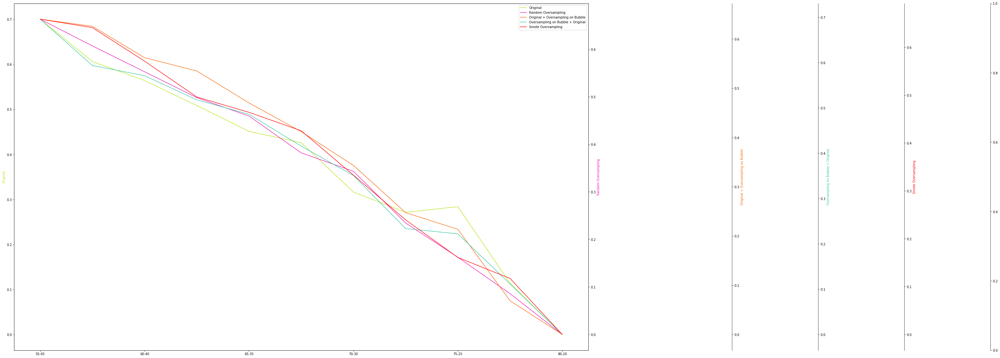

Total_Tiny_AccuracyKNN


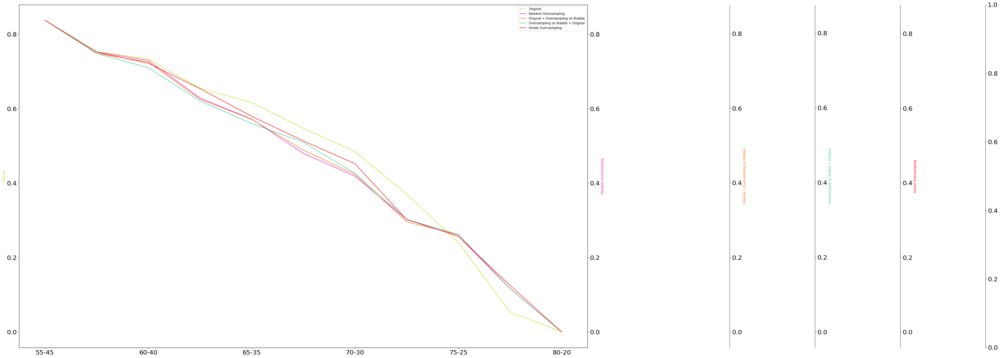

Total_Tiny_AccuracySVC


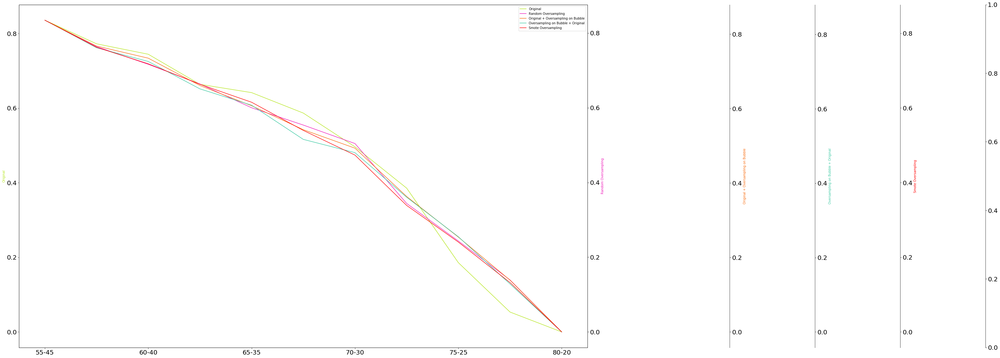

Total_Tiny_AccuracyRF


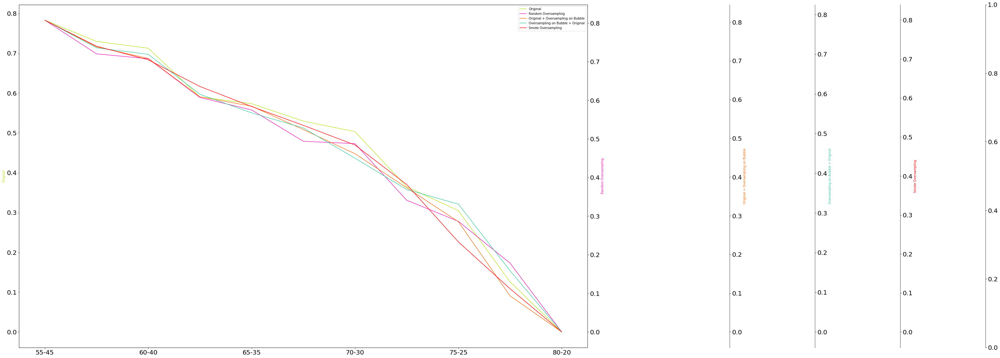

Total_Tiny_AccuracyDT


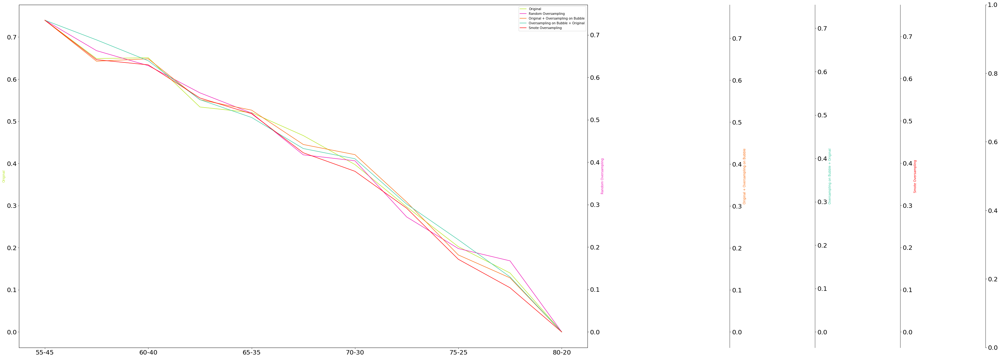

Total_Tiny_Precision 0SGD


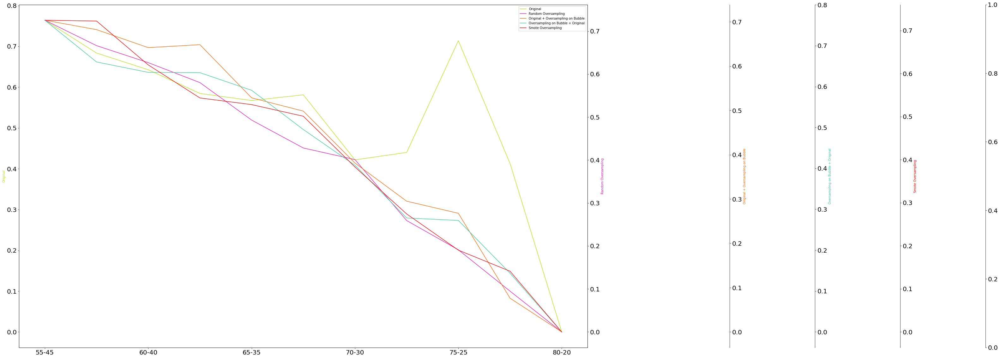

Total_Tiny_Precision 0KNN


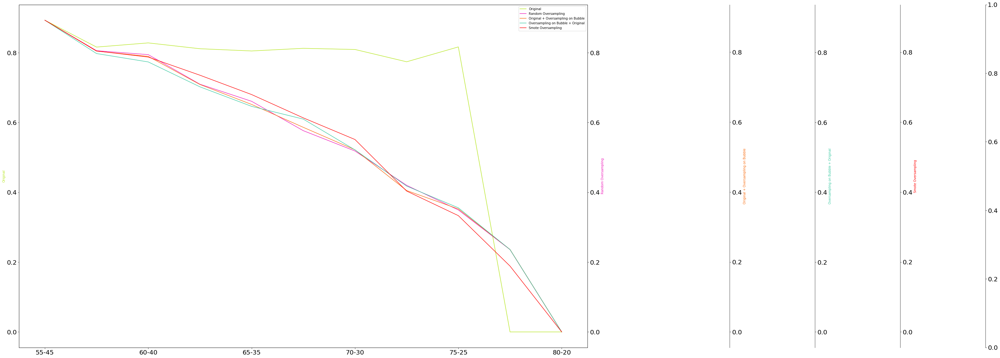

Total_Tiny_Precision 0SVC


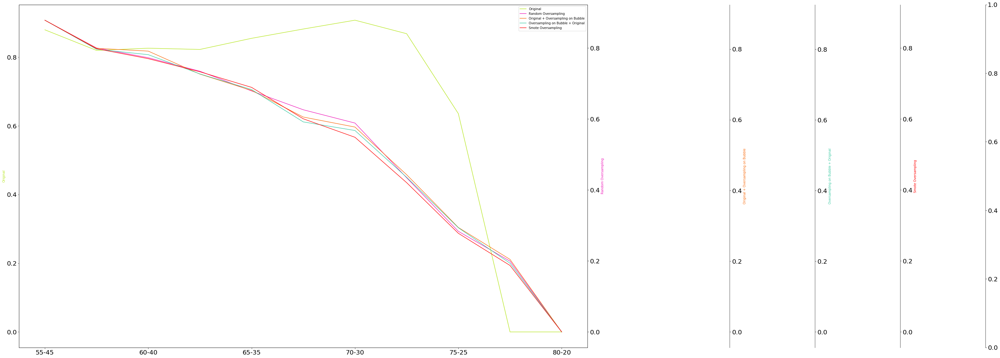

Total_Tiny_Precision 0RF


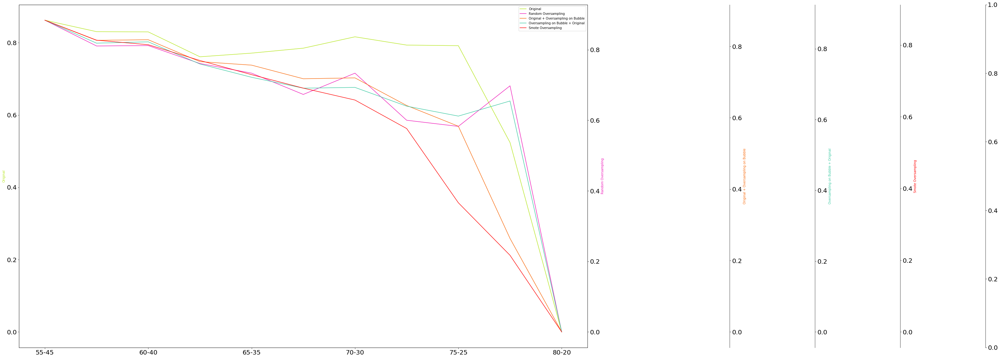

Total_Tiny_Precision 0DT


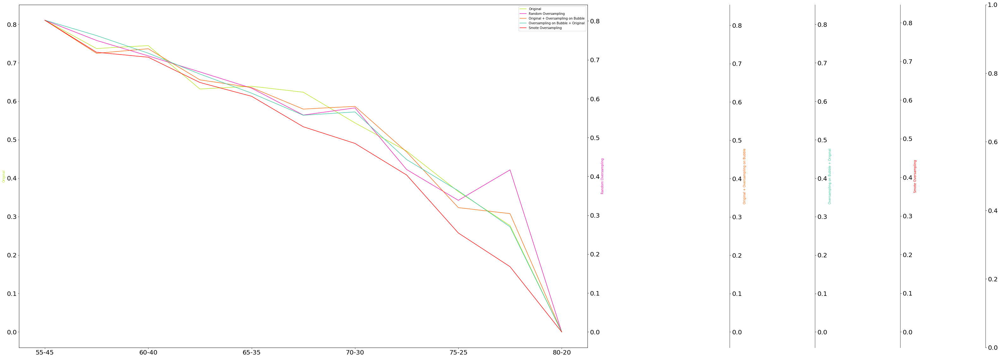

Total_Tiny_Precision 1SGD


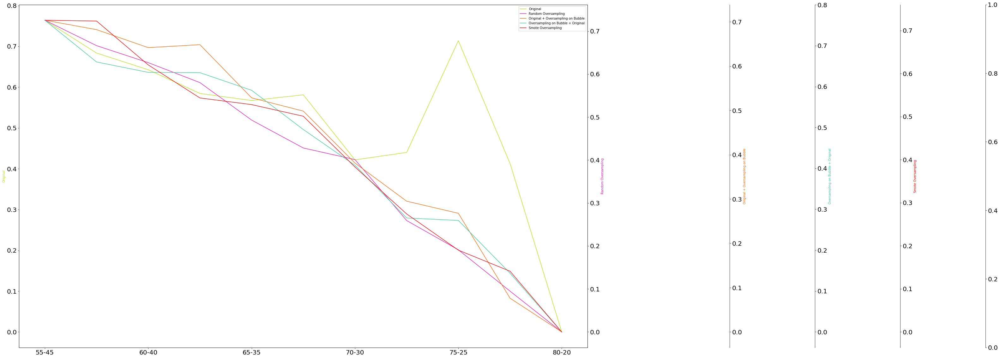

Total_Tiny_Precision 1KNN


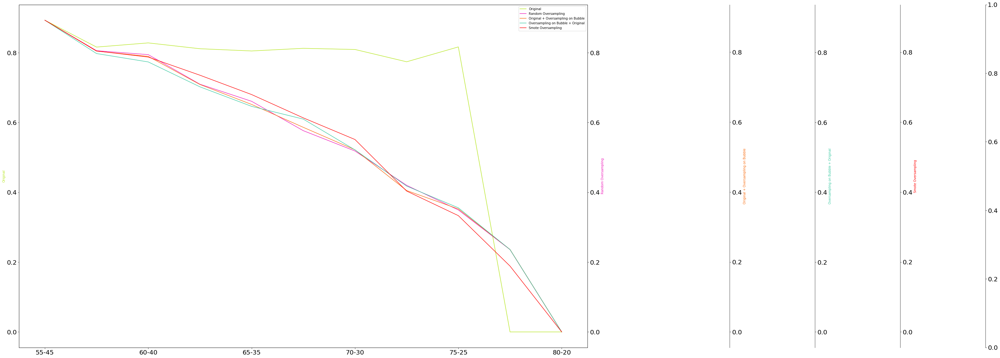

Total_Tiny_Precision 1SVC


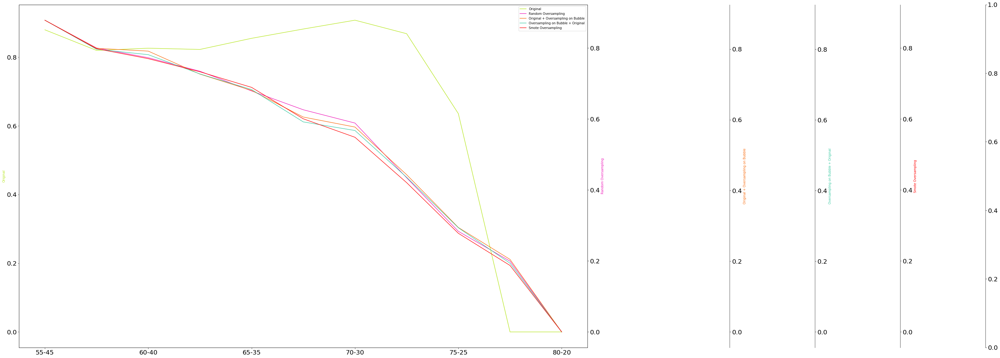

Total_Tiny_Precision 1RF


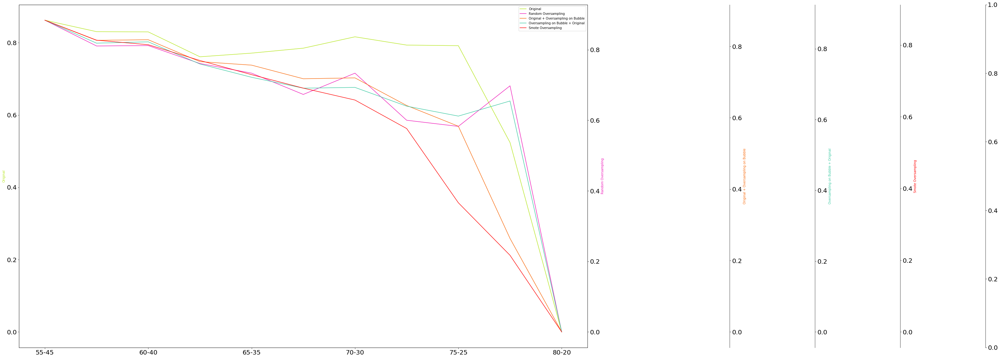

Total_Tiny_Precision 1DT


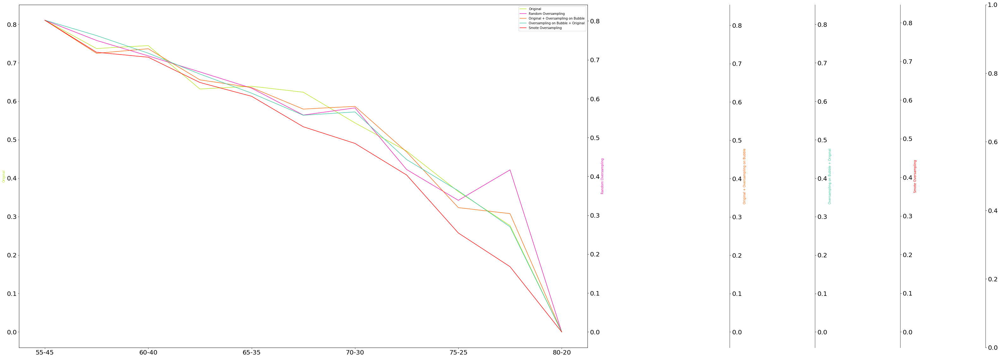

Total_Tiny_Recall 0SGD


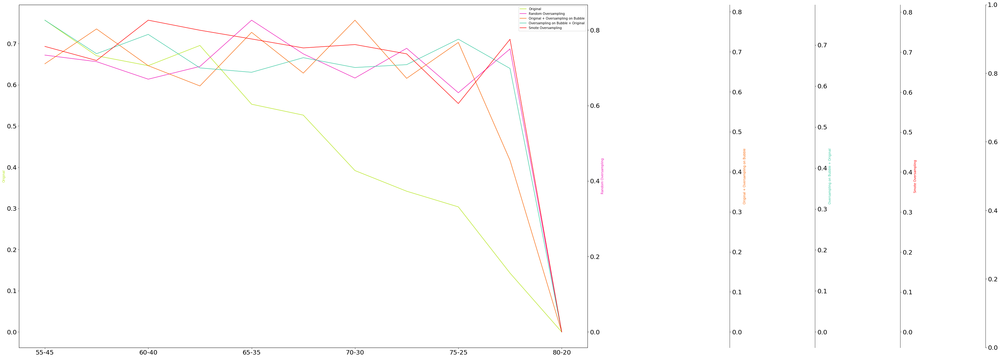

Total_Tiny_Recall 0KNN


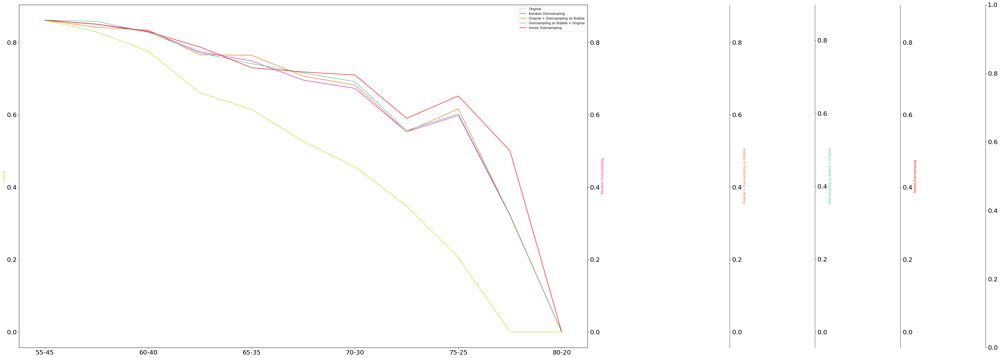

Total_Tiny_Recall 0SVC


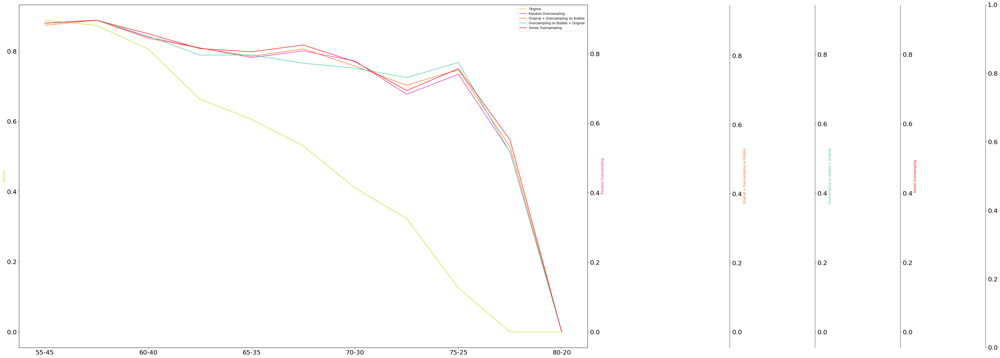

Total_Tiny_Recall 0RF


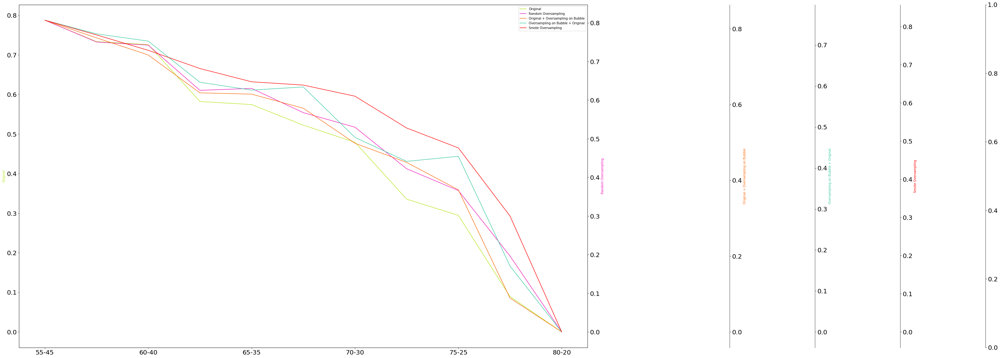

Total_Tiny_Recall 0DT


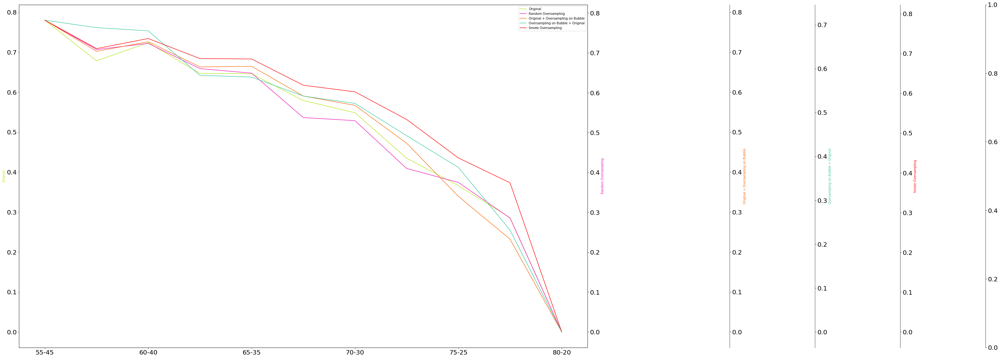

Total_Tiny_Recall1SGD


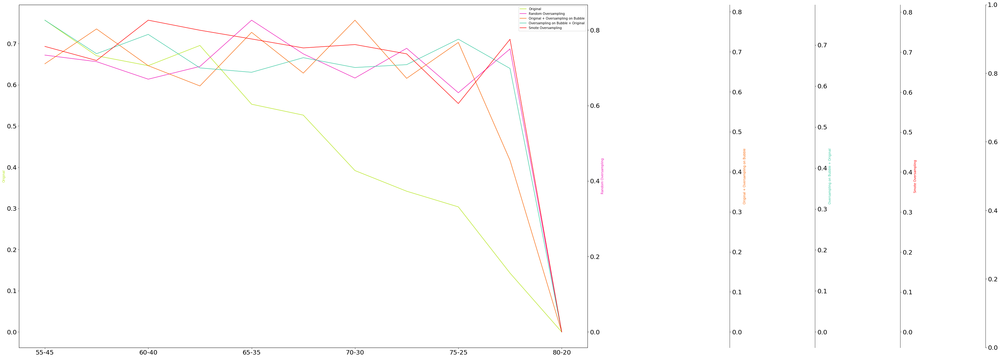

Total_Tiny_Recall1KNN


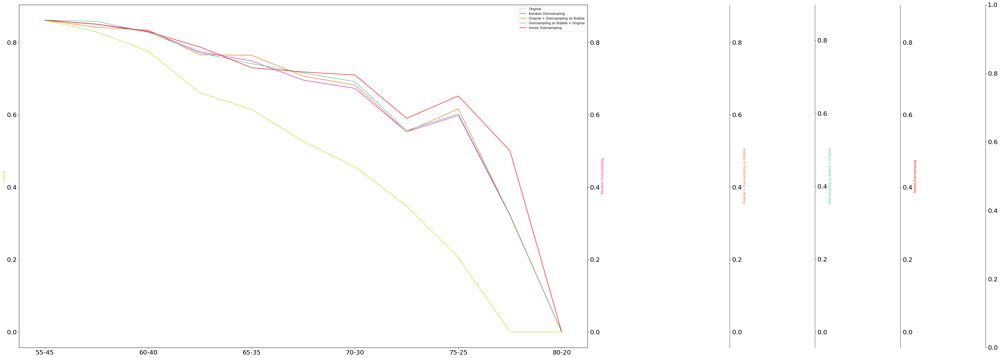

Total_Tiny_Recall1SVC


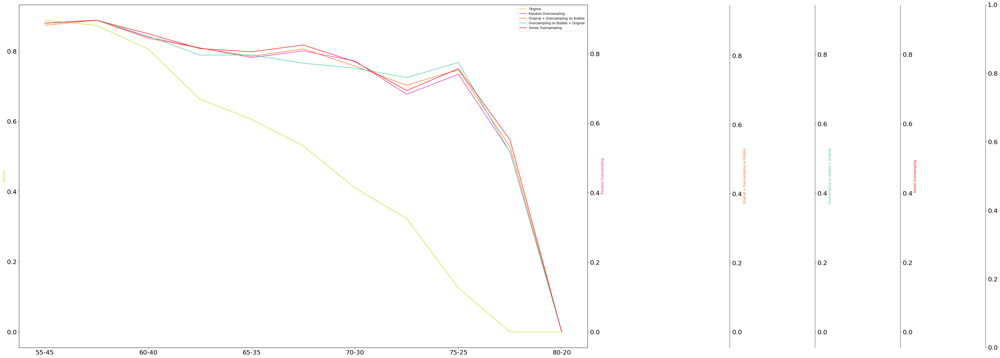

Total_Tiny_Recall1RF


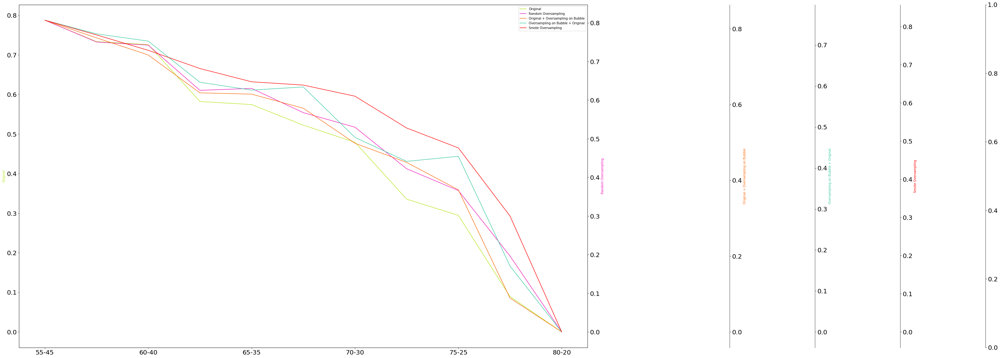

Total_Tiny_Recall1DT


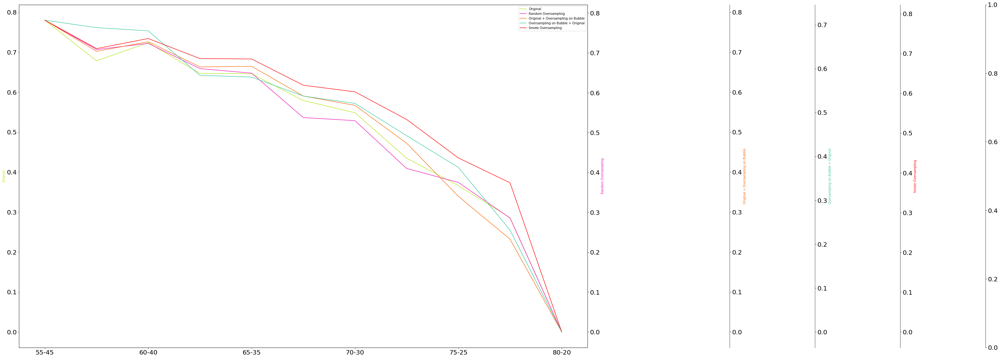

Total_Tiny_Balanced_AccuracySGD


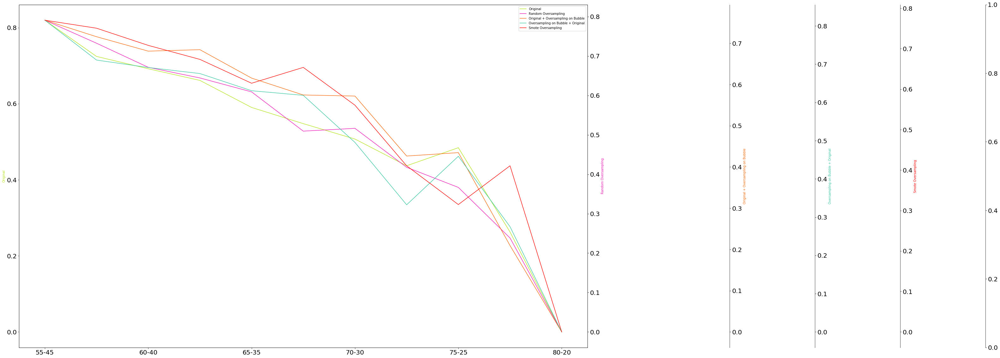

Total_Tiny_Balanced_AccuracyKNN


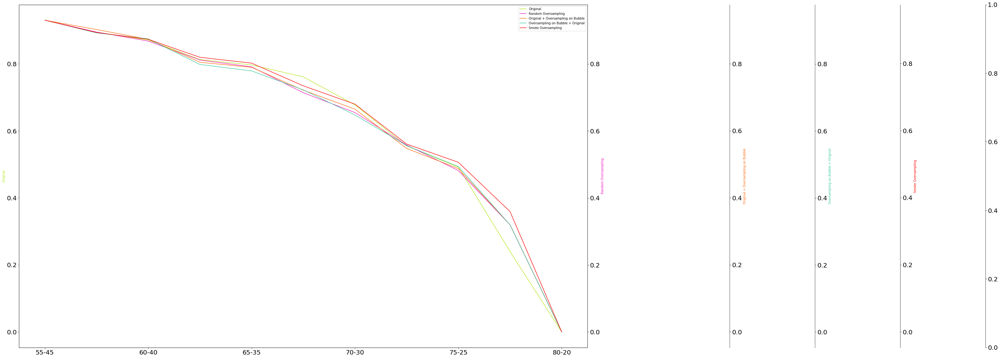

Total_Tiny_Balanced_AccuracySVC


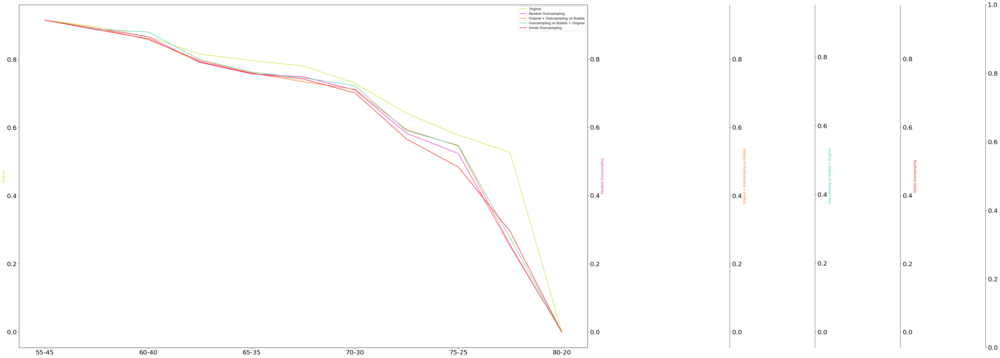

Total_Tiny_Balanced_AccuracyRF


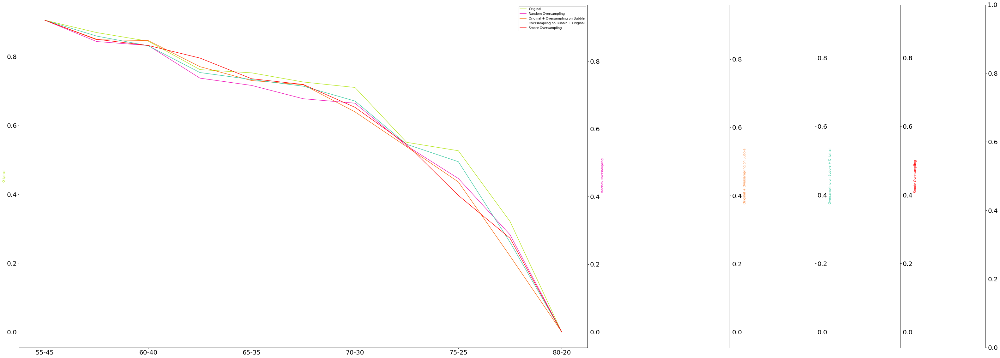

Total_Tiny_Balanced_AccuracyDT


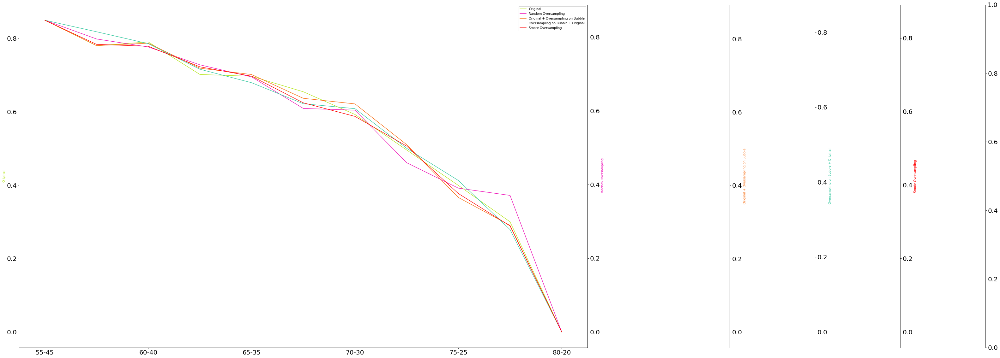

Total_Tiny_F1 Score 0SGD


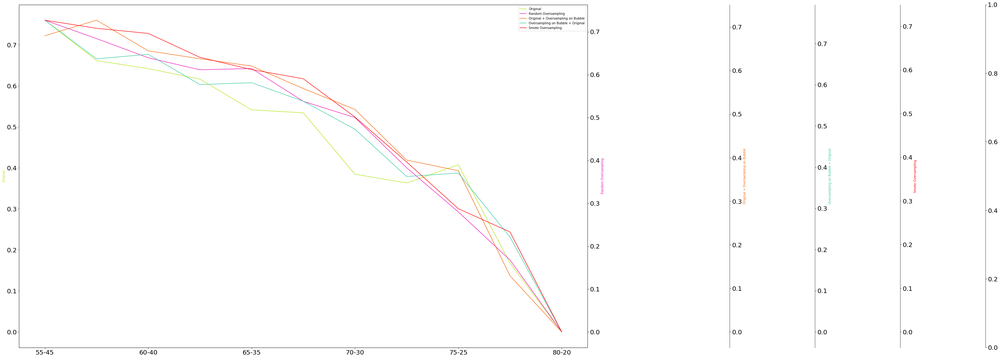

Total_Tiny_F1 Score 0KNN


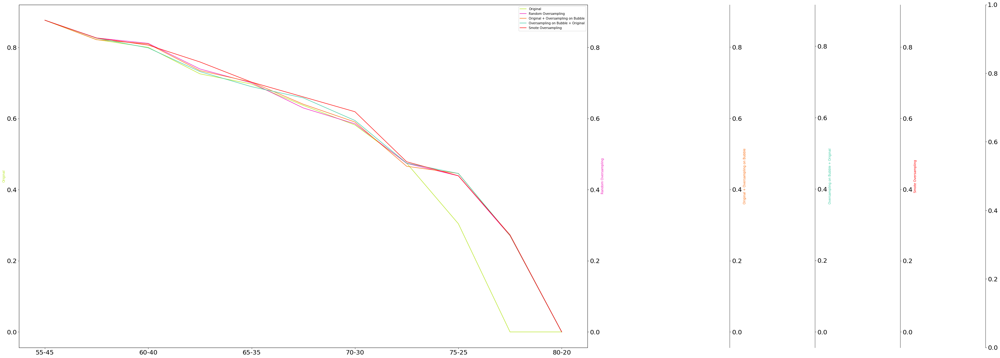

Total_Tiny_F1 Score 0SVC


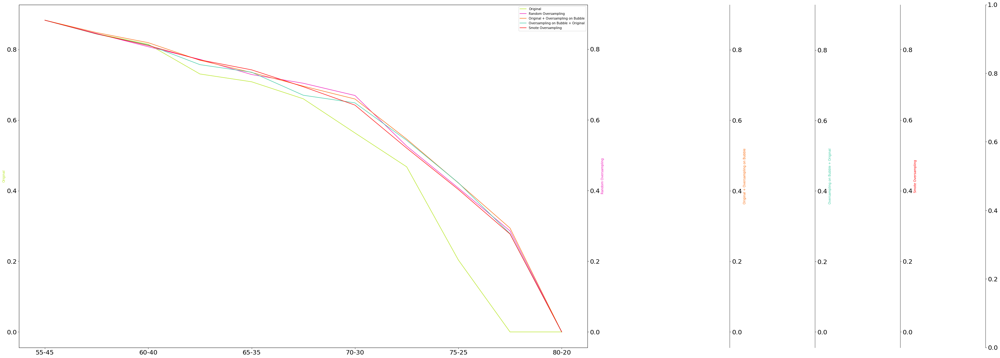

Total_Tiny_F1 Score 0RF


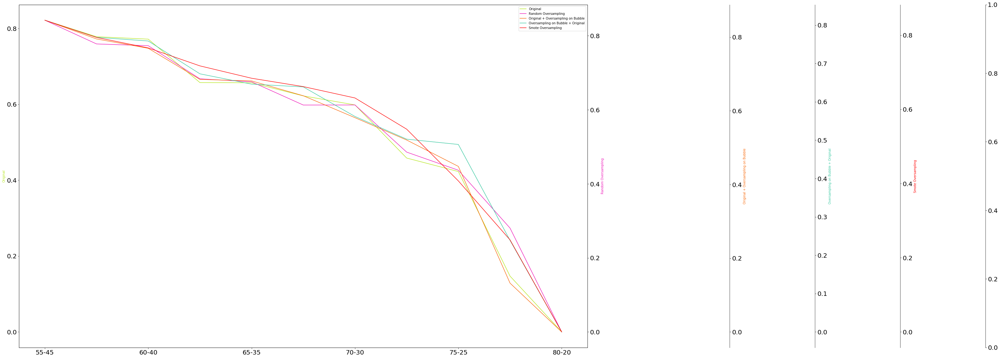

Total_Tiny_F1 Score 0DT


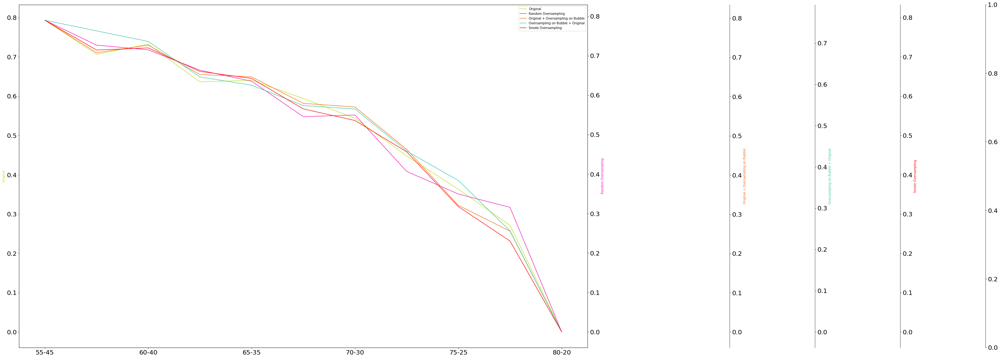

Total_Tiny_F1 Score 1SGD


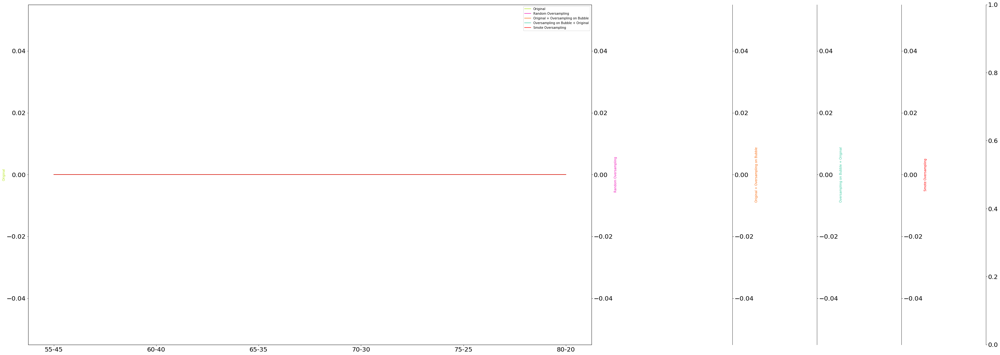

Total_Tiny_F1 Score 1KNN


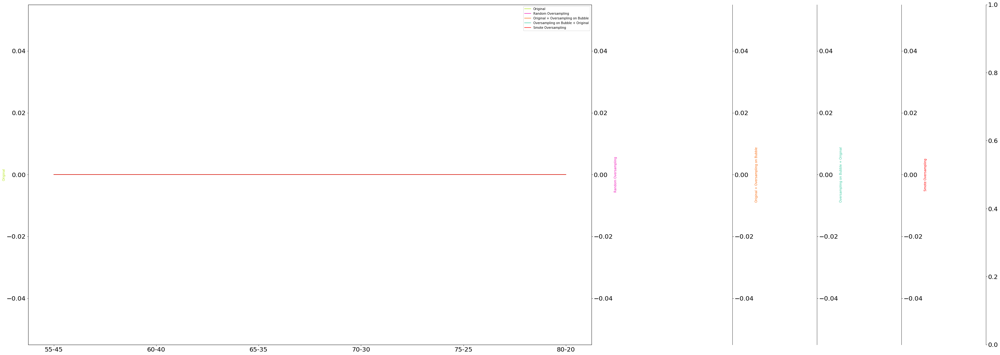

Total_Tiny_F1 Score 1SVC


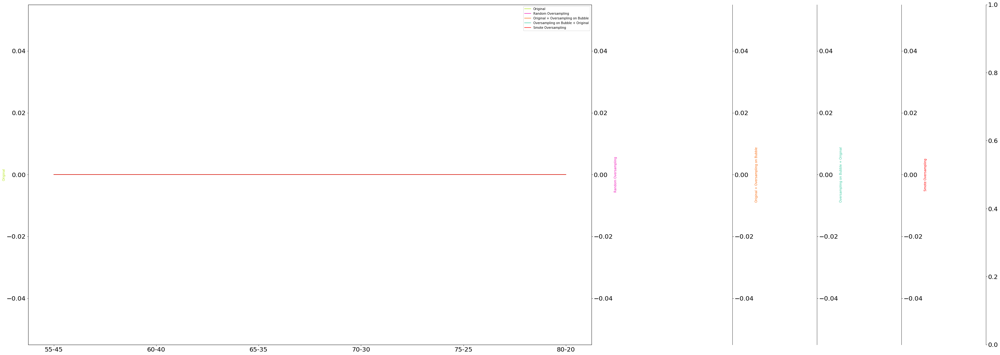

Total_Tiny_F1 Score 1RF


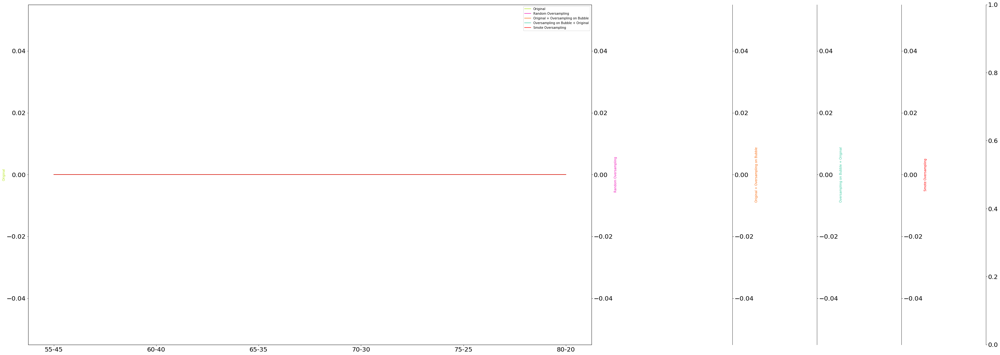

Total_Tiny_F1 Score 1DT


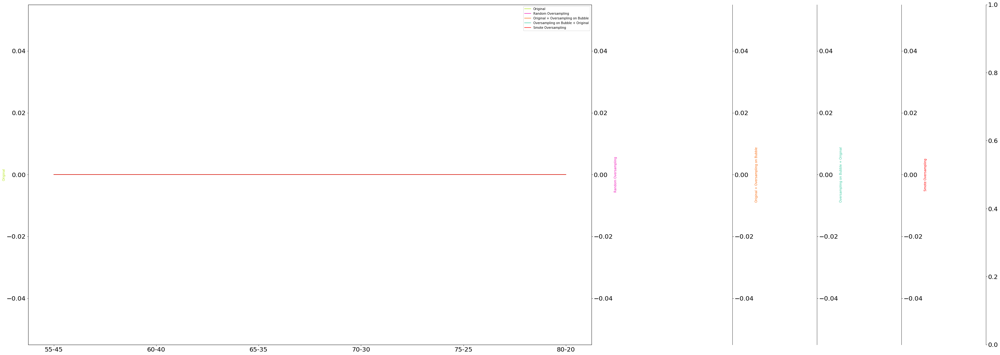

Total_Tiny_AUCSGD


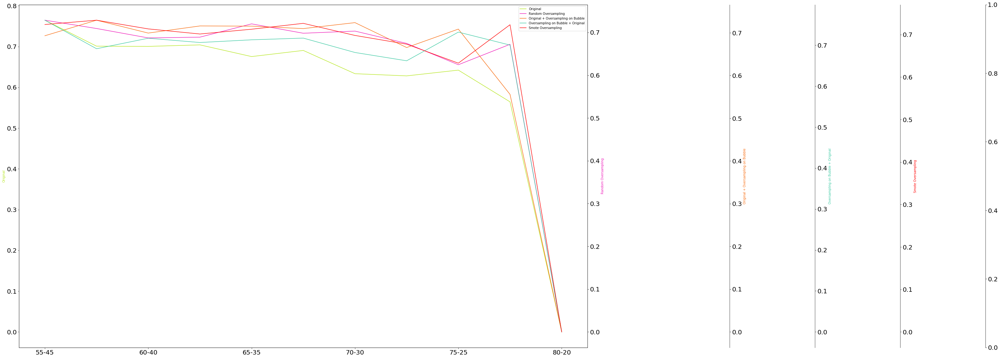

Total_Tiny_AUCKNN


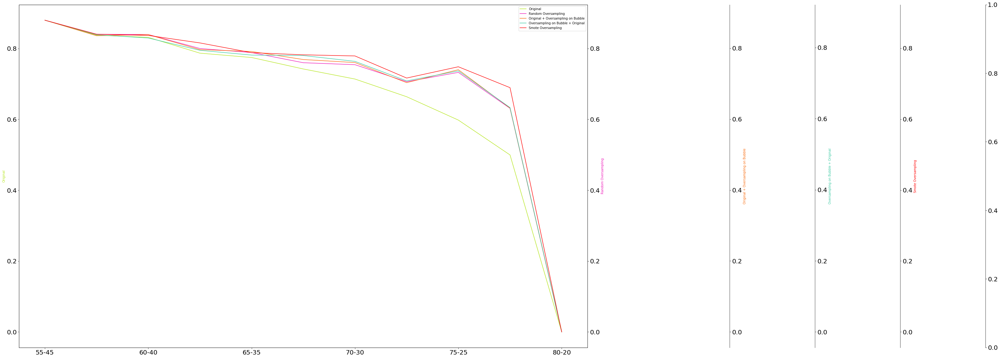

Total_Tiny_AUCSVC


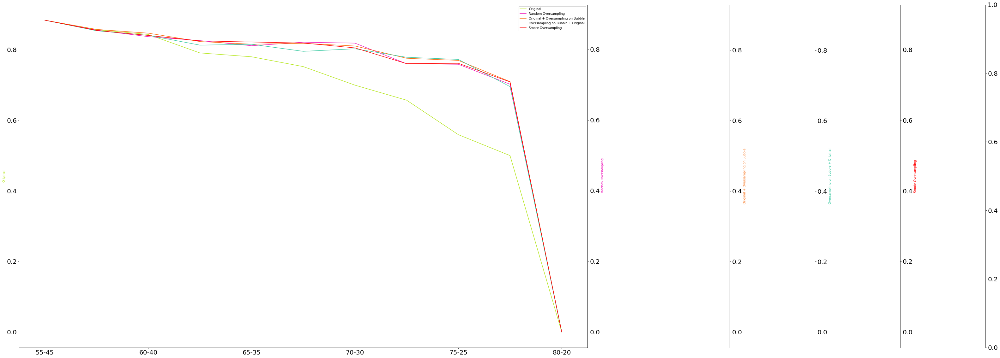

Total_Tiny_AUCRF


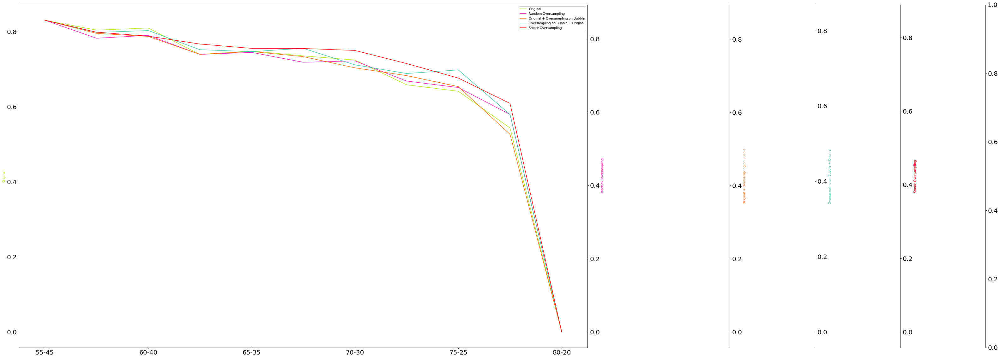

Total_Tiny_AUCDT


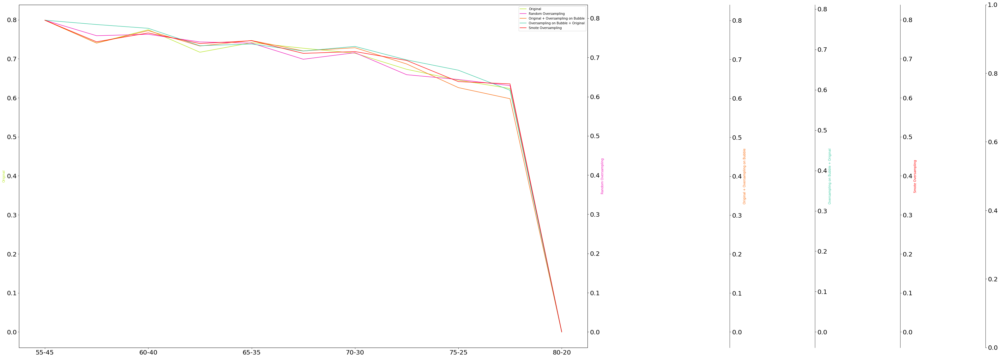

Total_Tiny_AUC Probs 0SGD


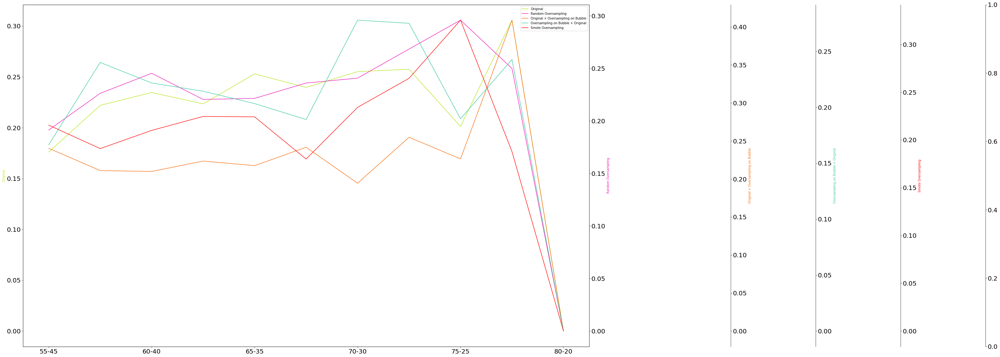

Total_Tiny_AUC Probs 0KNN


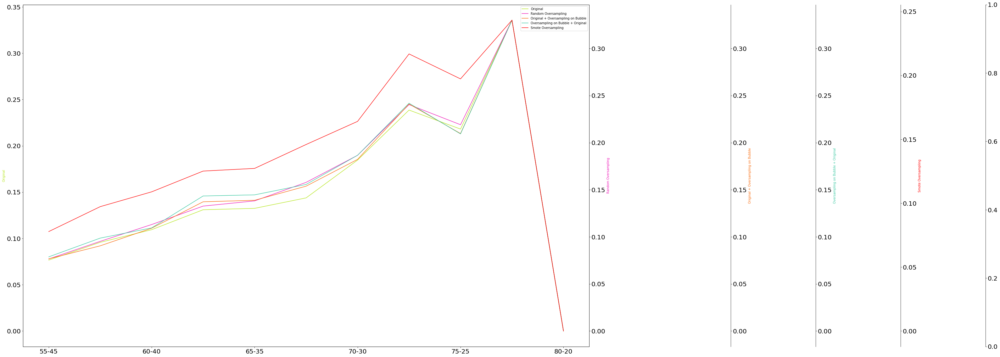

Total_Tiny_AUC Probs 0SVC


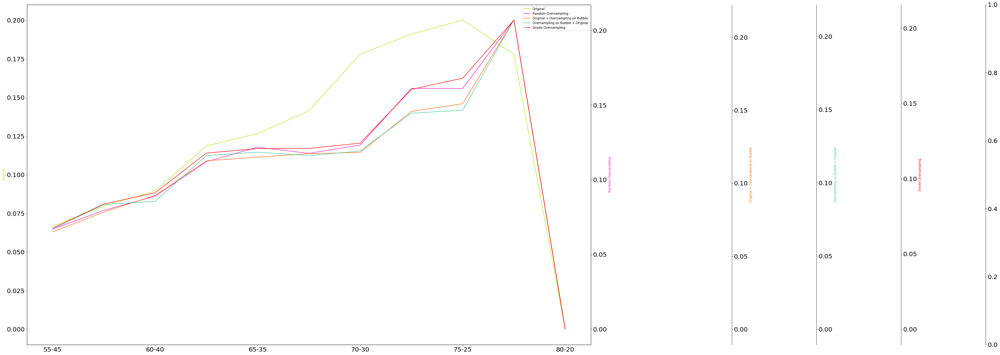

Total_Tiny_AUC Probs 0RF


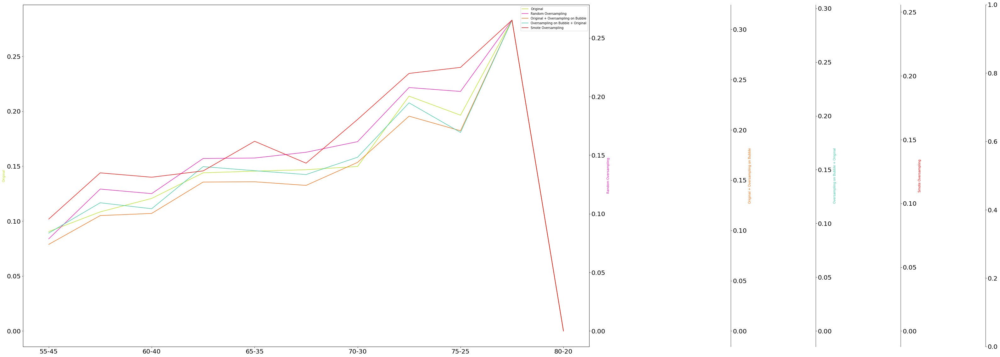

Total_Tiny_AUC Probs 0DT


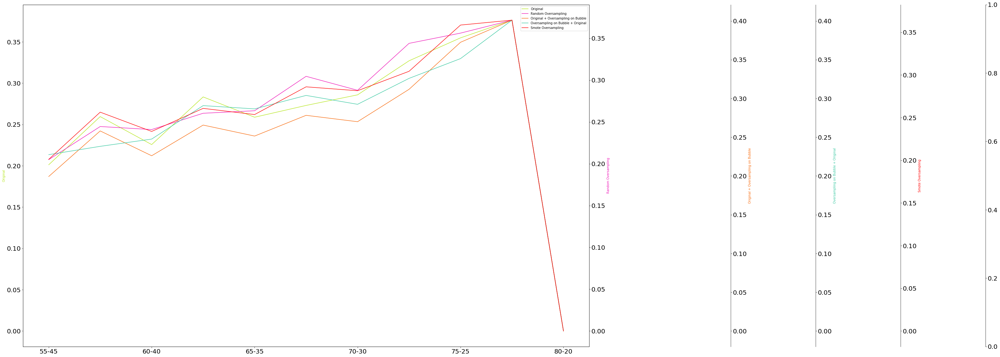

Total_Tiny_AUC Probs 1SGD


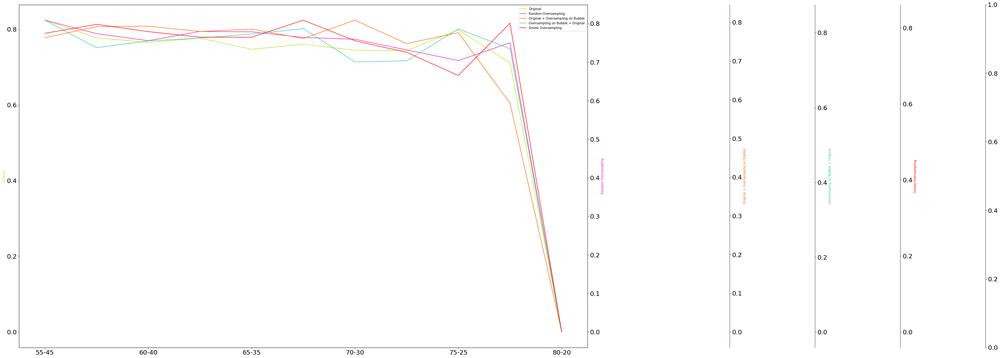

Total_Tiny_AUC Probs 1KNN


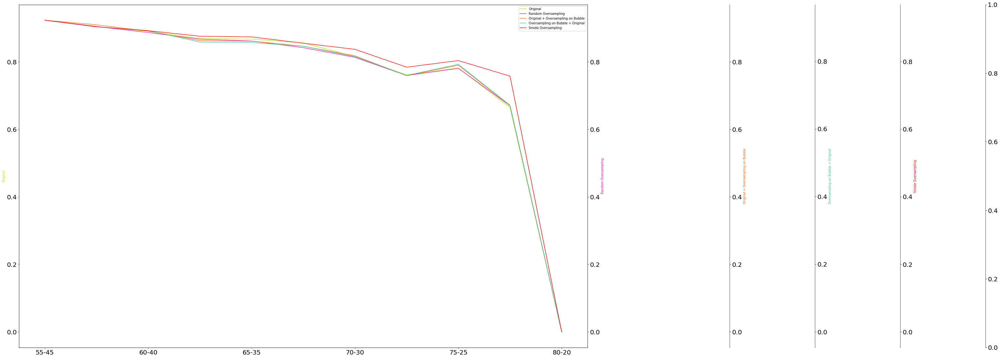

Total_Tiny_AUC Probs 1SVC


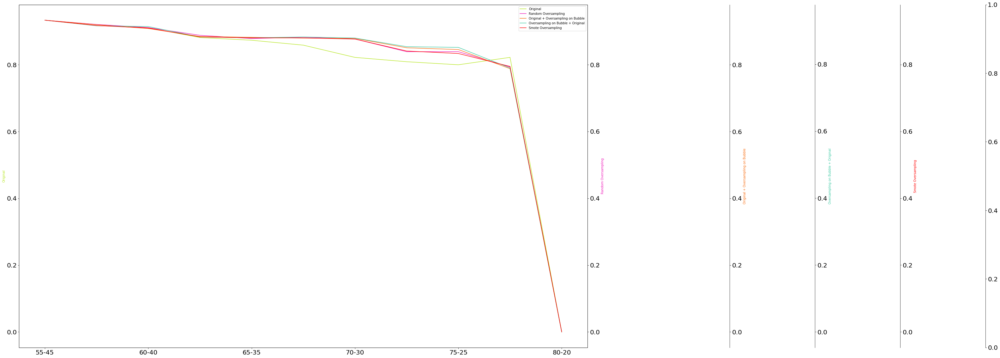

Total_Tiny_AUC Probs 1RF


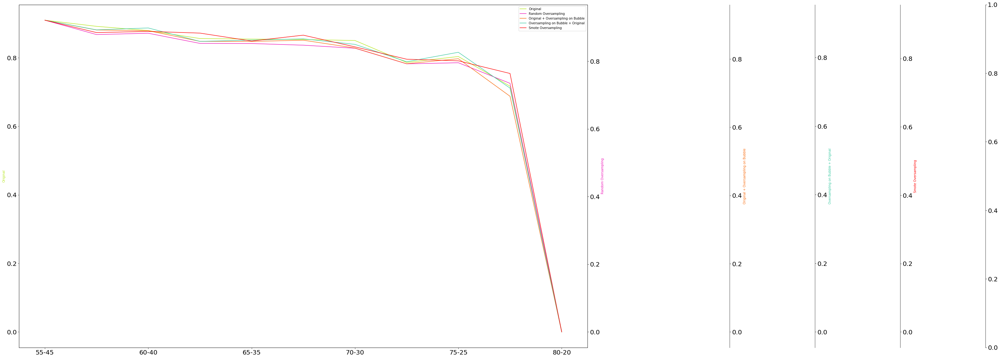

Total_Tiny_AUC Probs 1DT


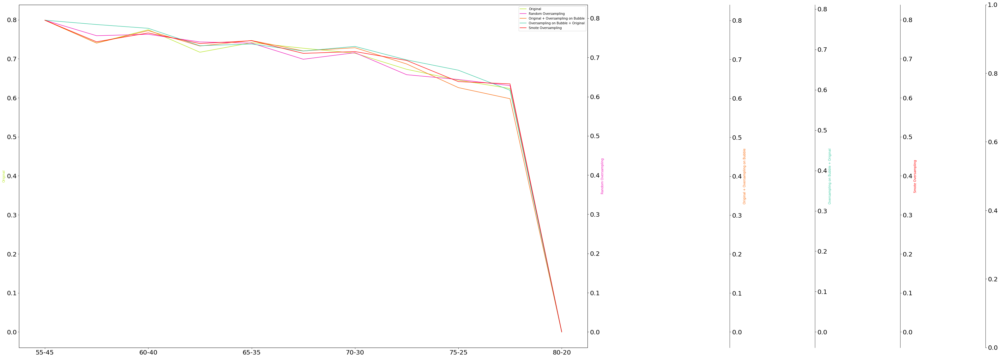

In [6]:
maBulle0 = BuildMyBulle([1,1,1,1,1,1,1], 7, 'test', bulle, bubble_oversample);
maBulle0.instantiate_data();
maBulle0.cross_validate();
maBulle0.visualize_scores()
    